In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from IPython.core.display import HTML
import warnings
warnings.filterwarnings("ignore")

In [2]:
# Reading the data
tr_tr = pd.read_csv('./train_transaction.csv')
te_tr = pd.read_csv('./test_transaction.csv')
tr_id = pd.read_csv('./train_identity.csv')
te_id = pd.read_csv('./test_identity.csv')


COLS_TO_SHOW = tr_tr.shape[0]

In [3]:
def h(content): # Function for displaying content in HTML/Markdown format
    display(HTML(content)) # display content in HTML/Markdown format


def timehist1(col): # Function for displaying line plot for a (transaction datetime/given column) - Time Histogram
    N = 8000 if col in ['TransactionAmt'] else 9999999999999999 # Clip transaction amount for better view
    # Line plot for a (transaction datetime/given column) in train_transaction where isFraud is False 
    tr_tr[tr_tr['isFraud'] == 0].set_index('TransactionDT')[col].clip(0, N).plot(style='.', title='Hist ' + col, figsize=(15, 3))
    # Line plot for a (transaction datetime/given column) in train_transaction where isFraud is True
    tr_tr[tr_tr['isFraud'] == 1].set_index('TransactionDT')[col].clip(0, N).plot(style='.', title='Hist ' + col, figsize=(15, 3))
    # Line plot for a (transaction datetime/given column) in test_transaction
    te_tr.set_index('TransactionDT')[col].clip(0, N).plot(style='.', title=col + ' values over time (blue=no-fraud, orange=fraud, green=test)', figsize=(15, 3))
    plt.show() # Show plot
    

def _desc(data, col, label): # Column description in a given dataset
    d0 = data.describe().reset_index() # Basic description (mean, std, min, max etc...) for a column
    d0.columns = [col, label]
    # Append column's unique values, number of NaNs and NaNs share and return it
    return d0.append({col:'unique values', label:data.unique().shape[0]}, ignore_index=True) \
             .append({col:'NaNs', label:data.isnull().sum()}, ignore_index=True) \
             .append({col:'NaNs share', label:np.round(data.isnull().sum() / data.shape[0], 4)}, ignore_index=True) \


def desc1(col): # Function for column description
    d0 = _desc(tr_tr[col], col, 'Train') # Description for column in Train dataset
    d1 = _desc(tr_tr.loc[tr_tr['isFraud'] == 1, col], col, 'Train fraud') # Description for column in Train dataset where Fraud is True
    d2 = _desc(tr_tr.loc[tr_tr['isFraud'] == 0, col], col, 'Train Not fraud') # Description for column in Train dataset where Fraud is False
    d3 = _desc(te_tr[col], col, 'Test') # Description for column in Test dataset
    n_public = int(te_tr.shape[0] * 0.2) # 20% of test data
    d4 = _desc(te_tr.loc[:n_public, col], col, 'Test public') # Description for column in Test public (20%)
    d5 = _desc(te_tr.loc[n_public:, col], col, 'Test private') # Description for column in Test private (80%)
    dd = d0.merge(d1).merge(d2).merge(d3).merge(d4).merge(d5) # Merge all descriptive Datasets together
    display(dd) # Display the resulting descriptive Dataset

    if col not in ['TransactionID']:
        h('<b>Most popular values (NaN = -999):</b>')
        N = 10
        # Size, mean and sum results for isFraud column grouped by a given column in Train dataset
        d0 = tr_tr[['isFraud',col]].fillna(-999).groupby(col)['isFraud'].agg(['size','mean','sum']).reset_index().sort_values('size', ascending=False).reset_index(drop=True)
        # Count results for TransactionID column grouped by a given column in Test dataset
        d1 = te_tr[['TransactionID',col]].fillna(-999).groupby(col)['TransactionID'].count().reset_index()
        dd = d0.merge(d1, how='left', on=col).head(N) # Merge d0 and d1 results together
        dd = dd.rename({'size':'Count in train (desc)','mean':'Mean target','sum':'Sum target','TransactionID':'Count in test'}, axis=1) # Renaming dataframe columns
        display(dd) # Display the resulting descriptive Dataset

        h('<b>Biggest fraud sum values in train (NaN = -999):</b>')
        # Biggest values for d0 and d1 combined
        dd = d0.sort_values('sum', ascending=False).reset_index(drop=True).head(N).merge(d1, how='left', on=col)
        dd = dd.rename({'size':'Count in train','mean':'Mean target','sum':'Sum target (desc)','TransactionID':'Count in test'}, axis=1) # Renaming dataframe columns
        display(dd) # Display the resulting descriptive Dataset


def hist1(col): # Function for histogram for a given column in Train and Test datasets
    plt.figure(figsize=(15, 3)) # Size of a plot
    plt.subplot(121) # Number of rows, number of columns and index for a subplot
    plt.hist(tr_tr[col], bins=70); # Histogram for a given column
    plt.title('Train histogram: ' + col); # Title for a histogram
    plt.subplot(122) # Number of rows, number of columns and index for a subplot
    plt.hist(te_tr[col], bins=70); # Histogram for a given column
    plt.title('Test histogram: ' + col); # Title for a histogram
    plt.show() # Show histograms


def corr1(col): # Function for the most correlated values for the given column - Correlation
    N = None #10000
    num_vars = [f for f in tr_tr.columns if tr_tr[f].dtype != 'object'] # List of all numeric columns
    trx = tr_tr.head(N) if N is not None else tr_tr.copy() # Temporary dataframe for the correlation results
    # The most correlated columns with the given column (Only numeric columns)
    corrs = trx[num_vars].corrwith(trx[col]).reset_index().sort_values(0, ascending=False).reset_index(drop=True).rename({'index':'Column',0:'Correlation with ' + col}, axis=1)
    h('<b>Most correlated values with ' + col + ':</b>')
    trx = pd.concat([corrs.head(6), corrs.dropna().tail(5)]) # Final correlation results to dataframe
    def linkx(val):
        return '<a href="#c_{}">{}</a>'.format(val, val) if val in included_cols else val
    trx['Column'] = trx['Column'].apply(linkx)
    h(trx.to_html(escape=False))


def numeric(col): # EDA for numeric columns
    timehist1(col) # Time histogram
    hist1(col) # Histogram of
    desc1(col) # Description
    corr1(col) # Correlation


def categorical(col): # EDA for categorical columns
    desc1(col) # Description


def proc(col): # Function for running eda
    if col not in ['isFraud','TransactionDT']:
        h('<h3 id="c_' + col + '">' + col + '</h3>' + '<a style="font-size:11px" href="#home">(Jump to top)</a>')
        categorical(col) if tr_tr[col].dtype == 'object' else numeric(col) # Make EDA for a column

# Navigation
included_cols = list(tr_tr.columns.values[:COLS_TO_SHOW])
split_on = ['TransactionID','card1','addr1','C1','D1','M1','V1']
h('<b>Links to column info:</b> ' + ', '.join([('<li>' if col in split_on else '') + '<a href="#c_' + col + '">' + col + '</a>' for col in included_cols]))
# Shapes of datasets
h('Train transactions shape: <b>' + str(tr_tr.shape) + '</b>, identity <b>' + str(tr_id.shape) + '</b>' + 
  '<br>Test transactions shape: <b>' + str(te_tr.shape) + '</b>, identity <b>' + str(te_id.shape) + '</b>')
# train_transaction preview
h('Train transactions preview:')
display(tr_tr.head(10))

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
0,2987000,0,86400,68.5,W,13926,NaN,150.0,discover,142.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2987001,0,86401,29.0,W,2755,404.0,150.0,mastercard,102.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2987002,0,86469,59.0,W,4663,490.0,150.0,visa,166.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2987003,0,86499,50.0,W,18132,567.0,150.0,mastercard,117.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2987004,0,86506,50.0,H,4497,514.0,150.0,mastercard,102.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,2987005,0,86510,49.0,W,5937,555.0,150.0,visa,226.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,2987006,0,86522,159.0,W,12308,360.0,150.0,visa,166.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,2987007,0,86529,422.5,W,12695,490.0,150.0,visa,226.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2987008,0,86535,15.0,H,2803,100.0,150.0,visa,226.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,2987009,0,86536,117.0,W,17399,111.0,150.0,mastercard,224.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


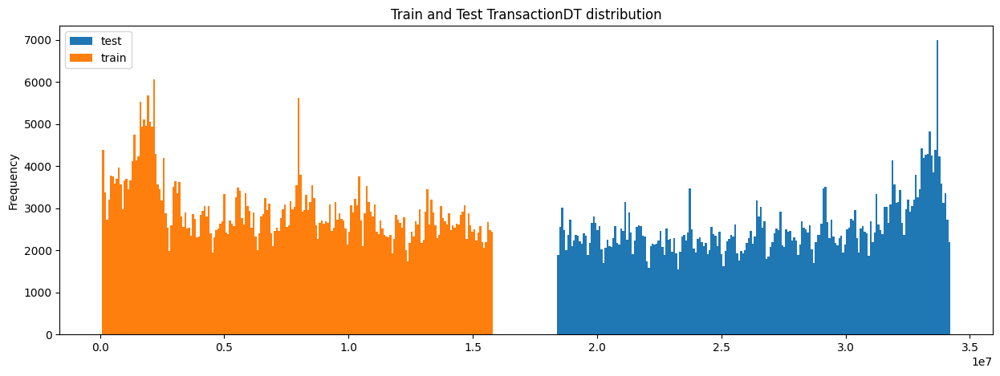

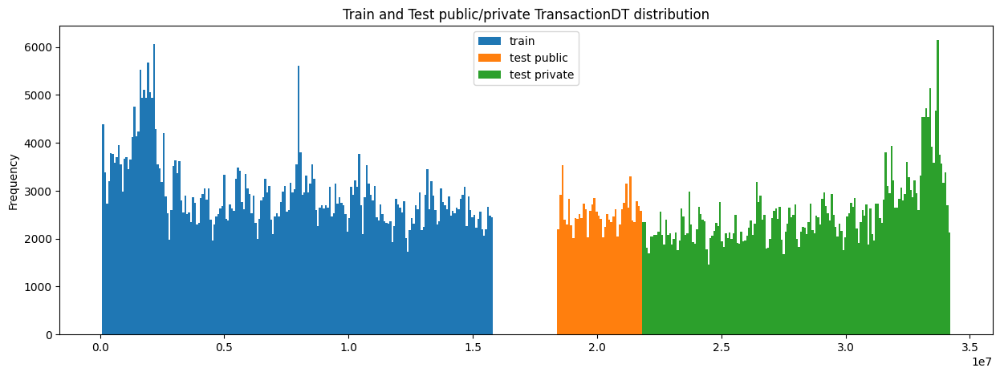

,Column,Correlation with TransactionDT
0,TransactionDT,1.000000
1,TransactionID,0.998280
2,V330,0.258603
3,V326,0.257295
4,V329,0.252599
5,V327,0.248494
375,V145,-0.252731
376,V160,-0.265566
377,V159,-0.279138
378,V151,-0.280576


In [4]:
# TransactionDT EDA
COL = 'TransactionDT'
h('<h2 id="c_' + COL + '">' + COL + '</h2>' + '<a style="font-size:11px" href="#home">(Jump to top)</a>')

# Train and Test TransactionDT distribution
te_tr['TransactionDT'].plot(kind='hist', figsize=(15, 5), label='test', bins=200, title='Train and Test TransactionDT distribution')
tr_tr['TransactionDT'].plot(kind='hist', label='train', bins=200)
plt.legend()
plt.show()

# Train and Test public/private TransactionDT distribution
tr_tr['TransactionDT'].plot(kind='hist', figsize=(15, 5), label='train', bins=200, title='Train and Test public/private TransactionDT distribution')
n_public = int(te_tr.shape[0] * 0.2)
te_tr.loc[:n_public, 'TransactionDT'].plot(kind='hist', label='test public', bins=40)
te_tr.loc[n_public:, 'TransactionDT'].plot(kind='hist', label='test private', bins=160)
plt.legend()
plt.show()

corr1(COL) # Most correlated columns with TransactionDT

In [5]:
# isFraud EDA
COL = 'isFraud'
h('<h2 id="c_' + COL + '">' + COL + '</h2>' + '<a style="font-size:11px" href="#home">(Jump to top)</a>')
h('This is target column.')
# True and False counts in isFraud column
trx = tr_tr['isFraud'].value_counts().reset_index().rename({'index':'Value','isFraud':'Count'}, axis=1)
# Percentage of True and False in isFraud column
trx['Share'] = np.round(trx['Count'] / trx['Count'].sum(), 6)
display(trx) # Display the resulting stats
corr1(COL) # Most correlated columns with isFraud column

,Value,Count,Share
0,0,569877,0.96501
1,1,20663,0.03499


,Column,Correlation with isFraud
0,isFraud,1.000000
1,V257,0.383060
2,V246,0.366878
3,V244,0.364129
4,V242,0.360590
5,V201,0.328005
375,V90,-0.110168
376,V49,-0.110920
377,V48,-0.115786
378,D7,-0.127199


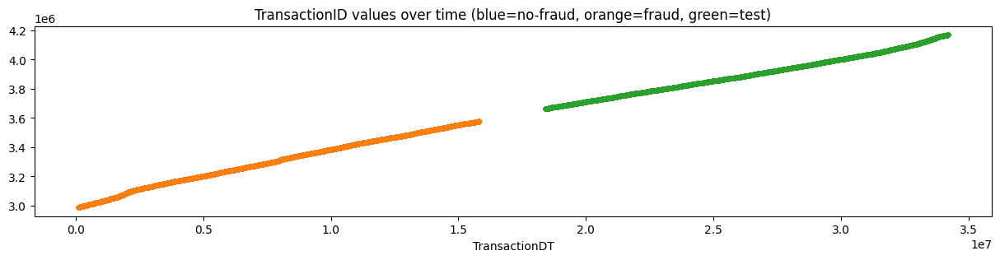

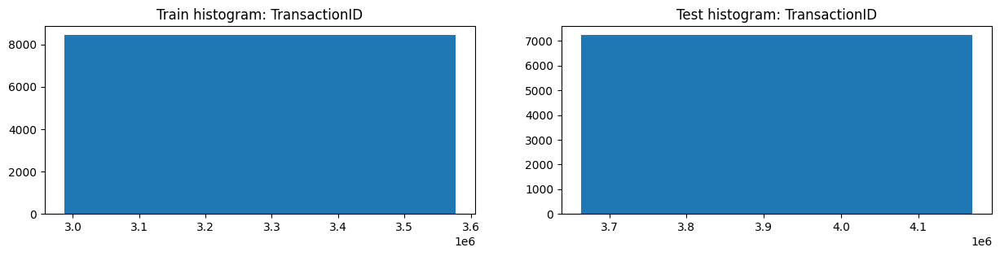

,TransactionID,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,5.905400e+05,2.066300e+04,5.698770e+05,5.066910e+05,1.013390e+05,4.053530e+05
1,mean,3.282270e+06,3.294952e+06,3.281810e+06,3.916894e+06,3.714218e+06,3.967563e+06
2,std,1.704744e+05,1.620403e+05,1.707548e+05,1.462692e+05,2.925419e+04,1.170155e+05
3,min,2.987000e+06,2.987203e+06,2.987000e+06,3.663549e+06,3.663549e+06,3.764887e+06
4,25%,3.134635e+06,3.167366e+06,3.133317e+06,3.790222e+06,3.688884e+06,3.866225e+06
5,50%,3.282270e+06,3.291934e+06,3.281808e+06,3.916894e+06,3.714218e+06,3.967563e+06
6,75%,3.429904e+06,3.428646e+06,3.429974e+06,4.043566e+06,3.739552e+06,4.068901e+06
7,max,3.577539e+06,3.577526e+06,3.577539e+06,4.170239e+06,3.764887e+06,4.170239e+06
8,unique values,5.905400e+05,2.066300e+04,5.698770e+05,5.066910e+05,1.013390e+05,4.053530e+05
9,NaNs,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00


,Column,Correlation with TransactionID
0,TransactionID,1.000000
1,TransactionDT,0.998280
2,V326,0.251746
3,V330,0.250831
4,V329,0.244867
5,V327,0.242576
375,V145,-0.273548
376,V160,-0.282572
377,V159,-0.302742
378,V151,-0.303988


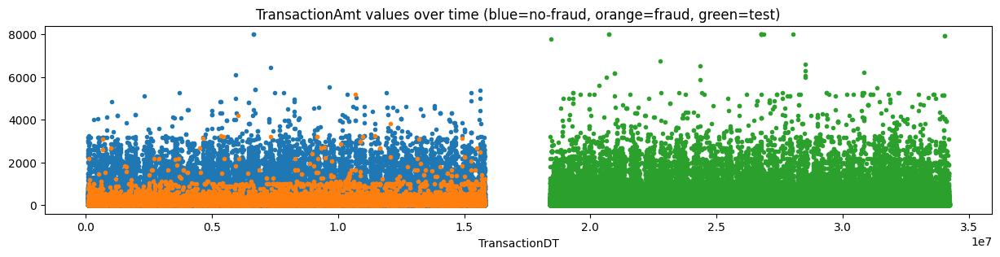

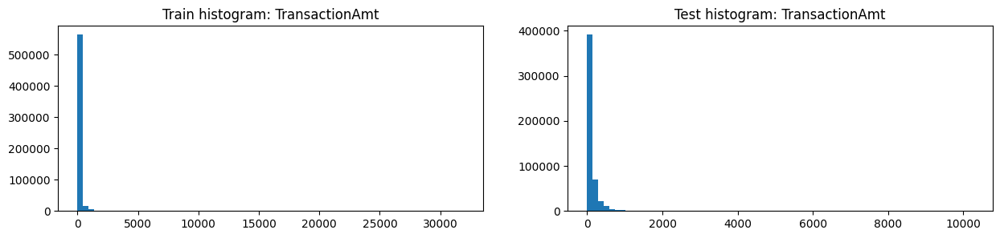

,TransactionAmt,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590540.000000,20663.000000,569877.000000,506691.000000,101339.000000,405353.000000
1,mean,135.027176,149.244779,134.511665,134.725568,141.732271,132.973690
2,std,239.162522,232.212163,239.395078,245.779822,257.473804,242.736757
3,min,0.251000,0.292000,0.251000,0.018000,0.018000,0.140000
4,25%,43.321000,35.044000,43.970000,40.000000,45.950000,39.000000
5,50%,68.769000,75.000000,68.500000,67.950000,72.950000,67.950000
6,75%,125.000000,161.000000,120.000000,125.000000,134.950000,120.950000
7,max,31937.391000,5191.000000,31937.391000,10270.000000,9154.460000,10270.000000
8,unique values,20902.000000,2515.000000,20560.000000,14119.000000,5144.000000,12117.000000
9,NaNs,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


,TransactionAmt,Count in train (desc),Mean target,Sum target,Count in test
0,59.00,30582,0.021124,646,27365.0
1,117.00,28933,0.024851,719,25798.0
2,107.95,23954,0.009226,221,20243.0
3,57.95,23600,0.003814,90,20063.0
4,100.00,20362,0.025685,523,17565.0
5,50.00,17009,0.020754,353,14469.0
6,49.00,15990,0.029331,469,14231.0
7,226.00,11704,0.033322,390,11084.0
8,39.00,11095,0.021812,242,9926.0
9,29.00,10683,0.018815,201,9019.0


,TransactionAmt,Count in train,Mean target,Sum target (desc),Count in test
0,117.0,28933,0.024851,719,25798
1,59.0,30582,0.021124,646,27365
2,150.0,8356,0.067137,561,7426
3,100.0,20362,0.025685,523,17565
4,49.0,15990,0.029331,469,14231
5,200.0,6590,0.064188,423,6115
6,226.0,11704,0.033322,390,11084
7,300.0,2438,0.145611,355,2104
8,50.0,17009,0.020754,353,14469
9,171.0,7682,0.035407,272,7233


,Column,Correlation with TransactionAmt
0,TransactionAmt,1.000000
1,V139,0.222308
2,V140,0.207470
3,V208,0.198601
4,V161,0.197351
5,V163,0.191320
375,V15,-0.139413
376,V94,-0.141014
377,V52,-0.142297
378,V50,-0.144958


,ProductCD,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590540,20663,569877,506691,101339,405353
1,unique,5,5,5,5,5,5
2,top,W,W,W,W,W,W
3,freq,439670,8969,430701,360987,82563,278425
4,unique values,5,5,5,5,5,5
5,NaNs,0,0,0,0,0,0
6,NaNs share,0.0,0.0,0.0,0.0,0.0,0.0


,ProductCD,Count in train (desc),Mean target,Sum target,Count in test
0,W,439670,0.020399,8969,360987
1,C,68519,0.116873,8008,69266
2,R,37699,0.037826,1426,35647
3,H,33024,0.047662,1574,29373
4,S,11628,0.058996,686,11418


,ProductCD,Count in train,Mean target,Sum target (desc),Count in test
0,W,439670,0.020399,8969,360987
1,C,68519,0.116873,8008,69266
2,H,33024,0.047662,1574,29373
3,R,37699,0.037826,1426,35647
4,S,11628,0.058996,686,11418


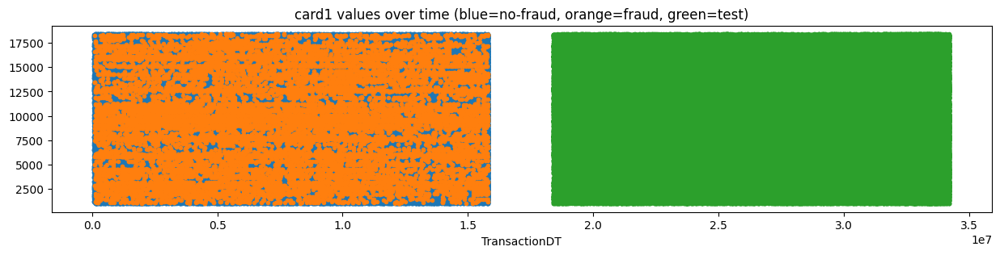

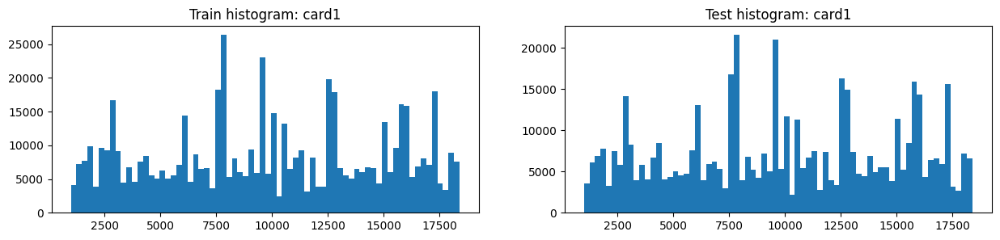

,card1,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590540.000000,20663.000000,569877.000000,506691.000000,101339.000000,405353.000000
1,mean,9898.734658,9547.654164,9911.464381,9957.222175,9907.330406,9969.701591
2,std,4901.170153,4762.051380,4905.672370,4884.960969,4854.917514,4892.365179
3,min,1000.000000,1015.000000,1000.000000,1001.000000,1006.000000,1001.000000
4,25%,6019.000000,5732.500000,6019.000000,6019.000000,6053.000000,6019.000000
5,50%,9678.000000,9633.000000,9711.000000,9803.000000,9653.000000,9803.000000
6,75%,14184.000000,13623.000000,14229.000000,14276.000000,14052.000000,14290.000000
7,max,18396.000000,18375.000000,18396.000000,18397.000000,18396.000000,18397.000000
8,unique values,13553.000000,1740.000000,13350.000000,13244.000000,6935.000000,12300.000000
9,NaNs,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


,card1,Count in train (desc),Mean target,Sum target,Count in test
0,7919,14932,0.007501,112,13083.0
1,9500,14162,0.037283,528,12081.0
2,15885,10361,0.042853,444,12330.0
3,17188,10344,0.026875,278,9262.0
4,15066,7945,0.039396,313,6661.0
5,12695,7091,0.028346,201,5641.0
6,12544,6773,0.021556,146,5921.0
7,6019,6771,0.043420,294,6497.0
8,2803,6141,0.011887,73,4902.0
9,7585,5334,0.049306,263,4763.0


,card1,Count in train,Mean target,Sum target (desc),Count in test
0,9633,4158,0.178451,742,4751
1,9500,14162,0.037283,528,12081
2,15885,10361,0.042853,444,12330
3,9026,2076,0.191233,397,894
4,15063,2522,0.126487,319,2060
5,5812,2818,0.111427,314,3879
6,2616,4410,0.071202,314,1786
7,15066,7945,0.039396,313,6661
8,9917,919,0.332971,306,920
9,6019,6771,0.043420,294,6497


,Column,Correlation with card1
0,card1,1.000000
1,V330,0.146483
2,V329,0.142539
3,V324,0.138616
4,V333,0.136557
5,V328,0.134419
375,V149,-0.023889
376,V156,-0.024232
377,D13,-0.028603
378,D8,-0.040851


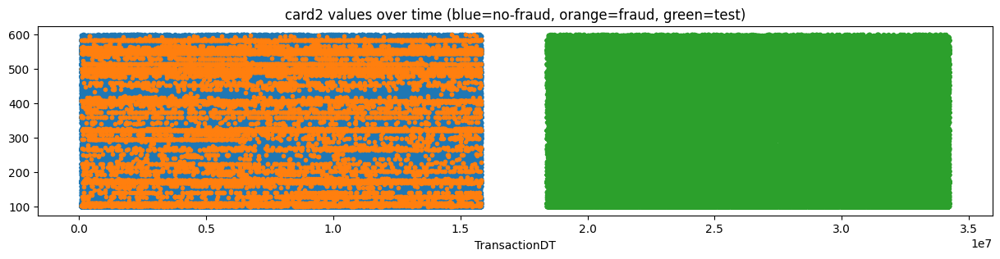

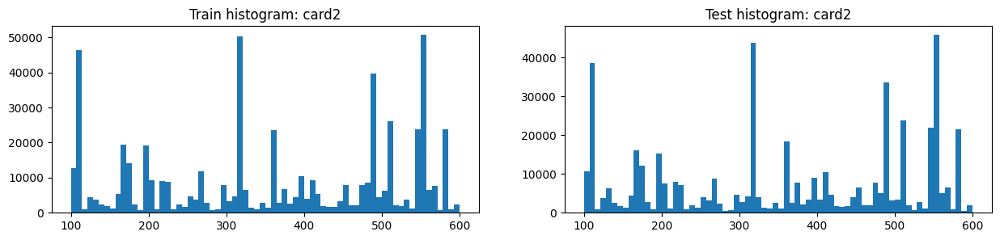

,card2,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,581607.000000,20240.000000,561367.000000,498037.000000,99008.000000,399030.000000
1,mean,362.555488,365.370850,362.453981,363.735379,358.809076,364.957595
2,std,157.793246,159.623511,157.726065,158.688653,157.772855,158.891431
3,min,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000
4,25%,214.000000,204.000000,215.000000,207.000000,204.000000,214.000000
5,50%,361.000000,375.000000,361.000000,369.000000,360.000000,375.000000
6,75%,512.000000,514.000000,512.000000,512.000000,512.000000,514.000000
7,max,600.000000,600.000000,600.000000,600.000000,600.000000,600.000000
8,unique values,501.000000,328.000000,501.000000,498.000000,497.000000,497.000000
9,NaNs,8933.000000,423.000000,8510.000000,8654.000000,2331.000000,6323.000000


,card2,Count in train (desc),Mean target,Sum target,Count in test
0,321.0,48935,0.028528,1396,42796.0
1,111.0,45191,0.021641,978,37346.0
2,555.0,41995,0.022836,959,38409.0
3,490.0,38145,0.024014,916,32351.0
4,583.0,21803,0.041233,899,19700.0
5,170.0,18214,0.031295,570,15197.0
6,194.0,16938,0.007675,130,14573.0
7,545.0,16355,0.086824,1420,15539.0
8,360.0,15190,0.010402,158,11342.0
9,514.0,14541,0.046214,672,12684.0


,card2,Count in train,Mean target,Sum target (desc),Count in test
0,545.0,16355,0.086824,1420,15539
1,321.0,48935,0.028528,1396,42796
2,111.0,45191,0.021641,978,37346
3,555.0,41995,0.022836,959,38409
4,490.0,38145,0.024014,916,32351
5,500.0,5045,0.180575,911,2430
6,583.0,21803,0.041233,899,19700
7,408.0,8012,0.083999,673,9148
8,514.0,14541,0.046214,672,12684
9,130.0,2746,0.239257,657,5395


,Column,Correlation with card2
0,card2,1.000000
1,V302,0.097911
2,V304,0.096949
3,V303,0.092447
4,V50,0.084508
5,V71,0.081179
375,V36,-0.042237
376,V13,-0.043501
377,V12,-0.043553
378,V53,-0.043736


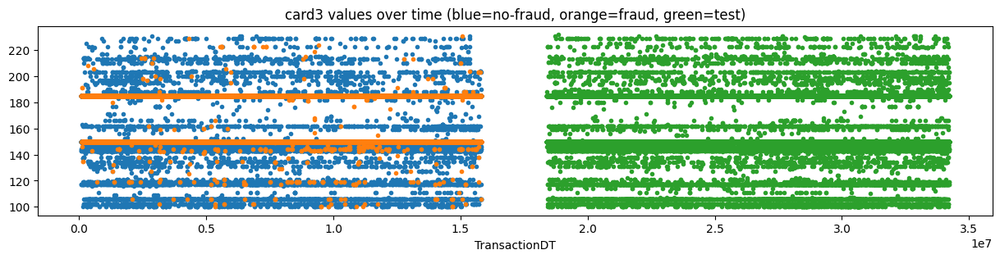

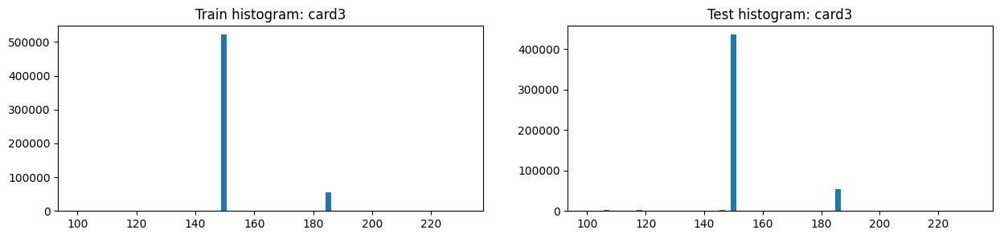

,card3,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,588975.000000,20624.000000,568351.000000,503689.000000,100033.000000,403657.000000
1,mean,153.194925,162.368648,152.862034,153.543409,152.127938,153.894177
2,std,11.336444,17.495775,10.904432,12.443013,10.591923,12.836503
3,min,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000
4,25%,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000
5,50%,150.000000,150.000000,150.000000,150.000000,150.000000,150.000000
6,75%,150.000000,185.000000,150.000000,150.000000,150.000000,150.000000
7,max,231.000000,231.000000,231.000000,232.000000,232.000000,231.000000
8,unique values,115.000000,63.000000,107.000000,116.000000,75.000000,111.000000
9,NaNs,1565.000000,39.000000,1526.000000,3002.000000,1306.000000,1696.000000


,card3,Count in train (desc),Mean target,Sum target,Count in test
0,150.0,521287,0.024568,12807,435558.0
1,185.0,56346,0.130657,7362,53614.0
2,106.0,1571,0.015277,24,1972.0
3,-999.0,1565,0.024920,39,3002.0
4,146.0,1252,0.019968,25,1218.0
5,144.0,1252,0.089457,112,1381.0
6,117.0,962,0.018711,18,1879.0
7,143.0,899,0.031146,28,771.0
8,119.0,750,0.093333,70,341.0
9,102.0,460,0.023913,11,738.0


,card3,Count in train,Mean target,Sum target (desc),Count in test
0,150.0,521287,0.024568,12807,435558
1,185.0,56346,0.130657,7362,53614
2,144.0,1252,0.089457,112,1381
3,119.0,750,0.093333,70,341
4,-999.0,1565,0.024920,39,3002
5,143.0,899,0.031146,28,771
6,146.0,1252,0.019968,25,1218
7,106.0,1571,0.015277,24,1972
8,117.0,962,0.018711,18,1879
9,223.0,55,0.254545,14,126


,Column,Correlation with card3
0,card3,1.000000
1,V15,0.759508
2,V94,0.758586
3,V16,0.744826
4,V57,0.744299
5,V79,0.738073
375,V53,-0.341900
376,V35,-0.348554
377,V54,-0.351214
378,V36,-0.356215


,card4,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,588963,20622,568341,503605,99996,403610
1,unique,4,4,4,4,4,4
2,top,visa,visa,visa,visa,visa,visa
3,freq,384767,13373,371394,334882,66078,268805
4,unique values,5,5,5,5,5,5
5,NaNs,1577,41,1536,3086,1343,1743
6,NaNs share,0.0027,0.002,0.0027,0.0061,0.0133,0.0043


,card4,Count in train (desc),Mean target,Sum target,Count in test
0,visa,384767,0.034756,13373,334882
1,mastercard,189217,0.034331,6496,158169
2,american express,8328,0.028698,239,7681
3,discover,6651,0.077282,514,2873
4,-999,1577,0.025999,41,3086


,card4,Count in train,Mean target,Sum target (desc),Count in test
0,visa,384767,0.034756,13373,334882
1,mastercard,189217,0.034331,6496,158169
2,discover,6651,0.077282,514,2873
3,american express,8328,0.028698,239,7681
4,-999,1577,0.025999,41,3086


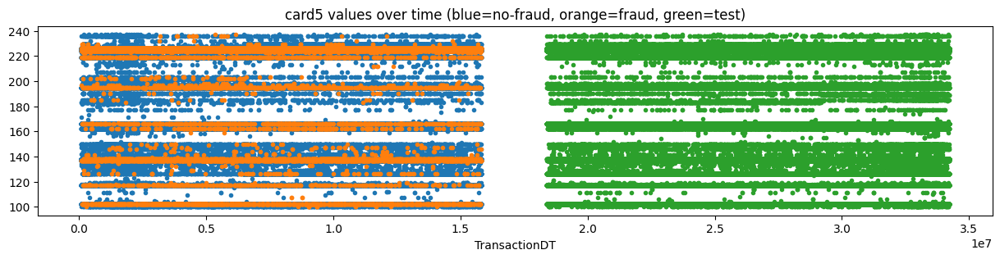

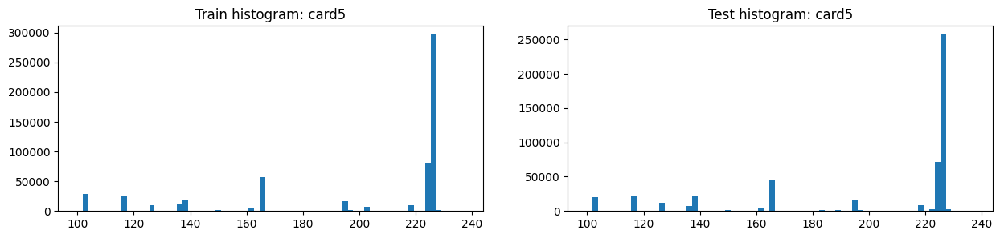

,card5,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,586281.000000,20453.000000,565828.000000,502144.000000,99816.000000,402329.000000
1,mean,199.278897,191.994328,199.542212,200.162975,200.406638,200.102588
2,std,41.244453,45.779886,41.046975,40.562461,40.584474,40.556792
3,min,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000
4,25%,166.000000,138.000000,166.000000,166.000000,166.000000,166.000000
5,50%,226.000000,224.000000,226.000000,226.000000,226.000000,226.000000
6,75%,226.000000,226.000000,226.000000,226.000000,226.000000,226.000000
7,max,237.000000,237.000000,237.000000,237.000000,237.000000,237.000000
8,unique values,120.000000,50.000000,119.000000,103.000000,70.000000,97.000000
9,NaNs,4259.000000,210.000000,4049.000000,4547.000000,1523.000000,3024.000000


,card5,Count in train (desc),Mean target,Sum target,Count in test
0,226.0,296546,0.029516,8753,256991.0
1,224.0,81513,0.038669,3152,71596.0
2,166.0,57140,0.011026,630,45790.0
3,102.0,29105,0.062945,1832,20386.0
4,117.0,25941,0.013646,354,21120.0
5,138.0,19737,0.085221,1682,22102.0
6,195.0,16945,0.040189,681,14951.0
7,137.0,11720,0.147184,1725,7730.0
8,126.0,10298,0.010196,105,11439.0
9,219.0,9924,0.057537,571,8402.0


,card5,Count in train,Mean target,Sum target (desc),Count in test
0,226.0,296546,0.029516,8753,256991
1,224.0,81513,0.038669,3152,71596
2,102.0,29105,0.062945,1832,20386
3,137.0,11720,0.147184,1725,7730
4,138.0,19737,0.085221,1682,22102
5,195.0,16945,0.040189,681,14951
6,166.0,57140,0.011026,630,45790
7,219.0,9924,0.057537,571,8402
8,117.0,25941,0.013646,354,21120
9,162.0,4524,0.066534,301,4512


,Column,Correlation with card5
0,card5,1.000000
1,D15,0.110301
2,D1,0.099504
3,D2,0.096315
4,D4,0.095706
5,D10,0.095575
375,V333,-0.265948
376,V324,-0.268091
377,V328,-0.270129
378,V329,-0.282868


,card6,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,588969,20624,568345,503684,100033,403652
1,unique,4,2,4,3,2,3
2,top,debit,debit,debit,debit,debit,debit
3,freq,439938,10674,429264,385021,78402,306620
4,unique values,5,3,5,4,3,4
5,NaNs,1571,39,1532,3007,1306,1701
6,NaNs share,0.0027,0.0019,0.0027,0.0059,0.0129,0.0042


,card6,Count in train (desc),Mean target,Sum target,Count in test
0,debit,439938,0.024263,10674,385021.0
1,credit,148986,0.066785,9950,118662.0
2,-999,1571,0.024825,39,3007.0
3,debit or credit,30,0.000000,0,NaN
4,charge card,15,0.000000,0,1.0


,card6,Count in train,Mean target,Sum target (desc),Count in test
0,debit,439938,0.024263,10674,385021.0
1,credit,148986,0.066785,9950,118662.0
2,-999,1571,0.024825,39,3007.0
3,debit or credit,30,0.000000,0,NaN
4,charge card,15,0.000000,0,1.0


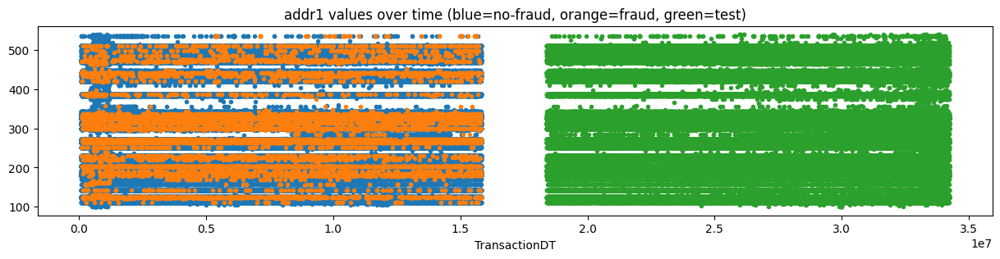

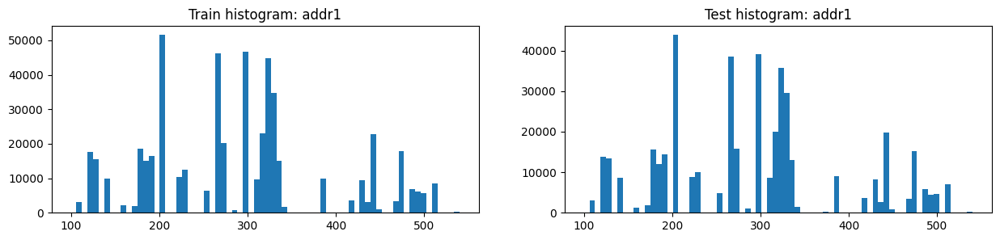

,addr1,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,524834.000000,12922.000000,511912.000000,441082.000000,91556.000000,349527.000000
1,mean,290.733794,294.317134,290.643341,291.846514,290.515029,292.194978
2,std,101.741072,103.584955,101.692564,102.062730,101.350107,102.245872
3,min,100.000000,110.000000,100.000000,100.000000,110.000000,100.000000
4,25%,204.000000,204.000000,204.000000,204.000000,204.000000,204.000000
5,50%,299.000000,299.000000,299.000000,299.000000,299.000000,299.000000
6,75%,330.000000,330.000000,330.000000,330.000000,330.000000,330.000000
7,max,540.000000,536.000000,540.000000,540.000000,536.000000,540.000000
8,unique values,333.000000,87.000000,333.000000,293.000000,83.000000,289.000000
9,NaNs,65706.000000,7741.000000,57965.000000,65609.000000,9783.000000,55826.000000


,addr1,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,65706,0.117813,7741,65609.0
1,299.0,46335,0.021258,985,38710.0
2,325.0,42751,0.025426,1087,34151.0
3,204.0,42020,0.026654,1120,35049.0
4,264.0,39870,0.018259,728,32710.0
5,330.0,26287,0.031955,840,22100.0
6,315.0,23078,0.017809,411,19957.0
7,441.0,20827,0.025592,533,18063.0
8,272.0,20141,0.028598,576,15788.0
9,123.0,16105,0.024713,398,12595.0


,addr1,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,65706,0.117813,7741,65609
1,204.0,42020,0.026654,1120,35049
2,325.0,42751,0.025426,1087,34151
3,299.0,46335,0.021258,985,38710
4,330.0,26287,0.031955,840,22100
5,264.0,39870,0.018259,728,32710
6,272.0,20141,0.028598,576,15788
7,441.0,20827,0.025592,533,18063
8,337.0,15149,0.028979,439,12932
9,315.0,23078,0.017809,411,19957


,Column,Correlation with addr1
0,addr1,1.000000
1,V326,0.050944
2,D13,0.050886
3,V327,0.047731
4,V330,0.042601
5,V329,0.042381
375,V100,-0.019761
376,V99,-0.021358
377,V287,-0.022924
378,V285,-0.028060


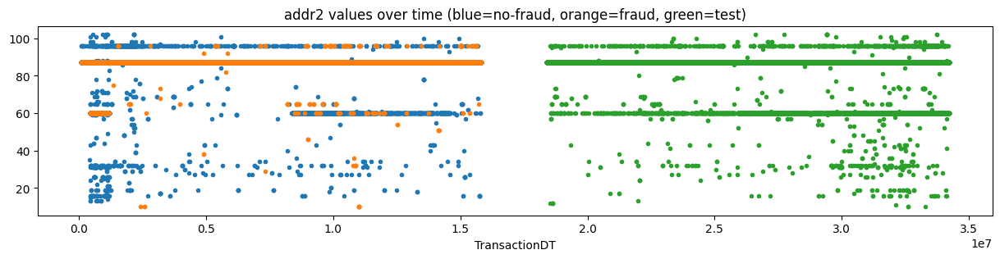

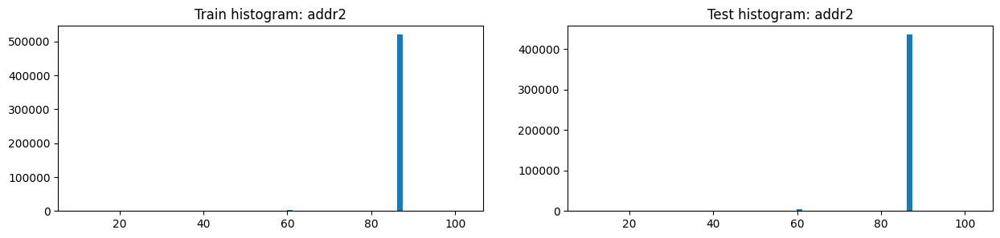

,addr2,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,524834.000000,12922.000000,511912.000000,441082.000000,91556.000000,349527.000000
1,mean,86.800630,86.286024,86.813620,86.723412,86.964372,86.660295
2,std,2.690623,4.936238,2.607742,2.987328,1.217604,3.294569
3,min,10.000000,10.000000,13.000000,10.000000,12.000000,10.000000
4,25%,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000
5,50%,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000
6,75%,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000
7,max,102.000000,96.000000,102.000000,102.000000,96.000000,102.000000
8,unique values,75.000000,18.000000,69.000000,73.000000,18.000000,72.000000
9,NaNs,65706.000000,7741.000000,57965.000000,65609.000000,9783.000000,55826.000000


,addr2,Count in train (desc),Mean target,Sum target,Count in test
0,87.0,520481,0.023972,12477,435934.0
1,-999.0,65706,0.117813,7741,65609.0
2,60.0,3084,0.090467,279,4041.0
3,96.0,638,0.139498,89,608.0
4,32.0,91,0.065934,6,61.0
5,65.0,82,0.536585,44,49.0
6,16.0,55,0.000000,0,22.0
7,31.0,47,0.000000,0,36.0
8,19.0,33,0.000000,0,23.0
9,26.0,25,0.000000,0,7.0


,addr2,Count in train,Mean target,Sum target (desc),Count in test
0,87.0,520481,0.023972,12477,435934
1,-999.0,65706,0.117813,7741,65609
2,60.0,3084,0.090467,279,4041
3,96.0,638,0.139498,89,608
4,65.0,82,0.536585,44,49
5,10.0,8,1.000000,8,3
6,32.0,91,0.065934,6,61
7,51.0,4,1.000000,4,1
8,46.0,3,1.000000,3,1
9,54.0,6,0.333333,2,10


,Column,Correlation with addr2
0,addr2,1.000000
1,D6,0.290653
2,D13,0.208817
3,D14,0.142099
4,V36,0.113776
5,V35,0.110642
375,V16,-0.712508
376,V15,-0.819340
377,V58,-0.876798
378,V57,-0.876965


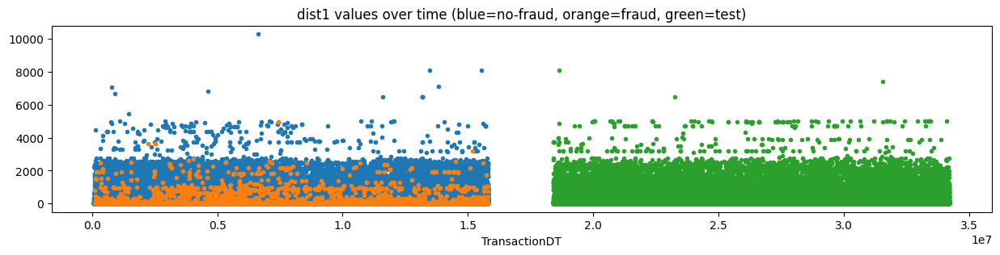

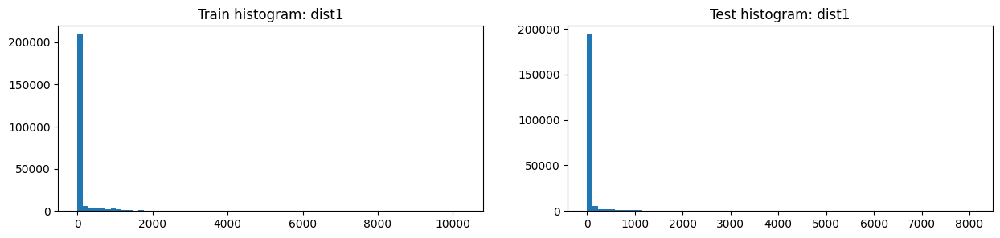

,dist1,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,238269.000000,4755.000000,233514.000000,215474.000000,47587.000000,167888.000000
1,mean,118.502180,174.588854,117.360098,87.065270,92.930464,85.404353
2,std,371.872026,424.232313,370.641879,314.131694,332.382991,308.742753
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000
5,50%,8.000000,10.000000,8.000000,8.000000,8.000000,8.000000
6,75%,24.000000,85.500000,24.000000,20.000000,20.000000,20.000000
7,max,10286.000000,4942.000000,10286.000000,8081.000000,8081.000000,7385.000000
8,unique values,2652.000000,471.000000,2636.000000,1989.000000,1347.000000,1843.000000
9,NaNs,352271.000000,15908.000000,336363.000000,291217.000000,53752.000000,237465.000000


,dist1,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,352271,0.045158,15908,291217.0
1,0.0,19824,0.019169,380,19278.0
2,1.0,18330,0.027932,512,18025.0
3,2.0,17028,0.011745,200,15687.0
4,4.0,13067,0.016454,215,12137.0
5,3.0,12808,0.011711,150,12333.0
6,5.0,12004,0.022243,267,11238.0
7,6.0,9843,0.014630,144,8775.0
8,7.0,9340,0.014668,137,9210.0
9,8.0,7731,0.015134,117,7333.0


,dist1,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,352271,0.045158,15908,291217
1,1.0,18330,0.027932,512,18025
2,0.0,19824,0.019169,380,19278
3,5.0,12004,0.022243,267,11238
4,4.0,13067,0.016454,215,12137
5,2.0,17028,0.011745,200,15687
6,3.0,12808,0.011711,150,12333
7,9.0,7728,0.018892,146,7608
8,6.0,9843,0.014630,144,8775
9,7.0,9340,0.014668,137,9210


,Column,Correlation with dist1
0,dist1,1.000000
1,V8,0.094938
2,V9,0.088465
3,V2,0.079191
4,V6,0.076624
5,V3,0.067514
166,V91,-0.066577
167,V70,-0.066690
168,V90,-0.068074
169,V69,-0.068412


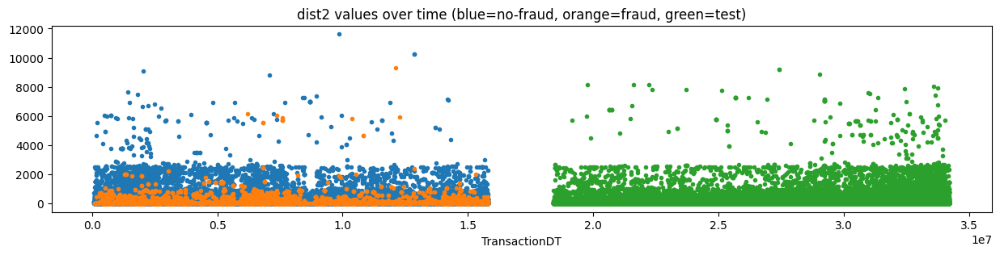

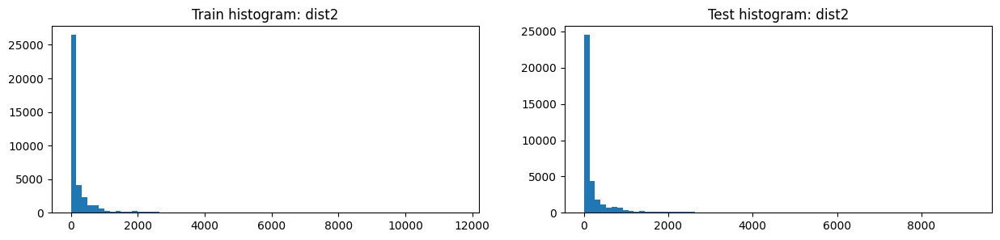

,dist2,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,37627.000000,3731.000000,33896.000000,36436.000000,4716.000000,31720.000000
1,mean,231.855423,201.472259,235.199758,237.175047,233.553223,237.713525
2,std,529.053494,451.589576,536.798492,556.450834,555.365698,556.618714
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,7.000000,7.000000,7.000000,7.000000,7.000000,7.000000
5,50%,37.000000,49.000000,36.000000,44.000000,50.000000,42.000000
6,75%,206.000000,233.000000,206.000000,196.000000,190.000000,196.000000
7,max,11623.000000,9337.000000,11623.000000,9213.000000,8169.000000,9213.000000
8,unique values,1752.000000,345.000000,1724.000000,1815.000000,611.000000,1730.000000
9,NaNs,552913.000000,16932.000000,535981.000000,470255.000000,96623.000000,373633.000000


,dist2,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,552913,0.030623,16932,470255.0
1,7.0,5687,0.087216,496,2660.0
2,0.0,3519,0.153453,540,2821.0
3,1.0,1374,0.139738,192,1565.0
4,9.0,742,0.148248,110,993.0
5,4.0,659,0.071320,47,557.0
6,2.0,556,0.035971,20,805.0
7,3.0,490,0.077551,38,606.0
8,68.0,485,0.096907,47,342.0
9,6.0,412,0.024272,10,497.0


,dist2,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,552913,0.030623,16932,470255
1,0.0,3519,0.153453,540,2821
2,7.0,5687,0.087216,496,2660
3,1.0,1374,0.139738,192,1565
4,9.0,742,0.148248,110,993
5,17.0,257,0.276265,71,367
6,199.0,362,0.193370,70,138
7,49.0,110,0.509091,56,74
8,478.0,102,0.539216,55,25
9,150.0,215,0.237209,51,43


,Column,Correlation with dist2
0,dist2,1.000000
1,V192,0.102090
2,V187,0.094572
3,V193,0.091043
4,V234,0.076003
5,V191,0.066564
342,V260,-0.044111
343,D6,-0.045920
344,D4,-0.058390
345,D12,-0.075249


,P_emaildomain,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,496084,17873,478211,437499,85891,351609
1,unique,59,42,59,60,59,60
2,top,gmail.com,gmail.com,gmail.com,gmail.com,gmail.com,gmail.com
3,freq,228355,9943,218412,207448,41104,166345
4,unique values,60,43,60,61,60,61
5,NaNs,94456,2790,91666,69192,15448,53744
6,NaNs share,0.1599,0.135,0.1609,0.1366,0.1524,0.1326


,P_emaildomain,Count in train (desc),Mean target,Sum target,Count in test
0,gmail.com,228355,0.043542,9943,207448
1,yahoo.com,100934,0.022757,2297,81850
2,-999,94456,0.029538,2790,69192
3,hotmail.com,45250,0.052950,2396,40399
4,anonymous.com,36998,0.023217,859,34064
5,aol.com,28289,0.021811,617,24048
6,comcast.net,7888,0.031187,246,6586
7,icloud.com,6267,0.031434,197,6049
8,outlook.com,5096,0.094584,482,4838
9,msn.com,4092,0.021994,90,3388


,P_emaildomain,Count in train,Mean target,Sum target (desc),Count in test
0,gmail.com,228355,0.043542,9943,207448
1,-999,94456,0.029538,2790,69192
2,hotmail.com,45250,0.052950,2396,40399
3,yahoo.com,100934,0.022757,2297,81850
4,anonymous.com,36998,0.023217,859,34064
5,aol.com,28289,0.021811,617,24048
6,outlook.com,5096,0.094584,482,4838
7,comcast.net,7888,0.031187,246,6586
8,icloud.com,6267,0.031434,197,6049
9,mail.com,559,0.189624,106,597


,R_emaildomain,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,137291,11227,126064,135870,18223,117647
1,unique,60,32,60,60,57,60
2,top,gmail.com,gmail.com,gmail.com,gmail.com,gmail.com,gmail.com
3,freq,57147,6811,50336,61738,8588,53150
4,unique values,61,33,61,61,58,61
5,NaNs,453249,9436,443813,370821,83116,287706
6,NaNs share,0.7675,0.4567,0.7788,0.7318,0.8202,0.7098


,R_emaildomain,Count in train (desc),Mean target,Sum target,Count in test
0,-999,453249,0.020819,9436,370821
1,gmail.com,57147,0.119184,6811,61738
2,hotmail.com,27509,0.077793,2140,25657
3,anonymous.com,20529,0.029130,598,19115
4,yahoo.com,11842,0.051512,610,9563
5,aol.com,3701,0.034855,129,3538
6,outlook.com,2507,0.165138,414,2504
7,comcast.net,1812,0.011589,21,1701
8,yahoo.com.mx,1508,0.010610,16,1235
9,icloud.com,1398,0.128755,180,1422


,R_emaildomain,Count in train,Mean target,Sum target (desc),Count in test
0,-999,453249,0.020819,9436,370821
1,gmail.com,57147,0.119184,6811,61738
2,hotmail.com,27509,0.077793,2140,25657
3,yahoo.com,11842,0.051512,610,9563
4,anonymous.com,20529,0.029130,598,19115
5,outlook.com,2507,0.165138,414,2504
6,icloud.com,1398,0.128755,180,1422
7,aol.com,3701,0.034855,129,3538
8,outlook.es,433,0.131640,57,420
9,mail.com,122,0.377049,46,219


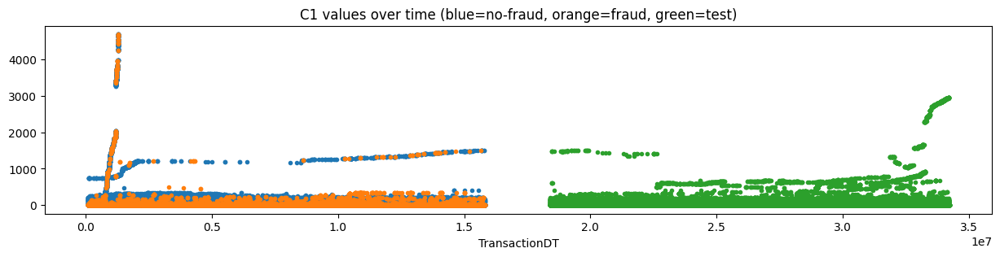

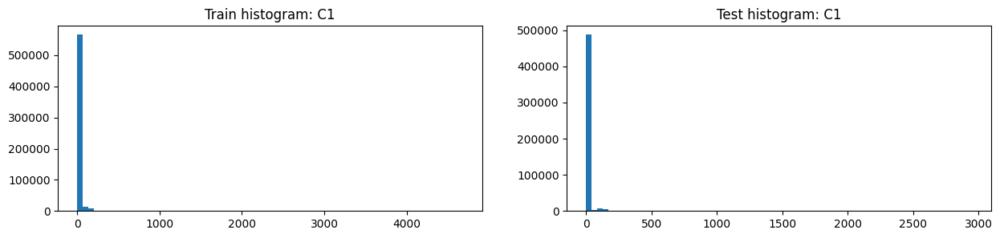

,C1,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590540.000000,20663.00000,569877.000000,506688.000000,101339.000000,405350.000000
1,mean,14.092458,35.53574,13.314952,10.093211,8.408707,10.514326
2,std,133.569018,242.97626,127.787969,79.334782,40.872210,86.307573
3,min,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,2.00000,1.000000,1.000000,2.000000,1.000000
6,75%,3.000000,6.00000,3.000000,3.000000,3.000000,3.000000
7,max,4685.000000,4682.00000,4685.000000,2950.000000,1501.000000,2950.000000
8,unique values,1657.000000,497.00000,1526.000000,1175.000000,344.000000,1118.000000
9,NaNs,0.000000,0.00000,0.000000,3.000000,0.000000,3.000000


,C1,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,316791,0.024230,7676,269951.0
1,2.0,105071,0.030284,3182,92449.0
2,3.0,51315,0.035876,1841,45254.0
3,4.0,28845,0.040596,1171,24949.0
4,5.0,17922,0.054179,971,14929.0
5,6.0,10567,0.053658,567,9207.0
6,7.0,7263,0.058240,423,5721.0
7,8.0,5072,0.066246,336,3996.0
8,9.0,3612,0.080011,289,2771.0
9,10.0,2904,0.091942,267,1969.0


,C1,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,316791,0.024230,7676,269951
1,2.0,105071,0.030284,3182,92449
2,3.0,51315,0.035876,1841,45254
3,4.0,28845,0.040596,1171,24949
4,5.0,17922,0.054179,971,14929
5,6.0,10567,0.053658,567,9207
6,7.0,7263,0.058240,423,5721
7,8.0,5072,0.066246,336,3996
8,9.0,3612,0.080011,289,2771
9,10.0,2904,0.091942,267,1969


,Column,Correlation with C1
0,C1,1.000000
1,C11,0.996515
2,C2,0.995089
3,C6,0.982238
4,C4,0.967800
5,C8,0.967746
375,V75,-0.051347
376,V76,-0.051632
377,TransactionID,-0.053154
378,V35,-0.054029


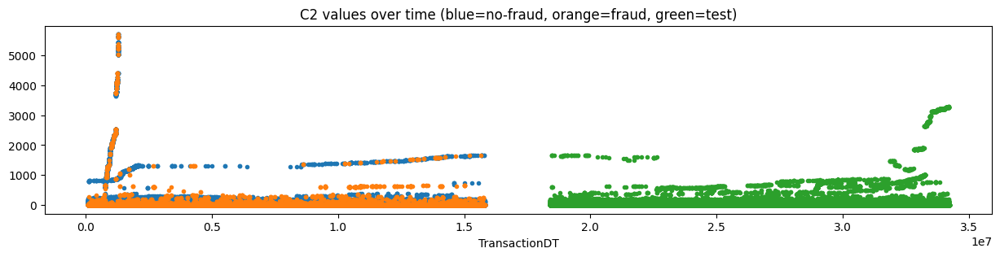

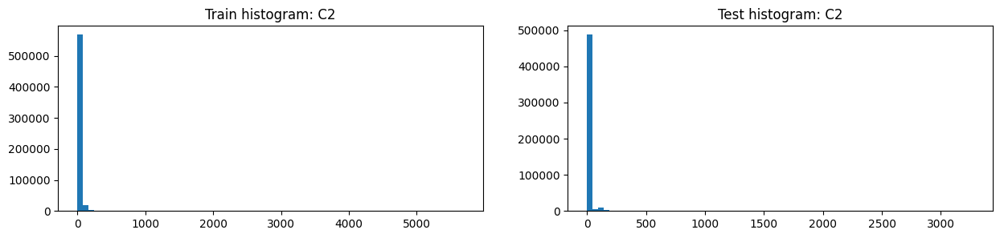

,C2,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590540.000000,20663.000000,569877.000000,506688.000000,101339.000000,405350.000000
1,mean,15.269734,45.509413,14.173283,10.714635,8.606923,11.241549
2,std,154.668899,287.813648,147.485925,88.896921,44.375338,96.874447
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,2.000000,1.000000,1.000000,2.000000,1.000000
6,75%,3.000000,7.000000,3.000000,3.000000,3.000000,3.000000
7,max,5691.000000,5690.000000,5691.000000,3275.000000,1672.000000,3275.000000
8,unique values,1216.000000,544.000000,1075.000000,1124.000000,370.000000,1054.000000
9,NaNs,0.000000,0.000000,0.000000,3.000000,0.000000,3.000000


,C2,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,316261,0.023073,7297,265435.0
1,2.0,103948,0.031978,3324,93084.0
2,3.0,51770,0.036160,1872,44267.0
3,4.0,28251,0.050370,1423,24329.0
4,5.0,16971,0.049496,840,14711.0
5,6.0,10682,0.049991,534,9662.0
6,7.0,7382,0.060824,449,6097.0
7,8.0,5105,0.053477,273,4387.0
8,9.0,3750,0.058933,221,3364.0
9,10.0,2797,0.085449,239,2432.0


,C2,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,316261,0.023073,7297,265435
1,2.0,103948,0.031978,3324,93084
2,3.0,51770,0.036160,1872,44267
3,4.0,28251,0.050370,1423,24329
4,5.0,16971,0.049496,840,14711
5,6.0,10682,0.049991,534,9662
6,7.0,7382,0.060824,449,6097
7,8.0,5105,0.053477,273,4387
8,10.0,2797,0.085449,239,2432
9,9.0,3750,0.058933,221,3364


,Column,Correlation with C2
0,C2,1.000000
1,C1,0.995089
2,C11,0.993898
3,C8,0.975863
4,C6,0.974845
5,C4,0.972134
375,TransactionID,-0.055186
376,V75,-0.056251
377,V76,-0.056896
378,V35,-0.059538


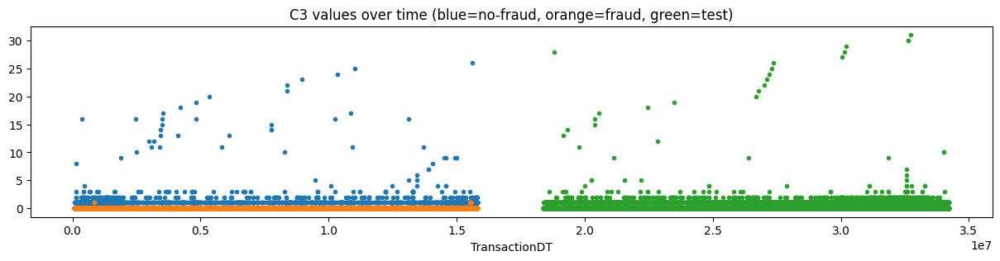

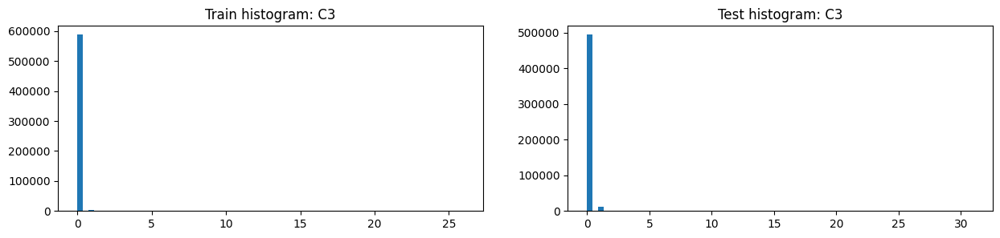

,C3,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590540.000000,20663.000000,569877.000000,506688.000000,101339.000000,405350.000000
1,mean,0.005644,0.000242,0.005840,0.027403,0.009365,0.031913
2,std,0.150536,0.015554,0.153208,0.227753,0.176030,0.238727
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,26.000000,1.000000,26.000000,31.000000,28.000000,31.000000
8,unique values,27.000000,2.000000,27.000000,32.000000,14.000000,26.000000
9,NaNs,0.000000,0.000000,0.000000,3.000000,0.000000,3.000000


,C3,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,588111,0.035126,20658,493779.0
1,1.0,2137,0.002340,5,12506.0
2,2.0,180,0.000000,0,320.0
3,3.0,58,0.000000,0,37.0
4,4.0,7,0.000000,0,11.0
5,16.0,6,0.000000,0,1.0
6,9.0,5,0.000000,0,3.0
7,11.0,5,0.000000,0,1.0
8,14.0,3,0.000000,0,1.0
9,13.0,3,0.000000,0,1.0


,C3,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,588111,0.035126,20658,493779
1,1.0,2137,0.002340,5,12506
2,15.0,2,0.000000,0,1
3,6.0,1,0.000000,0,1
4,19.0,1,0.000000,0,1
5,20.0,1,0.000000,0,1
6,21.0,1,0.000000,0,1
7,18.0,1,0.000000,0,1
8,23.0,1,0.000000,0,1
9,24.0,1,0.000000,0,1


,Column,Correlation with C3
0,C3,1.000000
1,V28,0.593655
2,V89,0.592326
3,V68,0.554881
4,V27,0.548193
5,D6,0.090308
361,V155,-0.039395
362,V82,-0.040171
363,V148,-0.040378
364,V154,-0.041643


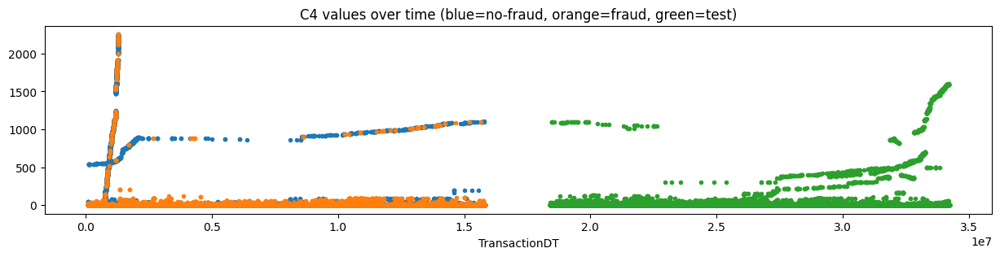

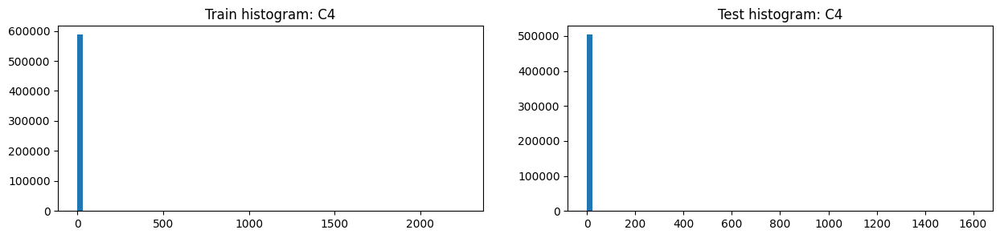

,C4,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590540.000000,20663.000000,569877.000000,506688.000000,101339.000000,405350.000000
1,mean,4.092185,15.077336,3.693878,2.385875,0.985040,2.736082
2,std,68.848459,125.673738,65.839255,41.942977,23.116076,45.440263
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,2.000000,0.000000,1.000000,0.000000,1.000000
7,max,2253.000000,2251.000000,2253.000000,1601.000000,1100.000000,1601.000000
8,unique values,1260.000000,224.000000,1180.000000,729.000000,99.000000,698.000000
9,NaNs,0.000000,0.000000,0.000000,3.000000,0.000000,3.000000


,C4,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,451883,0.020386,9212,371571.0
1,1.0,111817,0.051298,5736,107826.0
2,2.0,12994,0.128444,1669,13702.0
3,3.0,4949,0.144070,713,4307.0
4,4.0,1902,0.305468,581,1759.0
5,5.0,851,0.404230,344,1159.0
6,6.0,597,0.402010,240,713.0
7,7.0,372,0.325269,121,482.0
8,9.0,273,0.545788,149,298.0
9,10.0,233,0.682403,159,305.0


,C4,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,451883,0.020386,9212,371571
1,1.0,111817,0.051298,5736,107826
2,2.0,12994,0.128444,1669,13702
3,3.0,4949,0.144070,713,4307
4,4.0,1902,0.305468,581,1759
5,5.0,851,0.404230,344,1159
6,6.0,597,0.402010,240,713
7,10.0,233,0.682403,159,305
8,9.0,273,0.545788,149,298
9,7.0,372,0.325269,121,482


,Column,Correlation with C4
0,C4,1.000000
1,C11,0.974547
2,C2,0.972134
3,C1,0.967800
4,C6,0.962319
5,C8,0.959995
362,V54,-0.057470
363,V197,-0.058750
364,V35,-0.058768
365,V36,-0.060052


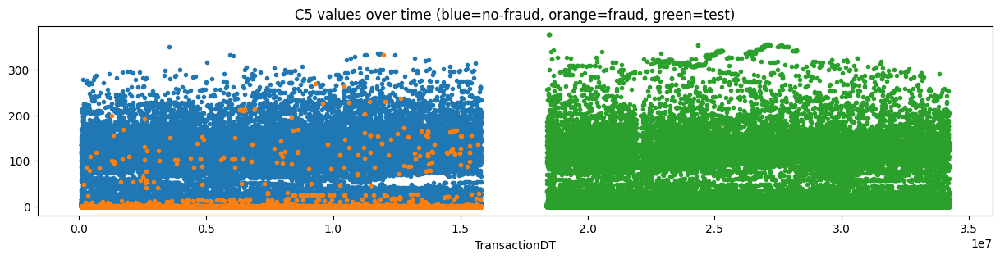

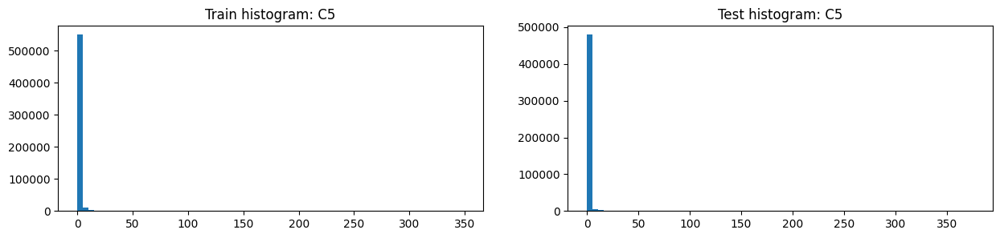

,C5,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590540.000000,20663.000000,569877.000000,506688.000000,101339.000000,405350.000000
1,mean,5.571526,1.406717,5.722537,4.962701,5.711493,4.775493
2,std,25.786976,12.946092,26.121841,25.462195,26.488371,25.195644
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
7,max,349.000000,331.000000,349.000000,376.000000,376.000000,355.000000
8,unique values,319.000000,124.000000,319.000000,354.000000,300.000000,353.000000
9,NaNs,0.000000,0.000000,0.000000,3.000000,0.000000,3.000000


,C5,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,372435,0.050369,18759,334573
1,1.0,122883,0.007560,929,96588
2,2.0,34776,0.010956,381,29363
3,3.0,13189,0.011980,158,10699
4,4.0,6828,0.006591,45,5446
5,5.0,3763,0.004252,16,2832
6,6.0,2837,0.004230,12,1938
7,7.0,1906,0.003673,7,1369
8,8.0,1443,0.009009,13,991
9,9.0,1076,0.009294,10,905


,C5,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,372435,0.050369,18759,334573
1,1.0,122883,0.007560,929,96588
2,2.0,34776,0.010956,381,29363
3,3.0,13189,0.011980,158,10699
4,4.0,6828,0.006591,45,5446
5,26.0,203,0.113300,23,119
6,14.0,420,0.054762,23,450
7,13.0,583,0.029160,17,546
8,5.0,3763,0.004252,16,2832
9,8.0,1443,0.009009,13,991


,Column,Correlation with C5
0,C5,1.000000
1,C9,0.925786
2,C13,0.717509
3,C14,0.378950
4,V70,0.284101
5,V49,0.279314
208,V51,-0.095805
209,V303,-0.098097
210,V50,-0.100054
211,V304,-0.108065


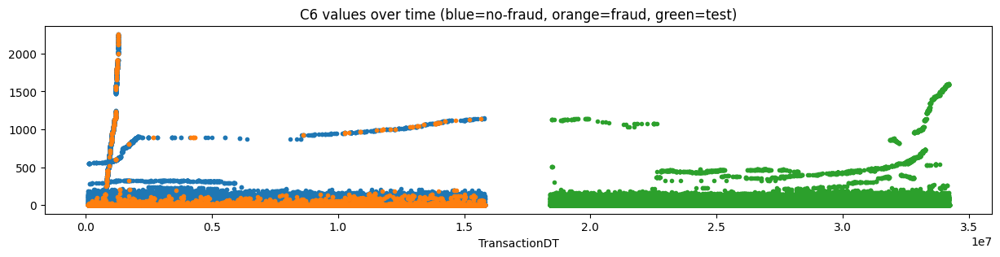

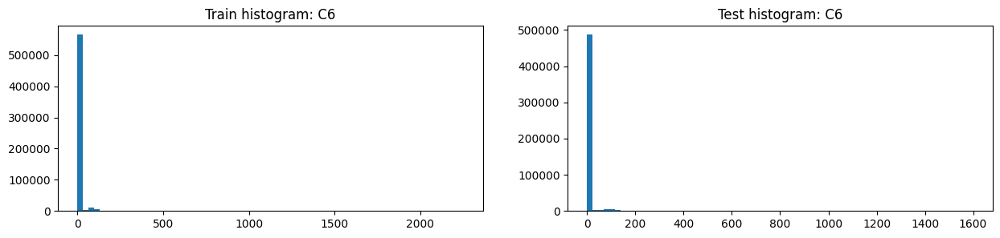

,C6,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590540.000000,20663.000000,569877.000000,506688.000000,101339.000000,405350.000000
1,mean,9.071082,16.923148,8.786377,6.854992,5.905969,7.092244
2,std,71.508467,126.298758,68.689176,46.783565,29.791262,50.136998
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,2.000000,3.000000,2.000000,2.000000,2.000000,2.000000
7,max,2253.000000,2251.000000,2253.000000,1601.000000,1138.000000,1601.000000
8,unique values,1328.000000,282.000000,1270.000000,835.000000,201.000000,820.000000
9,NaNs,0.000000,0.000000,0.000000,3.000000,0.000000,3.000000


,C6,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,341552,0.027764,9483,289685.0
1,2.0,86103,0.037850,3259,75316.0
2,0.0,49066,0.031305,1536,45707.0
3,3.0,35490,0.042575,1511,31815.0
4,4.0,17805,0.053300,949,16420.0
5,5.0,10187,0.059880,610,8914.0
6,6.0,6048,0.078042,472,5293.0
7,7.0,3934,0.054652,215,3366.0
8,8.0,3048,0.057415,175,2105.0
9,9.0,2335,0.098073,229,1563.0


,C6,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,341552,0.027764,9483,289685
1,2.0,86103,0.037850,3259,75316
2,0.0,49066,0.031305,1536,45707
3,3.0,35490,0.042575,1511,31815
4,4.0,17805,0.053300,949,16420
5,5.0,10187,0.059880,610,8914
6,6.0,6048,0.078042,472,5293
7,10.0,1817,0.128233,233,1267
8,9.0,2335,0.098073,229,1563
9,7.0,3934,0.054652,215,3366


,Column,Correlation with C6
0,C6,1.000000
1,C11,0.991105
2,C14,0.984201
3,C1,0.982238
4,C2,0.974845
5,C4,0.962319
375,V75,-0.050655
376,V35,-0.052205
377,V36,-0.052338
378,V197,-0.058367


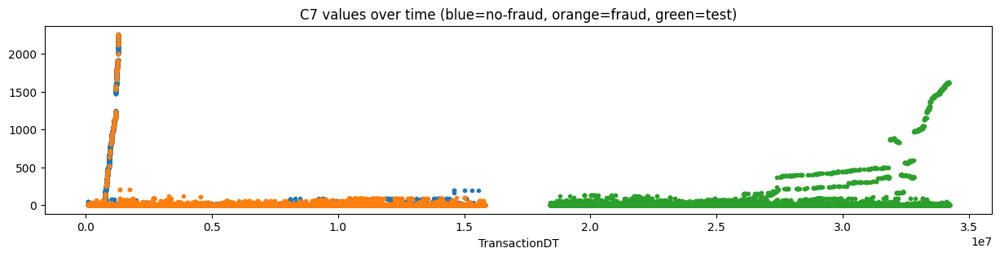

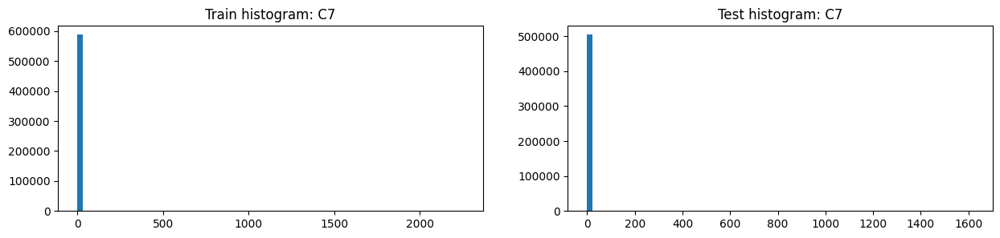

,C7,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590540.000000,20663.000000,569877.000000,506688.000000,101339.000000,405350.000000
1,mean,2.848478,11.977157,2.517484,1.678173,0.377999,2.003217
2,std,61.727304,115.143177,58.860773,37.874827,3.769156,42.297173
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,2255.000000,2253.000000,2255.000000,1621.000000,130.000000,1621.000000
8,unique values,1103.000000,197.000000,1018.000000,519.000000,74.000000,512.000000
9,NaNs,0.000000,0.000000,0.000000,3.000000,0.000000,3.000000


,C7,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,523142,0.024376,12752,438095.0
1,1.0,51966,0.067294,3497,50141.0
2,2.0,7314,0.141509,1035,8712.0
3,3.0,2033,0.232661,473,2734.0
4,4.0,1109,0.431019,478,1344.0
5,5.0,481,0.580042,279,691.0
6,6.0,409,0.491443,201,478.0
7,7.0,267,0.441948,118,369.0
8,9.0,233,0.626609,146,216.0
9,10.0,175,0.782857,137,199.0


,C7,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,523142,0.024376,12752,438095
1,1.0,51966,0.067294,3497,50141
2,2.0,7314,0.141509,1035,8712
3,4.0,1109,0.431019,478,1344
4,3.0,2033,0.232661,473,2734
5,5.0,481,0.580042,279,691
6,6.0,409,0.491443,201,478
7,9.0,233,0.626609,146,216
8,10.0,175,0.782857,137,199
9,7.0,267,0.441948,118,369


,Column,Correlation with C7
0,C7,1.000000
1,C12,0.999489
2,C10,0.985062
3,C8,0.982983
4,C2,0.938867
5,C1,0.926258
315,V54,-0.056192
316,V35,-0.056947
317,V36,-0.058191
318,TransactionID,-0.059485


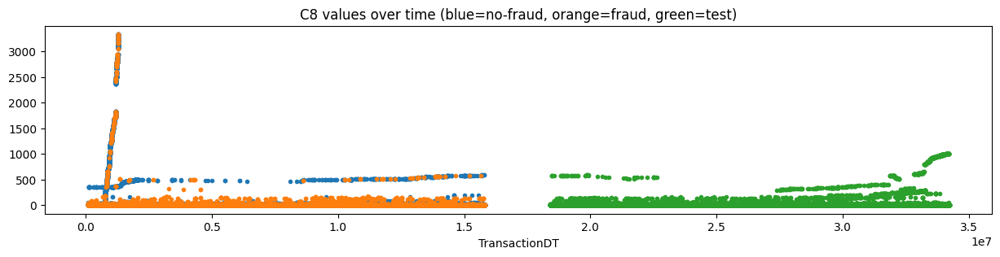

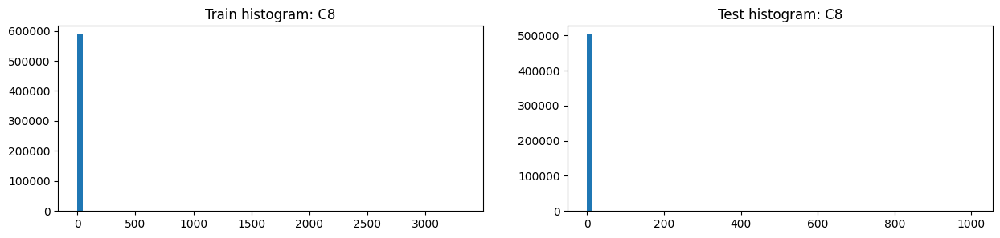

,C8,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590540.000000,20663.000000,569877.000000,506688.000000,101339.000000,405350.000000
1,mean,5.144574,21.242608,4.560881,1.893994,1.030146,2.109954
2,std,95.378574,176.695771,91.023016,26.766115,13.587585,29.140063
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,2.000000,0.000000,1.000000,0.000000,1.000000
7,max,3331.000000,3328.000000,3331.000000,1005.000000,584.000000,1005.000000
8,unique values,1253.000000,311.000000,1115.000000,443.000000,120.000000,422.000000
9,NaNs,0.000000,0.000000,0.000000,3.000000,0.000000,3.000000


,C8,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,447667,0.020899,9356,368637.0
1,1.0,104994,0.044393,4661,97332.0
2,2.0,15927,0.097633,1555,18261.0
3,3.0,5493,0.137266,754,6801.0
4,4.0,2817,0.182464,514,3172.0
5,8.0,1790,0.112849,202,810.0
6,6.0,1774,0.204059,362,1386.0
7,5.0,1721,0.222545,383,2035.0
8,7.0,988,0.237854,235,1015.0
9,9.0,718,0.307799,221,660.0


,C8,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,447667,0.020899,9356,368637
1,1.0,104994,0.044393,4661,97332
2,2.0,15927,0.097633,1555,18261
3,3.0,5493,0.137266,754,6801
4,4.0,2817,0.182464,514,3172
5,5.0,1721,0.222545,383,2035
6,6.0,1774,0.204059,362,1386
7,7.0,988,0.237854,235,1015
8,9.0,718,0.307799,221,660
9,8.0,1790,0.112849,202,810


,Column,Correlation with C8
0,C8,1.000000
1,C10,0.996970
2,C12,0.983027
3,C7,0.982983
4,C2,0.975863
5,C1,0.967746
362,V54,-0.056765
363,V35,-0.057420
364,V36,-0.058675
365,addr2,-0.059482


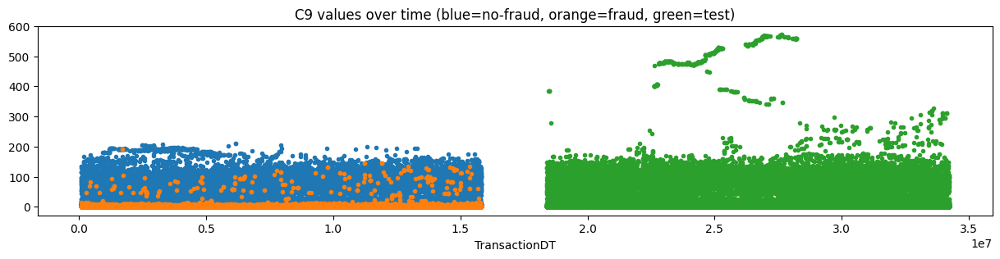

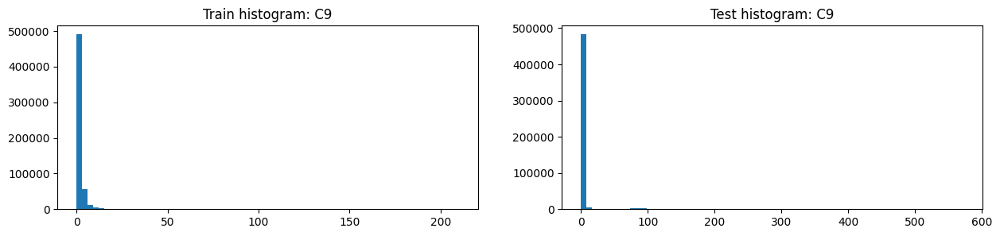

,C9,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590540.000000,20663.000000,569877.000000,506688.000000,101339.000000,405350.000000
1,mean,4.480240,1.703964,4.580904,4.611943,5.117645,4.485509
2,std,16.674897,8.453280,16.889451,21.282640,18.153293,21.993710
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
5,50%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
6,75%,2.000000,1.000000,2.000000,2.000000,2.000000,2.000000
7,max,210.000000,192.000000,210.000000,572.000000,386.000000,572.000000
8,unique values,205.000000,111.000000,205.000000,355.000000,175.000000,352.000000
9,NaNs,0.000000,0.000000,0.000000,3.000000,0.000000,3.000000


,C9,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,228938,0.019062,4364,191416.0
1,0.0,183795,0.066683,12256,157766.0
2,2.0,77829,0.021663,1686,68814.0
3,3.0,32505,0.026211,852,31510.0
4,4.0,16196,0.019820,321,15476.0
5,5.0,8648,0.034806,301,7835.0
6,6.0,5760,0.029514,170,4910.0
7,7.0,3529,0.026636,94,2970.0
8,8.0,2548,0.029827,76,2164.0
9,9.0,1871,0.078033,146,1480.0


,C9,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,183795,0.066683,12256,157766
1,1.0,228938,0.019062,4364,191416
2,2.0,77829,0.021663,1686,68814
3,3.0,32505,0.026211,852,31510
4,4.0,16196,0.019820,321,15476
5,5.0,8648,0.034806,301,7835
6,6.0,5760,0.029514,170,4910
7,9.0,1871,0.078033,146,1480
8,7.0,3529,0.026636,94,2970
9,8.0,2548,0.029827,76,2164


,Column,Correlation with C9
0,C9,1.000000
1,C5,0.925786
2,C13,0.704056
3,C14,0.397396
4,V70,0.266079
5,V49,0.264768
208,V51,-0.117889
209,V303,-0.121989
210,V50,-0.124945
211,V304,-0.134387


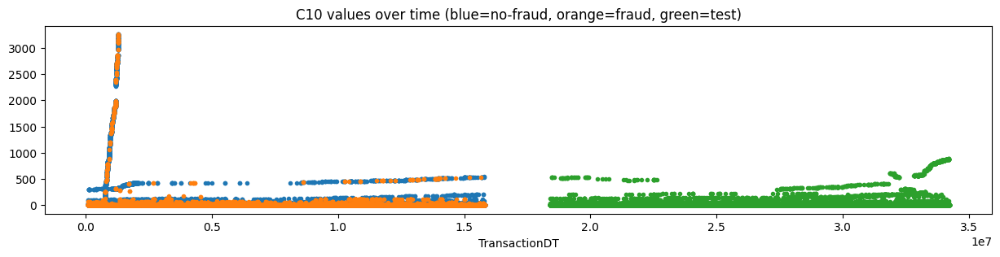

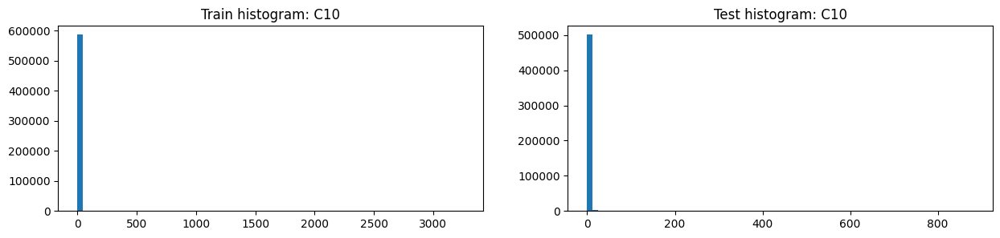

,C10,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590540.000000,20663.000000,569877.000000,506688.000000,101339.000000,405350.000000
1,mean,5.240343,19.493926,4.723526,1.810149,0.869409,2.045334
2,std,95.581443,176.919186,91.239098,23.692393,11.906035,25.805962
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,2.000000,0.000000,1.000000,0.000000,1.000000
7,max,3257.000000,3254.000000,3257.000000,881.000000,530.000000,881.000000
8,unique values,1231.000000,234.000000,1163.000000,457.000000,111.000000,439.000000
9,NaNs,0.000000,0.000000,0.000000,3.000000,0.000000,3.000000


,C10,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,453442,0.021273,9646,370978.0
1,1.0,100231,0.046303,4641,92343.0
2,2.0,14938,0.109452,1635,17752.0
3,3.0,6417,0.134175,861,6869.0
4,4.0,2836,0.197461,560,4002.0
5,5.0,1806,0.209856,379,2550.0
6,6.0,1286,0.209176,269,1858.0
7,7.0,817,0.250918,205,1235.0
8,8.0,627,0.280702,176,999.0
9,9.0,553,0.227848,126,782.0


,C10,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,453442,0.021273,9646,370978
1,1.0,100231,0.046303,4641,92343
2,2.0,14938,0.109452,1635,17752
3,3.0,6417,0.134175,861,6869
4,4.0,2836,0.197461,560,4002
5,5.0,1806,0.209856,379,2550
6,6.0,1286,0.209176,269,1858
7,7.0,817,0.250918,205,1235
8,8.0,627,0.280702,176,999
9,10.0,420,0.373810,157,705


,Column,Correlation with C10
0,C10,1.000000
1,C8,0.996970
2,C7,0.985062
3,C12,0.983817
4,C2,0.970624
5,C1,0.958202
362,TransactionDT,-0.057734
363,V35,-0.058026
364,V36,-0.059294
365,TransactionID,-0.062073


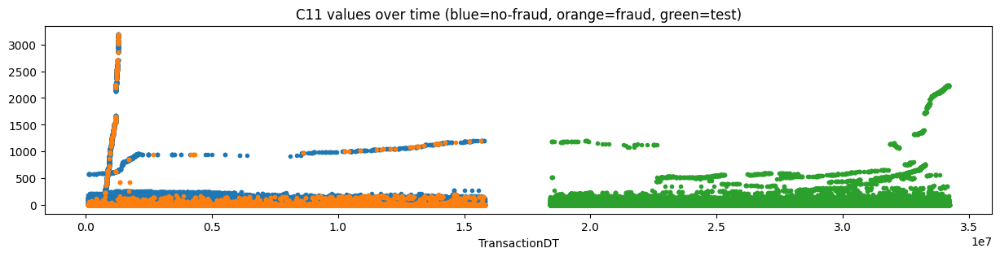

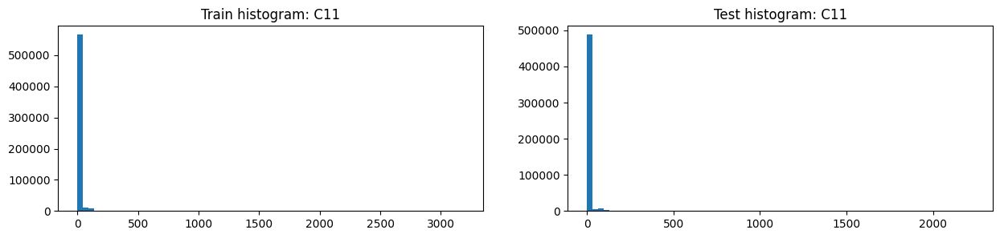

,C11,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590540.000000,20663.000000,569877.000000,506688.000000,101339.000000,405350.000000
1,mean,10.241521,23.857475,9.747825,7.484594,6.042649,7.845072
2,std,94.336292,170.966234,90.306569,61.322505,31.477895,66.724831
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
6,75%,2.000000,4.000000,2.000000,2.000000,2.000000,2.000000
7,max,3188.000000,3186.000000,3188.000000,2234.000000,1196.000000,2234.000000
8,unique values,1476.000000,330.000000,1400.000000,938.000000,246.000000,913.000000
9,NaNs,0.000000,0.000000,0.000000,3.000000,0.000000,3.000000


,C11,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,389692,0.025346,9877,342100.0
1,2.0,89677,0.040378,3621,79103.0
2,3.0,34463,0.047181,1626,27179.0
3,4.0,16051,0.062675,1006,12427.0
4,5.0,9972,0.061472,613,6394.0
5,6.0,5966,0.070734,422,3686.0
6,7.0,3663,0.068523,251,2466.0
7,8.0,2892,0.079876,231,1799.0
8,0.0,1864,0.068133,127,4909.0
9,9.0,1805,0.077008,139,1147.0


,C11,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,389692,0.025346,9877,342100
1,2.0,89677,0.040378,3621,79103
2,3.0,34463,0.047181,1626,27179
3,4.0,16051,0.062675,1006,12427
4,5.0,9972,0.061472,613,6394
5,6.0,5966,0.070734,422,3686
6,7.0,3663,0.068523,251,2466
7,8.0,2892,0.079876,231,1799
8,10.0,1634,0.091187,149,934
9,9.0,1805,0.077008,139,1147


,Column,Correlation with C11
0,C11,1.000000
1,C1,0.996515
2,C2,0.993898
3,C6,0.991105
4,C4,0.974547
5,C8,0.962722
375,V76,-0.052040
376,TransactionID,-0.054122
377,V35,-0.054781
378,V36,-0.055351


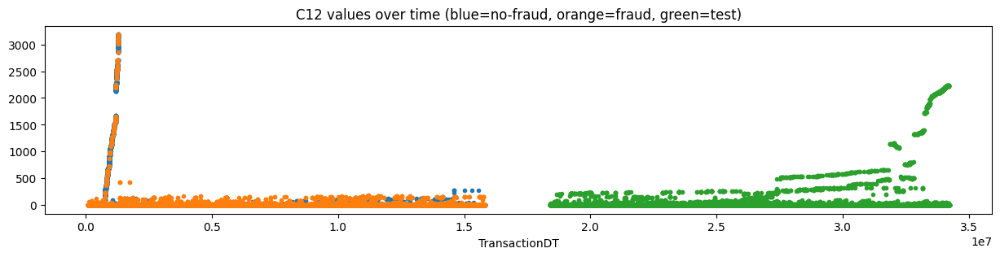

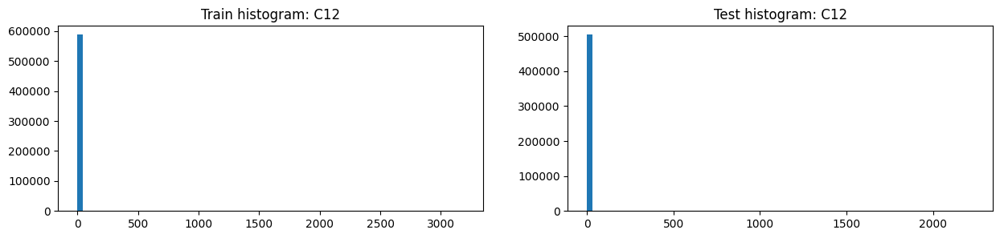

,C12,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590540.000000,20663.000000,569877.000000,506688.000000,101339.000000,405350.00000
1,mean,4.076227,18.597541,3.549703,2.649486,0.870711,3.09418
2,std,86.666218,162.082460,82.601169,53.973060,9.524789,60.14732
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
6,75%,0.000000,2.000000,0.000000,1.000000,0.000000,1.00000
7,max,3188.000000,3186.000000,3188.000000,2234.000000,240.000000,2234.00000
8,unique values,1199.000000,282.000000,1050.000000,664.000000,129.000000,628.00000
9,NaNs,0.000000,0.000000,0.000000,3.000000,0.000000,3.00000


,C12,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,489199,0.022897,11201,366881.0
1,1.0,76661,0.053339,4089,108347.0
2,2.0,12242,0.106437,1303,17804.0
3,3.0,4185,0.163441,684,4980.0
4,4.0,1716,0.245921,422,2064.0
5,5.0,1085,0.268203,291,997.0
6,6.0,629,0.352941,222,876.0
7,7.0,393,0.351145,138,432.0
8,8.0,262,0.438931,115,349.0
9,9.0,177,0.395480,70,227.0


,C12,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,489199,0.022897,11201,366881
1,1.0,76661,0.053339,4089,108347
2,2.0,12242,0.106437,1303,17804
3,3.0,4185,0.163441,684,4980
4,4.0,1716,0.245921,422,2064
5,5.0,1085,0.268203,291,997
6,6.0,629,0.352941,222,876
7,7.0,393,0.351145,138,432
8,8.0,262,0.438931,115,349
9,10.0,176,0.477273,84,185


,Column,Correlation with C12
0,C12,1.000000
1,C7,0.999489
2,C10,0.983817
3,C8,0.983027
4,C2,0.940258
5,C1,0.927939
328,V36,-0.058057
329,TransactionID,-0.058796
330,addr2,-0.116901
331,V11,-0.202619


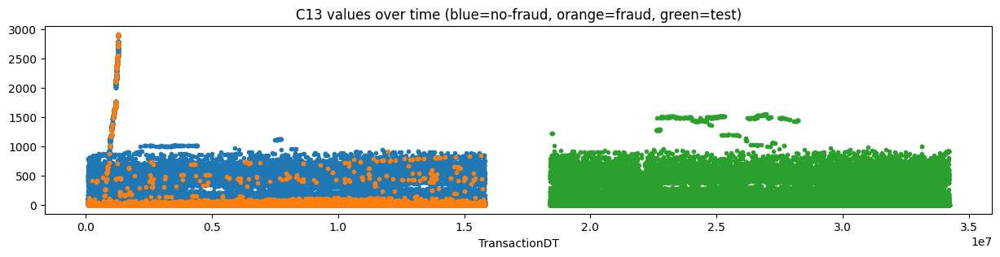

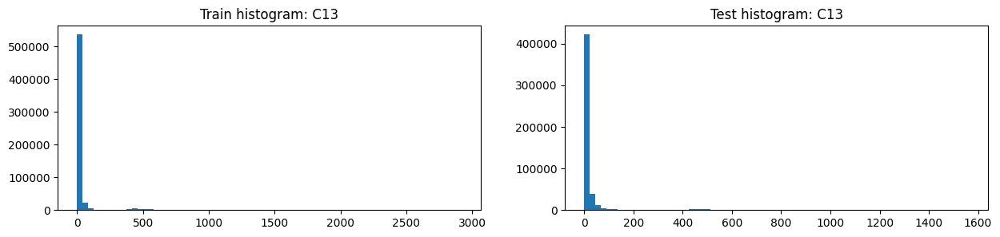

,C13,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590540.000000,20663.000000,569877.000000,501943.000000,101339.000000,400605.000000
1,mean,32.539918,24.967768,32.814474,27.816035,30.227395,27.205996
2,std,129.364844,165.979050,127.832166,101.114033,99.669624,101.467080
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,3.000000,1.000000,3.000000,3.000000,4.000000,2.000000
6,75%,12.000000,6.000000,13.000000,13.000000,15.000000,12.000000
7,max,2918.000000,2915.000000,2918.000000,1562.000000,1230.000000,1562.000000
8,unique values,1597.000000,392.000000,1567.000000,1070.000000,797.000000,1062.000000
9,NaNs,0.000000,0.000000,0.000000,4748.000000,0.000000,4748.000000


,C13,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,199337,0.028304,5642,168280.0
1,2.0,57616,0.039277,2263,49947.0
2,0.0,35460,0.141032,5001,29778.0
3,3.0,33033,0.033058,1092,27602.0
4,4.0,23704,0.035943,852,19240.0
5,5.0,18355,0.031926,586,15076.0
6,6.0,15127,0.031599,478,12659.0
7,7.0,13001,0.029536,384,10885.0
8,8.0,11424,0.032213,368,9603.0
9,9.0,10189,0.018549,189,8972.0


,C13,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,199337,0.028304,5642,168280
1,0.0,35460,0.141032,5001,29778
2,2.0,57616,0.039277,2263,49947
3,3.0,33033,0.033058,1092,27602
4,4.0,23704,0.035943,852,19240
5,5.0,18355,0.031926,586,15076
6,6.0,15127,0.031599,478,12659
7,7.0,13001,0.029536,384,10885
8,8.0,11424,0.032213,368,9603
9,13.0,8032,0.030752,247,6945


,Column,Correlation with C13
0,C13,1.000000
1,C14,0.880722
2,C6,0.808531
3,C11,0.779286
4,C1,0.774603
5,C2,0.751221
375,V21,-0.094623
376,V31,-0.096270
377,V34,-0.098281
378,V15,-0.098404


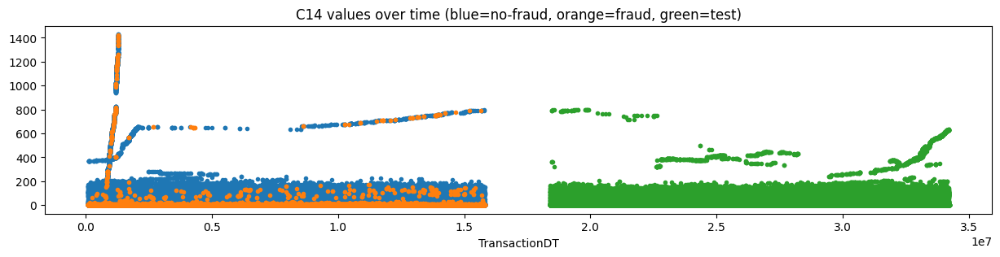

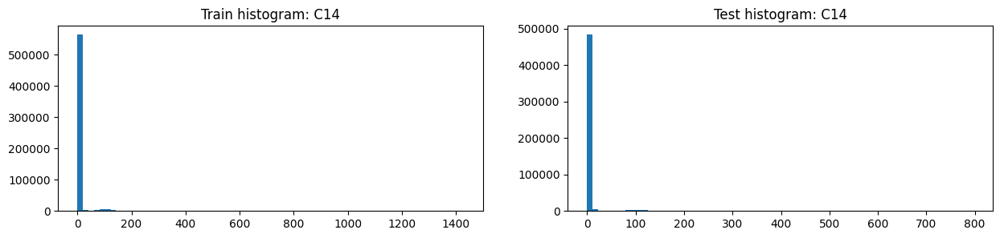

,C14,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590540.000000,20663.000000,569877.000000,506688.000000,101339.000000,405350.000000
1,mean,8.295215,10.356047,8.220491,6.083890,6.089058,6.082590
2,std,49.544262,82.902579,47.898725,28.315616,25.507991,28.975051
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,2.000000,2.000000,2.000000,2.000000,3.000000,2.000000
7,max,1429.000000,1426.000000,1429.000000,797.000000,797.000000,748.000000
8,unique values,1108.000000,244.000000,1085.000000,570.000000,204.000000,548.000000
9,NaNs,0.000000,0.000000,0.000000,3.000000,0.000000,3.000000


,C14,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,320189,0.026859,8600,278331.0
1,2.0,93843,0.027663,2596,81914.0
2,3.0,44471,0.026939,1198,38444.0
3,0.0,35947,0.145047,5214,34564.0
4,4.0,25390,0.030248,768,21074.0
5,5.0,15655,0.026828,420,11757.0
6,6.0,8563,0.032932,282,6781.0
7,7.0,5030,0.031014,156,3987.0
8,8.0,3471,0.048113,167,2583.0
9,9.0,2651,0.064881,172,2203.0


,C14,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,320189,0.026859,8600,278331
1,0.0,35947,0.145047,5214,34564
2,2.0,93843,0.027663,2596,81914
3,3.0,44471,0.026939,1198,38444
4,4.0,25390,0.030248,768,21074
5,5.0,15655,0.026828,420,11757
6,6.0,8563,0.032932,282,6781
7,9.0,2651,0.064881,172,2203
8,8.0,3471,0.048113,167,2583
9,7.0,5030,0.031014,156,3987


,Column,Correlation with C14
0,C14,1.000000
1,C6,0.984201
2,C11,0.962465
3,C1,0.951761
4,C2,0.936148
5,C4,0.907676
375,V31,-0.073593
376,V15,-0.074301
377,V21,-0.075669
378,V33,-0.077545


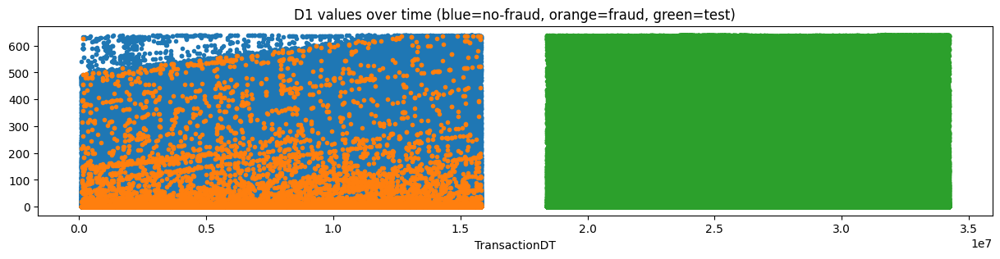

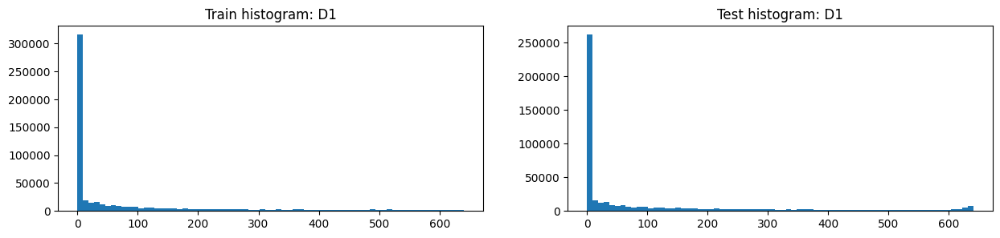

,D1,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,589271.000000,20617.000000,568654.000000,500660.000000,100922.000000,399739.000000
1,mean,94.347568,38.711306,96.364705,108.207504,116.985543,105.991247
2,std,157.660387,100.915599,158.973258,176.964526,180.117849,176.090322
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,3.000000,0.000000,4.000000,5.000000,16.000000,3.000000
6,75%,122.000000,14.000000,126.000000,148.000000,167.000000,142.000000
7,max,640.000000,637.000000,640.000000,641.000000,638.000000,641.000000
8,unique values,642.000000,578.000000,642.000000,643.000000,640.000000,643.000000
9,NaNs,1269.000000,46.000000,1223.000000,6031.000000,417.000000,5614.000000


,D1,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,280130,0.042084,11789,227724
1,1.0,8634,0.120454,1040,8253
2,2.0,4969,0.114107,567,5005
3,3.0,3954,0.098634,390,4084
4,4.0,3570,0.075350,269,3395
5,7.0,3455,0.043994,152,3317
6,6.0,3164,0.075853,240,2867
7,5.0,3076,0.076723,236,2873
8,14.0,2979,0.035247,105,2569
9,8.0,2637,0.056883,150,2275


,D1,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,280130,0.042084,11789,227724
1,1.0,8634,0.120454,1040,8253
2,2.0,4969,0.114107,567,5005
3,3.0,3954,0.098634,390,4084
4,4.0,3570,0.075350,269,3395
5,6.0,3164,0.075853,240,2867
6,5.0,3076,0.076723,236,2873
7,9.0,2387,0.067449,161,1939
8,7.0,3455,0.043994,152,3317
9,8.0,2637,0.056883,150,2275


,Column,Correlation with D1
0,D1,1.000000
1,D2,0.981311
2,D15,0.638957
3,D11,0.592629
4,D4,0.585714
5,D10,0.562145
375,V153,-0.269759
376,V197,-0.272491
377,V194,-0.295450
378,V283,-0.355794


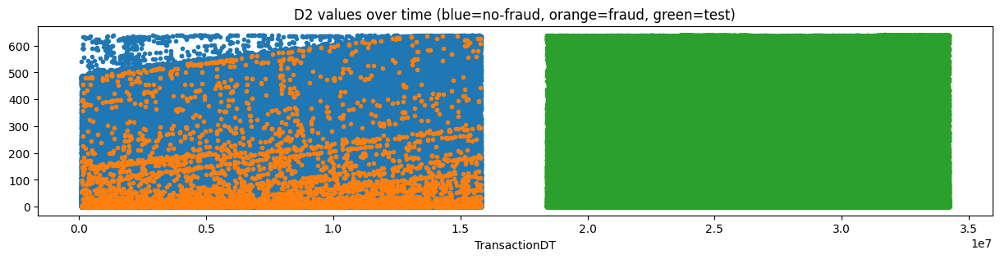

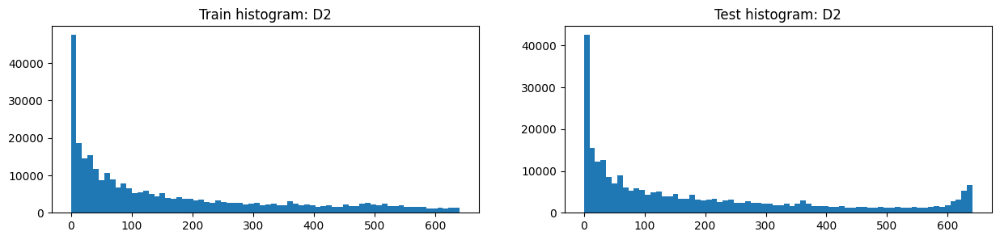

,D2,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,309743.000000,7870.000000,301873.000000,271922.000000,58869.000000,213054.000000
1,mean,169.563231,77.774206,171.956223,188.666621,190.231582,188.233701
2,std,177.315865,128.697847,177.773639,197.099611,195.973461,197.407591
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,26.000000,2.000000,27.000000,26.000000,29.000000,24.000000
5,50%,97.000000,16.000000,100.000000,112.000000,118.000000,111.000000
6,75%,276.000000,95.000000,280.000000,305.000000,301.000000,307.000000
7,max,640.000000,637.000000,640.000000,641.000000,638.000000,641.000000
8,unique values,642.000000,542.000000,642.000000,643.000000,640.000000,643.000000
9,NaNs,280797.000000,12793.000000,268004.000000,234769.000000,42470.000000,192299.000000


,D2,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,280797,0.045560,12793,234769
1,0.0,15124,0.061822,935,11944
2,1.0,6654,0.114968,765,6467
3,2.0,4454,0.099461,443,4445
4,3.0,3677,0.088659,326,3829
5,4.0,3344,0.063397,212,3162
6,7.0,3331,0.036325,121,3198
7,6.0,3068,0.067471,207,2771
8,5.0,2972,0.066285,197,2752
9,14.0,2919,0.029805,87,2477


,D2,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,280797,0.045560,12793,234769
1,0.0,15124,0.061822,935,11944
2,1.0,6654,0.114968,765,6467
3,2.0,4454,0.099461,443,4445
4,3.0,3677,0.088659,326,3829
5,4.0,3344,0.063397,212,3162
6,6.0,3068,0.067471,207,2771
7,5.0,2972,0.066285,197,2752
8,7.0,3331,0.036325,121,3198
9,8.0,2593,0.042422,110,2140


,Column,Correlation with D2
0,D2,1.000000
1,D1,0.981311
2,D12,0.668833
3,D15,0.618243
4,D6,0.601299
5,D4,0.570017
375,V174,-0.335111
376,V283,-0.375585
377,V282,-0.453760
378,V289,-0.507014


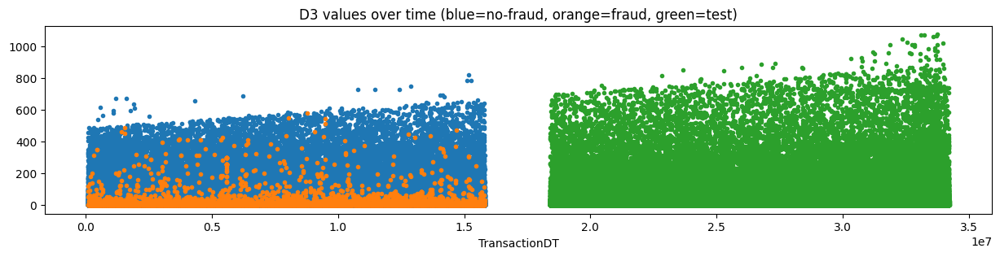

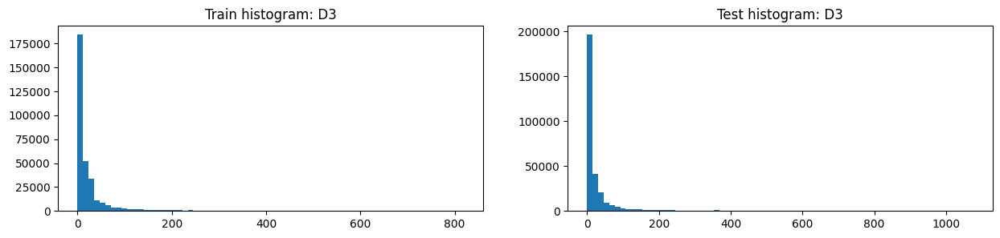

,D3,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,327662.000000,9619.000000,318043.000000,303549.000000,63607.000000,239943.000000
1,mean,28.343348,11.744880,28.845357,33.394727,29.559294,34.411381
2,std,62.384721,42.005468,62.830058,82.558210,68.249815,85.924044
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
5,50%,8.000000,1.000000,8.000000,7.000000,8.000000,7.000000
6,75%,27.000000,5.000000,28.000000,28.000000,28.000000,28.000000
7,max,819.000000,582.000000,819.000000,1076.000000,754.000000,1076.000000
8,unique values,650.000000,262.000000,650.000000,888.000000,654.000000,888.000000
9,NaNs,262878.000000,11044.000000,251834.000000,203142.000000,37732.000000,165410.000000


,D3,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,262878,0.042012,11044,203142.0
1,0.0,73094,0.060251,4404,73232.0
2,1.0,21258,0.069386,1475,20276.0
3,2.0,13789,0.046776,645,13103.0
4,7.0,13320,0.015015,200,11442.0
5,3.0,10786,0.031986,345,10226.0
6,4.0,9552,0.026068,249,8664.0
7,14.0,9547,0.011312,108,8060.0
8,6.0,9245,0.020227,187,8093.0
9,5.0,8800,0.022386,197,7722.0


,D3,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,262878,0.042012,11044,203142
1,0.0,73094,0.060251,4404,73232
2,1.0,21258,0.069386,1475,20276
3,2.0,13789,0.046776,645,13103
4,3.0,10786,0.031986,345,10226
5,4.0,9552,0.026068,249,8664
6,7.0,13320,0.015015,200,11442
7,5.0,8800,0.022386,197,7722
8,6.0,9245,0.020227,187,8093
9,8.0,8092,0.016189,131,6859


,Column,Correlation with D3
0,D3,1.000000
1,D7,0.818080
2,D5,0.707425
3,D12,0.349025
4,D6,0.304947
5,D1,0.280423
374,V144,-0.266504
375,V330,-0.276352
376,V328,-0.279979
377,V327,-0.341241


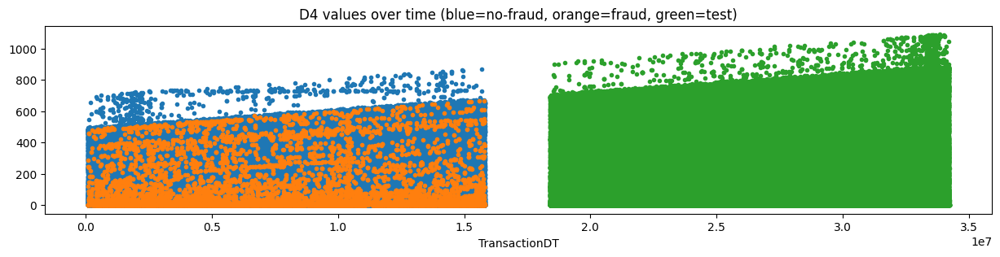

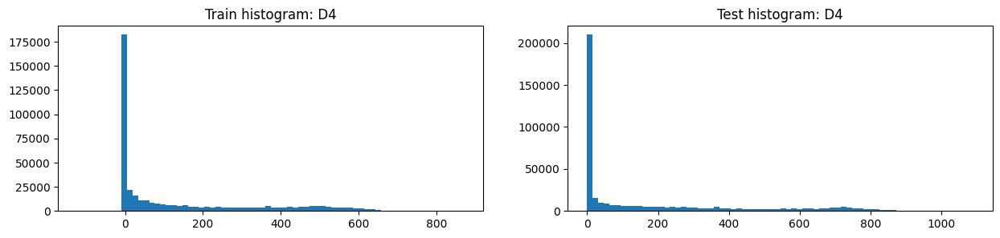

,D4,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421618.000000,14567.000000,407051.000000,429840.000000,80248.000000,349593.000000
1,mean,140.002441,72.102904,142.432339,175.060799,180.750735,173.754323
2,std,191.096774,140.656090,192.213375,250.417470,233.899500,254.039684
3,min,-122.000000,0.000000,-122.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,26.000000,1.000000,28.000000,21.000000,54.000000,14.000000
6,75%,253.000000,61.000000,261.000000,290.000000,313.000000,284.000000
7,max,869.000000,667.000000,869.000000,1091.000000,924.000000,1091.000000
8,unique values,809.000000,606.000000,809.000000,1057.000000,779.000000,1056.000000
9,NaNs,168922.000000,6096.000000,162826.000000,76851.000000,21091.000000,55760.000000


,D4,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,168922,0.036088,6096,76851.0
1,0.0,166571,0.039641,6603,178278.0
2,1.0,5315,0.144873,770,5750.0
3,2.0,3385,0.126145,427,3502.0
4,3.0,2572,0.108476,279,2871.0
5,4.0,2354,0.084962,200,2459.0
6,7.0,2317,0.060855,141,2165.0
7,5.0,2172,0.100829,219,2125.0
8,14.0,2117,0.033066,70,1644.0
9,6.0,2038,0.074092,151,2093.0


,D4,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,166571,0.039641,6603,178278
1,-999.0,168922,0.036088,6096,76851
2,1.0,5315,0.144873,770,5750
3,2.0,3385,0.126145,427,3502
4,3.0,2572,0.108476,279,2871
5,5.0,2172,0.100829,219,2125
6,4.0,2354,0.084962,200,2459
7,6.0,2038,0.074092,151,2093
8,7.0,2317,0.060855,141,2165
9,9.0,1548,0.080749,125,1241


,Column,Correlation with D4
0,D4,1.000000
1,D12,0.999999
2,D6,0.956966
3,D15,0.751546
4,D11,0.657797
5,D10,0.636928
375,V149,-0.360508
376,V155,-0.373805
377,V148,-0.376986
378,V154,-0.377323


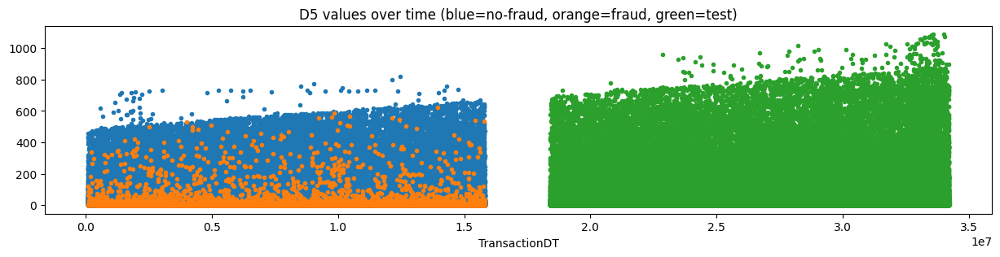

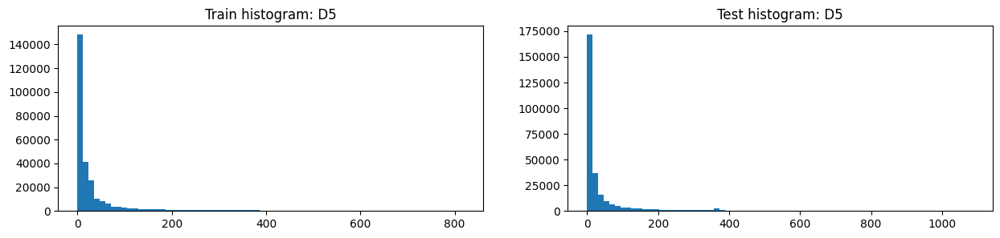

,D5,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,280699.000000,10880.000000,269819.000000,282316.000000,58085.000000,224232.000000
1,mean,42.335965,13.687776,43.491155,50.977752,42.060222,53.287649
2,std,89.000144,51.891635,89.985719,116.829786,94.246337,121.893591
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000
5,50%,10.000000,0.000000,10.000000,8.000000,9.000000,8.000000
6,75%,32.000000,3.000000,34.000000,34.000000,32.000000,34.000000
7,max,819.000000,625.000000,819.000000,1088.000000,779.000000,1088.000000
8,unique values,689.000000,342.000000,689.000000,962.000000,711.000000,962.000000
9,NaNs,309841.000000,9783.000000,300058.000000,224375.000000,43254.000000,181121.000000


,D5,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,309841,0.031574,9783,224375
1,0.0,65377,0.101534,6638,73887
2,1.0,15282,0.065829,1006,15642
3,2.0,10244,0.044026,451,10188
4,7.0,9734,0.015307,149,9103
5,3.0,7987,0.033805,270,7977
6,14.0,7340,0.008311,61,6557
7,4.0,7176,0.027592,198,6755
8,6.0,6907,0.020414,141,6521
9,5.0,6696,0.025090,168,6196


,D5,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,309841,0.031574,9783,224375
1,0.0,65377,0.101534,6638,73887
2,1.0,15282,0.065829,1006,15642
3,2.0,10244,0.044026,451,10188
4,3.0,7987,0.033805,270,7977
5,4.0,7176,0.027592,198,6755
6,5.0,6696,0.025090,168,6196
7,7.0,9734,0.015307,149,9103
8,6.0,6907,0.020414,141,6521
9,8.0,6140,0.018567,114,5549


,Column,Correlation with D5
0,D5,1.000000
1,D7,0.986496
2,D3,0.707425
3,D12,0.565222
4,D6,0.551310
5,D4,0.313650
372,V155,-0.344677
373,V153,-0.346386
374,V148,-0.347020
375,V158,-0.367735


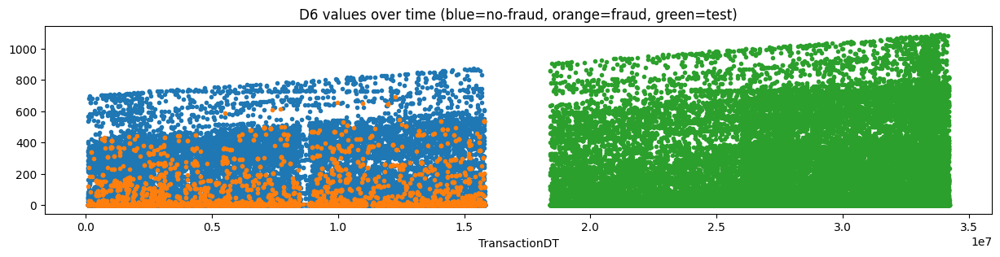

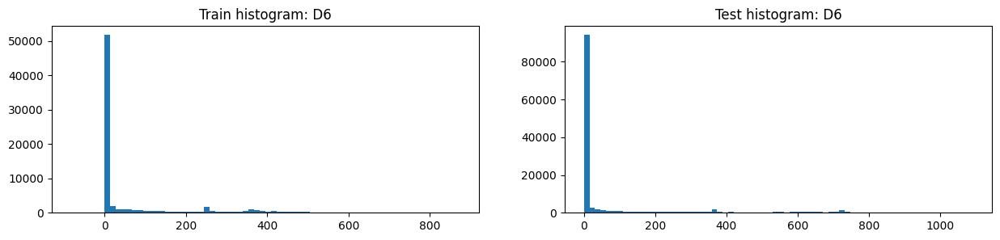

,D6,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,73187.000000,7718.000000,65469.000000,124783.000000,11194.000000,113589.000000
1,mean,69.805717,45.856439,72.629046,82.443145,89.538503,81.743910
2,std,143.669253,101.424445,147.600963,192.867671,178.595333,194.204124
3,min,-83.000000,0.000000,-83.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,40.000000,24.000000,43.000000,13.000000,68.750000,10.000000
7,max,873.000000,694.000000,873.000000,1091.000000,939.000000,1091.000000
8,unique values,830.000000,381.000000,830.000000,1073.000000,726.000000,1072.000000
9,NaNs,517353.000000,12945.000000,504408.000000,381908.000000,90145.000000,291764.000000


,D6,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,517353,0.025022,12945,381908.0
1,0.0,45782,0.092897,4253,83120.0
2,1.0,1588,0.261335,415,2475.0
3,256.0,895,0.012291,11,22.0
4,2.0,855,0.215205,184,1482.0
5,3.0,642,0.208723,134,1192.0
6,4.0,579,0.143351,83,927.0
7,5.0,436,0.236239,103,783.0
8,7.0,380,0.184211,70,717.0
9,6.0,353,0.141643,50,710.0


,D6,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,517353,0.025022,12945,381908
1,0.0,45782,0.092897,4253,83120
2,1.0,1588,0.261335,415,2475
3,2.0,855,0.215205,184,1482
4,3.0,642,0.208723,134,1192
5,5.0,436,0.236239,103,783
6,4.0,579,0.143351,83,927
7,7.0,380,0.184211,70,717
8,9.0,258,0.213178,55,352
9,8.0,288,0.180556,52,474


,Column,Correlation with D6
0,D6,1.000000
1,D12,0.976834
2,D4,0.956966
3,D15,0.700615
4,D2,0.601299
5,D5,0.551310
342,V149,-0.698995
343,V155,-0.703838
344,V148,-0.703948
345,V154,-0.704417


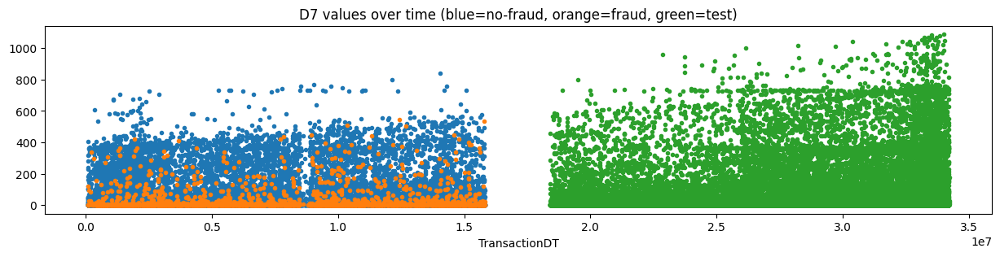

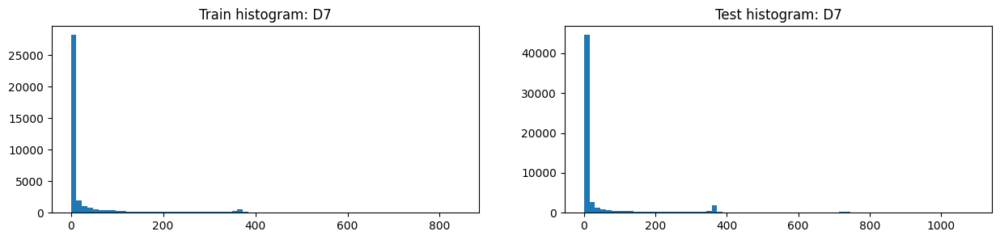

,D7,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,38917.000000,5790.000000,33127.000000,60133.000000,7160.000000,52973.000000
1,mean,41.638950,11.292228,46.943007,61.815642,33.610615,65.627924
2,std,99.743264,46.743057,105.435756,150.299612,94.096670,155.963738
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,17.000000,0.000000,24.000000,18.000000,9.000000,20.000000
7,max,843.000000,547.000000,843.000000,1088.000000,798.000000,1088.000000
8,unique values,598.000000,242.000000,598.000000,905.000000,440.000000,904.000000
9,NaNs,551623.000000,14873.000000,536750.000000,446558.000000,94179.000000,352380.000000


,D7,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,551623,0.026962,14873,446558.0
1,0.0,21135,0.211592,4472,31939.0
2,1.0,1717,0.141526,243,2868.0
3,2.0,998,0.108216,108,1850.0
4,3.0,791,0.085967,68,1296.0
5,7.0,606,0.059406,36,886.0
6,4.0,601,0.093178,56,1004.0
7,5.0,513,0.097466,50,852.0
8,6.0,435,0.073563,32,792.0
9,8.0,387,0.080103,31,567.0


,D7,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,551623,0.026962,14873,446558
1,0.0,21135,0.211592,4472,31939
2,1.0,1717,0.141526,243,2868
3,2.0,998,0.108216,108,1850
4,3.0,791,0.085967,68,1296
5,4.0,601,0.093178,56,1004
6,5.0,513,0.097466,50,852
7,7.0,606,0.059406,36,886
8,6.0,435,0.073563,32,792
9,8.0,387,0.080103,31,567


,Column,Correlation with D7
0,D7,1.000000
1,D5,0.986496
2,D3,0.818080
3,D4,0.574098
4,D12,0.553886
5,D6,0.506527
342,V328,-0.266689
343,V144,-0.269043
344,V152,-0.275670
345,V327,-0.332058


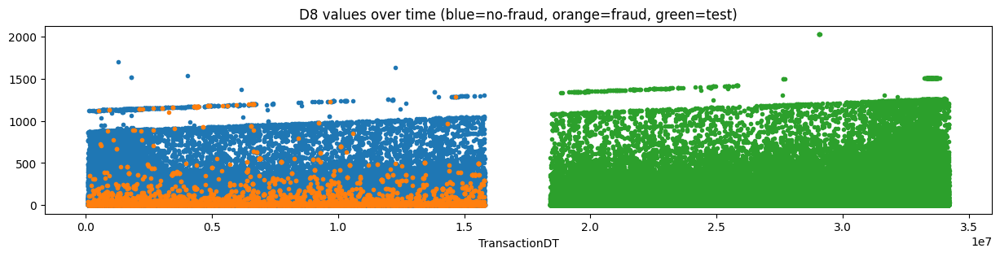

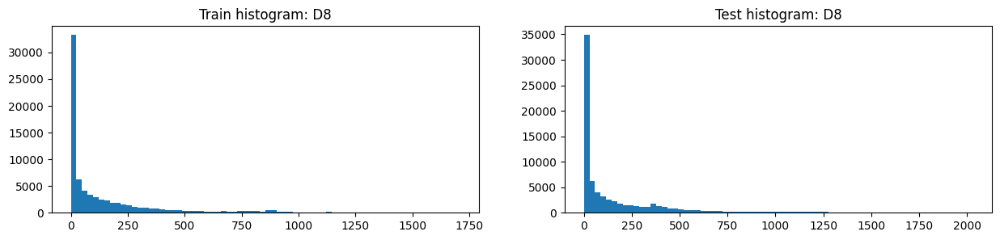

,D8,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,74926.000000,7827.000000,67099.000000,74338.000000,10200.000000,64138.000000
1,mean,146.058108,49.309191,157.343727,160.834483,146.638799,163.092053
2,std,231.663840,133.254994,237.987816,257.003738,249.691565,258.077466
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.958333,0.750000,1.750000,1.083333,0.916666,1.208333
5,50%,37.875000,2.666666,50.583332,37.708332,30.916666,38.875000
6,75%,187.958328,32.375000,207.541672,221.125000,182.875000,227.750000
7,max,1707.791626,1290.583374,1707.791626,2029.583374,1373.041626,2029.583374
8,unique values,12354.000000,1352.000000,12207.000000,13245.000000,3683.000000,12457.000000
9,NaNs,515614.000000,12836.000000,502778.000000,432353.000000,91139.000000,341215.000000


,D8,Count in train (desc),Mean target,Sum target,Count in test
0,-999.000000,515614,0.024895,12836,432353.0
1,0.791666,1351,0.179127,242,1263.0
2,0.833333,1327,0.158252,210,1282.0
3,0.875000,1304,0.199387,260,1299.0
4,0.958333,1300,0.197692,257,1180.0
5,0.916666,1259,0.181096,228,1132.0
6,0.750000,1248,0.173878,217,1107.0
7,0.708333,1175,0.122553,144,1038.0
8,0.083333,1118,0.167263,187,1083.0
9,0.666666,1097,0.121240,133,1075.0


,D8,Count in train,Mean target,Sum target (desc),Count in test
0,-999.000000,515614,0.024895,12836,432353
1,0.875000,1304,0.199387,260,1299
2,0.958333,1300,0.197692,257,1180
3,0.791666,1351,0.179127,242,1263
4,0.916666,1259,0.181096,228,1132
5,0.750000,1248,0.173878,217,1107
6,0.833333,1327,0.158252,210,1282
7,0.083333,1118,0.167263,187,1083
8,0.000000,835,0.203593,170,763
9,0.125000,1028,0.162451,167,1052


,Column,Correlation with D8
0,D8,1.000000
1,D13,0.521432
2,D2,0.275304
3,D5,0.249365
4,D15,0.226635
5,V192,0.226623
342,V171,-0.206093
343,V197,-0.206170
344,V79,-0.229298
345,V194,-0.232542


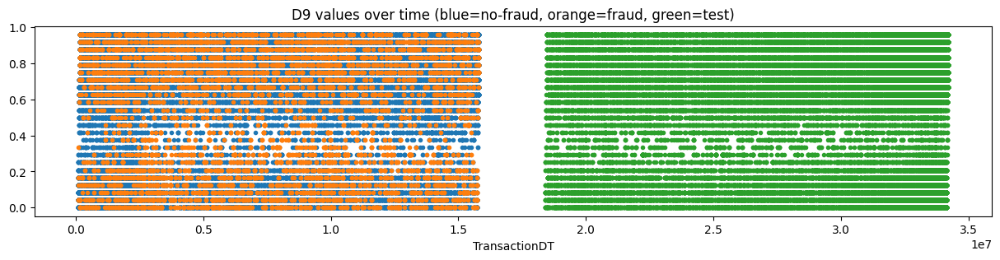

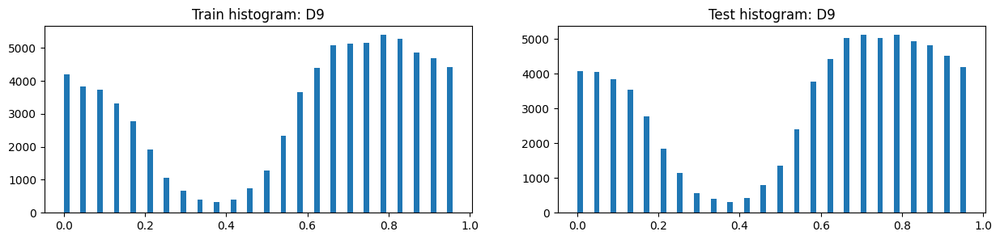

,D9,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,74926.000000,7827.000000,67099.000000,74338.000000,10200.000000,64138.000000
1,mean,0.561057,0.520000,0.565846,0.553981,0.554093,0.553963
2,std,0.316880,0.333188,0.314576,0.317327,0.314076,0.317843
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.208333,0.166666,0.208333,0.208333,0.208333,0.208333
5,50%,0.666666,0.625000,0.666666,0.666666,0.666666,0.666666
6,75%,0.833333,0.833333,0.833333,0.791666,0.791666,0.791666
7,max,0.958333,0.958333,0.958333,0.958333,0.958333,0.958333
8,unique values,25.000000,25.000000,25.000000,25.000000,25.000000,25.000000
9,NaNs,515614.000000,12836.000000,502778.000000,432353.000000,91139.000000,341215.000000


,D9,Count in train (desc),Mean target,Sum target,Count in test
0,-999.000000,515614,0.024895,12836,432353
1,0.791666,5388,0.095768,516,5111
2,0.833333,5273,0.095202,502,4939
3,0.750000,5147,0.091898,473,5033
4,0.708333,5132,0.080670,414,5106
5,0.666666,5069,0.074965,380,5021
6,0.875000,4857,0.106444,517,4805
7,0.916666,4694,0.106306,499,4503
8,0.958333,4411,0.120834,533,4179
9,0.625000,4380,0.059817,262,4415


,D9,Count in train,Mean target,Sum target (desc),Count in test
0,-999.000000,515614,0.024895,12836,432353
1,0.958333,4411,0.120834,533,4179
2,0.875000,4857,0.106444,517,4805
3,0.791666,5388,0.095768,516,5111
4,0.833333,5273,0.095202,502,4939
5,0.916666,4694,0.106306,499,4503
6,0.750000,5147,0.091898,473,5033
7,0.083333,3726,0.123725,461,3841
8,0.000000,4190,0.108353,454,4062
9,0.166666,2786,0.151113,421,2760


,Column,Correlation with D9
0,D9,1.000000
1,TransactionAmt,0.073852
2,D8,0.066085
3,D10,0.063333
4,D15,0.054647
5,D2,0.042867
342,V79,-0.078992
343,V15,-0.080027
344,V33,-0.081018
345,V94,-0.101789


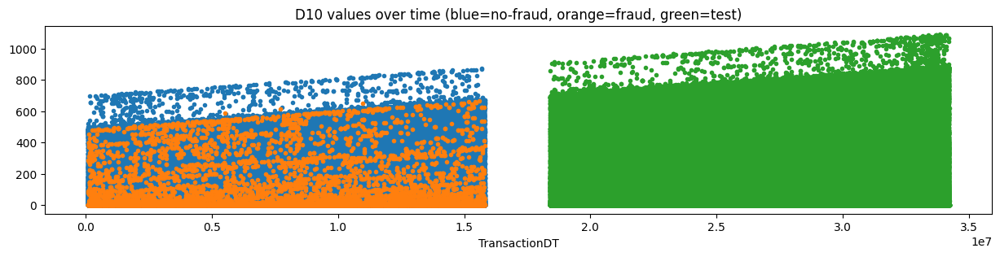

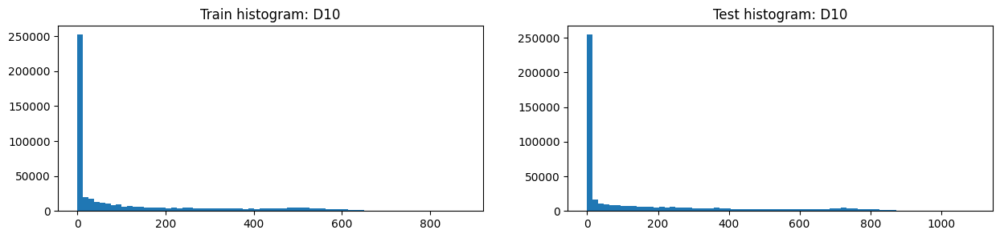

,D10,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514518.000000,16777.000000,497741.000000,494146.000000,93904.000000,400243.000000
1,mean,123.982137,52.363653,126.396130,159.810552,166.648183,158.206127
2,std,182.615225,127.051078,183.710646,240.566557,226.360455,243.751914
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,15.000000,0.000000,18.000000,10.000000,42.000000,4.000000
6,75%,197.000000,14.000000,205.000000,250.000000,266.000000,246.000000
7,max,876.000000,664.000000,876.000000,1091.000000,947.000000,1091.000000
8,unique values,819.000000,614.000000,819.000000,1076.000000,820.000000,1076.000000
9,NaNs,76022.000000,3886.000000,72136.000000,12545.000000,7435.000000,5110.000000


,D10,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,221930,0.047497,10541,227999
1,-999.0,76022,0.051117,3886,12545
2,1.0,5186,0.104512,542,4298
3,2.0,3482,0.097358,339,2782
4,3.0,2756,0.068578,189,2169
5,7.0,2740,0.041971,115,1817
6,14.0,2512,0.024283,61,1698
7,5.0,2377,0.052587,125,1670
8,28.0,2346,0.016198,38,1453
9,4.0,2344,0.062713,147,1945


,D10,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,221930,0.047497,10541,227999
1,-999.0,76022,0.051117,3886,12545
2,1.0,5186,0.104512,542,4298
3,2.0,3482,0.097358,339,2782
4,3.0,2756,0.068578,189,2169
5,4.0,2344,0.062713,147,1945
6,5.0,2377,0.052587,125,1670
7,7.0,2740,0.041971,115,1817
8,6.0,2303,0.044724,103,1688
9,9.0,1769,0.049746,88,1132


,Column,Correlation with D10
0,D10,1.000000
1,D15,0.712252
2,D4,0.636928
3,D11,0.609652
4,D1,0.562145
5,D2,0.525967
375,V156,-0.408720
376,V155,-0.427236
377,V148,-0.427647
378,V154,-0.428474


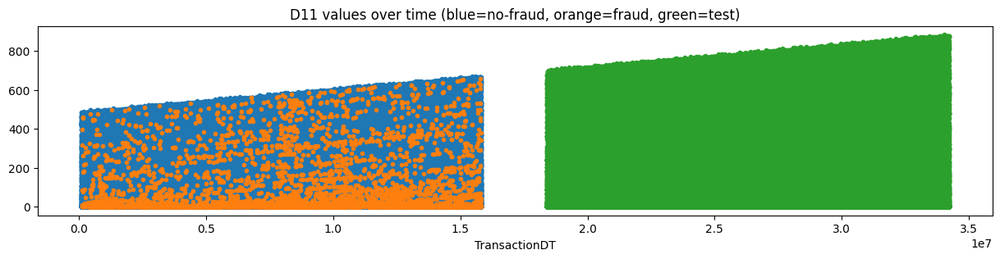

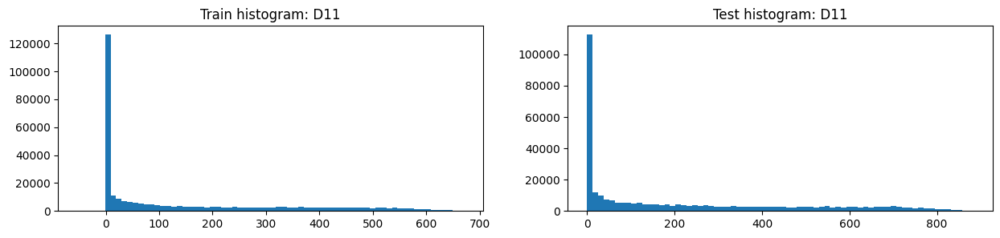

,D11,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,311253.000000,6106.000000,305147.000000,330173.000000,74232.000000,255942.000000
1,mean,146.621465,87.314445,147.808201,218.414895,197.138943,224.585117
2,std,186.042622,146.561013,186.555365,253.091693,227.897598,259.616540
3,min,-53.000000,0.000000,-53.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,43.000000,7.000000,44.000000,102.000000,93.000000,106.000000
6,75%,274.000000,107.750000,277.000000,401.000000,366.000000,412.000000
7,max,670.000000,655.000000,670.000000,883.000000,742.000000,883.000000
8,unique values,677.000000,557.000000,677.000000,881.000000,739.000000,881.000000
9,NaNs,279287.000000,14557.000000,264730.000000,176518.000000,27107.000000,149411.000000


,D11,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,279287,0.052122,14557,176518.0
1,0.0,112281,0.019522,2192,93125.0
2,1.0,3165,0.087836,278,3812.0
3,2.0,2020,0.083168,168,2334.0
4,3.0,1642,0.077954,128,1889.0
5,7.0,1639,0.042709,70,1564.0
6,14.0,1496,0.020722,31,1403.0
7,4.0,1449,0.077295,112,1709.0
8,6.0,1440,0.062500,90,1553.0
9,5.0,1424,0.052669,75,1414.0


,D11,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,279287,0.052122,14557,176518
1,0.0,112281,0.019522,2192,93125
2,1.0,3165,0.087836,278,3812
3,2.0,2020,0.083168,168,2334
4,3.0,1642,0.077954,128,1889
5,4.0,1449,0.077295,112,1709
6,6.0,1440,0.062500,90,1553
7,5.0,1424,0.052669,75,1414
8,7.0,1639,0.042709,70,1564
9,11.0,1011,0.055391,56,993


,Column,Correlation with D11
0,D11,1.000000
1,D15,0.765000
2,D4,0.657797
3,D10,0.609652
4,D1,0.592629
5,D2,0.563220
168,V36,-0.269785
169,V35,-0.284230
170,V76,-0.289223
171,V75,-0.308764


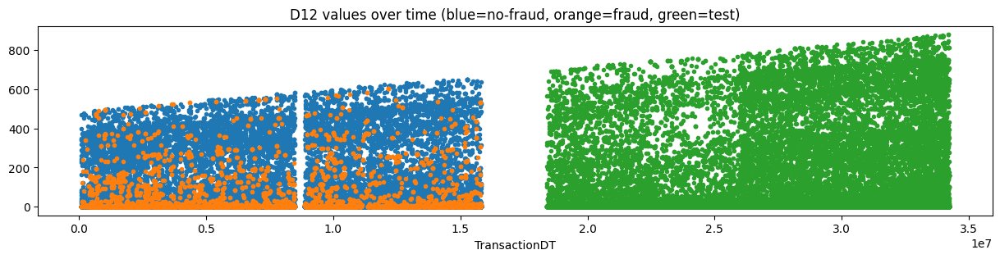

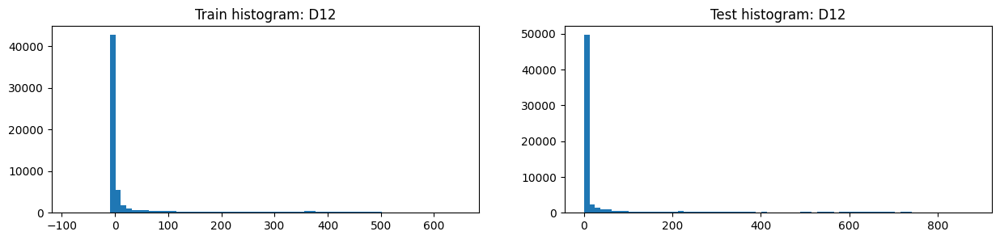

,D12,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,64717.000000,7598.000000,57119.000000,69254.000000,9801.000000,59453.000000
1,mean,54.037533,44.202553,55.345787,77.404179,69.285787,78.742519
2,std,124.274558,99.349394,127.166079,176.218548,154.518366,179.510165
3,min,-83.000000,0.000000,-83.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,13.000000,22.000000,11.000000,25.000000,24.000000,25.000000
7,max,648.000000,602.000000,648.000000,879.000000,728.000000,879.000000
8,unique values,636.000000,364.000000,635.000000,867.000000,602.000000,867.000000
9,NaNs,525823.000000,13065.000000,512758.000000,437437.000000,91538.000000,345900.000000


,D12,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,525823,0.024847,13065,437437.0
1,0.0,42756,0.098676,4219,40855.0
2,1.0,1526,0.275229,420,2043.0
3,2.0,818,0.223716,183,1272.0
4,3.0,634,0.219243,139,1061.0
5,4.0,564,0.141844,80,798.0
6,5.0,418,0.239234,100,691.0
7,7.0,373,0.195710,73,658.0
8,6.0,341,0.146628,50,630.0
9,8.0,273,0.179487,49,414.0


,D12,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,525823,0.024847,13065,437437
1,0.0,42756,0.098676,4219,40855
2,1.0,1526,0.275229,420,2043
3,2.0,818,0.223716,183,1272
4,3.0,634,0.219243,139,1061
5,5.0,418,0.239234,100,691
6,4.0,564,0.141844,80,798
7,7.0,373,0.195710,73,658
8,9.0,249,0.216867,54,309
9,6.0,341,0.146628,50,630


,Column,Correlation with D12
0,D12,1.000000
1,D4,0.999999
2,D6,0.976834
3,D2,0.668833
4,D15,0.608192
5,D5,0.565222
287,V195,-0.281923
288,V194,-0.288072
289,V198,-0.292729
290,V197,-0.310688


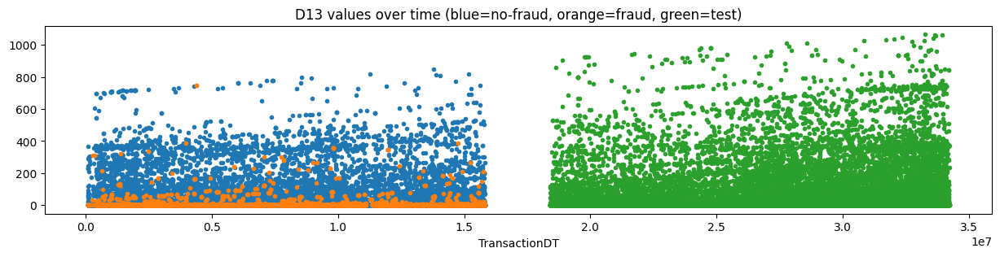

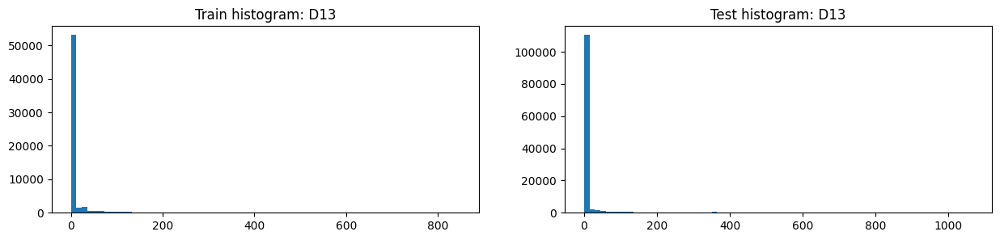

,D13,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,61952.000000,6837.000000,55115.000000,123384.000000,10039.000000,113345.000000
1,mean,17.901295,6.492321,19.316574,18.225961,24.144138,17.701787
2,std,67.614425,31.330429,70.703174,78.079890,82.980232,77.609589
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
7,max,847.000000,745.000000,847.000000,1066.000000,946.000000,1066.000000
8,unique values,578.000000,130.000000,578.000000,806.000000,398.000000,790.000000
9,NaNs,528588.000000,13826.000000,514762.000000,383307.000000,91300.000000,292008.000000


,D13,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,528588,0.026156,13826,383307.0
1,0.0,48840,0.111138,5428,101387.0
2,1.0,1097,0.227894,250,2103.0
3,26.0,891,0.001122,1,118.0
4,2.0,623,0.290530,181,1294.0
5,3.0,476,0.197479,94,898.0
6,4.0,366,0.174863,64,702.0
7,19.0,343,0.000000,0,158.0
8,5.0,316,0.202532,64,552.0
9,7.0,303,0.158416,48,623.0


,D13,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,528588,0.026156,13826,383307
1,0.0,48840,0.111138,5428,101387
2,1.0,1097,0.227894,250,2103
3,2.0,623,0.290530,181,1294
4,3.0,476,0.197479,94,898
5,4.0,366,0.174863,64,702
6,5.0,316,0.202532,64,552
7,7.0,303,0.158416,48,623
8,9.0,203,0.221675,45,355
9,6.0,262,0.164122,43,584


,Column,Correlation with D13
0,D13,1.000000
1,D8,0.521432
2,D15,0.431177
3,D6,0.419894
4,D2,0.394203
5,D4,0.383803
342,V188,-0.283609
343,V195,-0.709209
344,V198,-0.714801
345,V194,-0.722523


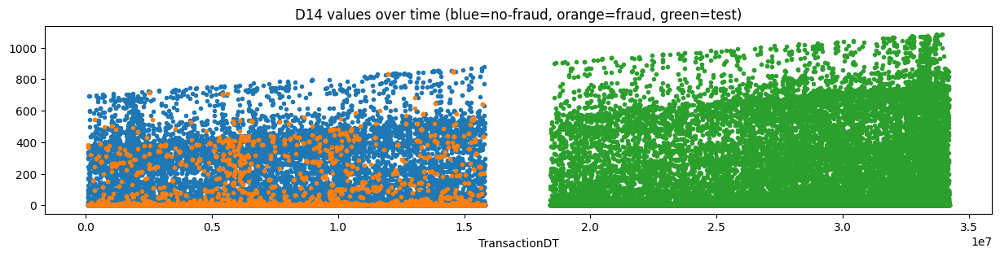

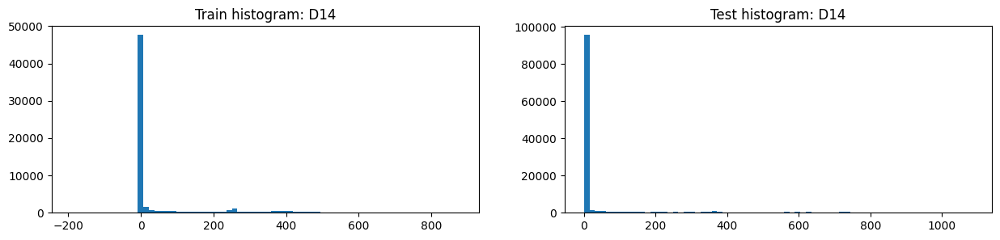

,D14,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,62187.000000,7213.000000,54974.000000,115194.000000,9735.000000,105459.000000
1,mean,57.724444,54.464578,58.152163,58.163186,76.289985,56.489887
2,std,136.312450,126.586127,137.532930,164.015525,168.656158,163.480027
3,min,-193.000000,0.000000,-193.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,2.000000,9.000000,1.000000,0.000000,17.000000,0.000000
7,max,878.000000,847.000000,878.000000,1085.000000,938.000000,1085.000000
8,unique values,803.000000,382.000000,801.000000,1032.000000,648.000000,1029.000000
9,NaNs,528353.000000,13450.000000,514903.000000,391497.000000,91604.000000,299894.000000


,D14,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,528353,0.025456,13450,391497.0
1,0.0,45266,0.097954,4434,89500.0
2,1.0,1105,0.361086,399,1744.0
3,256.0,658,0.001520,1,19.0
4,2.0,495,0.397980,197,740.0
5,3.0,307,0.312704,96,498.0
6,249.0,284,0.000000,0,15.0
7,4.0,260,0.234615,61,531.0
8,7.0,233,0.188841,44,363.0
9,5.0,210,0.219048,46,478.0


,D14,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,528353,0.025456,13450,391497
1,0.0,45266,0.097954,4434,89500
2,1.0,1105,0.361086,399,1744
3,2.0,495,0.397980,197,740
4,3.0,307,0.312704,96,498
5,4.0,260,0.234615,61,531
6,8.0,158,0.316456,50,234
7,5.0,210,0.219048,46,478
8,7.0,233,0.188841,44,363
9,6.0,183,0.240437,44,333


,Column,Correlation with D14
0,D14,1.000000
1,D10,0.336933
2,V326,0.269067
3,V327,0.260535
4,V335,0.243918
5,V330,0.242274
342,V153,-0.249805
343,V255,-0.309611
344,V256,-0.309642
345,V251,-0.654479


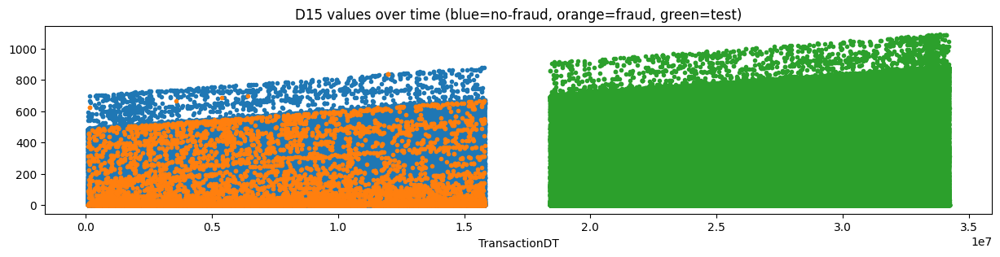

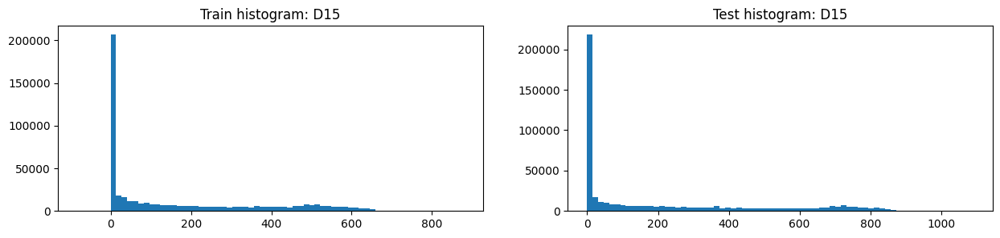

,D15,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501427.000000,16387.000000,485040.000000,494622.000000,94029.000000,400594.000000
1,mean,163.744579,78.245805,166.633142,206.854137,216.941571,204.486061
2,std,202.726660,151.956762,203.595694,269.419196,250.887517,273.533320
3,min,-83.000000,0.000000,-83.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,52.000000,1.000000,56.000000,48.000000,99.000000,35.000000
6,75%,314.000000,63.000000,321.000000,370.000000,406.000000,365.000000
7,max,879.000000,835.000000,879.000000,1091.000000,948.000000,1091.000000
8,unique values,860.000000,642.000000,860.000000,1079.000000,850.000000,1079.000000
9,NaNs,89113.000000,4276.000000,84837.000000,12069.000000,7310.000000,4759.000000


,D15,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,174246,0.045258,7886,183720.0
1,-999.0,89113,0.047984,4276,12069.0
2,1.0,5936,0.120620,716,6202.0
3,2.0,3691,0.119209,440,3793.0
4,3.0,2878,0.092078,265,3106.0
5,7.0,2577,0.051998,134,2360.0
6,4.0,2573,0.071512,184,2747.0
7,5.0,2336,0.076199,178,2202.0
8,6.0,2276,0.060193,137,2276.0
9,14.0,2265,0.039294,89,1853.0


,D15,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,174246,0.045258,7886,183720
1,-999.0,89113,0.047984,4276,12069
2,1.0,5936,0.120620,716,6202
3,2.0,3691,0.119209,440,3793
4,3.0,2878,0.092078,265,3106
5,4.0,2573,0.071512,184,2747
6,5.0,2336,0.076199,178,2202
7,6.0,2276,0.060193,137,2276
8,7.0,2577,0.051998,134,2360
9,8.0,1973,0.060314,119,1674


,Column,Correlation with D15
0,D15,1.000000
1,D11,0.765000
2,D4,0.751546
3,D10,0.712252
4,D6,0.700615
5,D1,0.638957
375,V149,-0.438651
376,V155,-0.442840
377,V154,-0.444239
378,V148,-0.445041


,M1,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,319440,6342,313098,330052,74212,255841
1,unique,2,1,2,2,2,2
2,top,T,T,T,T,T,T
3,freq,319415,6342,313073,330021,74202,255820
4,unique values,3,2,3,3,3,3
5,NaNs,271100,14321,256779,176639,27127,149512
6,NaNs share,0.4591,0.6931,0.4506,0.3486,0.2677,0.3688


,M1,Count in train (desc),Mean target,Sum target,Count in test
0,T,319415,0.019855,6342,330021
1,-999,271100,0.052826,14321,176639
2,F,25,0.000000,0,31


,M1,Count in train,Mean target,Sum target (desc),Count in test
0,-999,271100,0.052826,14321,176639
1,T,319415,0.019855,6342,330021
2,F,25,0.000000,0,31


,M2,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,319440,6342,313098,330052,74212,255841
1,unique,2,2,2,2,2,2
2,top,T,T,T,T,T,T
3,freq,285468,5158,280310,302855,67868,234988
4,unique values,3,3,3,3,3,3
5,NaNs,271100,14321,256779,176639,27127,149512
6,NaNs share,0.4591,0.6931,0.4506,0.3486,0.2677,0.3688


,M2,Count in train (desc),Mean target,Sum target,Count in test
0,T,285468,0.018069,5158,302855
1,-999,271100,0.052826,14321,176639
2,F,33972,0.034852,1184,27197


,M2,Count in train,Mean target,Sum target (desc),Count in test
0,-999,271100,0.052826,14321,176639
1,T,285468,0.018069,5158,302855
2,F,33972,0.034852,1184,27197


,M3,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,319440,6342,313098,330052,74212,255841
1,unique,2,2,2,2,2,2
2,top,T,T,T,T,T,T
3,freq,251731,4293,247438,266513,59925,206589
4,unique values,3,3,3,3,3,3
5,NaNs,271100,14321,256779,176639,27127,149512
6,NaNs share,0.4591,0.6931,0.4506,0.3486,0.2677,0.3688


,M3,Count in train (desc),Mean target,Sum target,Count in test
0,-999,271100,0.052826,14321,176639
1,T,251731,0.017054,4293,266513
2,F,67709,0.030262,2049,63539


,M3,Count in train,Mean target,Sum target (desc),Count in test
0,-999,271100,0.052826,14321,176639
1,T,251731,0.017054,4293,266513
2,F,67709,0.030262,2049,63539


,M4,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,309096,15436,293660,268946,55401,213545
1,unique,3,3,3,3,3,3
2,top,M0,M0,M0,M0,M0,M0
3,freq,196405,7198,189207,161384,35921,125463
4,unique values,4,4,4,4,4,4
5,NaNs,281444,5227,276217,237745,45938,191808
6,NaNs share,0.4766,0.253,0.4847,0.4692,0.4533,0.4732


,M4,Count in train (desc),Mean target,Sum target,Count in test
0,-999,281444,0.018572,5227,237745
1,M0,196405,0.036649,7198,161384
2,M2,59865,0.113739,6809,63082
3,M1,52826,0.027051,1429,44480


,M4,Count in train,Mean target,Sum target (desc),Count in test
0,M0,196405,0.036649,7198,161384
1,M2,59865,0.113739,6809,63082
2,-999,281444,0.018572,5227,237745
3,M1,52826,0.027051,1429,44480


,M5,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,240058,7569,232489,197059,45022,152037
1,unique,2,2,2,2,2,2
2,top,F,T,F,F,F,F
3,freq,132491,4055,128977,107664,24466,83198
4,unique values,3,3,3,3,3,3
5,NaNs,350482,13094,337388,309632,56317,253316
6,NaNs share,0.5935,0.6337,0.592,0.6111,0.5557,0.6249


,M5,Count in train (desc),Mean target,Sum target,Count in test
0,-999,350482,0.037360,13094,309632
1,F,132491,0.026523,3514,107664
2,T,107567,0.037697,4055,89395


,M5,Count in train,Mean target,Sum target (desc),Count in test
0,-999,350482,0.037360,13094,309632
1,T,107567,0.037697,4055,89395
2,F,132491,0.026523,3514,107664


,M6,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421180,8692,412488,347752,79525,268228
1,unique,2,2,2,2,2,2
2,top,F,F,F,F,F,F
3,freq,227856,5397,222459,191577,43280,148298
4,unique values,3,3,3,3,3,3
5,NaNs,169360,11971,157389,158939,21814,137125
6,NaNs share,0.2868,0.5793,0.2762,0.3137,0.2153,0.3383


,M6,Count in train (desc),Mean target,Sum target,Count in test
0,F,227856,0.023686,5397,191577
1,T,193324,0.017044,3295,156175
2,-999,169360,0.070684,11971,158939


,M6,Count in train,Mean target,Sum target (desc),Count in test
0,-999,169360,0.070684,11971,158939
1,F,227856,0.023686,5397,191577
2,T,193324,0.017044,3295,156175


,M7,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,244275,4817,239458,271673,61993,209681
1,unique,2,2,2,2,2,2
2,top,F,F,F,F,F,F
3,freq,211374,4089,207285,233230,53284,179947
4,unique values,3,3,3,3,3,3
5,NaNs,346265,15846,330419,235018,39346,195672
6,NaNs share,0.5864,0.7669,0.5798,0.4638,0.3883,0.4827


,M7,Count in train (desc),Mean target,Sum target,Count in test
0,-999,346265,0.045763,15846,235018
1,F,211374,0.019345,4089,233230
2,T,32901,0.022127,728,38443


,M7,Count in train,Mean target,Sum target (desc),Count in test
0,-999,346265,0.045763,15846,235018
1,F,211374,0.019345,4089,233230
2,T,32901,0.022127,728,38443


,M8,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,244288,4817,239471,271687,61998,209690
1,unique,2,2,2,2,2,2
2,top,F,F,F,F,F,F
3,freq,155251,3373,151878,168399,38420,129980
4,unique values,3,3,3,3,3,3
5,NaNs,346252,15846,330406,235004,39341,195663
6,NaNs share,0.5863,0.7669,0.5798,0.4638,0.3882,0.4827


,M8,Count in train (desc),Mean target,Sum target,Count in test
0,-999,346252,0.045764,15846,235004
1,F,155251,0.021726,3373,168399
2,T,89037,0.016218,1444,103288


,M8,Count in train,Mean target,Sum target (desc),Count in test
0,-999,346252,0.045764,15846,235004
1,F,155251,0.021726,3373,168399
2,T,89037,0.016218,1444,103288


,M9,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,244288,4817,239471,271687,61998,209690
1,unique,2,2,2,2,2,2
2,top,T,T,T,T,T,T
3,freq,205656,3658,201998,236279,53776,182503
4,unique values,3,3,3,3,3,3
5,NaNs,346252,15846,330406,235004,39341,195663
6,NaNs share,0.5863,0.7669,0.5798,0.4638,0.3882,0.4827


,M9,Count in train (desc),Mean target,Sum target,Count in test
0,-999,346252,0.045764,15846,235004
1,T,205656,0.017787,3658,236279
2,F,38632,0.030001,1159,35408


,M9,Count in train,Mean target,Sum target (desc),Count in test
0,-999,346252,0.045764,15846,235004
1,T,205656,0.017787,3658,236279
2,F,38632,0.030001,1159,35408


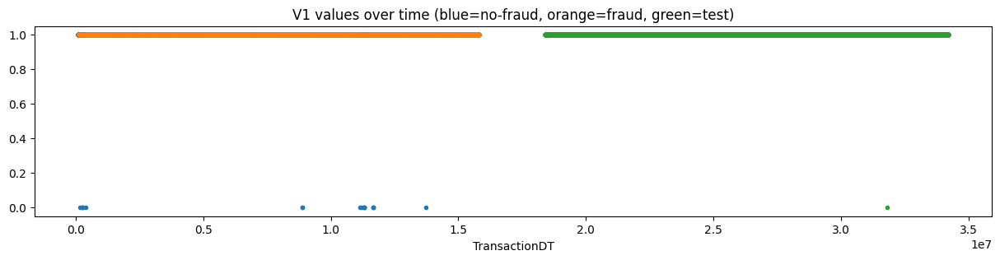

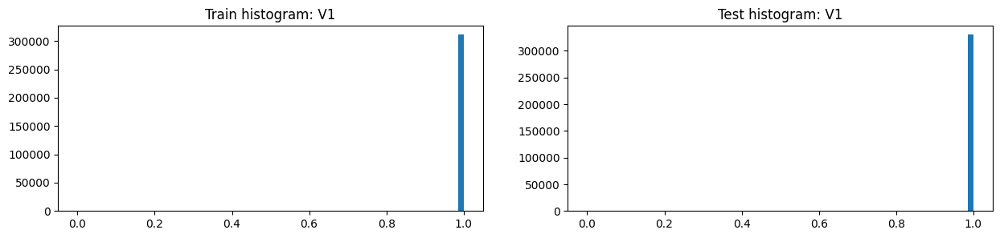

,V1,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,311253.000000,6106.0000,305147.000000,330173.000000,74232.0000,255942.000000
1,mean,0.999945,1.0000,0.999944,0.999997,1.0000,0.999996
2,std,0.007390,0.0000,0.007464,0.001740,0.0000,0.001977
3,min,0.000000,1.0000,0.000000,0.000000,1.0000,0.000000
4,25%,1.000000,1.0000,1.000000,1.000000,1.0000,1.000000
5,50%,1.000000,1.0000,1.000000,1.000000,1.0000,1.000000
6,75%,1.000000,1.0000,1.000000,1.000000,1.0000,1.000000
7,max,1.000000,1.0000,1.000000,1.000000,1.0000,1.000000
8,unique values,3.000000,2.0000,3.000000,3.000000,2.0000,3.000000
9,NaNs,279287.000000,14557.0000,264730.000000,176518.000000,27107.0000,149411.000000


,V1,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,311236,0.019619,6106,330172
1,-999.0,279287,0.052122,14557,176518
2,0.0,17,0.000000,0,1


,V1,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,279287,0.052122,14557,176518
1,1.0,311236,0.019619,6106,330172
2,0.0,17,0.000000,0,1


,Column,Correlation with V1
0,V1,1.000000
1,V88,0.547708
2,V41,0.462228
3,V8,0.040820
4,V66,0.035722
5,V9,0.034009
167,V282,-0.001198
168,addr1,-0.001638
169,card5,-0.001866
170,D3,-0.002702


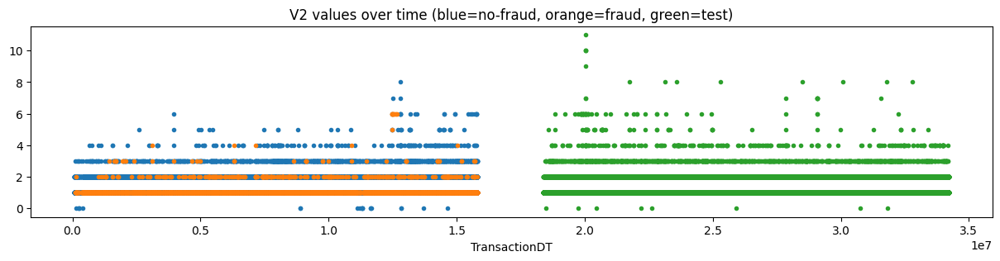

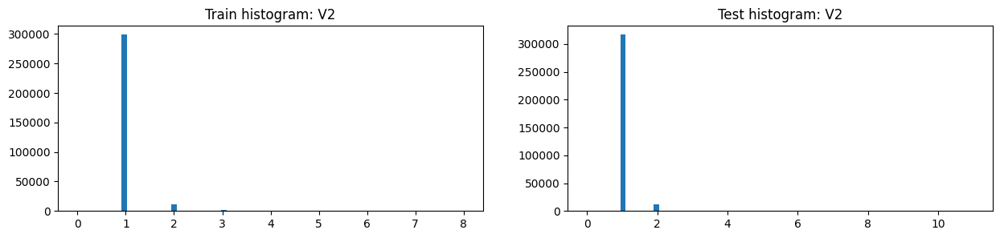

,V2,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,311253.000000,6106.000000,305147.000000,330173.000000,74232.000000,255942.000000
1,mean,1.045204,1.078939,1.044529,1.046636,1.051649,1.045182
2,std,0.240133,0.351422,0.237326,0.250847,0.284682,0.240125
3,min,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,8.000000,6.000000,8.000000,11.000000,11.000000,8.000000
8,unique values,10.000000,7.000000,10.000000,13.000000,13.000000,10.000000
9,NaNs,279287.000000,14557.000000,264730.000000,176518.000000,27107.000000,149411.000000


,V2,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,298894,0.019127,5717,316786
1,-999.0,279287,0.052122,14557,176518
2,2.0,10926,0.030203,330,11933
3,3.0,1181,0.037257,44,1099
4,4.0,163,0.030675,5,227
5,5.0,36,0.027778,1,51
6,6.0,30,0.300000,9,47
7,0.0,20,0.000000,0,8
8,7.0,2,0.000000,0,9
9,8.0,1,0.000000,0,8


,V2,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,279287,0.052122,14557,176518
1,1.0,298894,0.019127,5717,316786
2,2.0,10926,0.030203,330,11933
3,3.0,1181,0.037257,44,1099
4,6.0,30,0.300000,9,47
5,4.0,163,0.030675,5,227
6,5.0,36,0.027778,1,51
7,0.0,20,0.000000,0,8
8,7.0,2,0.000000,0,9
9,8.0,1,0.000000,0,8


,Column,Correlation with V2
0,V2,1.000000
1,V3,0.773039
2,V8,0.732730
3,V6,0.621459
4,V9,0.618591
5,V7,0.496921
168,D15,-0.038601
169,D3,-0.039085
170,D10,-0.039635
171,D2,-0.061555


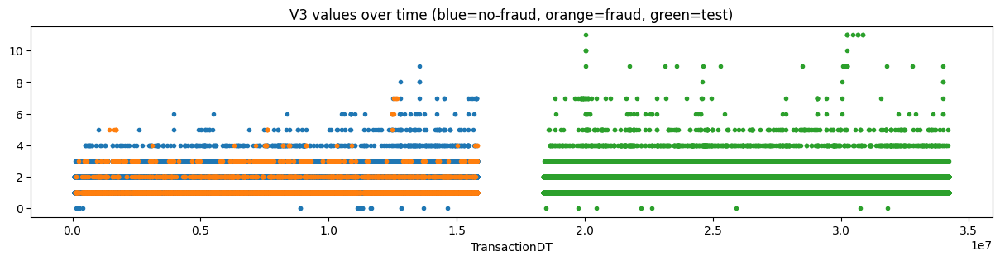

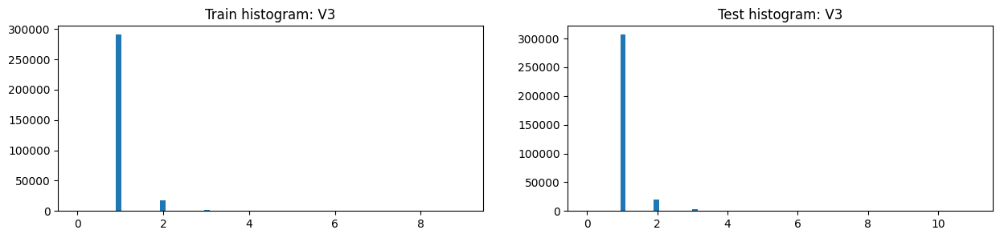

,V3,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,311253.000000,6106.000000,305147.000000,330173.000000,74232.000000,255942.000000
1,mean,1.078075,1.189813,1.075839,1.087436,1.089180,1.086930
2,std,0.320890,0.541936,0.314484,0.359033,0.372204,0.355121
3,min,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,9.000000,7.000000,9.000000,11.000000,11.000000,11.000000
8,unique values,11.000000,8.000000,11.000000,13.000000,12.000000,13.000000
9,NaNs,279287.000000,14557.000000,264730.000000,176518.000000,27107.000000,149411.000000


,V3,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,290583,0.018064,5249,306610
1,-999.0,279287,0.052122,14557,176518
2,2.0,17763,0.035523,631,19796
3,3.0,2335,0.077944,182,2797
4,4.0,403,0.062035,25,644
5,5.0,93,0.107527,10,200
6,6.0,34,0.147059,5,37
7,0.0,20,0.000000,0,8
8,7.0,18,0.222222,4,48
9,8.0,3,0.000000,0,4


,V3,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,279287,0.052122,14557,176518
1,1.0,290583,0.018064,5249,306610
2,2.0,17763,0.035523,631,19796
3,3.0,2335,0.077944,182,2797
4,4.0,403,0.062035,25,644
5,5.0,93,0.107527,10,200
6,6.0,34,0.147059,5,37
7,7.0,18,0.222222,4,48
8,0.0,20,0.000000,0,8
9,8.0,3,0.000000,0,4


,Column,Correlation with V3
0,V3,1.000000
1,V2,0.773039
2,V9,0.653087
3,V8,0.556536
4,V7,0.546875
5,V6,0.472570
168,D10,-0.053322
169,D5,-0.061979
170,D3,-0.062549
171,D11,-0.093579


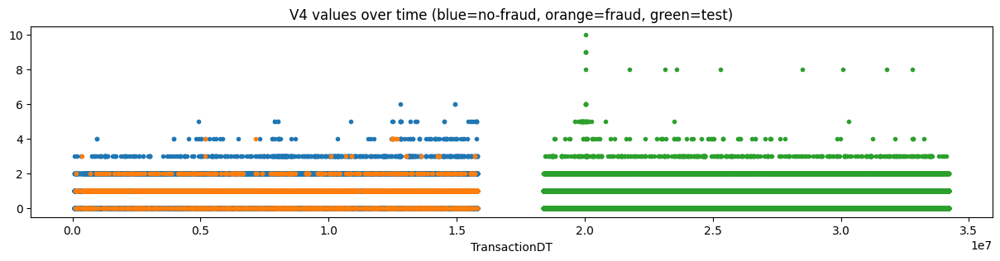

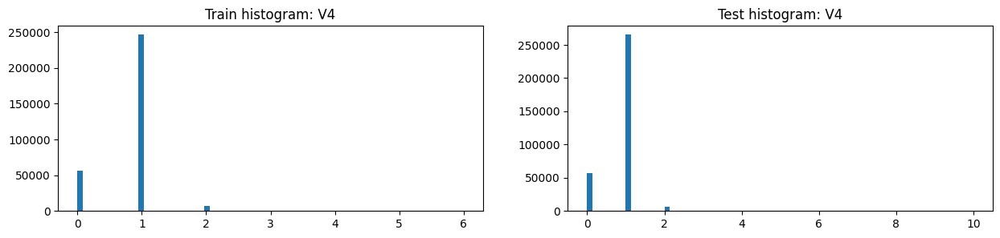

,V4,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,311253.000000,6106.000000,305147.000000,330173.000000,74232.000000,255942.000000
1,mean,0.846456,0.885686,0.845671,0.850563,0.849768,0.850794
2,std,0.440053,0.504883,0.438623,0.427938,0.448183,0.421885
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,6.000000,4.000000,6.000000,10.000000,10.000000,8.000000
8,unique values,8.000000,6.000000,8.000000,11.000000,11.000000,8.000000
9,NaNs,279287.000000,14557.000000,264730.000000,176518.000000,27107.000000,149411.000000


,V4,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,279287,0.052122,14557,176518
1,1.0,246500,0.018742,4620,265348
2,0.0,56687,0.019634,1113,57449
3,2.0,7385,0.046445,343,6851
4,3.0,564,0.031915,18,412
5,4.0,88,0.136364,12,67
6,5.0,26,0.000000,0,28
7,6.0,3,0.000000,0,5


,V4,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,279287,0.052122,14557,176518
1,1.0,246500,0.018742,4620,265348
2,0.0,56687,0.019634,1113,57449
3,2.0,7385,0.046445,343,6851
4,3.0,564,0.031915,18,412
5,4.0,88,0.136364,12,67
6,5.0,26,0.000000,0,28
7,6.0,3,0.000000,0,5


,Column,Correlation with V4
0,V4,1.000000
1,V5,0.915164
2,V82,0.683717
3,V83,0.629883
4,V61,0.606855
5,V19,0.606202
168,D2,-0.050060
169,D10,-0.053423
170,D15,-0.053686
171,D1,-0.073723


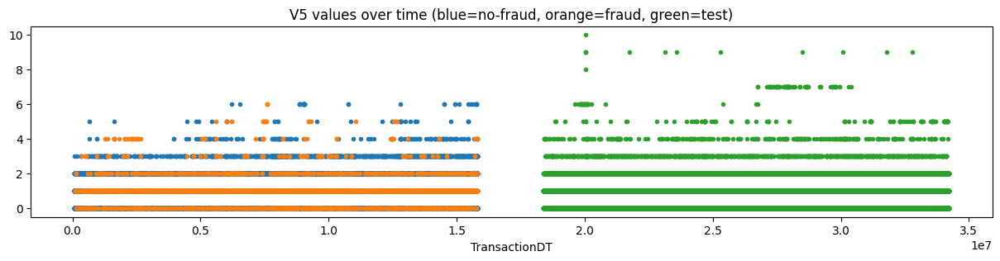

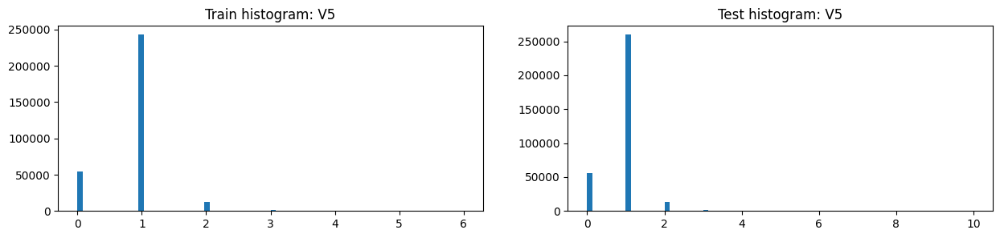

,V5,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,311253.000000,6106.000000,305147.000000,330173.000000,74232.000000,255942.000000
1,mean,0.876991,1.001146,0.874506,0.884697,0.879930,0.886080
2,std,0.475902,0.665395,0.471002,0.483297,0.488099,0.481887
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,6.000000,6.000000,6.000000,10.000000,10.000000,9.000000
8,unique values,8.000000,8.000000,8.000000,12.000000,11.000000,10.000000
9,NaNs,279287.000000,14557.000000,264730.000000,176518.000000,27107.000000,149411.000000


,V5,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,279287,0.052122,14557,176518
1,1.0,242883,0.018383,4465,259837
2,0.0,54276,0.017448,947,55494
3,2.0,12610,0.042902,541,13196
4,3.0,1200,0.063333,76,1137
5,4.0,193,0.264249,51,291
6,5.0,55,0.400000,22,111
7,6.0,36,0.111111,4,31


,V5,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,279287,0.052122,14557,176518
1,1.0,242883,0.018383,4465,259837
2,0.0,54276,0.017448,947,55494
3,2.0,12610,0.042902,541,13196
4,3.0,1200,0.063333,76,1137
5,4.0,193,0.264249,51,291
6,5.0,55,0.400000,22,111
7,6.0,36,0.111111,4,31


,Column,Correlation with V5
0,V5,1.000000
1,V4,0.915164
2,V83,0.658500
3,V82,0.634876
4,V62,0.588161
5,V20,0.583701
168,V69,-0.061584
169,V90,-0.063151
170,D1,-0.078982
171,D2,-0.082351


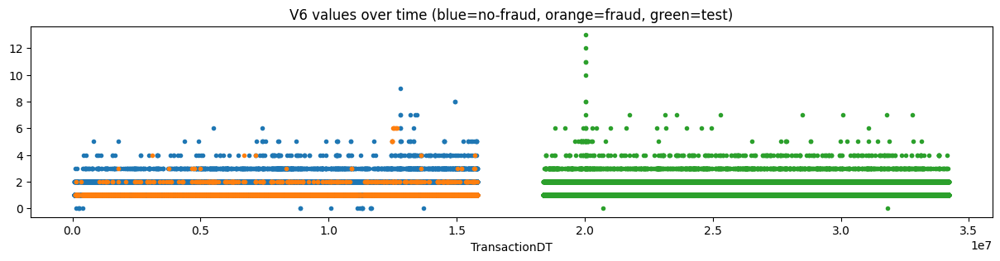

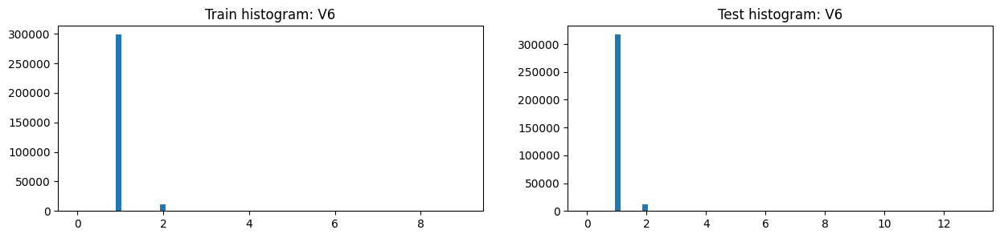

,V6,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,311253.000000,6106.000000,305147.000000,330173.000000,74232.000000,255942.000000
1,mean,1.045686,1.063544,1.045329,1.045940,1.049776,1.044827
2,std,0.239385,0.310700,0.237727,0.244112,0.272326,0.235285
3,min,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,9.000000,6.000000,9.000000,13.000000,13.000000,7.000000
8,unique values,11.000000,7.000000,11.000000,14.000000,14.000000,9.000000
9,NaNs,279287.000000,14557.000000,264730.000000,176518.000000,27107.000000,149411.000000


,V6,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,298627,0.019349,5778,316806.0
1,-999.0,279287,0.052122,14557,176518.0
2,2.0,11319,0.026416,299,12027.0
3,3.0,1044,0.013410,14,1023.0
4,4.0,180,0.027778,5,235.0
5,5.0,46,0.086957,4,48.0
6,0.0,18,0.000000,0,2.0
7,6.0,11,0.545455,6,16.0
8,7.0,5,0.000000,0,9.0
9,8.0,2,0.000000,0,2.0


,V6,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,279287,0.052122,14557,176518
1,1.0,298627,0.019349,5778,316806
2,2.0,11319,0.026416,299,12027
3,3.0,1044,0.013410,14,1023
4,6.0,11,0.545455,6,16
5,4.0,180,0.027778,5,235
6,5.0,46,0.086957,4,48
7,0.0,18,0.000000,0,2
8,7.0,5,0.000000,0,9
9,8.0,2,0.000000,0,2


,Column,Correlation with V6
0,V6,1.000000
1,V7,0.796027
2,V8,0.675501
3,V2,0.621459
4,V9,0.561332
5,V3,0.472570
168,D15,-0.020571
169,D1,-0.023724
170,D2,-0.028983
171,D5,-0.042234


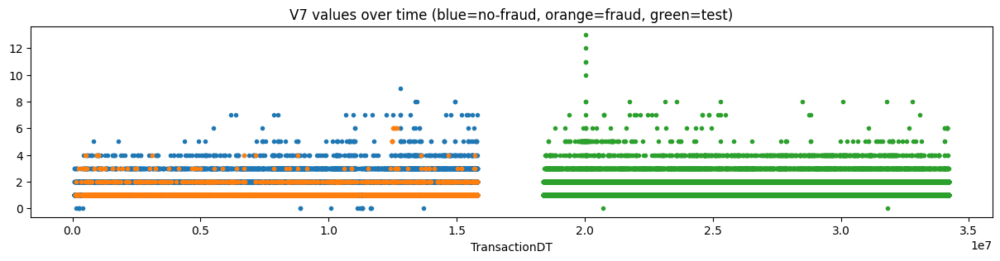

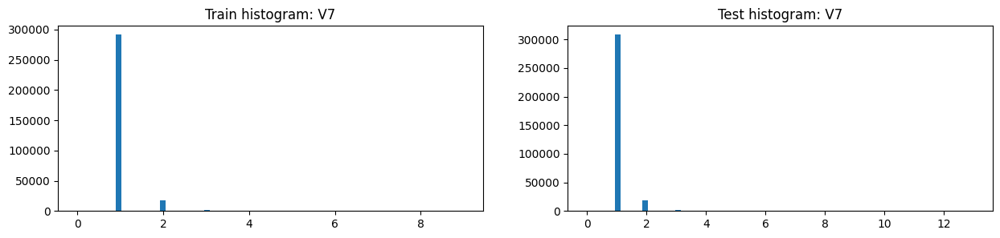

,V7,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,311253.000000,6106.000000,305147.000000,330173.000000,74232.000000,255942.000000
1,mean,1.072870,1.123485,1.071857,1.079207,1.081690,1.078487
2,std,0.304779,0.413311,0.302124,0.330086,0.354006,0.322814
3,min,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,9.000000,6.000000,9.000000,13.000000,13.000000,8.000000
8,unique values,11.000000,7.000000,11.000000,14.000000,14.000000,10.000000
9,NaNs,279287.000000,14557.000000,264730.000000,176518.000000,27107.000000,149411.000000


,V7,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,291485,0.018807,5482,308215.0
1,-999.0,279287,0.052122,14557,176518.0
2,2.0,17464,0.030520,533,18901.0
3,3.0,1823,0.037301,68,2243.0
4,4.0,337,0.038576,13,613.0
5,5.0,83,0.048193,4,136.0
6,7.0,20,0.000000,0,22.0
7,0.0,18,0.000000,0,2.0
8,6.0,18,0.333333,6,26.0
9,8.0,4,0.000000,0,10.0


,V7,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,279287,0.052122,14557,176518
1,1.0,291485,0.018807,5482,308215
2,2.0,17464,0.030520,533,18901
3,3.0,1823,0.037301,68,2243
4,4.0,337,0.038576,13,613
5,6.0,18,0.333333,6,26
6,5.0,83,0.048193,4,136
7,7.0,20,0.000000,0,22
8,0.0,18,0.000000,0,2
9,8.0,4,0.000000,0,10


,Column,Correlation with V7
0,V7,1.000000
1,V6,0.796027
2,V9,0.594988
3,V3,0.546875
4,V8,0.538586
5,V2,0.496921
168,D1,-0.032126
169,V48,-0.032210
170,D2,-0.057308
171,D5,-0.060725


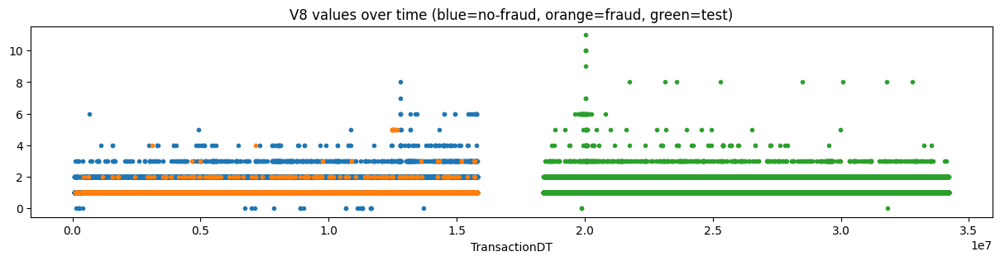

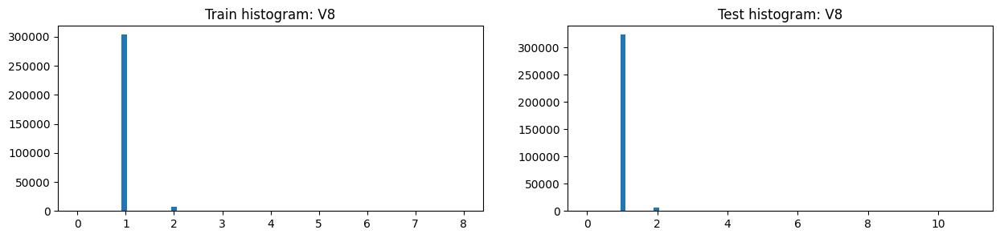

,V8,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,311253.000000,6106.000000,305147.000000,330173.000000,74232.000000,255942.000000
1,mean,1.027704,1.048804,1.027282,1.022779,1.028829,1.021024
2,std,0.186069,0.271332,0.183936,0.174533,0.221694,0.158205
3,min,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,8.000000,5.000000,8.000000,11.000000,11.000000,8.000000
8,unique values,10.000000,6.000000,10.000000,13.000000,13.000000,8.000000
9,NaNs,279287.000000,14557.000000,264730.000000,176518.000000,27107.000000,149411.000000


,V8,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,303466,0.019307,5859,323436
1,-999.0,279287,0.052122,14557,176518
2,2.0,7076,0.030808,218,6206
3,3.0,553,0.030741,17,408
4,4.0,95,0.021053,2,58
5,0.0,24,0.000000,0,3
6,6.0,19,0.000000,0,27
7,5.0,18,0.555556,10,20
8,7.0,1,0.000000,0,2
9,8.0,1,0.000000,0,8


,V8,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,279287,0.052122,14557,176518
1,1.0,303466,0.019307,5859,323436
2,2.0,7076,0.030808,218,6206
3,3.0,553,0.030741,17,408
4,5.0,18,0.555556,10,20
5,4.0,95,0.021053,2,58
6,0.0,24,0.000000,0,3
7,6.0,19,0.000000,0,27
8,7.0,1,0.000000,0,2
9,8.0,1,0.000000,0,8


,Column,Correlation with V8
0,V8,1.000000
1,V9,0.835342
2,V2,0.732730
3,V6,0.675501
4,V3,0.556536
5,V7,0.538586
168,D10,-0.019761
169,D1,-0.022786
170,D15,-0.024336
171,D2,-0.038912


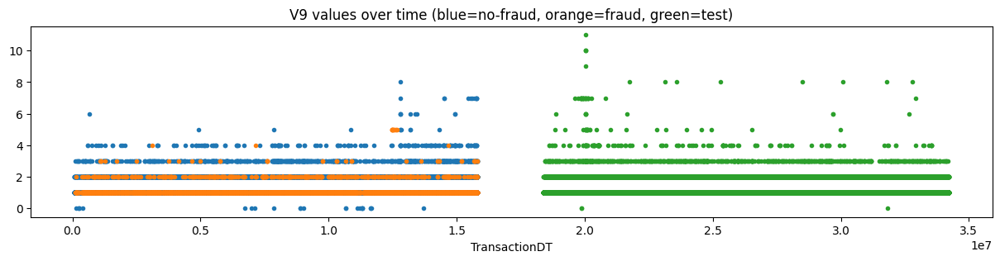

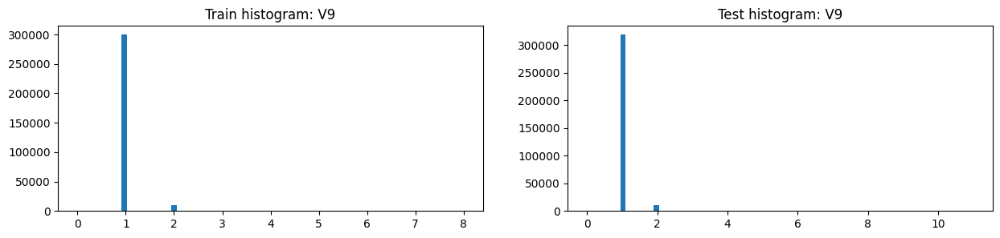

,V9,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,311253.000000,6106.000000,305147.000000,330173.000000,74232.000000,255942.000000
1,mean,1.041529,1.102195,1.040315,1.039876,1.045008,1.038388
2,std,0.226339,0.356576,0.222790,0.226182,0.271224,0.211306
3,min,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,8.000000,5.000000,8.000000,11.000000,11.000000,8.000000
8,unique values,10.000000,6.000000,10.000000,13.000000,13.000000,10.000000
9,NaNs,279287.000000,14557.000000,264730.000000,176518.000000,27107.000000,149411.000000


,V9,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,299625,0.018547,5557,318347
1,-999.0,279287,0.052122,14557,176518
2,2.0,10544,0.047136,497,10859
3,3.0,848,0.045991,39,765
4,4.0,172,0.017442,3,126
5,0.0,24,0.000000,0,3
6,5.0,19,0.526316,10,25
7,7.0,11,0.000000,0,26
8,6.0,9,0.000000,0,9
9,8.0,1,0.000000,0,8


,V9,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,279287,0.052122,14557,176518
1,1.0,299625,0.018547,5557,318347
2,2.0,10544,0.047136,497,10859
3,3.0,848,0.045991,39,765
4,5.0,19,0.526316,10,25
5,4.0,172,0.017442,3,126
6,0.0,24,0.000000,0,3
7,7.0,11,0.000000,0,26
8,6.0,9,0.000000,0,9
9,8.0,1,0.000000,0,8


,Column,Correlation with V9
0,V9,1.000000
1,V8,0.835342
2,V3,0.653087
3,V2,0.618591
4,V7,0.594988
5,V6,0.561332
168,D5,-0.031726
169,D3,-0.032873
170,D15,-0.033050
171,D2,-0.060890


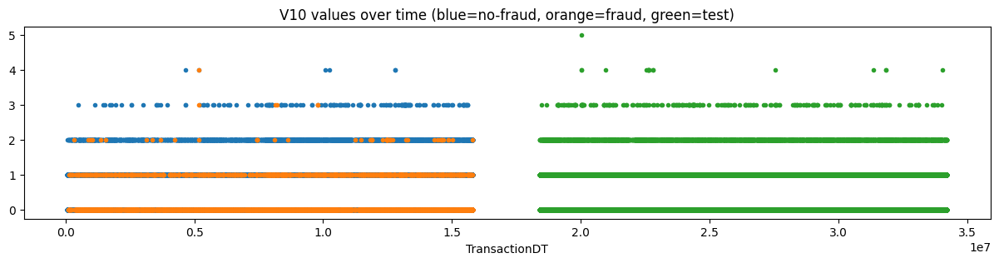

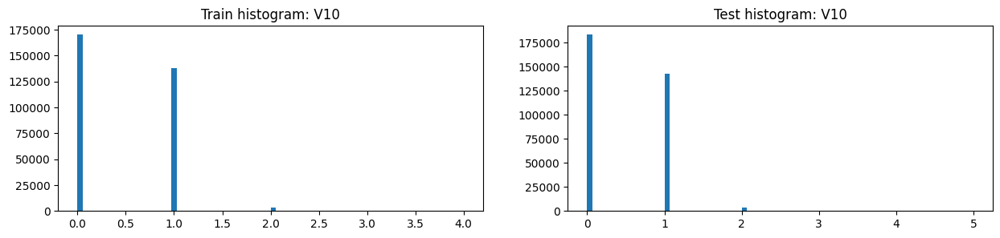

,V10,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,311253.000000,6106.000000,305147.000000,330173.000000,74232.000000,255942.000000
1,mean,0.463915,0.188667,0.469423,0.456621,0.458010,0.456217
2,std,0.521522,0.421117,0.521856,0.523406,0.525272,0.522864
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
7,max,4.000000,4.000000,4.000000,5.000000,5.000000,4.000000
8,unique values,6.000000,6.000000,6.000000,7.000000,7.000000,6.000000
9,NaNs,279287.000000,14557.000000,264730.000000,176518.000000,27107.000000,149411.000000


,V10,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,279287,0.052122,14557,176518
1,0.0,170281,0.029481,5020,183374
2,1.0,137743,0.007456,1027,143115
3,2.0,3042,0.017423,53,3421
4,3.0,180,0.027778,5,246
5,4.0,7,0.142857,1,16


,V10,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,279287,0.052122,14557,176518
1,0.0,170281,0.029481,5020,183374
2,1.0,137743,0.007456,1027,143115
3,2.0,3042,0.017423,53,3421
4,3.0,180,0.027778,5,246
5,4.0,7,0.142857,1,16


,Column,Correlation with V10
0,V10,1.000000
1,V11,0.968670
2,V90,0.907758
3,V48,0.893391
4,V69,0.883022
5,V29,0.879585
168,V283,-0.139100
169,V287,-0.145584
170,V97,-0.147457
171,V280,-0.156717


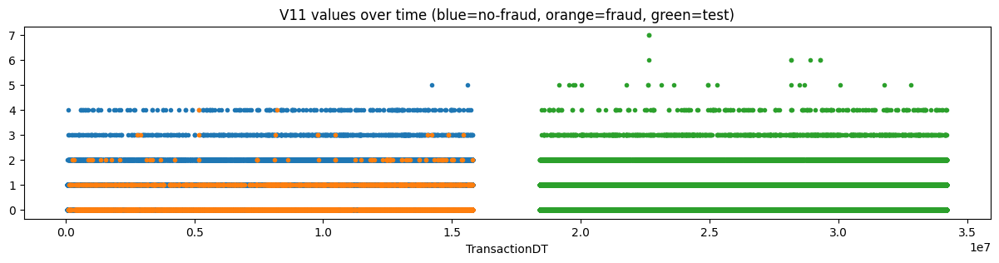

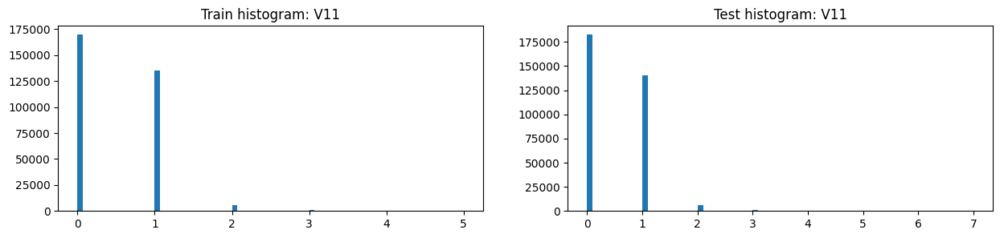

,V11,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,311253.000000,6106.000000,305147.000000,330173.000000,74232.000000,255942.000000
1,mean,0.478987,0.198002,0.484609,0.473873,0.473677,0.473928
2,std,0.552431,0.447692,0.552870,0.558754,0.556013,0.559548
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
7,max,5.000000,4.000000,5.000000,7.000000,5.000000,7.000000
8,unique values,7.000000,6.000000,7.000000,9.000000,7.000000,9.000000
9,NaNs,279287.000000,14557.000000,264730.000000,176518.000000,27107.000000,149411.000000


,V11,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,279287,0.052122,14557,176518
1,0.0,169633,0.029511,5006,182449
2,1.0,135148,0.007451,1007,140332
3,2.0,5672,0.013928,79,6301
4,3.0,608,0.019737,12,875
5,4.0,190,0.010526,2,189
6,5.0,2,0.000000,0,19


,V11,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,279287,0.052122,14557,176518
1,0.0,169633,0.029511,5006,182449
2,1.0,135148,0.007451,1007,140332
3,2.0,5672,0.013928,79,6301
4,3.0,608,0.019737,12,875
5,4.0,190,0.010526,2,189
6,5.0,2,0.000000,0,19


,Column,Correlation with V11
0,V11,1.000000
1,V10,0.968670
2,V90,0.887701
3,V91,0.884841
4,V48,0.870965
5,V49,0.865761
168,V283,-0.127174
169,V97,-0.132162
170,V74,-0.132237
171,V280,-0.141385


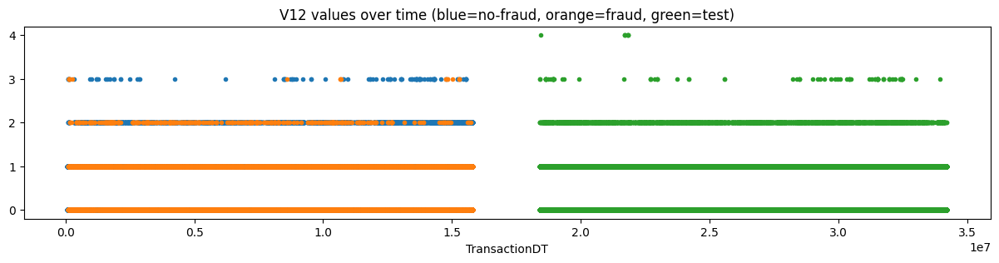

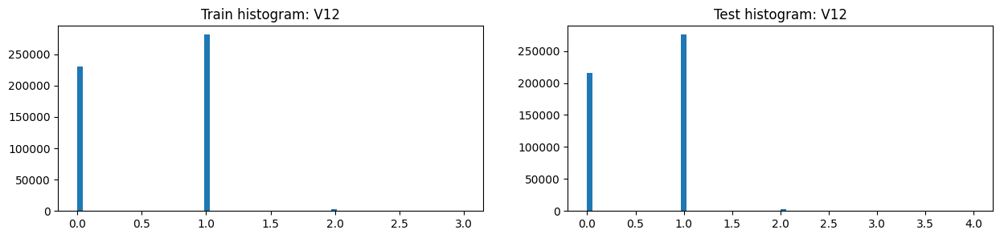

,V12,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,0.559711,0.413984,0.564623,0.569816,0.664277,0.547655
2,std,0.510533,0.548667,0.508471,0.508138,0.489000,0.509998
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,3.000000,3.000000,3.000000,4.000000,4.000000,4.000000
8,unique values,5.000000,5.000000,5.000000,6.000000,6.000000,6.000000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.000000


,V12,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,281003,0.021420,6019,275401
1,0.0,230049,0.044786,10303,215678
2,-999.0,76073,0.051096,3887,12589
3,2.0,3295,0.132322,436,2931
4,3.0,120,0.150000,18,84


,V12,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,230049,0.044786,10303,215678
1,1.0,281003,0.021420,6019,275401
2,-999.0,76073,0.051096,3887,12589
3,2.0,3295,0.132322,436,2931
4,3.0,120,0.150000,18,84


,Column,Correlation with V12
0,V12,1.000000
1,V13,0.925848
2,V75,0.708756
3,V76,0.671624
4,V35,0.659987
5,V53,0.635155
208,V32,-0.423963
209,V42,-0.433017
210,V31,-0.433737
211,V92,-0.435111


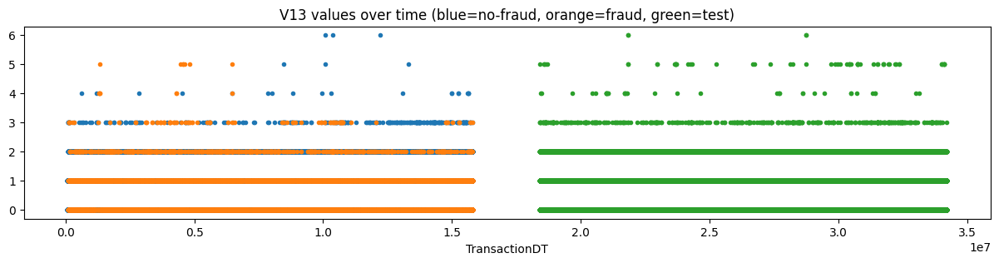

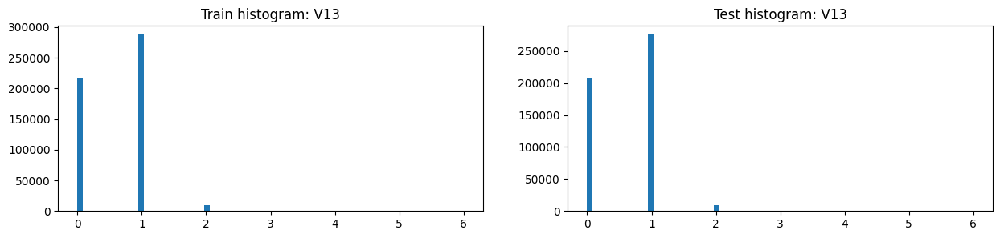

,V13,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,0.599166,0.466679,0.603632,0.600435,0.701014,0.576839
2,std,0.532185,0.619955,0.528395,0.536276,0.513543,0.538759
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,6.000000,5.000000,6.000000,6.000000,5.000000,6.000000
8,unique values,8.000000,7.000000,8.000000,8.000000,7.000000,8.000000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.000000


,V13,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,287644,0.020890,6009,275677
1,0.0,216752,0.045780,9923,208273
2,-999.0,76073,0.051096,3887,12589
3,2.0,9661,0.075872,733,9623
4,3.0,371,0.261456,97,430
5,4.0,26,0.269231,7,36
6,5.0,10,0.700000,7,59
7,6.0,3,0.000000,0,4


,V13,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,216752,0.045780,9923,208273
1,1.0,287644,0.020890,6009,275677
2,-999.0,76073,0.051096,3887,12589
3,2.0,9661,0.075872,733,9623
4,3.0,371,0.261456,97,430
5,4.0,26,0.269231,7,36
6,5.0,10,0.700000,7,59
7,6.0,3,0.000000,0,4


,Column,Correlation with V13
0,V13,1.000000
1,V12,0.925848
2,V76,0.719616
3,V75,0.670498
4,V36,0.669024
5,V54,0.643723
208,V32,-0.435384
209,V42,-0.444288
210,V31,-0.445421
211,V92,-0.447115


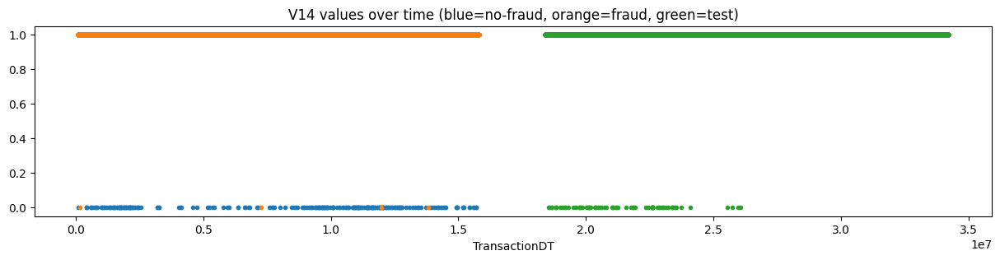

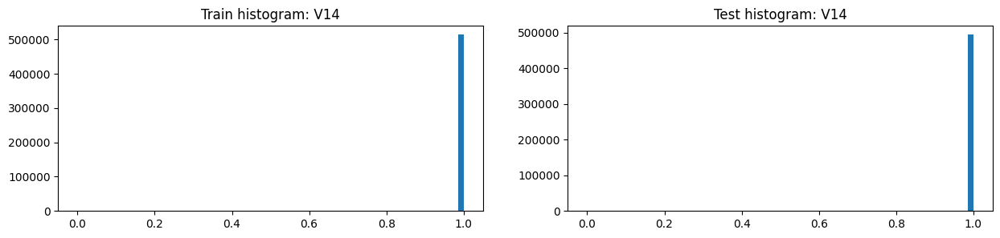

,V14,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,0.999500,0.999762,0.999492,0.999846,0.999553,0.999915
2,std,0.022345,0.015440,0.022541,0.012401,0.021146,0.009217
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
8,unique values,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.000000


,V14,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,514210,0.032617,16772,494026
1,-999.0,76073,0.051096,3887,12589
2,0.0,257,0.015564,4,76


,V14,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,514210,0.032617,16772,494026
1,-999.0,76073,0.051096,3887,12589
2,0.0,257,0.015564,4,76


,Column,Correlation with V14
0,V14,1.000000
1,V41,0.880084
2,V65,0.844338
3,V88,0.834647
4,V25,0.117988
5,V46,0.115513
361,V155,-0.066411
362,V148,-0.066795
363,V154,-0.067373
364,V153,-0.068208


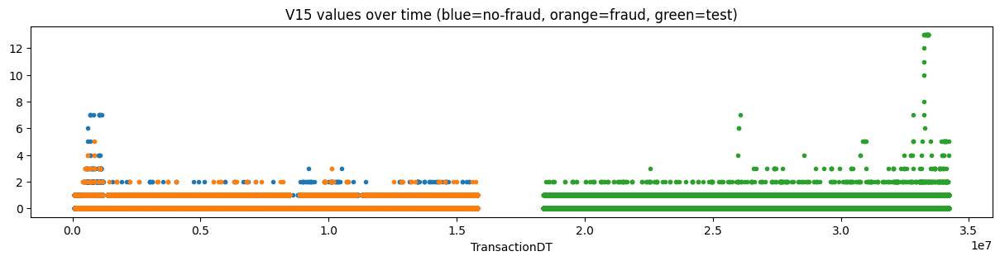

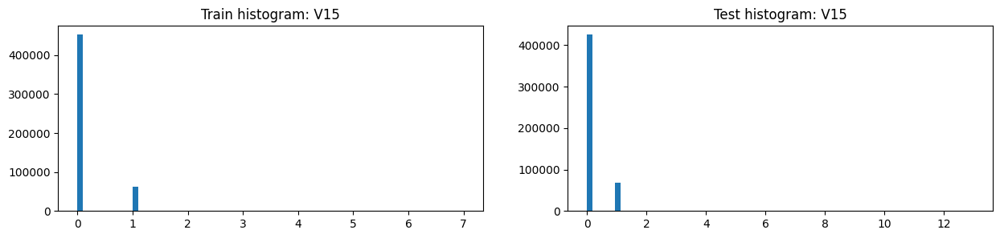

,V15,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,0.122342,0.444564,0.111481,0.140963,0.104853,0.149433
2,std,0.332422,0.514612,0.318881,0.361034,0.307926,0.371890
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,7.000000,5.000000,7.000000,13.000000,2.000000,13.000000
8,unique values,9.000000,7.000000,9.000000,14.000000,4.000000,14.000000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.000000


,V15,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,452075,0.020886,9442,425298
1,-999.0,76073,0.051096,3887,12589
2,1.0,61974,0.116678,7231,68326
3,2.0,346,0.248555,86,365
4,3.0,48,0.291667,14,53
5,4.0,10,0.200000,2,15
6,7.0,10,0.000000,0,3
7,5.0,3,0.333333,1,20
8,6.0,1,0.000000,0,3


,V15,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,452075,0.020886,9442,425298
1,1.0,61974,0.116678,7231,68326
2,-999.0,76073,0.051096,3887,12589
3,2.0,346,0.248555,86,365
4,3.0,48,0.291667,14,53
5,4.0,10,0.200000,2,15
6,5.0,3,0.333333,1,20
7,7.0,10,0.000000,0,3
8,6.0,1,0.000000,0,3


,Column,Correlation with V15
0,V15,1.000000
1,V16,0.986727
2,V57,0.958967
3,V33,0.958773
4,V94,0.953582
5,V50,0.946630
315,V53,-0.418216
316,V54,-0.429701
317,V35,-0.440371
318,V36,-0.450111


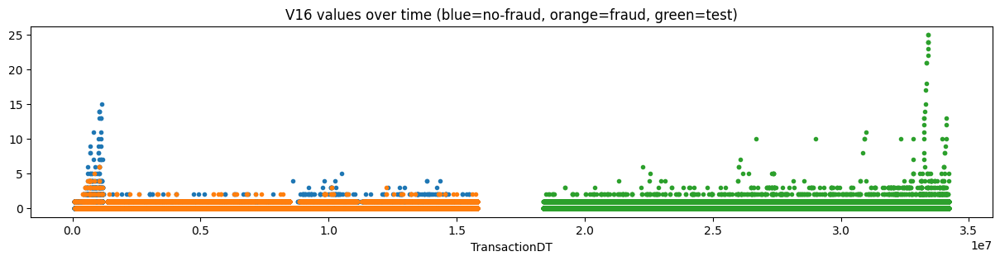

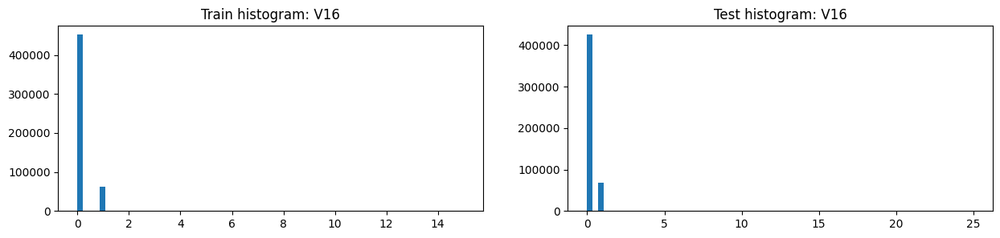

,V16,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,0.123460,0.448975,0.112487,0.142317,0.104991,0.151072
2,std,0.342841,0.530912,0.329104,0.379262,0.308725,0.393472
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,15.000000,6.000000,15.000000,25.000000,4.000000,25.000000
8,unique values,16.000000,8.000000,16.000000,24.000000,6.000000,24.000000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.000000


,V16,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,452052,0.020887,9442,425270
1,-999.0,76073,0.051096,3887,12589
2,1.0,61749,0.116569,7198,68099
3,2.0,481,0.199584,96,476
4,3.0,101,0.227723,23,156
5,4.0,42,0.333333,14,37
6,5.0,12,0.083333,1,20
7,6.0,7,0.285714,2,7
8,7.0,5,0.000000,0,3
9,8.0,4,0.000000,0,4


,V16,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,452052,0.020887,9442,425270
1,1.0,61749,0.116569,7198,68099
2,-999.0,76073,0.051096,3887,12589
3,2.0,481,0.199584,96,476
4,3.0,101,0.227723,23,156
5,4.0,42,0.333333,14,37
6,6.0,7,0.285714,2,7
7,5.0,12,0.083333,1,20
8,7.0,5,0.000000,0,3
9,8.0,4,0.000000,0,4


,Column,Correlation with V16
0,V16,1.000000
1,V15,0.986727
2,V33,0.943636
3,V57,0.938881
4,V94,0.933000
5,V34,0.931086
315,V53,-0.409196
316,V54,-0.420433
317,V35,-0.430572
318,V36,-0.440095


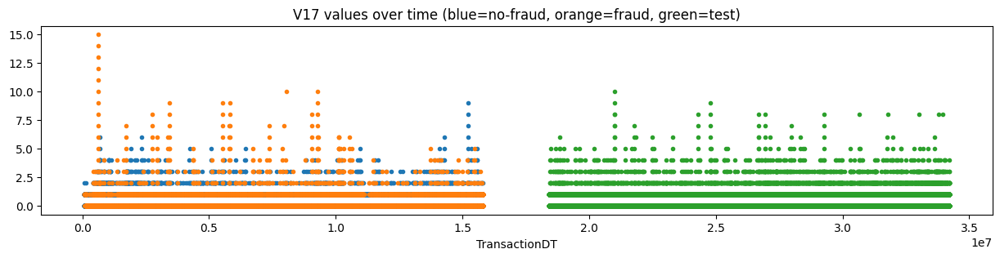

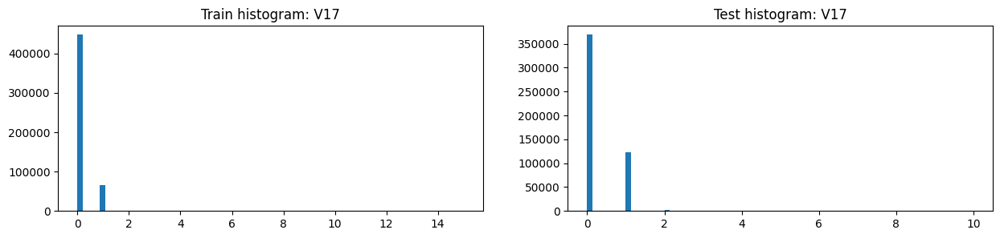

,V17,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,0.134040,0.496662,0.121817,0.259778,0.121107,0.292307
2,std,0.364456,0.738461,0.338147,0.461083,0.357741,0.476318
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
7,max,15.000000,15.000000,9.000000,10.000000,10.000000,9.000000
8,unique values,17.000000,17.000000,11.000000,12.000000,12.000000,11.000000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.000000


,V17,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,447823,0.021086,9443,369022.0
1,-999.0,76073,0.051096,3887,12589.0
2,1.0,65244,0.105634,6892,122807.0
3,2.0,927,0.237325,220,1676.0
4,3.0,274,0.346715,95,365.0
5,4.0,104,0.480769,50,143.0
6,5.0,40,0.700000,28,46.0
7,6.0,21,0.809524,17,19.0
8,7.0,12,0.916667,11,9.0
9,8.0,8,0.875000,7,12.0


,V17,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,447823,0.021086,9443,369022
1,1.0,65244,0.105634,6892,122807
2,-999.0,76073,0.051096,3887,12589
3,2.0,927,0.237325,220,1676
4,3.0,274,0.346715,95,365
5,4.0,104,0.480769,50,143
6,5.0,40,0.700000,28,46
7,6.0,21,0.809524,17,19
8,7.0,12,0.916667,11,9
9,8.0,8,0.875000,7,12


,Column,Correlation with V17
0,V17,1.000000
1,V18,0.991474
2,V21,0.951809
3,V22,0.917938
4,V84,0.909163
5,V63,0.906180
362,V12,-0.403208
363,V35,-0.409374
364,V54,-0.412949
365,V13,-0.414069


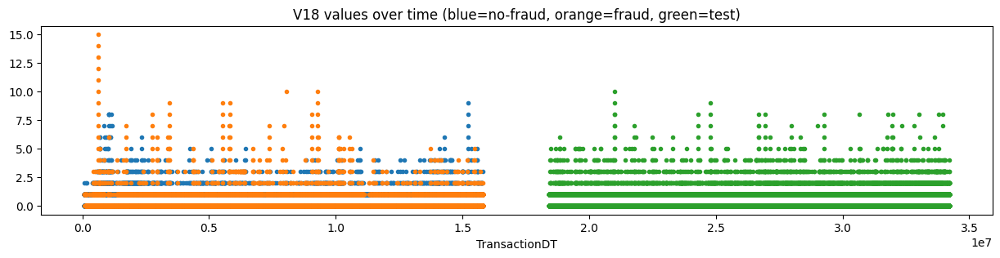

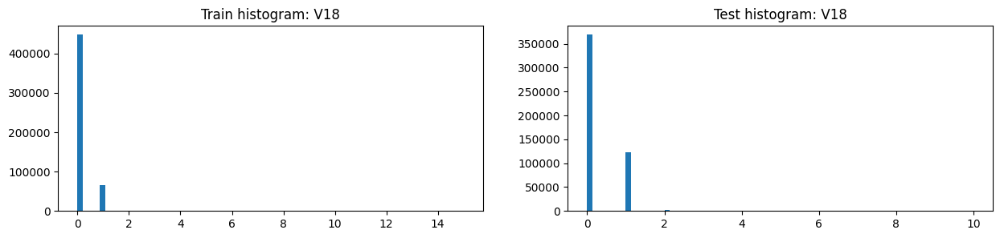

,V18,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,0.135363,0.505007,0.122904,0.261657,0.121959,0.294426
2,std,0.371763,0.755766,0.344751,0.467456,0.362981,0.482925
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
7,max,15.000000,15.000000,9.000000,10.000000,10.000000,9.000000
8,unique values,17.000000,17.000000,11.000000,12.000000,12.000000,11.000000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.000000


,V18,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,447792,0.021083,9441,368966.0
1,-999.0,76073,0.051096,3887,12589.0
2,1.0,64889,0.105087,6819,122201.0
3,2.0,1155,0.208658,241,2216.0
4,3.0,388,0.373711,145,443.0
5,4.0,120,0.425000,51,160.0
6,5.0,48,0.604167,29,64.0
7,6.0,32,0.593750,19,21.0
8,7.0,16,0.687500,11,15.0
9,8.0,13,0.538462,7,13.0


,V18,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,447792,0.021083,9441,368966
1,1.0,64889,0.105087,6819,122201
2,-999.0,76073,0.051096,3887,12589
3,2.0,1155,0.208658,241,2216
4,3.0,388,0.373711,145,443
5,4.0,120,0.425000,51,160
6,5.0,48,0.604167,29,64
7,6.0,32,0.593750,19,21
8,7.0,16,0.687500,11,15
9,8.0,13,0.538462,7,13


,Column,Correlation with V18
0,V18,1.000000
1,V17,0.991474
2,V21,0.944754
3,V22,0.927913
4,V84,0.899788
5,V63,0.898337
362,V12,-0.399186
363,V35,-0.405973
364,V54,-0.409579
365,V13,-0.409940


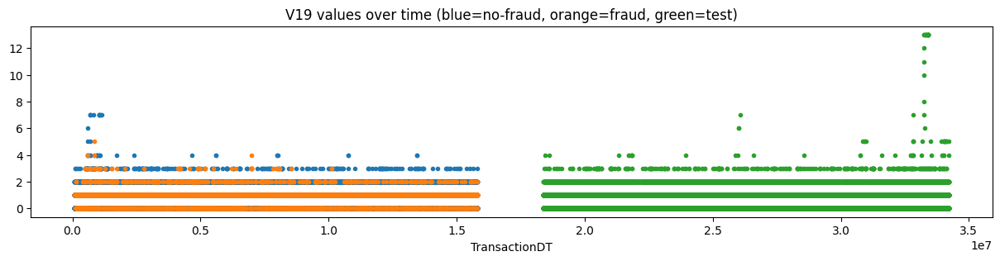

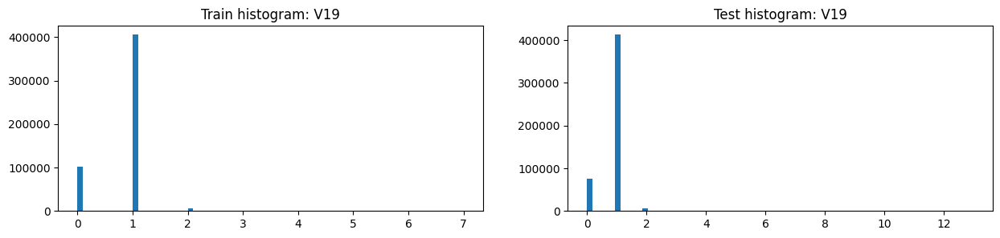

,V19,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.00000
1,mean,0.816371,0.887995,0.813957,0.861490,0.832037,0.86840
2,std,0.425512,0.429226,0.425176,0.392307,0.408003,0.38821
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000
7,max,7.000000,5.000000,7.000000,13.000000,4.000000,13.00000
8,unique values,9.000000,7.000000,9.000000,14.000000,6.000000,14.00000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.00000


,V19,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,405665,0.033705,13673,412869
1,0.0,101871,0.024757,2522,75188
2,-999.0,76073,0.051096,3887,12589
3,2.0,6540,0.080122,524,5611
4,3.0,348,0.152299,53,358
5,4.0,29,0.103448,3,31
6,7.0,10,0.000000,0,3
7,5.0,3,0.333333,1,20
8,6.0,1,0.000000,0,3


,V19,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,405665,0.033705,13673,412869
1,-999.0,76073,0.051096,3887,12589
2,0.0,101871,0.024757,2522,75188
3,2.0,6540,0.080122,524,5611
4,3.0,348,0.152299,53,358
5,4.0,29,0.103448,3,31
6,5.0,3,0.333333,1,20
7,7.0,10,0.000000,0,3
8,6.0,1,0.000000,0,3


,Column,Correlation with V19
0,V19,1.000000
1,V20,0.905334
2,V82,0.722277
3,V61,0.682139
4,V83,0.644119
5,V62,0.615758
375,V183,-0.419397
376,V329,-0.431263
377,V330,-0.438646
378,V327,-0.517675


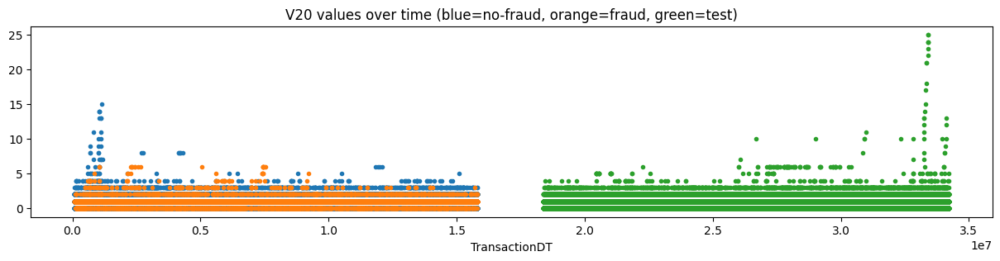

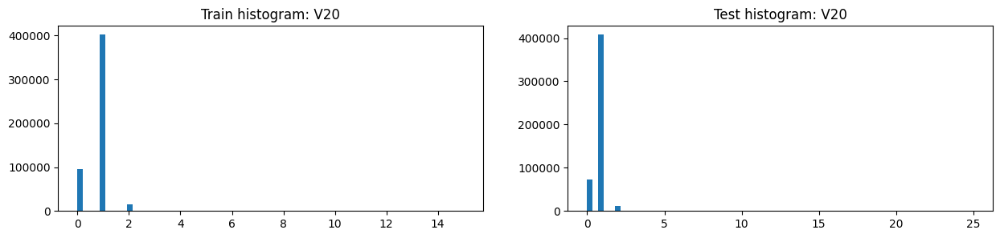

,V20,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.00000,494102.000000,93884.000000,400219.000000
1,mean,0.847843,0.948796,0.84444,0.885503,0.857398,0.892097
2,std,0.459451,0.525761,0.45666,0.436220,0.435610,0.436101
3,min,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000
7,max,15.000000,6.000000,15.00000,25.000000,5.000000,25.000000
8,unique values,16.000000,8.000000,16.00000,24.000000,7.000000,24.000000
9,NaNs,76073.000000,3887.000000,72186.00000,12589.000000,7455.000000,5134.000000


,V20,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,401929,0.033501,13465,407937
1,0.0,96318,0.023402,2254,72522
2,-999.0,76073,0.051096,3887,12589
3,2.0,14902,0.055831,832,12171
4,3.0,1070,0.148598,159,1199
5,4.0,161,0.229814,37,111
6,5.0,30,0.366667,11,51
7,6.0,27,0.666667,18,74
8,8.0,11,0.000000,0,4
9,7.0,5,0.000000,0,3


,V20,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,401929,0.033501,13465,407937
1,-999.0,76073,0.051096,3887,12589
2,0.0,96318,0.023402,2254,72522
3,2.0,14902,0.055831,832,12171
4,3.0,1070,0.148598,159,1199
5,4.0,161,0.229814,37,111
6,6.0,27,0.666667,18,74
7,5.0,30,0.366667,11,51
8,8.0,11,0.000000,0,4
9,7.0,5,0.000000,0,3


,Column,Correlation with V20
0,V20,1.000000
1,V19,0.905334
2,V83,0.674453
3,V82,0.661167
4,V62,0.633815
5,V61,0.632256
375,V328,-0.413837
376,V329,-0.427671
377,V330,-0.435053
378,V327,-0.512131


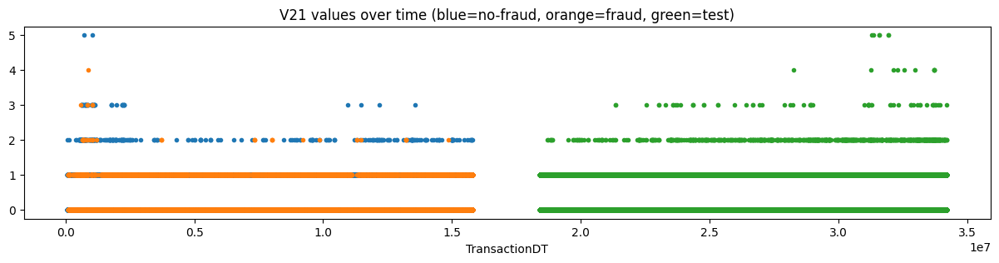

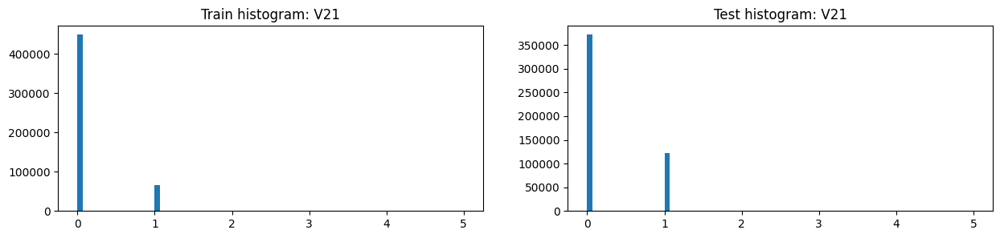

,V21,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,0.129684,0.436218,0.119351,0.249799,0.114652,0.281501
2,std,0.339060,0.502972,0.327163,0.438383,0.320138,0.455994
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
7,max,5.000000,4.000000,5.000000,5.000000,3.000000,5.000000
8,unique values,7.000000,6.000000,6.000000,7.000000,5.000000,7.000000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.000000


,V21,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,448220,0.021215,9509,371730
1,-999.0,76073,0.051096,3887,12589
2,1.0,65837,0.109710,7223,121417
3,2.0,354,0.107345,38,878
4,3.0,53,0.094340,5,61
5,5.0,2,0.000000,0,6
6,4.0,1,1.000000,1,10


,V21,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,448220,0.021215,9509,371730
1,1.0,65837,0.109710,7223,121417
2,-999.0,76073,0.051096,3887,12589
3,2.0,354,0.107345,38,878
4,3.0,53,0.094340,5,61
5,4.0,1,1.000000,1,10
6,5.0,2,0.000000,0,6


,Column,Correlation with V21
0,V21,1.000000
1,V22,0.964627
2,V84,0.955048
3,V17,0.951809
4,V63,0.946929
5,V18,0.944754
362,V12,-0.419325
363,V35,-0.428535
364,V54,-0.429660
365,V13,-0.430620


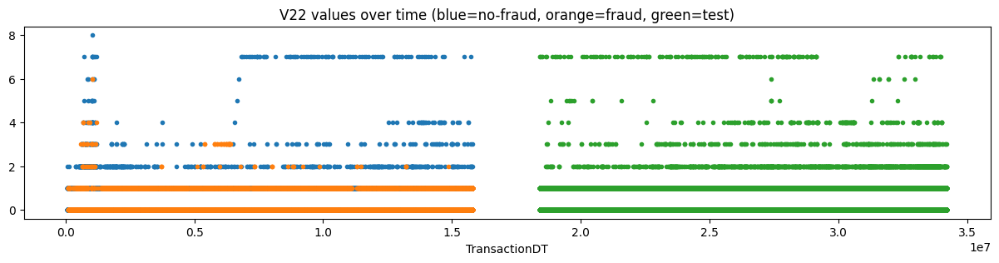

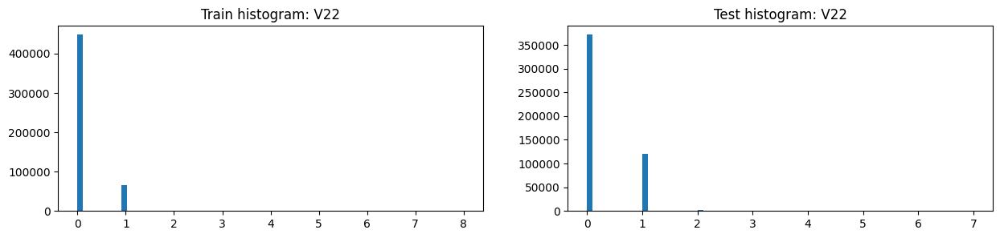

,V22,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,0.132292,0.443193,0.121813,0.254431,0.117752,0.286493
2,std,0.359415,0.525582,0.347641,0.464469,0.350313,0.481809
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
7,max,8.000000,6.000000,8.000000,7.000000,7.000000,7.000000
8,unique values,10.000000,7.000000,10.000000,9.000000,8.000000,9.000000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.000000


,V22,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,448185,0.021212,9507,371688.0
1,-999.0,76073,0.051096,3887,12589.0
2,1.0,65334,0.109698,7167,120501.0
3,2.0,604,0.081126,49,1334.0
4,3.0,169,0.272189,46,249.0
5,7.0,94,0.000000,0,149.0
6,4.0,63,0.079365,5,157.0
7,5.0,9,0.000000,0,16.0
8,6.0,8,0.250000,2,8.0
9,8.0,1,0.000000,0,NaN


,V22,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,448185,0.021212,9507,371688.0
1,1.0,65334,0.109698,7167,120501.0
2,-999.0,76073,0.051096,3887,12589.0
3,2.0,604,0.081126,49,1334.0
4,3.0,169,0.272189,46,249.0
5,4.0,63,0.079365,5,157.0
6,6.0,8,0.250000,2,8.0
7,7.0,94,0.000000,0,149.0
8,5.0,9,0.000000,0,16.0
9,8.0,1,0.000000,0,NaN


,Column,Correlation with V22
0,V22,1.000000
1,V21,0.964627
2,V42,0.934389
3,V18,0.927913
4,V63,0.920913
5,V17,0.917938
362,V12,-0.403534
363,V54,-0.414303
364,V13,-0.414404
365,V35,-0.424245


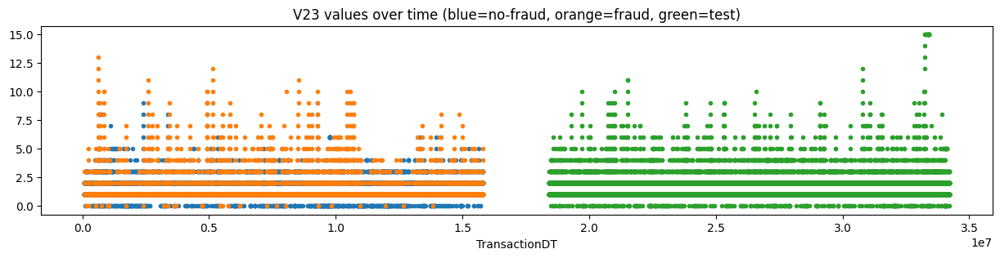

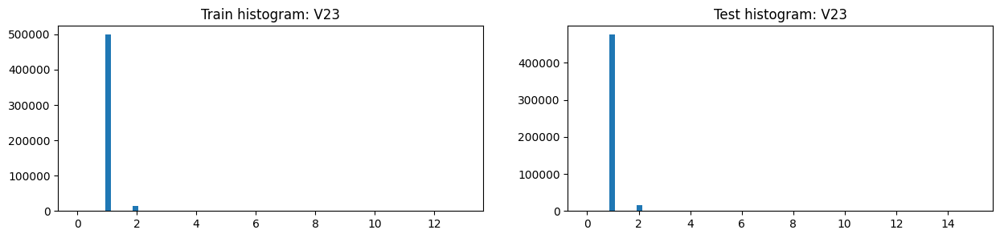

,V23,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,1.034791,1.236350,1.027997,1.045493,1.046323,1.045298
2,std,0.247681,0.860107,0.192518,0.289516,0.294012,0.288451
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,13.000000,13.000000,9.000000,15.000000,11.000000,15.000000
8,unique values,15.000000,15.000000,11.000000,17.000000,13.000000,17.000000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.000000


,V23,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,498764,0.029483,14705,475616
1,-999.0,76073,0.051096,3887,12589
2,2.0,13197,0.087747,1158,15463
3,3.0,1244,0.313505,390,1622
4,0.0,588,0.085034,50,367
5,4.0,337,0.599407,202,615
6,5.0,144,0.777778,112,186
7,6.0,83,0.734940,61,94
8,7.0,39,0.897436,35,61
9,8.0,32,0.812500,26,29


,V23,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,498764,0.029483,14705,475616
1,-999.0,76073,0.051096,3887,12589
2,2.0,13197,0.087747,1158,15463
3,3.0,1244,0.313505,390,1622
4,4.0,337,0.599407,202,615
5,5.0,144,0.777778,112,186
6,6.0,83,0.734940,61,94
7,0.0,588,0.085034,50,367
8,7.0,39,0.897436,35,61
9,8.0,32,0.812500,26,29


,Column,Correlation with V23
0,V23,1.000000
1,V24,0.824955
2,V123,0.612617
3,V125,0.500739
4,V86,0.452366
5,V257,0.400885
375,D8,-0.073936
376,V292,-0.080453
377,addr2,-0.080754
378,V291,-0.083794


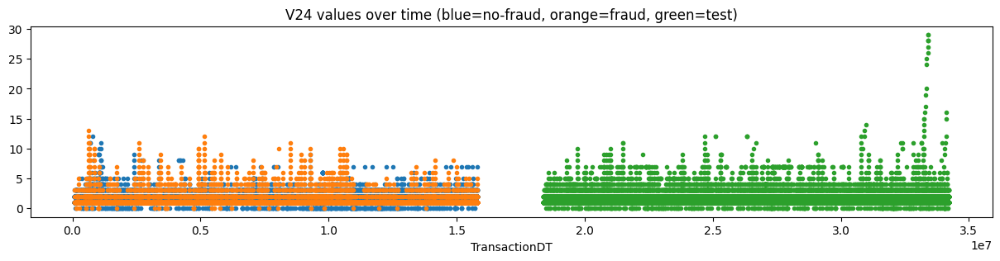

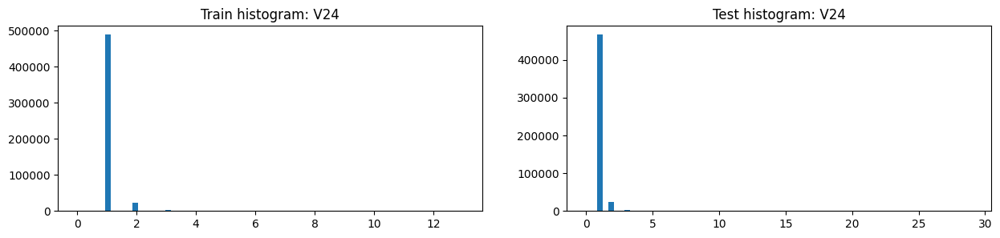

,V24,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,1.058097,1.264127,1.051152,1.069415,1.070683,1.069117
2,std,0.305485,0.889503,0.261379,0.371149,0.350795,0.375764
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,13.000000,13.000000,12.000000,29.000000,11.000000,29.000000
8,unique values,15.000000,15.000000,14.000000,27.000000,13.000000,27.000000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.000000


,V24,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,488478,0.029428,14375,466502
1,-999.0,76073,0.051096,3887,12589
2,2.0,22289,0.063664,1419,23104
3,3.0,2241,0.196787,441,2803
4,0.0,578,0.083045,48,364
5,4.0,431,0.496520,214,642
6,5.0,195,0.558974,109,246
7,6.0,98,0.653061,64,110
8,7.0,64,0.593750,38,218
9,8.0,40,0.650000,26,32


,V24,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,488478,0.029428,14375,466502
1,-999.0,76073,0.051096,3887,12589
2,2.0,22289,0.063664,1419,23104
3,3.0,2241,0.196787,441,2803
4,4.0,431,0.496520,214,642
5,5.0,195,0.558974,109,246
6,6.0,98,0.653061,64,110
7,0.0,578,0.083045,48,364
8,7.0,64,0.593750,38,218
9,8.0,40,0.650000,26,32


,Column,Correlation with V24
0,V24,1.000000
1,V23,0.824955
2,V123,0.532372
3,V125,0.486519
4,V87,0.426118
5,V124,0.405436
375,D5,-0.065159
376,V292,-0.065559
377,V291,-0.068306
378,D7,-0.081289


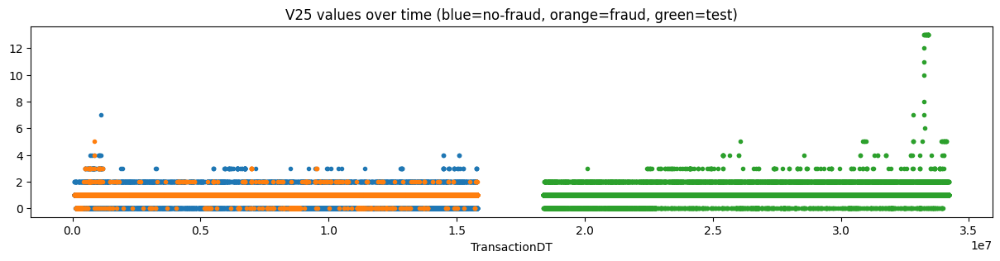

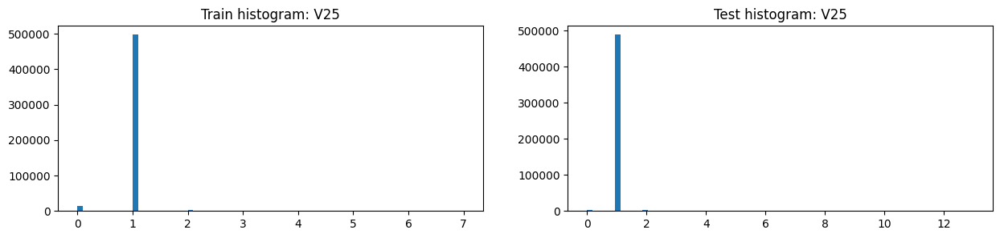

,V25,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,0.977660,0.981521,0.977530,1.004693,0.996283,1.006666
2,std,0.185245,0.235744,0.183299,0.133895,0.127897,0.135187
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,7.000000,5.000000,7.000000,13.000000,3.000000,13.000000
8,unique values,8.000000,7.000000,7.000000,14.000000,5.000000,14.000000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.000000


,V25,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,497241,0.032091,15957,488731
1,-999.0,76073,0.051096,3887,12589
2,0.0,14465,0.040304,583,1754
3,2.0,2569,0.078630,202,3420
4,3.0,177,0.180791,32,127
5,4.0,13,0.076923,1,27
6,5.0,1,1.000000,1,21
7,7.0,1,0.000000,0,2


,V25,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,497241,0.032091,15957,488731
1,-999.0,76073,0.051096,3887,12589
2,0.0,14465,0.040304,583,1754
3,2.0,2569,0.078630,202,3420
4,3.0,177,0.180791,32,127
5,4.0,13,0.076923,1,27
6,5.0,1,1.000000,1,21
7,7.0,1,0.000000,0,2


,Column,Correlation with V25
0,V25,1.000000
1,V26,0.840105
2,V66,0.556169
3,V67,0.466775
4,V19,0.329342
5,V20,0.295004
375,V90,-0.030490
376,D7,-0.035907
377,D14,-0.036052
378,addr2,-0.042292


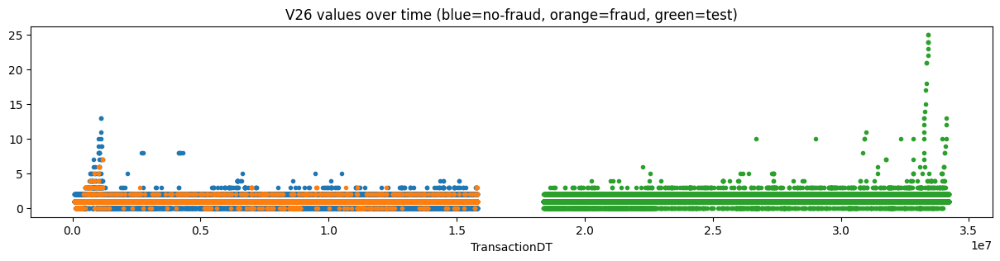

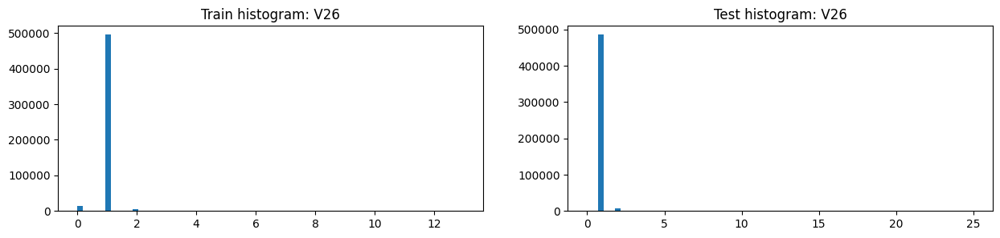

,V26,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,0.988040,1.006199,0.987428,1.012959,1.004058,1.015047
2,std,0.209302,0.289442,0.206031,0.189354,0.148397,0.197679
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,13.000000,7.000000,13.000000,25.000000,4.000000,25.000000
8,unique values,14.000000,9.000000,14.000000,24.000000,6.000000,24.000000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.000000


,V26,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,495119,0.031802,15746,485604
1,-999.0,76073,0.051096,3887,12589
2,0.0,13068,0.038950,509,1543
3,2.0,5906,0.077210,456,6476
4,3.0,271,0.191882,52,367
5,4.0,50,0.120000,6,48
6,5.0,17,0.117647,2,18
7,8.0,13,0.000000,0,4
8,6.0,8,0.375000,3,7
9,7.0,7,0.285714,2,5


,V26,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,495119,0.031802,15746,485604
1,-999.0,76073,0.051096,3887,12589
2,0.0,13068,0.038950,509,1543
3,2.0,5906,0.077210,456,6476
4,3.0,271,0.191882,52,367
5,4.0,50,0.120000,6,48
6,6.0,8,0.375000,3,7
7,5.0,17,0.117647,2,18
8,7.0,7,0.285714,2,5
9,8.0,13,0.000000,0,4


,Column,Correlation with V26
0,V26,1.000000
1,V25,0.840105
2,V67,0.477727
3,V66,0.469765
4,V20,0.340948
5,V19,0.277750
375,V48,-0.036054
376,V90,-0.036811
377,V11,-0.037558
378,V10,-0.040268


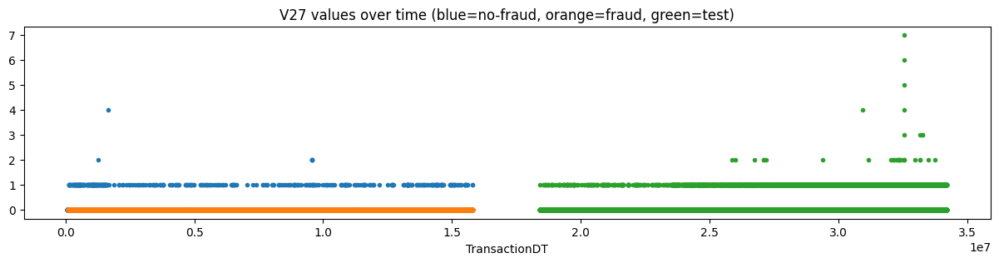

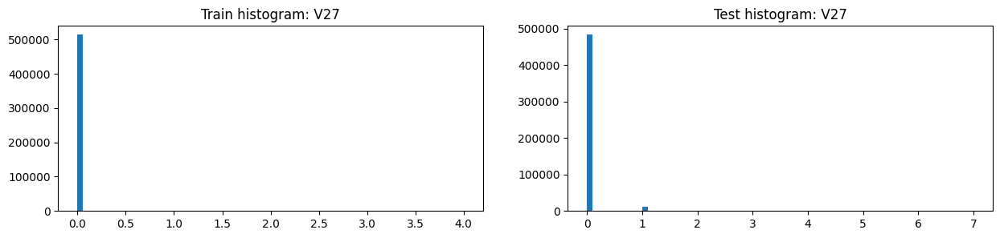

,V27,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.0000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,0.000776,0.0000,0.000802,0.022649,0.001204,0.027680
2,std,0.028596,0.0000,0.029073,0.150069,0.034672,0.165495
3,min,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
7,max,4.000000,0.0000,4.000000,7.000000,1.000000,7.000000
8,unique values,5.000000,2.0000,5.000000,9.000000,3.000000,9.000000
9,NaNs,76073.000000,3887.0000,72186.000000,12589.000000,7455.000000,5134.000000


,V27,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,514076,0.032633,16776,482965
1,-999.0,76073,0.051096,3887,12589
2,1.0,385,0.000000,0,11103
3,2.0,5,0.000000,0,25
4,4.0,1,0.000000,0,2


,V27,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,514076,0.032633,16776,482965
1,-999.0,76073,0.051096,3887,12589
2,1.0,385,0.000000,0,11103
3,2.0,5,0.000000,0,25
4,4.0,1,0.000000,0,2


,Column,Correlation with V27
0,V27,1.000000
1,V28,0.973049
2,V89,0.935332
3,V68,0.889336
4,C3,0.548193
5,V277,0.146077
360,V329,-0.076322
361,V328,-0.078278
362,V330,-0.078566
363,V327,-0.093800


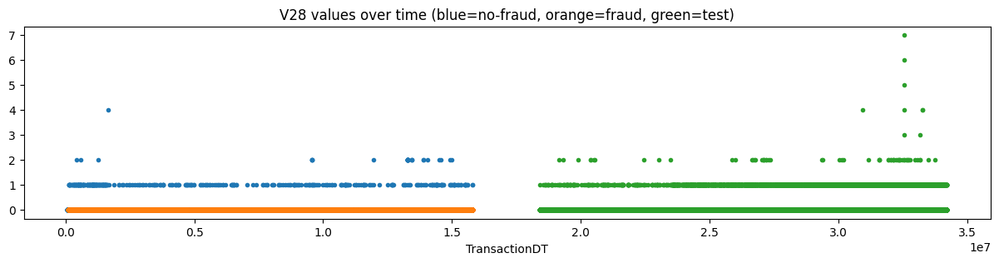

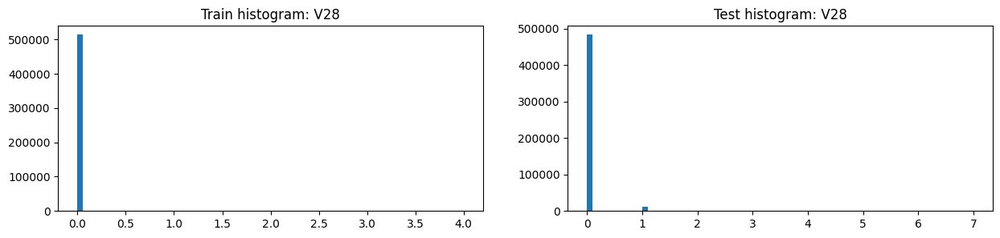

,V28,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.0000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,0.000830,0.0000,0.000858,0.022738,0.001289,0.027770
2,std,0.031133,0.0000,0.031653,0.150903,0.037899,0.166263
3,min,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
7,max,4.000000,0.0000,4.000000,7.000000,2.000000,7.000000
8,unique values,5.000000,2.0000,5.000000,9.000000,4.000000,9.000000
9,NaNs,76073.000000,3887.0000,72186.000000,12589.000000,7455.000000,5134.000000


,V28,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,514073,0.032633,16776,482958
1,-999.0,76073,0.051096,3887,12589
2,1.0,363,0.000000,0,11075
3,2.0,30,0.000000,0,60
4,4.0,1,0.000000,0,4


,V28,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,514073,0.032633,16776,482958
1,-999.0,76073,0.051096,3887,12589
2,1.0,363,0.000000,0,11075
3,2.0,30,0.000000,0,60
4,4.0,1,0.000000,0,4


,Column,Correlation with V28
0,V28,1.000000
1,V27,0.973049
2,V89,0.968086
3,V68,0.914602
4,C3,0.593655
5,V267,0.195550
360,V329,-0.074457
361,V328,-0.076349
362,V330,-0.076881
363,V327,-0.090587


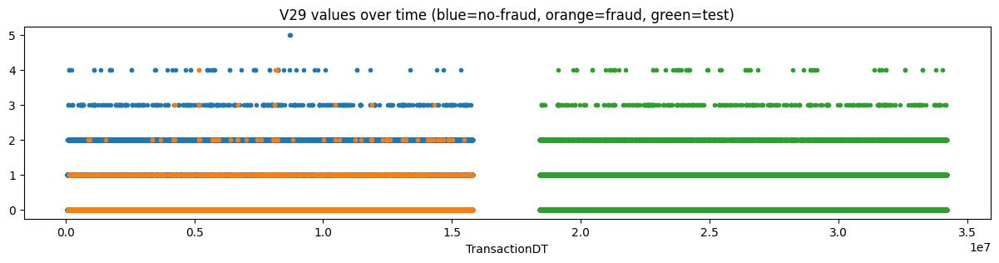

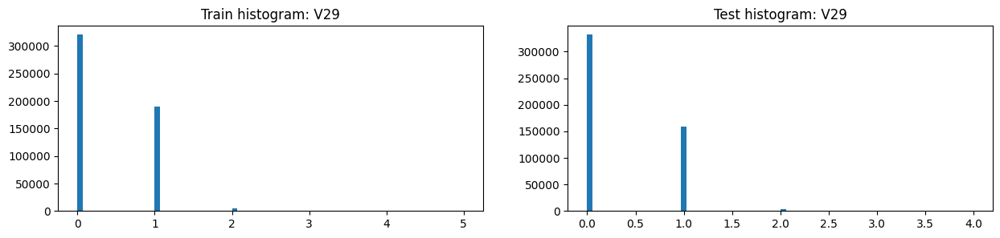

,V29,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,0.387840,0.087864,0.397952,0.337185,0.402518,0.321861
2,std,0.510652,0.307336,0.513065,0.493252,0.511875,0.487516
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
7,max,5.000000,4.000000,5.000000,4.000000,4.000000,4.000000
8,unique values,7.000000,6.000000,7.000000,6.000000,6.000000,6.000000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.000000


,V29,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,320407,0.048067,15401,331940.0
1,1.0,189060,0.006839,1293,158112.0
2,-999.0,76073,0.051096,3887,12589.0
3,2.0,4590,0.015033,69,3717.0
4,3.0,351,0.025641,9,274.0
5,4.0,57,0.070175,4,59.0
6,5.0,2,0.000000,0,NaN


,V29,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,320407,0.048067,15401,331940.0
1,-999.0,76073,0.051096,3887,12589.0
2,1.0,189060,0.006839,1293,158112.0
3,2.0,4590,0.015033,69,3717.0
4,3.0,351,0.025641,9,274.0
5,4.0,57,0.070175,4,59.0
6,5.0,2,0.000000,0,NaN


,Column,Correlation with V29
0,V29,1.000000
1,V30,0.957952
2,V90,0.932192
3,V48,0.915067
4,V69,0.914609
5,V91,0.897254
208,V31,-0.300479
209,V94,-0.303423
210,V52,-0.306100
211,V51,-0.310809


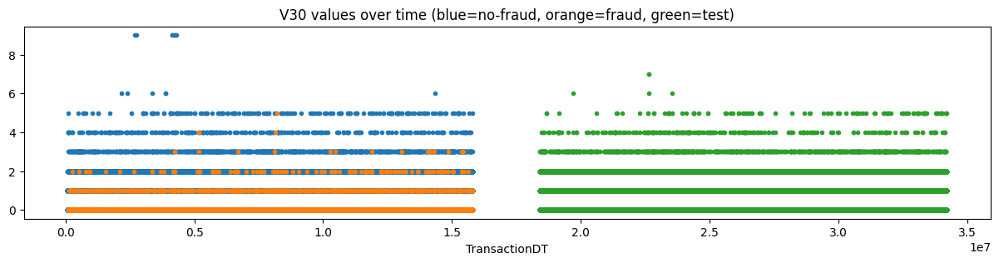

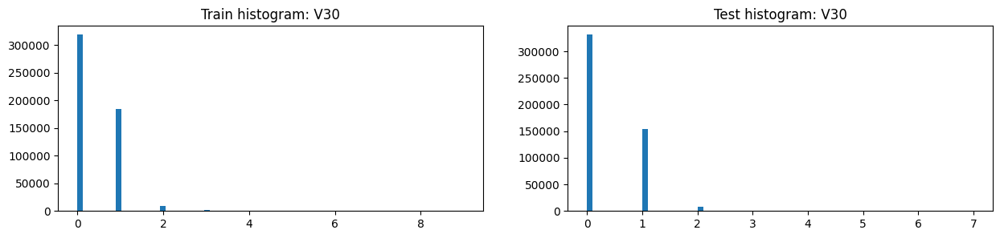

,V30,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,0.406436,0.095196,0.416927,0.352083,0.420253,0.336093
2,std,0.554311,0.334857,0.557192,0.530969,0.549402,0.525273
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
7,max,9.000000,5.000000,9.000000,7.000000,6.000000,7.000000
8,unique values,9.000000,7.000000,9.000000,9.000000,8.000000,9.000000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.000000


,V30,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,319017,0.048157,15363,331104.0
1,1.0,184133,0.006827,1257,153788.0
2,-999.0,76073,0.051096,3887,12589.0
3,2.0,9685,0.013733,133,7899.0
4,3.0,1160,0.016379,19,979.0
5,4.0,279,0.010753,3,225.0
6,5.0,180,0.005556,1,102.0
7,9.0,7,0.000000,0,NaN
8,6.0,6,0.000000,0,3.0


,V30,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,319017,0.048157,15363,331104.0
1,-999.0,76073,0.051096,3887,12589.0
2,1.0,184133,0.006827,1257,153788.0
3,2.0,9685,0.013733,133,7899.0
4,3.0,1160,0.016379,19,979.0
5,4.0,279,0.010753,3,225.0
6,5.0,180,0.005556,1,102.0
7,9.0,7,0.000000,0,NaN
8,6.0,6,0.000000,0,3.0


,Column,Correlation with V30
0,V30,1.000000
1,V29,0.957952
2,V91,0.916219
3,V90,0.901783
4,V70,0.894898
5,V49,0.893633
208,V31,-0.290085
209,V94,-0.292786
210,V52,-0.296323
211,V51,-0.300878


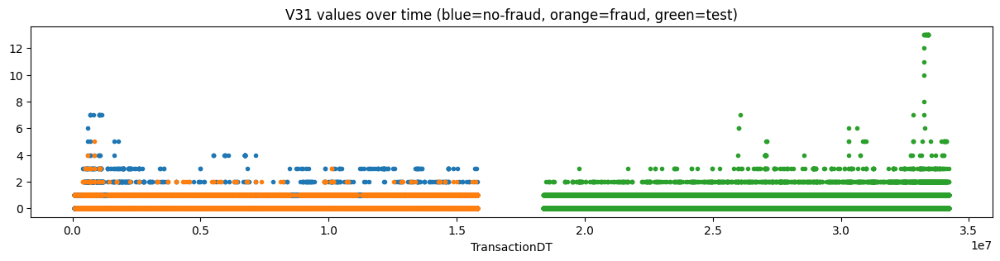

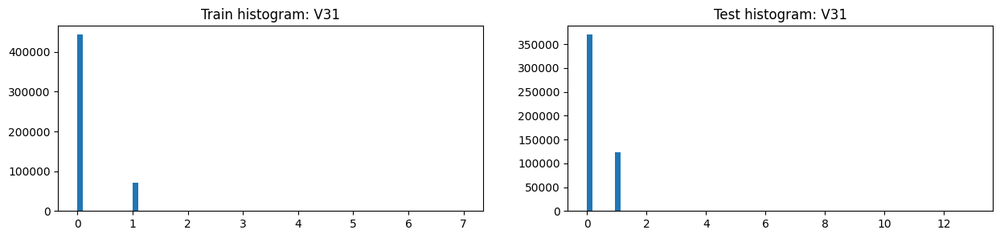

,V31,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,0.140761,0.456962,0.130103,0.255544,0.120873,0.287135
2,std,0.355793,0.516374,0.344070,0.452590,0.328844,0.471455
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
7,max,7.000000,5.000000,7.000000,13.000000,3.000000,13.000000
8,unique values,9.000000,7.000000,9.000000,14.000000,5.000000,14.000000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.000000


,V31,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,443045,0.020853,9239,369773
1,-999.0,76073,0.051096,3887,12589
2,1.0,70729,0.105035,7429,122946
3,2.0,477,0.190776,91,1120
4,3.0,167,0.083832,14,176
5,4.0,33,0.060606,2,36
6,7.0,10,0.000000,0,3
7,5.0,5,0.200000,1,24
8,6.0,1,0.000000,0,5


,V31,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,443045,0.020853,9239,369773
1,1.0,70729,0.105035,7429,122946
2,-999.0,76073,0.051096,3887,12589
3,2.0,477,0.190776,91,1120
4,3.0,167,0.083832,14,176
5,4.0,33,0.060606,2,36
6,5.0,5,0.200000,1,24
7,7.0,10,0.000000,0,3
8,6.0,1,0.000000,0,5


,Column,Correlation with V31
0,V31,1.000000
1,V32,0.986201
2,V50,0.981457
3,V92,0.965936
4,V71,0.958732
5,V93,0.928171
362,V159,-0.487232
363,V160,-0.501588
364,V150,-0.502933
365,V151,-0.538982


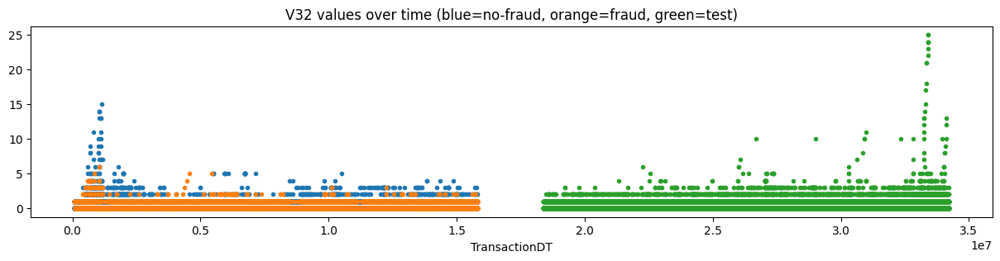

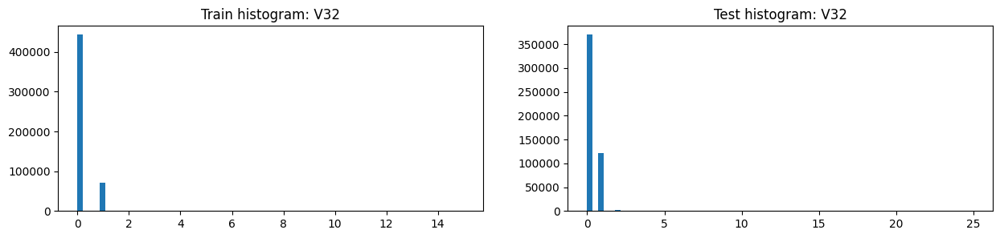

,V32,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,0.142417,0.463758,0.131586,0.258289,0.121512,0.290374
2,std,0.368278,0.538916,0.356108,0.470983,0.331641,0.492587
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
7,max,15.000000,6.000000,15.000000,25.000000,4.000000,25.000000
8,unique values,16.000000,8.000000,16.000000,24.000000,6.000000,24.000000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.000000


,V32,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,443018,0.020855,9239,369709
1,-999.0,76073,0.051096,3887,12589
2,1.0,70307,0.104755,7365,122196
3,2.0,790,0.162025,128,1723
4,3.0,226,0.106195,24,324
5,4.0,51,0.294118,15,78
6,5.0,44,0.068182,3,26
7,6.0,8,0.250000,2,8
8,7.0,5,0.000000,0,4
9,8.0,4,0.000000,0,4


,V32,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,443018,0.020855,9239,369709
1,1.0,70307,0.104755,7365,122196
2,-999.0,76073,0.051096,3887,12589
3,2.0,790,0.162025,128,1723
4,3.0,226,0.106195,24,324
5,4.0,51,0.294118,15,78
6,5.0,44,0.068182,3,26
7,6.0,8,0.250000,2,8
8,7.0,5,0.000000,0,4
9,8.0,4,0.000000,0,4


,Column,Correlation with V32
0,V32,1.000000
1,V31,0.986201
2,V50,0.961004
3,V92,0.945899
4,V71,0.938717
5,V16,0.912332
362,V150,-0.447032
363,V36,-0.452201
364,addr2,-0.457248
365,V151,-0.479138


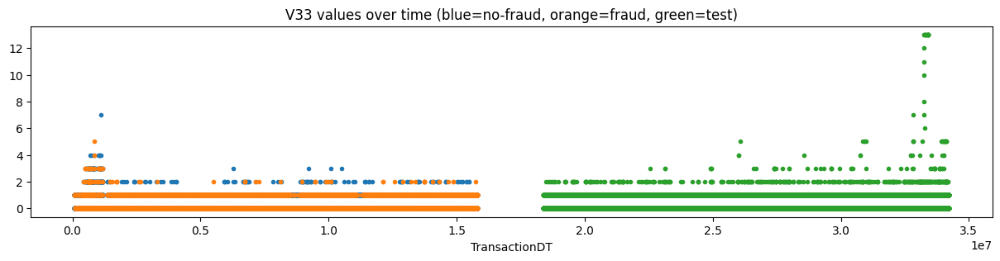

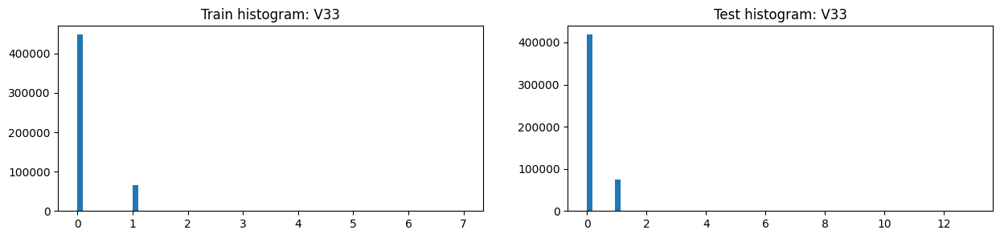

,V33,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,0.130693,0.471388,0.119209,0.154984,0.119903,0.163213
2,std,0.340900,0.518410,0.327150,0.374251,0.326616,0.384108
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,7.000000,5.000000,7.000000,13.000000,2.000000,13.000000
8,unique values,8.000000,7.000000,7.000000,14.000000,4.000000,14.000000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.000000


,V33,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,447769,0.020100,9000,418368
1,-999.0,76073,0.051096,3887,12589
2,1.0,66267,0.115774,7672,75243
3,2.0,338,0.233728,79,383
4,3.0,82,0.280488,23,52
5,4.0,9,0.111111,1,13
6,5.0,1,1.000000,1,21
7,7.0,1,0.000000,0,2


,V33,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,447769,0.020100,9000,418368
1,1.0,66267,0.115774,7672,75243
2,-999.0,76073,0.051096,3887,12589
3,2.0,338,0.233728,79,383
4,3.0,82,0.280488,23,52
5,4.0,9,0.111111,1,13
6,5.0,1,1.000000,1,21
7,7.0,1,0.000000,0,2


,Column,Correlation with V33
0,V33,1.000000
1,V94,0.975796
2,V34,0.959243
3,V15,0.958773
4,V16,0.943636
5,V51,0.940497
328,V53,-0.387275
329,V54,-0.398097
330,V35,-0.411890
331,V36,-0.420924


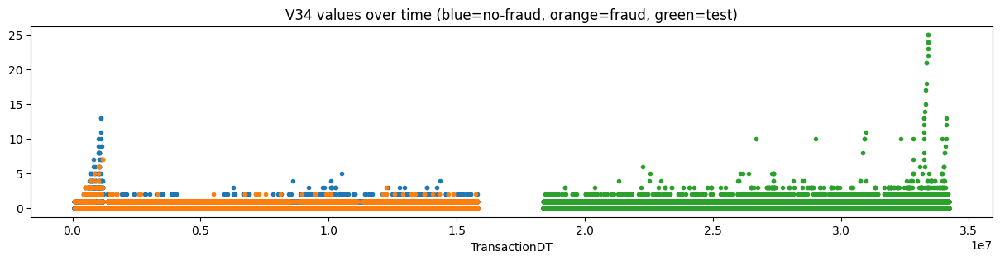

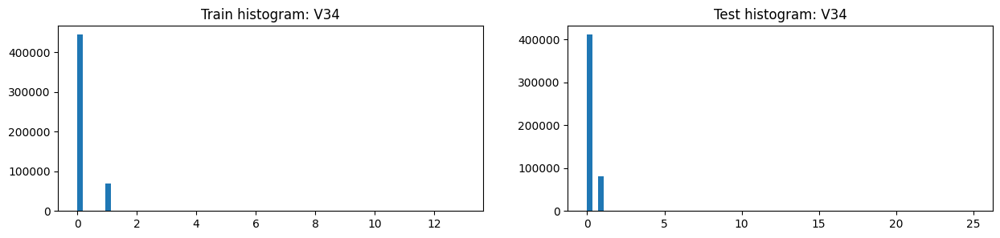

,V34,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,514467.000000,16776.000000,497691.000000,494102.000000,93884.000000,400219.000000
1,mean,0.139154,0.490284,0.127318,0.170068,0.134709,0.178362
2,std,0.357549,0.538387,0.343634,0.403681,0.343777,0.416053
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,13.000000,7.000000,13.000000,25.000000,4.000000,25.000000
8,unique values,14.000000,9.000000,14.000000,24.000000,6.000000,24.000000
9,NaNs,76073.000000,3887.000000,72186.000000,12589.000000,7455.000000,5134.000000


,V34,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,443989,0.019730,8760,411616
1,-999.0,76073,0.051096,3887,12589
2,1.0,69776,0.112976,7883,81672
3,2.0,496,0.169355,84,566
4,3.0,129,0.279070,36,153
5,4.0,34,0.176471,6,36
6,5.0,14,0.142857,2,17
7,6.0,8,0.375000,3,6
8,7.0,7,0.285714,2,2
9,8.0,6,0.000000,0,4


,V34,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,443989,0.019730,8760,411616
1,1.0,69776,0.112976,7883,81672
2,-999.0,76073,0.051096,3887,12589
3,2.0,496,0.169355,84,566
4,3.0,129,0.279070,36,153
5,4.0,34,0.176471,6,36
6,6.0,8,0.375000,3,6
7,5.0,14,0.142857,2,17
8,7.0,7,0.285714,2,2
9,8.0,6,0.000000,0,4


,Column,Correlation with V34
0,V34,1.000000
1,V33,0.959243
2,V94,0.933831
3,V16,0.931086
4,V15,0.922002
5,V51,0.904782
328,V53,-0.363768
329,V54,-0.366323
330,V35,-0.388892
331,V36,-0.391636


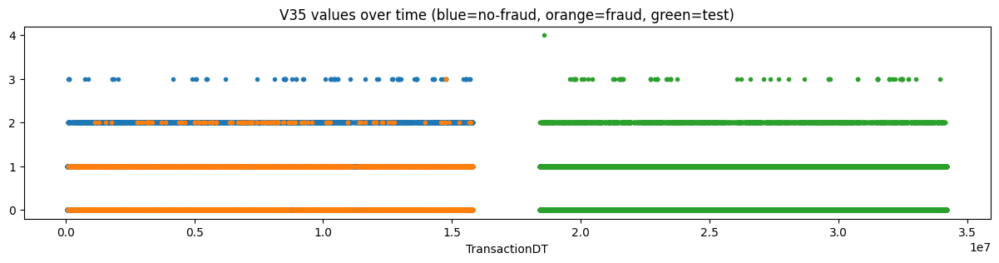

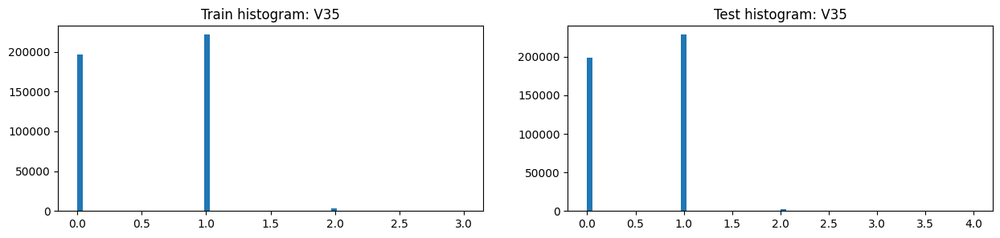

,V35,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421571.000000,14567.000000,407004.000000,429837.000000,80247.000000,349591.000000
1,mean,0.542594,0.332258,0.550122,0.544134,0.647987,0.520297
2,std,0.516010,0.490180,0.515322,0.511129,0.494321,0.511946
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,3.000000,3.000000,3.000000,4.000000,4.000000,3.000000
8,unique values,5.000000,5.000000,5.000000,6.000000,6.000000,5.000000
9,NaNs,168969.000000,6096.000000,162873.000000,76854.000000,21092.000000,55762.000000


,V35,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,221387,0.020679,4578,228457
1,0.0,196551,0.050160,9859,198704
2,-999.0,168969,0.036078,6096,76854
3,2.0,3544,0.036117,128,2597
4,3.0,89,0.022472,2,78


,V35,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,196551,0.050160,9859,198704
1,-999.0,168969,0.036078,6096,76854
2,1.0,221387,0.020679,4578,228457
3,2.0,3544,0.036117,128,2597
4,3.0,89,0.022472,2,78


,Column,Correlation with V35
0,V35,1.000000
1,V36,0.931576
2,V75,0.743539
3,V76,0.704597
4,V12,0.659987
5,V13,0.633326
208,V32,-0.442416
209,V71,-0.444477
210,V92,-0.452122
211,V31,-0.452792


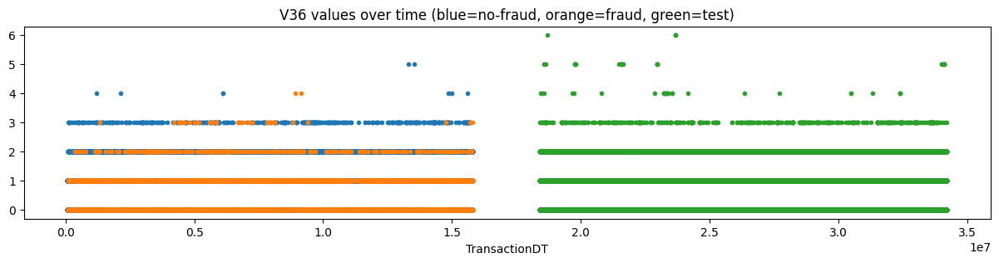

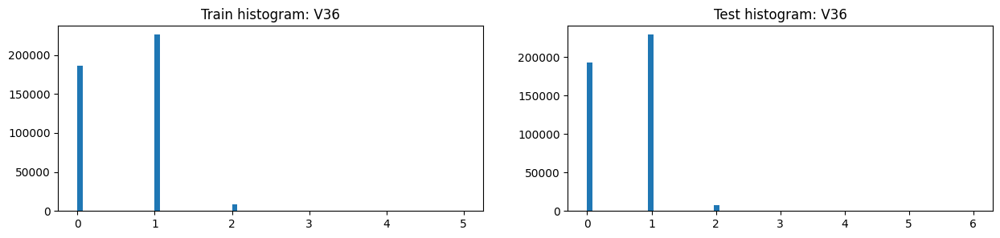

,V36,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421571.000000,14567.000000,407004.000000,429837.000000,80247.000000,349591.000000
1,mean,0.579198,0.380106,0.586323,0.572833,0.684860,0.547119
2,std,0.539039,0.560396,0.536893,0.538038,0.520035,0.538810
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,5.000000,4.000000,5.000000,6.000000,6.000000,6.000000
8,unique values,7.000000,6.000000,7.000000,8.000000,8.000000,8.000000
9,NaNs,168969.000000,6096.000000,162873.000000,76854.000000,21092.000000,55762.000000


,V36,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,226024,0.020179,4561,228956
1,0.0,186733,0.051116,9545,192534
2,-999.0,168969,0.036078,6096,76854
3,2.0,8307,0.049236,409,7863
4,3.0,495,0.101010,50,427
5,4.0,10,0.200000,2,27
6,5.0,2,0.000000,0,26


,V36,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,186733,0.051116,9545,192534
1,-999.0,168969,0.036078,6096,76854
2,1.0,226024,0.020179,4561,228956
3,2.0,8307,0.049236,409,7863
4,3.0,495,0.101010,50,427
5,4.0,10,0.200000,2,27
6,5.0,2,0.000000,0,26


,Column,Correlation with V36
0,V36,1.000000
1,V35,0.931576
2,V76,0.746569
3,V75,0.703356
4,V13,0.669024
5,V54,0.640361
208,V32,-0.452201
209,V71,-0.454318
210,V92,-0.462045
211,V31,-0.462807


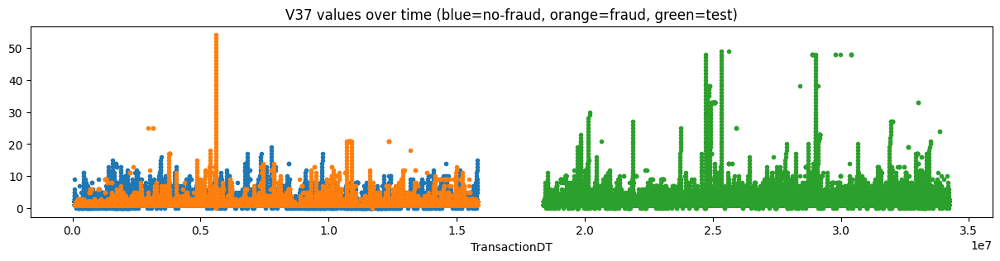

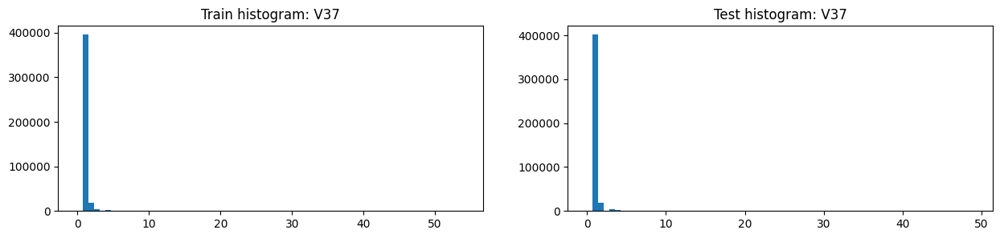

,V37,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421571.000000,14567.000000,407004.000000,429837.000000,80247.000000,349591.000000
1,mean,1.108065,1.753964,1.084948,1.137973,1.115630,1.143102
2,std,0.690571,2.629251,0.480715,1.002657,0.728676,1.055493
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,54.000000,54.000000,19.000000,49.000000,30.000000,49.000000
8,unique values,56.000000,56.000000,21.000000,51.000000,32.000000,51.000000
9,NaNs,168969.000000,6096.000000,162873.000000,76854.000000,21092.000000,55762.000000


,V37,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,395228,0.027382,10822,401275.0
1,-999.0,168969,0.036078,6096,76854.0
2,2.0,18453,0.105999,1956,19231.0
3,3.0,3801,0.195738,744,4231.0
4,4.0,1474,0.195387,288,1778.0
5,5.0,796,0.199749,159,902.0
6,6.0,420,0.304762,128,555.0
7,7.0,327,0.296636,97,362.0
8,0.0,325,0.006154,2,191.0
9,8.0,193,0.347150,67,255.0


,V37,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,395228,0.027382,10822,401275
1,-999.0,168969,0.036078,6096,76854
2,2.0,18453,0.105999,1956,19231
3,3.0,3801,0.195738,744,4231
4,4.0,1474,0.195387,288,1778
5,5.0,796,0.199749,159,902
6,6.0,420,0.304762,128,555
7,7.0,327,0.296636,97,362
8,9.0,168,0.452381,76,151
9,8.0,193,0.347150,67,255


,Column,Correlation with V37
0,V37,1.000000
1,V38,0.868884
2,V77,0.688616
3,V228,0.687371
4,V44,0.647236
5,V230,0.598265
375,V53,-0.113655
376,V54,-0.116795
377,V12,-0.117251
378,V13,-0.119762


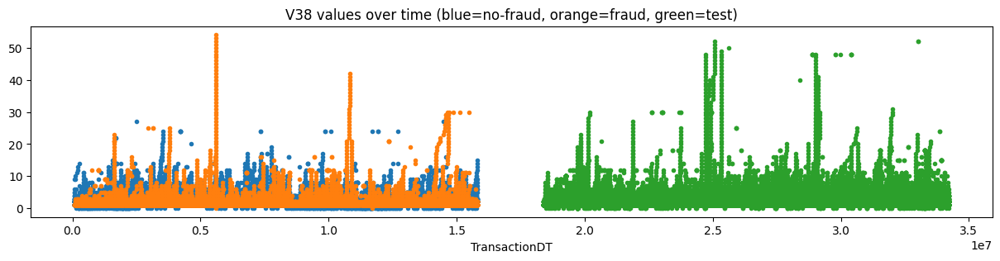

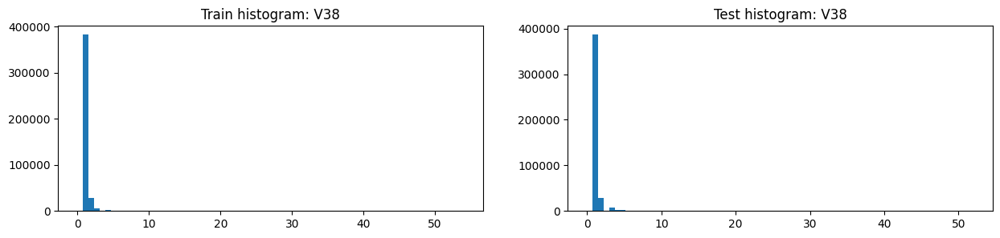

,V38,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421571.00000,14567.000000,407004.000000,429837.000000,80247.000000,349591.000000
1,mean,1.16240,2.065902,1.130063,1.209175,1.177091,1.216539
2,std,0.85892,3.202819,0.605612,1.183571,0.850781,1.247379
3,min,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.00000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.00000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,54.00000,54.000000,27.000000,52.000000,30.000000,52.000000
8,unique values,56.00000,56.000000,27.000000,54.000000,32.000000,54.000000
9,NaNs,168969.00000,6096.000000,162873.000000,76854.000000,21092.000000,55762.000000


,V38,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,382093,0.025520,9751,386613.0
1,-999.0,168969,0.036078,6096,76854.0
2,2.0,28073,0.081965,2301,28514.0
3,3.0,5616,0.174858,982,6793.0
4,4.0,2208,0.205616,454,2794.0
5,5.0,1129,0.217892,246,1516.0
6,6.0,615,0.284553,175,854.0
7,7.0,426,0.342723,146,555.0
8,0.0,325,0.006154,2,187.0
9,8.0,263,0.296578,78,398.0


,V38,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,382093,0.025520,9751,386613
1,-999.0,168969,0.036078,6096,76854
2,2.0,28073,0.081965,2301,28514
3,3.0,5616,0.174858,982,6793
4,4.0,2208,0.205616,454,2794
5,5.0,1129,0.217892,246,1516
6,6.0,615,0.284553,175,854
7,7.0,426,0.342723,146,555
8,8.0,263,0.296578,78,398
9,10.0,144,0.451389,65,358


,Column,Correlation with V38
0,V38,1.000000
1,V37,0.868884
2,V45,0.641233
3,V77,0.636275
4,V78,0.633121
5,V228,0.625274
375,V53,-0.120757
376,D2,-0.121584
377,V12,-0.121793
378,V13,-0.122292


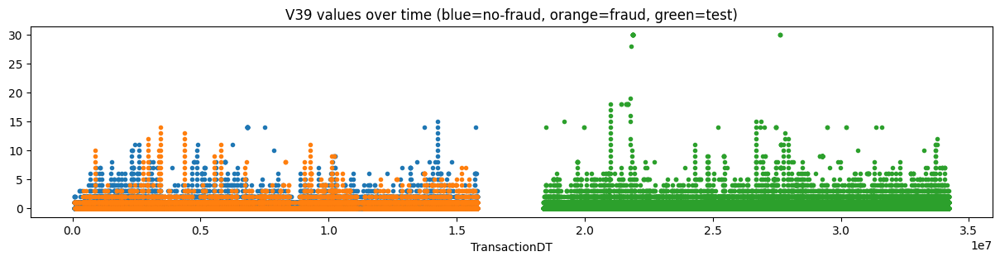

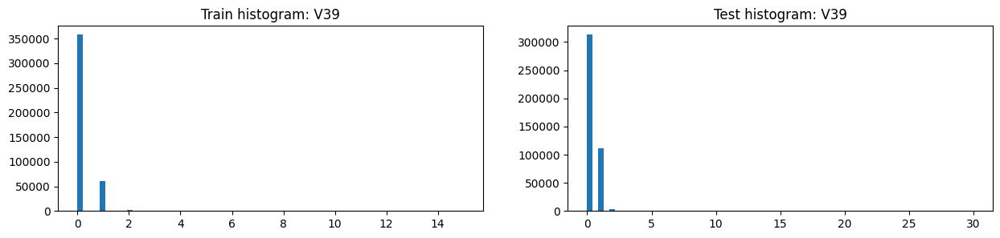

,V39,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421571.000000,14567.000000,407004.000000,429837.00000,80247.000000,349591.000000
1,mean,0.166076,0.651267,0.148711,0.29293,0.144766,0.326939
2,std,0.451956,0.947924,0.413146,0.57212,0.514928,0.579135
3,min,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.00000,0.000000,1.000000
7,max,15.000000,14.000000,15.000000,30.00000,19.000000,30.000000
8,unique values,17.000000,16.000000,17.000000,23.00000,21.000000,19.000000
9,NaNs,168969.000000,6096.000000,162873.000000,76854.00000,21092.000000,55762.000000


,V39,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,357994,0.020366,7291,313015
1,-999.0,168969,0.036078,6096,76854
2,1.0,59921,0.101751,6097,111693
3,2.0,2497,0.294754,736,3720
4,3.0,566,0.409894,232,679
5,4.0,253,0.347826,88,277
6,5.0,108,0.351852,38,176
7,6.0,82,0.329268,27,75
8,7.0,48,0.291667,14,44
9,8.0,37,0.405405,15,35


,V39,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,357994,0.020366,7291,313015
1,1.0,59921,0.101751,6097,111693
2,-999.0,168969,0.036078,6096,76854
3,2.0,2497,0.294754,736,3720
4,3.0,566,0.409894,232,679
5,4.0,253,0.347826,88,277
6,5.0,108,0.351852,38,176
7,6.0,82,0.329268,27,75
8,8.0,37,0.405405,15,35
9,7.0,48,0.291667,14,44


,Column,Correlation with V39
0,V39,1.000000
1,V40,0.943888
2,V80,0.902400
3,V59,0.896473
4,V42,0.876143
5,V81,0.867285
362,V12,-0.389792
363,V36,-0.394839
364,V13,-0.399938
365,V53,-0.401318


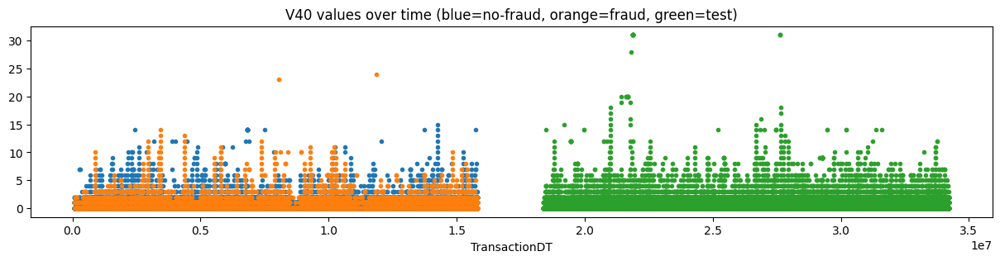

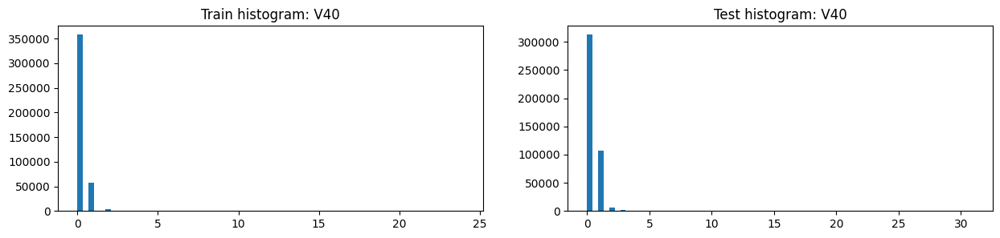

,V40,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421571.000000,14567.000000,407004.000000,429837.000000,80247.000000,349591.000000
1,mean,0.177145,0.745109,0.156817,0.311323,0.163221,0.345318
2,std,0.505786,1.154619,0.453107,0.638946,0.607201,0.641204
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
7,max,24.000000,24.000000,15.000000,31.000000,20.000000,31.000000
8,unique values,19.000000,18.000000,17.000000,24.000000,22.000000,22.000000
9,NaNs,168969.000000,6096.000000,162873.000000,76854.000000,21092.000000,55762.000000


,V40,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,357837,0.020303,7265,312763.0
1,-999.0,168969,0.036078,6096,76854.0
2,1.0,57473,0.095941,5514,107469.0
3,2.0,4230,0.241135,1020,6757.0
4,3.0,1046,0.398662,417,1415.0
5,4.0,400,0.357500,143,591.0
6,5.0,209,0.272727,57,320.0
7,6.0,145,0.420690,61,183.0
8,7.0,78,0.294872,23,88.0
9,8.0,50,0.440000,22,84.0


,V40,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,357837,0.020303,7265,312763
1,-999.0,168969,0.036078,6096,76854
2,1.0,57473,0.095941,5514,107469
3,2.0,4230,0.241135,1020,6757
4,3.0,1046,0.398662,417,1415
5,4.0,400,0.357500,143,591
6,6.0,145,0.420690,61,183
7,5.0,209,0.272727,57,320
8,7.0,78,0.294872,23,88
9,8.0,50,0.440000,22,84


,Column,Correlation with V40
0,V40,1.000000
1,V39,0.943888
2,V81,0.876484
3,V60,0.866431
4,V80,0.862709
5,V43,0.853337
362,V36,-0.376330
363,V13,-0.380729
364,V53,-0.382665
365,addr2,-0.386945


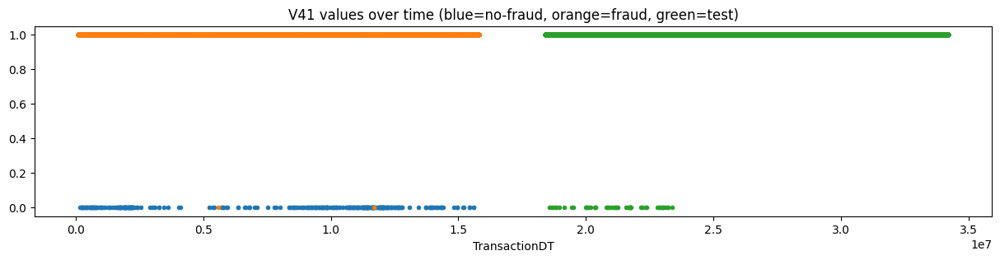

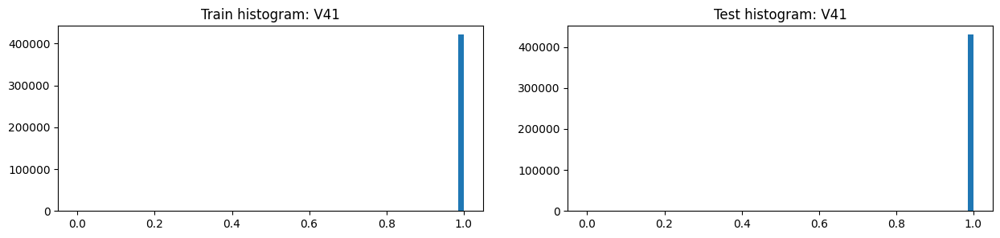

,V41,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421571.000000,14567.000000,407004.000000,429837.000000,80247.000000,349591.000000
1,mean,0.999269,0.999863,0.999248,0.999881,0.999539,0.999960
2,std,0.027020,0.011717,0.027409,0.010892,0.021468,0.006328
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
8,unique values,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000
9,NaNs,168969.000000,6096.000000,162873.000000,76854.000000,21092.000000,55762.000000


,V41,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,421263,0.034575,14565,429786
1,-999.0,168969,0.036078,6096,76854
2,0.0,308,0.006494,2,51


,V41,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,421263,0.034575,14565,429786
1,-999.0,168969,0.036078,6096,76854
2,0.0,308,0.006494,2,51


,Column,Correlation with V41
0,V41,1.000000
1,V88,0.942586
2,V65,0.891086
3,V14,0.880084
4,V1,0.462228
5,V46,0.165801
375,V302,-0.048362
376,D5,-0.051020
377,D6,-0.051160
378,D8,-0.065795


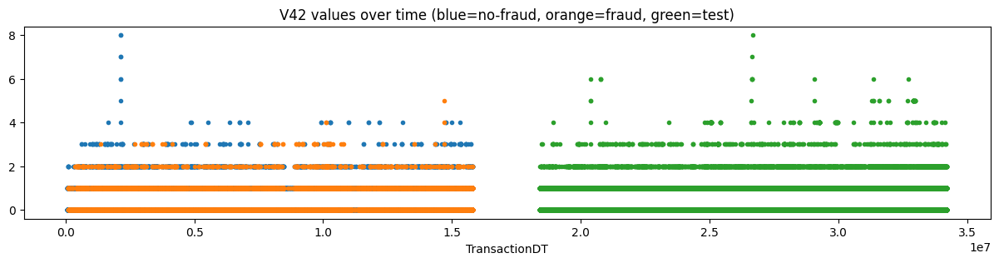

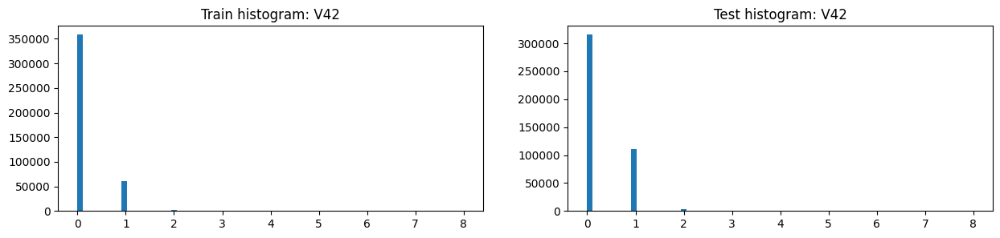

,V42,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421571.000000,14567.000000,407004.000000,429837.000000,80247.000000,349591.000000
1,mean,0.156118,0.539507,0.142397,0.276451,0.129538,0.310174
2,std,0.382896,0.596745,0.365600,0.474845,0.360598,0.491219
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
7,max,8.000000,5.000000,8.000000,8.000000,6.000000,8.000000
8,unique values,10.000000,7.000000,10.000000,10.000000,8.000000,10.000000
9,NaNs,168969.000000,6096.000000,162873.000000,76854.000000,21092.000000,55762.000000


,V42,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,358439,0.020648,7401,315401
1,-999.0,168969,0.036078,6096,76854
2,1.0,60801,0.107860,6558,110831
3,2.0,2037,0.259205,528,3027
4,3.0,256,0.296875,76,427
5,4.0,30,0.100000,3,108
6,5.0,2,0.500000,1,30
7,6.0,2,0.000000,0,11
8,7.0,2,0.000000,0,1
9,8.0,2,0.000000,0,1


,V42,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,358439,0.020648,7401,315401
1,1.0,60801,0.107860,6558,110831
2,-999.0,168969,0.036078,6096,76854
3,2.0,2037,0.259205,528,3027
4,3.0,256,0.296875,76,427
5,4.0,30,0.100000,3,108
6,5.0,2,0.500000,1,30
7,6.0,2,0.000000,0,11
8,7.0,2,0.000000,0,1
9,8.0,2,0.000000,0,1


,Column,Correlation with V42
0,V42,1.000000
1,V84,0.957588
2,V63,0.953351
3,V43,0.952002
4,V21,0.944027
5,V22,0.934389
362,V12,-0.433017
363,V36,-0.438108
364,V13,-0.444288
365,V53,-0.446543


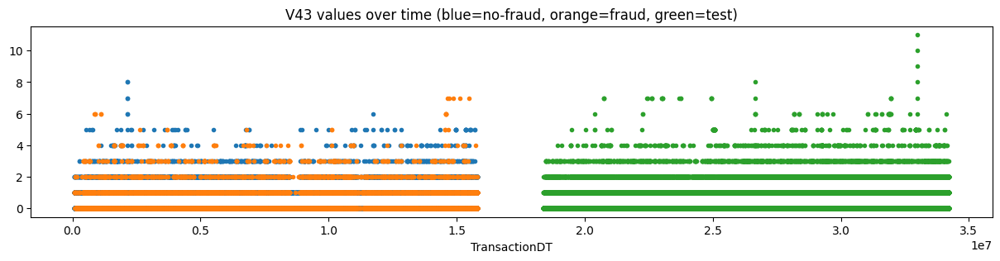

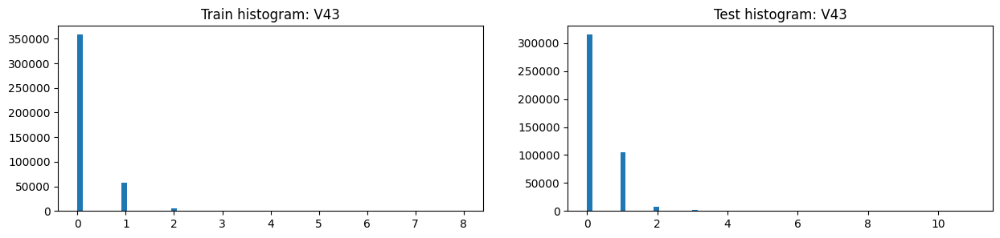

,V43,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421571.000000,14567.000000,407004.000000,429837.000000,80247.000000,349591.000000
1,mean,0.168942,0.623121,0.152686,0.298071,0.146024,0.332972
2,std,0.433359,0.769766,0.407024,0.539790,0.427083,0.556653
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
7,max,8.000000,7.000000,8.000000,11.000000,7.000000,11.000000
8,unique values,10.000000,9.000000,10.000000,13.000000,9.000000,13.000000
9,NaNs,168969.000000,6096.000000,162873.000000,76854.000000,21092.000000,55762.000000


,V43,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,358261,0.020577,7372,315056
1,-999.0,168969,0.036078,6096,76854
2,1.0,56929,0.102408,5830,104444
3,2.0,5234,0.188193,985,8167
4,3.0,885,0.324294,287,1632
5,4.0,174,0.396552,69,359
6,5.0,66,0.136364,9,104
7,6.0,13,0.769231,10,44
8,7.0,7,0.714286,5,26
9,8.0,2,0.000000,0,2


,V43,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,358261,0.020577,7372,315056
1,-999.0,168969,0.036078,6096,76854
2,1.0,56929,0.102408,5830,104444
3,2.0,5234,0.188193,985,8167
4,3.0,885,0.324294,287,1632
5,4.0,174,0.396552,69,359
6,6.0,13,0.769231,10,44
7,5.0,66,0.136364,9,104
8,7.0,7,0.714286,5,26
9,8.0,2,0.000000,0,2


,Column,Correlation with V43
0,V43,1.000000
1,V42,0.952002
2,V64,0.920388
3,V85,0.915452
4,V84,0.915055
5,V63,0.910219
362,V12,-0.414433
363,V36,-0.418888
364,V13,-0.425221
365,V53,-0.427198


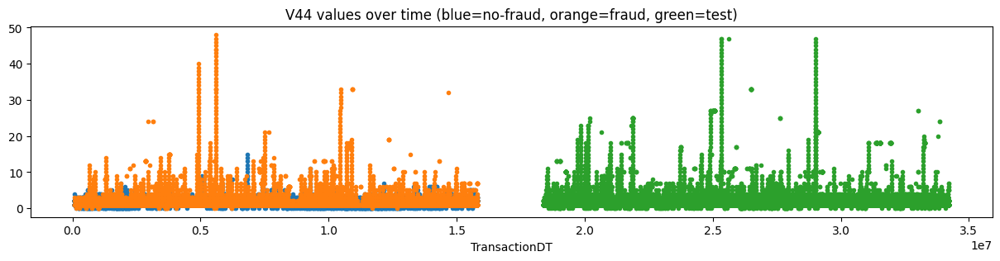

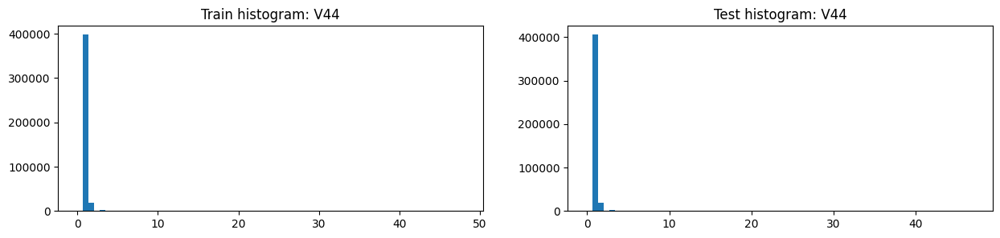

,V44,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421571.000000,14567.000000,407004.000000,429837.000000,80247.000000,349591.000000
1,mean,1.083891,1.963548,1.052407,1.103372,1.109711,1.101916
2,std,0.639143,3.011257,0.264426,0.843529,0.753380,0.862887
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,48.000000,48.000000,15.000000,47.000000,25.000000,47.000000
8,unique values,50.000000,50.000000,17.000000,49.000000,27.000000,49.000000
9,NaNs,168969.000000,6096.000000,162873.000000,76854.000000,21092.000000,55762.000000


,V44,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,397653,0.026015,10345,405518.0
1,-999.0,168969,0.036078,6096,76854.0
2,2.0,19434,0.101832,1979,18884.0
3,3.0,2242,0.330062,740,2588.0
4,4.0,615,0.686179,422,868.0
5,0.0,441,0.077098,34,202.0
6,5.0,319,0.764890,244,341.0
7,6.0,208,0.812500,169,219.0
8,7.0,138,0.949275,131,167.0
9,9.0,102,0.960784,98,109.0


,V44,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,397653,0.026015,10345,405518
1,-999.0,168969,0.036078,6096,76854
2,2.0,19434,0.101832,1979,18884
3,3.0,2242,0.330062,740,2588
4,4.0,615,0.686179,422,868
5,5.0,319,0.764890,244,341
6,6.0,208,0.812500,169,219
7,7.0,138,0.949275,131,167
8,9.0,102,0.960784,98,109
9,8.0,83,0.927711,77,98


,Column,Correlation with V44
0,V44,1.000000
1,V45,0.905101
2,V257,0.766933
3,V200,0.692804
4,V199,0.688442
5,V246,0.682124
375,V13,-0.065195
376,V53,-0.068840
377,V54,-0.071493
378,D8,-0.081858


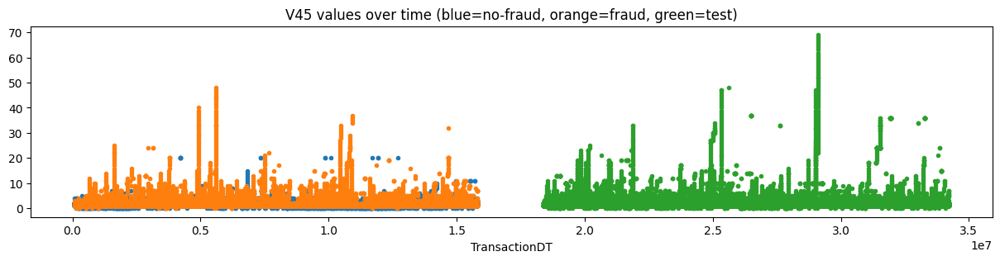

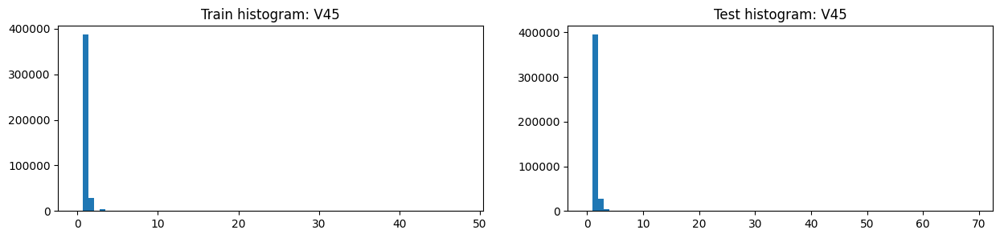

,V45,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421571.000000,14567.000000,407004.000000,429837.000000,80247.000000,349591.000000
1,mean,1.120779,2.207936,1.081869,1.146530,1.156056,1.144343
2,std,0.729774,3.290828,0.346760,1.075638,0.858947,1.119463
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,48.000000,48.000000,20.000000,69.000000,25.000000,69.000000
8,unique values,50.000000,50.000000,18.000000,71.000000,27.000000,71.000000
9,NaNs,168969.000000,6096.000000,162873.000000,76854.000000,21092.000000,55762.000000


,V45,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,387027,0.024838,9613,394651
1,-999.0,168969,0.036078,6096,76854
2,2.0,28125,0.077013,2166,27474
3,3.0,3472,0.230703,801,3956
4,4.0,906,0.620309,562,1230
5,5.0,438,0.732877,321,520
6,0.0,412,0.060680,25,195
7,6.0,253,0.814229,206,365
8,7.0,214,0.920561,197,202
9,9.0,143,0.958042,137,117


,V45,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,387027,0.024838,9613,394651
1,-999.0,168969,0.036078,6096,76854
2,2.0,28125,0.077013,2166,27474
3,3.0,3472,0.230703,801,3956
4,4.0,906,0.620309,562,1230
5,5.0,438,0.732877,321,520
6,6.0,253,0.814229,206,365
7,7.0,214,0.920561,197,202
8,9.0,143,0.958042,137,117
9,8.0,132,0.924242,122,134


,Column,Correlation with V45
0,V45,1.000000
1,V44,0.905101
2,V257,0.741696
3,V201,0.670059
4,V246,0.669157
5,V199,0.665572
375,V12,-0.066598
376,V54,-0.069164
377,V53,-0.069561
378,D8,-0.089789


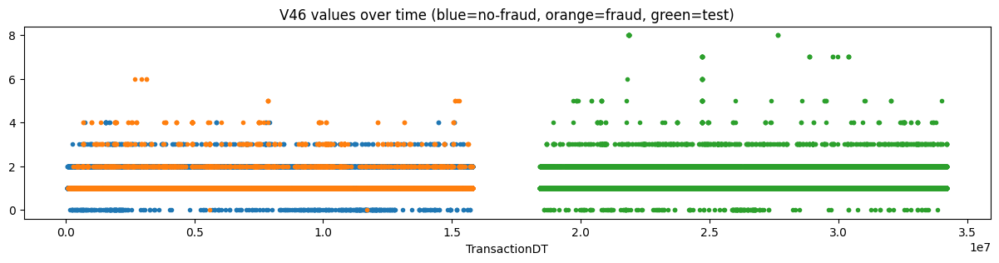

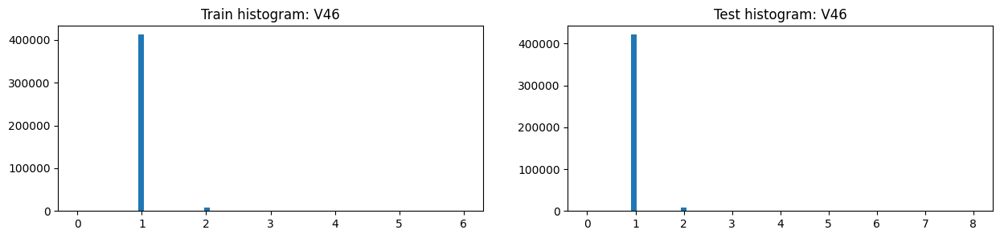

,V46,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421571.000000,14567.000000,407004.000000,429837.000000,80247.000000,349591.000000
1,mean,1.022286,1.133315,1.018312,1.022211,1.020910,1.022509
2,std,0.166719,0.447973,0.145434,0.175910,0.166885,0.177915
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,6.000000,6.000000,4.000000,8.000000,6.000000,8.000000
8,unique values,8.000000,8.000000,6.000000,10.000000,8.000000,10.000000
9,NaNs,168969.000000,6096.000000,162873.000000,76854.000000,21092.000000,55762.000000


,V46,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,412247,0.031801,13110,421088
1,-999.0,168969,0.036078,6096,76854
2,2.0,8340,0.128897,1075,7784
3,3.0,521,0.550864,287,620
4,0.0,348,0.005747,2,171
5,4.0,103,0.786408,81,94
6,5.0,8,1.000000,8,36
7,6.0,4,1.000000,4,10


,V46,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,412247,0.031801,13110,421088
1,-999.0,168969,0.036078,6096,76854
2,2.0,8340,0.128897,1075,7784
3,3.0,521,0.550864,287,620
4,4.0,103,0.786408,81,94
5,5.0,8,1.000000,8,36
6,6.0,4,1.000000,4,10
7,0.0,348,0.005747,2,171


,Column,Correlation with V46
0,V46,1.000000
1,V47,0.755280
2,V44,0.391058
3,V37,0.390613
4,V45,0.360067
5,V38,0.339737
375,V12,-0.040291
376,V29,-0.040457
377,V75,-0.042548
378,D8,-0.062397


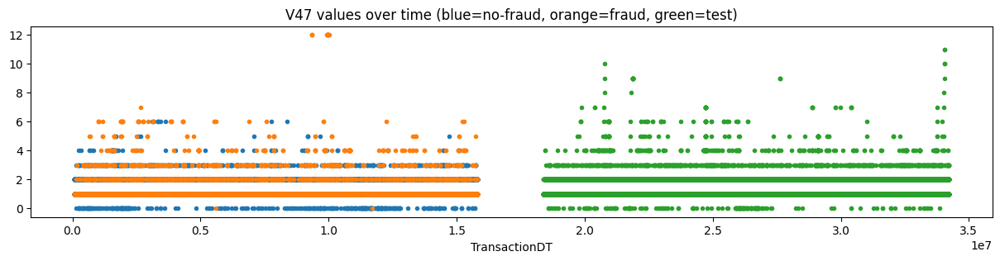

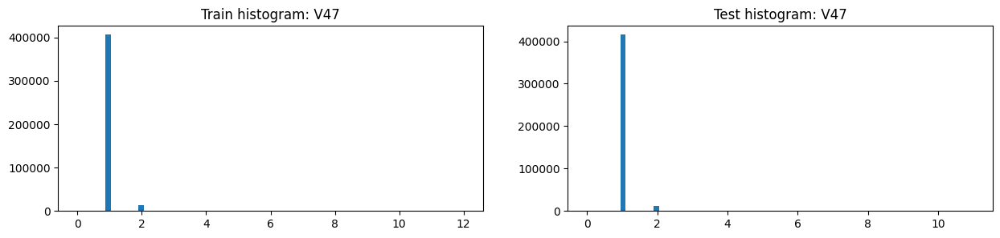

,V47,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421571.000000,14567.000000,407004.000000,429837.000000,80247.000000,349591.000000
1,mean,1.038515,1.239651,1.031317,1.037877,1.036899,1.038102
2,std,0.231862,0.707659,0.190426,0.235685,0.234845,0.235877
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,12.000000,12.000000,6.000000,11.000000,10.000000,11.000000
8,unique values,10.000000,10.000000,8.000000,13.000000,12.000000,13.000000
9,NaNs,168969.000000,6096.000000,162873.000000,76854.000000,21092.000000,55762.000000


,V47,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,406519,0.030095,12234,415540.0
1,-999.0,168969,0.036078,6096,76854.0
2,2.0,13389,0.121592,1628,12651.0
3,3.0,1018,0.470530,479,1014.0
4,0.0,347,0.005764,2,169.0
5,4.0,189,0.714286,135,284.0
6,6.0,49,0.795918,39,55.0
7,5.0,44,0.772727,34,75.0
8,12.0,15,1.000000,15,NaN
9,7.0,1,1.000000,1,26.0


,V47,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,406519,0.030095,12234,415540.0
1,-999.0,168969,0.036078,6096,76854.0
2,2.0,13389,0.121592,1628,12651.0
3,3.0,1018,0.470530,479,1014.0
4,4.0,189,0.714286,135,284.0
5,6.0,49,0.795918,39,55.0
6,5.0,44,0.772727,34,75.0
7,12.0,15,1.000000,15,NaN
8,0.0,347,0.005764,2,169.0
9,7.0,1,1.000000,1,26.0


,Column,Correlation with V47
0,V47,1.000000
1,V46,0.755280
2,V38,0.411788
3,V45,0.398933
4,V52,0.365167
5,V44,0.309776
375,V69,-0.058025
376,V90,-0.059388
377,V29,-0.059653
378,D8,-0.072240


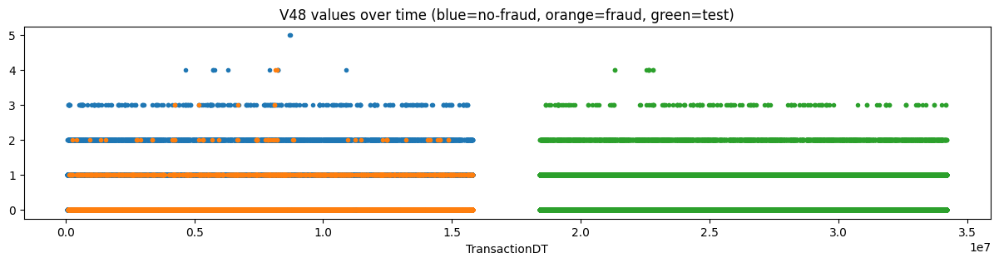

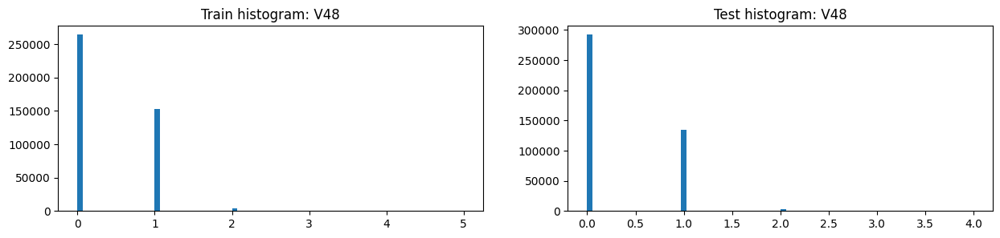

,V48,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421571.000000,14567.000000,407004.000000,429837.000000,80247.000000,349591.000000
1,mean,0.383174,0.072149,0.394306,0.327571,0.404003,0.310028
2,std,0.508189,0.280881,0.510969,0.485626,0.509856,0.478172
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
7,max,5.000000,4.000000,5.000000,4.000000,4.000000,4.000000
8,unique values,7.000000,6.000000,7.000000,6.000000,6.000000,6.000000
9,NaNs,168969.000000,6096.000000,162873.000000,76854.000000,21092.000000,55762.000000


,V48,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,264325,0.051418,13591,292210.0
1,-999.0,168969,0.036078,6096,76854.0
2,1.0,153267,0.005944,911,134613.0
3,2.0,3685,0.015468,57,2862.0
4,3.0,280,0.021429,6,143.0
5,4.0,12,0.166667,2,9.0
6,5.0,2,0.000000,0,NaN


,V48,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,264325,0.051418,13591,292210.0
1,-999.0,168969,0.036078,6096,76854.0
2,1.0,153267,0.005944,911,134613.0
3,2.0,3685,0.015468,57,2862.0
4,3.0,280,0.021429,6,143.0
5,4.0,12,0.166667,2,9.0
6,5.0,2,0.000000,0,NaN


,Column,Correlation with V48
0,V48,1.000000
1,V49,0.967744
2,V90,0.944901
3,V29,0.915067
4,V69,0.912198
5,V91,0.909608
208,V92,-0.323832
209,V33,-0.326608
210,V34,-0.328893
211,V94,-0.331298


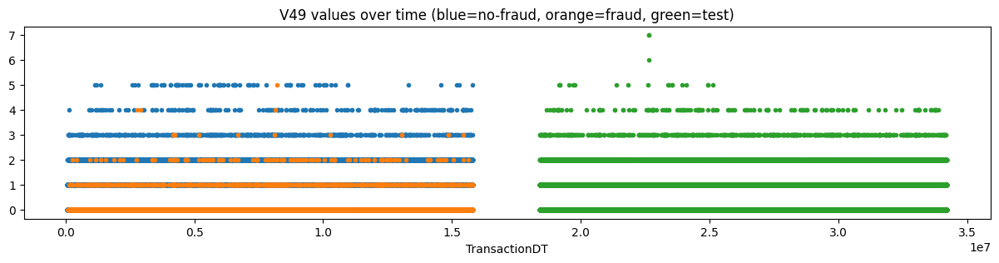

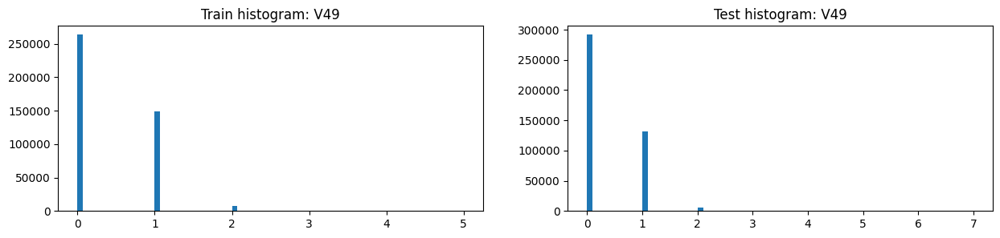

,V49,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421571.000000,14567.000000,407004.000000,429837.000000,80247.000000,349591.000000
1,mean,0.397724,0.079563,0.409111,0.339706,0.419168,0.321467
2,std,0.542654,0.317332,0.545579,0.516249,0.543378,0.508068
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
7,max,5.000000,5.000000,5.000000,7.000000,5.000000,7.000000
8,unique values,7.000000,7.000000,7.000000,9.000000,7.000000,9.000000
9,NaNs,168969.000000,6096.000000,162873.000000,76854.000000,21092.000000,55762.000000


,V49,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,263761,0.051486,13580,291701
1,-999.0,168969,0.036078,6096,76854
2,1.0,149250,0.005608,837,131223
3,2.0,7604,0.017491,133,6131
4,3.0,691,0.018813,13,621
5,4.0,187,0.016043,3,140
6,5.0,78,0.012821,1,18


,V49,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,263761,0.051486,13580,291701
1,-999.0,168969,0.036078,6096,76854
2,1.0,149250,0.005608,837,131223
3,2.0,7604,0.017491,133,6131
4,3.0,691,0.018813,13,621
5,4.0,187,0.016043,3,140
6,5.0,78,0.012821,1,18


,Column,Correlation with V49
0,V49,1.000000
1,V48,0.967744
2,V91,0.925746
3,V90,0.917756
4,V30,0.893633
5,V70,0.891002
208,V92,-0.314762
209,V33,-0.317404
210,V34,-0.319635
211,V94,-0.321990


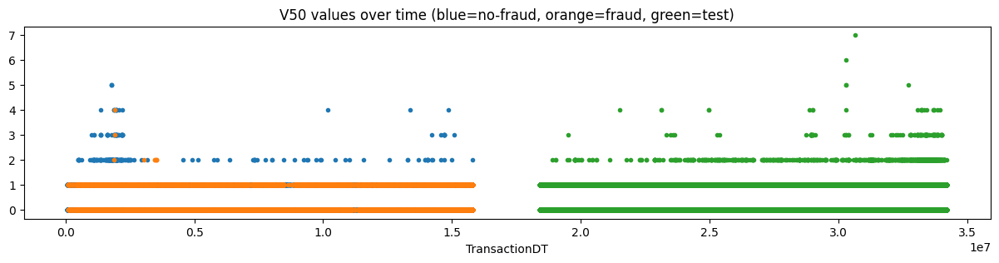

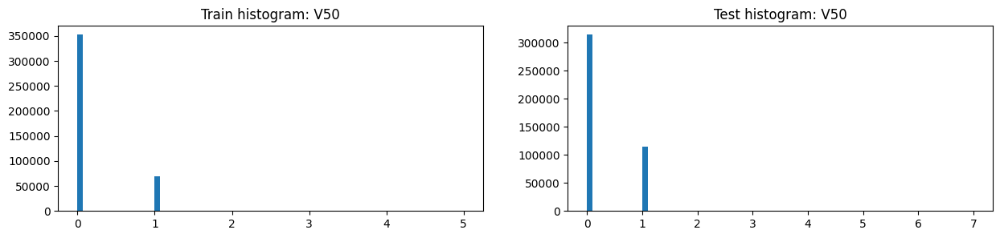

,V50,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421571.000000,14567.000000,407004.000000,429837.000000,80247.000000,349591.000000
1,mean,0.164746,0.520492,0.152013,0.271961,0.128329,0.304931
2,std,0.373995,0.501791,0.362182,0.452709,0.335722,0.469356
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
7,max,5.000000,4.000000,5.000000,7.000000,4.000000,7.000000
8,unique values,7.000000,6.000000,7.000000,9.000000,6.000000,9.000000
9,NaNs,168969.000000,6096.000000,162873.000000,76854.000000,21092.000000,55762.000000


,V50,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,352482,0.019851,6997,314211
1,-999.0,168969,0.036078,6096,76854
2,1.0,68817,0.109871,7561,114527
3,2.0,202,0.034653,7,959
4,3.0,52,0.019231,1,114
5,4.0,15,0.066667,1,21
6,5.0,3,0.000000,0,3


,V50,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,68817,0.109871,7561,114527
1,0.0,352482,0.019851,6997,314211
2,-999.0,168969,0.036078,6096,76854
3,2.0,202,0.034653,7,959
4,3.0,52,0.019231,1,114
5,4.0,15,0.066667,1,21
6,5.0,3,0.000000,0,3


,Column,Correlation with V50
0,V50,1.000000
1,V31,0.981457
2,V92,0.970760
3,V71,0.964355
4,V32,0.961004
5,V15,0.946630
362,V160,-0.528673
363,V145,-0.533730
364,V150,-0.539547
365,V151,-0.573047


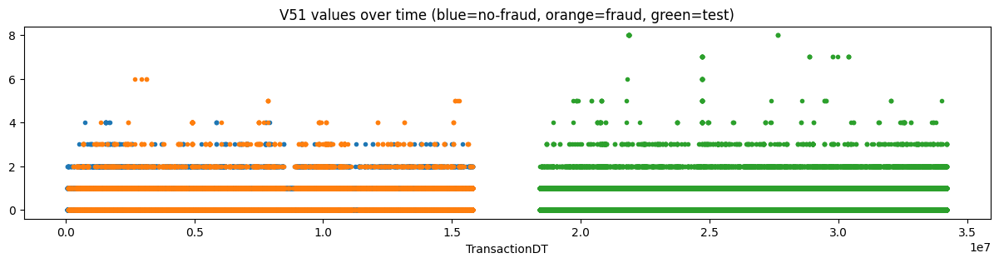

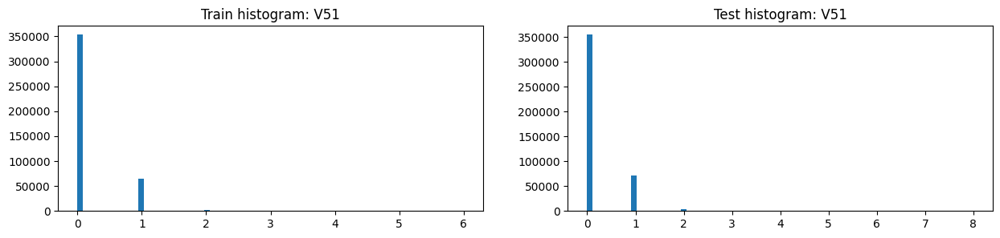

,V51,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421571.000000,14567.000000,407004.000000,429837.000000,80247.000000,349591.000000
1,mean,0.170579,0.647079,0.153524,0.185977,0.146884,0.194951
2,std,0.403899,0.724260,0.376541,0.425913,0.388564,0.433536
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,6.000000,6.000000,4.000000,8.000000,6.000000,8.000000
8,unique values,8.000000,8.000000,6.000000,10.000000,8.000000,10.000000
9,NaNs,168969.000000,6096.000000,162873.000000,76854.000000,21092.000000,55762.000000


,V51,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,353522,0.019170,6777,354721
1,-999.0,168969,0.036078,6096,76854
2,1.0,64775,0.101552,6578,71266
3,2.0,2780,0.311151,865,3205
4,3.0,416,0.687500,286,485
5,4.0,66,0.742424,49,83
6,5.0,8,1.000000,8,33
7,6.0,4,1.000000,4,10


,V51,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,353522,0.019170,6777,354721
1,1.0,64775,0.101552,6578,71266
2,-999.0,168969,0.036078,6096,76854
3,2.0,2780,0.311151,865,3205
4,3.0,416,0.687500,286,485
5,4.0,66,0.742424,49,83
6,5.0,8,1.000000,8,33
7,6.0,4,1.000000,4,10


,Column,Correlation with V51
0,V51,1.000000
1,V52,0.952022
2,V94,0.950989
3,V33,0.940497
4,V73,0.935877
5,V15,0.923125
328,V12,-0.417592
329,V13,-0.428012
330,V53,-0.435189
331,V54,-0.445213


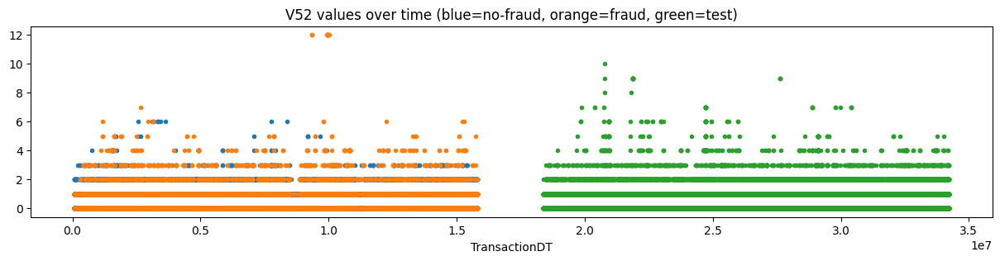

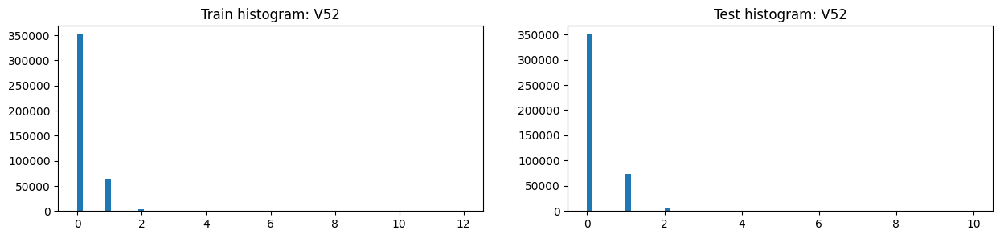

,V52,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,421571.000000,14567.000000,407004.000000,429837.000000,80247.000000,349591.000000
1,mean,0.182695,0.738381,0.162807,0.205466,0.165489,0.214642
2,std,0.439002,0.924367,0.396980,0.464834,0.431574,0.471660
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,12.000000,12.000000,6.000000,10.000000,10.000000,9.000000
8,unique values,10.000000,10.000000,8.000000,12.000000,12.000000,11.000000
9,NaNs,168969.000000,6096.000000,162873.000000,76854.000000,21092.000000,55762.000000


,V52,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,351237,0.018933,6650,349816.0
1,-999.0,168969,0.036078,6096,76854.0
2,1.0,65030,0.093572,6085,73528.0
3,2.0,4362,0.272811,1190,5357.0
4,3.0,705,0.638298,450,774.0
5,4.0,161,0.838509,135,214.0
6,5.0,41,0.780488,32,65.0
7,6.0,19,0.473684,9,42.0
8,12.0,15,1.000000,15,NaN
9,7.0,1,1.000000,1,24.0


,V52,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,351237,0.018933,6650,349816.0
1,-999.0,168969,0.036078,6096,76854.0
2,1.0,65030,0.093572,6085,73528.0
3,2.0,4362,0.272811,1190,5357.0
4,3.0,705,0.638298,450,774.0
5,4.0,161,0.838509,135,214.0
6,5.0,41,0.780488,32,65.0
7,12.0,15,1.000000,15,NaN
8,6.0,19,0.473684,9,42.0
9,7.0,1,1.000000,1,24.0


,Column,Correlation with V52
0,V52,1.000000
1,V51,0.952022
2,V94,0.905186
3,V74,0.899592
4,V33,0.895447
5,V73,0.895137
328,V12,-0.394465
329,V13,-0.399195
330,V53,-0.412856
331,V54,-0.416929


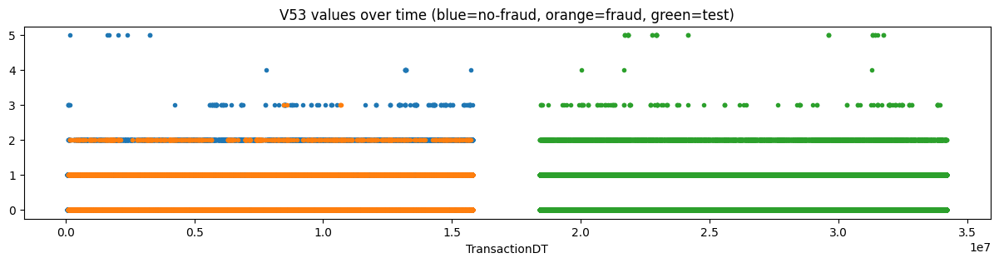

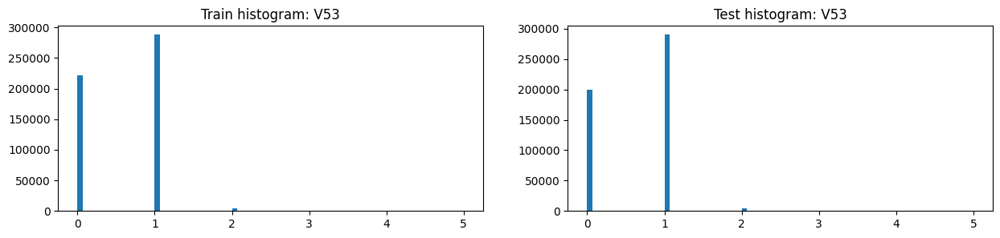

,V53,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,0.577586,0.443048,0.581956,0.604609,0.706132,0.580902
2,std,0.511571,0.565967,0.509111,0.507702,0.481786,0.510668
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,5.000000,3.000000,5.000000,5.000000,5.000000,5.000000
8,unique values,7.000000,5.000000,7.000000,7.000000,7.000000,7.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V53,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,288055,0.020774,5984,290128
1,0.0,221227,0.043331,9586,199557
2,-999.0,77096,0.058486,4509,12899
3,2.0,4006,0.144533,579,3961
4,3.0,140,0.035714,5,113
5,4.0,9,0.000000,0,3
6,5.0,7,0.000000,0,30


,V53,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,221227,0.043331,9586,199557
1,1.0,288055,0.020774,5984,290128
2,-999.0,77096,0.058486,4509,12899
3,2.0,4006,0.144533,579,3961
4,3.0,140,0.035714,5,113
5,4.0,9,0.000000,0,3
6,5.0,7,0.000000,0,30


,Column,Correlation with V53
0,V53,1.000000
1,V54,0.920436
2,V75,0.658947
3,V12,0.635155
4,V35,0.630985
5,V76,0.621525
208,V51,-0.435189
209,V71,-0.435866
210,V92,-0.445846
211,V42,-0.446543


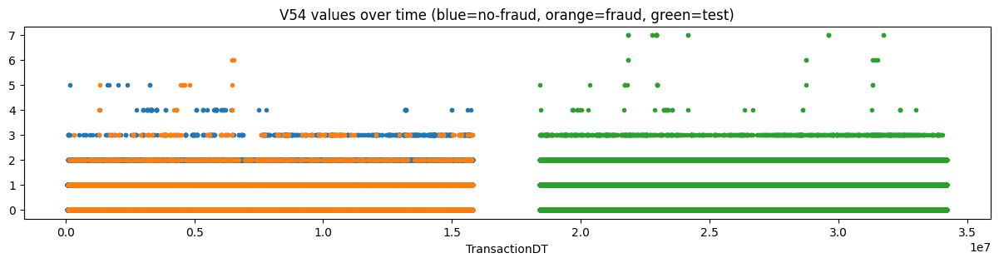

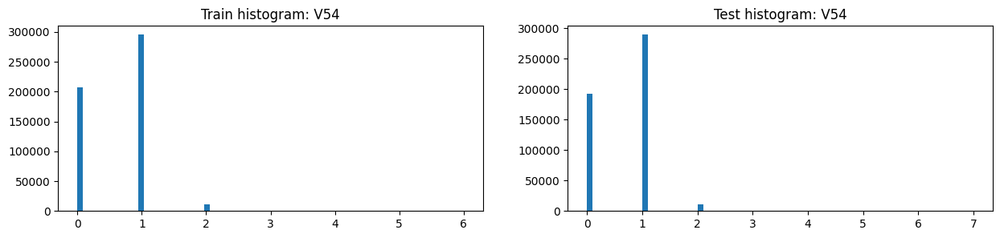

,V54,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,0.619982,0.510152,0.623550,0.634457,0.745555,0.608515
2,std,0.534635,0.654092,0.529922,0.535635,0.509076,0.538358
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,6.000000,6.000000,5.000000,7.000000,5.000000,7.000000
8,unique values,8.000000,8.000000,7.000000,9.000000,7.000000,9.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V54,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,295235,0.020245,5977,289597
1,0.0,207068,0.044097,9131,192825
2,-999.0,77096,0.058486,4509,12899
3,2.0,10445,0.086644,905,10571
4,3.0,603,0.203980,123,728
5,4.0,76,0.105263,8,32
6,5.0,14,0.500000,7,13
7,6.0,3,1.000000,3,8


,V54,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,207068,0.044097,9131,192825
1,1.0,295235,0.020245,5977,289597
2,-999.0,77096,0.058486,4509,12899
3,2.0,10445,0.086644,905,10571
4,3.0,603,0.203980,123,728
5,4.0,76,0.105263,8,32
6,5.0,14,0.500000,7,13
7,6.0,3,1.000000,3,8


,Column,Correlation with V54
0,V54,1.000000
1,V53,0.920436
2,V76,0.668517
3,V13,0.643723
4,V36,0.640361
5,V75,0.622828
208,V31,-0.446002
209,V71,-0.447676
210,V42,-0.457589
211,V92,-0.458229


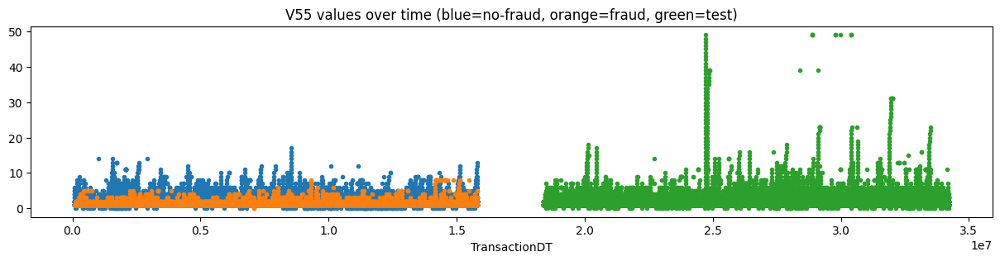

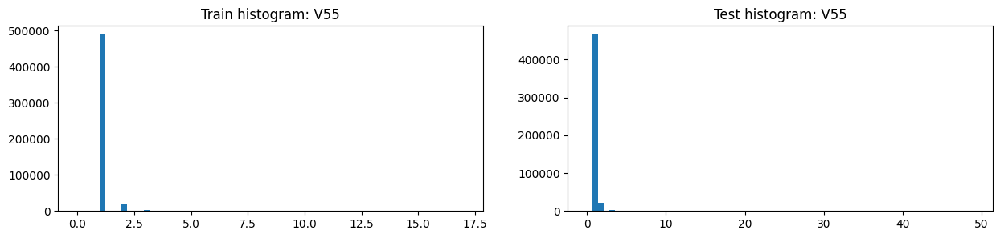

,V55,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,1.067670,1.176489,1.064136,1.092654,1.077144,1.096276
2,std,0.391364,0.584570,0.382941,0.666877,0.425291,0.711522
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,17.000000,8.000000,17.000000,49.000000,18.000000,49.000000
8,unique values,19.000000,10.000000,19.000000,51.000000,20.000000,51.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V55,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,489239,0.028828,14104,465610
1,-999.0,77096,0.058486,4509,12899
2,2.0,18464,0.087684,1619,21137
3,3.0,3100,0.082903,257,3706
4,4.0,1233,0.067315,83,1436
5,5.0,530,0.088679,47,654
6,6.0,300,0.026667,8,383
7,0.0,180,0.005556,1,139
8,7.0,144,0.020833,3,185
9,8.0,124,0.258065,32,116


,V55,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,489239,0.028828,14104,465610
1,-999.0,77096,0.058486,4509,12899
2,2.0,18464,0.087684,1619,21137
3,3.0,3100,0.082903,257,3706
4,4.0,1233,0.067315,83,1436
5,5.0,530,0.088679,47,654
6,8.0,124,0.258065,32,116
7,6.0,300,0.026667,8,383
8,7.0,144,0.020833,3,185
9,0.0,180,0.005556,1,139


,Column,Correlation with V55
0,V55,1.000000
1,V56,0.691925
2,V290,0.611955
3,V292,0.530908
4,V281,0.528348
5,V77,0.522321
375,V29,-0.096872
376,V49,-0.096944
377,V48,-0.099616
378,D2,-0.127195


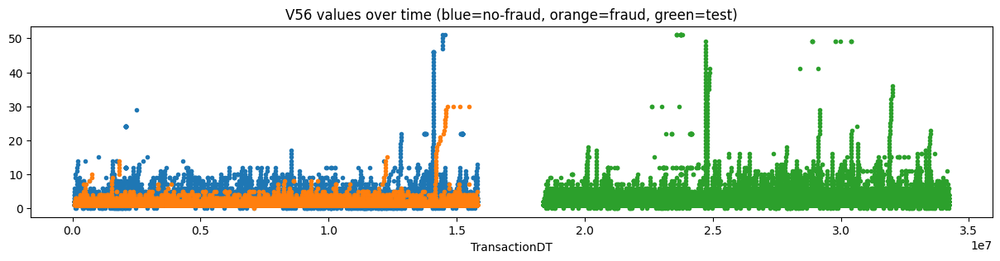

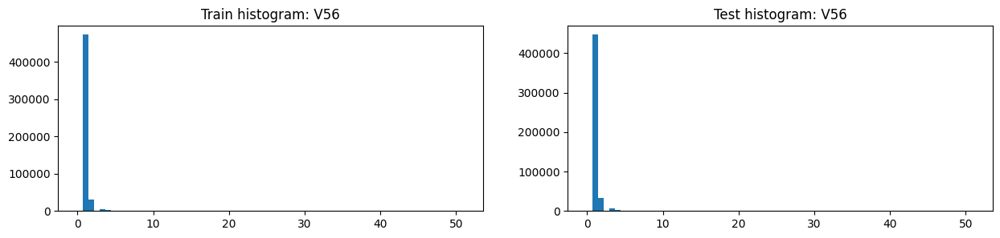

,V56,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,1.120979,1.346044,1.113668,1.155991,1.135385,1.160802
2,std,0.661129,1.198795,0.634752,0.831025,0.553395,0.883305
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,51.000000,30.000000,51.000000,51.000000,18.000000,51.000000
8,unique values,53.000000,32.000000,53.000000,52.000000,20.000000,52.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V56,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,472700,0.027373,12939,447151.0
1,-999.0,77096,0.058486,4509,12899.0
2,2.0,30886,0.070582,2180,33758.0
3,3.0,5610,0.097504,547,7192.0
4,4.0,1881,0.155768,293,2536.0
5,5.0,952,0.101891,97,1194.0
6,6.0,355,0.067606,24,549.0
7,7.0,246,0.073171,18,337.0
8,0.0,180,0.005556,1,136.0
9,8.0,169,0.059172,10,210.0


,V56,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,472700,0.027373,12939,447151
1,-999.0,77096,0.058486,4509,12899
2,2.0,30886,0.070582,2180,33758
3,3.0,5610,0.097504,547,7192
4,4.0,1881,0.155768,293,2536
5,5.0,952,0.101891,97,1194
6,6.0,355,0.067606,24,549
7,7.0,246,0.073171,18,337
8,8.0,169,0.059172,10,210
9,30.0,5,0.800000,4,7


,Column,Correlation with V56
0,V56,1.000000
1,V292,0.737437
2,V55,0.691925
3,V290,0.663716
4,V291,0.657934
5,V78,0.587449
375,V90,-0.097625
376,V29,-0.098005
377,V48,-0.098320
378,D7,-0.133099


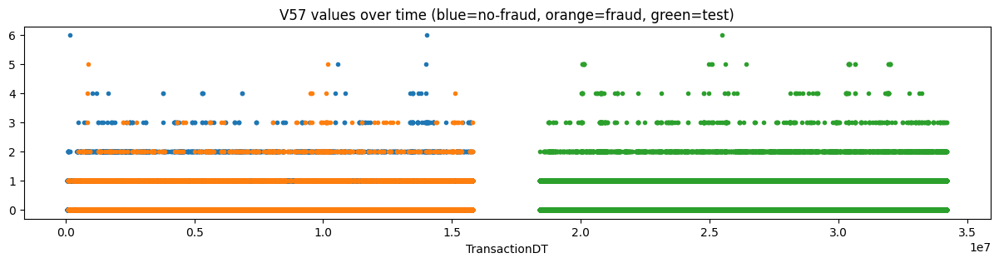

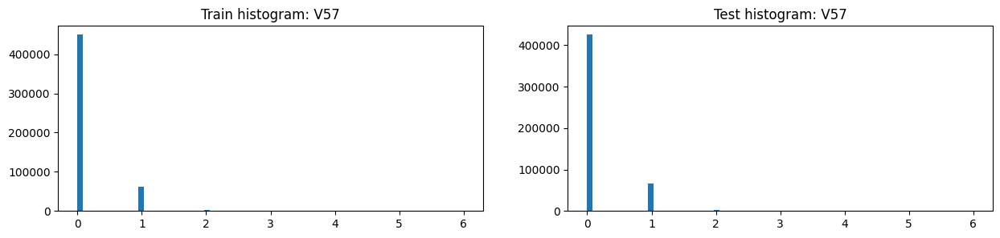

,V57,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,0.128312,0.455429,0.117686,0.145733,0.109603,0.154170
2,std,0.349094,0.575313,0.333895,0.375931,0.339790,0.383391
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,6.000000,5.000000,6.000000,6.000000,5.000000,6.000000
8,unique values,8.000000,7.000000,8.000000,8.000000,7.000000,8.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V57,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,449807,0.020867,9386,425265
1,-999.0,77096,0.058486,4509,12899
2,1.0,61670,0.101313,6248,65642
3,2.0,1731,0.266320,461,2475
4,3.0,203,0.251232,51,299
5,4.0,27,0.222222,6,83
6,5.0,4,0.500000,2,27
7,6.0,2,0.000000,0,1


,V57,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,449807,0.020867,9386,425265
1,1.0,61670,0.101313,6248,65642
2,-999.0,77096,0.058486,4509,12899
3,2.0,1731,0.266320,461,2475
4,3.0,203,0.251232,51,299
5,4.0,27,0.222222,6,83
6,5.0,4,0.500000,2,27
7,6.0,2,0.000000,0,1


,Column,Correlation with V57
0,V57,1.000000
1,V58,0.962971
2,V15,0.958967
3,V71,0.943166
4,V73,0.940898
5,V50,0.938989
315,V53,-0.414989
316,V54,-0.426233
317,V35,-0.435636
318,V36,-0.445281


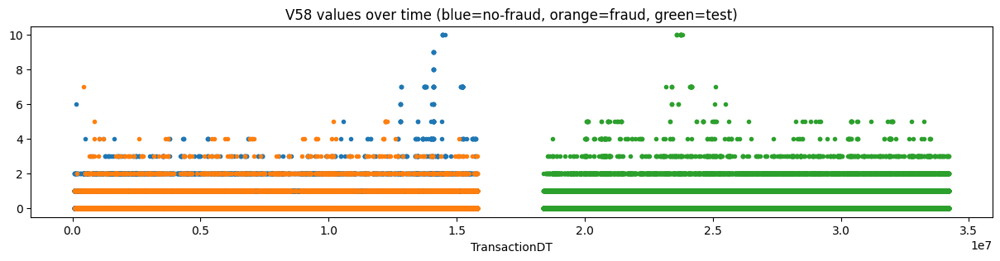

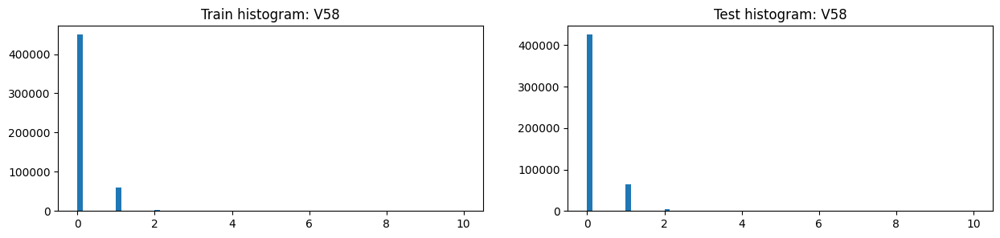

,V58,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,0.132453,0.490529,0.120821,0.150683,0.114299,0.159178
2,std,0.372907,0.650019,0.354333,0.400369,0.364030,0.407921
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,10.000000,7.000000,10.000000,10.000000,5.000000,10.000000
8,unique values,12.000000,8.000000,12.000000,10.000000,7.000000,10.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V58,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,449600,0.020812,9357,425256.0
1,-999.0,77096,0.058486,4509,12899.0
2,1.0,60662,0.096848,5875,63921.0
3,2.0,2675,0.285981,765,3789.0
4,3.0,300,0.400000,120,596.0
5,4.0,105,0.266667,28,129.0
6,7.0,45,0.022222,1,18.0
7,5.0,31,0.258065,8,65.0
8,6.0,10,0.000000,0,7.0
9,10.0,6,0.000000,0,11.0


,V58,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,449600,0.020812,9357,425256
1,1.0,60662,0.096848,5875,63921
2,-999.0,77096,0.058486,4509,12899
3,2.0,2675,0.285981,765,3789
4,3.0,300,0.400000,120,596
5,4.0,105,0.266667,28,129
6,5.0,31,0.258065,8,65
7,7.0,45,0.022222,1,18
8,6.0,10,0.000000,0,7
9,10.0,6,0.000000,0,11


,Column,Correlation with V58
0,V58,1.000000
1,V57,0.962971
2,V79,0.947932
3,V72,0.943713
4,V15,0.926226
5,V71,0.908084
315,V53,-0.401025
316,V54,-0.411891
317,V35,-0.420375
318,V36,-0.429683


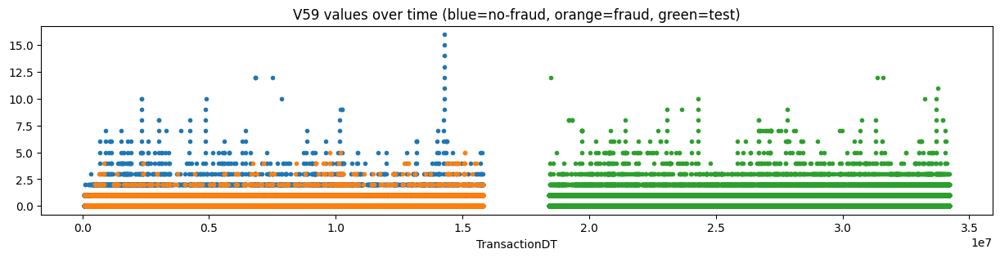

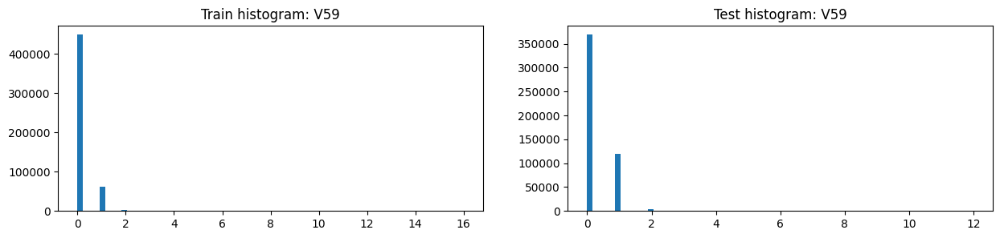

,V59,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,0.134433,0.452334,0.124107,0.266398,0.123735,0.299708
2,std,0.379291,0.600346,0.365292,0.486771,0.387794,0.501294
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
7,max,16.000000,5.000000,16.000000,12.000000,12.000000,12.000000
8,unique values,18.000000,7.000000,18.000000,14.000000,11.000000,14.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V59,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,448636,0.021298,9555,369048.0
1,-999.0,77096,0.058486,4509,12899.0
2,1.0,61876,0.097760,6049,119715.0
3,2.0,2264,0.190813,432,4054.0
4,3.0,388,0.211340,82,605.0
5,4.0,148,0.216216,32,171.0
6,5.0,62,0.064516,4,91.0
7,6.0,29,0.000000,0,43.0
8,7.0,13,0.000000,0,36.0
9,8.0,7,0.000000,0,17.0


,V59,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,448636,0.021298,9555,369048.0
1,1.0,61876,0.097760,6049,119715.0
2,-999.0,77096,0.058486,4509,12899.0
3,2.0,2264,0.190813,432,4054.0
4,3.0,388,0.211340,82,605.0
5,4.0,148,0.216216,32,171.0
6,5.0,62,0.064516,4,91.0
7,12.0,5,0.000000,0,3.0
8,15.0,1,0.000000,0,NaN
9,14.0,1,0.000000,0,NaN


,Column,Correlation with V59
0,V59,1.000000
1,V60,0.953204
2,V63,0.934990
3,V302,0.925841
4,V21,0.905885
5,V80,0.901617
362,V13,-0.393512
363,V53,-0.400171
364,V35,-0.400450
365,V36,-0.409316


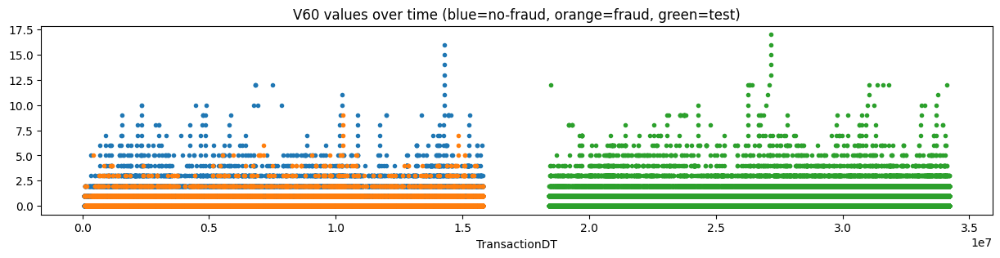

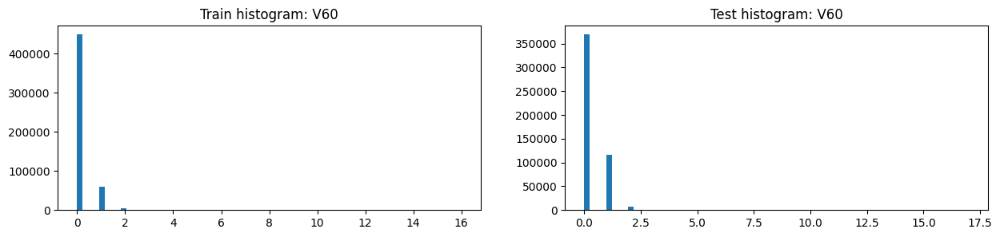

,V60,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,0.142537,0.492819,0.131159,0.280408,0.134690,0.314432
2,std,0.418230,0.688078,0.401378,0.539676,0.438684,0.555163
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
7,max,16.000000,9.000000,16.000000,17.000000,12.000000,17.000000
8,unique values,18.000000,11.000000,18.000000,19.000000,11.000000,19.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V60,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,448369,0.021177,9495,368830
1,-999.0,77096,0.058486,4509,12899
2,1.0,59589,0.095370,5683,115570
3,2.0,4065,0.187946,764,7218
4,3.0,854,0.159251,136,1291
5,4.0,296,0.175676,52,432
6,5.0,137,0.124088,17,197
7,6.0,52,0.057692,3,122
8,7.0,24,0.083333,2,51
9,9.0,21,0.047619,1,27


,V60,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,448369,0.021177,9495,368830
1,1.0,59589,0.095370,5683,115570
2,-999.0,77096,0.058486,4509,12899
3,2.0,4065,0.187946,764,7218
4,3.0,854,0.159251,136,1291
5,4.0,296,0.175676,52,432
6,5.0,137,0.124088,17,197
7,6.0,52,0.057692,3,122
8,7.0,24,0.083333,2,51
9,8.0,17,0.058824,1,26


,Column,Correlation with V60
0,V60,1.000000
1,V59,0.953204
2,V302,0.914733
3,V304,0.906584
4,V64,0.901516
5,V63,0.892258
362,V13,-0.377977
363,V35,-0.384247
364,V53,-0.384792
365,V36,-0.392754


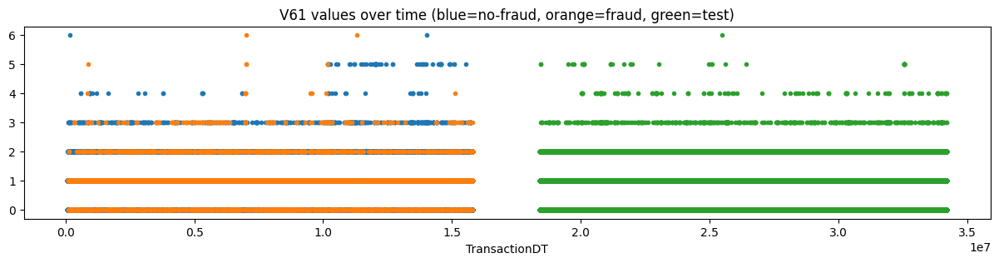

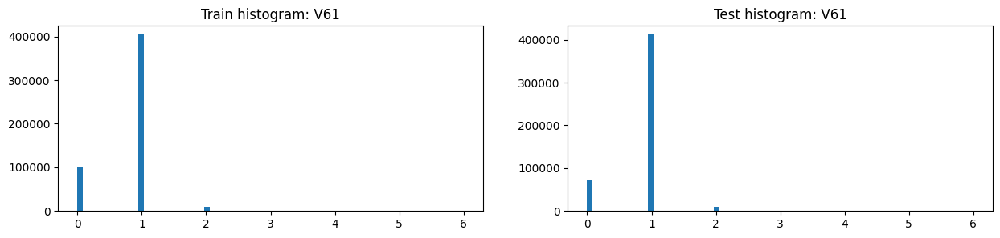

,V61,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,0.829785,0.949486,0.825896,0.879980,0.855596,0.885674
2,std,0.436617,0.503119,0.433733,0.397378,0.427601,0.389764
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,6.000000,6.000000,6.000000,6.000000,5.000000,6.000000
8,unique values,8.000000,8.000000,8.000000,8.000000,7.000000,8.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V61,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,404182,0.031288,12646,412011
1,0.0,98827,0.022808,2254,70995
2,-999.0,77096,0.058486,4509,12899
3,2.0,9620,0.113825,1095,10041
4,3.0,702,0.202279,142,583
5,5.0,60,0.066667,4,35
6,4.0,49,0.224490,11,126
7,6.0,4,0.500000,2,1


,V61,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,404182,0.031288,12646,412011
1,-999.0,77096,0.058486,4509,12899
2,0.0,98827,0.022808,2254,70995
3,2.0,9620,0.113825,1095,10041
4,3.0,702,0.202279,142,583
5,4.0,49,0.224490,11,126
6,5.0,60,0.066667,4,35
7,6.0,4,0.500000,2,1


,Column,Correlation with V61
0,V61,1.000000
1,V62,0.890257
2,V82,0.697912
3,V19,0.682139
4,V20,0.632256
5,V83,0.629035
375,V328,-0.485598
376,V329,-0.485859
377,V330,-0.499854
378,V327,-0.546545


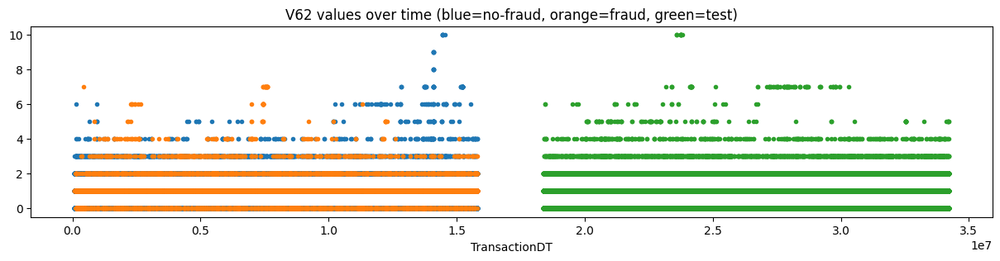

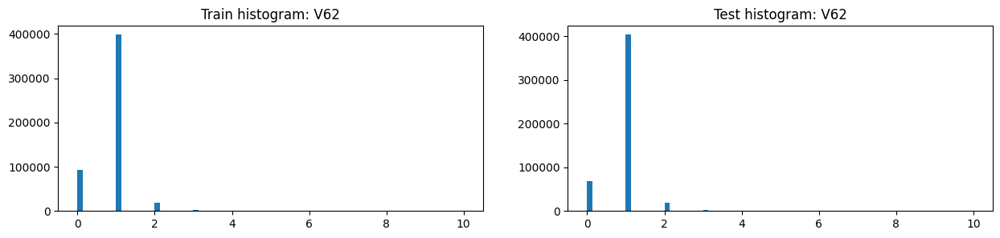

,V62,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,0.867563,1.061904,0.861250,0.912862,0.892762,0.917556
2,std,0.483803,0.685393,0.474493,0.452732,0.477507,0.446619
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,10.000000,7.000000,10.000000,10.000000,6.000000,10.000000
8,unique values,12.000000,9.000000,12.000000,10.000000,8.000000,10.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V62,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,398513,0.029971,11944,403691.0
1,0.0,93177,0.021711,2023,68371.0
2,-999.0,77096,0.058486,4509,12899.0
3,2.0,19368,0.083695,1621,19204.0
4,3.0,1860,0.222581,414,1918.0
5,4.0,287,0.324042,93,378.0
6,6.0,82,0.256098,21,24.0
7,5.0,78,0.243590,19,110.0
8,7.0,63,0.301587,19,85.0
9,10.0,6,0.000000,0,11.0


,V62,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,398513,0.029971,11944,403691
1,-999.0,77096,0.058486,4509,12899
2,0.0,93177,0.021711,2023,68371
3,2.0,19368,0.083695,1621,19204
4,3.0,1860,0.222581,414,1918
5,4.0,287,0.324042,93,378
6,6.0,82,0.256098,21,24
7,5.0,78,0.243590,19,110
8,7.0,63,0.301587,19,85
9,10.0,6,0.000000,0,11


,Column,Correlation with V62
0,V62,1.000000
1,V61,0.890257
2,V83,0.683948
3,V20,0.633815
4,V82,0.629571
5,V19,0.615758
375,V328,-0.480924
376,V329,-0.480941
377,V330,-0.494861
378,V327,-0.539304


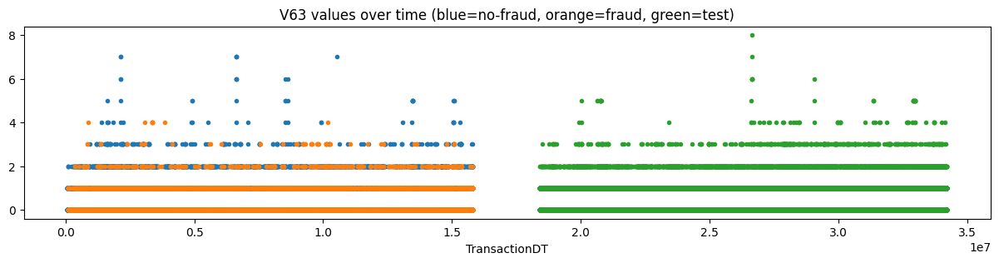

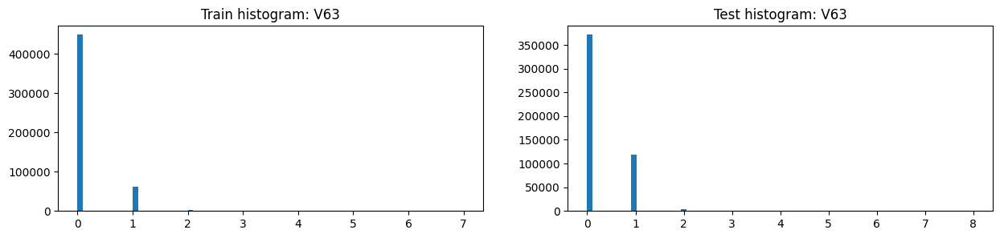

,V63,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,0.130743,0.433020,0.120923,0.256800,0.116963,0.289452
2,std,0.355262,0.557809,0.342257,0.460787,0.344637,0.478055
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
7,max,7.000000,4.000000,7.000000,8.000000,5.000000,8.000000
8,unique values,9.000000,6.000000,9.000000,10.000000,7.000000,10.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V63,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,448961,0.021425,9619,371489
1,-999.0,77096,0.058486,4509,12899
2,1.0,62231,0.098600,6136,118419
3,2.0,1969,0.176232,347,3388
4,3.0,221,0.194570,43,415
5,4.0,32,0.281250,9,49
6,5.0,17,0.000000,0,25
7,6.0,7,0.000000,0,5
8,7.0,6,0.000000,0,1


,V63,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,448961,0.021425,9619,371489
1,1.0,62231,0.098600,6136,118419
2,-999.0,77096,0.058486,4509,12899
3,2.0,1969,0.176232,347,3388
4,3.0,221,0.194570,43,415
5,4.0,32,0.281250,9,49
6,5.0,17,0.000000,0,25
7,6.0,7,0.000000,0,5
8,7.0,6,0.000000,0,1


,Column,Correlation with V63
0,V63,1.000000
1,V84,0.955156
2,V42,0.953351
3,V21,0.946929
4,V64,0.944450
5,V59,0.934990
362,V13,-0.408630
363,V53,-0.415508
364,V35,-0.417907
365,V54,-0.426767


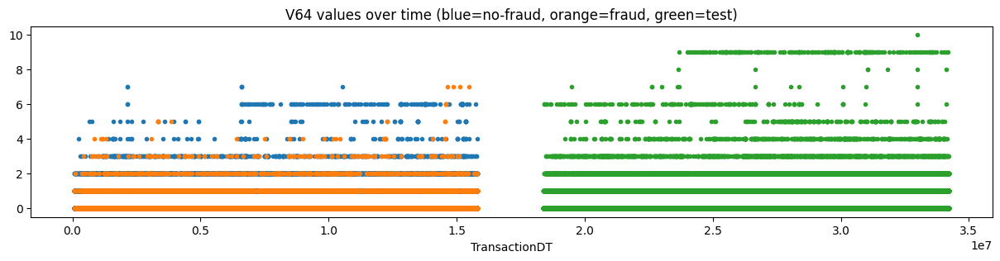

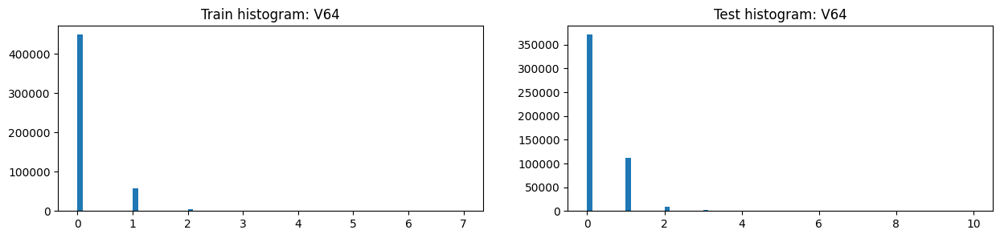

,V64,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,0.141825,0.480686,0.130817,0.279527,0.132069,0.313957
2,std,0.406157,0.664032,0.390062,0.554101,0.417240,0.576026
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
7,max,7.000000,7.000000,7.000000,10.000000,7.000000,10.000000
8,unique values,9.000000,9.000000,9.000000,12.000000,9.000000,12.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V64,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,448662,0.021301,9557,371179
1,-999.0,77096,0.058486,4509,12899
2,1.0,58547,0.097187,5690,112063
3,2.0,5145,0.139359,717,8094
4,3.0,757,0.195509,148,1467
5,6.0,144,0.027778,4,149
6,4.0,118,0.211864,25,460
7,5.0,61,0.147541,9,187
8,7.0,10,0.400000,4,12


,V64,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,448662,0.021301,9557,371179
1,1.0,58547,0.097187,5690,112063
2,-999.0,77096,0.058486,4509,12899
3,2.0,5145,0.139359,717,8094
4,3.0,757,0.195509,148,1467
5,4.0,118,0.211864,25,460
6,5.0,61,0.147541,9,187
7,6.0,144,0.027778,4,149
8,7.0,10,0.400000,4,12


,Column,Correlation with V64
0,V64,1.000000
1,V63,0.944450
2,V43,0.920388
3,V85,0.916422
4,V42,0.912230
5,V84,0.902824
362,V13,-0.387476
363,V53,-0.394248
364,V35,-0.400360
365,V54,-0.404930


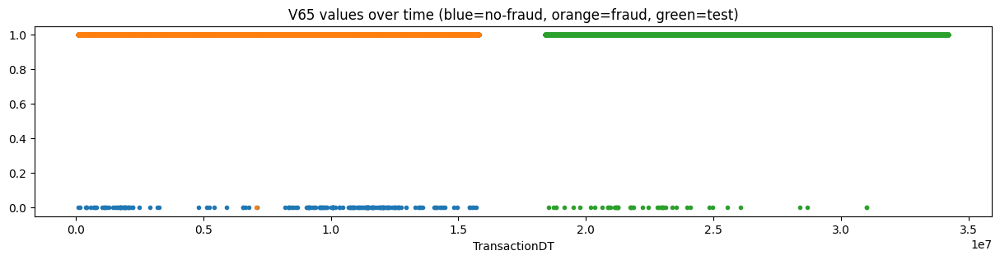

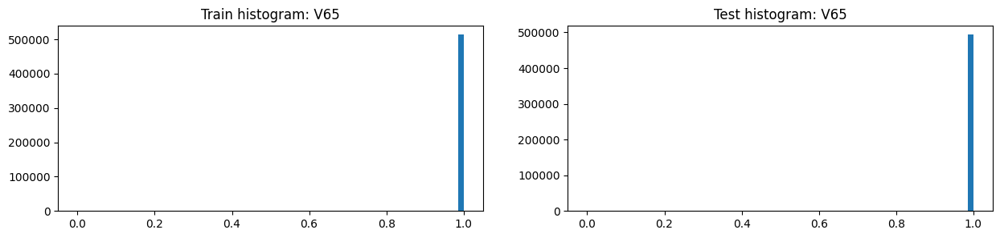

,V65,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,0.999663,0.999938,0.999654,0.999907,0.999754,0.999943
2,std,0.018353,0.007868,0.018595,0.009651,0.015684,0.007580
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
8,unique values,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V65,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,513271,0.031471,16153,493746
1,-999.0,77096,0.058486,4509,12899
2,0.0,173,0.005780,1,46


,V65,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,513271,0.031471,16153,493746
1,-999.0,77096,0.058486,4509,12899
2,0.0,173,0.005780,1,46


,Column,Correlation with V65
0,V65,1.000000
1,V41,0.891086
2,V14,0.844338
3,V88,0.794566
4,V326,0.102486
5,V46,0.101337
361,V155,-0.068624
362,V148,-0.068719
363,V154,-0.068750
364,V153,-0.069100


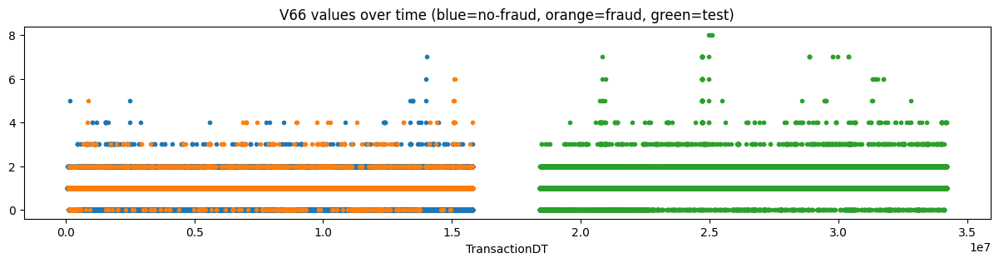

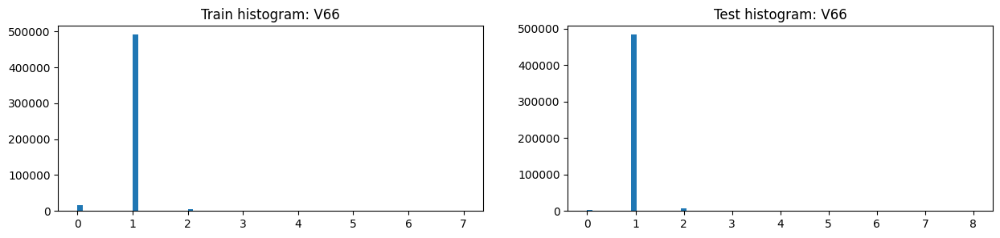

,V66,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.00000,93474.000000,400319.000000
1,mean,0.981038,1.026185,0.979571,1.01544,1.007039,1.017401
2,std,0.216235,0.363635,0.209554,0.17070,0.181799,0.167942
3,min,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000
7,max,7.000000,6.000000,7.000000,8.00000,7.000000,8.000000
8,unique values,9.000000,8.000000,9.000000,10.00000,9.000000,10.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.00000,7865.000000,5034.000000


,V66,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,490779,0.029563,14509,483557
1,-999.0,77096,0.058486,4509,12899
2,0.0,16418,0.041479,681,1828
3,2.0,5897,0.145159,856,7692
4,3.0,285,0.291228,83,523
5,4.0,50,0.400000,20,124
6,5.0,11,0.272727,3,25
7,6.0,3,0.666667,2,19
8,7.0,1,0.000000,0,21


,V66,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,490779,0.029563,14509,483557
1,-999.0,77096,0.058486,4509,12899
2,2.0,5897,0.145159,856,7692
3,0.0,16418,0.041479,681,1828
4,3.0,285,0.291228,83,523
5,4.0,50,0.400000,20,124
6,5.0,11,0.272727,3,25
7,6.0,3,0.666667,2,19
8,7.0,1,0.000000,0,21


,Column,Correlation with V66
0,V66,1.000000
1,V67,0.828164
2,V25,0.556169
3,V26,0.469765
4,V61,0.362676
5,V62,0.309893
375,V90,-0.050056
376,V49,-0.051580
377,V48,-0.052023
378,D8,-0.065071


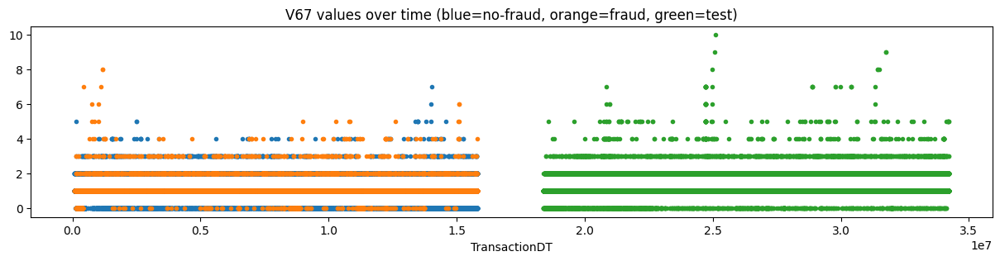

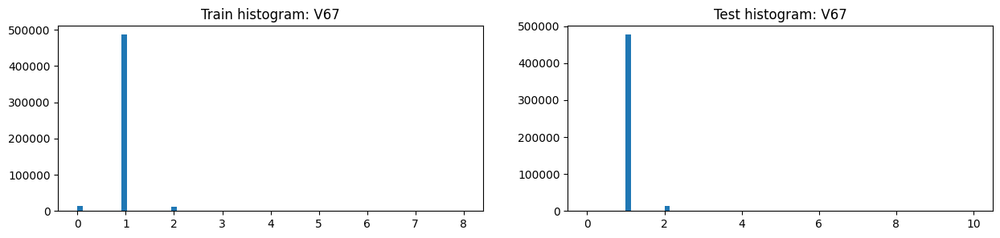

,V67,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,0.998121,1.102080,0.994744,1.031714,1.025376,1.033194
2,std,0.245912,0.484941,0.233315,0.220386,0.231832,0.217600
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,8.000000,8.000000,7.000000,10.000000,7.000000,10.000000
8,unique values,10.000000,10.000000,9.000000,12.000000,9.000000,12.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V67,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,486457,0.028220,13728,476992
1,-999.0,77096,0.058486,4509,12899
2,0.0,14565,0.040783,594,1567
3,2.0,11435,0.133013,1521,13732
4,3.0,844,0.287915,243,1215
5,4.0,112,0.446429,50,166
6,5.0,21,0.476190,10,76
7,6.0,5,0.800000,4,14
8,7.0,3,0.666667,2,22
9,8.0,2,1.000000,2,4


,V67,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,486457,0.028220,13728,476992
1,-999.0,77096,0.058486,4509,12899
2,2.0,11435,0.133013,1521,13732
3,0.0,14565,0.040783,594,1567
4,3.0,844,0.287915,243,1215
5,4.0,112,0.446429,50,166
6,5.0,21,0.476190,10,76
7,6.0,5,0.800000,4,14
8,7.0,3,0.666667,2,22
9,8.0,2,1.000000,2,4


,Column,Correlation with V67
0,V67,1.000000
1,V66,0.828164
2,V26,0.477727
3,V25,0.466775
4,V62,0.348448
5,V61,0.305829
375,V49,-0.075007
376,D8,-0.075841
377,V90,-0.078583
378,V48,-0.078884


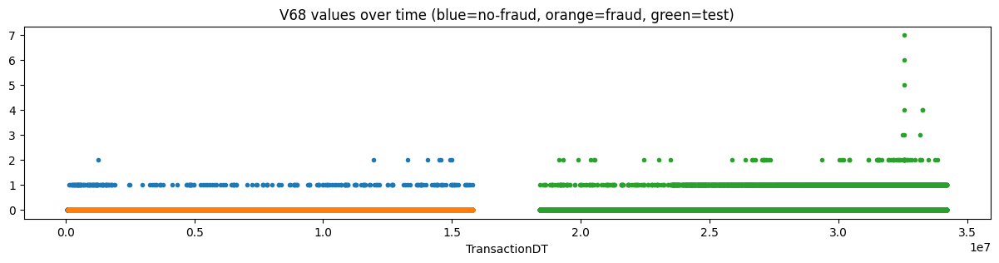

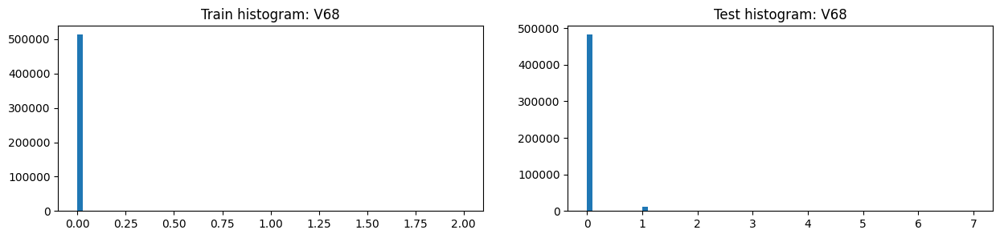

,V68,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.0000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,0.000534,0.0000,0.000551,0.023170,0.000974,0.028352
2,std,0.023760,0.0000,0.024142,0.152382,0.033181,0.168057
3,min,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
7,max,2.000000,0.0000,2.000000,7.000000,2.000000,7.000000
8,unique values,4.000000,2.0000,4.000000,9.000000,4.000000,9.000000
9,NaNs,77096.000000,4509.0000,72587.000000,12899.000000,7865.000000,5034.000000


,V68,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,513178,0.031478,16154,482453
1,-999.0,77096,0.058486,4509,12899
2,1.0,258,0.000000,0,11258
3,2.0,8,0.000000,0,72


,V68,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,513178,0.031478,16154,482453
1,-999.0,77096,0.058486,4509,12899
2,1.0,258,0.000000,0,11258
3,2.0,8,0.000000,0,72


,Column,Correlation with V68
0,V68,1.000000
1,V28,0.914602
2,V89,0.913305
3,V27,0.889336
4,C3,0.554881
5,V267,0.182594
361,V329,-0.096100
362,V328,-0.097364
363,V330,-0.099198
364,V327,-0.116910


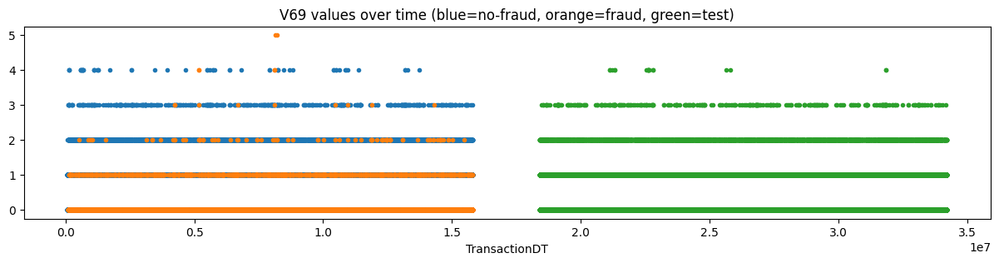

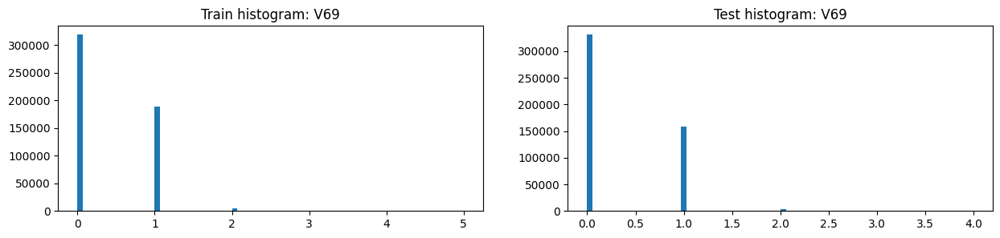

,V69,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,0.390200,0.092299,0.399877,0.339386,0.407226,0.323547
2,std,0.513696,0.321093,0.515878,0.494510,0.514653,0.488333
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
7,max,5.000000,5.000000,4.000000,4.000000,4.000000,4.000000
8,unique values,7.000000,7.000000,6.000000,6.000000,6.000000,6.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V69,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,319136,0.046331,14786,330879.0
1,1.0,188826,0.006715,1268,158570.0
2,-999.0,77096,0.058486,4509,12899.0
3,2.0,4989,0.017037,85,4031.0
4,3.0,432,0.020833,9,294.0
5,4.0,59,0.067797,4,18.0
6,5.0,2,1.000000,2,NaN


,V69,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,319136,0.046331,14786,330879.0
1,-999.0,77096,0.058486,4509,12899.0
2,1.0,188826,0.006715,1268,158570.0
3,2.0,4989,0.017037,85,4031.0
4,3.0,432,0.020833,9,294.0
5,4.0,59,0.067797,4,18.0
6,5.0,2,1.000000,2,NaN


,Column,Correlation with V69
0,V69,1.000000
1,V70,0.962134
2,V90,0.925255
3,V29,0.914609
4,V48,0.912198
5,V91,0.891153
208,V92,-0.296978
209,V94,-0.305878
210,V52,-0.309717
211,V51,-0.313297


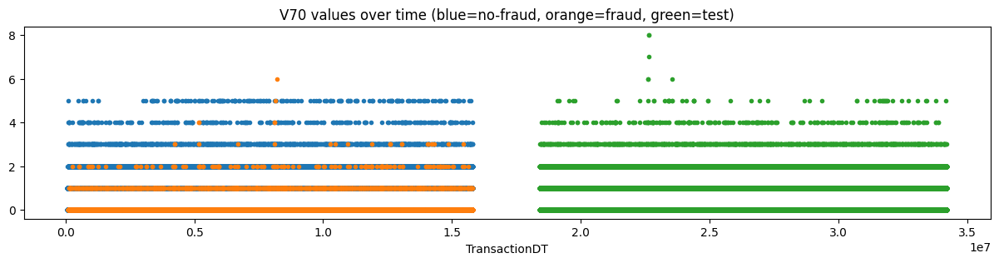

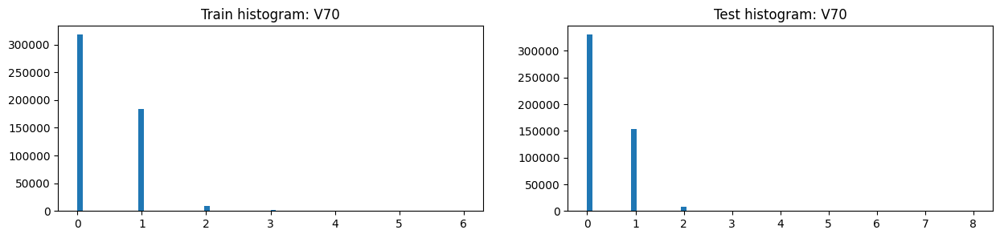

,V70,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,0.407924,0.097499,0.418008,0.353799,0.423701,0.337478
2,std,0.554499,0.344715,0.557105,0.530724,0.549443,0.524920
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
7,max,6.000000,6.000000,5.000000,8.000000,5.000000,8.000000
8,unique values,8.000000,8.000000,7.000000,10.000000,7.000000,10.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V70,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,317801,0.046507,14780,330132
1,1.0,184177,0.006559,1208,154228
2,-999.0,77096,0.058486,4509,12899
3,2.0,9739,0.014375,140,8172
4,3.0,1296,0.015432,20,982
5,4.0,253,0.015810,4,216
6,5.0,177,0.005650,1,56
7,6.0,1,1.000000,1,3


,V70,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,317801,0.046507,14780,330132
1,-999.0,77096,0.058486,4509,12899
2,1.0,184177,0.006559,1208,154228
3,2.0,9739,0.014375,140,8172
4,3.0,1296,0.015432,20,982
5,4.0,253,0.015810,4,216
6,5.0,177,0.005650,1,56
7,6.0,1,1.000000,1,3


,Column,Correlation with V70
0,V70,1.000000
1,V69,0.962134
2,V91,0.907717
3,V90,0.896647
4,V30,0.894898
5,V49,0.891002
208,V92,-0.287514
209,V94,-0.296098
210,V52,-0.300571
211,V51,-0.304120


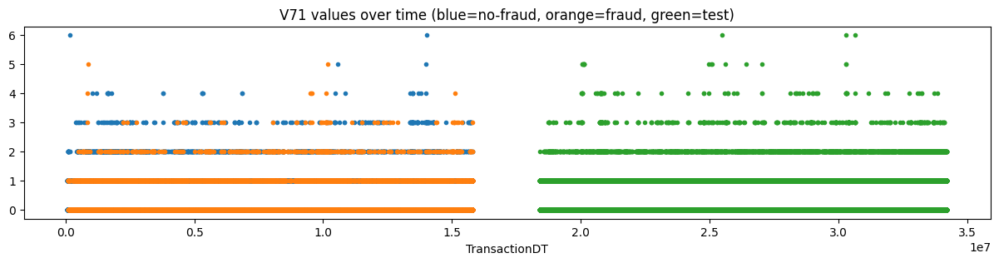

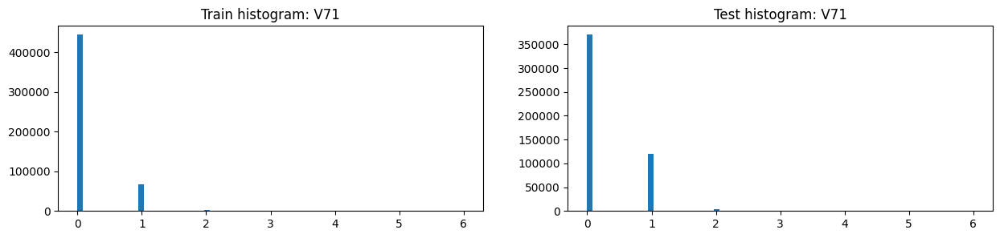

,V71,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,0.140639,0.457658,0.130340,0.258738,0.122408,0.290571
2,std,0.364303,0.575374,0.350576,0.459744,0.354751,0.475373
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
7,max,6.000000,5.000000,6.000000,6.000000,5.000000,6.000000
8,unique values,8.000000,7.000000,8.000000,8.000000,7.000000,8.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V71,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,443821,0.021065,9349,370174
1,-999.0,77096,0.058486,4509,12899
2,1.0,67435,0.093216,6286,120022
3,2.0,1837,0.250408,460,3161
4,3.0,311,0.163987,51,342
5,4.0,34,0.176471,6,75
6,5.0,4,0.500000,2,15
7,6.0,2,0.000000,0,3


,V71,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,443821,0.021065,9349,370174
1,1.0,67435,0.093216,6286,120022
2,-999.0,77096,0.058486,4509,12899
3,2.0,1837,0.250408,460,3161
4,3.0,311,0.163987,51,342
5,4.0,34,0.176471,6,75
6,5.0,4,0.500000,2,15
7,6.0,2,0.000000,0,3


,Column,Correlation with V71
0,V71,1.000000
1,V50,0.964355
2,V72,0.963819
3,V92,0.960691
4,V31,0.958732
5,V57,0.943166
362,V160,-0.472643
363,V150,-0.472907
364,addr2,-0.499160
365,V151,-0.504865


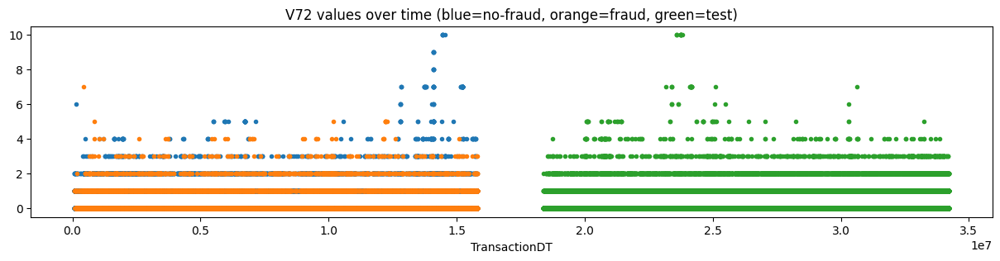

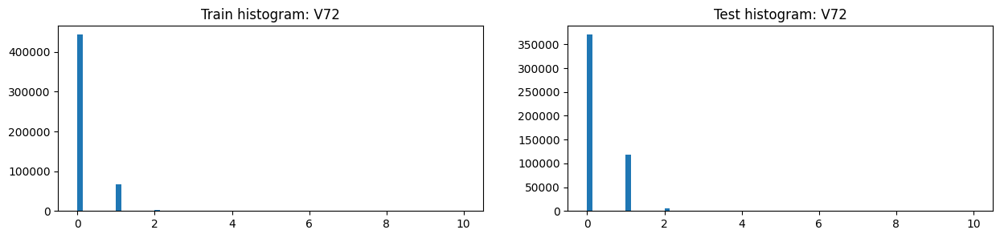

,V72,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,0.145124,0.492695,0.133833,0.264749,0.127490,0.296798
2,std,0.389212,0.649762,0.372346,0.481518,0.379355,0.496960
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
7,max,10.000000,7.000000,10.000000,10.000000,5.000000,10.000000
8,unique values,12.000000,8.000000,12.000000,10.000000,7.000000,10.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V72,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,443611,0.021009,9320,370131.0
1,-999.0,77096,0.058486,4509,12899.0
2,1.0,66364,0.089100,5913,117888.0
3,2.0,2802,0.273019,765,4879.0
4,3.0,413,0.288136,119,676.0
5,4.0,129,0.217054,28,134.0
6,5.0,54,0.148148,8,46.0
7,7.0,45,0.022222,1,19.0
8,6.0,10,0.000000,0,8.0
9,10.0,6,0.000000,0,11.0


,V72,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,443611,0.021009,9320,370131
1,1.0,66364,0.089100,5913,117888
2,-999.0,77096,0.058486,4509,12899
3,2.0,2802,0.273019,765,4879
4,3.0,413,0.288136,119,676
5,4.0,129,0.217054,28,134
6,5.0,54,0.148148,8,46
7,7.0,45,0.022222,1,19
8,6.0,10,0.000000,0,8
9,10.0,6,0.000000,0,11


,Column,Correlation with V72
0,V72,1.000000
1,V71,0.963819
2,V93,0.945832
3,V58,0.943713
4,V50,0.931573
5,V92,0.931000
362,V35,-0.428671
363,V54,-0.432390
364,V36,-0.438162
365,V152,-0.453811


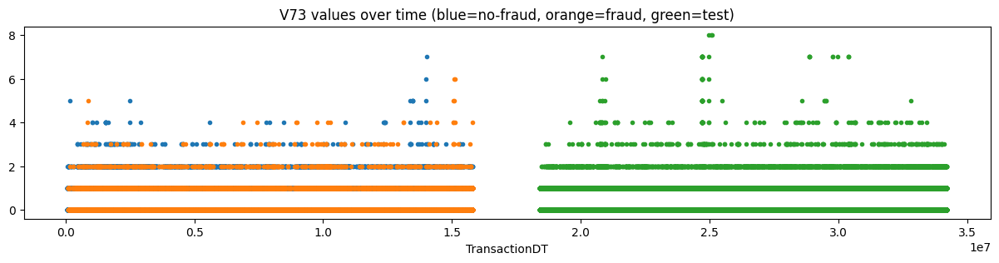

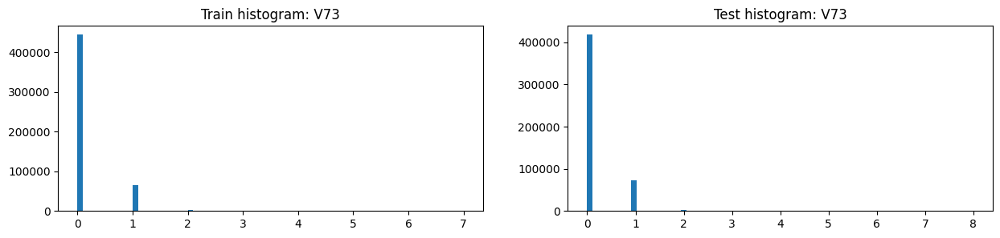

,V73,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,0.139982,0.494119,0.128478,0.162216,0.126656,0.170519
2,std,0.367098,0.605386,0.350753,0.397462,0.359843,0.405296
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,7.000000,6.000000,7.000000,8.000000,7.000000,8.000000
8,unique values,9.000000,8.000000,9.000000,10.000000,9.000000,10.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V73,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,444786,0.020124,8951,417899
1,-999.0,77096,0.058486,4509,12899
2,1.0,65814,0.099508,6549,72433
3,2.0,2551,0.218346,557,2991
4,3.0,235,0.323404,76,312
5,4.0,43,0.372093,16,98
6,5.0,11,0.272727,3,23
7,6.0,3,0.666667,2,12
8,7.0,1,0.000000,0,21


,V73,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,444786,0.020124,8951,417899
1,1.0,65814,0.099508,6549,72433
2,-999.0,77096,0.058486,4509,12899
3,2.0,2551,0.218346,557,2991
4,3.0,235,0.323404,76,312
5,4.0,43,0.372093,16,98
6,5.0,11,0.272727,3,23
7,6.0,3,0.666667,2,12
8,7.0,1,0.000000,0,21


,Column,Correlation with V73
0,V73,1.000000
1,V74,0.955264
2,V94,0.946165
3,V57,0.940898
4,V51,0.935877
5,V33,0.935625
328,V13,-0.378424
329,V54,-0.383893
330,V35,-0.401804
331,V36,-0.410823


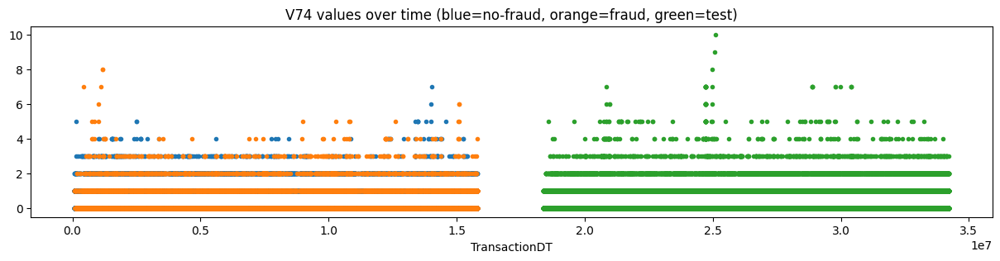

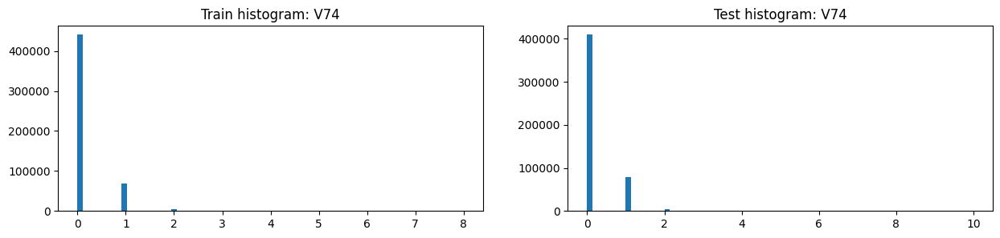

,V74,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,513444.000000,16154.000000,497290.000000,493792.000000,93474.000000,400319.000000
1,mean,0.152147,0.557818,0.138969,0.186044,0.149699,0.194530
2,std,0.393274,0.698917,0.371890,0.434991,0.402062,0.441897
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,8.000000,8.000000,7.000000,10.000000,7.000000,10.000000
8,unique values,10.000000,10.000000,9.000000,12.000000,9.000000,12.000000
9,NaNs,77096.000000,4509.000000,72587.000000,12899.000000,7865.000000,5034.000000


,V74,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,440878,0.019547,8618,409188
1,-999.0,77096,0.058486,4509,12899
2,1.0,67816,0.094373,6400,78706
3,2.0,4109,0.215381,885,4955
4,3.0,525,0.367619,193,693
5,4.0,86,0.476744,41,145
6,5.0,21,0.476190,10,68
7,6.0,4,0.750000,3,13
8,7.0,3,0.666667,2,21
9,8.0,2,1.000000,2,1


,V74,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,440878,0.019547,8618,409188
1,1.0,67816,0.094373,6400,78706
2,-999.0,77096,0.058486,4509,12899
3,2.0,4109,0.215381,885,4955
4,3.0,525,0.367619,193,693
5,4.0,86,0.476744,41,145
6,5.0,21,0.476190,10,68
7,6.0,4,0.750000,3,13
8,7.0,3,0.666667,2,21
9,8.0,2,1.000000,2,1


,Column,Correlation with V74
0,V74,1.000000
1,V73,0.955264
2,V94,0.910061
3,V51,0.905765
4,V33,0.900393
5,V57,0.900184
328,V54,-0.352602
329,V53,-0.354115
330,V35,-0.384744
331,V36,-0.387544


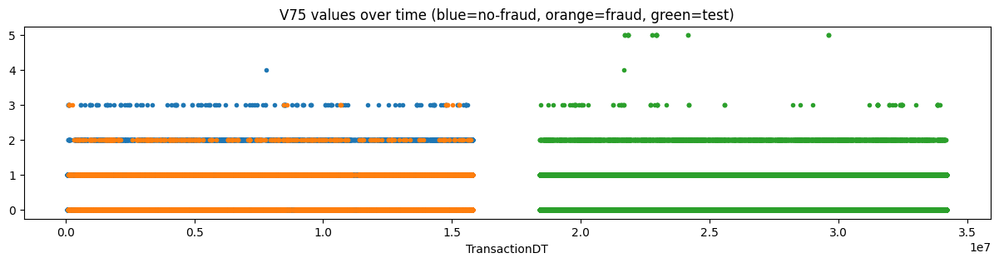

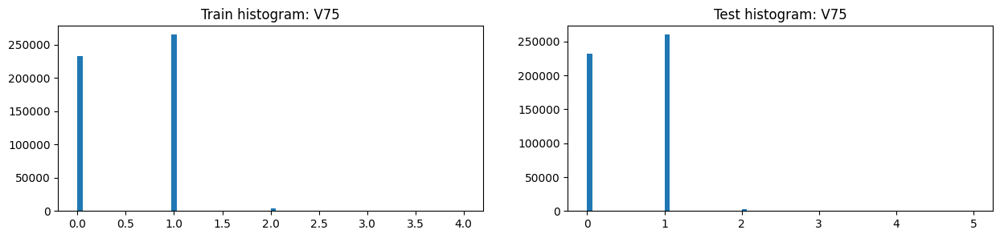

,V75,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.000000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,0.544278,0.398304,0.549210,0.538879,0.627842,0.517997
2,std,0.514318,0.545796,0.512495,0.512770,0.499932,0.513509
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,4.000000,3.000000,4.000000,5.000000,5.000000,5.000000
8,unique values,6.000000,5.000000,6.000000,7.000000,7.000000,6.000000
9,NaNs,89164.000000,4276.000000,84888.000000,12081.000000,7317.000000,4764.000000


,V75,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,265082,0.021239,5630,259969
1,0.0,232467,0.044385,10318,231432
2,-999.0,89164,0.047957,4276,12081
3,2.0,3676,0.114255,420,3106
4,3.0,150,0.126667,19,80
5,4.0,1,0.000000,0,1


,V75,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,232467,0.044385,10318,231432
1,1.0,265082,0.021239,5630,259969
2,-999.0,89164,0.047957,4276,12081
3,2.0,3676,0.114255,420,3106
4,3.0,150,0.126667,19,80
5,4.0,1,0.000000,0,1


,Column,Correlation with V75
0,V75,1.000000
1,V76,0.918449
2,V35,0.743539
3,V12,0.708756
4,V36,0.703356
5,V13,0.670498
208,V71,-0.411707
209,V42,-0.419077
210,V31,-0.420741
211,V92,-0.423442


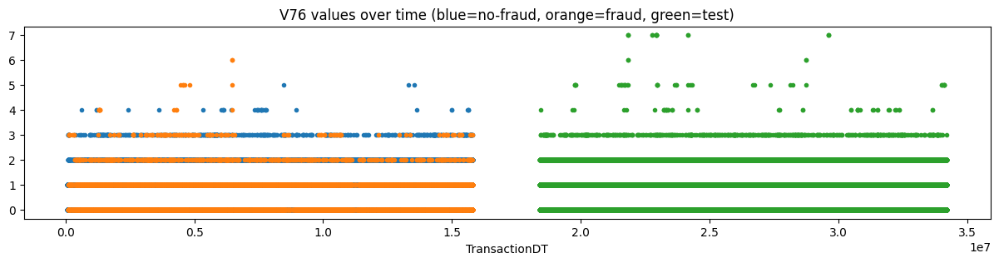

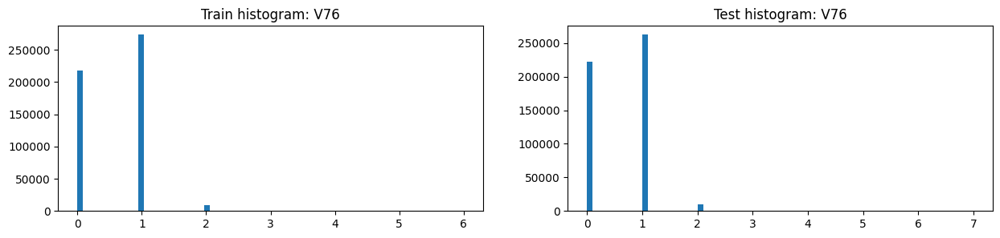

,V76,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.000000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,0.587557,0.451638,0.592150,0.573796,0.670194,0.551168
2,std,0.538230,0.624103,0.534486,0.542721,0.526512,0.543986
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,6.000000,6.000000,5.000000,7.000000,5.000000,7.000000
8,unique values,8.000000,8.000000,7.000000,9.000000,7.000000,9.000000
9,NaNs,89164.000000,4276.000000,84888.000000,12081.000000,7317.000000,4764.000000


,V76,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,273293,0.020864,5702,262516
1,0.0,217817,0.045570,9926,221908
2,-999.0,89164,0.047957,4276,12081
3,2.0,9571,0.063421,607,9466
4,3.0,641,0.207488,133,617
5,4.0,43,0.255814,11,45
6,5.0,9,0.666667,6,38
7,6.0,2,1.000000,2,4


,V76,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,217817,0.045570,9926,221908
1,1.0,273293,0.020864,5702,262516
2,-999.0,89164,0.047957,4276,12081
3,2.0,9571,0.063421,607,9466
4,3.0,641,0.207488,133,617
5,4.0,43,0.255814,11,45
6,5.0,9,0.666667,6,38
7,6.0,2,1.000000,2,4


,Column,Correlation with V76
0,V76,1.000000
1,V75,0.918449
2,V36,0.746569
3,V13,0.719616
4,V35,0.704597
5,V12,0.671624
208,V71,-0.424893
209,V42,-0.430981
210,V31,-0.434187
211,V92,-0.436803


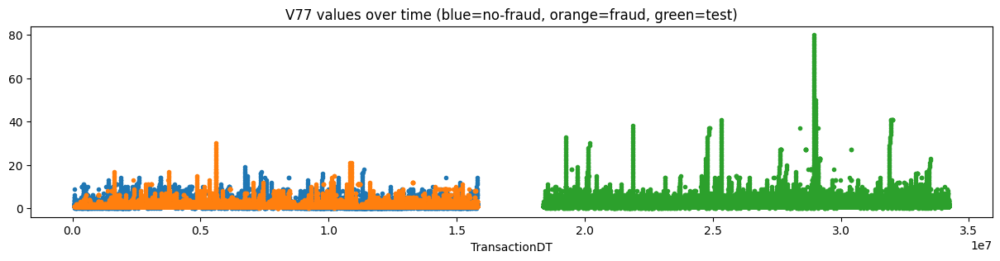

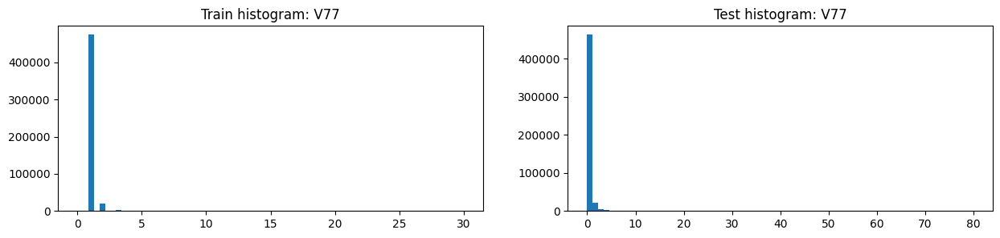

,V77,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.000000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,1.086893,1.546104,1.071377,1.123978,1.105911,1.128219
2,std,0.532958,1.677384,0.437279,1.020732,0.717580,1.079576
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,30.000000,30.000000,19.000000,80.000000,33.000000,80.000000
8,unique values,32.000000,32.000000,21.000000,82.000000,35.000000,82.000000
9,NaNs,89164.000000,4276.000000,84888.000000,12081.000000,7317.000000,4764.000000


,V77,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,474434,0.027321,12962,463392
1,-999.0,89164,0.047957,4276,12081
2,2.0,18955,0.089633,1699,22014
3,3.0,3695,0.169689,627,4221
4,4.0,1623,0.243993,396,1914
5,5.0,742,0.247978,184,855
6,0.0,571,0.019264,11,205
7,6.0,415,0.303614,126,584
8,7.0,297,0.370370,110,314
9,8.0,183,0.333333,61,242


,V77,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,474434,0.027321,12962,463392
1,-999.0,89164,0.047957,4276,12081
2,2.0,18955,0.089633,1699,22014
3,3.0,3695,0.169689,627,4221
4,4.0,1623,0.243993,396,1914
5,5.0,742,0.247978,184,855
6,6.0,415,0.303614,126,584
7,7.0,297,0.370370,110,314
8,9.0,157,0.420382,66,137
9,8.0,183,0.333333,61,242


,Column,Correlation with V77
0,V77,1.000000
1,V78,0.752716
2,V37,0.688616
3,V38,0.636275
4,V228,0.615251
5,V86,0.589516
375,V36,-0.114821
376,V12,-0.115449
377,V13,-0.118758
378,D8,-0.129262


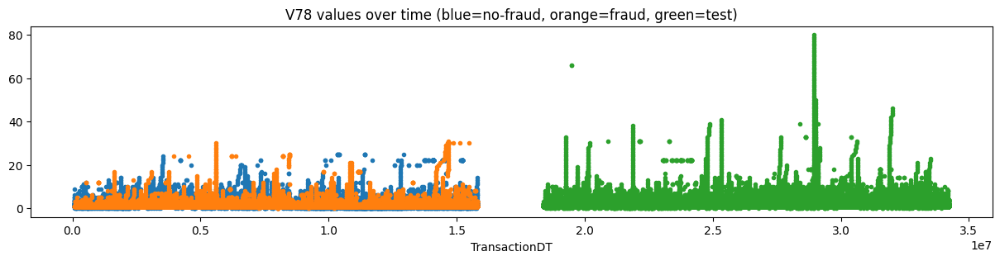

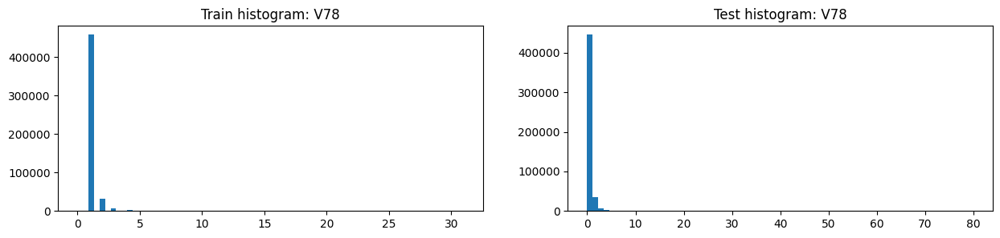

,V78,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.000000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,1.144462,1.783975,1.122854,1.191442,1.165185,1.197604
2,std,0.781474,2.366350,0.654110,1.167254,0.864204,1.227508
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,31.000000,31.000000,25.000000,80.000000,66.000000,80.000000
8,unique values,33.000000,33.000000,27.000000,82.000000,36.000000,82.000000
9,NaNs,89164.000000,4276.000000,84888.000000,12081.000000,7317.000000,4764.000000


,V78,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,457915,0.026145,11972,445500
1,-999.0,89164,0.047957,4276,12081
2,2.0,31364,0.068199,2139,34375
3,3.0,6135,0.143439,880,7032
4,4.0,2261,0.204334,462,2938
5,5.0,1125,0.232889,262,1431
6,6.0,609,0.270936,165,886
7,0.0,571,0.019264,11,202
8,7.0,353,0.303116,107,463
9,8.0,211,0.327014,69,402


,V78,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,457915,0.026145,11972,445500
1,-999.0,89164,0.047957,4276,12081
2,2.0,31364,0.068199,2139,34375
3,3.0,6135,0.143439,880,7032
4,4.0,2261,0.204334,462,2938
5,5.0,1125,0.232889,262,1431
6,6.0,609,0.270936,165,886
7,7.0,353,0.303116,107,463
8,8.0,211,0.327014,69,402
9,9.0,157,0.312102,49,298


,Column,Correlation with V78
0,V78,1.000000
1,V77,0.752716
2,V38,0.633121
3,V56,0.587449
4,V37,0.537413
5,V87,0.535899
375,V13,-0.105462
376,V53,-0.105782
377,D8,-0.128558
378,D2,-0.128967


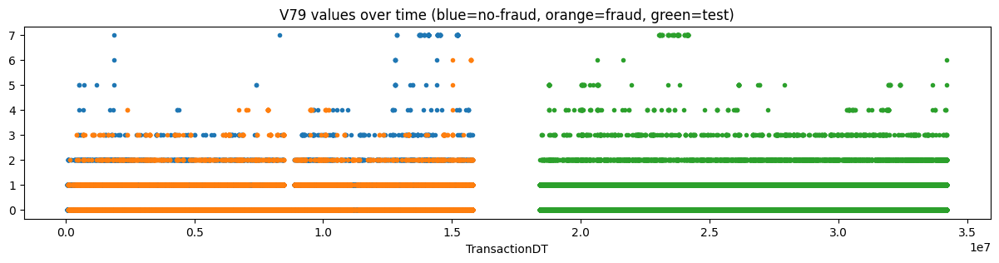

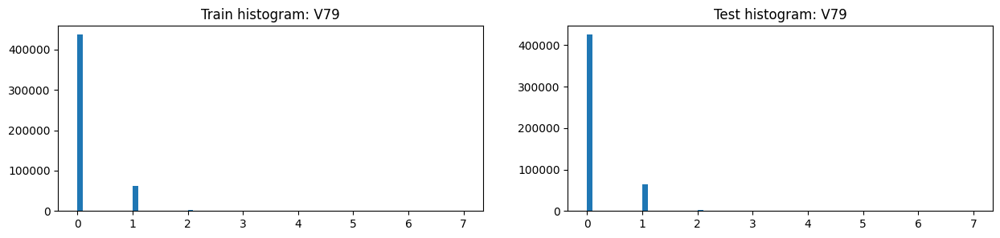

,V79,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.000000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,0.136867,0.538109,0.123310,0.150820,0.115399,0.159133
2,std,0.379904,0.667046,0.358534,0.399481,0.366889,0.406306
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,7.000000,6.000000,7.000000,7.000000,6.000000,7.000000
8,unique values,9.000000,8.000000,9.000000,9.000000,8.000000,9.000000
9,NaNs,89164.000000,4276.000000,84888.000000,12081.000000,7317.000000,4764.000000


,V79,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,436802,0.020149,8801,425386
1,-999.0,89164,0.047957,4276,12081
2,1.0,61751,0.107739,6653,65288
3,2.0,2179,0.316659,690,3020
4,3.0,435,0.464368,202,662
5,7.0,109,0.000000,0,64
6,4.0,68,0.485294,33,118
7,5.0,19,0.052632,1,69
8,6.0,13,0.538462,7,3


,V79,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,436802,0.020149,8801,425386
1,1.0,61751,0.107739,6653,65288
2,-999.0,89164,0.047957,4276,12081
3,2.0,2179,0.316659,690,3020
4,3.0,435,0.464368,202,662
5,4.0,68,0.485294,33,118
6,6.0,13,0.538462,7,3
7,5.0,19,0.052632,1,69
8,7.0,109,0.000000,0,64


,Column,Correlation with V79
0,V79,1.000000
1,V58,0.947932
2,V15,0.928438
3,V57,0.926381
4,V93,0.924026
5,V16,0.909113
315,V53,-0.415449
316,V35,-0.418987
317,V54,-0.426989
318,V36,-0.428184


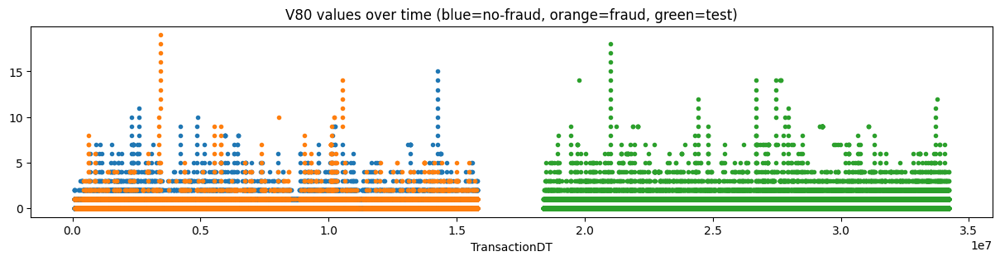

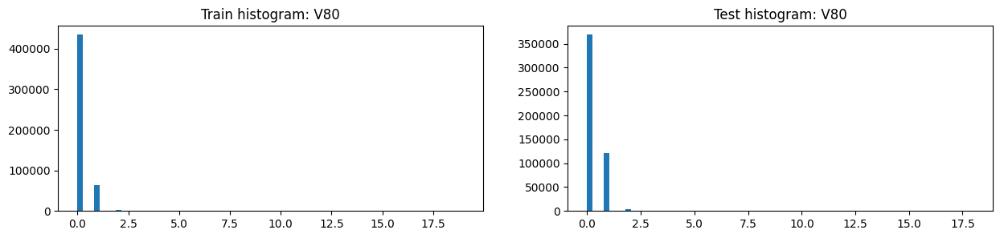

,V80,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.000000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,0.143954,0.546043,0.130368,0.270427,0.130959,0.303161
2,std,0.409932,0.865550,0.377840,0.508879,0.426872,0.520895
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
7,max,19.000000,19.000000,15.000000,18.000000,18.000000,14.000000
8,unique values,21.000000,21.000000,17.000000,20.000000,20.000000,16.000000
9,NaNs,89164.000000,4276.000000,84888.000000,12081.000000,7317.000000,4764.000000


,V80,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,434732,0.020751,9021,368894.0
1,-999.0,89164,0.047957,4276,12081.0
2,1.0,63368,0.103901,6584,120578.0
3,2.0,2283,0.215506,492,3797.0
4,3.0,475,0.235789,112,731.0
5,4.0,245,0.322449,79,281.0
6,5.0,112,0.330357,37,116.0
7,6.0,52,0.307692,16,69.0
8,7.0,48,0.354167,17,58.0
9,8.0,20,0.300000,6,18.0


,V80,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,434732,0.020751,9021,368894
1,1.0,63368,0.103901,6584,120578
2,-999.0,89164,0.047957,4276,12081
3,2.0,2283,0.215506,492,3797
4,3.0,475,0.235789,112,731
5,4.0,245,0.322449,79,281
6,5.0,112,0.330357,37,116
7,7.0,48,0.354167,17,58
8,6.0,52,0.307692,16,69
9,8.0,20,0.300000,6,18


,Column,Correlation with V80
0,V80,1.000000
1,V81,0.953223
2,V17,0.903466
3,V39,0.902400
4,V59,0.901617
5,V84,0.896386
362,V53,-0.388425
363,V13,-0.389988
364,V35,-0.391247
365,V54,-0.399214


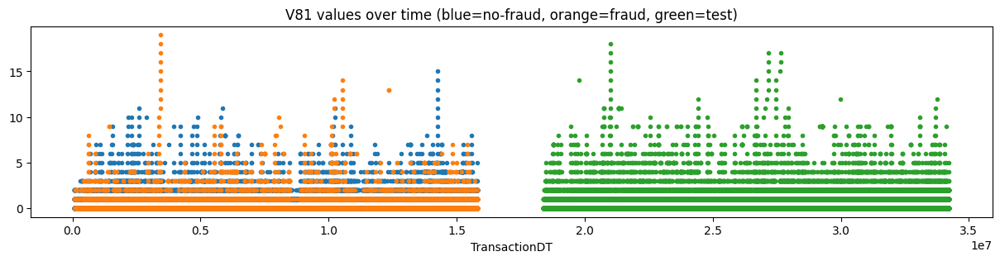

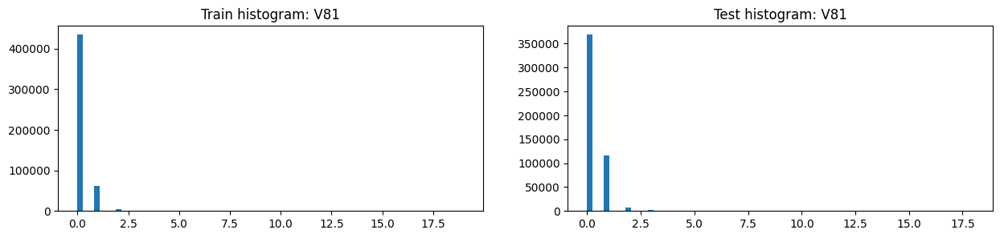

,V81,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.000000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,0.152696,0.601452,0.137533,0.285409,0.144413,0.318501
2,std,0.452298,0.976099,0.415043,0.568899,0.504404,0.578041
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
7,max,19.000000,19.000000,15.000000,18.000000,18.000000,17.000000
8,unique values,21.000000,21.000000,17.000000,20.000000,20.000000,19.000000
9,NaNs,89164.000000,4276.000000,84888.000000,12081.000000,7317.000000,4764.000000


,V81,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,434653,0.020702,8998,368726.0
1,-999.0,89164,0.047957,4276,12081.0
2,1.0,60829,0.100610,6120,116427.0
3,2.0,4033,0.189933,766,6846.0
4,3.0,902,0.268293,242,1313.0
5,4.0,509,0.245580,125,600.0
6,5.0,191,0.225131,43,270.0
7,6.0,106,0.339623,36,145.0
8,7.0,68,0.308824,21,98.0
9,8.0,29,0.275862,8,48.0


,V81,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,434653,0.020702,8998,368726
1,1.0,60829,0.100610,6120,116427
2,-999.0,89164,0.047957,4276,12081
3,2.0,4033,0.189933,766,6846
4,3.0,902,0.268293,242,1313
5,4.0,509,0.245580,125,600
6,5.0,191,0.225131,43,270
7,6.0,106,0.339623,36,145
8,7.0,68,0.308824,21,98
9,9.0,20,0.400000,8,79


,Column,Correlation with V81
0,V81,1.000000
1,V80,0.953223
2,V60,0.879026
3,V40,0.876484
4,V85,0.875131
5,V17,0.873443
362,V53,-0.373756
363,V13,-0.374584
364,V35,-0.376165
365,V54,-0.384137


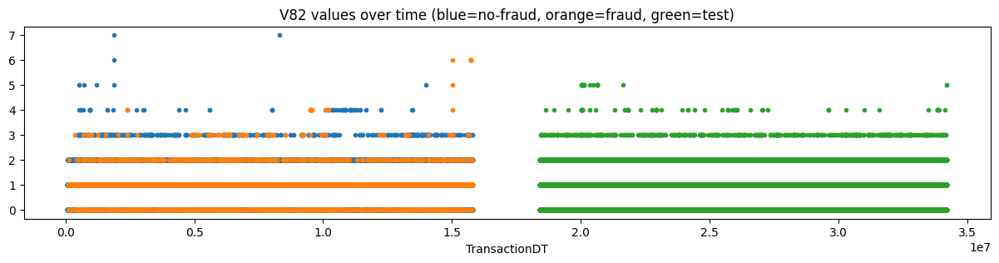

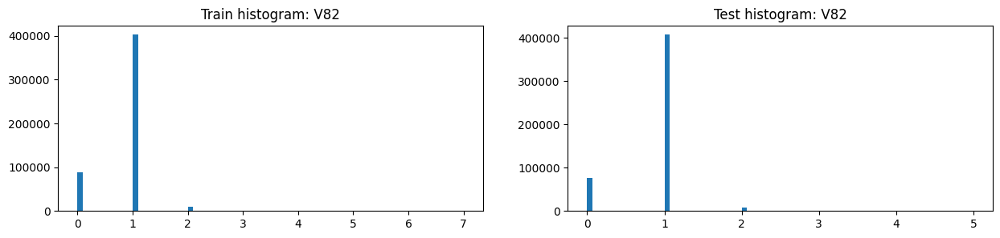

,V82,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.000000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,0.844610,0.962104,0.840640,0.864429,0.841420,0.869829
2,std,0.422529,0.490821,0.419453,0.403460,0.431988,0.396273
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,7.000000,6.000000,7.000000,5.000000,5.000000,5.000000
8,unique values,9.000000,8.000000,9.000000,7.000000,7.000000,7.000000
9,NaNs,89164.000000,4276.000000,84888.000000,12081.000000,7317.000000,4764.000000


,V82,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,402612,0.032736,13180,407790.0
1,-999.0,89164,0.047957,4276,12081.0
2,0.0,88757,0.022759,2020,77355.0
3,2.0,9288,0.109496,1017,8745.0
4,3.0,626,0.228435,143,629.0
5,4.0,76,0.250000,19,67.0
6,6.0,8,0.875000,7,NaN
7,5.0,7,0.142857,1,24.0
8,7.0,2,0.000000,0,NaN


,V82,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,402612,0.032736,13180,407790.0
1,-999.0,89164,0.047957,4276,12081.0
2,0.0,88757,0.022759,2020,77355.0
3,2.0,9288,0.109496,1017,8745.0
4,3.0,626,0.228435,143,629.0
5,4.0,76,0.250000,19,67.0
6,6.0,8,0.875000,7,NaN
7,5.0,7,0.142857,1,24.0
8,7.0,2,0.000000,0,NaN


,Column,Correlation with V82
0,V82,1.000000
1,V83,0.881632
2,V19,0.722277
3,V61,0.697912
4,V4,0.683717
5,V20,0.661167
375,V329,-0.177024
376,V224,-0.184503
377,D6,-0.227429
378,V327,-0.381177


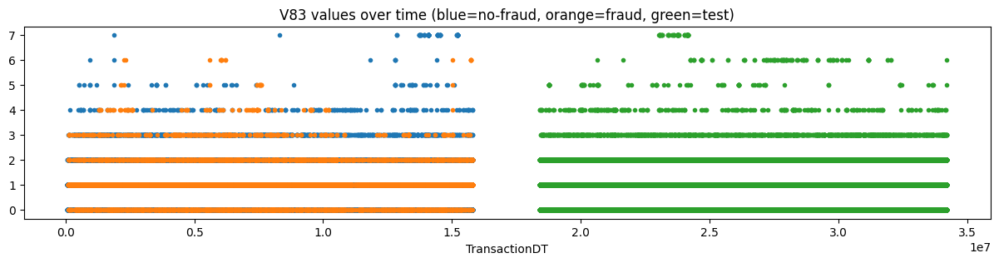

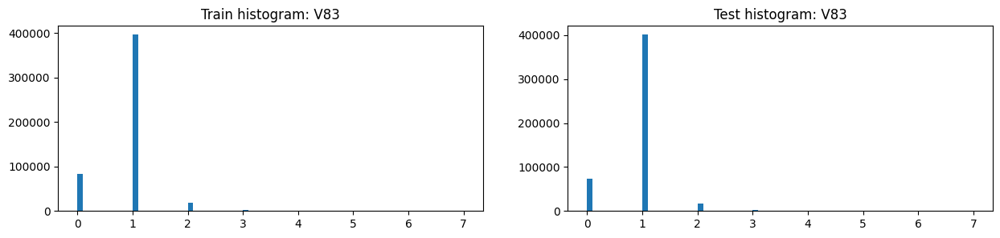

,V83,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.000000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,0.881965,1.059071,0.875981,0.896656,0.876486,0.901390
2,std,0.470757,0.621182,0.463645,0.454836,0.477224,0.449288
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,7.000000,6.000000,7.000000,7.000000,6.000000,7.000000
8,unique values,9.000000,8.000000,9.000000,9.000000,8.000000,9.000000
9,NaNs,89164.000000,4276.000000,84888.000000,12081.000000,7317.000000,4764.000000


,V83,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,396619,0.031857,12635,400827
1,-999.0,89164,0.047957,4276,12081
2,0.0,83605,0.020920,1749,74121
3,2.0,18834,0.077785,1465,17393
4,3.0,1816,0.226872,412,1709
5,4.0,292,0.318493,93,286
6,7.0,109,0.000000,0,64
7,5.0,76,0.210526,16,97
8,6.0,25,0.680000,17,113


,V83,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,396619,0.031857,12635,400827
1,-999.0,89164,0.047957,4276,12081
2,0.0,83605,0.020920,1749,74121
3,2.0,18834,0.077785,1465,17393
4,3.0,1816,0.226872,412,1709
5,4.0,292,0.318493,93,286
6,6.0,25,0.680000,17,113
7,5.0,76,0.210526,16,97
8,7.0,109,0.000000,0,64


,Column,Correlation with V83
0,V83,1.000000
1,V82,0.881632
2,V62,0.683948
3,V20,0.674453
4,V5,0.658500
5,V19,0.644119
375,D8,-0.151826
376,V329,-0.175486
377,D6,-0.175946
378,V327,-0.375414


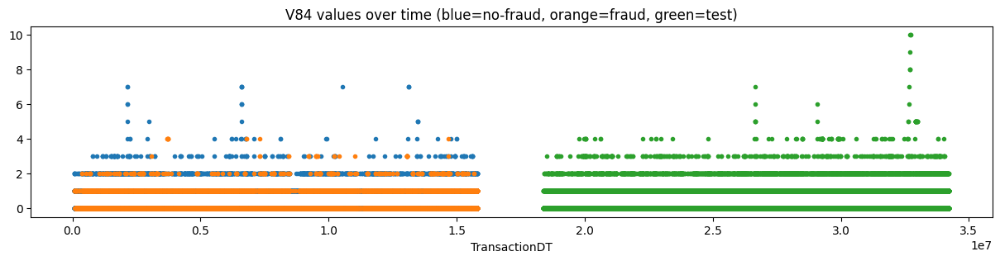

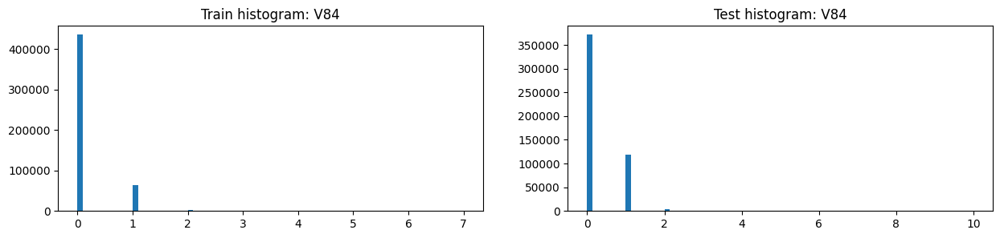

,V84,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.000000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,0.137145,0.470068,0.125896,0.258139,0.121206,0.290278
2,std,0.361875,0.554162,0.348039,0.463071,0.349349,0.480298
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
7,max,7.000000,4.000000,7.000000,10.000000,4.000000,10.000000
8,unique values,9.000000,6.000000,9.000000,12.000000,6.000000,12.000000
9,NaNs,89164.000000,4276.000000,84888.000000,12081.000000,7317.000000,4764.000000


,V84,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,435246,0.020910,9101,371522
1,-999.0,89164,0.047957,4276,12081
2,1.0,63848,0.108335,6917,119235
3,2.0,2035,0.162654,331,3307
4,3.0,191,0.146597,28,426
5,4.0,35,0.285714,10,84
6,7.0,10,0.000000,0,2
7,5.0,6,0.000000,0,24
8,6.0,5,0.000000,0,3


,V84,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,435246,0.020910,9101,371522
1,1.0,63848,0.108335,6917,119235
2,-999.0,89164,0.047957,4276,12081
3,2.0,2035,0.162654,331,3307
4,3.0,191,0.146597,28,426
5,4.0,35,0.285714,10,84
6,7.0,10,0.000000,0,2
7,5.0,6,0.000000,0,24
8,6.0,5,0.000000,0,3


,Column,Correlation with V84
0,V84,1.000000
1,V42,0.957588
2,V63,0.955156
3,V21,0.955048
4,V85,0.937156
5,V22,0.916949
362,V53,-0.420387
363,V13,-0.422154
364,V35,-0.425216
365,V54,-0.432063


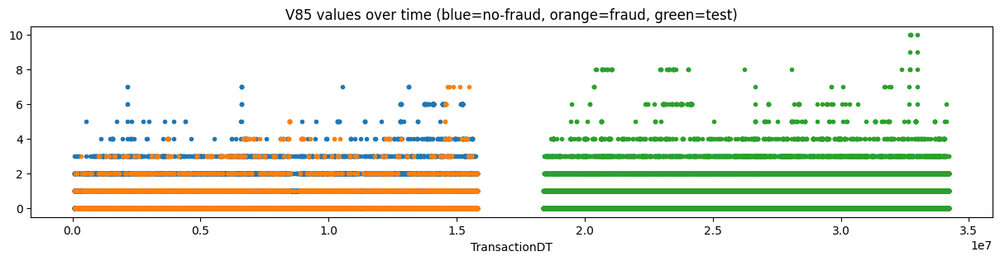

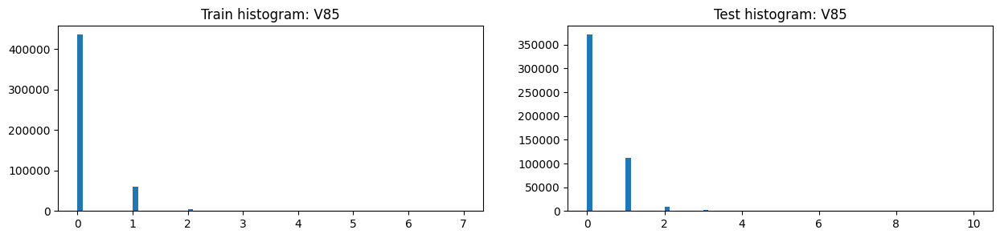

,V85,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.000000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,0.149788,0.535058,0.136770,0.279501,0.138446,0.312607
2,std,0.419445,0.707608,0.399721,0.535078,0.434581,0.550831
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
7,max,7.000000,7.000000,7.000000,10.000000,8.000000,10.000000
8,unique values,9.000000,9.000000,9.000000,12.000000,10.000000,12.000000
9,NaNs,89164.000000,4276.000000,84888.000000,12081.000000,7317.000000,4764.000000


,V85,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,435103,0.020862,9077,371150
1,-999.0,89164,0.047957,4276,12081
2,1.0,59565,0.105381,6277,112615
3,2.0,5322,0.138106,735,8175
4,3.0,987,0.207700,205,1937
5,4.0,216,0.342593,74,481
6,6.0,121,0.041322,5,104
7,5.0,47,0.191489,9,87
8,7.0,15,0.333333,5,13


,V85,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,435103,0.020862,9077,371150
1,1.0,59565,0.105381,6277,112615
2,-999.0,89164,0.047957,4276,12081
3,2.0,5322,0.138106,735,8175
4,3.0,987,0.207700,205,1937
5,4.0,216,0.342593,74,481
6,5.0,47,0.191489,9,87
7,6.0,121,0.041322,5,104
8,7.0,15,0.333333,5,13


,Column,Correlation with V85
0,V85,1.000000
1,V84,0.937156
2,V64,0.916422
3,V43,0.915452
4,V42,0.903436
5,V63,0.900024
362,V53,-0.396197
363,V13,-0.397457
364,V35,-0.401391
365,V54,-0.407201


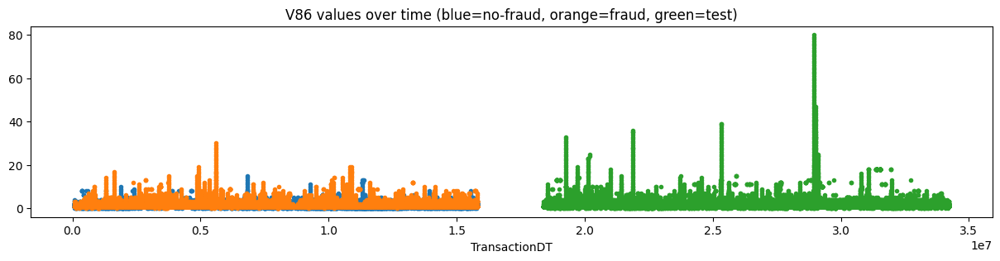

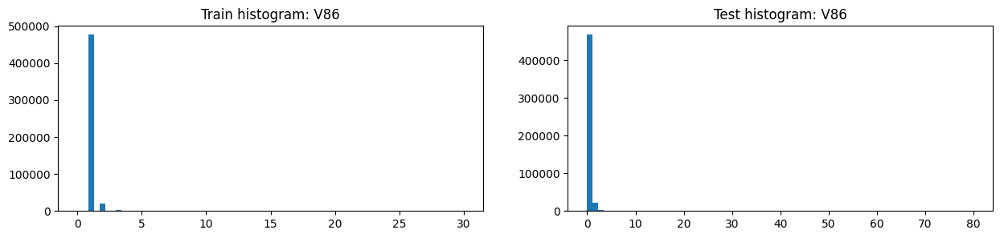

,V86,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.000000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,1.064885,1.640020,1.045453,1.092463,1.094457,1.091995
2,std,0.419807,1.737494,0.261994,0.896628,0.683657,0.939644
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,30.000000,30.000000,15.000000,80.000000,33.000000,80.000000
8,unique values,32.000000,32.000000,17.000000,82.000000,35.000000,82.000000
9,NaNs,89164.000000,4276.000000,84888.000000,12081.000000,7317.000000,4764.000000


,V86,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,476911,0.025766,12288,467922
1,-999.0,89164,0.047957,4276,12081
2,2.0,19527,0.095355,1862,21070
3,3.0,2428,0.358320,870,2684
4,4.0,743,0.675639,502,1112
5,0.0,727,0.070151,51,338
6,5.0,355,0.678873,241,317
7,6.0,217,0.764977,166,255
8,7.0,128,0.929688,119,129
9,8.0,86,0.697674,60,94


,V86,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,476911,0.025766,12288,467922
1,-999.0,89164,0.047957,4276,12081
2,2.0,19527,0.095355,1862,21070
3,3.0,2428,0.358320,870,2684
4,4.0,743,0.675639,502,1112
5,5.0,355,0.678873,241,317
6,6.0,217,0.764977,166,255
7,7.0,128,0.929688,119,129
8,9.0,79,0.936709,74,75
9,8.0,86,0.697674,60,94


,Column,Correlation with V86
0,V86,1.000000
1,V87,0.849442
2,V257,0.661346
3,V246,0.635958
4,V44,0.627641
5,V45,0.607564
375,V53,-0.078161
376,V54,-0.080616
377,D8,-0.109106
378,V326,-0.113469


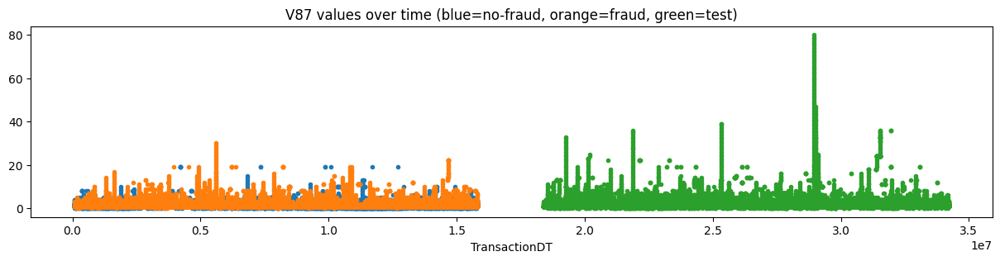

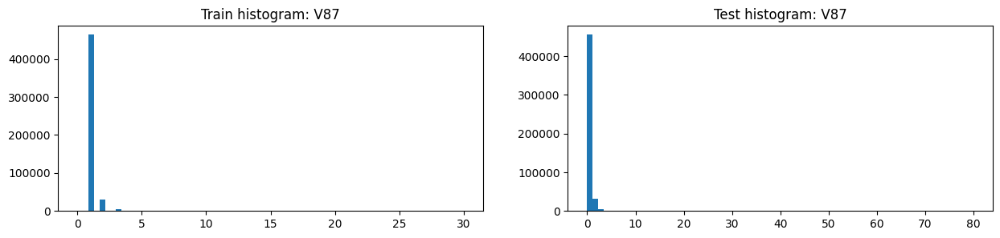

,V87,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.000000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,1.099456,1.799658,1.075798,1.131732,1.134298,1.131129
2,std,0.511281,2.020390,0.339411,0.989353,0.747773,1.037937
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,30.000000,30.000000,19.000000,80.000000,33.000000,80.000000
8,unique values,32.000000,32.000000,18.000000,82.000000,35.000000,82.000000
9,NaNs,89164.000000,4276.000000,84888.000000,12081.000000,7317.000000,4764.000000


,V87,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,463708,0.024893,11543,455162
1,-999.0,89164,0.047957,4276,12081
2,2.0,30832,0.072490,2235,31444
3,3.0,3761,0.248338,934,4209
4,4.0,1033,0.620523,641,1299
5,0.0,694,0.053314,37,328
6,5.0,480,0.585417,281,482
7,6.0,205,0.741463,152,349
8,7.0,148,0.905405,134,338
9,8.0,147,0.795918,117,170


,V87,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,463708,0.024893,11543,455162
1,-999.0,89164,0.047957,4276,12081
2,2.0,30832,0.072490,2235,31444
3,3.0,3761,0.248338,934,4209
4,4.0,1033,0.620523,641,1299
5,5.0,480,0.585417,281,482
6,6.0,205,0.741463,152,349
7,7.0,148,0.905405,134,338
8,8.0,147,0.795918,117,170
9,9.0,75,0.906667,68,95


,Column,Correlation with V87
0,V87,1.000000
1,V86,0.849442
2,V45,0.634342
3,V257,0.601958
4,V246,0.586705
5,V199,0.538906
375,V29,-0.073366
376,V69,-0.073509
377,V326,-0.090243
378,D8,-0.109901


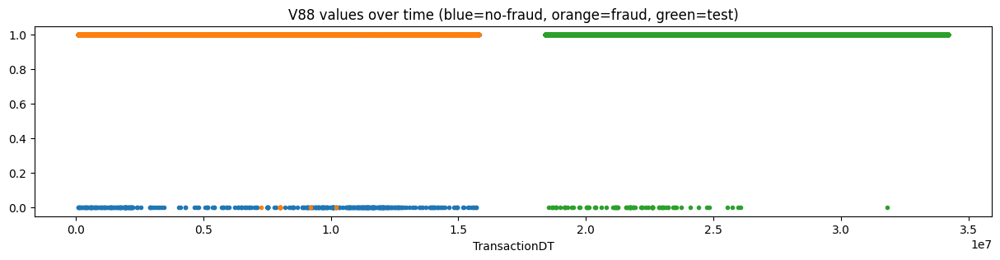

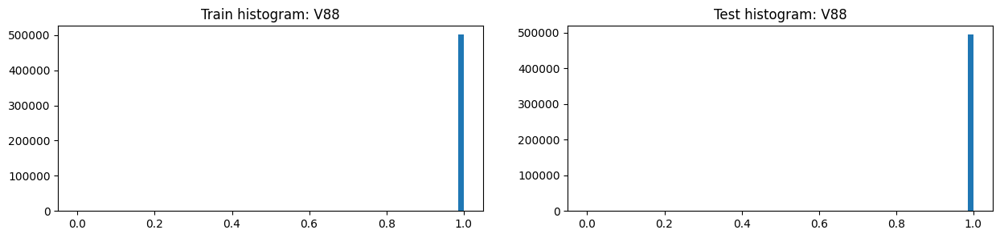

,V88,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.000000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,0.999246,0.999329,0.999243,0.999830,0.999521,0.999903
2,std,0.027447,0.025901,0.027498,0.013031,0.021872,0.009866
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
8,unique values,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000
9,NaNs,89164.000000,4276.000000,84888.000000,12081.000000,7317.000000,4764.000000


,V88,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,500998,0.032687,16376,494526
1,-999.0,89164,0.047957,4276,12081
2,0.0,378,0.029101,11,84


,V88,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,500998,0.032687,16376,494526
1,-999.0,89164,0.047957,4276,12081
2,0.0,378,0.029101,11,84


,Column,Correlation with V88
0,V88,1.000000
1,V41,0.942586
2,V14,0.834647
3,V65,0.794566
4,V1,0.547708
5,V46,0.143880
375,V153,-0.051329
376,V302,-0.053432
377,D8,-0.055283
378,D6,-0.055864


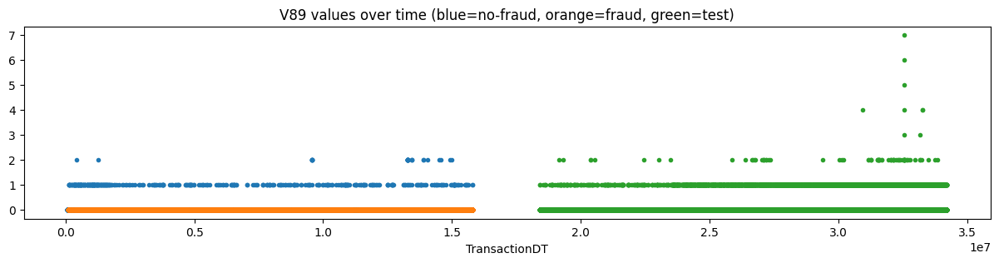

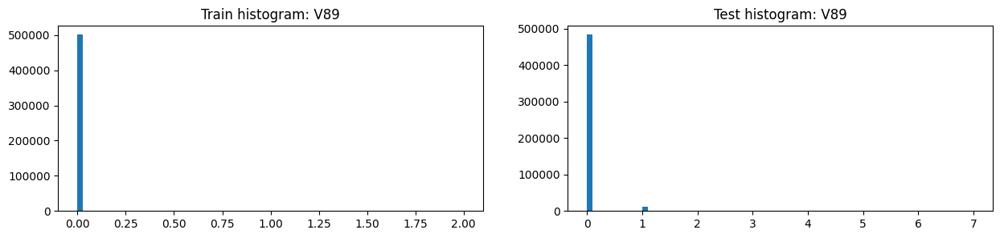

,V89,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.0000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,0.000902,0.0000,0.000932,0.022771,0.001266,0.027819
2,std,0.031943,0.0000,0.032478,0.151194,0.037019,0.166641
3,min,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
7,max,2.000000,0.0000,2.000000,7.000000,2.000000,7.000000
8,unique values,4.000000,2.0000,4.000000,9.000000,4.000000,9.000000
9,NaNs,89164.000000,4276.0000,84888.000000,12081.000000,7317.000000,4764.000000


,V89,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,500954,0.032712,16387,483452
1,-999.0,89164,0.047957,4276,12081
2,1.0,392,0.000000,0,11075
3,2.0,30,0.000000,0,74


,V89,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,500954,0.032712,16387,483452
1,-999.0,89164,0.047957,4276,12081
2,1.0,392,0.000000,0,11075
3,2.0,30,0.000000,0,74


,Column,Correlation with V89
0,V89,1.000000
1,V28,0.968086
2,V27,0.935332
3,V68,0.913305
4,C3,0.592326
5,V264,0.211481
360,V19,-0.048405
361,V83,-0.051946
362,V82,-0.055381
363,V327,-0.062781


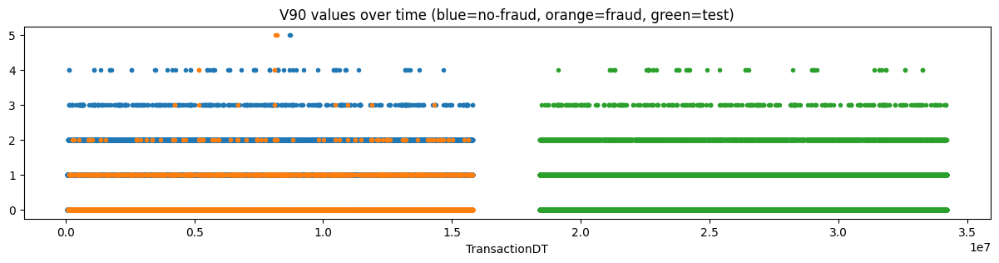

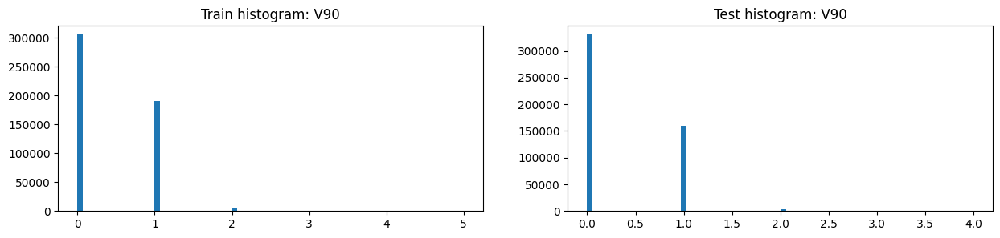

,V90,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.000000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,0.401862,0.092512,0.412315,0.340953,0.412669,0.324123
2,std,0.516153,0.322831,0.518220,0.494283,0.516688,0.487351
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
7,max,5.000000,5.000000,5.000000,4.000000,4.000000,4.000000
8,unique values,7.000000,7.000000,7.000000,6.000000,6.000000,6.000000
9,NaNs,89164.000000,4276.000000,84888.000000,12081.000000,7317.000000,4764.000000


,V90,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,305817,0.049062,15004,330402.0
1,1.0,190162,0.006694,1273,160149.0
2,-999.0,89164,0.047957,4276,12081.0
3,2.0,4941,0.019227,95,3734.0
4,3.0,388,0.023196,9,278.0
5,4.0,64,0.062500,4,47.0
6,5.0,4,0.500000,2,NaN


,V90,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,305817,0.049062,15004,330402.0
1,-999.0,89164,0.047957,4276,12081.0
2,1.0,190162,0.006694,1273,160149.0
3,2.0,4941,0.019227,95,3734.0
4,3.0,388,0.023196,9,278.0
5,4.0,64,0.062500,4,47.0
6,5.0,4,0.500000,2,NaN


,Column,Correlation with V90
0,V90,1.000000
1,V91,0.959692
2,V48,0.944901
3,V29,0.932192
4,V69,0.925255
5,V49,0.917756
208,V34,-0.310988
209,V92,-0.311532
210,V52,-0.313828
211,V51,-0.318642


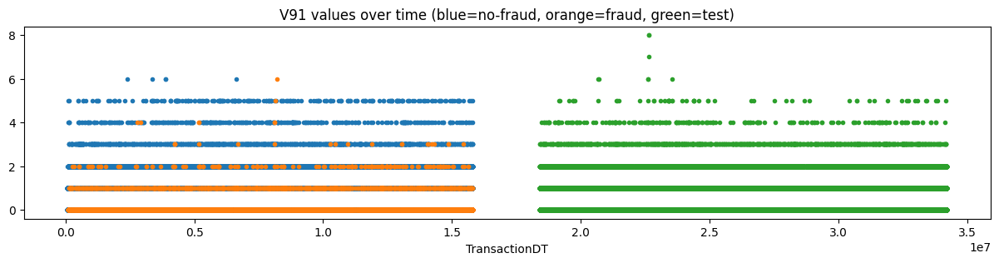

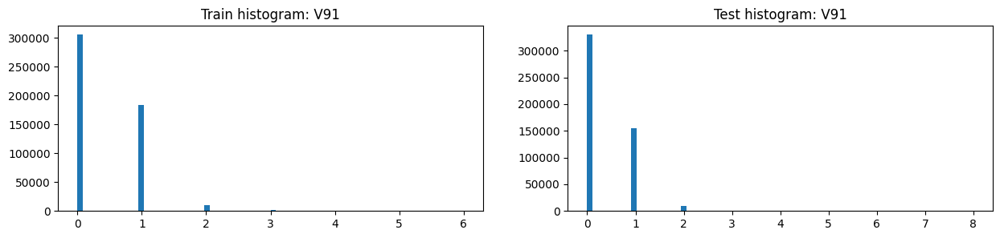

,V91,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.000000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,0.420461,0.098127,0.431352,0.356810,0.432027,0.339158
2,std,0.561865,0.349208,0.564455,0.534183,0.559849,0.526424
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
7,max,6.000000,6.000000,6.000000,8.000000,6.000000,8.000000
8,unique values,8.000000,8.000000,8.000000,10.000000,8.000000,10.000000
9,NaNs,89164.000000,4276.000000,84888.000000,12081.000000,7317.000000,4764.000000


,V91,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,305135,0.049159,15000,329824
1,1.0,184121,0.006539,1204,154755
2,-999.0,89164,0.047957,4276,12081
3,2.0,10470,0.014900,156,8720
4,3.0,1086,0.017495,19,1035
5,4.0,336,0.017857,6,211
6,5.0,222,0.004505,1,57
7,6.0,6,0.166667,1,5


,V91,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,305135,0.049159,15000,329824
1,-999.0,89164,0.047957,4276,12081
2,1.0,184121,0.006539,1204,154755
3,2.0,10470,0.014900,156,8720
4,3.0,1086,0.017495,19,1035
5,4.0,336,0.017857,6,211
6,5.0,222,0.004505,1,57
7,6.0,6,0.166667,1,5


,Column,Correlation with V91
0,V91,1.000000
1,V90,0.959692
2,V49,0.925746
3,V30,0.916219
4,V48,0.909608
5,V70,0.907717
208,V34,-0.298756
209,V92,-0.299432
210,V52,-0.302212
211,V51,-0.306848


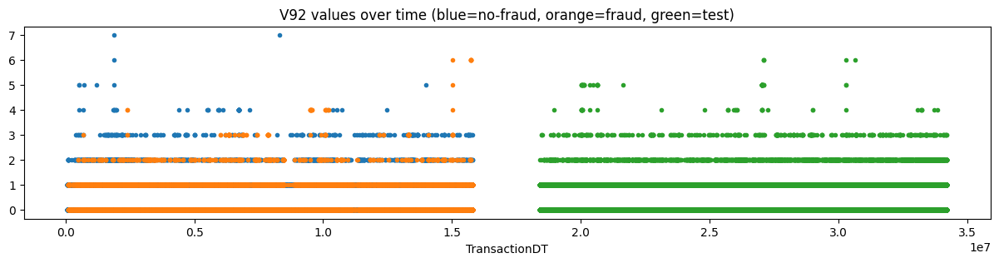

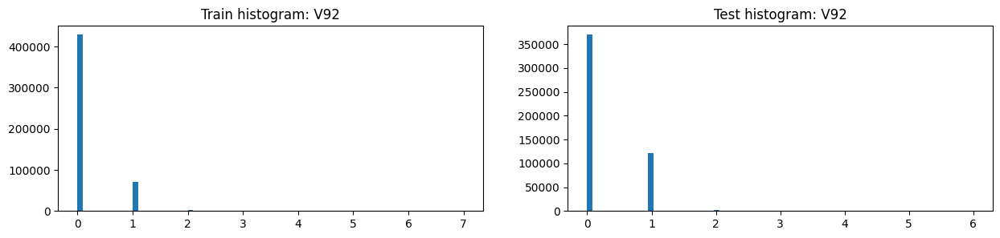

,V92,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.000000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,0.150322,0.519253,0.137857,0.259865,0.127300,0.290979
2,std,0.375682,0.609271,0.358622,0.460140,0.361654,0.475008
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
7,max,7.000000,6.000000,7.000000,6.000000,5.000000,6.000000
8,unique values,9.000000,8.000000,9.000000,8.000000,7.000000,8.000000
9,NaNs,89164.000000,4276.000000,84888.000000,12081.000000,7317.000000,4764.000000


,V92,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,428699,0.020161,8643,370042.0
1,-999.0,89164,0.047957,4276,12081.0
2,1.0,70511,0.101346,7146,121235.0
3,2.0,1744,0.271216,473,2844.0
4,3.0,348,0.281609,98,401.0
5,4.0,57,0.333333,19,39.0
6,6.0,8,0.875000,7,5.0
7,5.0,7,0.142857,1,44.0
8,7.0,2,0.000000,0,NaN


,V92,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,428699,0.020161,8643,370042.0
1,1.0,70511,0.101346,7146,121235.0
2,-999.0,89164,0.047957,4276,12081.0
3,2.0,1744,0.271216,473,2844.0
4,3.0,348,0.281609,98,401.0
5,4.0,57,0.333333,19,39.0
6,6.0,8,0.875000,7,5.0
7,5.0,7,0.142857,1,44.0
8,7.0,2,0.000000,0,NaN


,Column,Correlation with V92
0,V92,1.000000
1,V50,0.970760
2,V31,0.965936
3,V93,0.963108
4,V71,0.960691
5,V32,0.945899
362,V145,-0.459852
363,V36,-0.462045
364,V150,-0.464599
365,V151,-0.492945


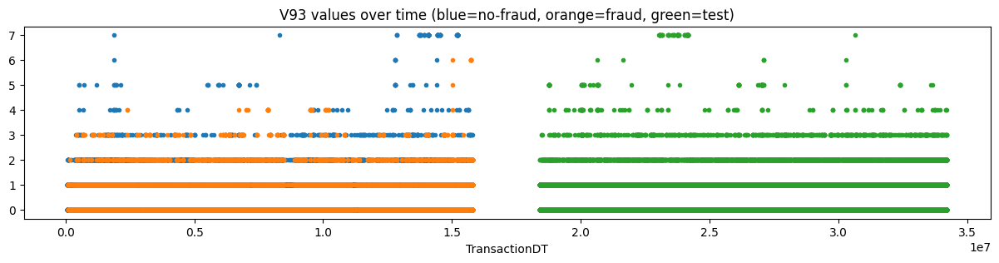

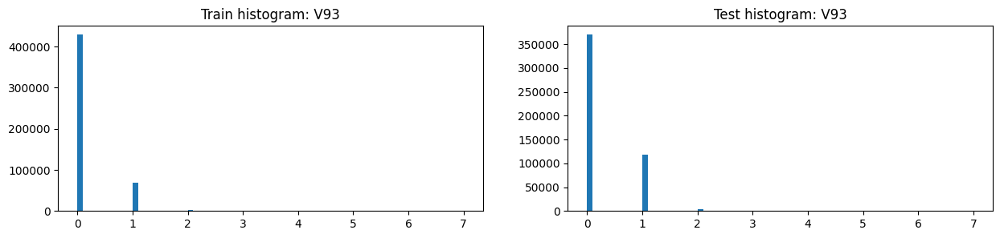

,V93,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.000000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,0.154812,0.550925,0.141428,0.266691,0.132395,0.298211
2,std,0.402314,0.671300,0.382908,0.485723,0.387364,0.500855
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
7,max,7.000000,6.000000,7.000000,7.000000,6.000000,7.000000
8,unique values,9.000000,8.000000,9.000000,9.000000,8.000000,9.000000
9,NaNs,89164.000000,4276.000000,84888.000000,12081.000000,7317.000000,4764.000000


,V93,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,428694,0.020157,8641,370007
1,-999.0,89164,0.047957,4276,12081
2,1.0,69196,0.097824,6769,118930
3,2.0,2682,0.271439,728,4593
4,3.0,556,0.374101,208,819
5,7.0,109,0.000000,0,65
6,4.0,80,0.412500,33,106
7,5.0,46,0.021739,1,84
8,6.0,13,0.538462,7,6


,V93,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,428694,0.020157,8641,370007
1,1.0,69196,0.097824,6769,118930
2,-999.0,89164,0.047957,4276,12081
3,2.0,2682,0.271439,728,4593
4,3.0,556,0.374101,208,819
5,4.0,80,0.412500,33,106
6,6.0,13,0.538462,7,6
7,5.0,46,0.021739,1,84
8,7.0,109,0.000000,0,65


,Column,Correlation with V93
0,V93,1.000000
1,V92,0.963108
2,V72,0.945832
3,V50,0.933852
4,V31,0.928171
5,V71,0.924839
362,V35,-0.434321
363,V54,-0.440320
364,V36,-0.443854
365,V151,-0.445465


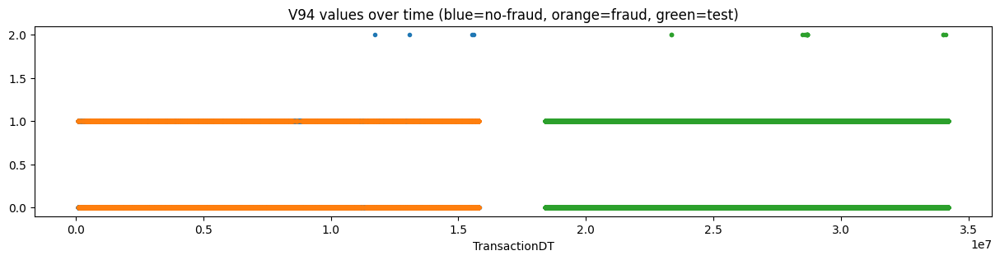

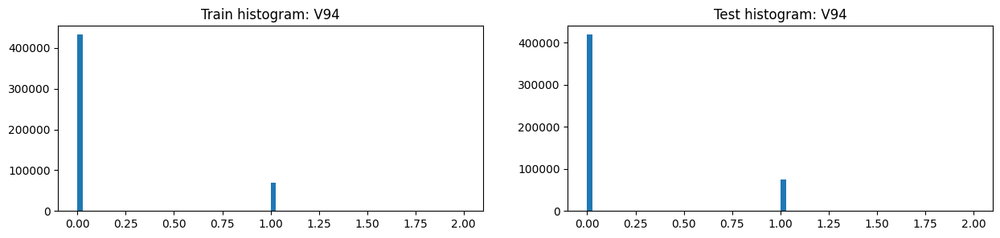

,V94,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,501376.000000,16387.000000,484989.000000,494610.000000,94022.000000,400589.000000
1,mean,0.137007,0.489473,0.125098,0.152702,0.117802,0.160893
2,std,0.343878,0.499904,0.330855,0.359779,0.322375,0.367528
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,2.000000,1.000000,2.000000,2.000000,1.000000,2.000000
8,unique values,4.000000,3.000000,4.000000,4.000000,3.000000,4.000000
9,NaNs,89164.000000,4276.000000,84888.000000,12081.000000,7317.000000,4764.000000


,V94,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,432688,0.019335,8366,419096
1,-999.0,89164,0.047957,4276,12081
2,1.0,68684,0.116781,8021,75500
3,2.0,4,0.000000,0,14


,V94,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,432688,0.019335,8366,419096
1,1.0,68684,0.116781,8021,75500
2,-999.0,89164,0.047957,4276,12081
3,2.0,4,0.000000,0,14


,Column,Correlation with V94
0,V94,1.000000
1,V33,0.975796
2,V15,0.953582
3,V51,0.950989
4,V73,0.946165
5,V57,0.936173
328,V53,-0.412627
329,V35,-0.417277
330,V54,-0.423711
331,V36,-0.427154


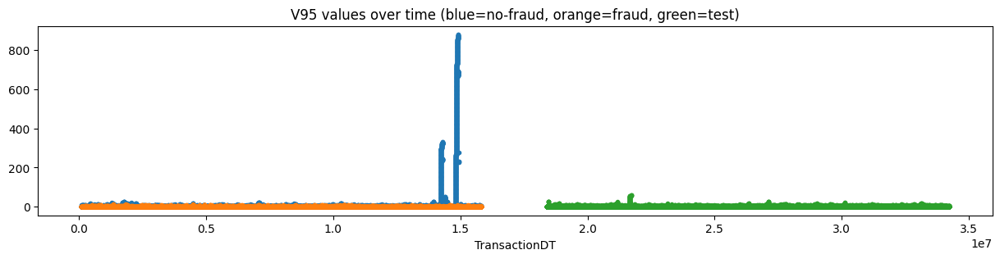

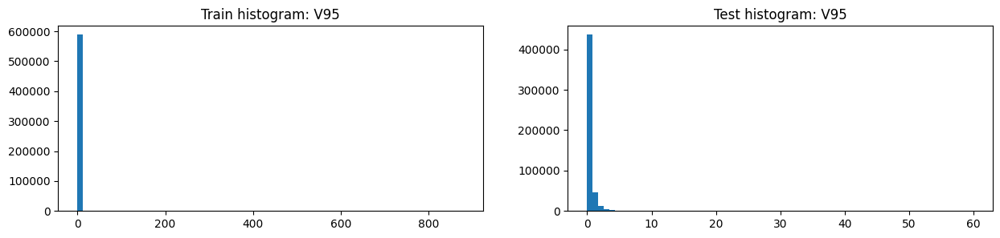

,V95,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.038019,0.582873,1.054517,0.231695,0.270952,0.221881
2,std,21.034304,1.239608,21.410652,0.859311,1.210804,0.745671
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,880.000000,13.000000,880.000000,60.000000,60.000000,27.000000
8,unique values,882.000000,15.000000,882.000000,61.000000,61.000000,28.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V95,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,510542,0.028568,14585,436511.0
1,1.0,52008,0.063740,3315,46915.0
2,2.0,14804,0.089976,1332,13276.0
3,3.0,5758,0.112365,647,4986.0
4,4.0,2646,0.125472,332,2330.0
5,5.0,1281,0.135831,174,1116.0
6,6.0,684,0.141813,97,578.0
7,7.0,411,0.163017,67,322.0
8,-999.0,314,0.054140,17,NaN
9,8.0,239,0.184100,44,196.0


,V95,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,510542,0.028568,14585,436511
1,1.0,52008,0.063740,3315,46915
2,2.0,14804,0.089976,1332,13276
3,3.0,5758,0.112365,647,4986
4,4.0,2646,0.125472,332,2330
5,5.0,1281,0.135831,174,1116
6,6.0,684,0.141813,97,578
7,7.0,411,0.163017,67,322
8,8.0,239,0.184100,44,196
9,9.0,167,0.191617,32,119


,Column,Correlation with V95
0,V95,1.000000
1,V322,0.999949
2,V101,0.999594
3,V279,0.998710
4,V293,0.998475
5,V132,0.995258
375,V155,-0.132920
376,V148,-0.137331
377,V154,-0.144542
378,V153,-0.147642


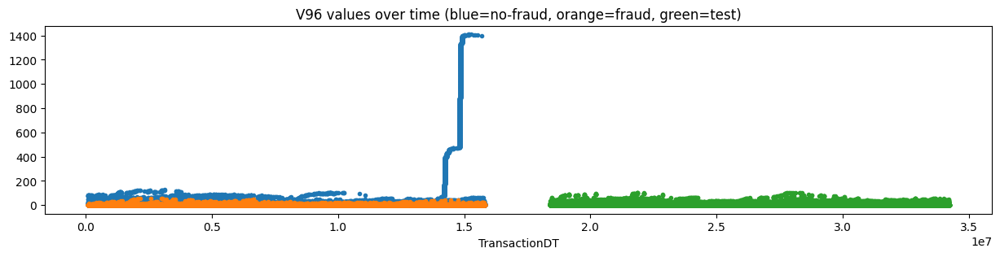

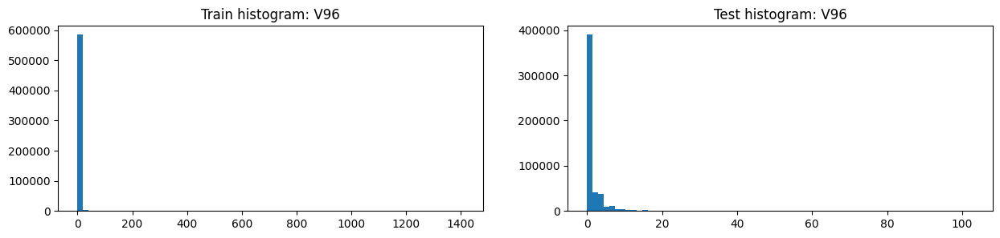

,V96,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.00000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,3.00519,1.846023,3.047207,1.376553,1.601831,1.320237
2,std,40.23949,4.449918,40.952917,3.806585,4.519231,3.604289
3,min,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.00000,2.000000,1.000000,1.000000,2.000000,1.000000
7,max,1410.00000,55.000000,1410.000000,103.000000,98.000000,103.000000
8,unique values,1411.00000,57.000000,1411.000000,104.000000,99.000000,104.000000
9,NaNs,314.00000,17.000000,297.000000,0.000000,0.000000,0.000000


,V96,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,366578,0.032743,12003,308455.0
1,1.0,95636,0.032540,3112,81462.0
2,2.0,46607,0.035123,1637,40821.0
3,3.0,25624,0.038050,975,22889.0
4,4.0,15839,0.040912,648,14701.0
5,5.0,9376,0.042875,402,8901.0
6,6.0,6240,0.046154,288,6041.0
7,7.0,4378,0.054134,237,4356.0
8,8.0,3169,0.062165,197,3300.0
9,9.0,2333,0.066009,154,2416.0


,V96,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,366578,0.032743,12003,308455
1,1.0,95636,0.032540,3112,81462
2,2.0,46607,0.035123,1637,40821
3,3.0,25624,0.038050,975,22889
4,4.0,15839,0.040912,648,14701
5,5.0,9376,0.042875,402,8901
6,6.0,6240,0.046154,288,6041
7,7.0,4378,0.054134,237,4356
8,8.0,3169,0.062165,197,3300
9,9.0,2333,0.066009,154,2416


,Column,Correlation with V96
0,V96,1.000000
1,V323,0.999948
2,V102,0.997104
3,V332,0.994881
4,V324,0.992663
5,V133,0.992326
375,V155,-0.149556
376,D5,-0.151953
377,V148,-0.154520
378,V154,-0.162619


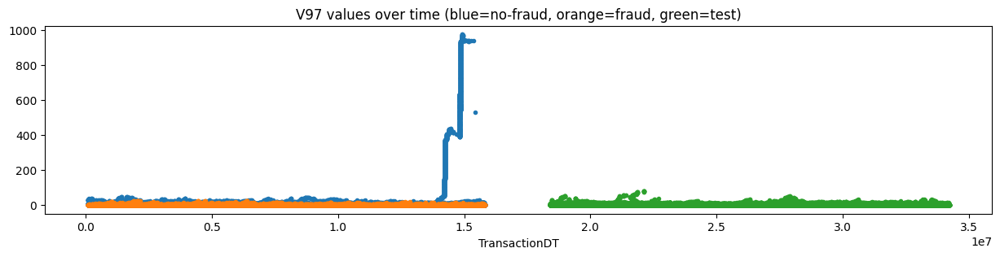

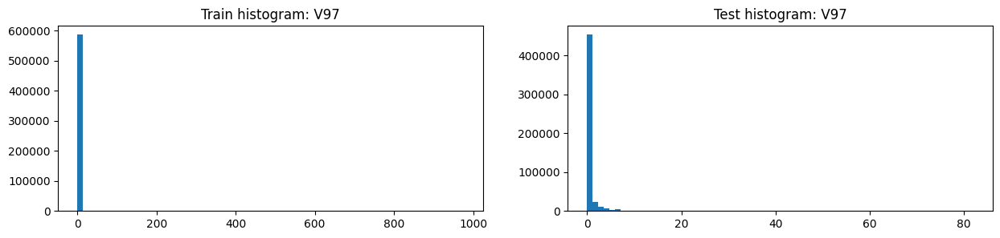

,V97,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.718933,1.065582,1.742616,0.531728,0.624528,0.508527
2,std,27.700449,2.245991,28.194494,1.687563,2.113996,1.562018
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
7,max,976.000000,26.000000,976.000000,82.000000,62.000000,82.000000
8,unique values,977.000000,28.000000,977.000000,83.000000,63.000000,72.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V97,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,454213,0.028416,12907,385324.0
1,1.0,78056,0.042495,3317,68748.0
2,2.0,26249,0.061602,1617,24224.0
3,3.0,11485,0.080888,929,10926.0
4,4.0,5993,0.097447,584,5839.0
5,5.0,3616,0.103153,373,3563.0
6,6.0,2347,0.100128,235,2324.0
7,7.0,1582,0.103666,164,1499.0
8,8.0,1097,0.114859,126,1064.0
9,9.0,798,0.116541,93,746.0


,V97,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,454213,0.028416,12907,385324
1,1.0,78056,0.042495,3317,68748
2,2.0,26249,0.061602,1617,24224
3,3.0,11485,0.080888,929,10926
4,4.0,5993,0.097447,584,5839
5,5.0,3616,0.103153,373,3563
6,6.0,2347,0.100128,235,2324
7,7.0,1582,0.103666,164,1499
8,8.0,1097,0.114859,126,1064
9,9.0,798,0.116541,93,746


,Column,Correlation with V97
0,V97,1.000000
1,V324,0.999947
2,V103,0.998789
3,V134,0.994022
4,V323,0.992745
5,V333,0.991176
375,V155,-0.150972
376,V148,-0.155978
377,V154,-0.164164
378,D5,-0.165556


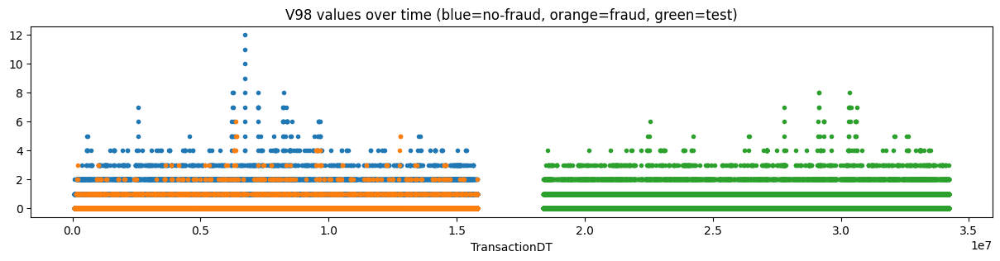

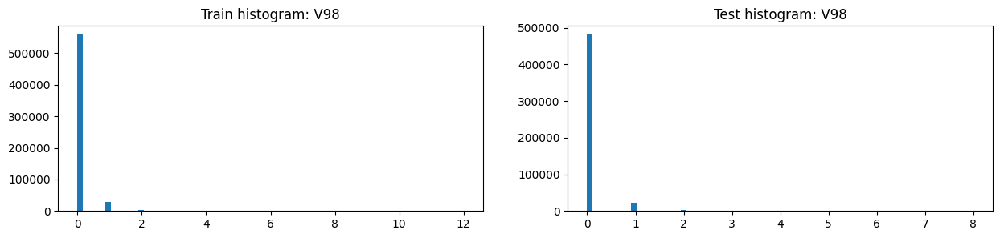

,V98,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,0.061985,0.102877,0.060502,0.057532,0.060224,0.056859
2,std,0.284995,0.371254,0.281261,0.272315,0.270035,0.272878
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,12.000000,6.000000,12.000000,8.000000,4.000000,8.000000
8,unique values,14.000000,8.000000,14.000000,9.000000,5.000000,9.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V98,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,558622,0.033776,18868,481398.0
1,1.0,27768,0.054847,1523,22275.0
2,2.0,3058,0.061805,189,2400.0
3,3.0,568,0.084507,48,473.0
4,-999.0,314,0.054140,17,NaN
5,4.0,135,0.088889,12,104.0
6,5.0,33,0.151515,5,19.0
7,6.0,21,0.047619,1,11.0
8,7.0,12,0.000000,0,8.0
9,8.0,5,0.000000,0,3.0


,V98,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,558622,0.033776,18868,481398.0
1,1.0,27768,0.054847,1523,22275.0
2,2.0,3058,0.061805,189,2400.0
3,3.0,568,0.084507,48,473.0
4,-999.0,314,0.054140,17,NaN
5,4.0,135,0.088889,12,104.0
6,5.0,33,0.151515,5,19.0
7,6.0,21,0.047619,1,11.0
8,7.0,12,0.000000,0,8.0
9,8.0,5,0.000000,0,3.0


,Column,Correlation with V98
0,V98,1.000000
1,V325,0.945764
2,V284,0.792611
3,V327,0.556653
4,V100,0.542436
5,V287,0.477932
375,V154,-0.093501
376,V153,-0.094997
377,D2,-0.103244
378,D5,-0.117056


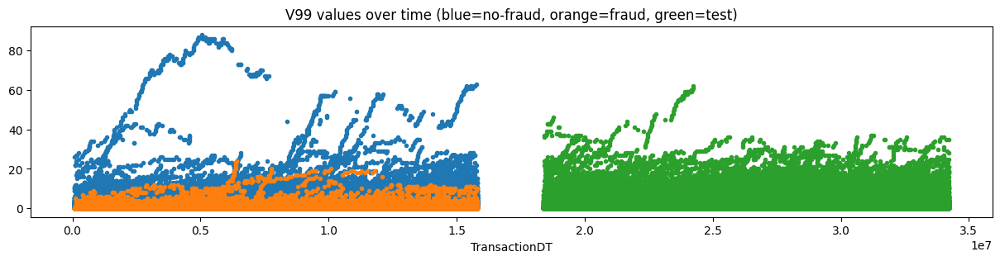

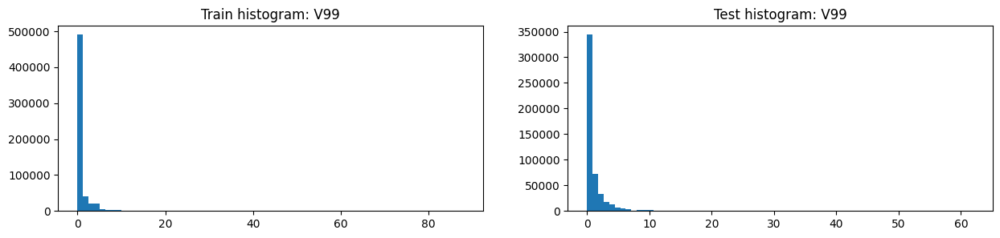

,V99,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,0.894986,0.706529,0.901817,0.939983,1.026308,0.918407
2,std,2.722552,1.957960,2.746030,2.425097,2.540143,2.394989
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000
7,max,88.000000,24.000000,88.000000,62.000000,46.000000,62.000000
8,unique values,90.000000,26.000000,90.000000,63.000000,47.000000,63.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V99,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,403766,0.038938,15722,344117.0
1,1.0,86901,0.025155,2186,72146.0
2,2.0,39884,0.023618,942,33897.0
3,3.0,21053,0.023940,504,18209.0
4,4.0,13162,0.031606,416,12193.0
5,5.0,7142,0.029544,211,6735.0
6,6.0,4627,0.025935,120,4721.0
7,7.0,3185,0.030141,96,3165.0
8,8.0,2169,0.048409,105,2404.0
9,9.0,1596,0.057018,91,1733.0


,V99,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,403766,0.038938,15722,344117
1,1.0,86901,0.025155,2186,72146
2,2.0,39884,0.023618,942,33897
3,3.0,21053,0.023940,504,18209
4,4.0,13162,0.031606,416,12193
5,5.0,7142,0.029544,211,6735
6,6.0,4627,0.025935,120,4721
7,8.0,2169,0.048409,105,2404
8,7.0,3185,0.030141,96,3165
9,9.0,1596,0.057018,91,1733


,Column,Correlation with V99
0,V99,1.000000
1,V326,0.988773
2,V327,0.930862
3,V285,0.858606
4,V100,0.837810
5,V329,0.814136
375,V149,-0.217062
376,V155,-0.224319
377,V148,-0.231764
378,V154,-0.243153


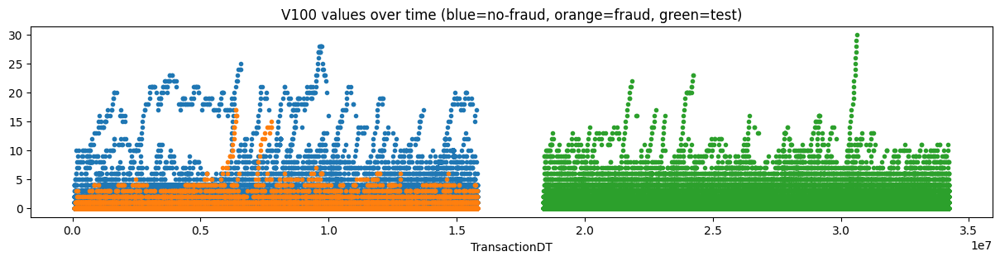

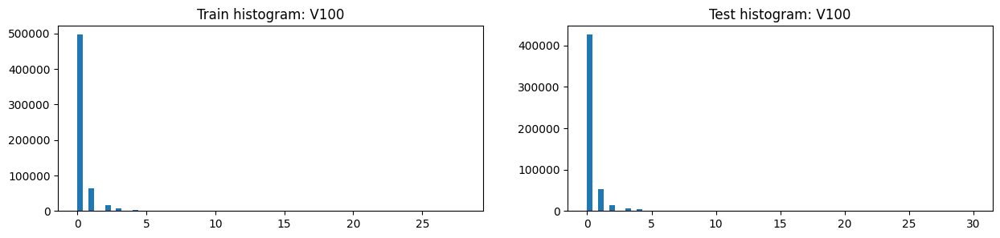

,V100,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,0.273504,0.329652,0.271468,0.270194,0.291497,0.264868
2,std,0.947176,0.925890,0.947877,0.834316,0.845393,0.831438
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,28.000000,17.000000,28.000000,30.000000,21.000000,30.000000
8,unique values,30.000000,19.000000,30.000000,31.000000,22.000000,31.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V100,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,496523,0.033775,16770,425891.0
1,1.0,63797,0.036742,2344,52967.0
2,2.0,16343,0.050970,833,14790.0
3,3.0,6424,0.059153,380,6216.0
4,4.0,3474,0.061313,213,3802.0
5,5.0,777,0.055341,43,1219.0
6,10.0,748,0.004011,3,104.0
7,7.0,590,0.008475,5,387.0
8,6.0,389,0.066838,26,697.0
9,9.0,387,0.012920,5,146.0


,V100,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,496523,0.033775,16770,425891.0
1,1.0,63797,0.036742,2344,52967.0
2,2.0,16343,0.050970,833,14790.0
3,3.0,6424,0.059153,380,6216.0
4,4.0,3474,0.061313,213,3802.0
5,5.0,777,0.055341,43,1219.0
6,6.0,389,0.066838,26,697.0
7,-999.0,314,0.054140,17,NaN
8,14.0,33,0.212121,7,20.0
9,7.0,590,0.008475,5,387.0


,Column,Correlation with V100
0,V100,1.000000
1,V327,0.987016
2,V326,0.932769
3,V287,0.863856
4,V329,0.841642
5,V99,0.837810
375,V149,-0.197184
376,V155,-0.203572
377,V148,-0.210444
378,V154,-0.220518


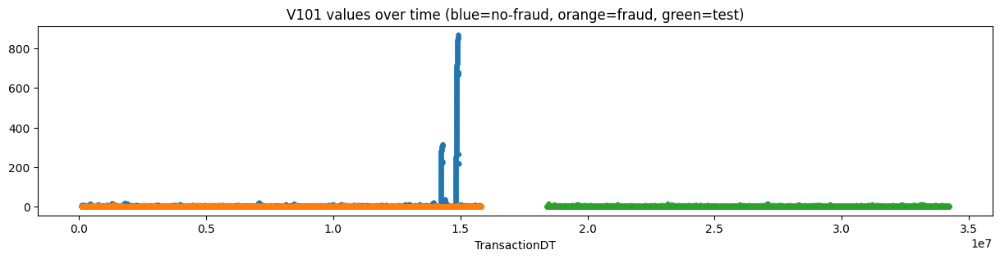

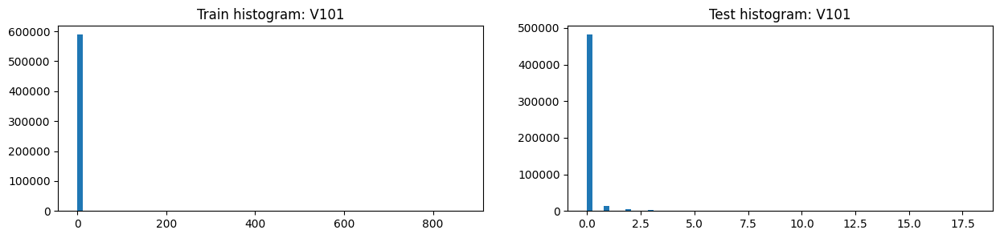

,V101,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,0.889249,0.379831,0.907714,0.091320,0.105211,0.087847
2,std,20.582571,1.014770,20.951164,0.516291,0.544514,0.508932
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,869.000000,13.000000,869.000000,18.000000,17.000000,18.000000
8,unique values,871.000000,15.000000,871.000000,19.000000,18.000000,19.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V101,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,556214,0.029785,16567,481543.0
1,1.0,19797,0.117442,2325,14782.0
2,2.0,6803,0.125386,853,5523.0
3,3.0,2995,0.139566,418,2307.0
4,4.0,1379,0.150109,207,1177.0
5,5.0,735,0.152381,112,594.0
6,6.0,380,0.186842,71,301.0
7,-999.0,314,0.054140,17,NaN
8,7.0,227,0.180617,41,178.0
9,8.0,141,0.198582,28,101.0


,V101,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,556214,0.029785,16567,481543.0
1,1.0,19797,0.117442,2325,14782.0
2,2.0,6803,0.125386,853,5523.0
3,3.0,2995,0.139566,418,2307.0
4,4.0,1379,0.150109,207,1177.0
5,5.0,735,0.152381,112,594.0
6,6.0,380,0.186842,71,301.0
7,7.0,227,0.180617,41,178.0
8,8.0,141,0.198582,28,101.0
9,-999.0,314,0.054140,17,NaN


,Column,Correlation with V101
0,V101,1.000000
1,V322,0.999698
2,V95,0.999594
3,V293,0.998919
4,V279,0.998454
5,V132,0.995637
375,V149,-0.127092
376,V155,-0.131160
377,V148,-0.135517
378,V154,-0.142678


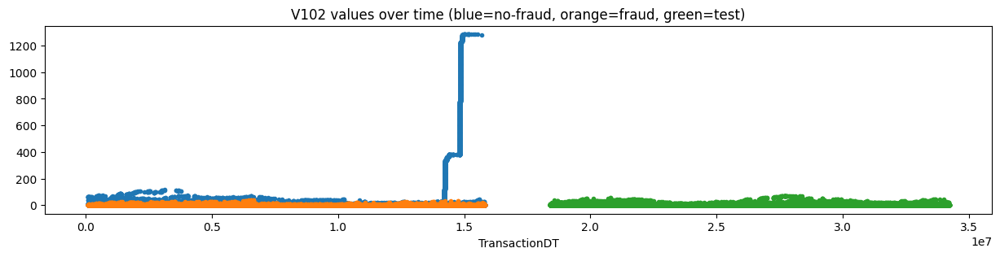

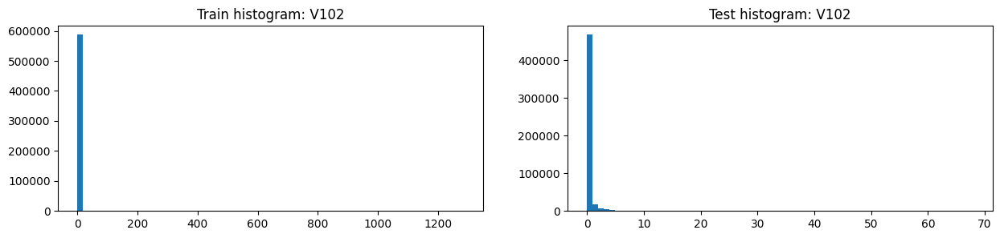

,V102,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.827229,0.912429,1.860388,0.246503,0.317351,0.228791
2,std,35.928456,2.760635,36.569617,1.639347,1.807579,1.594026
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,1285.000000,41.000000,1285.000000,68.000000,56.000000,68.000000
8,unique values,1286.000000,43.000000,1286.000000,69.000000,55.000000,69.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V102,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,535961,0.028319,15178,467675.0
1,1.0,24472,0.097417,2384,18094.0
2,2.0,10448,0.098009,1024,8018.0
3,3.0,5439,0.111050,604,3961.0
4,4.0,3227,0.115277,372,2413.0
5,5.0,2009,0.120458,242,1506.0
6,6.0,1434,0.115063,165,1092.0
7,7.0,992,0.126008,125,731.0
8,8.0,661,0.107413,71,542.0
9,9.0,522,0.130268,68,439.0


,V102,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,535961,0.028319,15178,467675
1,1.0,24472,0.097417,2384,18094
2,2.0,10448,0.098009,1024,8018
3,3.0,5439,0.111050,604,3961
4,4.0,3227,0.115277,372,2413
5,5.0,2009,0.120458,242,1506
6,6.0,1434,0.115063,165,1092
7,7.0,992,0.126008,125,731
8,8.0,661,0.107413,71,542
9,9.0,522,0.130268,68,439


,Column,Correlation with V102
0,V102,1.000000
1,V323,0.998828
2,V96,0.997104
3,V133,0.995615
4,V332,0.994837
5,V103,0.991516
375,V149,-0.138491
376,V155,-0.142918
377,V148,-0.147663
378,V154,-0.155457


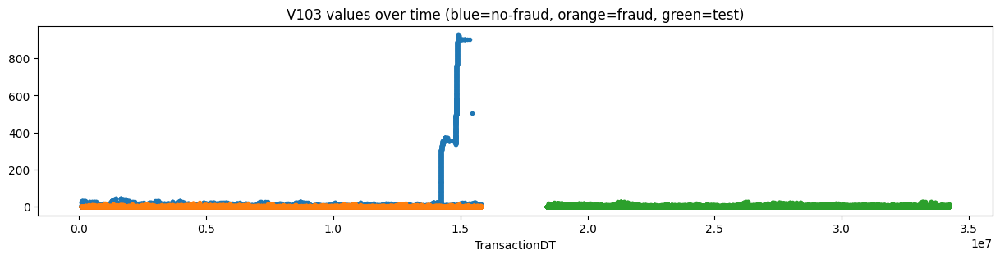

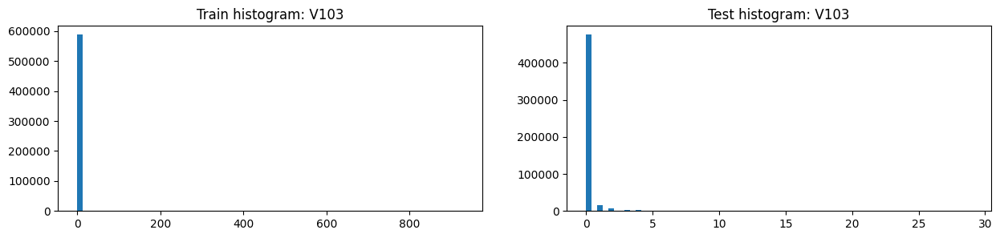

,V103,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.00000,506691.000000,101339.000000,405353.000000
1,mean,1.279288,0.588443,1.30433,0.145142,0.182279,0.135857
2,std,25.685642,1.570681,26.14497,0.846263,1.014076,0.798551
3,min,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000
7,max,928.000000,21.000000,928.00000,29.000000,29.000000,29.000000
8,unique values,929.000000,23.000000,929.00000,30.000000,30.000000,30.000000
9,NaNs,314.000000,17.000000,297.00000,0.000000,0.000000,0.000000


,V103,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,547743,0.028791,15770,475771.0
1,1.0,21363,0.110752,2366,15794.0
2,2.0,8399,0.117157,984,6658.0
3,3.0,4117,0.131163,540,3165.0
4,4.0,2268,0.145062,329,1803.0
5,5.0,1352,0.149408,202,1052.0
6,6.0,880,0.155682,137,689.0
7,7.0,576,0.156250,90,466.0
8,8.0,418,0.136364,57,324.0
9,9.0,325,0.144615,47,217.0


,V103,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,547743,0.028791,15770,475771
1,1.0,21363,0.110752,2366,15794
2,2.0,8399,0.117157,984,6658
3,3.0,4117,0.131163,540,3165
4,4.0,2268,0.145062,329,1803
5,5.0,1352,0.149408,202,1052
6,6.0,880,0.155682,137,689
7,7.0,576,0.156250,90,466
8,8.0,418,0.136364,57,324
9,9.0,325,0.144615,47,217


,Column,Correlation with V103
0,V103,1.000000
1,V324,0.999258
2,V97,0.998789
3,V134,0.995735
4,V323,0.993858
5,V102,0.991516
375,V149,-0.142812
376,V155,-0.147386
377,V148,-0.152274
378,V154,-0.160319


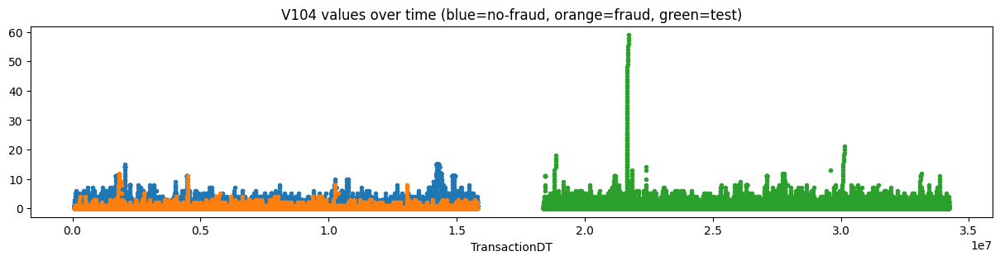

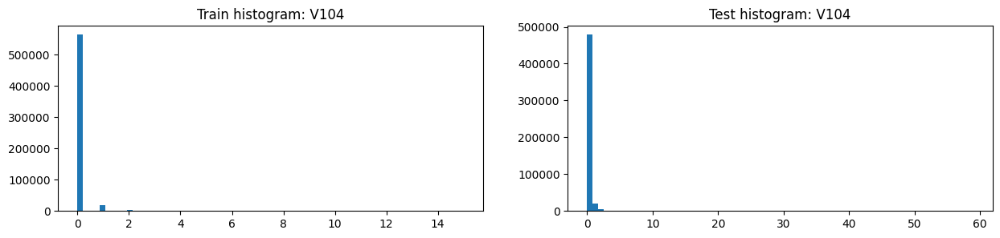

,V104,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,0.085433,0.097307,0.085003,0.081497,0.103692,0.075949
2,std,0.648718,0.482461,0.653947,0.557815,0.972010,0.390631
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,15.000000,12.000000,15.000000,59.000000,59.000000,21.000000
8,unique values,17.000000,14.000000,17.000000,60.000000,60.000000,22.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V104,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,563527,0.034220,19284,478742.0
1,1.0,19375,0.052594,1019,21068.0
2,2.0,4089,0.053069,217,4583.0
3,3.0,1126,0.064831,73,1325.0
4,11.0,1000,0.003000,3,32.0
5,4.0,401,0.047382,19,430.0
6,-999.0,314,0.054140,17,NaN
7,15.0,215,0.000000,0,4.0
8,5.0,169,0.047337,8,183.0
9,6.0,93,0.043011,4,95.0


,V104,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,563527,0.034220,19284,478742.0
1,1.0,19375,0.052594,1019,21068.0
2,2.0,4089,0.053069,217,4583.0
3,3.0,1126,0.064831,73,1325.0
4,4.0,401,0.047382,19,430.0
5,-999.0,314,0.054140,17,NaN
6,5.0,169,0.047337,8,183.0
7,9.0,23,0.260870,6,17.0
8,8.0,39,0.128205,5,49.0
9,6.0,93,0.043011,4,95.0


,Column,Correlation with V104
0,V104,1.000000
1,V328,0.987711
2,V330,0.936245
3,V297,0.917608
4,V106,0.902356
5,V181,0.889643
375,V149,-0.140938
376,V155,-0.147409
377,V148,-0.152096
378,V154,-0.158543


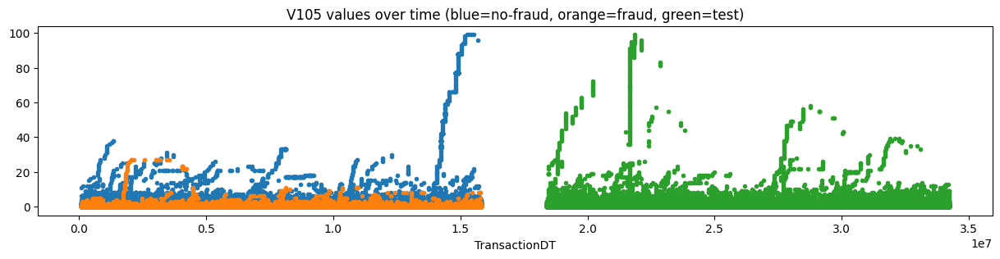

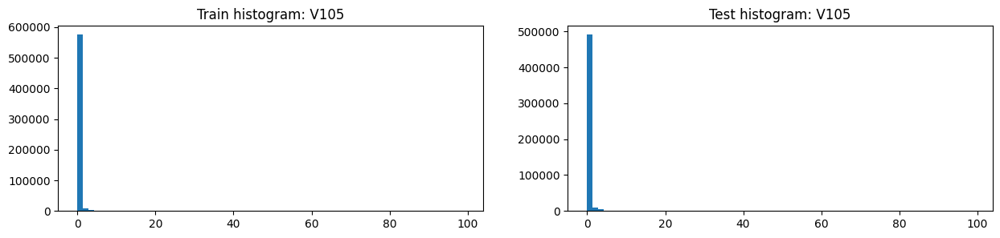

,V105,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,0.281145,0.223917,0.283219,0.188436,0.255716,0.171616
2,std,3.373948,1.229567,3.426548,1.493119,2.254587,1.230671
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,99.000000,27.000000,99.000000,99.000000,95.000000,99.000000
8,unique values,101.000000,29.000000,101.000000,100.000000,96.000000,76.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V105,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,547750,0.033855,18544,460547.0
1,1.0,27711,0.047959,1329,30604.0
2,2.0,7508,0.047816,359,8562.0
3,3.0,2566,0.061185,157,3091.0
4,4.0,1103,0.072529,80,1298.0
5,77.0,871,0.000000,0,1.0
6,5.0,603,0.082919,50,771.0
7,6.0,418,0.078947,33,360.0
8,-999.0,314,0.054140,17,NaN
9,7.0,251,0.055777,14,270.0


,V105,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,547750,0.033855,18544,460547.0
1,1.0,27711,0.047959,1329,30604.0
2,2.0,7508,0.047816,359,8562.0
3,3.0,2566,0.061185,157,3091.0
4,4.0,1103,0.072529,80,1298.0
5,5.0,603,0.082919,50,771.0
6,6.0,418,0.078947,33,360.0
7,8.0,149,0.127517,19,184.0
8,-999.0,314,0.054140,17,NaN
9,7.0,251,0.055777,14,270.0


,Column,Correlation with V105
0,V105,1.000000
1,V329,0.999101
2,V298,0.978285
3,V330,0.968189
4,V324,0.961711
5,V106,0.960937
375,V149,-0.158849
376,V155,-0.164272
377,V148,-0.169700
378,V154,-0.178327


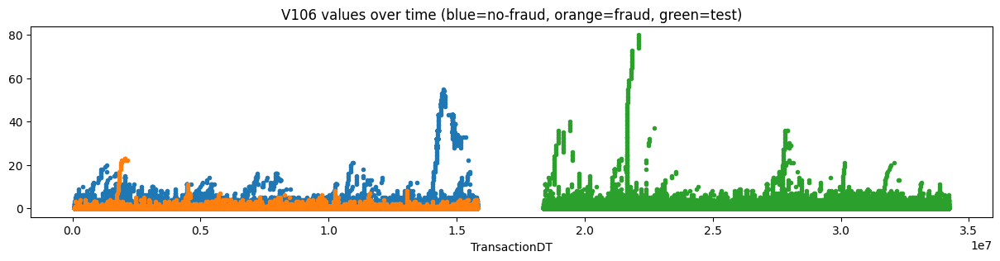

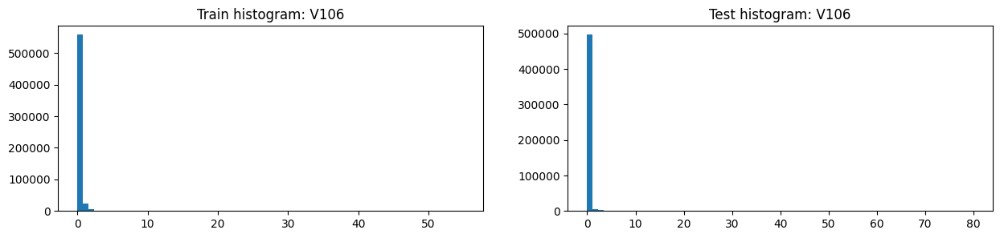

,V106,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,0.164584,0.144532,0.165311,0.114971,0.148709,0.106537
2,std,1.825665,0.781436,1.852491,0.878800,1.225099,0.767977
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,55.000000,23.000000,55.000000,80.000000,59.000000,80.000000
8,unique values,57.000000,25.000000,57.000000,81.000000,60.000000,59.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V106,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,558074,0.033908,18923,472971.0
1,1.0,22306,0.053080,1184,23968.0
2,2.0,5381,0.057796,311,5914.0
3,3.0,1590,0.072956,116,1868.0
4,4.0,595,0.082353,49,731.0
5,35.0,419,0.000000,0,4.0
6,5.0,317,0.056782,18,379.0
7,-999.0,314,0.054140,17,NaN
8,39.0,224,0.000000,0,2.0
9,32.0,176,0.000000,0,5.0


,V106,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,558074,0.033908,18923,472971.0
1,1.0,22306,0.053080,1184,23968.0
2,2.0,5381,0.057796,311,5914.0
3,3.0,1590,0.072956,116,1868.0
4,4.0,595,0.082353,49,731.0
5,5.0,317,0.056782,18,379.0
6,-999.0,314,0.054140,17,NaN
7,6.0,140,0.071429,10,199.0
8,7.0,79,0.088608,7,148.0
9,8.0,73,0.054795,4,82.0


,Column,Correlation with V106
0,V106,1.000000
1,V330,0.998002
2,V299,0.977030
3,V329,0.969386
4,V105,0.960937
5,V298,0.936216
375,V149,-0.158067
376,V155,-0.163765
377,V148,-0.169152
378,V154,-0.177497


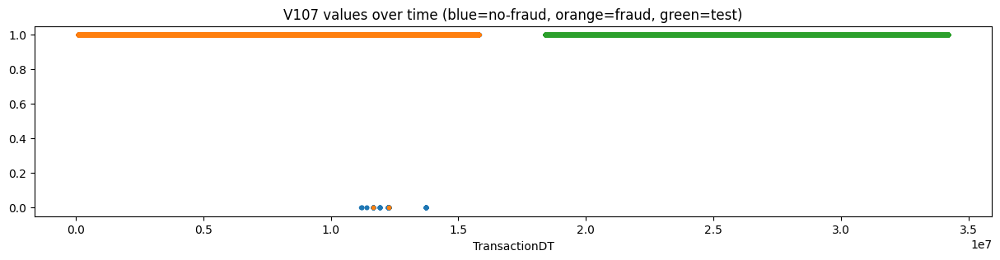

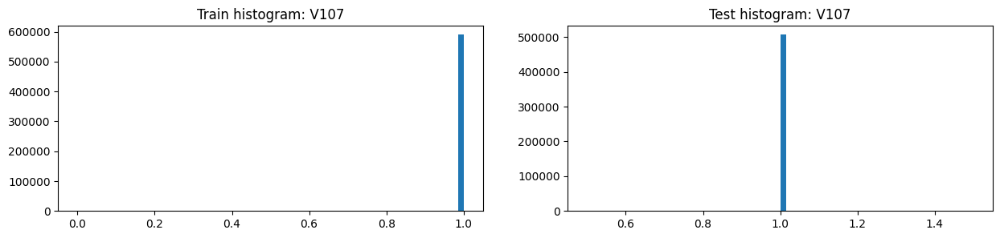

,V107,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.0,101339.0,405353.0
1,mean,0.999580,0.999855,0.999570,1.0,1.0,1.0
2,std,0.020494,0.012054,0.020735,0.0,0.0,0.0
3,min,0.000000,0.000000,0.000000,1.0,1.0,1.0
4,25%,1.000000,1.000000,1.000000,1.0,1.0,1.0
5,50%,1.000000,1.000000,1.000000,1.0,1.0,1.0
6,75%,1.000000,1.000000,1.000000,1.0,1.0,1.0
7,max,1.000000,1.000000,1.000000,1.0,1.0,1.0
8,unique values,3.000000,3.000000,3.000000,1.0,1.0,1.0
9,NaNs,314.000000,17.000000,297.000000,0.0,0.0,0.0


,V107,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,589978,0.034989,20643,506691.0
1,-999.0,314,0.054140,17,NaN
2,0.0,248,0.012097,3,NaN


,V107,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,589978,0.034989,20643,506691.0
1,-999.0,314,0.054140,17,NaN
2,0.0,248,0.012097,3,NaN


,Column,Correlation with V107
0,V107,1.000000
1,V117,0.582052
2,V120,0.492287
3,V119,0.393413
4,V122,0.294805
5,V111,0.290202
208,D15,-0.008613
209,D1,-0.009464
210,D11,-0.010835
211,TransactionID,-0.022165


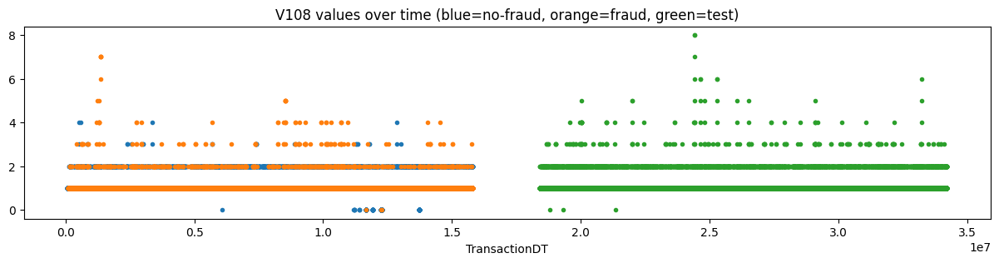

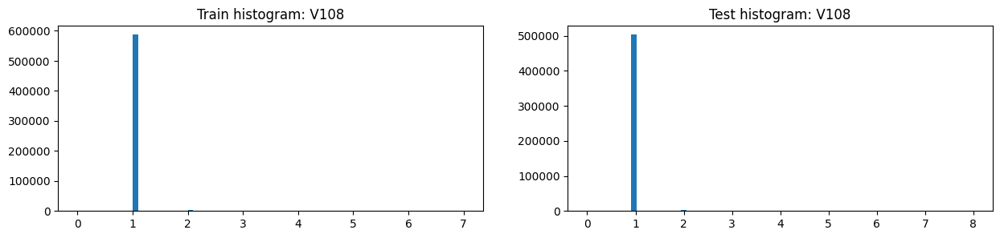

,V108,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.004613,1.045868,1.003118,1.006973,1.008585,1.006570
2,std,0.081146,0.270586,0.064075,0.093677,0.101428,0.091632
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,7.000000,7.000000,4.000000,8.000000,5.000000,8.000000
8,unique values,9.000000,9.000000,6.000000,9.000000,6.000000,8.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V108,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,587242,0.033880,19896,503470.0
1,2.0,2566,0.236945,608,2993.0
2,-999.0,314,0.054140,17,NaN
3,0.0,249,0.012048,3,3.0
4,3.0,122,0.786885,96,166.0
5,4.0,35,0.885714,31,39.0
6,5.0,7,1.000000,7,11.0
7,7.0,4,1.000000,4,1.0
8,6.0,1,1.000000,1,6.0


,V108,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,587242,0.033880,19896,503470.0
1,2.0,2566,0.236945,608,2993.0
2,3.0,122,0.786885,96,166.0
3,4.0,35,0.885714,31,39.0
4,-999.0,314,0.054140,17,NaN
5,5.0,7,1.000000,7,11.0
6,7.0,4,1.000000,4,1.0
7,0.0,249,0.012048,3,3.0
8,6.0,1,1.000000,1,6.0


,Column,Correlation with V108
0,V108,1.000000
1,V110,0.817646
2,V114,0.748478
3,V111,0.687430
4,V113,0.630059
5,V109,0.604248
375,addr2,-0.027932
376,V90,-0.028012
377,D5,-0.036731
378,D8,-0.038075


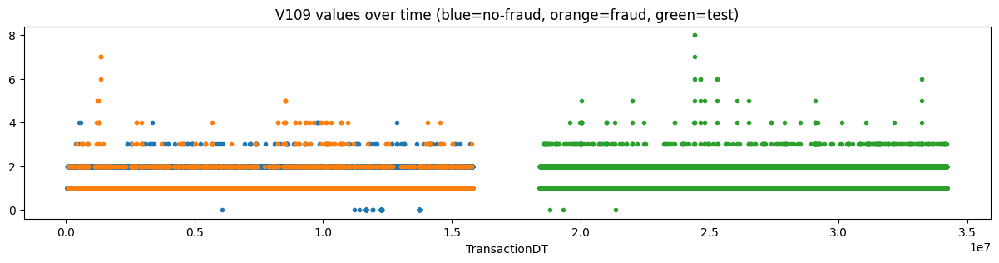

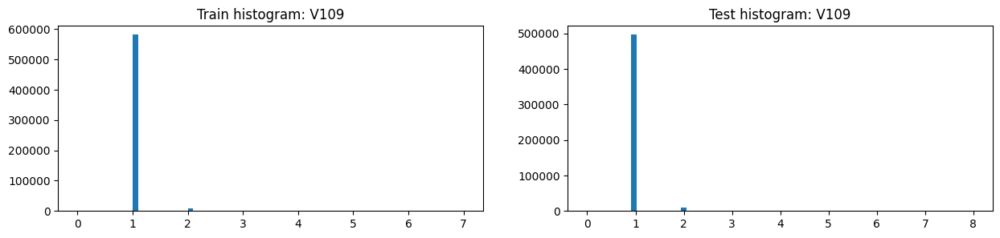

,V109,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.014816,1.055749,1.013333,1.020756,1.024956,1.019706
2,std,0.127769,0.287870,0.117687,0.151220,0.164670,0.147648
3,min,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,7.000000,7.000000,4.000000,8.000000,5.000000,8.000000
8,unique values,9.000000,8.000000,6.000000,9.000000,6.000000,8.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V109,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,581702,0.033876,19706,496661.0
1,2.0,8198,0.097097,796,9627.0
2,-999.0,314,0.054140,17,NaN
3,3.0,212,0.462264,98,341.0
4,0.0,60,0.000000,0,3.0
5,4.0,42,0.809524,34,39.0
6,5.0,7,1.000000,7,11.0
7,7.0,4,1.000000,4,1.0
8,6.0,1,1.000000,1,6.0


,V109,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,581702,0.033876,19706,496661.0
1,2.0,8198,0.097097,796,9627.0
2,3.0,212,0.462264,98,341.0
3,4.0,42,0.809524,34,39.0
4,-999.0,314,0.054140,17,NaN
5,5.0,7,1.000000,7,11.0
6,7.0,4,1.000000,4,1.0
7,6.0,1,1.000000,1,6.0
8,0.0,60,0.000000,0,3.0


,Column,Correlation with V109
0,V109,1.000000
1,V110,0.749818
2,V115,0.694430
3,V108,0.604248
4,V116,0.549084
5,V112,0.463260
375,D2,-0.024533
376,V10,-0.027839
377,D8,-0.037168
378,D7,-0.054768


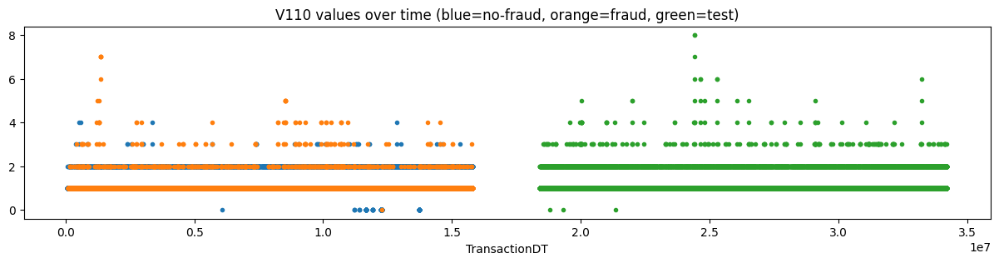

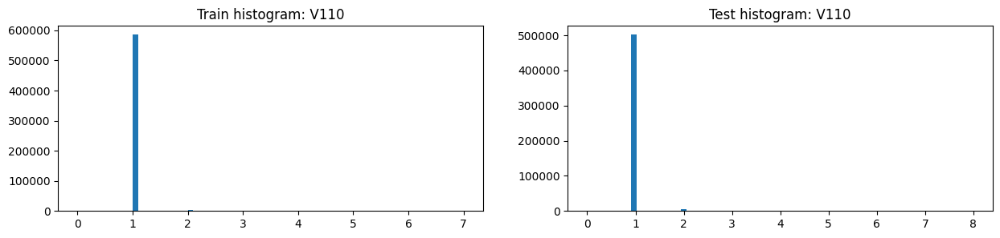

,V110,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.007739,1.049453,1.006227,1.010740,1.013430,1.010068
2,std,0.097290,0.276163,0.083539,0.112401,0.123942,0.109316
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,7.000000,7.000000,4.000000,8.000000,5.000000,8.000000
8,unique values,9.000000,9.000000,6.000000,9.000000,6.000000,8.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V110,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,585561,0.033858,19826,501601.0
1,2.0,4308,0.157846,680,4822.0
2,-999.0,314,0.054140,17,NaN
3,0.0,174,0.005747,1,3.0
4,3.0,136,0.705882,96,206.0
5,4.0,35,0.885714,31,39.0
6,5.0,7,1.000000,7,11.0
7,7.0,4,1.000000,4,1.0
8,6.0,1,1.000000,1,6.0


,V110,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,585561,0.033858,19826,501601.0
1,2.0,4308,0.157846,680,4822.0
2,3.0,136,0.705882,96,206.0
3,4.0,35,0.885714,31,39.0
4,-999.0,314,0.054140,17,NaN
5,5.0,7,1.000000,7,11.0
6,7.0,4,1.000000,4,1.0
7,0.0,174,0.005747,1,3.0
8,6.0,1,1.000000,1,6.0


,Column,Correlation with V110
0,V110,1.000000
1,V108,0.817646
2,V109,0.749818
3,V116,0.730495
4,V114,0.612401
5,V113,0.578336
375,V90,-0.033172
376,V10,-0.034659
377,D8,-0.037843
378,D5,-0.047222


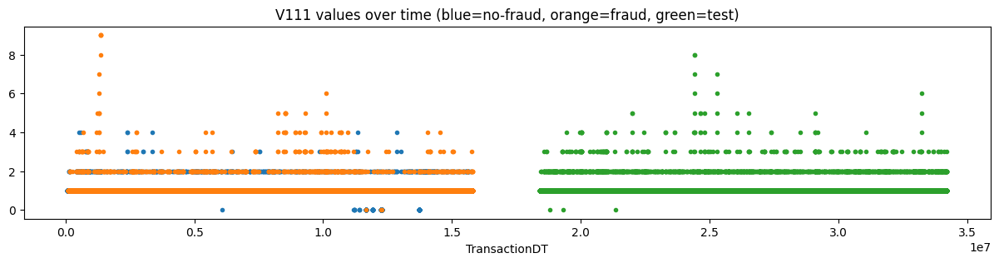

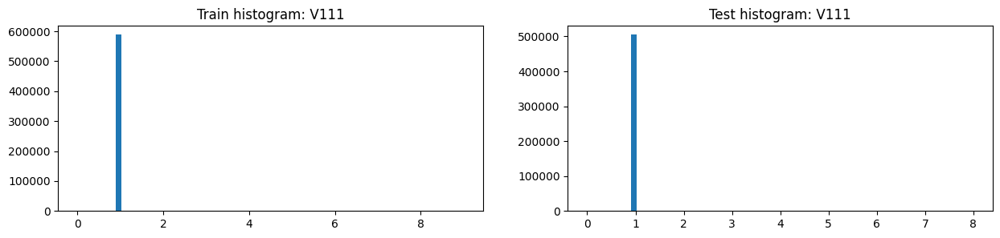

,V111,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.002563,1.047806,1.000923,1.004188,1.005013,1.003982
2,std,0.070830,0.296407,0.044016,0.077498,0.082841,0.076102
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,9.000000,9.000000,4.000000,8.000000,4.000000,8.000000
8,unique values,11.000000,11.000000,6.000000,9.000000,5.000000,8.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V111,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,588499,0.033817,19901,504886.0
1,2.0,1293,0.453210,586,1566.0
2,-999.0,314,0.054140,17,NaN
3,0.0,249,0.012048,3,3.0
4,3.0,129,0.829457,107,180.0
5,4.0,36,0.805556,29,38.0
6,5.0,12,1.000000,12,11.0
7,9.0,4,1.000000,4,NaN
8,6.0,2,1.000000,2,3.0
9,7.0,1,1.000000,1,2.0


,V111,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,588499,0.033817,19901,504886.0
1,2.0,1293,0.453210,586,1566.0
2,3.0,129,0.829457,107,180.0
3,4.0,36,0.805556,29,38.0
4,-999.0,314,0.054140,17,NaN
5,5.0,12,1.000000,12,11.0
6,9.0,4,1.000000,4,NaN
7,0.0,249,0.012048,3,3.0
8,6.0,2,1.000000,2,3.0
9,7.0,1,1.000000,1,2.0


,Column,Correlation with V111
0,V111,1.000000
1,V113,0.923441
2,V112,0.782727
3,V108,0.687430
4,V114,0.600273
5,V110,0.554005
375,V35,-0.038129
376,V36,-0.038458
377,D8,-0.046234
378,D7,-0.057225


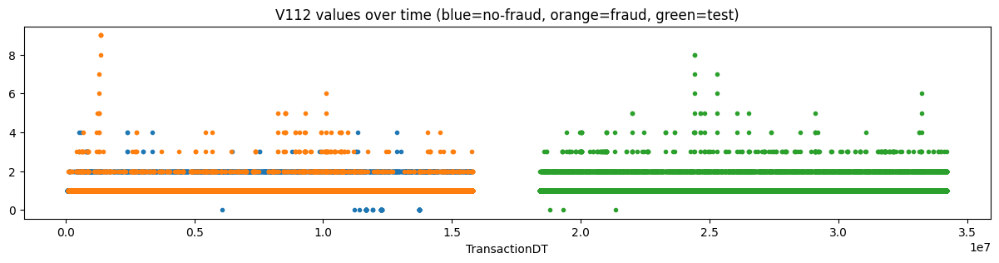

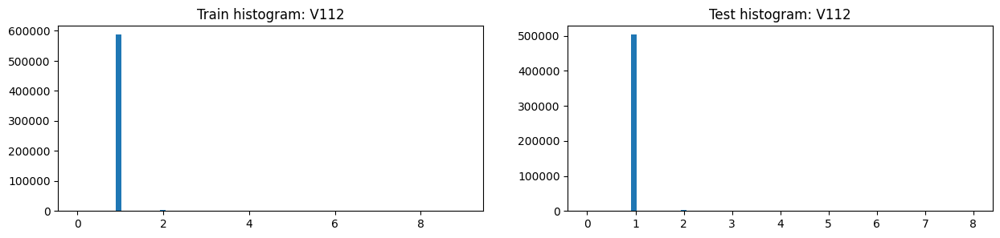

,V112,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.005356,1.052117,1.003661,1.007865,1.009069,1.007564
2,std,0.084617,0.302562,0.063399,0.098856,0.104312,0.097442
3,min,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,9.000000,9.000000,4.000000,8.000000,4.000000,8.000000
8,unique values,11.000000,10.000000,6.000000,9.000000,5.000000,8.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V112,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,587233,0.033750,19819,503055.0
1,2.0,2744,0.244169,670,3367.0
2,-999.0,314,0.054140,17,NaN
3,3.0,133,0.812030,108,208.0
4,0.0,60,0.000000,0,3.0
5,4.0,36,0.805556,29,40.0
6,5.0,12,1.000000,12,11.0
7,9.0,4,1.000000,4,NaN
8,6.0,2,1.000000,2,3.0
9,7.0,1,1.000000,1,2.0


,V112,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,587233,0.033750,19819,503055.0
1,2.0,2744,0.244169,670,3367.0
2,3.0,133,0.812030,108,208.0
3,4.0,36,0.805556,29,40.0
4,-999.0,314,0.054140,17,NaN
5,5.0,12,1.000000,12,11.0
6,9.0,4,1.000000,4,NaN
7,6.0,2,1.000000,2,3.0
8,7.0,1,1.000000,1,2.0
9,8.0,1,1.000000,1,2.0


,Column,Correlation with V112
0,V112,1.000000
1,V113,0.851842
2,V111,0.782727
3,V108,0.527899
4,V110,0.487868
5,V114,0.467518
375,V12,-0.029946
376,D5,-0.034404
377,addr2,-0.037176
378,D8,-0.046692


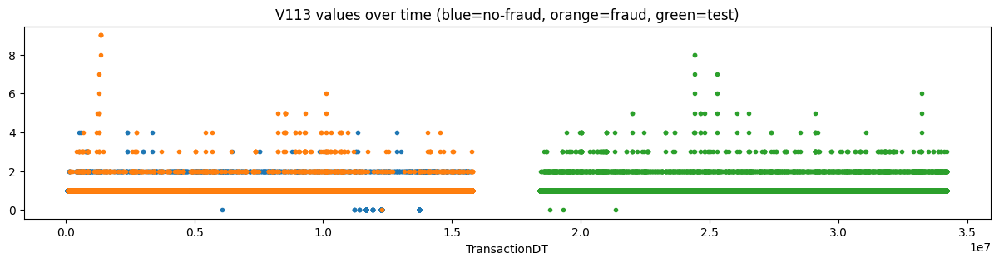

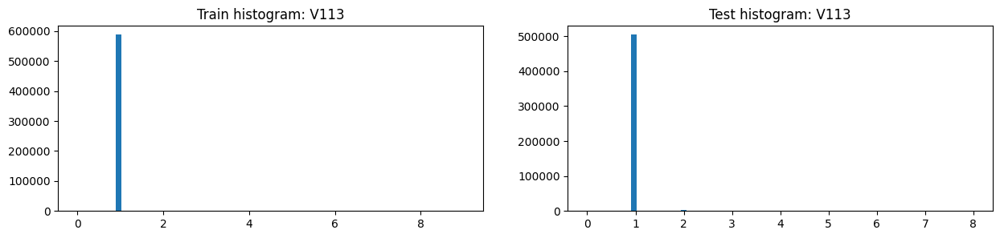

,V113,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.003383,1.048920,1.001733,1.005202,1.006187,1.004956
2,std,0.074754,0.297938,0.049953,0.084060,0.089576,0.082621
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,9.000000,9.000000,4.000000,8.000000,4.000000,8.000000
8,unique values,11.000000,11.000000,6.000000,9.000000,5.000000,8.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V113,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,588168,0.033805,19883,504386.0
1,2.0,1696,0.356722,605,2052.0
2,-999.0,314,0.054140,17,NaN
3,0.0,174,0.005747,1,3.0
4,3.0,132,0.818182,108,194.0
5,4.0,36,0.805556,29,38.0
6,5.0,12,1.000000,12,11.0
7,9.0,4,1.000000,4,NaN
8,6.0,2,1.000000,2,3.0
9,7.0,1,1.000000,1,2.0


,V113,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,588168,0.033805,19883,504386.0
1,2.0,1696,0.356722,605,2052.0
2,3.0,132,0.818182,108,194.0
3,4.0,36,0.805556,29,38.0
4,-999.0,314,0.054140,17,NaN
5,5.0,12,1.000000,12,11.0
6,9.0,4,1.000000,4,NaN
7,6.0,2,1.000000,2,3.0
8,0.0,174,0.005747,1,3.0
9,7.0,1,1.000000,1,2.0


,Column,Correlation with V113
0,V113,1.000000
1,V111,0.923441
2,V112,0.851842
3,V108,0.630059
4,V110,0.578336
5,V114,0.553032
375,V12,-0.034734
376,V35,-0.035128
377,D8,-0.046318
378,addr2,-0.051879


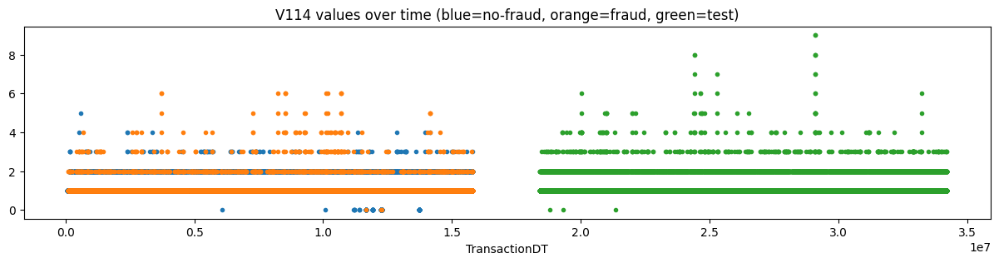

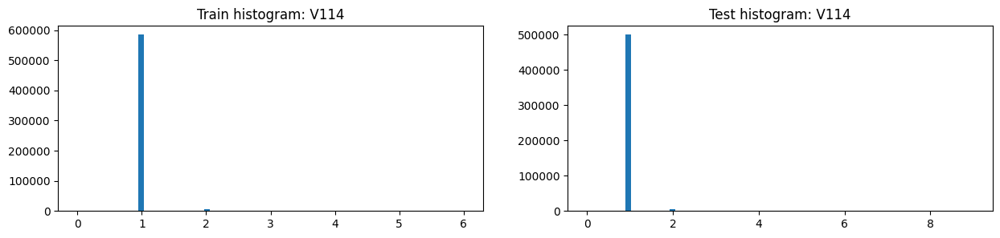

,V114,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.009298,1.064904,1.007283,1.013608,1.016203,1.012959
2,std,0.110179,0.327406,0.092617,0.132229,0.142209,0.129605
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,6.000000,6.000000,5.000000,9.000000,6.000000,9.000000
8,unique values,8.000000,8.000000,7.000000,10.000000,7.000000,9.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V114,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,584688,0.033563,19624,500456.0
1,2.0,4954,0.161688,801,5772.0
2,-999.0,314,0.054140,17,NaN
3,3.0,255,0.580392,148,338.0
4,0.0,250,0.012000,3,3.0
5,4.0,53,0.849057,45,77.0
6,5.0,15,0.933333,14,26.0
7,6.0,11,1.000000,11,8.0


,V114,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,584688,0.033563,19624,500456.0
1,2.0,4954,0.161688,801,5772.0
2,3.0,255,0.580392,148,338.0
3,4.0,53,0.849057,45,77.0
4,-999.0,314,0.054140,17,NaN
5,5.0,15,0.933333,14,26.0
6,6.0,11,1.000000,11,8.0
7,0.0,250,0.012000,3,3.0


,Column,Correlation with V114
0,V114,1.000000
1,V116,0.800591
2,V108,0.748478
3,V110,0.612401
4,V111,0.600273
5,V123,0.582126
375,V48,-0.031976
376,V90,-0.033073
377,D8,-0.048434
378,D5,-0.050843


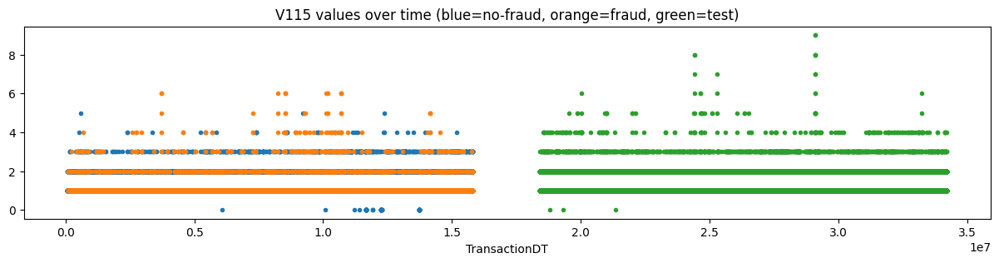

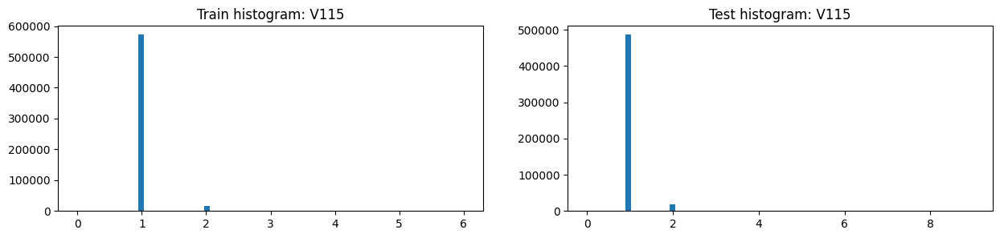

,V115,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.032450,1.089557,1.030380,1.043129,1.049922,1.041431
2,std,0.190385,0.365993,0.180506,0.223200,0.239576,0.218882
3,min,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,6.000000,6.000000,5.000000,9.000000,6.000000,9.000000
8,unique values,8.000000,7.000000,7.000000,10.000000,7.000000,9.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V115,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,572121,0.033528,19182,486514.0
1,2.0,17024,0.069784,1188,18812.0
2,3.0,909,0.223322,203,1133.0
3,-999.0,314,0.054140,17,NaN
4,4.0,83,0.578313,48,177.0
5,0.0,61,0.000000,0,3.0
6,5.0,17,0.823529,14,33.0
7,6.0,11,1.000000,11,8.0


,V115,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,572121,0.033528,19182,486514.0
1,2.0,17024,0.069784,1188,18812.0
2,3.0,909,0.223322,203,1133.0
3,4.0,83,0.578313,48,177.0
4,-999.0,314,0.054140,17,NaN
5,5.0,17,0.823529,14,33.0
6,6.0,11,1.000000,11,8.0
7,0.0,61,0.000000,0,3.0


,Column,Correlation with V115
0,V115,1.000000
1,V116,0.723384
2,V109,0.694430
3,V124,0.577699
4,V114,0.567970
5,V110,0.525480
375,V304,-0.033651
376,V302,-0.036843
377,D8,-0.043526
378,D7,-0.074970


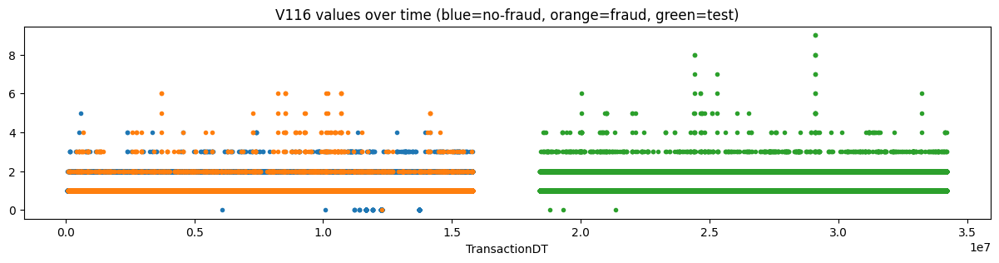

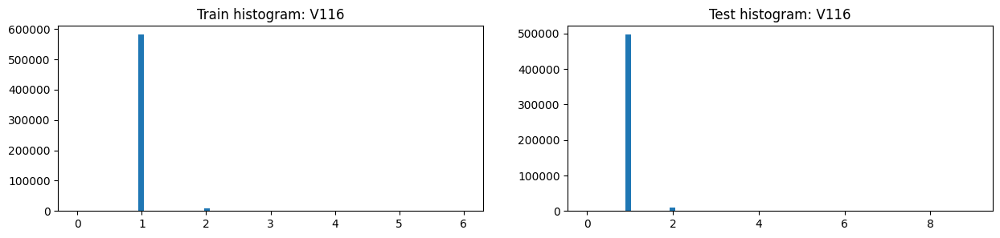

,V116,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.00000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.015738,1.07367,1.013638,1.021445,1.025203,1.020506
2,std,0.136770,0.34017,0.122735,0.161190,0.172963,0.158096
3,min,0.000000,0.00000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000
7,max,6.000000,6.00000,5.000000,9.000000,6.000000,9.000000
8,unique values,8.000000,8.00000,7.000000,10.000000,7.000000,9.000000
9,NaNs,314.000000,17.00000,297.000000,0.000000,0.000000,0.000000


,V116,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,581192,0.033481,19459,496697.0
1,2.0,8375,0.114149,956,9342.0
2,3.0,400,0.400000,160,506.0
3,-999.0,314,0.054140,17,NaN
4,0.0,175,0.005714,1,3.0
5,4.0,58,0.775862,45,96.0
6,5.0,15,0.933333,14,28.0
7,6.0,11,1.000000,11,8.0


,V116,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,581192,0.033481,19459,496697.0
1,2.0,8375,0.114149,956,9342.0
2,3.0,400,0.400000,160,506.0
3,4.0,58,0.775862,45,96.0
4,-999.0,314,0.054140,17,NaN
5,5.0,15,0.933333,14,28.0
6,6.0,11,1.000000,11,8.0
7,0.0,175,0.005714,1,3.0


,Column,Correlation with V116
0,V116,1.000000
1,V114,0.800591
2,V110,0.730495
3,V115,0.723384
4,V108,0.594478
5,V125,0.565012
375,V90,-0.038764
376,V10,-0.039658
377,D8,-0.046535
378,D5,-0.065227


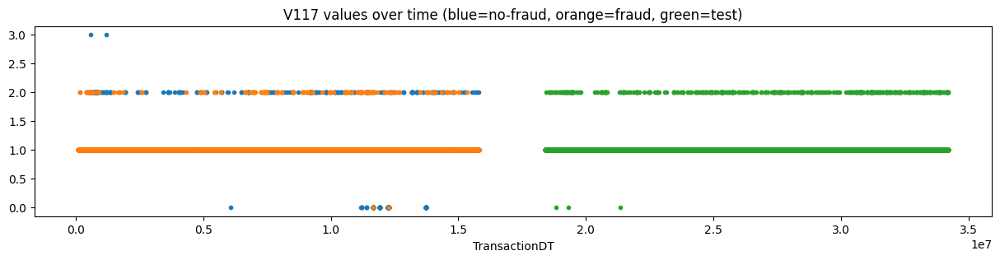

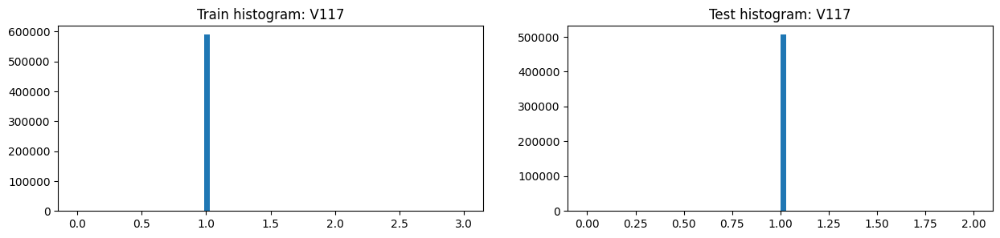

,V117,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.000391,1.009542,1.000060,1.000943,1.000780,1.000984
2,std,0.035238,0.098701,0.030504,0.030892,0.028951,0.031359
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,3.000000,2.000000,3.000000,2.000000,2.000000,2.000000
8,unique values,5.000000,4.000000,5.000000,3.000000,3.000000,2.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V117,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,589499,0.034679,20443,506207.0
1,2.0,476,0.420168,200,481.0
2,-999.0,314,0.054140,17,NaN
3,0.0,249,0.012048,3,3.0
4,3.0,2,0.000000,0,NaN


,V117,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,589499,0.034679,20443,506207.0
1,2.0,476,0.420168,200,481.0
2,-999.0,314,0.054140,17,NaN
3,0.0,249,0.012048,3,3.0
4,3.0,2,0.000000,0,NaN


,Column,Correlation with V117
0,V117,1.000000
1,V119,0.869107
2,V118,0.637366
3,V120,0.592637
4,V107,0.582052
5,V122,0.433578
375,V35,-0.019888
376,D8,-0.027101
377,D9,-0.029683
378,D7,-0.033420


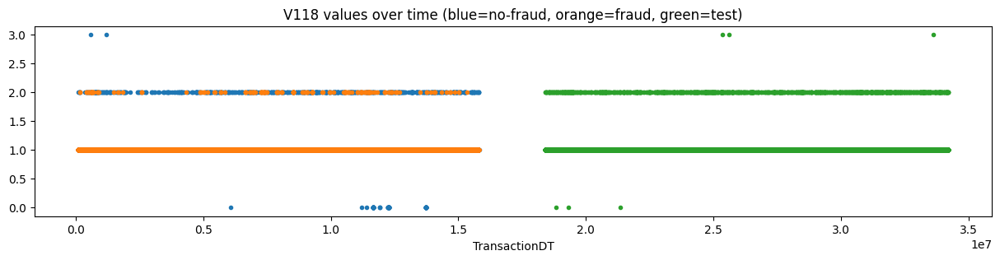

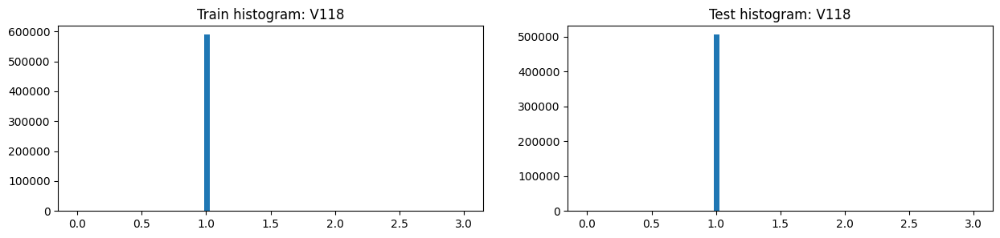

,V118,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.001474,1.010220,1.001157,1.002297,1.002013,1.002368
2,std,0.041011,0.100578,0.037059,0.048121,0.045478,0.048760
3,min,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,3.000000,2.000000,3.000000,3.000000,2.000000,3.000000
8,unique values,5.000000,3.000000,5.000000,4.000000,3.000000,3.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V118,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,589238,0.034680,20435,505524.0
1,2.0,926,0.227862,211,1161.0
2,-999.0,314,0.054140,17,NaN
3,0.0,60,0.000000,0,3.0
4,3.0,2,0.000000,0,3.0


,V118,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,589238,0.034680,20435,505524.0
1,2.0,926,0.227862,211,1161.0
2,-999.0,314,0.054140,17,NaN
3,0.0,60,0.000000,0,3.0
4,3.0,2,0.000000,0,3.0


,Column,Correlation with V118
0,V118,1.000000
1,V119,0.757591
2,V117,0.637366
3,V121,0.447792
4,V122,0.365645
5,V120,0.321347
375,D5,-0.019759
376,D8,-0.027255
377,D9,-0.028924
378,D7,-0.034330


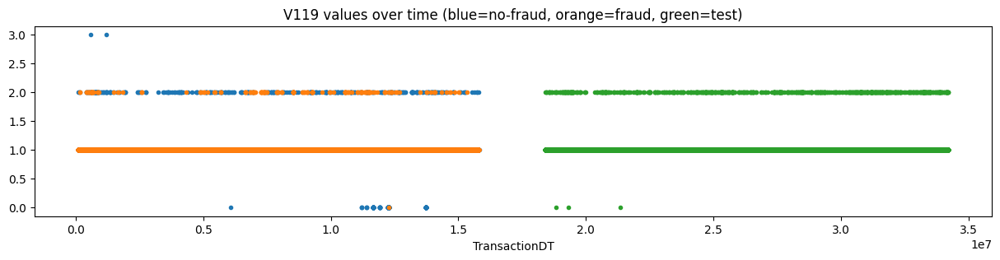

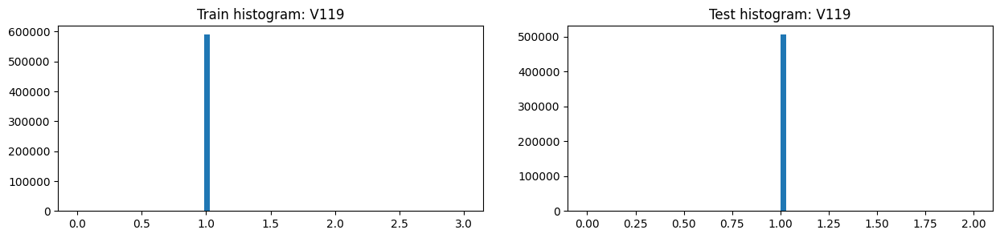

,V119,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.000729,1.009929,1.000395,1.001449,1.001204,1.001510
2,std,0.036392,0.099640,0.031770,0.038188,0.035520,0.038827
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,3.000000,2.000000,3.000000,2.000000,2.000000,2.000000
8,unique values,5.000000,4.000000,5.000000,3.000000,3.000000,2.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V119,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,589450,0.034675,20439,505951.0
1,2.0,600,0.343333,206,737.0
2,-999.0,314,0.054140,17,NaN
3,0.0,174,0.005747,1,3.0
4,3.0,2,0.000000,0,NaN


,V119,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,589450,0.034675,20439,505951.0
1,2.0,600,0.343333,206,737.0
2,-999.0,314,0.054140,17,NaN
3,0.0,174,0.005747,1,3.0
4,3.0,2,0.000000,0,NaN


,Column,Correlation with V119
0,V119,1.000000
1,V117,0.869107
2,V118,0.757591
3,V122,0.521921
4,V120,0.489889
5,V107,0.393413
375,V48,-0.018880
376,D8,-0.027598
377,D9,-0.028140
378,D7,-0.033867


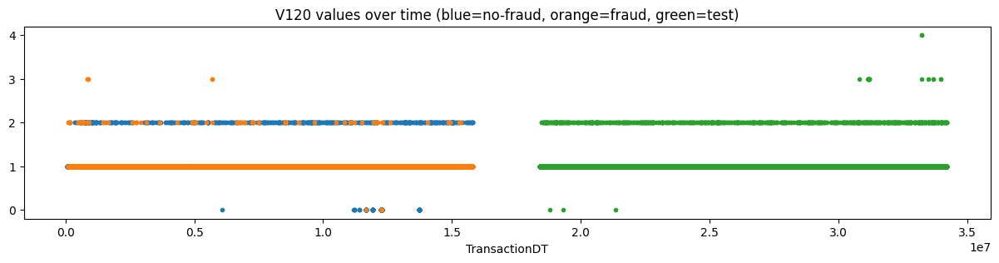

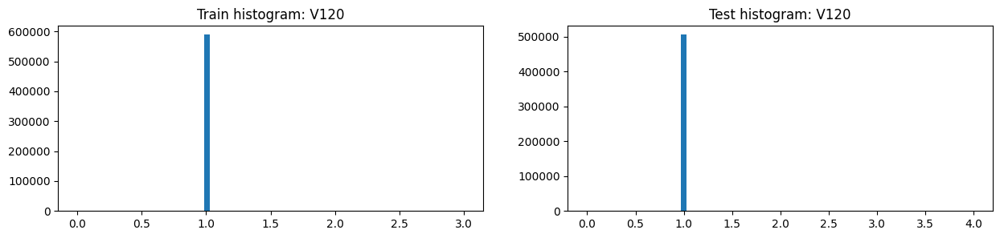

,V120,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.000874,1.005183,1.000718,1.001796,1.001776,1.001801
2,std,0.041684,0.077639,0.039766,0.043536,0.042805,0.043717
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,3.000000,3.000000,2.000000,4.000000,2.000000,4.000000
8,unique values,5.000000,5.000000,4.000000,5.000000,3.000000,4.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V120,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,589218,0.034858,20539,505796.0
1,2.0,753,0.130146,98,873.0
2,-999.0,314,0.054140,17,NaN
3,0.0,249,0.012048,3,3.0
4,3.0,6,1.000000,6,17.0


,V120,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,589218,0.034858,20539,505796.0
1,2.0,753,0.130146,98,873.0
2,-999.0,314,0.054140,17,NaN
3,3.0,6,1.000000,6,17.0
4,0.0,249,0.012048,3,3.0


,Column,Correlation with V120
0,V120,1.000000
1,V122,0.793995
2,V117,0.592637
3,V121,0.507512
4,V107,0.492287
5,V119,0.489889
375,D8,-0.010886
376,D10,-0.011372
377,D5,-0.014989
378,D7,-0.023191


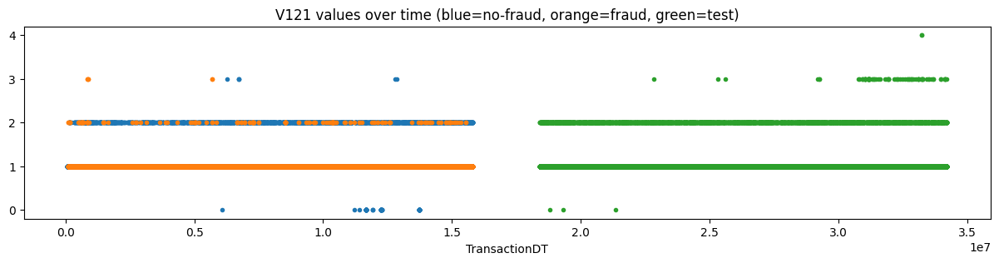

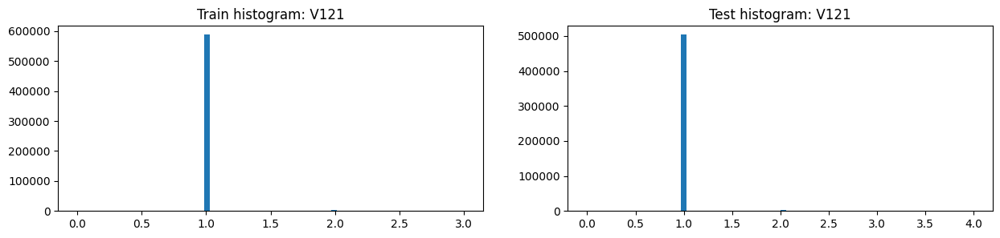

,V121,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.004276,1.008622,1.004119,1.006442,1.007056,1.006288
2,std,0.067097,0.095545,0.065830,0.082192,0.084054,0.081719
3,min,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,3.000000,3.000000,3.000000,4.000000,2.000000,4.000000
8,unique values,5.000000,4.000000,5.000000,5.000000,3.000000,4.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V121,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,587594,0.034844,20474,503506.0
1,2.0,2560,0.064844,166,3099.0
2,-999.0,314,0.054140,17,NaN
3,0.0,60,0.000000,0,3.0
4,3.0,12,0.500000,6,81.0


,V121,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,587594,0.034844,20474,503506.0
1,2.0,2560,0.064844,166,3099.0
2,-999.0,314,0.054140,17,NaN
3,3.0,12,0.500000,6,81.0
4,0.0,60,0.000000,0,3.0


,Column,Correlation with V121
0,V121,1.000000
1,V122,0.667437
2,V120,0.507512
3,V118,0.447792
4,V115,0.377880
5,V119,0.298471
375,V50,-0.019134
376,V302,-0.019387
377,addr2,-0.020232
378,D7,-0.026039


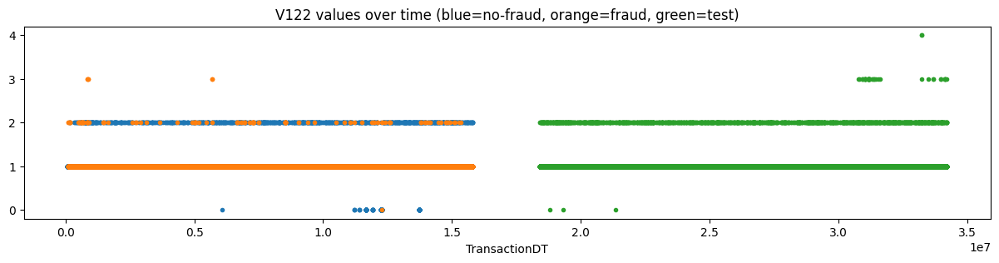

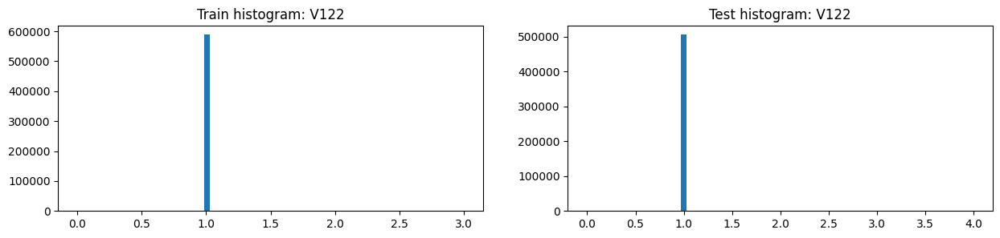

,V122,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.001759,1.006539,1.001585,1.002992,1.003039,1.002980
2,std,0.048636,0.084702,0.046801,0.056395,0.055582,0.056596
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,3.000000,3.000000,2.000000,4.000000,2.000000,4.000000
8,unique values,5.000000,5.000000,4.000000,5.000000,3.000000,4.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V122,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,588846,0.034839,20515,505214.0
1,2.0,1200,0.103333,124,1431.0
2,-999.0,314,0.054140,17,NaN
3,0.0,174,0.005747,1,3.0
4,3.0,6,1.000000,6,41.0


,V122,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,588846,0.034839,20515,505214.0
1,2.0,1200,0.103333,124,1431.0
2,-999.0,314,0.054140,17,NaN
3,3.0,6,1.000000,6,41.0
4,0.0,174,0.005747,1,3.0


,Column,Correlation with V122
0,V122,1.000000
1,V120,0.793995
2,V121,0.667437
3,V119,0.521921
4,V117,0.433578
5,V116,0.381201
375,D8,-0.012053
376,V152,-0.012355
377,D5,-0.021901
378,D7,-0.024767


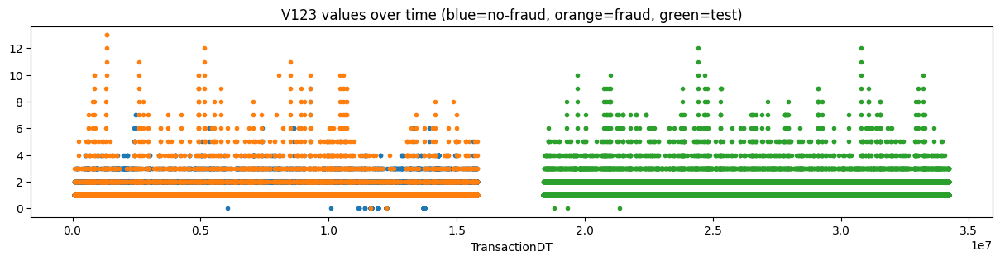

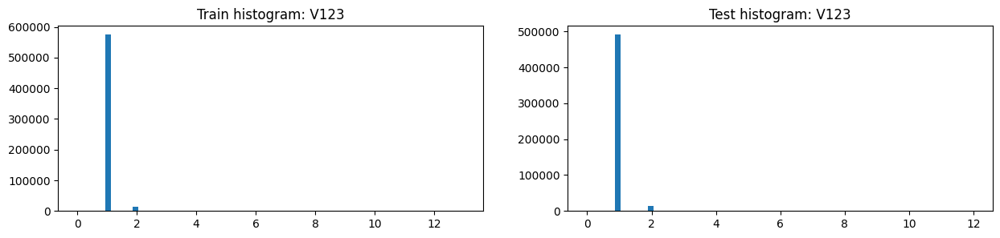

,V123,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.031120,1.196745,1.025117,1.037607,1.042126,1.036477
2,std,0.228134,0.768501,0.177467,0.251355,0.268894,0.246763
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,13.000000,13.000000,9.000000,12.000000,10.000000,12.000000
8,unique values,15.000000,15.000000,11.000000,13.000000,11.000000,12.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V123,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,574712,0.032202,18507,491299.0
1,2.0,13214,0.096791,1279,13272.0
2,3.0,1423,0.284610,405,1370.0
3,4.0,339,0.584071,198,367.0
4,-999.0,314,0.054140,17,NaN
5,0.0,250,0.012000,3,3.0
6,5.0,127,0.850394,108,171.0
7,6.0,65,0.846154,55,92.0
8,7.0,35,0.914286,32,62.0
9,8.0,24,0.958333,23,27.0


,V123,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,574712,0.032202,18507,491299.0
1,2.0,13214,0.096791,1279,13272.0
2,3.0,1423,0.284610,405,1370.0
3,4.0,339,0.584071,198,367.0
4,5.0,127,0.850394,108,171.0
5,6.0,65,0.846154,55,92.0
6,7.0,35,0.914286,32,62.0
7,8.0,24,0.958333,23,27.0
8,-999.0,314,0.054140,17,NaN
9,9.0,17,0.941176,16,18.0


,Column,Correlation with V123
0,V123,1.000000
1,V125,0.819023
2,V124,0.615689
3,V23,0.612617
4,V114,0.582126
5,V24,0.532372
375,V69,-0.046749
376,V90,-0.046825
377,D8,-0.066123
378,D5,-0.072730


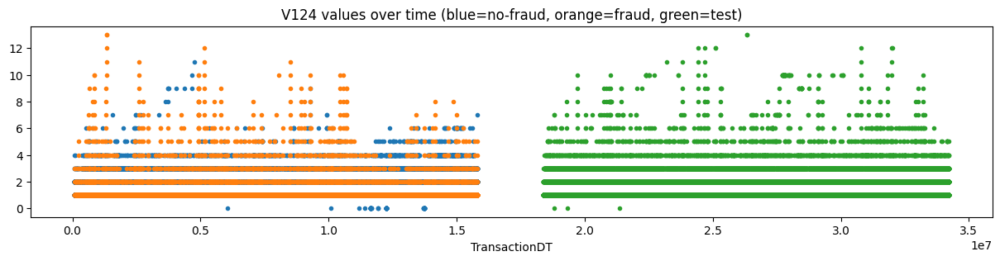

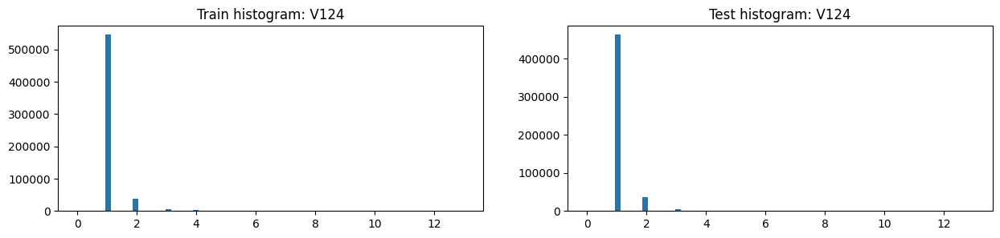

,V124,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.092975,1.243728,1.087510,1.106114,1.117566,1.103251
2,std,0.374103,0.805333,0.347368,0.407922,0.413719,0.406410
3,min,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,13.000000,13.000000,11.000000,13.000000,10.000000,13.000000
8,unique values,15.000000,14.000000,13.000000,14.000000,11.000000,13.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V124,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,546045,0.032580,17790,463461.0
1,2.0,36778,0.048997,1802,36225.0
2,3.0,4856,0.117586,571,5177.0
3,4.0,2004,0.108782,218,1095.0
4,-999.0,314,0.054140,17,NaN
5,5.0,243,0.469136,114,344.0
6,6.0,126,0.468254,59,158.0
7,0.0,61,0.000000,0,3.0
8,7.0,41,0.780488,32,77.0
9,8.0,26,0.884615,23,35.0


,V124,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,546045,0.032580,17790,463461.0
1,2.0,36778,0.048997,1802,36225.0
2,3.0,4856,0.117586,571,5177.0
3,4.0,2004,0.108782,218,1095.0
4,5.0,243,0.469136,114,344.0
5,6.0,126,0.468254,59,158.0
6,7.0,41,0.780488,32,77.0
7,8.0,26,0.884615,23,35.0
8,-999.0,314,0.054140,17,NaN
9,9.0,24,0.708333,17,37.0


,Column,Correlation with V124
0,V124,1.000000
1,V125,0.795594
2,V329,0.736817
3,V330,0.734519
4,V324,0.704544
5,V333,0.697898
375,V149,-0.128816
376,V155,-0.133456
377,V148,-0.137996
378,V154,-0.145820


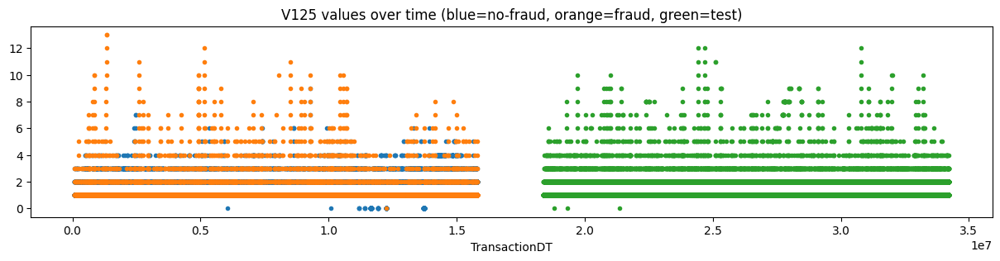

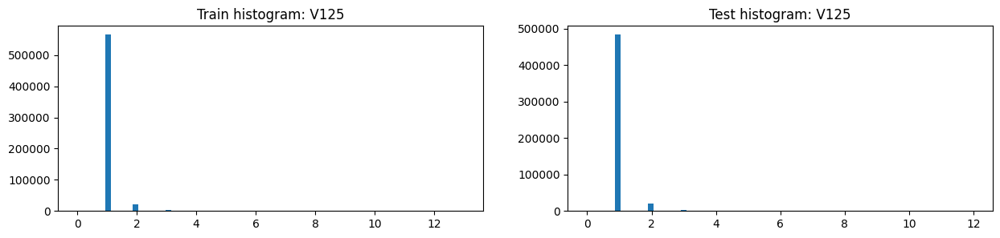

,V125,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,1.050415,1.215151,1.044443,1.056028,1.062770,1.054343
2,std,0.280037,0.781981,0.240997,0.303396,0.316383,0.300038
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,13.000000,13.000000,9.000000,12.000000,10.000000,12.000000
8,unique values,15.000000,15.000000,11.000000,13.000000,11.000000,12.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V125,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,565575,0.032188,18205,483588.0
1,2.0,20819,0.073539,1531,19969.0
2,3.0,2567,0.172575,443,2123.0
3,4.0,774,0.266150,206,510.0
4,-999.0,314,0.054140,17,NaN
5,0.0,175,0.005714,1,3.0
6,5.0,152,0.736842,112,206.0
7,6.0,68,0.838235,57,110.0
8,7.0,35,0.914286,32,73.0
9,8.0,24,0.958333,23,64.0


,V125,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,565575,0.032188,18205,483588.0
1,2.0,20819,0.073539,1531,19969.0
2,3.0,2567,0.172575,443,2123.0
3,4.0,774,0.266150,206,510.0
4,5.0,152,0.736842,112,206.0
5,6.0,68,0.838235,57,110.0
6,7.0,35,0.914286,32,73.0
7,8.0,24,0.958333,23,64.0
8,-999.0,314,0.054140,17,NaN
9,9.0,17,0.941176,16,29.0


,Column,Correlation with V125
0,V125,1.000000
1,V123,0.819023
2,V124,0.795594
3,V330,0.691523
4,V328,0.670547
5,V329,0.643172
375,V155,-0.102506
376,V148,-0.106158
377,V154,-0.112610
378,V153,-0.114595


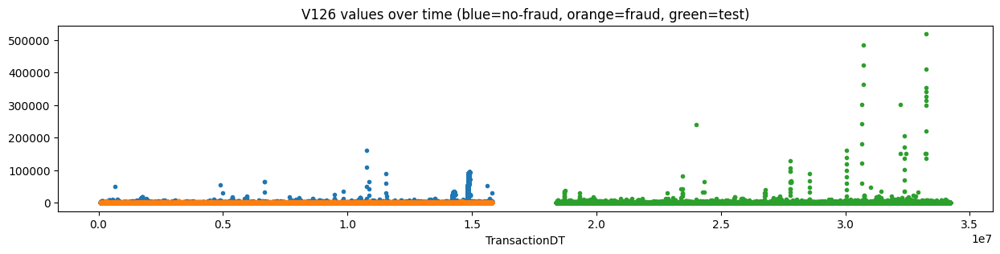

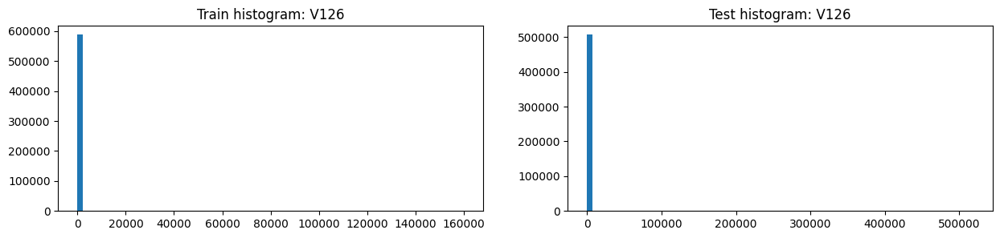

,V126,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,129.979417,86.272554,131.563693,65.612052,53.622632,68.609268
2,std,2346.951681,284.631132,2388.479348,2180.122508,446.098195,2427.214840
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,40.000000,0.000000,0.000000,0.000000,0.000000
7,max,160000.000000,6625.000000,160000.000000,519038.500000,36720.000000,519038.500000
8,unique values,10300.000000,2216.000000,9307.000000,7845.000000,2971.000000,6618.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V126,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,510542,0.028568,14585,436511.0
1,117.000000,3407,0.046082,157,3117.0
2,59.000000,3312,0.037138,123,3104.0
3,100.000000,2248,0.049822,112,1594.0
4,49.000000,1753,0.058756,103,1652.0
5,226.000000,1494,0.062249,93,1460.0
6,107.949997,1475,0.034576,51,1346.0
7,50.000000,1460,0.045890,67,923.0
8,57.950001,1437,0.008351,12,1262.0
9,200.000000,1434,0.065551,94,1295.0


,V126,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,510542,0.028568,14585,436511
1,117.0,3407,0.046082,157,3117
2,59.0,3312,0.037138,123,3104
3,150.0,1185,0.095359,113,794
4,100.0,2248,0.049822,112,1594
5,49.0,1753,0.058756,103,1652
6,300.0,916,0.109170,100,766
7,200.0,1434,0.065551,94,1295
8,226.0,1494,0.062249,93,1460
9,50.0,1460,0.045890,67,923


,Column,Correlation with V126
0,V126,1.000000
1,V331,0.995099
2,V306,0.991851
3,V132,0.988348
4,V211,0.986600
5,V322,0.986342
375,V149,-0.126248
376,V155,-0.130313
377,V148,-0.134724
378,V154,-0.141868


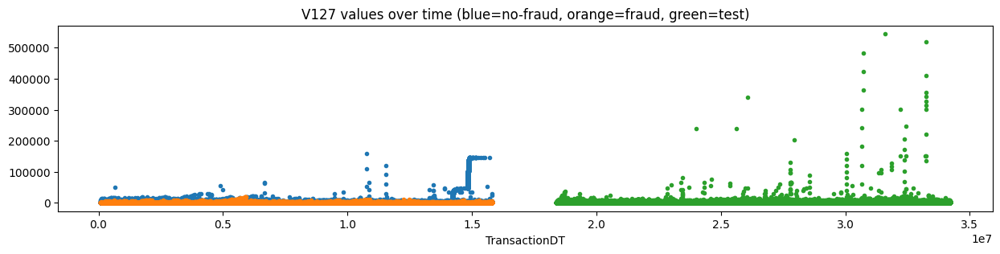

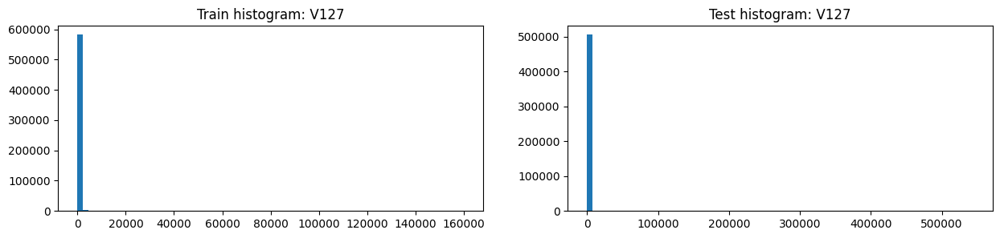

,V127,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,336.611559,278.089451,338.732854,205.845487,200.905252,207.080294
2,std,4238.666949,898.110844,4311.400223,2545.692423,723.014988,2823.117448
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,107.949997,162.579044,107.949997,115.900002,136.000000,108.949997
7,max,160000.000000,19860.000000,160000.000000,544500.000000,36720.000000,544500.000000
8,unique values,24415.000000,3822.000000,23110.000000,18871.000000,8289.000000,16102.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V127,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,366578,0.032743,12003,308455.0
1,107.949997,5850,0.009060,53,4964.0
2,57.950001,5303,0.003960,21,4581.0
3,59.000000,5152,0.019992,103,4702.0
4,117.000000,5134,0.028438,146,4685.0
5,100.000000,3193,0.035077,112,1966.0
6,49.000000,2569,0.027637,71,2331.0
7,50.000000,2247,0.030708,69,1257.0
8,226.000000,2147,0.040056,86,2102.0
9,47.950001,2081,0.001442,3,1777.0


,V127,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,366578,0.032743,12003,308455
1,117.0,5134,0.028438,146,4685
2,150.0,1575,0.071746,113,948
3,100.0,3193,0.035077,112,1966
4,300.0,1139,0.093942,107,869
5,59.0,5152,0.019992,103,4702
6,200.0,1930,0.048705,94,1544
7,226.0,2147,0.040056,86,2102
8,49.0,2569,0.027637,71,2331
9,50.0,2247,0.030708,69,1257


,Column,Correlation with V127
0,V127,1.000000
1,V332,0.996655
2,V323,0.993635
3,V133,0.992261
4,V333,0.989048
5,V128,0.988974
375,V149,-0.139888
376,V155,-0.144416
377,V148,-0.149235
378,V154,-0.157130


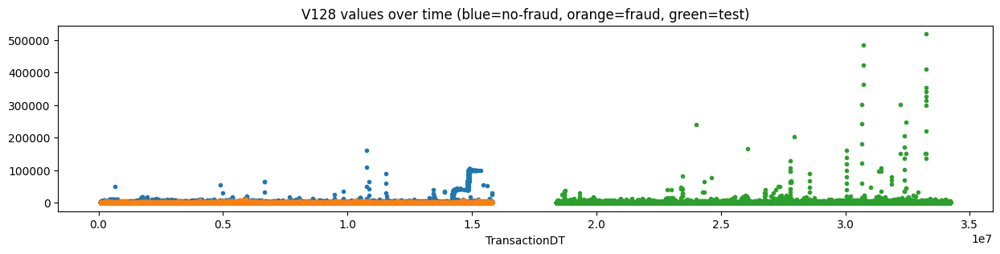

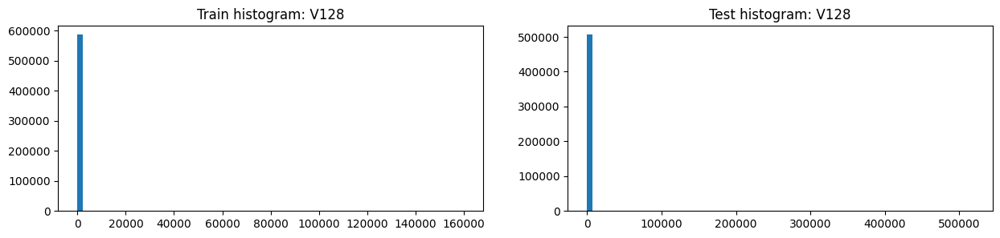

,V128,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,204.094038,173.574554,205.200301,106.361069,94.831101,109.243320
2,std,3010.258774,561.111545,3062.462466,2282.943655,512.652219,2539.497012
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,100.000000,0.000000,0.000000,25.950001,0.000000
7,max,160000.000000,10162.000000,160000.000000,519038.500000,36720.000000,519038.500000
8,unique values,14508.000000,3047.000000,13352.000000,10913.000000,4490.000000,9270.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V128,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,454213,0.028416,12907,385324.0
1,117.000000,5259,0.029663,156,4831.0
2,59.000000,5120,0.023242,119,4893.0
3,57.950001,3345,0.007175,24,2788.0
4,107.949997,2846,0.019677,56,2422.0
5,100.000000,2582,0.043377,112,1796.0
6,49.000000,2579,0.031020,80,2514.0
7,226.000000,2152,0.047398,102,2207.0
8,50.000000,1826,0.040526,74,1157.0
9,39.000000,1787,0.022943,41,1636.0


,V128,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,454213,0.028416,12907,385324
1,117.0,5259,0.029663,156,4831
2,59.0,5120,0.023242,119,4893
3,150.0,1332,0.087838,117,868
4,100.0,2582,0.043377,112,1796
5,300.0,1019,0.105986,108,813
6,226.0,2152,0.047398,102,2207
7,200.0,1590,0.059748,95,1418
8,49.0,2579,0.031020,80,2514
9,50.0,1826,0.040526,74,1157


,Column,Correlation with V128
0,V128,1.000000
1,V333,0.996275
2,V134,0.991355
3,V324,0.990659
4,V332,0.989910
5,V127,0.988974
375,V149,-0.142198
376,V155,-0.146828
377,V148,-0.151733
378,V154,-0.159791


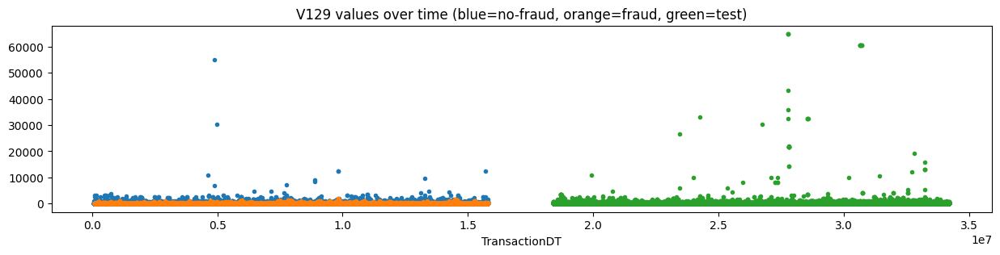

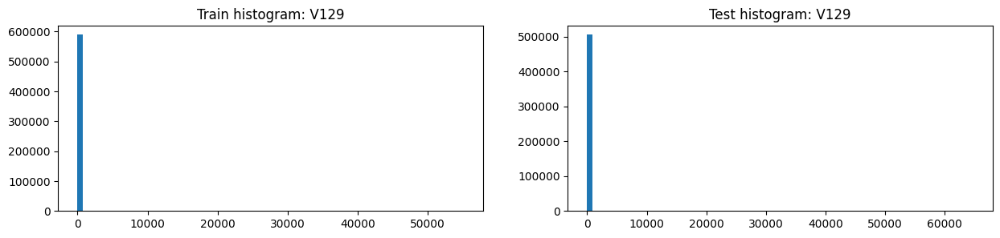

,V129,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,8.768944,16.380528,8.493041,10.658756,8.606915,11.171694
2,std,113.832828,83.478865,114.773011,337.299989,79.590350,375.005509
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,55125.000000,1768.000000,55125.000000,64800.000000,11000.000000,64800.000000
8,unique values,1969.000000,315.000000,1908.000000,1445.000000,615.000000,1261.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V129,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,558622,0.033776,18868,481398.0
1,59.000000,2500,0.044400,111,2175.0
2,117.000000,2316,0.066062,153,2126.0
3,49.000000,1311,0.059497,78,1232.0
4,39.000000,966,0.042443,41,739.0
5,226.000000,882,0.077098,68,818.0
6,107.949997,833,0.060024,50,674.0
7,57.950001,832,0.014423,12,660.0
8,29.000000,829,0.056695,47,664.0
9,77.000000,694,0.074928,52,614.0


,V129,Count in train,Mean target,Sum target (desc),Count in test
0,0.000000,558622,0.033776,18868,481398
1,117.000000,2316,0.066062,153,2126
2,59.000000,2500,0.044400,111,2175
3,49.000000,1311,0.059497,78,1232
4,226.000000,882,0.077098,68,818
5,77.000000,694,0.074928,52,614
6,107.949997,833,0.060024,50,674
7,29.000000,829,0.056695,47,664
8,335.000000,438,0.105023,46,388
9,39.000000,966,0.042443,41,739


,Column,Correlation with V129
0,V129,1.000000
1,V269,0.961926
2,V266,0.960216
3,V206,0.956912
4,V334,0.949515
5,V309,0.920793
375,V51,-0.039026
376,V50,-0.039149
377,V42,-0.039974
378,D3,-0.042200


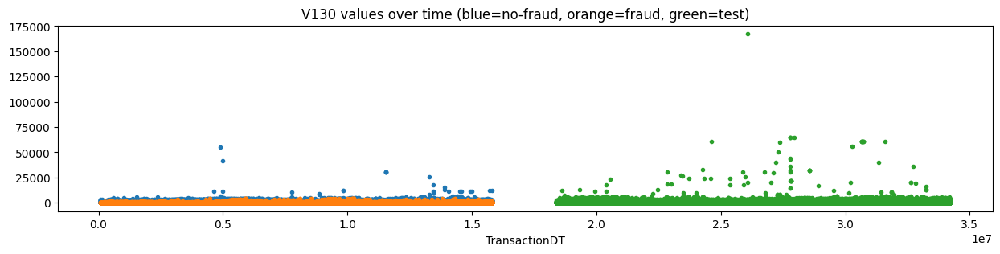

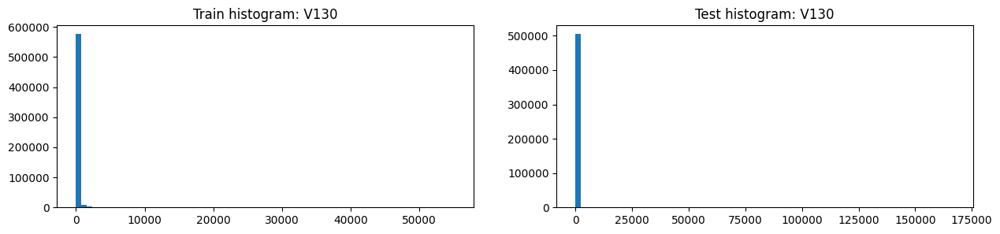

,V130,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,92.165849,97.270605,91.980813,107.366682,110.638006,106.548826
2,std,315.960485,328.762971,315.485415,583.515717,344.808792,629.195217
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,59.000000,0.000000,59.000000,65.145901,91.900002,59.000000
7,max,55125.000000,4350.000000,55125.000000,167200.000000,23200.000000,167200.000000
8,unique values,12333.000000,1174.000000,12177.000000,10195.000000,4883.000000,9006.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V130,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,403766,0.038938,15722,344117.0
1,107.949997,5902,0.010674,63,5012.0
2,59.000000,5410,0.025139,136,4919.0
3,117.000000,5287,0.039531,209,4828.0
4,57.950001,5264,0.004369,23,4666.0
5,49.000000,2775,0.046126,128,2488.0
6,226.000000,2197,0.045972,101,2102.0
7,47.950001,2095,0.001432,3,1775.0
8,35.950001,1882,0.005313,10,1715.0
9,39.000000,1808,0.027102,49,1587.0


,V130,Count in train,Mean target,Sum target (desc),Count in test
0,0.000000,403766,0.038938,15722,344117
1,117.000000,5287,0.039531,209,4828
2,59.000000,5410,0.025139,136,4919
3,49.000000,2775,0.046126,128,2488
4,226.000000,2197,0.045972,101,2102
5,107.949997,5902,0.010674,63,5012
6,445.000000,436,0.144495,63,387
7,97.000000,867,0.059977,52,840
8,335.000000,999,0.051051,51,894
9,77.000000,1266,0.040284,51,1082


,Column,Correlation with V130
0,V130,1.000000
1,V310,0.841170
2,V335,0.801644
3,V269,0.787088
4,V266,0.784825
5,V131,0.749282
375,V154,-0.135600
376,V153,-0.138564
377,D3,-0.138598
378,V50,-0.141513


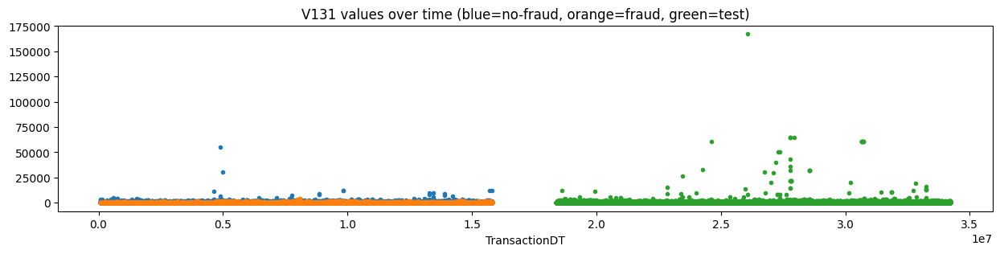

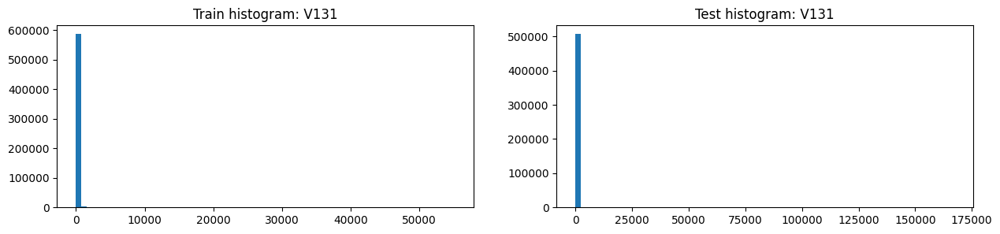

,V131,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,31.133302,52.274012,30.366999,35.442398,34.134698,35.769238
2,std,161.161258,188.145066,160.045517,464.100478,148.744291,513.521975
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,55125.000000,3981.000000,55125.000000,167200.000000,12500.000000,167200.000000
8,unique values,4445.000000,683.000000,4347.000000,3492.000000,1683.000000,3099.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V131,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,496523,0.033775,16770,425891.0
1,59.000000,5243,0.029372,154,4849.0
2,117.000000,5162,0.042038,217,4734.0
3,57.950001,2958,0.008114,24,2388.0
4,49.000000,2611,0.049023,128,2527.0
5,107.949997,2385,0.025157,60,1935.0
6,226.000000,2024,0.044466,90,2060.0
7,39.000000,1905,0.032021,61,1603.0
8,29.000000,1582,0.024652,39,1333.0
9,171.000000,1321,0.039364,52,1253.0


,V131,Count in train,Mean target,Sum target (desc),Count in test
0,0.000000,496523,0.033775,16770,425891
1,117.000000,5162,0.042038,217,4734
2,59.000000,5243,0.029372,154,4849
3,49.000000,2611,0.049023,128,2527
4,226.000000,2024,0.044466,90,2060
5,97.000000,910,0.074725,68,839
6,445.000000,406,0.157635,64,430
7,39.000000,1905,0.032021,61,1603
8,107.949997,2385,0.025157,60,1935
9,77.000000,1288,0.043478,56,1195


,Column,Correlation with V131
0,V131,1.000000
1,V336,0.923727
2,V269,0.911861
3,V266,0.909926
4,V312,0.870205
5,V335,0.848055
375,V50,-0.094614
376,V11,-0.100521
377,D3,-0.106850
378,V10,-0.111659


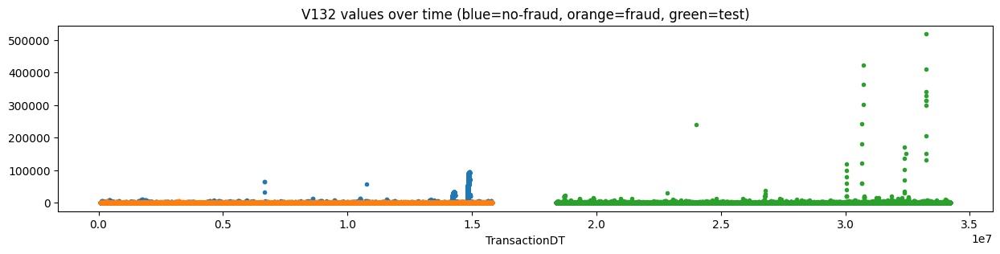

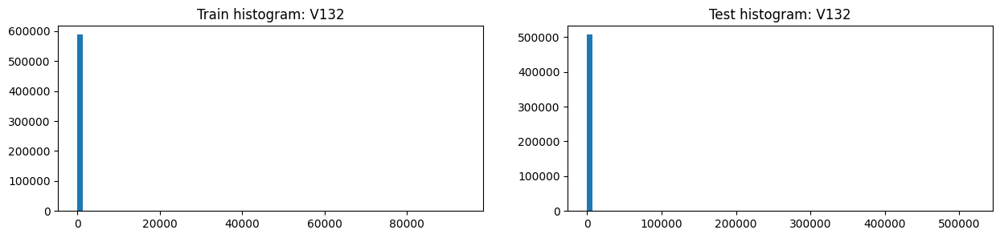

,V132,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,103.513188,52.771340,105.352467,30.273769,20.706949,32.665416
2,std,2266.106140,218.583926,2306.414902,1863.563032,285.402511,2078.627364
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,93736.000000,6098.000000,93736.000000,519038.500000,23280.000000,519038.500000
8,unique values,6561.000000,1736.000000,5645.000000,4444.000000,1618.000000,3771.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V132,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,556214,0.029785,16567,481543.0
1,117.0,1453,0.072953,106,1031.0
2,59.0,1281,0.061671,79,851.0
3,100.0,902,0.065410,59,480.0
4,49.0,741,0.091768,68,470.0
5,226.0,664,0.070783,47,506.0
6,50.0,641,0.063963,41,304.0
7,200.0,566,0.091873,52,437.0
8,150.0,546,0.139194,76,329.0
9,171.0,487,0.078029,38,322.0


,V132,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,556214,0.029785,16567,481543
1,117.0,1453,0.072953,106,1031
2,59.0,1281,0.061671,79,851
3,150.0,546,0.139194,76,329
4,49.0,741,0.091768,68,470
5,100.0,902,0.065410,59,480
6,300.0,411,0.138686,57,265
7,200.0,566,0.091873,52,437
8,226.0,664,0.070783,47,506
9,994.0,63,0.650794,41,30


,Column,Correlation with V132
0,V132,1.000000
1,V322,0.997984
2,V316,0.997222
3,V101,0.995637
4,V95,0.995258
5,V293,0.994567
375,V149,-0.125776
376,V155,-0.129831
377,V148,-0.134155
378,V154,-0.141360


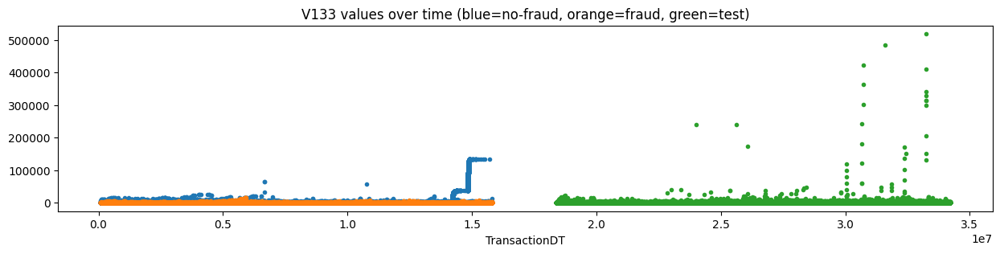

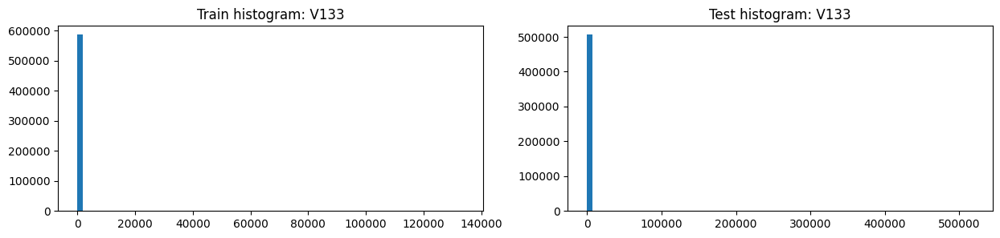

,V133,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,204.889160,141.773367,207.176966,56.926002,45.874350,59.688796
2,std,3796.316755,596.435191,3862.820432,2063.254734,378.233633,2299.015396
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,23.422851,0.000000,0.000000,0.000000,0.000000
7,max,133915.000000,15607.000000,133915.000000,519038.500000,23280.000000,519038.500000
8,unique values,9950.000000,2403.000000,8812.000000,6586.000000,2622.000000,5495.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V133,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,535961,0.028319,15178,467675.0
1,117.0,1888,0.056144,106,1326.0
2,59.0,1642,0.054202,89,1098.0
3,100.0,963,0.067497,65,578.0
4,226.0,869,0.056387,49,685.0
5,49.0,839,0.052443,44,606.0
6,50.0,700,0.060000,42,355.0
7,171.0,621,0.078905,49,431.0
8,200.0,611,0.088380,54,468.0
9,150.0,592,0.133446,79,363.0


,V133,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,535961,0.028319,15178,467675
1,117.0,1888,0.056144,106,1326
2,59.0,1642,0.054202,89,1098
3,150.0,592,0.133446,79,363
4,100.0,963,0.067497,65,578
5,300.0,461,0.138829,64,297
6,335.0,524,0.112595,59,342
7,200.0,611,0.088380,54,468
8,171.0,621,0.078905,49,431
9,226.0,869,0.056387,49,685


,Column,Correlation with V133
0,V133,1.000000
1,V323,0.997651
2,V332,0.996004
3,V102,0.995615
4,V96,0.992326
5,V127,0.992261
375,V149,-0.136582
376,V155,-0.141006
377,V148,-0.145665
378,V154,-0.153453


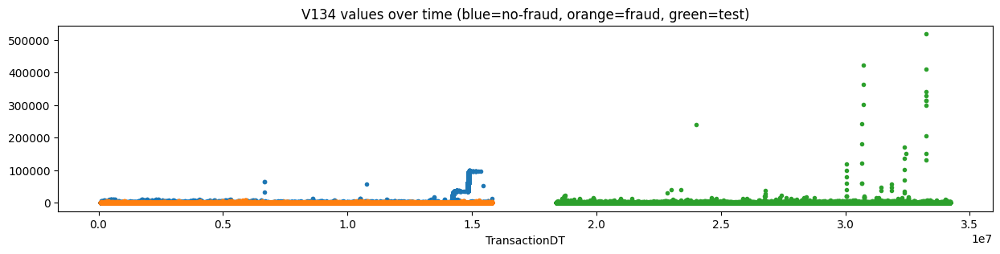

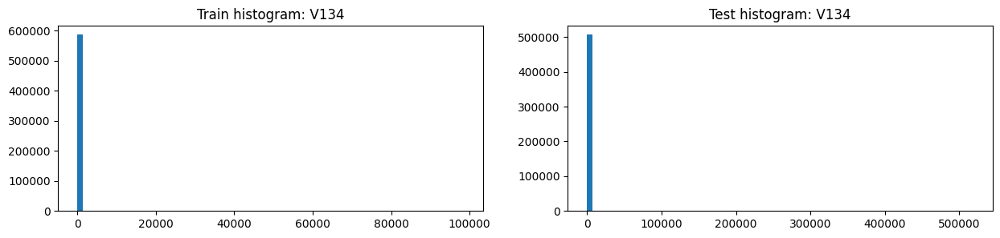

,V134,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,145.972328,94.821907,147.826416,39.334035,30.018903,41.662738
2,std,2772.986817,401.688406,2821.743297,1876.708561,312.857331,2092.378249
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,98476.000000,8451.000000,98476.000000,519038.500000,23280.000000,519038.500000
8,unique values,8179.000000,2123.000000,7128.000000,5445.000000,2064.000000,4612.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V134,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,547743,0.028791,15770,475771.0
1,117.0,1654,0.058646,97,1127.0
2,59.0,1397,0.062992,88,913.0
3,100.0,930,0.065591,61,514.0
4,49.0,759,0.068511,52,517.0
5,226.0,752,0.065160,49,555.0
6,50.0,661,0.065053,43,336.0
7,200.0,586,0.090444,53,453.0
8,150.0,575,0.137391,79,358.0
9,171.0,534,0.078652,42,367.0


,V134,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,547743,0.028791,15770,475771
1,117.0,1654,0.058646,97,1127
2,59.0,1397,0.062992,88,913
3,150.0,575,0.137391,79,358
4,300.0,461,0.134490,62,287
5,100.0,930,0.065591,61,514
6,200.0,586,0.090444,53,453
7,49.0,759,0.068511,52,517
8,226.0,752,0.065160,49,555
9,77.0,471,0.095541,45,349


,Column,Correlation with V134
0,V134,1.000000
1,V324,0.997303
2,V103,0.995735
3,V323,0.994399
4,V97,0.994022
5,V333,0.993521
375,V149,-0.140454
376,V155,-0.145034
377,V148,-0.149814
378,V154,-0.157863


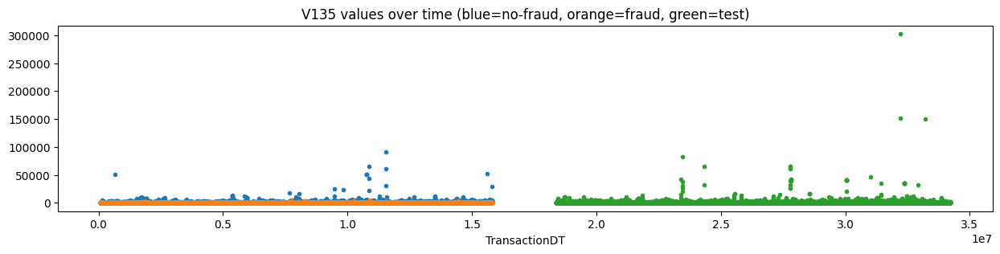

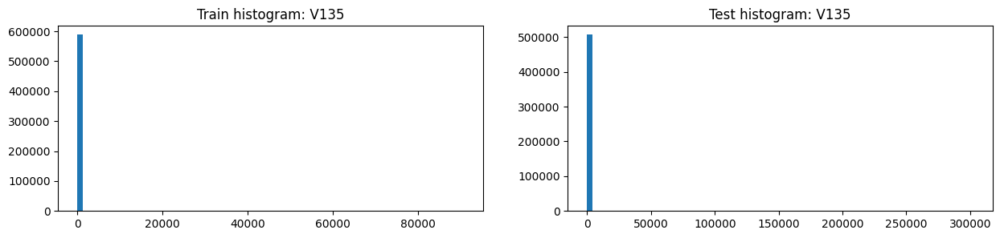

,V135,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,17.250132,16.823745,17.265588,24.233004,23.211534,24.488314
2,std,293.847563,116.586376,298.301160,661.652798,224.936129,731.150560
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,90750.000000,4528.899902,90750.000000,302500.000000,10000.000000,302500.000000
8,unique values,3725.000000,404.000000,3582.000000,3871.000000,1389.000000,3240.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V135,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,563527,0.034220,19284,478742.0
1,100.000000,1206,0.037313,45,1015.0
2,1165.000000,870,0.000000,0,NaN
3,117.000000,839,0.040524,34,896.0
4,200.000000,807,0.058240,47,841.0
5,59.000000,691,0.031838,22,907.0
6,50.000000,616,0.064935,40,500.0
7,150.000000,597,0.082077,49,476.0
8,107.949997,577,0.008666,5,679.0
9,57.950001,521,0.001919,1,653.0


,V135,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,563527,0.034220,19284,478742
1,300.0,520,0.121154,63,478
2,150.0,597,0.082077,49,476
3,200.0,807,0.058240,47,841
4,100.0,1206,0.037313,45,1015
5,50.0,616,0.064935,40,500
6,117.0,839,0.040524,34,896
7,226.0,458,0.063319,29,556
8,49.0,403,0.057072,23,460
9,335.0,319,0.068966,22,340


,Column,Correlation with V135
0,V135,1.000000
1,V137,0.913348
2,V276,0.791458
3,V136,0.760097
4,V278,0.759863
5,V319,0.744056
375,V148,-0.038853
376,V250,-0.040014
377,V154,-0.040132
378,V153,-0.041784


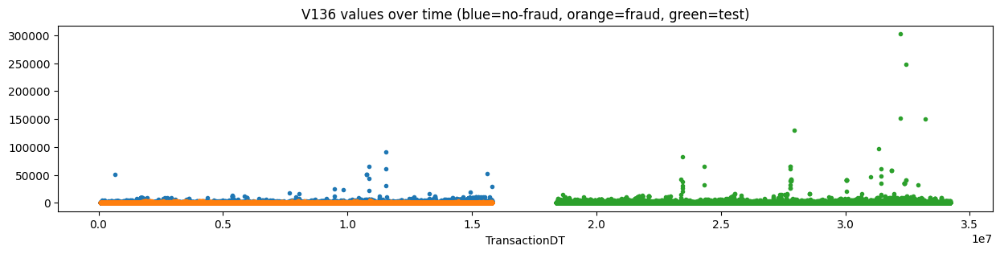

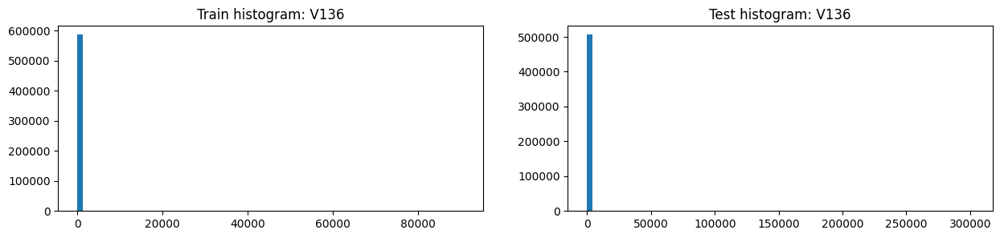

,V136,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,38.821196,38.720929,38.824830,41.052809,43.113217,40.537602
2,std,451.808411,221.912050,457.979479,833.083599,340.438225,915.728936
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,90750.000000,4528.899902,90750.000000,302500.000000,15032.370117,302500.000000
8,unique values,4853.000000,545.000000,4674.000000,5158.000000,1953.000000,4238.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V136,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,547750,0.033855,18544,460547.0
1,100.000000,1343,0.048399,65,1083.0
2,117.000000,1311,0.050343,66,1491.0
3,59.000000,1197,0.038429,46,1620.0
4,107.949997,968,0.012397,12,1185.0
5,57.950001,925,0.002162,2,1227.0
6,7709.000000,871,0.000000,0,NaN
7,200.000000,866,0.053118,46,879.0
8,226.000000,750,0.046667,35,840.0
9,50.000000,745,0.053691,40,578.0


,V136,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,547750,0.033855,18544,460547
1,300.0,565,0.122124,69,504
2,117.0,1311,0.050343,66,1491
3,100.0,1343,0.048399,65,1083
4,150.0,642,0.080997,52,499
5,59.0,1197,0.038429,46,1620
6,200.0,866,0.053118,46,879
7,50.0,745,0.053691,40,578
8,226.0,750,0.046667,35,840
9,49.0,680,0.051471,35,784


,Column,Correlation with V136
0,V136,1.000000
1,V137,0.934824
2,V320,0.854772
3,V338,0.854639
4,V333,0.790250
5,V329,0.781943
375,V149,-0.122460
376,V155,-0.126634
377,V148,-0.131071
378,V154,-0.137406


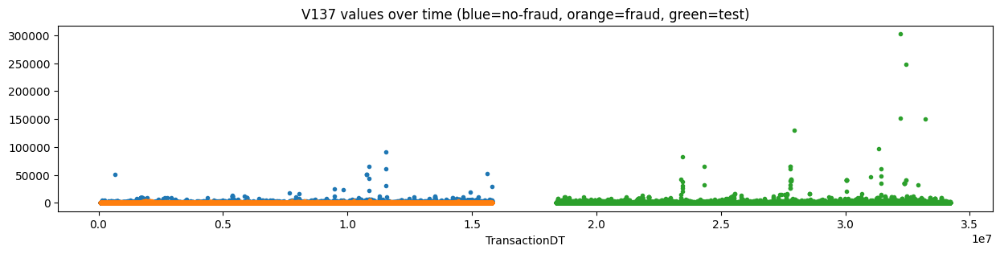

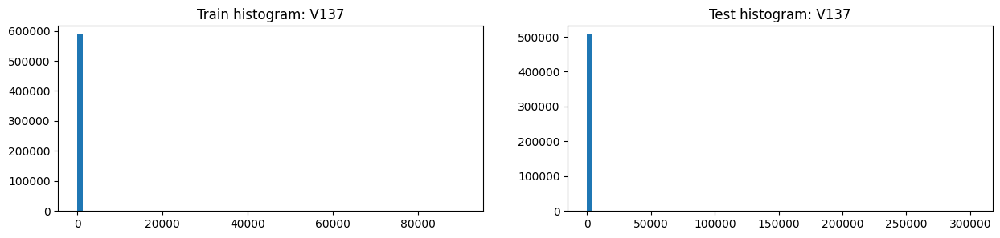

,V137,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590226.000000,20646.000000,569580.000000,506691.000000,101339.000000,405353.000000
1,mean,26.365090,26.155054,26.372703,31.126621,29.537549,31.523815
2,std,348.332714,160.145334,353.276445,804.012468,247.921189,890.324685
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,90750.000000,4528.899902,90750.000000,302500.000000,10000.000000,302500.000000
8,unique values,4253.000000,481.000000,4090.000000,4429.000000,1607.000000,3683.000000
9,NaNs,314.000000,17.000000,297.000000,0.000000,0.000000,0.000000


,V137,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,558074,0.033908,18923,472971.0
1,100.000000,1275,0.037647,48,1045.0
2,117.000000,1050,0.052381,55,1112.0
3,59.000000,896,0.035714,32,1128.0
4,200.000000,818,0.056235,46,858.0
5,107.949997,677,0.008863,6,776.0
6,50.000000,661,0.065053,43,534.0
7,150.000000,628,0.078025,49,491.0
8,57.950001,607,0.004942,3,779.0
9,226.000000,601,0.053245,32,652.0


,V137,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,558074,0.033908,18923,472971
1,300.0,541,0.121996,66,494
2,117.0,1050,0.052381,55,1112
3,150.0,628,0.078025,49,491
4,100.0,1275,0.037647,48,1045
5,200.0,818,0.056235,46,858
6,50.0,661,0.065053,43,534
7,59.0,896,0.035714,32,1128
8,226.0,601,0.053245,32,652
9,335.0,401,0.069825,28,402


,Column,Correlation with V137
0,V137,1.000000
1,V136,0.934824
2,V135,0.913348
3,V321,0.797009
4,V320,0.788104
5,V278,0.781089
375,V250,-0.093736
376,V155,-0.095240
377,V148,-0.098707
378,V154,-0.103178


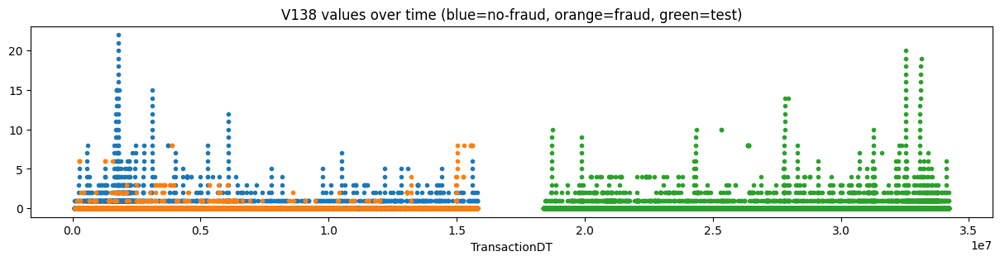

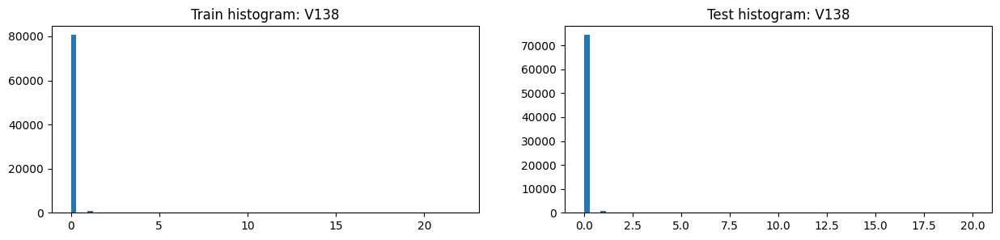

,V138,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81945.000000,3650.000000,78295.000000,75785.000000,8839.000000,66946.000000
1,mean,0.036439,0.121096,0.032492,0.038279,0.053060,0.036328
2,std,0.428490,0.659371,0.414186,0.421249,0.389689,0.425206
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,22.000000,8.000000,22.000000,20.000000,10.000000,20.000000
8,unique values,24.000000,10.000000,24.000000,22.000000,12.000000,22.000000
9,NaNs,508595.000000,17013.000000,491582.000000,430906.000000,92500.000000,338407.000000


,V138,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508595,0.033451,17013,430906.0
1,0.0,80610,0.042712,3443,74360.0
2,1.0,811,0.139334,113,909.0
3,2.0,195,0.215385,42,247.0
4,3.0,117,0.213675,25,84.0
5,4.0,75,0.080000,6,76.0
6,5.0,31,0.032258,1,23.0
7,6.0,28,0.321429,9,17.0
8,8.0,23,0.434783,10,18.0
9,7.0,16,0.062500,1,12.0


,V138,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508595,0.033451,17013,430906
1,0.0,80610,0.042712,3443,74360
2,1.0,811,0.139334,113,909
3,2.0,195,0.215385,42,247
4,3.0,117,0.213675,25,84
5,8.0,23,0.434783,10,18
6,6.0,28,0.321429,9,17
7,4.0,75,0.080000,6,76
8,5.0,31,0.032258,1,23
9,7.0,16,0.062500,1,12


,Column,Correlation with V138
0,V138,1.000000
1,V161,0.579542
2,V163,0.560321
3,V169,0.534889
4,V141,0.526152
5,V162,0.518303
327,D15,-0.056016
328,D7,-0.058815
329,D6,-0.086598
330,D5,-0.094729


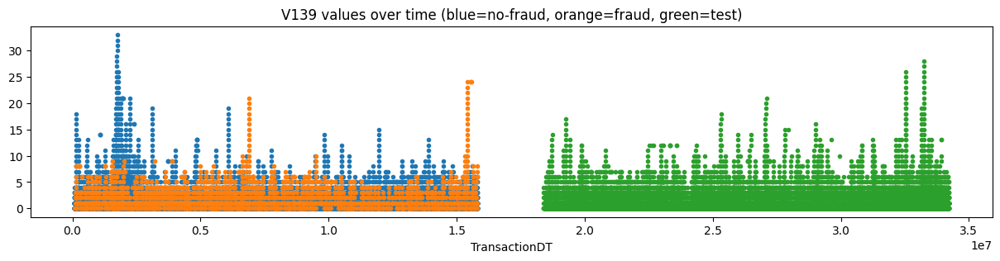

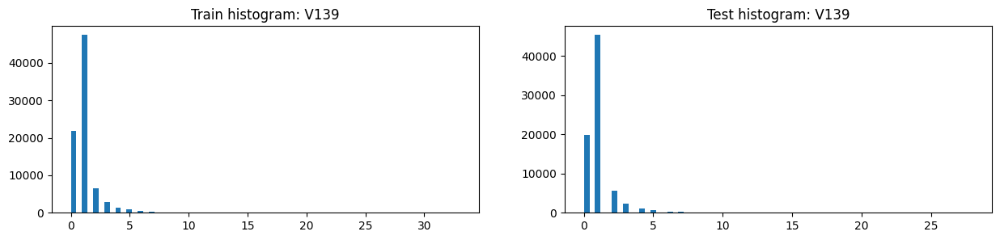

,V139,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81945.000000,3650.000000,78295.000000,75785.000000,8839.000000,66946.000000
1,mean,1.073915,1.985753,1.031407,1.043254,1.165403,1.027126
2,std,1.333924,2.231422,1.260822,1.244900,1.306510,1.235644
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,3.000000,1.000000,1.000000,1.000000,1.000000
7,max,33.000000,24.000000,33.000000,28.000000,17.000000,28.000000
8,unique values,35.000000,26.000000,35.000000,30.000000,19.000000,30.000000
9,NaNs,508595.000000,17013.000000,491582.000000,430906.000000,92500.000000,338407.000000


,V139,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508595,0.033451,17013,430906.0
1,1.0,47430,0.028062,1331,45305.0
2,0.0,21848,0.030026,656,19844.0
3,2.0,6522,0.103036,672,5649.0
4,3.0,2793,0.144289,403,2276.0
5,4.0,1455,0.169759,247,1113.0
6,5.0,868,0.162442,141,692.0
7,6.0,392,0.227041,89,299.0
8,7.0,196,0.214286,42,192.0
9,8.0,113,0.212389,24,103.0


,V139,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508595,0.033451,17013,430906
1,1.0,47430,0.028062,1331,45305
2,2.0,6522,0.103036,672,5649
3,0.0,21848,0.030026,656,19844
4,3.0,2793,0.144289,403,2276
5,4.0,1455,0.169759,247,1113
6,5.0,868,0.162442,141,692
7,6.0,392,0.227041,89,299
8,7.0,196,0.214286,42,192
9,8.0,113,0.212389,24,103


,Column,Correlation with V139
0,V139,1.000000
1,V140,0.945770
2,V157,0.706701
3,V158,0.678448
4,V146,0.666175
5,V282,0.628419
327,V160,-0.268757
328,V151,-0.282841
329,D5,-0.307289
330,V152,-0.309434


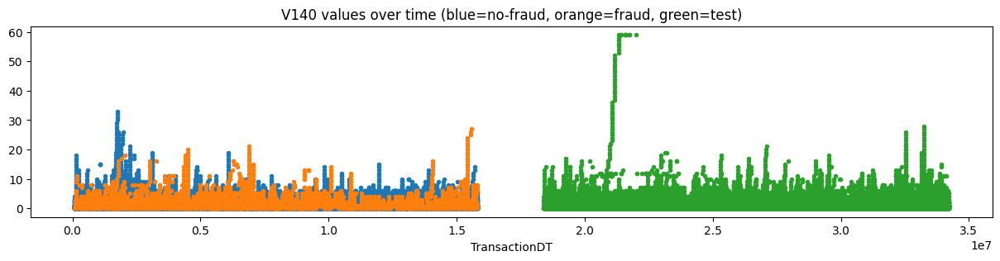

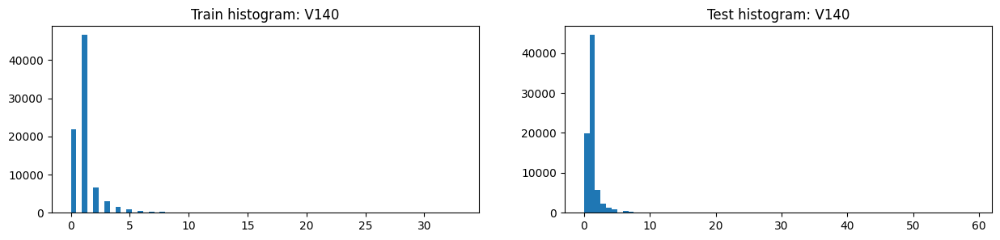

,V140,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81945.000000,3650.000000,78295.000000,75785.000000,8839.000000,66946.000000
1,mean,1.125267,2.464110,1.062852,1.126305,1.514425,1.075060
2,std,1.467850,2.947508,1.327652,1.795401,3.603572,1.382821
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
5,50%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,3.000000,1.000000,1.000000,1.000000,1.000000
7,max,33.000000,27.000000,33.000000,59.000000,59.000000,59.000000
8,unique values,35.000000,29.000000,35.000000,61.000000,61.000000,31.000000
9,NaNs,508595.000000,17013.000000,491582.000000,430906.000000,92500.000000,338407.000000


,V140,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508595,0.033451,17013,430906
1,1.0,46598,0.024937,1162,44496
2,0.0,21825,0.029828,651,19817
3,2.0,6650,0.094436,628,5772
4,3.0,2920,0.135274,395,2308
5,4.0,1580,0.168354,266,1271
6,5.0,898,0.201559,181,770
7,6.0,561,0.197861,111,392
8,7.0,267,0.202247,54,259
9,8.0,167,0.299401,50,157


,V140,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508595,0.033451,17013,430906
1,1.0,46598,0.024937,1162,44496
2,0.0,21825,0.029828,651,19817
3,2.0,6650,0.094436,628,5772
4,3.0,2920,0.135274,395,2308
5,4.0,1580,0.168354,266,1271
6,5.0,898,0.201559,181,770
7,6.0,561,0.197861,111,392
8,7.0,267,0.202247,54,259
9,8.0,167,0.299401,50,157


,Column,Correlation with V140
0,V140,1.000000
1,V139,0.945770
2,V158,0.715031
3,V147,0.683912
4,V157,0.674558
5,V146,0.636298
327,V160,-0.255884
328,V151,-0.269165
329,V152,-0.293987
330,D5,-0.322888


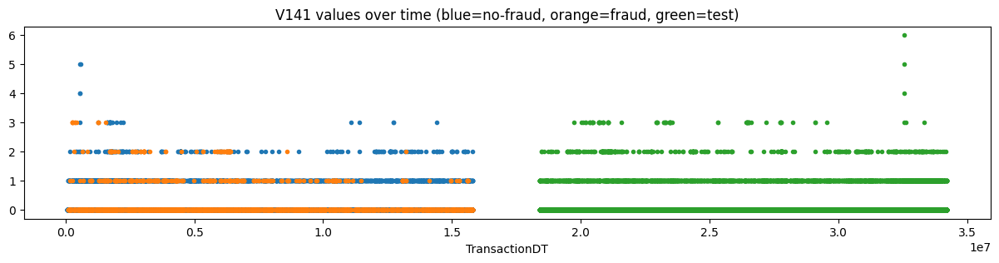

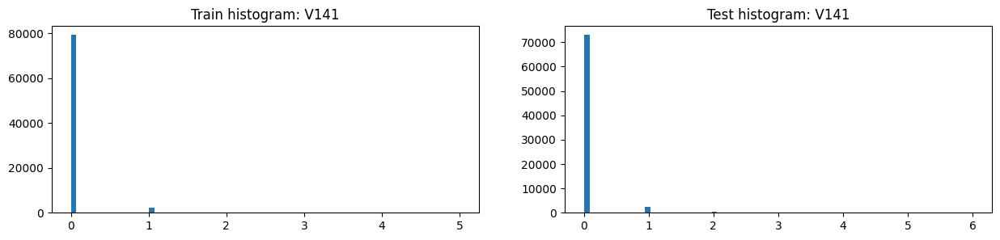

,V141,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81945.000000,3650.000000,78295.000000,75785.000000,8839.000000,66946.000000
1,mean,0.037696,0.123014,0.033719,0.043676,0.081570,0.038673
2,std,0.215133,0.403386,0.201249,0.239126,0.348953,0.220093
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,5.000000,3.000000,5.000000,6.000000,3.000000,6.000000
8,unique values,7.000000,5.000000,7.000000,8.000000,5.000000,8.000000
9,NaNs,508595.000000,17013.000000,491582.000000,430906.000000,92500.000000,338407.000000


,V141,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508595,0.033451,17013,430906
1,0.0,79211,0.041535,3290,72971
2,1.0,2426,0.116241,282,2396
3,2.0,267,0.250936,67,346
4,3.0,37,0.297297,11,69
5,4.0,2,0.000000,0,1
6,5.0,2,0.000000,0,1


,V141,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508595,0.033451,17013,430906
1,0.0,79211,0.041535,3290,72971
2,1.0,2426,0.116241,282,2396
3,2.0,267,0.250936,67,346
4,3.0,37,0.297297,11,69
5,4.0,2,0.000000,0,1
6,5.0,2,0.000000,0,1


,Column,Correlation with V141
0,V141,1.000000
1,V142,0.877733
2,V162,0.543292
3,V138,0.526152
4,V163,0.523593
5,V161,0.510993
327,D15,-0.103033
328,D7,-0.113244
329,D5,-0.165128
330,D6,-0.184621


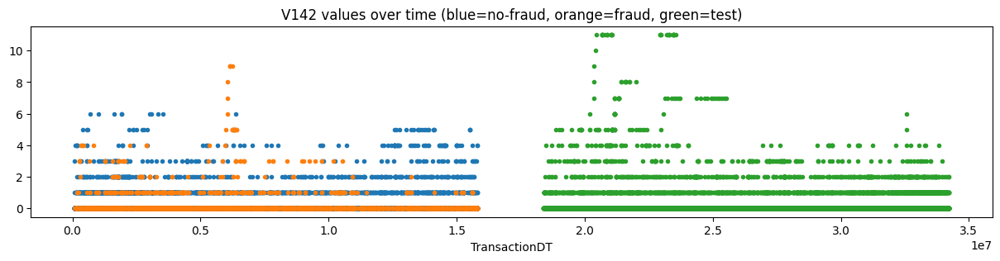

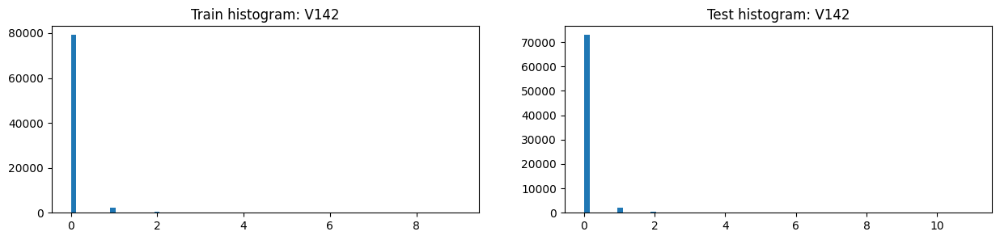

,V142,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81945.000000,3650.000000,78295.000000,75785.000000,8839.000000,66946.000000
1,mean,0.048581,0.165479,0.043132,0.062862,0.148999,0.051489
2,std,0.313888,0.655113,0.287141,0.432052,0.811546,0.351081
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,9.000000,9.000000,6.000000,11.000000,11.000000,11.000000
8,unique values,11.000000,11.000000,8.000000,13.000000,13.000000,11.000000
9,NaNs,508595.000000,17013.000000,491582.000000,430906.000000,92500.000000,338407.000000


,V142,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508595,0.033451,17013,430906
1,0.0,79152,0.041477,3283,72901
2,1.0,2161,0.122166,264,2047
3,2.0,323,0.117647,38,447
4,3.0,154,0.240260,37,164
5,4.0,95,0.094737,9,96
6,5.0,43,0.279070,12,45
7,6.0,11,0.090909,1,12
8,9.0,4,1.000000,4,1
9,7.0,1,1.000000,1,30


,V142,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508595,0.033451,17013,430906
1,0.0,79152,0.041477,3283,72901
2,1.0,2161,0.122166,264,2047
3,2.0,323,0.117647,38,447
4,3.0,154,0.240260,37,164
5,5.0,43,0.279070,12,45
6,4.0,95,0.094737,9,96
7,9.0,4,1.000000,4,1
8,6.0,11,0.090909,1,12
9,7.0,1,1.000000,1,30


,Column,Correlation with V142
0,V142,1.000000
1,V141,0.877733
2,V162,0.540234
3,V163,0.474477
4,V289,0.439364
5,V138,0.397407
327,V19,-0.110094
328,V82,-0.111810
329,D5,-0.156998
330,D6,-0.170813


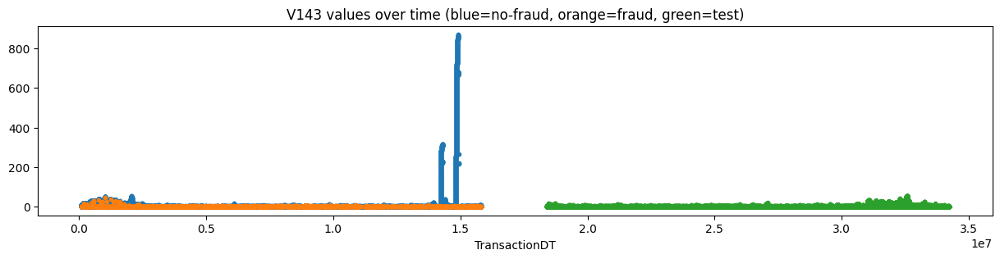

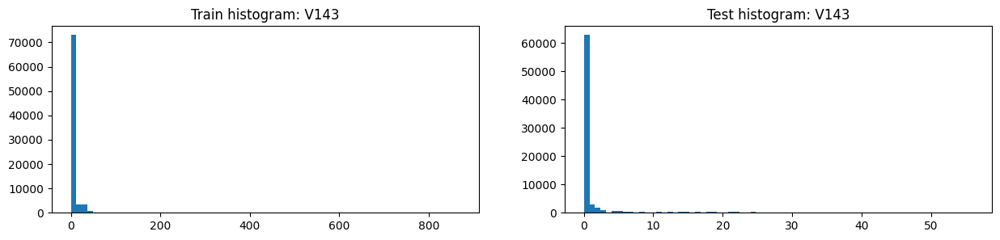

,V143,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81951.000000,3651.000000,78300.000000,76055.000000,8913.000000,67142.000000
1,mean,8.397006,0.778417,8.752248,1.779607,0.372377,1.966414
2,std,55.267545,2.640451,56.513468,5.758042,1.294889,6.085725
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,869.000000,47.000000,869.000000,56.000000,17.000000,56.000000
8,unique values,871.000000,32.000000,871.000000,58.000000,19.000000,58.000000
9,NaNs,508589.000000,17012.000000,491577.000000,430636.000000,92426.000000,338211.000000


,V143,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508589,0.033449,17012,430636.0
1,0.0,63872,0.038734,2474,62799.0
2,1.0,3767,0.183435,691,2835.0
3,2.0,1884,0.135881,256,1678.0
4,3.0,1032,0.102713,106,938.0
5,4.0,709,0.066291,47,680.0
6,28.0,584,0.001712,1,138.0
7,13.0,516,0.003876,2,99.0
8,30.0,417,0.000000,0,134.0
9,24.0,409,0.009780,4,325.0


,V143,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508589,0.033449,17012,430636
1,0.0,63872,0.038734,2474,62799
2,1.0,3767,0.183435,691,2835
3,2.0,1884,0.135881,256,1678
4,3.0,1032,0.102713,106,938
5,4.0,709,0.066291,47,680
6,5.0,380,0.034211,13,537
7,6.0,264,0.034091,9,314
8,20.0,327,0.021407,7,187
9,7.0,213,0.032864,7,364


,Column,Correlation with V143
0,V143,1.000000
1,V164,0.996551
2,V101,0.989884
3,V293,0.989616
4,V95,0.989536
5,V322,0.989483
327,V20,-0.342771
328,V19,-0.345714
329,V62,-0.382845
330,V61,-0.386694


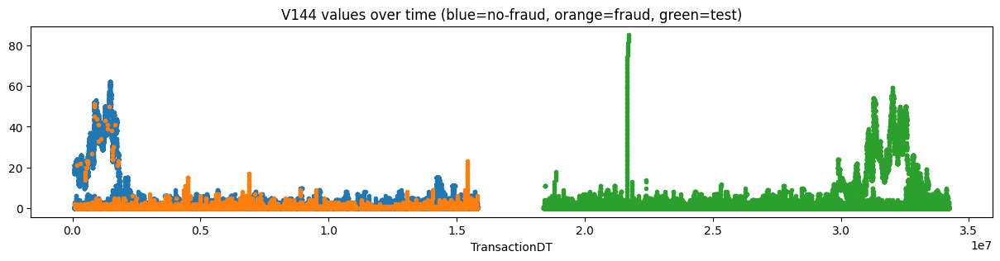

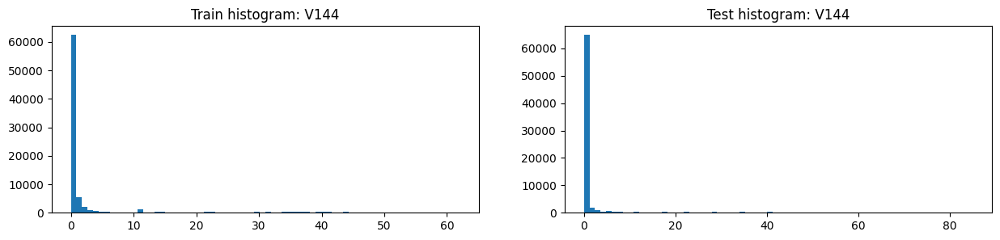

,V144,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81951.000000,3651.000000,78300.000000,76055.000000,8913.000000,67142.000000
1,mean,3.708484,1.184881,3.826156,2.809572,0.808145,3.075258
2,std,10.485633,3.701618,10.682965,8.928725,4.980549,9.295715
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,62.000000,51.000000,62.000000,85.000000,85.000000,59.000000
8,unique values,64.000000,41.000000,64.000000,87.000000,87.000000,61.000000
9,NaNs,508589.000000,17012.000000,491577.000000,430636.000000,92426.000000,338211.000000


,V144,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508589,0.033449,17012,430636
1,0.0,62439,0.036804,2298,59661
2,1.0,5418,0.116833,633,5189
3,2.0,2073,0.149059,309,1937
4,11.0,1089,0.006428,7,245
5,3.0,1054,0.148008,156,881
6,4.0,600,0.115000,69,476
7,15.0,435,0.013793,6,176
8,5.0,365,0.139726,51,376
9,40.0,364,0.000000,0,102


,V144,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508589,0.033449,17012,430636
1,0.0,62439,0.036804,2298,59661
2,1.0,5418,0.116833,633,5189
3,2.0,2073,0.149059,309,1937
4,3.0,1054,0.148008,156,881
5,4.0,600,0.115000,69,476
6,5.0,365,0.139726,51,376
7,6.0,246,0.105691,26,303
8,7.0,107,0.158879,17,331
9,9.0,70,0.128571,9,148


,Column,Correlation with V144
0,V144,1.000000
1,V150,0.958449
2,V145,0.952649
3,V159,0.938407
4,V151,0.921604
5,V160,0.893884
327,V148,-0.422351
328,V92,-0.433878
329,V154,-0.448557
330,V153,-0.459196


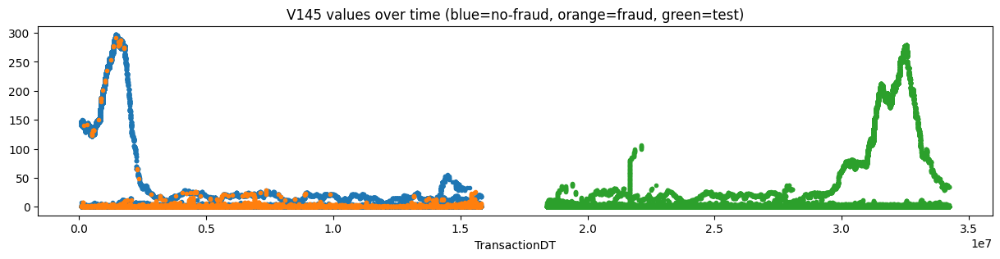

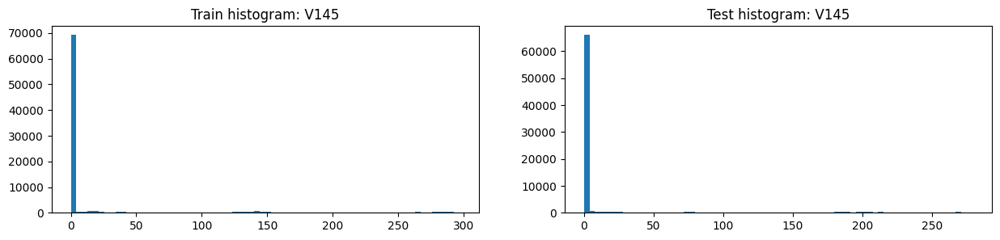

,V145,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81951.000000,3651.000000,78300.000000,76055.000000,8913.000000,67142.000000
1,mean,22.112946,3.641194,22.974253,17.100598,1.719399,19.142429
2,std,64.371860,22.013184,65.556946,54.471618,6.628048,57.616335
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.000000,1.500000,0.000000,0.000000,0.000000,0.000000
7,max,297.000000,292.000000,297.000000,279.000000,85.000000,279.000000
8,unique values,261.000000,62.000000,261.000000,281.000000,87.000000,281.000000
9,NaNs,508589.000000,17012.000000,491577.000000,430636.000000,92426.000000,338211.000000


,V145,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508589,0.033449,17012,430636.0
1,0.0,61241,0.034405,2107,58604.0
2,1.0,4958,0.127269,631,5071.0
3,2.0,1847,0.177585,328,1672.0
4,3.0,832,0.213942,178,692.0
5,35.0,429,0.000000,0,23.0
6,4.0,367,0.228883,84,297.0
7,142.0,244,0.004098,1,14.0
8,143.0,241,0.000000,0,21.0
9,39.0,231,0.000000,0,3.0


,V145,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508589,0.033449,17012,430636
1,0.0,61241,0.034405,2107,58604
2,1.0,4958,0.127269,631,5071
3,2.0,1847,0.177585,328,1672
4,3.0,832,0.213942,178,692
5,4.0,367,0.228883,84,297
6,5.0,212,0.259434,55,205
7,6.0,105,0.323810,34,106
8,7.0,79,0.341772,27,105
9,8.0,90,0.244444,22,104


,Column,Correlation with V145
0,V145,1.000000
1,V150,0.981799
2,V160,0.961669
3,V144,0.952649
4,V151,0.942457
5,V159,0.917704
327,V92,-0.459852
328,V154,-0.467680
329,V153,-0.477946
330,V31,-0.479826


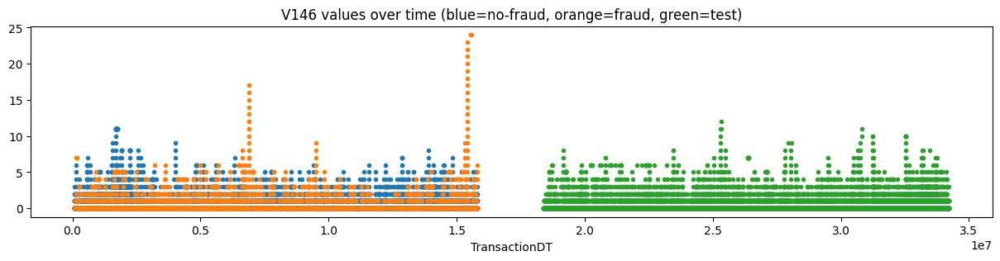

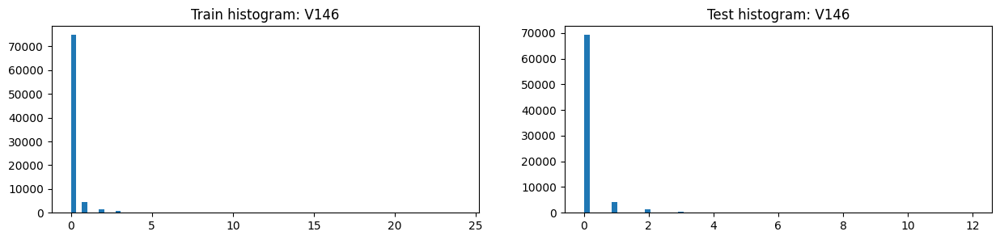

,V146,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81945.000000,3650.000000,78295.000000,75785.000000,8839.000000,66946.000000
1,mean,0.156276,0.783836,0.127020,0.141611,0.177622,0.136857
2,std,0.682328,1.848351,0.555728,0.578137,0.668796,0.564915
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,24.000000,24.000000,11.000000,12.000000,8.000000,12.000000
8,unique values,26.000000,26.000000,13.000000,14.000000,10.000000,14.000000
9,NaNs,508595.000000,17013.000000,491582.000000,430906.000000,92500.000000,338407.000000


,V146,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508595,0.033451,17013,430906.0
1,0.0,74718,0.032201,2406,69222.0
2,1.0,4390,0.138497,608,4301.0
3,2.0,1605,0.191900,308,1301.0
4,3.0,665,0.225564,150,513.0
5,4.0,263,0.258555,68,217.0
6,5.0,143,0.342657,49,103.0
7,6.0,56,0.267857,15,61.0
8,11.0,25,0.120000,3,3.0
9,7.0,25,0.400000,10,32.0


,V146,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508595,0.033451,17013,430906
1,0.0,74718,0.032201,2406,69222
2,1.0,4390,0.138497,608,4301
3,2.0,1605,0.191900,308,1301
4,3.0,665,0.225564,150,513
5,4.0,263,0.258555,68,217
6,5.0,143,0.342657,49,103
7,6.0,56,0.267857,15,61
8,7.0,25,0.400000,10,32
9,8.0,23,0.217391,5,16


,Column,Correlation with V146
0,V146,1.000000
1,V147,0.932216
2,V184,0.748912
3,V139,0.666175
4,V238,0.656216
5,V185,0.650682
327,D15,-0.101470
328,D7,-0.107351
329,D2,-0.109818
330,D6,-0.167649


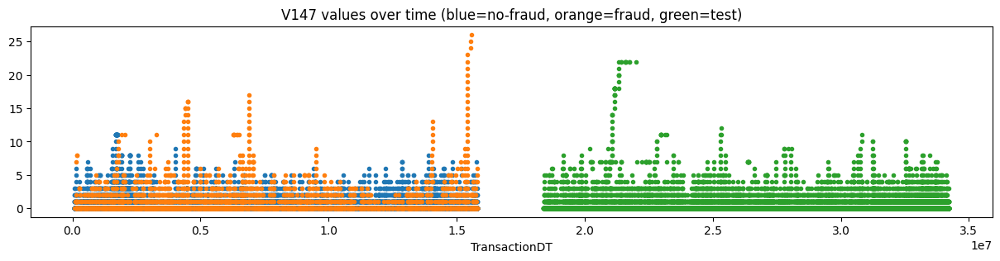

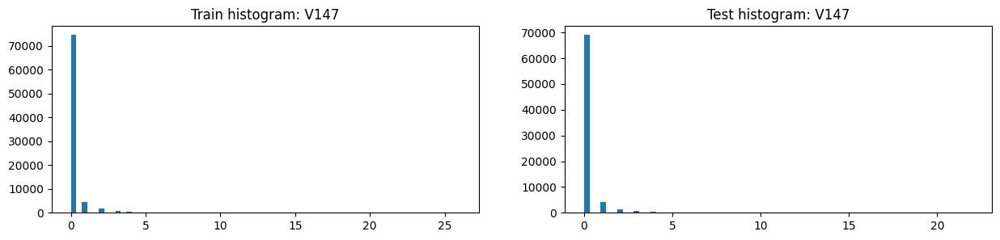

,V147,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81945.000000,3650.000000,78295.000000,75785.000000,8839.000000,66946.000000
1,mean,0.168601,1.012877,0.129242,0.162987,0.292001,0.145953
2,std,0.750497,2.273225,0.560253,0.758748,1.433971,0.614619
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,26.000000,26.000000,11.000000,22.000000,22.000000,22.000000
8,unique values,28.000000,28.000000,13.000000,24.000000,24.000000,15.000000
9,NaNs,508595.000000,17013.000000,491582.000000,430906.000000,92500.000000,338407.000000


,V147,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508595,0.033451,17013,430906.0
1,0.0,74531,0.031101,2318,69016.0
2,1.0,4396,0.126706,557,4267.0
3,2.0,1656,0.203502,337,1332.0
4,3.0,693,0.236652,164,568.0
5,4.0,286,0.307692,88,250.0
6,5.0,150,0.373333,56,127.0
7,6.0,66,0.348485,23,56.0
8,7.0,38,0.578947,22,72.0
9,11.0,38,0.421053,16,11.0


,V147,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508595,0.033451,17013,430906
1,0.0,74531,0.031101,2318,69016
2,1.0,4396,0.126706,557,4267
3,2.0,1656,0.203502,337,1332
4,3.0,693,0.236652,164,568
5,4.0,286,0.307692,88,250
6,5.0,150,0.373333,56,127
7,6.0,66,0.348485,23,56
8,7.0,38,0.578947,22,72
9,11.0,38,0.421053,16,11


,Column,Correlation with V147
0,V147,1.000000
1,V146,0.932216
2,V184,0.705138
3,V140,0.683912
4,V185,0.663533
5,V239,0.632425
327,D15,-0.103089
328,D7,-0.108240
329,D2,-0.112777
330,D6,-0.169190


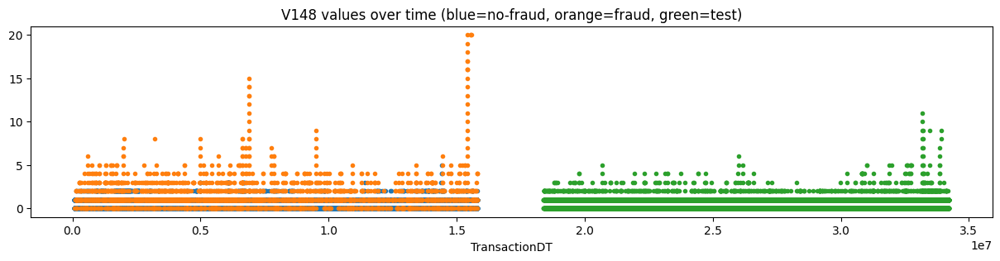

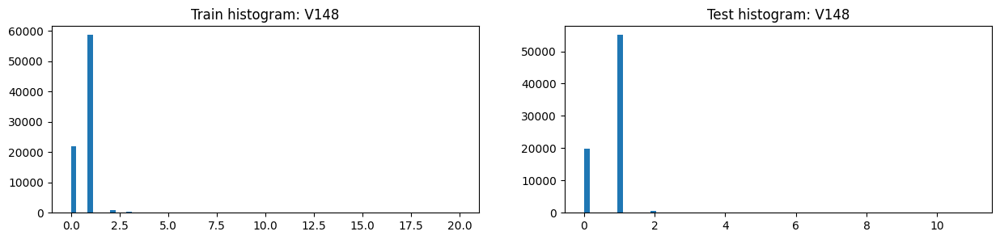

,V148,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81945.000000,3650.000000,78295.000000,75785.000000,8839.000000,66946.000000
1,mean,0.765001,1.381370,0.736267,0.754331,0.778595,0.751128
2,std,0.581425,1.647401,0.456938,0.485813,0.477096,0.486866
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,20.000000,20.000000,5.000000,11.000000,5.000000,11.000000
8,unique values,22.000000,22.000000,7.000000,13.000000,7.000000,13.000000
9,NaNs,508595.000000,17013.000000,491582.000000,430906.000000,92500.000000,338407.000000


,V148,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508595,0.033451,17013,430906.0
1,1.0,58650,0.035226,2066,55062.0
2,0.0,21848,0.030026,656,19844.0
3,2.0,962,0.481289,463,691.0
4,3.0,267,0.936330,250,111.0
5,4.0,108,0.981481,106,41.0
6,5.0,45,0.977778,44,20.0
7,6.0,16,1.000000,16,4.0
8,7.0,11,1.000000,11,3.0
9,8.0,10,1.000000,10,3.0


,V148,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508595,0.033451,17013,430906
1,1.0,58650,0.035226,2066,55062
2,0.0,21848,0.030026,656,19844
3,2.0,962,0.481289,463,691
4,3.0,267,0.936330,250,111
5,4.0,108,0.981481,106,41
6,5.0,45,0.977778,44,20
7,6.0,16,1.000000,16,4
8,7.0,11,1.000000,11,3
9,8.0,10,1.000000,10,3


,Column,Correlation with V148
0,V148,1.000000
1,V155,0.975978
2,V153,0.952071
3,V149,0.950232
4,V154,0.939466
5,V156,0.931158
327,V145,-0.443791
328,D15,-0.445041
329,V151,-0.461530
330,V152,-0.505136


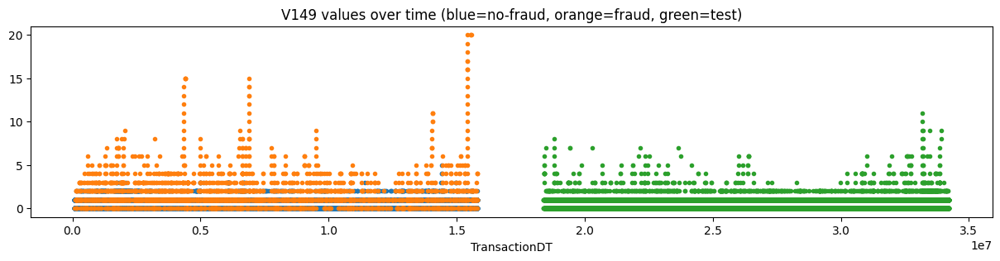

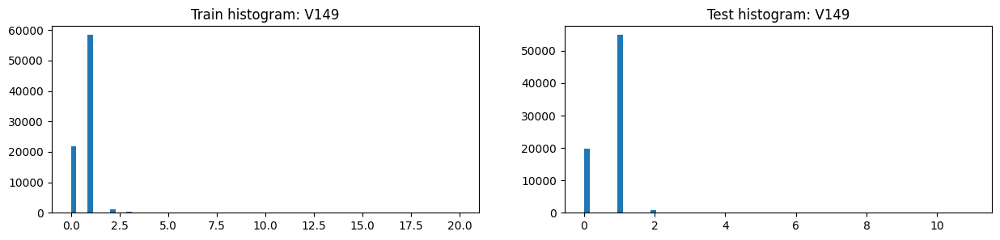

,V149,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81945.000000,3650.000000,78295.000000,75785.000000,8839.000000,66946.000000
1,mean,0.775313,1.570411,0.738246,0.760718,0.792171,0.756565
2,std,0.628191,1.913475,0.459925,0.507191,0.539587,0.502615
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,20.000000,20.000000,5.000000,11.000000,8.000000,11.000000
8,unique values,22.000000,22.000000,7.000000,13.000000,10.000000,13.000000
9,NaNs,508595.000000,17013.000000,491582.000000,430906.000000,92500.000000,338407.000000


,V149,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508595,0.033451,17013,430906.0
1,1.0,58370,0.032517,1898,54854.0
2,0.0,21825,0.029828,651,19817.0
3,2.0,1115,0.442152,493,837.0
4,3.0,298,0.919463,274,138.0
5,4.0,156,0.987179,154,68.0
6,5.0,60,0.983333,59,28.0
7,6.0,38,1.000000,38,23.0
8,7.0,21,1.000000,21,10.0
9,8.0,16,1.000000,16,4.0


,V149,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508595,0.033451,17013,430906
1,1.0,58370,0.032517,1898,54854
2,0.0,21825,0.029828,651,19817
3,2.0,1115,0.442152,493,837
4,3.0,298,0.919463,274,138
5,4.0,156,0.987179,154,68
6,5.0,60,0.983333,59,28
7,6.0,38,1.000000,38,23
8,7.0,21,1.000000,21,10
9,8.0,16,1.000000,16,4


,Column,Correlation with V149
0,V149,1.000000
1,V156,0.976168
2,V148,0.950232
3,V155,0.926838
4,V158,0.918618
5,V154,0.915597
327,V145,-0.415211
328,V151,-0.432541
329,D15,-0.438651
330,V152,-0.472827


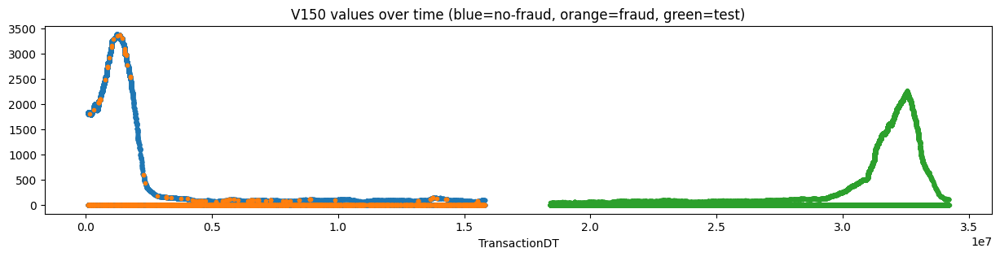

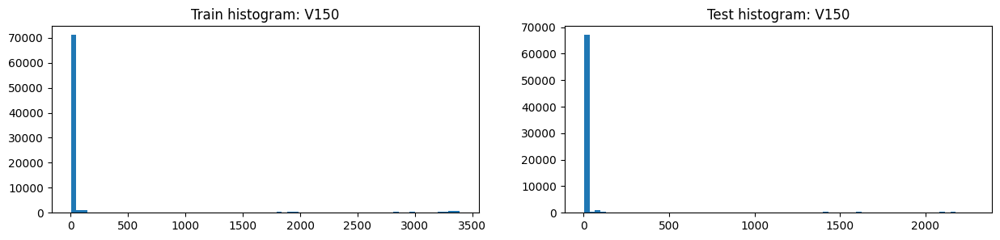

,V150,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81951.000000,3651.000000,78300.000000,76055.000000,8913.000000,67142.000000
1,mean,277.598028,31.862230,289.056284,135.081573,4.254348,152.448691
2,std,829.576922,271.047102,844.935531,449.117847,14.122804,475.271816
3,min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,3389.000000,3372.000000,3389.000000,2277.000000,93.000000,2277.000000
8,unique values,1997.000000,101.000000,1978.000000,2152.000000,53.000000,2142.000000
9,NaNs,508589.000000,17012.000000,491577.000000,430636.000000,92426.000000,338211.000000


,V150,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508589,0.033449,17012,430636.0
1,1.0,67559,0.031646,2138,63957.0
2,2.0,2663,0.257980,687,2497.0
3,3.0,462,0.649351,300,371.0
4,4.0,207,0.884058,183,116.0
5,5.0,98,0.867347,85,42.0
6,97.0,96,0.000000,0,18.0
7,98.0,83,0.024096,2,18.0
8,100.0,77,0.064935,5,24.0
9,84.0,74,0.027027,2,43.0


,V150,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508589,0.033449,17012,430636
1,1.0,67559,0.031646,2138,63957
2,2.0,2663,0.257980,687,2497
3,3.0,462,0.649351,300,371
4,4.0,207,0.884058,183,116
5,5.0,98,0.867347,85,42
6,6.0,45,0.888889,40,26
7,7.0,30,0.966667,29,11
8,8.0,18,0.944444,17,7
9,9.0,10,1.000000,10,5


,Column,Correlation with V150
0,V150,1.000000
1,V145,0.981799
2,V151,0.972867
3,V159,0.968534
4,V144,0.958449
5,V160,0.942301
327,V92,-0.464599
328,V153,-0.471133
329,V71,-0.472907
330,V31,-0.502933


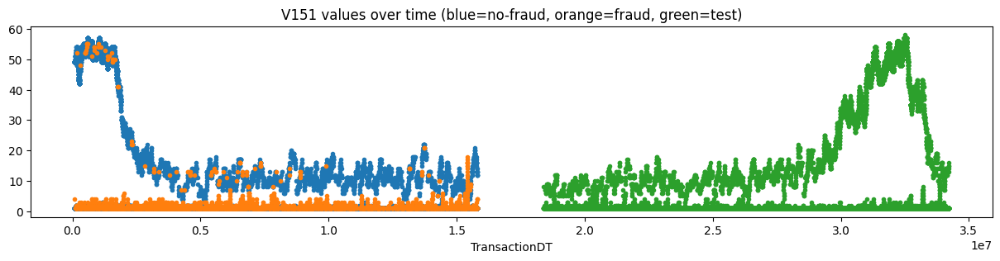

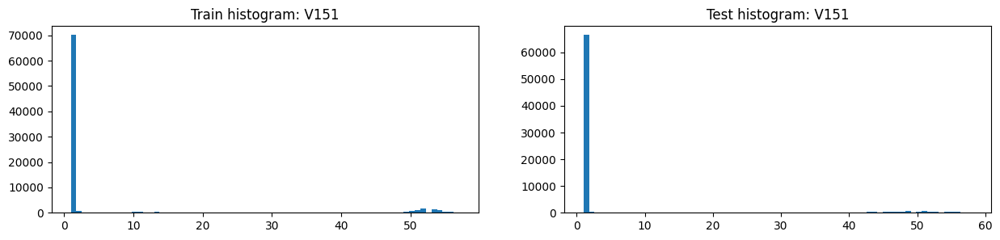

,V151,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81951.000000,3651.000000,78300.000000,76055.000000,8913.000000,67142.000000
1,mean,6.460190,2.166530,6.660396,5.442404,1.401436,5.978836
2,std,15.232324,5.474493,15.509543,13.267347,1.796967,14.018040
3,min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,57.000000,55.000000,57.000000,58.000000,17.000000,58.000000
8,unique values,57.000000,31.000000,57.000000,59.000000,18.000000,59.000000
9,NaNs,508589.000000,17012.000000,491577.000000,430636.000000,92426.000000,338211.000000


,V151,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508589,0.033449,17012,430636
1,1.0,70098,0.039359,2759,66454
2,52.0,1770,0.004520,8,524
3,53.0,1483,0.002023,3,359
4,51.0,1087,0.002760,3,608
5,54.0,1067,0.005623,6,340
6,2.0,747,0.655957,490,430
7,50.0,621,0.009662,6,345
8,55.0,491,0.012220,6,352
9,49.0,401,0.004988,2,539


,V151,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508589,0.033449,17012,430636
1,1.0,70098,0.039359,2759,66454
2,2.0,747,0.655957,490,430
3,3.0,175,0.960000,168,104
4,4.0,70,0.785714,55,47
5,5.0,60,0.466667,28,44
6,13.0,257,0.089494,23,146
7,6.0,75,0.200000,15,99
8,12.0,219,0.063927,14,175
9,16.0,148,0.074324,11,84


,Column,Correlation with V151
0,V151,1.000000
1,V150,0.972867
2,V159,0.962705
3,V145,0.942457
4,V152,0.938174
5,V144,0.921604
327,V92,-0.492945
328,V153,-0.496762
329,V71,-0.504865
330,V31,-0.538982


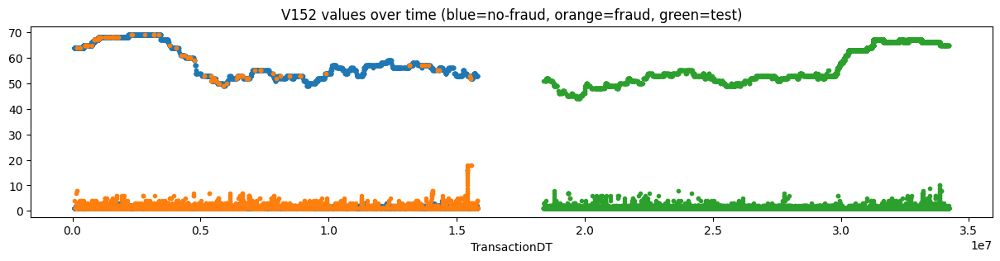

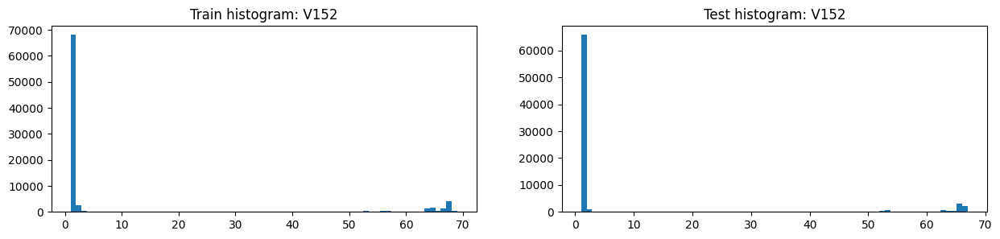

,V152,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81951.000000,3651.000000,78300.000000,76055.000000,8913.000000,67142.000000
1,mean,9.432710,3.528075,9.708033,8.333219,3.376753,8.991183
2,std,21.554486,10.510815,21.895387,20.027458,10.229859,20.898809
3,min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,69.000000,69.000000,69.000000,67.000000,52.000000,67.000000
8,unique values,40.000000,35.000000,26.000000,35.000000,18.000000,30.000000
9,NaNs,508589.000000,17012.000000,491577.000000,430636.000000,92426.000000,338211.000000


,V152,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508589,0.033449,17012,430636.0
1,1.0,68064,0.035951,2447,65866.0
2,68.0,4003,0.004247,17,NaN
3,2.0,2571,0.235706,606,856.0
4,65.0,1554,0.009009,14,351.0
5,64.0,1247,0.002406,3,381.0
6,67.0,1239,0.004843,6,2227.0
7,66.0,428,0.000000,0,3162.0
8,53.0,397,0.052897,21,647.0
9,69.0,380,0.023684,9,NaN


,V152,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508589,0.033449,17012,430636.0
1,1.0,68064,0.035951,2447,65866.0
2,2.0,2571,0.235706,606,856.0
3,3.0,272,0.926471,252,142.0
4,4.0,99,0.989899,98,71.0
5,5.0,59,1.000000,59,47.0
6,6.0,31,1.000000,31,27.0
7,53.0,397,0.052897,21,647.0
8,68.0,4003,0.004247,17,NaN
9,65.0,1554,0.009009,14,351.0


,Column,Correlation with V152
0,V152,1.000000
1,V151,0.938174
2,V160,0.890901
3,V150,0.887184
4,V145,0.876682
5,V159,0.860805
327,V154,-0.531424
328,V71,-0.541191
329,V153,-0.543574
330,V31,-0.587984


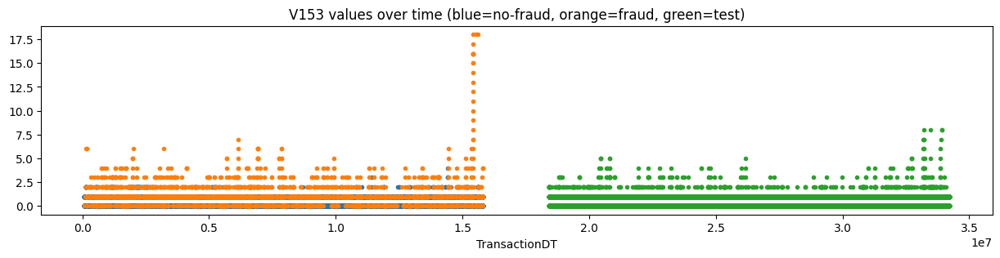

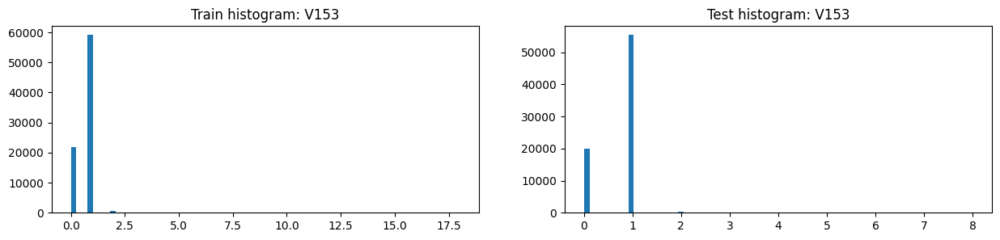

,V153,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81945.000000,3650.000000,78295.000000,75785.000000,8839.000000,66946.000000
1,mean,0.753200,1.204932,0.732141,0.748737,0.776219,0.745108
2,std,0.532649,1.350650,0.449403,0.470179,0.482244,0.468446
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,18.000000,18.000000,4.000000,8.000000,5.000000,8.000000
8,unique values,20.000000,20.000000,6.000000,10.000000,7.000000,10.000000
9,NaNs,508595.000000,17013.000000,491582.000000,430906.000000,92500.000000,338407.000000


,V153,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508595,0.033451,17013,430906.0
1,1.0,59143,0.038077,2252,55391.0
2,0.0,21848,0.030026,656,19844.0
3,2.0,667,0.692654,462,405.0
4,3.0,167,0.964072,161,86.0
5,4.0,60,0.983333,59,34.0
6,5.0,22,1.000000,22,14.0
7,6.0,16,1.000000,16,3.0
8,16.0,5,1.000000,5,NaN
9,18.0,4,1.000000,4,NaN


,V153,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508595,0.033451,17013,430906.0
1,1.0,59143,0.038077,2252,55391.0
2,0.0,21848,0.030026,656,19844.0
3,2.0,667,0.692654,462,405.0
4,3.0,167,0.964072,161,86.0
5,4.0,60,0.983333,59,34.0
6,5.0,22,1.000000,22,14.0
7,6.0,16,1.000000,16,3.0
8,16.0,5,1.000000,5,NaN
9,18.0,4,1.000000,4,NaN


,Column,Correlation with V153
0,V153,1.000000
1,V154,0.986471
2,V155,0.960661
3,V148,0.952071
4,V156,0.913550
5,V149,0.900617
327,V160,-0.472221
328,V145,-0.477946
329,V151,-0.496762
330,V152,-0.543574


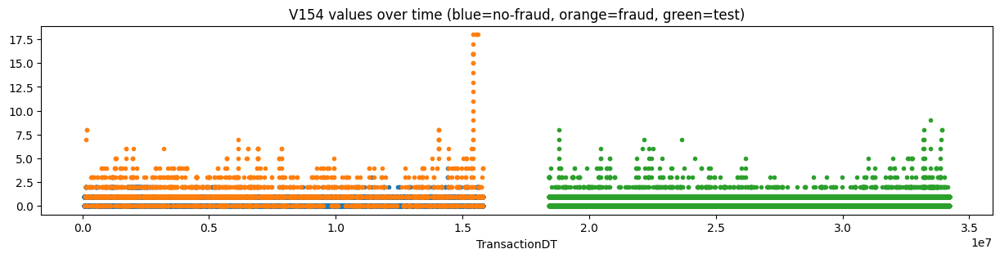

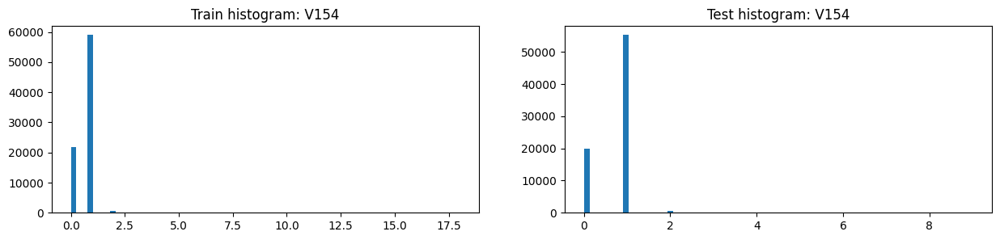

,V154,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81945.000000,3650.000000,78295.000000,75785.000000,8839.000000,66946.000000
1,mean,0.757423,1.281644,0.732984,0.753144,0.785609,0.748857
2,std,0.546907,1.441513,0.450330,0.484449,0.518795,0.479570
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,18.000000,18.000000,4.000000,9.000000,8.000000,9.000000
8,unique values,20.000000,20.000000,6.000000,11.000000,10.000000,11.000000
9,NaNs,508595.000000,17013.000000,491582.000000,430906.000000,92500.000000,338407.000000


,V154,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508595,0.033451,17013,430906.0
1,1.0,59033,0.036793,2172,55270.0
2,0.0,21825,0.029828,651,19817.0
3,2.0,712,0.644663,459,467.0
4,3.0,208,0.971154,202,135.0
5,4.0,81,0.987654,80,51.0
6,5.0,34,1.000000,34,24.0
7,6.0,20,1.000000,20,9.0
8,7.0,8,1.000000,8,7.0
9,8.0,6,1.000000,6,4.0


,V154,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508595,0.033451,17013,430906
1,1.0,59033,0.036793,2172,55270
2,0.0,21825,0.029828,651,19817
3,2.0,712,0.644663,459,467
4,3.0,208,0.971154,202,135
5,4.0,81,0.987654,80,51
6,5.0,34,1.000000,34,24
7,6.0,20,1.000000,20,9
8,7.0,8,1.000000,8,7
9,8.0,6,1.000000,6,4


,Column,Correlation with V154
0,V154,1.000000
1,V153,0.986471
2,V155,0.949000
3,V148,0.939466
4,V156,0.929691
5,V149,0.915597
327,V160,-0.462485
328,V145,-0.467680
329,V151,-0.486133
330,V152,-0.531424


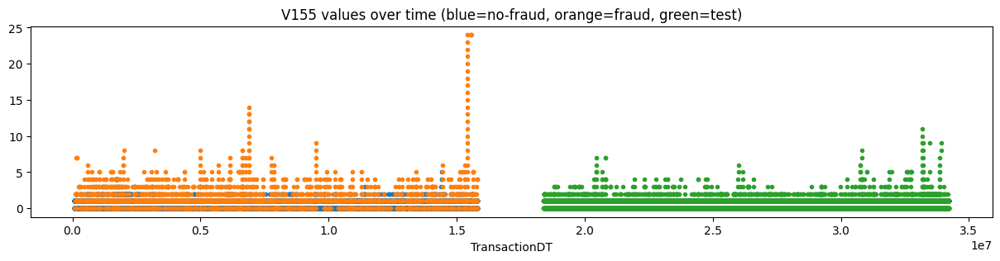

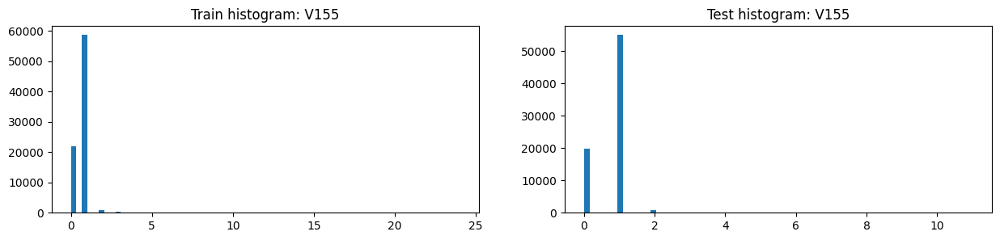

,V155,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81945.000000,3650.000000,78295.000000,75785.000000,8839.000000,66946.000000
1,mean,0.767381,1.421096,0.736905,0.756284,0.785044,0.752487
2,std,0.602678,1.786783,0.458811,0.493419,0.509647,0.491115
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,24.000000,24.000000,5.000000,11.000000,7.000000,11.000000
8,unique values,26.000000,26.000000,7.000000,13.000000,9.000000,13.000000
9,NaNs,508595.000000,17013.000000,491582.000000,430906.000000,92500.000000,338407.000000


,V155,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508595,0.033451,17013,430906.0
1,1.0,58584,0.034668,2031,54992.0
2,0.0,21848,0.030026,656,19844.0
3,2.0,991,0.474268,470,729.0
4,3.0,272,0.941176,256,124.0
5,4.0,129,0.906977,117,47.0
6,5.0,50,0.980000,49,25.0
7,6.0,18,1.000000,18,7.0
8,7.0,15,1.000000,15,7.0
9,8.0,9,1.000000,9,4.0


,V155,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508595,0.033451,17013,430906
1,1.0,58584,0.034668,2031,54992
2,0.0,21848,0.030026,656,19844
3,2.0,991,0.474268,470,729
4,3.0,272,0.941176,256,124
5,4.0,129,0.906977,117,47
6,5.0,50,0.980000,49,25
7,6.0,18,1.000000,18,7
8,7.0,15,1.000000,15,7
9,8.0,9,1.000000,9,4


,Column,Correlation with V155
0,V155,1.000000
1,V148,0.975978
2,V153,0.960661
3,V156,0.953647
4,V154,0.949000
5,V149,0.926838
327,V145,-0.429103
328,D15,-0.442840
329,V151,-0.445650
330,V152,-0.487829


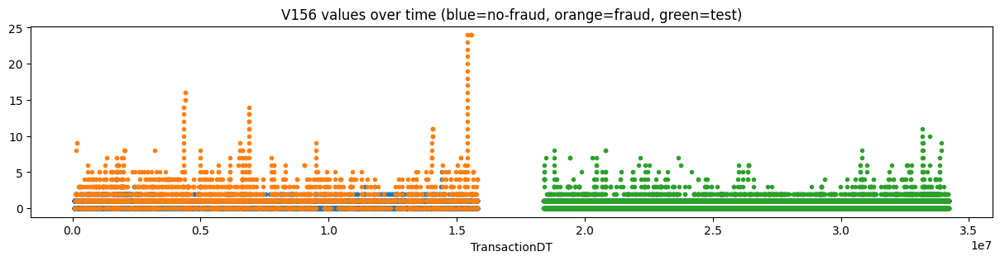

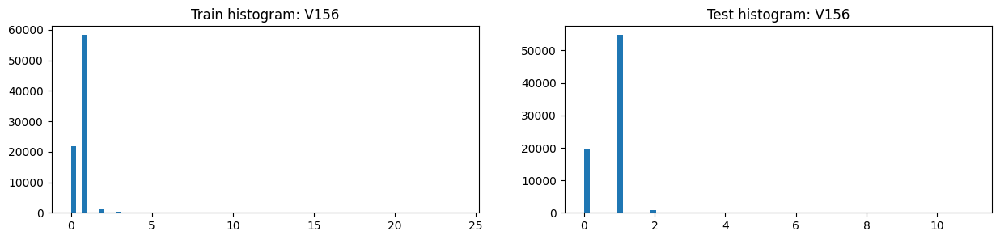

,V156,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81945.000000,3650.000000,78295.000000,75785.000000,8839.000000,66946.000000
1,mean,0.777485,1.604658,0.738923,0.763014,0.799412,0.758208
2,std,0.647209,2.027660,0.461958,0.515818,0.574143,0.507427
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,24.000000,24.000000,5.000000,11.000000,8.000000,11.000000
8,unique values,26.000000,26.000000,7.000000,13.000000,10.000000,13.000000
9,NaNs,508595.000000,17013.000000,491582.000000,430906.000000,92500.000000,338407.000000


,V156,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508595,0.033451,17013,430906.0
1,1.0,58302,0.032006,1866,54773.0
2,0.0,21825,0.029828,651,19817.0
3,2.0,1153,0.432784,499,876.0
4,3.0,302,0.940397,284,160.0
5,4.0,169,0.946746,160,73.0
6,5.0,76,0.947368,72,36.0
7,6.0,34,1.000000,34,25.0
8,7.0,21,1.000000,21,12.0
9,8.0,15,1.000000,15,7.0


,V156,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508595,0.033451,17013,430906
1,1.0,58302,0.032006,1866,54773
2,0.0,21825,0.029828,651,19817
3,2.0,1153,0.432784,499,876
4,3.0,302,0.940397,284,160
5,4.0,169,0.946746,160,73
6,5.0,76,0.947368,72,36
7,6.0,34,1.000000,34,25
8,7.0,21,1.000000,21,12
9,8.0,15,1.000000,15,7


,Column,Correlation with V156
0,V156,1.000000
1,V149,0.976168
2,V155,0.953647
3,V148,0.931158
4,V154,0.929691
5,V158,0.925047
327,D10,-0.408720
328,V151,-0.420067
329,D15,-0.435689
330,V152,-0.459248


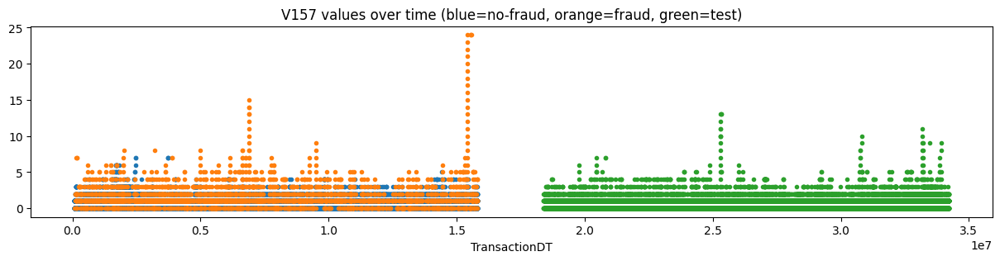

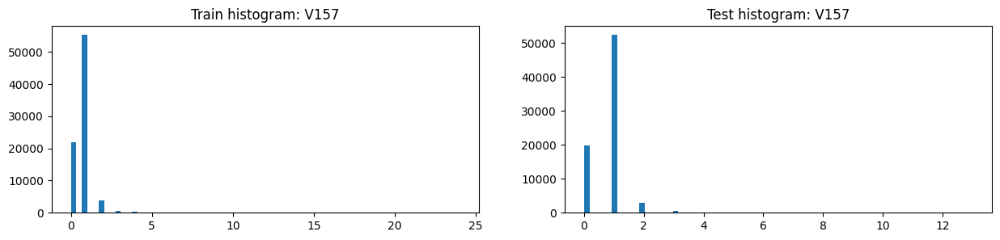

,V157,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81945.000000,3650.000000,78295.000000,75785.000000,8839.000000,66946.000000
1,mean,0.817573,1.559452,0.782987,0.801240,0.840027,0.796119
2,std,0.682016,1.860259,0.546527,0.587565,0.601518,0.585510
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,24.000000,24.000000,7.000000,13.000000,7.000000,13.000000
8,unique values,26.000000,26.000000,9.000000,15.000000,9.000000,15.000000
9,NaNs,508595.000000,17013.000000,491582.000000,430906.000000,92500.000000,338407.000000


,V157,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508595,0.033451,17013,430906.0
1,1.0,55280,0.031983,1768,52320.0
2,0.0,21848,0.030026,656,19844.0
3,2.0,3745,0.162083,607,2935.0
4,3.0,664,0.483434,321,438.0
5,4.0,229,0.633188,145,165.0
6,5.0,80,0.875000,70,41.0
7,6.0,37,0.702703,26,9.0
8,7.0,24,0.791667,19,9.0
9,8.0,9,1.000000,9,6.0


,V157,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508595,0.033451,17013,430906
1,1.0,55280,0.031983,1768,52320
2,0.0,21848,0.030026,656,19844
3,2.0,3745,0.162083,607,2935
4,3.0,664,0.483434,321,438
5,4.0,229,0.633188,145,165
6,5.0,80,0.875000,70,41
7,6.0,37,0.702703,26,9
8,7.0,24,0.791667,19,9
9,8.0,9,1.000000,9,6


,Column,Correlation with V157
0,V157,1.000000
1,V158,0.954520
2,V155,0.924755
3,V148,0.916441
4,V153,0.890601
5,V156,0.881782
327,D10,-0.405144
328,V151,-0.419939
329,D15,-0.424942
330,V152,-0.459649


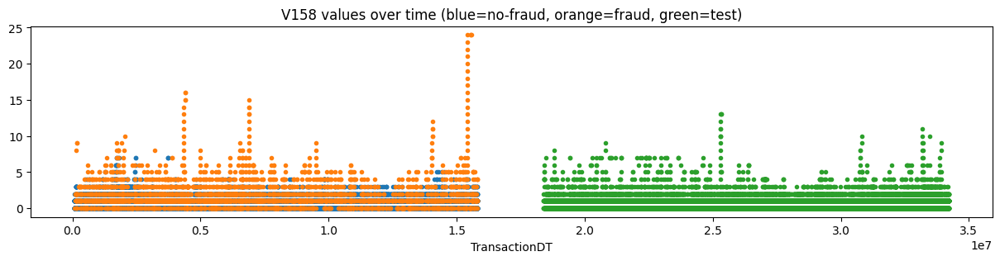

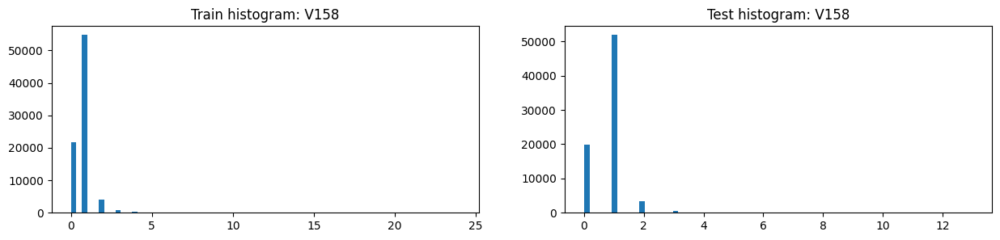

,V158,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81945.000000,3650.000000,78295.000000,75785.000000,8839.000000,66946.000000
1,mean,0.833461,1.779178,0.789374,0.814515,0.874646,0.806575
2,std,0.734336,2.119609,0.557996,0.626397,0.710786,0.613956
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,24.000000,24.000000,7.000000,13.000000,9.000000,13.000000
8,unique values,26.000000,26.000000,9.000000,15.000000,11.000000,15.000000
9,NaNs,508595.000000,17013.000000,491582.000000,430906.000000,92500.000000,338407.000000


,V158,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508595,0.033451,17013,430906.0
1,1.0,54744,0.028825,1578,51834.0
2,0.0,21825,0.029828,651,19817.0
3,2.0,4050,0.159753,647,3278.0
4,3.0,762,0.431759,329,508.0
5,4.0,287,0.689895,198,177.0
6,5.0,113,0.893805,101,64.0
7,6.0,60,0.850000,51,36.0
8,7.0,34,0.735294,25,44.0
9,8.0,19,1.000000,19,8.0


,V158,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508595,0.033451,17013,430906
1,1.0,54744,0.028825,1578,51834
2,0.0,21825,0.029828,651,19817
3,2.0,4050,0.159753,647,3278
4,3.0,762,0.431759,329,508
5,4.0,287,0.689895,198,177
6,5.0,113,0.893805,101,64
7,6.0,60,0.850000,51,36
8,7.0,34,0.735294,25,44
9,8.0,19,1.000000,19,8


,Column,Correlation with V158
0,V158,1.000000
1,V157,0.954520
2,V156,0.925047
3,V149,0.918618
4,V155,0.883433
5,V148,0.876240
327,D10,-0.380922
328,V151,-0.397302
329,D15,-0.413500
330,V152,-0.434343


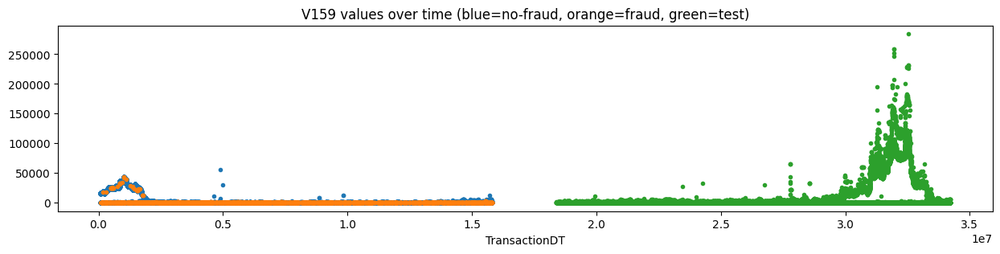

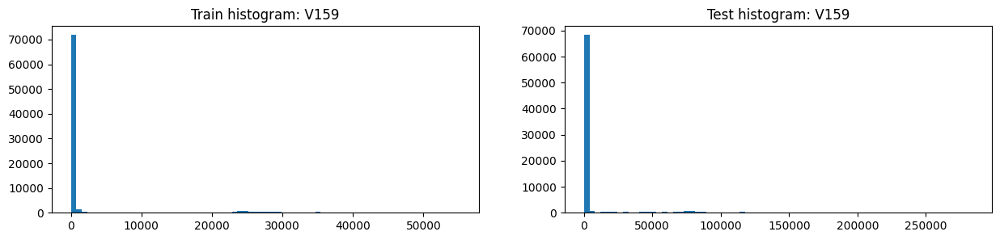

,V159,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81951.000000,3651.000000,78300.000000,76055.000000,8913.000000,67142.000000
1,mean,2719.299775,294.728242,2832.353551,6209.121689,127.541687,7016.442331
2,std,8355.445049,2687.570131,8511.473919,21634.200105,596.909735,22903.319337
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,55125.000000,43551.929688,55125.000000,284129.812500,11000.000000,284129.812500
8,unique values,6664.000000,123.000000,6645.000000,6248.000000,227.000000,6176.000000
9,NaNs,508589.000000,17012.000000,491577.000000,430636.000000,92426.000000,338211.000000


,V159,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508589,0.033449,17012,430636.0
1,0.0,68397,0.049388,3378,64920.0
2,100.0,413,0.031477,13,228.0
3,50.0,230,0.065217,15,206.0
4,265.0,193,0.000000,0,NaN
5,25.0,172,0.063953,11,201.0
6,106.0,169,0.000000,0,NaN
7,20.0,156,0.012821,2,155.0
8,181.0,146,0.000000,0,NaN
9,10.0,115,0.026087,3,102.0


,V159,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508589,0.033449,17012,430636
1,0.0,68397,0.049388,3378,64920
2,200.0,70,0.285714,20,82
3,50.0,230,0.065217,15,206
4,150.0,91,0.153846,14,73
5,100.0,413,0.031477,13,228
6,25.0,172,0.063953,11,201
7,15.0,101,0.108911,11,87
8,250.0,46,0.195652,9,43
9,300.0,54,0.111111,6,33


,Column,Correlation with V159
0,V159,1.000000
1,V150,0.968534
2,V151,0.962705
3,V144,0.938407
4,V145,0.917704
5,V160,0.868073
327,V92,-0.451243
328,V153,-0.459433
329,V71,-0.459696
330,V31,-0.487232


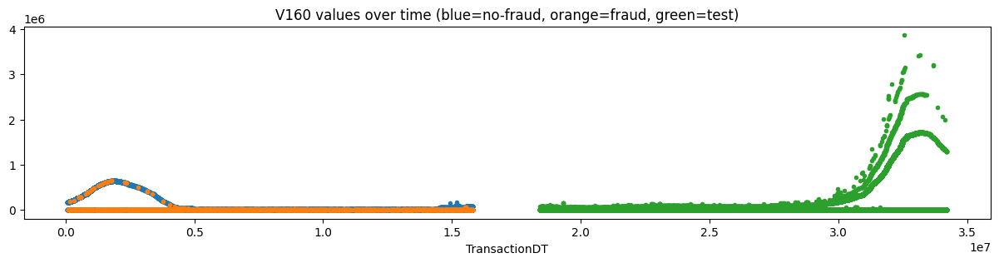

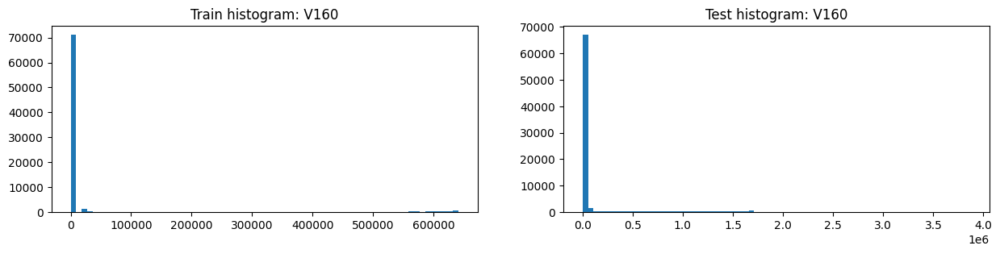

,V160,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81951.000000,3651.000000,78300.000000,7.605500e+04,8913.000000,6.714200e+04
1,mean,47453.181173,6437.664702,49365.667132,9.806603e+04,3354.763243,1.106388e+05
2,std,142076.069162,52765.489660,144620.034216,3.376923e+05,14762.181207,3.574865e+05
3,min,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
4,25%,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
5,50%,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
6,75%,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
7,max,641511.437500,639717.437500,641511.437500,3.867868e+06,157203.000000,3.867868e+06
8,unique values,9622.000000,202.000000,9554.000000,7.956000e+03,522.000000,7.610000e+03
9,NaNs,508589.000000,17012.000000,491577.000000,4.306360e+05,92426.000000,3.382110e+05


,V160,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508589,0.033449,17012,430636.0
1,0.0,63341,0.046384,2938,60319.0
2,2401.0,925,0.000000,0,1.0
3,50.0,560,0.042857,24,517.0
4,100.0,496,0.050403,25,531.0
5,1359.0,325,0.000000,0,NaN
6,25.0,260,0.073077,19,277.0
7,150.0,256,0.152344,39,214.0
8,200.0,225,0.204444,46,253.0
9,20.0,188,0.031915,6,162.0


,V160,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508589,0.033449,17012,430636
1,0.0,63341,0.046384,2938,60319
2,200.0,225,0.204444,46,253
3,150.0,256,0.152344,39,214
4,300.0,129,0.248062,32,112
5,250.0,132,0.234848,31,119
6,100.0,496,0.050403,25,531
7,450.0,40,0.625000,25,31
8,50.0,560,0.042857,24,517
9,75.0,181,0.110497,20,178


,Column,Correlation with V160
0,V160,1.000000
1,V145,0.961669
2,V150,0.942301
3,V151,0.910238
4,V144,0.893884
5,V152,0.890901
327,V154,-0.462485
328,V153,-0.472221
329,V71,-0.472643
330,V31,-0.501588


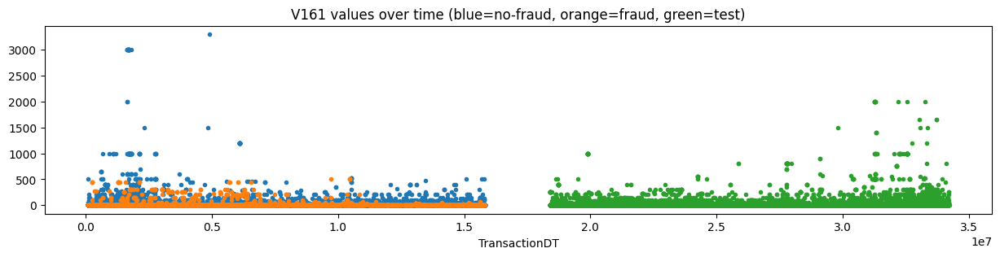

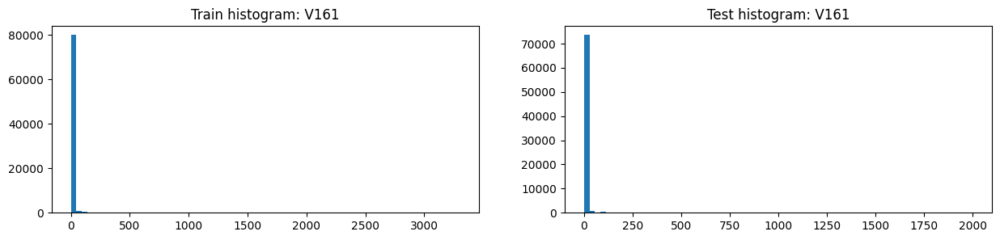

,V161,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81945.000000,3650.000000,78295.000000,75785.000000,8839.000000,66946.000000
1,mean,4.843938,15.708219,4.337461,4.993831,6.818645,4.752897
2,std,58.929757,61.042699,58.780839,49.471160,46.403682,49.857401
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,3300.000000,500.000000,3300.000000,2000.000000,1000.000000,2000.000000
8,unique values,80.000000,30.000000,77.000000,77.000000,29.000000,77.000000
9,NaNs,508595.000000,17013.000000,491582.000000,430906.000000,92500.000000,338407.000000


,V161,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508595,0.033451,17013,430906.0
1,0.0,79211,0.041535,3290,72971.0
2,50.0,472,0.036017,17,395.0
3,100.0,366,0.081967,30,398.0
4,25.0,220,0.090909,20,308.0
5,150.0,161,0.279503,45,168.0
6,20.0,135,0.088889,12,103.0
7,200.0,135,0.229630,31,132.0
8,40.0,134,0.059701,8,98.0
9,30.0,112,0.223214,25,183.0


,V161,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508595,0.033451,17013,430906
1,0.0,79211,0.041535,3290,72971
2,150.0,161,0.279503,45,168
3,300.0,84,0.428571,36,69
4,200.0,135,0.229630,31,132
5,100.0,366,0.081967,30,398
6,30.0,112,0.223214,25,183
7,250.0,69,0.347826,24,74
8,450.0,32,0.656250,21,1
9,25.0,220,0.090909,20,308


,Column,Correlation with V161
0,V161,1.000000
1,V163,0.949293
2,V162,0.890452
3,V138,0.579542
4,V270,0.560068
5,V208,0.560010
327,D10,-0.060909
328,D7,-0.064703
329,D6,-0.102092
330,D5,-0.112065


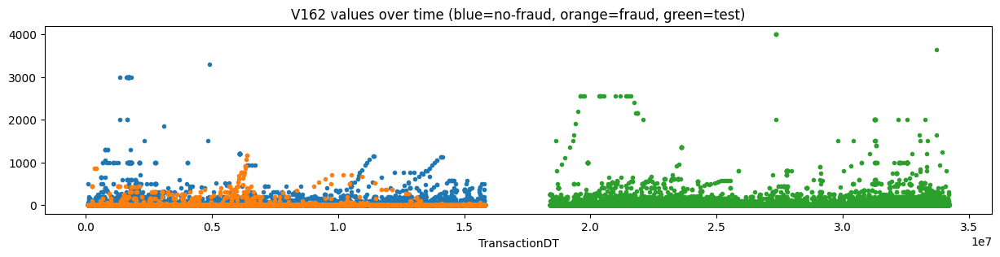

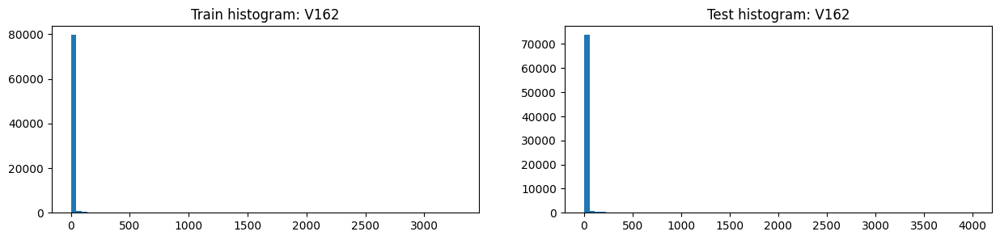

,V162,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81945.000000,3650.000000,78295.000000,75785.000000,8839.000000,66946.000000
1,mean,6.594661,23.676712,5.798320,8.262842,17.194932,7.083522
2,std,69.195180,95.172398,67.637239,79.645092,134.573335,69.123748
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,3300.000000,1170.000000,3300.000000,4000.000000,2550.000000,4000.000000
8,unique values,186.000000,67.000000,166.000000,205.000000,93.000000,175.000000
9,NaNs,508595.000000,17013.000000,491582.000000,430906.000000,92500.000000,338407.000000


,V162,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508595,0.033451,17013,430906.0
1,0.0,79008,0.041211,3256,72721.0
2,50.0,446,0.044843,20,364.0
3,100.0,349,0.088825,31,389.0
4,150.0,197,0.228426,45,159.0
5,25.0,181,0.104972,19,199.0
6,200.0,150,0.240000,36,168.0
7,75.0,107,0.112150,12,118.0
8,30.0,100,0.190000,19,89.0
9,20.0,96,0.020833,2,75.0


,V162,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508595,0.033451,17013,430906
1,0.0,79008,0.041211,3256,72721
2,150.0,197,0.228426,45,159
3,200.0,150,0.240000,36,168
4,300.0,87,0.367816,32,65
5,100.0,349,0.088825,31,389
6,250.0,70,0.342857,24,87
7,450.0,33,0.636364,21,19
8,50.0,446,0.044843,20,364
9,25.0,181,0.104972,19,199


,Column,Correlation with V162
0,V162,1.000000
1,V163,0.953249
2,V161,0.890452
3,V272,0.543913
4,V141,0.543292
5,V271,0.541850
327,D3,-0.054199
328,D7,-0.069279
329,D6,-0.107874
330,D5,-0.110770


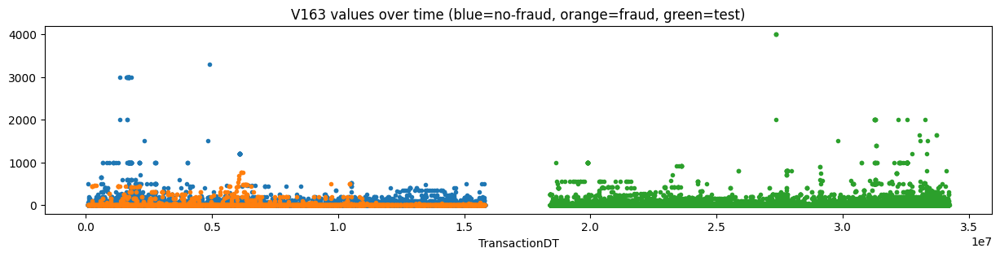

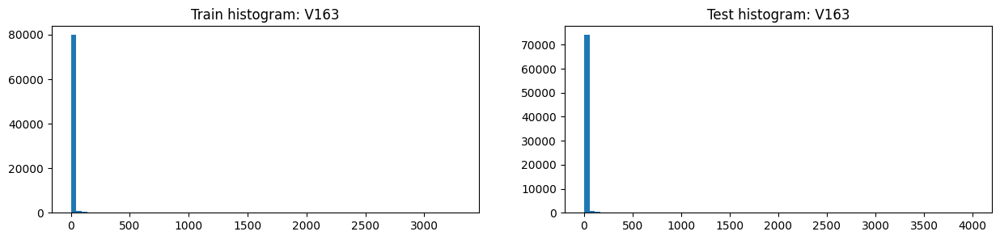

,V163,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81945.000000,3650.000000,78295.000000,75785.000000,8839.000000,66946.000000
1,mean,5.505955,19.100000,4.872220,6.146447,10.038692,5.632546
2,std,63.077887,75.358863,62.374807,59.674886,60.078465,59.602856
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,3300.000000,770.000000,3300.000000,4000.000000,1000.000000,4000.000000
8,unique values,107.000000,47.000000,92.000000,111.000000,50.000000,100.000000
9,NaNs,508595.000000,17013.000000,491582.000000,430906.000000,92500.000000,338407.000000


,V163,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508595,0.033451,17013,430906.0
1,0.0,79152,0.041477,3283,72901.0
2,50.0,473,0.042283,20,397.0
3,100.0,353,0.073654,26,384.0
4,150.0,196,0.234694,46,153.0
5,25.0,187,0.101604,19,228.0
6,200.0,143,0.251748,36,151.0
7,20.0,108,0.111111,12,80.0
8,75.0,96,0.125000,12,129.0
9,30.0,94,0.191489,18,142.0


,V163,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508595,0.033451,17013,430906
1,0.0,79152,0.041477,3283,72901
2,150.0,196,0.234694,46,153
3,200.0,143,0.251748,36,151
4,300.0,79,0.392405,31,49
5,100.0,353,0.073654,26,384
6,250.0,68,0.352941,24,102
7,450.0,33,0.636364,21,6
8,50.0,473,0.042283,20,397
9,25.0,187,0.101604,19,228


,Column,Correlation with V163
0,V163,1.000000
1,V162,0.953249
2,V161,0.949293
3,V272,0.577329
4,V138,0.560321
5,V271,0.554561
327,D3,-0.050976
328,D7,-0.059567
329,D6,-0.094489
330,D5,-0.116756


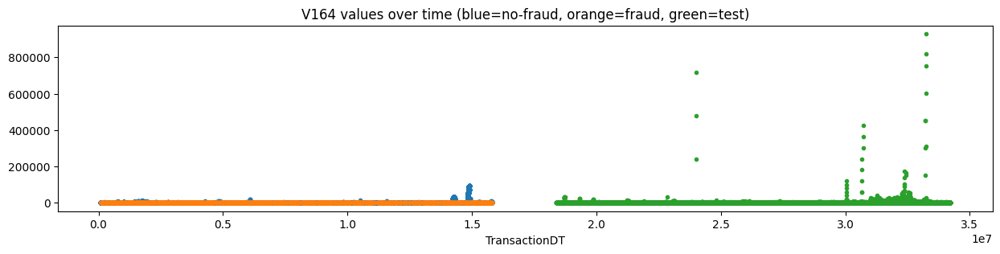

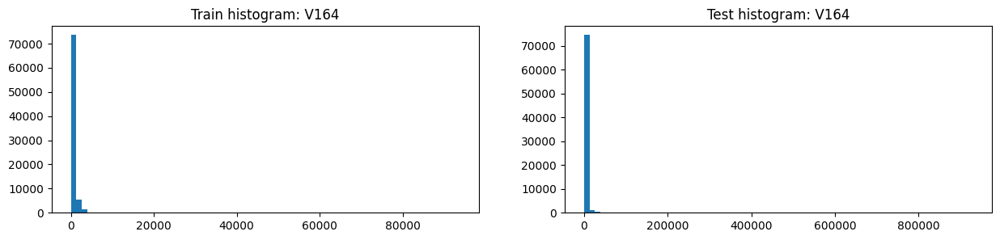

,V164,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81951.000000,3651.000000,78300.000000,76055.000000,8913.000000,67142.000000
1,mean,877.888928,109.053670,913.738450,1037.892796,160.010187,1154.430399
2,std,6049.166505,306.245568,6185.908288,8501.111699,1351.796328,9027.966960
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,100.000000,0.000000,0.000000,0.000000,0.000000
7,max,93736.000000,5450.000000,93736.000000,928882.000000,32880.000000,928882.000000
8,unique values,1979.000000,120.000000,1971.000000,1027.000000,172.000000,963.000000
9,NaNs,508589.000000,17012.000000,491577.000000,430636.000000,92426.000000,338211.000000


,V164,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508589,0.033449,17012,430636.0
1,0.0,63872,0.038734,2474,62799.0
2,100.0,982,0.119145,117,590.0
3,200.0,807,0.161090,130,701.0
4,150.0,679,0.189985,129,429.0
5,300.0,622,0.197749,123,383.0
6,50.0,592,0.092905,55,333.0
7,400.0,287,0.156794,45,363.0
8,450.0,276,0.177536,49,99.0
9,75.0,275,0.120000,33,135.0


,V164,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508589,0.033449,17012,430636
1,0.0,63872,0.038734,2474,62799
2,200.0,807,0.161090,130,701
3,150.0,679,0.189985,129,429
4,300.0,622,0.197749,123,383
5,100.0,982,0.119145,117,590
6,50.0,592,0.092905,55,333
7,450.0,276,0.177536,49,99
8,400.0,287,0.156794,45,363
9,600.0,271,0.151292,41,313


,Column,Correlation with V164
0,V164,1.000000
1,V143,0.996551
2,V316,0.992584
3,V132,0.992538
4,V101,0.991996
5,V293,0.991811
327,V50,-0.288600
328,V20,-0.341715
329,V19,-0.344706
330,V62,-0.381638


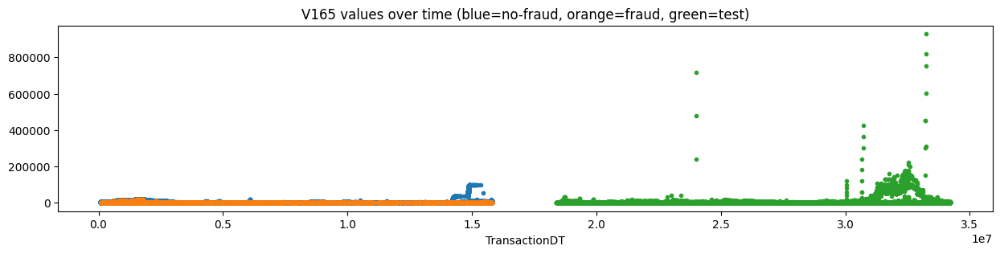

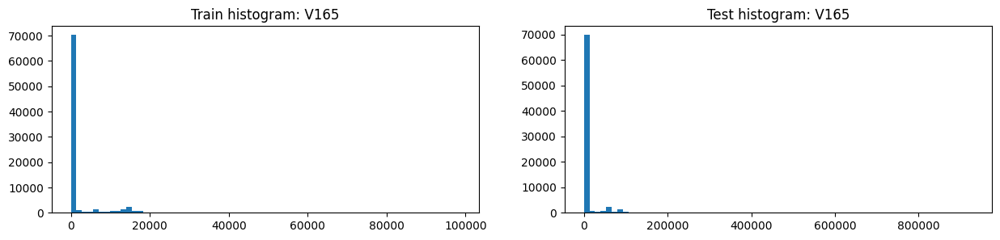

,V165,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81951.000000,3651.000000,78300.000000,76055.000000,8913.000000,67142.000000
1,mean,2239.912219,282.564747,2331.180107,5444.918030,391.059406,6115.810198
2,std,8223.258928,1410.663630,8396.153254,19835.961392,1938.348110,21008.536825
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,150.000000,0.000000,0.000000,0.000000,0.000000
7,max,98476.000000,17468.949219,98476.000000,928882.000000,32880.000000,928882.000000
8,unique values,2548.000000,180.000000,2522.000000,1502.000000,249.000000,1371.000000
9,NaNs,508589.000000,17012.000000,491577.000000,430636.000000,92426.000000,338211.000000


,V165,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508589,0.033449,17012,430636.0
1,0.0,62598,0.036503,2285,61294.0
2,100.0,921,0.125950,116,594.0
3,200.0,672,0.188988,127,481.0
4,150.0,661,0.211800,140,454.0
5,300.0,596,0.216443,129,354.0
6,50.0,536,0.110075,59,348.0
7,400.0,267,0.198502,53,228.0
8,600.0,250,0.196000,49,194.0
9,75.0,228,0.114035,26,133.0


,V165,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508589,0.033449,17012,430636
1,0.0,62598,0.036503,2285,61294
2,150.0,661,0.211800,140,454
3,300.0,596,0.216443,129,354
4,200.0,672,0.188988,127,481
5,100.0,921,0.125950,116,594
6,50.0,536,0.110075,59,348
7,400.0,267,0.198502,53,228
8,600.0,250,0.196000,49,194
9,450.0,179,0.262570,47,102


,Column,Correlation with V165
0,V165,1.000000
1,V143,0.879189
2,V134,0.876268
3,V318,0.876134
4,V103,0.875835
5,V295,0.875552
327,V19,-0.369173
328,V153,-0.374992
329,V62,-0.419944
330,V61,-0.423984


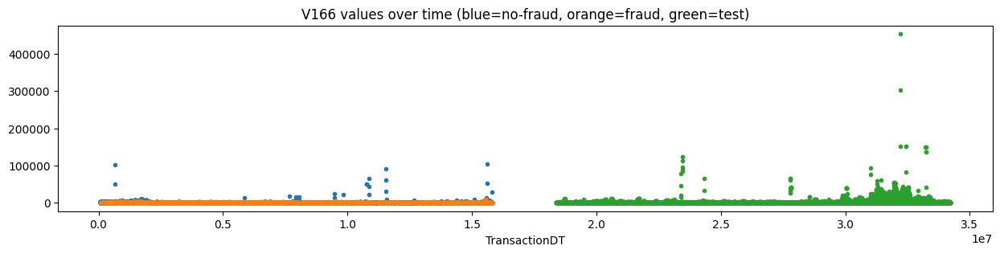

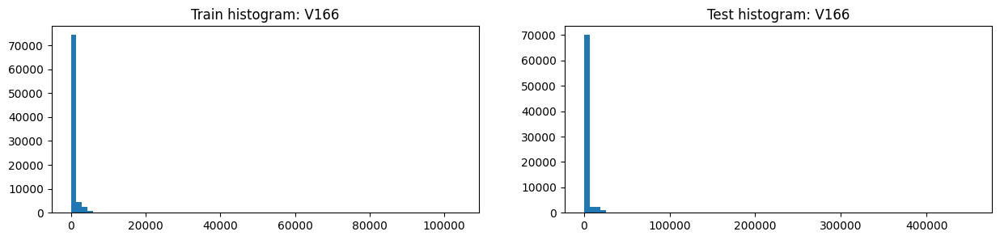

,V166,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,81951.000000,3651.000000,78300.000000,76055.000000,8913.000000,67142.000000
1,mean,359.469437,189.828217,367.379528,1387.647859,185.373432,1547.247989
2,std,1244.463270,536.808466,1267.306208,5266.892386,912.641928,5576.267413
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,175.000000,0.000000,0.000000,0.000000,0.000000
7,max,104060.000000,9000.000000,104060.000000,453750.000000,12000.000000,453750.000000
8,unique values,988.000000,164.000000,970.000000,1521.000000,217.000000,1450.000000
9,NaNs,508589.000000,17012.000000,491577.000000,430636.000000,92426.000000,338211.000000


,V166,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508589,0.033449,17012,430636.0
1,0.0,62439,0.036804,2298,59661.0
2,100.0,1391,0.073329,102,1083.0
3,200.0,1016,0.127953,130,922.0
4,1165.0,876,0.000000,0,NaN
5,150.0,736,0.158967,117,557.0
6,300.0,728,0.192308,140,547.0
7,50.0,625,0.092800,58,528.0
8,400.0,403,0.138958,56,492.0
9,500.0,363,0.107438,39,417.0


,V166,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508589,0.033449,17012,430636
1,0.0,62439,0.036804,2298,59661
2,300.0,728,0.192308,140,547
3,200.0,1016,0.127953,130,922
4,150.0,736,0.158967,117,557
5,100.0,1391,0.073329,102,1083
6,600.0,345,0.173913,60,331
7,50.0,625,0.092800,58,528
8,400.0,403,0.138958,56,492
9,450.0,254,0.204724,52,98


,Column,Correlation with V166
0,V166,1.000000
1,V144,0.718336
2,V145,0.676667
3,V150,0.673791
4,V159,0.656757
5,V151,0.654035
327,V155,-0.298567
328,V148,-0.311402
329,V154,-0.335570
330,V153,-0.344980


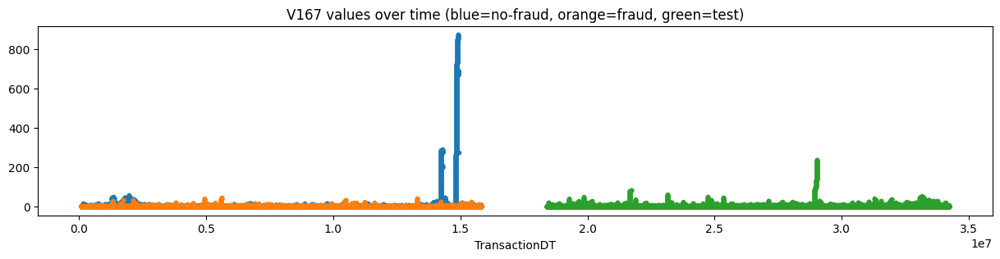

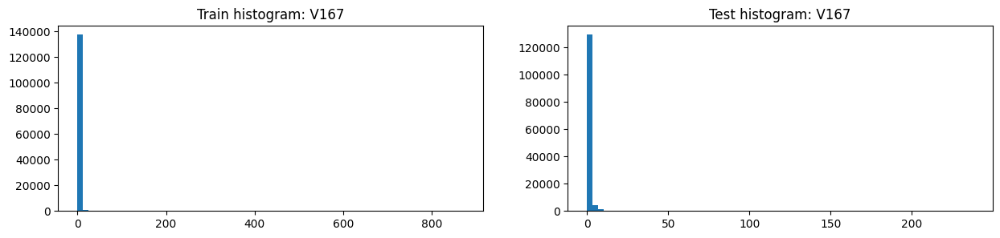

,V167,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,3.929514,2.078177,4.088443,0.969773,1.169478,0.939574
2,std,42.200980,4.182894,43.954364,6.422466,4.446515,6.670010
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,2.000000,0.000000,0.000000,1.000000,0.000000
7,max,872.000000,47.000000,872.000000,238.000000,85.000000,238.000000
8,unique values,874.000000,49.000000,874.000000,240.000000,87.000000,240.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V167,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,0.0,106161,0.047786,5073,103369.0
2,1.0,15561,0.135467,2108,15664.0
3,2.0,6854,0.178290,1222,6747.0
4,3.0,3592,0.211581,760,3589.0
5,4.0,2047,0.245237,502,2133.0
6,5.0,1106,0.279385,309,1225.0
7,6.0,715,0.304895,218,813.0
8,7.0,494,0.325911,161,542.0
9,8.0,343,0.361516,124,400.0


,V167,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,106161,0.047786,5073,103369
2,1.0,15561,0.135467,2108,15664
3,2.0,6854,0.178290,1222,6747
4,3.0,3592,0.211581,760,3589
5,4.0,2047,0.245237,502,2133
6,5.0,1106,0.279385,309,1225
7,6.0,715,0.304895,218,813
8,7.0,494,0.325911,161,542
9,8.0,343,0.361516,124,400


,Column,Correlation with V167
0,V167,1.000000
1,V177,0.999364
2,V211,0.997784
3,V322,0.992216
4,V293,0.992068
5,V101,0.992058
342,V62,-0.245819
343,V57,-0.251551
344,V20,-0.297717
345,V61,-0.309162


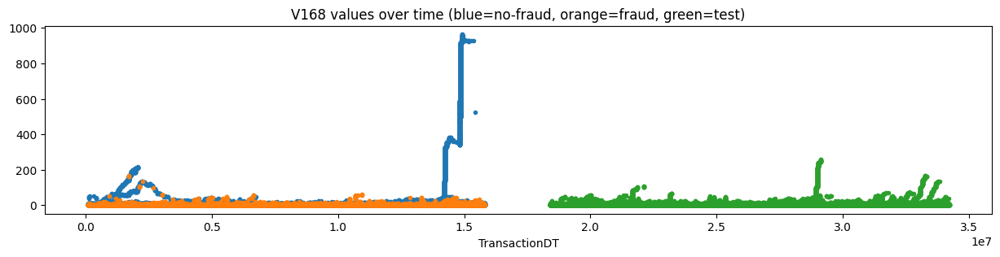

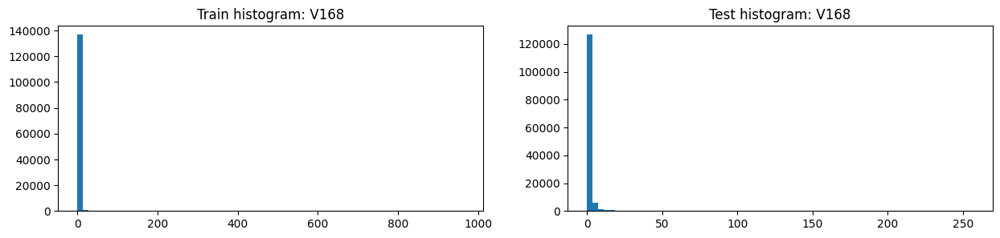

,V168,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,5.859501,2.904973,6.113133,1.422148,1.723345,1.376601
2,std,54.032468,6.689211,56.262604,8.431223,5.860936,8.753580
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.000000,3.000000,0.000000,1.000000,1.000000,1.000000
7,max,964.000000,164.000000,964.000000,257.000000,88.000000,257.000000
8,unique values,966.000000,71.000000,966.000000,259.000000,90.000000,259.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V168,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,0.0,101660,0.044806,4555,98083.0
2,1.0,16532,0.120252,1988,16922.0
3,2.0,7520,0.165559,1245,7541.0
4,3.0,4093,0.197899,810,4091.0
5,4.0,2397,0.236546,567,2510.0
6,5.0,1400,0.258571,362,1591.0
7,6.0,943,0.272534,257,1105.0
8,7.0,647,0.295209,191,743.0
9,8.0,476,0.329832,157,535.0


,V168,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,101660,0.044806,4555,98083
2,1.0,16532,0.120252,1988,16922
3,2.0,7520,0.165559,1245,7541
4,3.0,4093,0.197899,810,4091
5,4.0,2397,0.236546,567,2510
6,5.0,1400,0.258571,362,1591
7,6.0,943,0.272534,257,1105
8,7.0,647,0.295209,191,743
9,8.0,476,0.329832,157,535


,Column,Correlation with V168
0,V168,1.000000
1,V213,0.995785
2,V179,0.995005
3,V178,0.989183
4,V212,0.982553
5,V204,0.980744
342,V62,-0.276054
343,V57,-0.284264
344,V20,-0.335038
345,V61,-0.347383


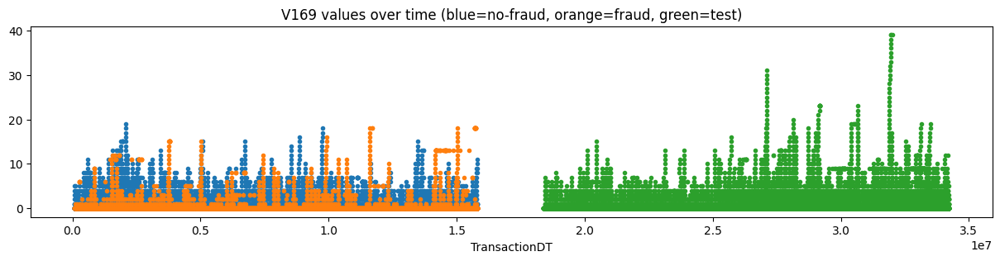

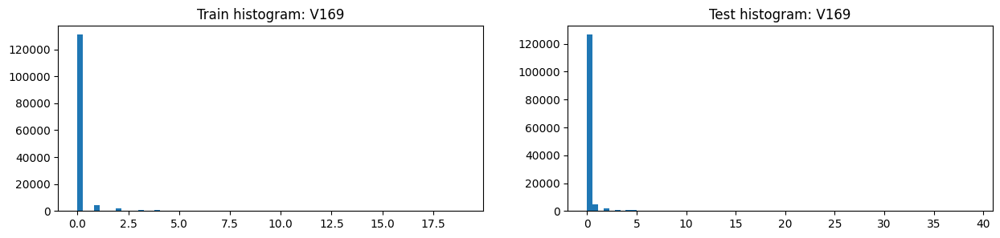

,V169,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139819.000000,11070.000000,128749.000000,136375.000000,17811.000000,118564.000000
1,mean,0.168053,0.378229,0.149982,0.202684,0.142103,0.211784
2,std,0.904944,1.752748,0.788091,1.130437,0.748096,1.176926
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,19.000000,18.000000,19.000000,39.000000,15.000000,39.000000
8,unique values,21.000000,20.000000,21.000000,41.000000,17.000000,41.000000
9,NaNs,450721.000000,9593.000000,441128.000000,370316.000000,83528.000000,286789.000000


,V169,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450721,0.021284,9593,370316
1,0.0,130911,0.077144,10099,126545
2,1.0,4117,0.077484,319,4829
3,2.0,1707,0.102519,175,1696
4,3.0,1034,0.093810,97,980
5,4.0,702,0.096866,68,687
6,5.0,394,0.126904,50,458
7,6.0,333,0.150150,50,257
8,7.0,177,0.158192,28,152
9,8.0,112,0.267857,30,117


,V169,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,130911,0.077144,10099,126545
1,-999.0,450721,0.021284,9593,370316
2,1.0,4117,0.077484,319,4829
3,2.0,1707,0.102519,175,1696
4,3.0,1034,0.093810,97,980
5,4.0,702,0.096866,68,687
6,5.0,394,0.126904,50,458
7,6.0,333,0.150150,50,257
8,13.0,58,0.689655,40,36
9,11.0,54,0.574074,31,55


,Column,Correlation with V169
0,V169,1.000000
1,V220,0.602435
2,V174,0.550426
3,V138,0.534889
4,V170,0.513739
5,V281,0.510292
342,D8,-0.102154
343,D3,-0.121426
344,D7,-0.127107
345,D5,-0.140623


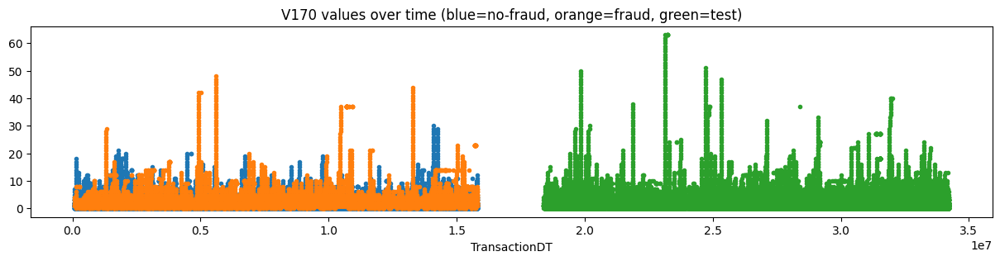

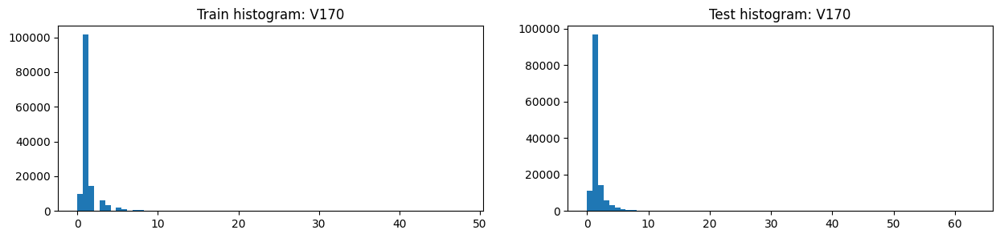

,V170,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139819.000000,11070.000000,128749.000000,136375.000000,17811.000000,118564.000000
1,mean,1.436779,2.928546,1.308515,1.487487,1.632923,1.465639
2,std,1.751143,4.370712,1.216551,2.151799,2.416838,2.108254
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,3.000000,1.000000,1.000000,2.000000,1.000000
7,max,48.000000,48.000000,30.000000,63.000000,50.000000,63.000000
8,unique values,50.000000,50.000000,32.000000,65.000000,52.000000,65.000000
9,NaNs,450721.000000,9593.000000,441128.000000,370316.000000,83528.000000,286789.000000


,V170,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450721,0.021284,9593,370316
1,1.0,101509,0.047966,4869,96726
2,2.0,14255,0.145633,2076,14296
3,0.0,9693,0.059631,578,10930
4,3.0,6204,0.184558,1145,5947
5,4.0,3199,0.224133,717,3053
6,5.0,1869,0.230605,431,1824
7,6.0,879,0.302617,266,1109
8,7.0,604,0.284768,172,617
9,8.0,406,0.386700,157,395


,V170,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450721,0.021284,9593,370316
1,1.0,101509,0.047966,4869,96726
2,2.0,14255,0.145633,2076,14296
3,3.0,6204,0.184558,1145,5947
4,4.0,3199,0.224133,717,3053
5,0.0,9693,0.059631,578,10930
6,5.0,1869,0.230605,431,1824
7,6.0,879,0.302617,266,1109
8,7.0,604,0.284768,172,617
9,8.0,406,0.386700,157,395


,Column,Correlation with V170
0,V170,1.000000
1,V200,0.812939
2,V201,0.769216
3,V171,0.767816
4,V188,0.657415
5,V139,0.621057
342,D7,-0.162967
343,D5,-0.184576
344,D13,-0.186188
345,D8,-0.192305


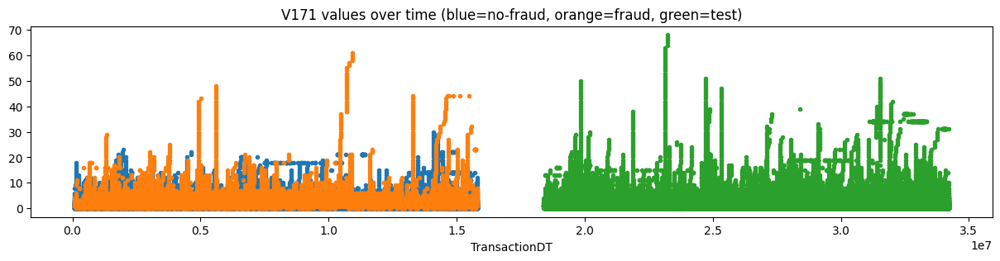

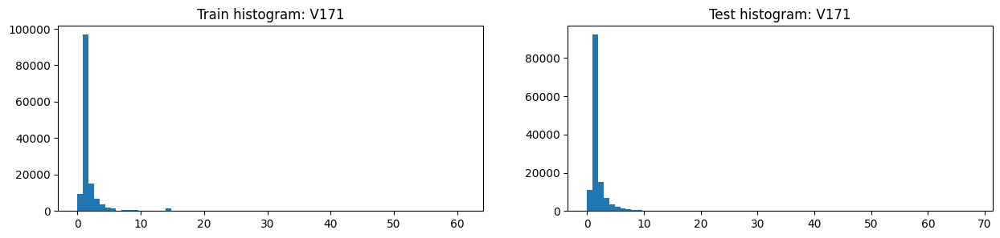

,V171,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139819.000000,11070.000000,128749.000000,136375.000000,17811.000000,118564.000000
1,mean,1.690908,3.496025,1.535701,1.735017,1.827073,1.721189
2,std,2.444748,5.267626,1.949572,2.941901,2.741076,2.970662
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,4.000000,1.000000,1.000000,2.000000,1.000000
7,max,61.000000,61.000000,30.000000,68.000000,50.000000,68.000000
8,unique values,63.000000,63.000000,32.000000,70.000000,52.000000,70.000000
9,NaNs,450721.000000,9593.000000,441128.000000,370316.000000,83528.000000,286789.000000


,V171,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450721,0.021284,9593,370316
1,1.0,96818,0.045787,4433,92136
2,2.0,15088,0.126922,1915,15079
3,0.0,9579,0.058252,558,10819
4,3.0,6802,0.172155,1171,6837
5,4.0,3644,0.206092,751,3652
6,5.0,2099,0.248690,522,2285
7,14.0,1425,0.032281,46,141
8,6.0,1264,0.283228,358,1318
9,7.0,727,0.298487,217,908


,V171,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450721,0.021284,9593,370316
1,1.0,96818,0.045787,4433,92136
2,2.0,15088,0.126922,1915,15079
3,3.0,6802,0.172155,1171,6837
4,4.0,3644,0.206092,751,3652
5,0.0,9579,0.058252,558,10819
6,5.0,2099,0.248690,522,2285
7,6.0,1264,0.283228,358,1318
8,7.0,727,0.298487,217,908
9,8.0,565,0.292035,165,551


,Column,Correlation with V171
0,V171,1.000000
1,V328,0.776599
2,V330,0.776004
3,V170,0.767816
4,V329,0.746572
5,V324,0.693042
342,D5,-0.191003
343,D7,-0.194041
344,D8,-0.206093
345,V19,-0.208211


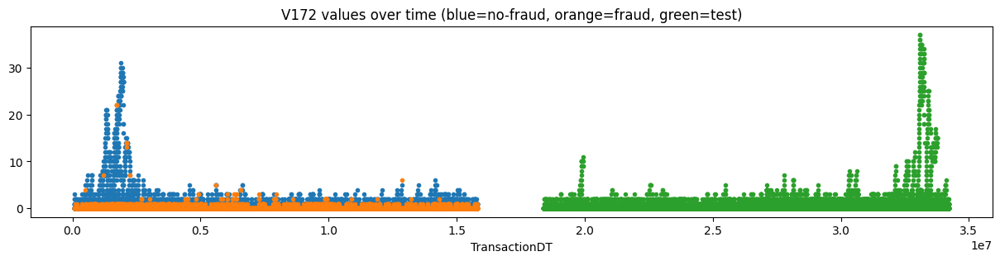

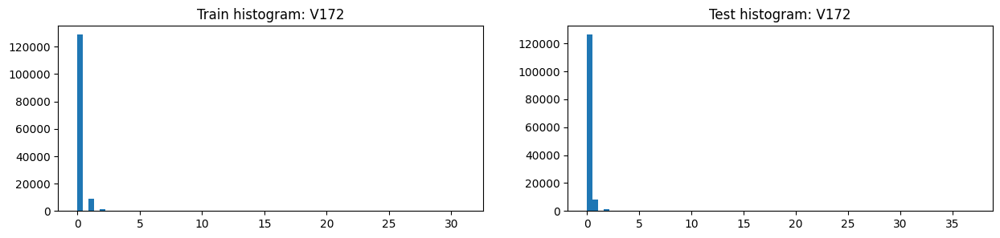

,V172,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,0.132012,0.090226,0.135599,0.128929,0.093258,0.134323
2,std,0.924894,0.547949,0.950226,0.922958,0.420441,0.976585
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,31.000000,22.000000,31.000000,37.000000,11.000000,37.000000
8,unique values,33.000000,12.000000,33.000000,39.000000,13.000000,39.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V172,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,128800,0.079604,10253,126250
2,1.0,8698,0.082203,715,8122
3,2.0,1361,0.035268,48,1518
4,3.0,265,0.033962,9,413
5,4.0,63,0.047619,3,107
6,7.0,48,0.041667,2,25
7,5.0,46,0.021739,1,37
8,6.0,39,0.025641,1,28
9,11.0,26,0.000000,0,25


,V172,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,128800,0.079604,10253,126250
1,-999.0,450909,0.021344,9624,369957
2,1.0,8698,0.082203,715,8122
3,2.0,1361,0.035268,48,1518
4,3.0,265,0.033962,9,413
5,4.0,63,0.047619,3,107
6,14.0,15,0.200000,3,7
7,22.0,7,0.428571,3,3
8,7.0,48,0.041667,2,25
9,5.0,46,0.021739,1,37


,Column,Correlation with V172
0,V172,1.000000
1,V196,0.894849
2,V207,0.877538
3,V191,0.862669
4,V186,0.826796
5,V193,0.795747
342,V195,-0.130846
343,D3,-0.144956
344,D2,-0.152250
345,V197,-0.152805


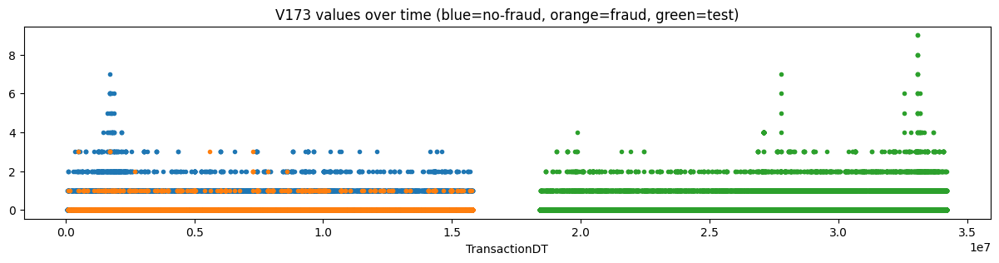

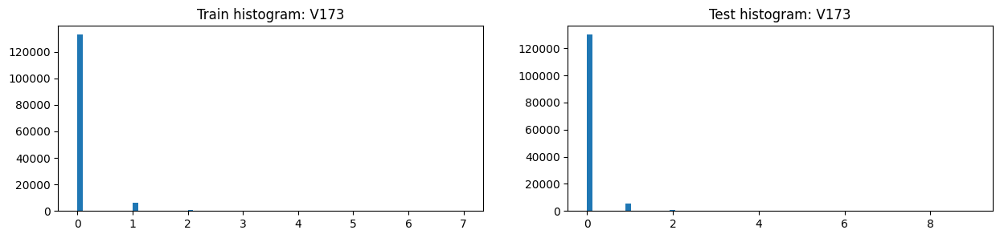

,V173,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,0.055231,0.035963,0.056885,0.060351,0.047714,0.062262
2,std,0.264439,0.197997,0.269317,0.294787,0.247269,0.301276
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,7.000000,3.000000,7.000000,9.000000,4.000000,9.000000
8,unique values,9.000000,5.000000,9.000000,11.000000,6.000000,11.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V173,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,132868,0.080238,10661,129946
2,1.0,6020,0.060631,365,5691
3,2.0,589,0.011885,7,853
4,3.0,124,0.048387,6,175
5,4.0,17,0.000000,0,46
6,6.0,7,0.000000,0,6
7,5.0,5,0.000000,0,8
8,7.0,1,0.000000,0,4


,V173,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,132868,0.080238,10661,129946
1,-999.0,450909,0.021344,9624,369957
2,1.0,6020,0.060631,365,5691
3,2.0,589,0.011885,7,853
4,3.0,124,0.048387,6,175
5,4.0,17,0.000000,0,46
6,6.0,7,0.000000,0,6
7,5.0,5,0.000000,0,8
8,7.0,1,0.000000,0,4


,Column,Correlation with V173
0,V173,1.000000
1,V286,0.755792
2,V223,0.675904
3,V284,0.539057
4,V174,0.497246
5,V172,0.484998
342,D8,-0.067997
343,D7,-0.142683
344,D3,-0.151036
345,D5,-0.160857


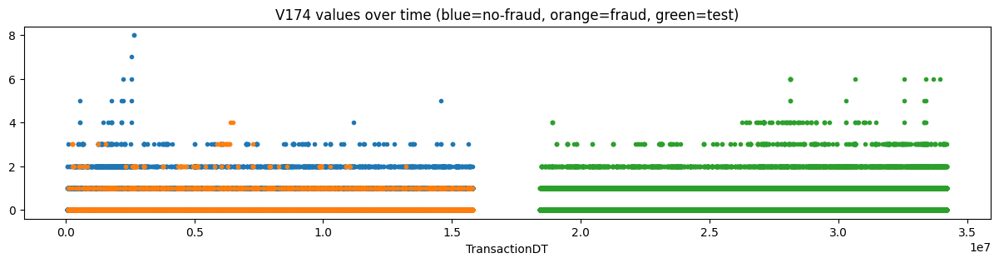

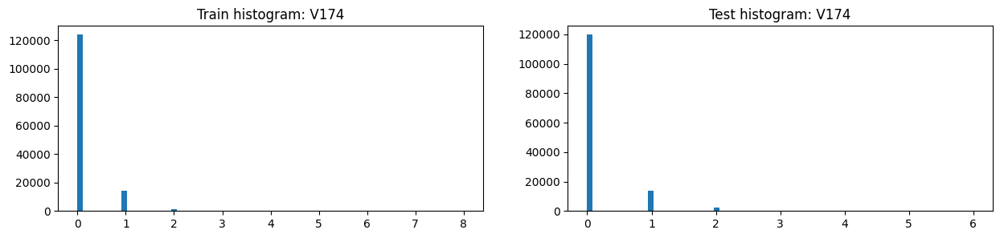

,V174,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139819.000000,11070.00000,128749.000000,136375.000000,17811.000000,118564.000000
1,mean,0.127794,0.14878,0.125989,0.146434,0.126719,0.149396
2,std,0.379763,0.39852,0.378054,0.431142,0.385226,0.437549
3,min,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
7,max,8.000000,4.00000,8.000000,6.000000,4.000000,6.000000
8,unique values,10.000000,6.00000,10.000000,8.000000,6.000000,8.000000
9,NaNs,450721.000000,9593.00000,441128.000000,370316.000000,83528.000000,286789.000000


,V174,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450721,0.021284,9593,370316.0
1,0.0,123863,0.077279,9572,119736.0
2,1.0,14337,0.095975,1376,13952.0
3,2.0,1373,0.070648,97,2184.0
4,3.0,220,0.104545,23,388.0
5,4.0,15,0.133333,2,99.0
6,5.0,6,0.000000,0,6.0
7,6.0,2,0.000000,0,10.0
8,8.0,2,0.000000,0,NaN
9,7.0,1,0.000000,0,NaN


,V174,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450721,0.021284,9593,370316.0
1,0.0,123863,0.077279,9572,119736.0
2,1.0,14337,0.095975,1376,13952.0
3,2.0,1373,0.070648,97,2184.0
4,3.0,220,0.104545,23,388.0
5,4.0,15,0.133333,2,99.0
6,5.0,6,0.000000,0,6.0
7,6.0,2,0.000000,0,10.0
8,8.0,2,0.000000,0,NaN
9,7.0,1,0.000000,0,NaN


,Column,Correlation with V174
0,V174,1.000000
1,V175,0.688603
2,V288,0.574345
3,V169,0.550426
4,V223,0.540546
5,V325,0.518946
342,D8,-0.187255
343,D5,-0.227062
344,D7,-0.228199
345,D3,-0.237316


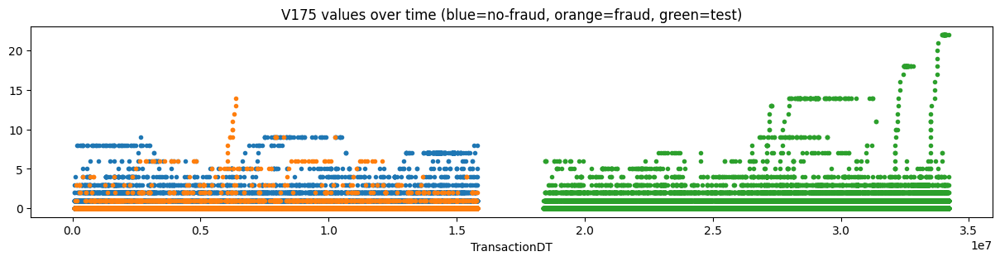

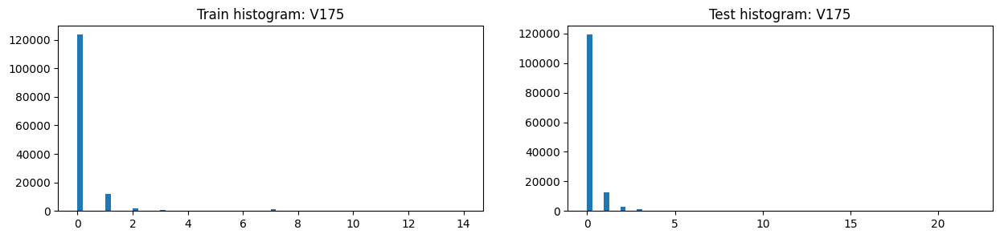

,V175,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139819.000000,11070.000000,128749.000000,136375.000000,17811.000000,118564.000000
1,mean,0.212639,0.206143,0.213198,0.198885,0.158498,0.204953
2,std,0.857133,0.717197,0.868112,0.819637,0.533102,0.854256
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,14.000000,14.000000,9.000000,22.000000,6.000000,22.000000
8,unique values,16.000000,16.000000,11.000000,24.000000,8.000000,24.000000
9,NaNs,450721.000000,9593.000000,441128.000000,370316.000000,83528.000000,286789.000000


,V175,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450721,0.021284,9593,370316
1,0.0,123575,0.077103,9528,119191
2,1.0,11962,0.102658,1228,12528
3,2.0,1866,0.090032,168,2931
4,7.0,1350,0.000741,1,42
5,3.0,537,0.106145,57,995
6,4.0,212,0.084906,18,283
7,5.0,116,0.155172,18,99
8,6.0,71,0.492958,35,55
9,8.0,64,0.015625,1,13


,V175,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450721,0.021284,9593,370316
1,0.0,123575,0.077103,9528,119191
2,1.0,11962,0.102658,1228,12528
3,2.0,1866,0.090032,168,2931
4,3.0,537,0.106145,57,995
5,6.0,71,0.492958,35,55
6,4.0,212,0.084906,18,283
7,5.0,116,0.155172,18,99
8,9.0,60,0.166667,10,46
9,10.0,2,1.000000,2,8


,Column,Correlation with V175
0,V175,1.000000
1,V327,0.820492
2,V330,0.799016
3,V329,0.795233
4,V326,0.776274
5,V287,0.764402
342,V15,-0.276069
343,V33,-0.279462
344,V61,-0.347248
345,V20,-0.367299


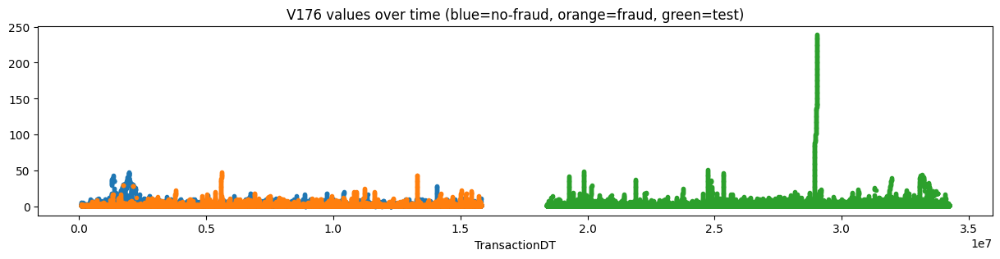

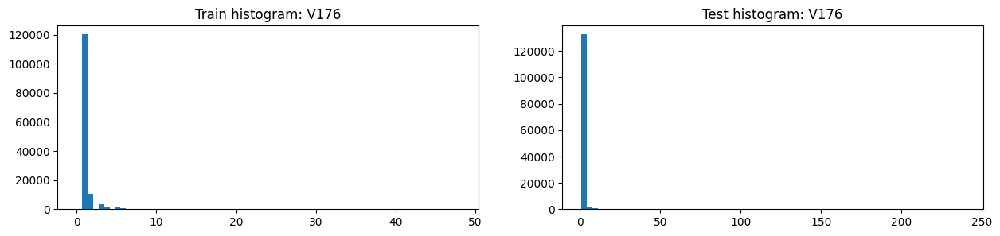

,V176,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,1.376979,2.403116,1.288890,1.636762,1.557931,1.648683
2,std,1.829420,3.468886,1.582096,6.094771,2.365208,6.474301
3,min,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,48.000000,48.000000,48.000000,239.000000,49.000000,239.000000
8,unique values,50.000000,50.000000,50.000000,240.000000,50.000000,240.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V176,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,1.0,120220,0.054675,6573,115854.0
2,2.0,10616,0.176149,1870,11120.0
3,3.0,3595,0.251460,904,3850.0
4,4.0,1770,0.282486,500,1855.0
5,5.0,995,0.292462,291,1049.0
6,6.0,603,0.325041,196,707.0
7,7.0,405,0.377778,153,462.0
8,8.0,269,0.371747,100,282.0
9,9.0,184,0.396739,73,202.0


,V176,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,1.0,120220,0.054675,6573,115854
2,2.0,10616,0.176149,1870,11120
3,3.0,3595,0.251460,904,3850
4,4.0,1770,0.282486,500,1855
5,5.0,995,0.292462,291,1049
6,6.0,603,0.325041,196,707
7,7.0,405,0.377778,153,462
8,8.0,269,0.371747,100,282
9,9.0,184,0.396739,73,202


,Column,Correlation with V176
0,V176,1.000000
1,V190,0.907568
2,V228,0.886161
3,V199,0.855774
4,V186,0.844532
5,V230,0.728197
342,D10,-0.059180
343,D3,-0.078379
344,D7,-0.149703
345,D2,-0.152559


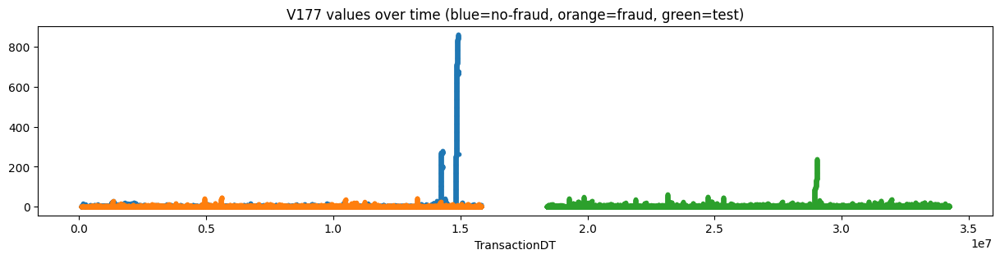

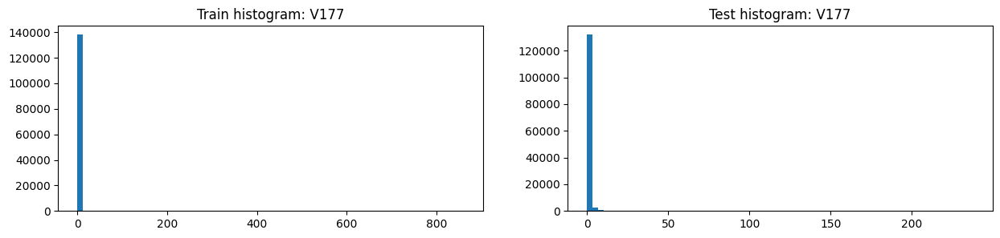

,V177,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,3.529245,1.595434,3.695253,0.642525,0.673515,0.637839
2,std,41.310622,3.878491,43.028239,6.105650,2.665517,6.468527
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000
7,max,861.000000,47.000000,861.000000,238.000000,49.000000,238.000000
8,unique values,863.000000,49.000000,863.000000,240.000000,51.000000,240.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V177,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,0.0,120997,0.053001,6413,119067.0
2,1.0,7687,0.233381,1794,6957.0
3,2.0,3871,0.230690,893,3810.0
4,3.0,2104,0.252852,532,2103.0
5,4.0,1189,0.285114,339,1305.0
6,5.0,677,0.355982,241,786.0
7,6.0,441,0.385488,170,525.0
8,7.0,349,0.389685,136,381.0
9,8.0,232,0.413793,96,272.0


,V177,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,120997,0.053001,6413,119067
2,1.0,7687,0.233381,1794,6957
3,2.0,3871,0.230690,893,3810
4,3.0,2104,0.252852,532,2103
5,4.0,1189,0.285114,339,1305
6,5.0,677,0.355982,241,786
7,6.0,441,0.385488,170,525
8,7.0,349,0.389685,136,381
9,8.0,232,0.413793,96,272


,Column,Correlation with V177
0,V177,1.000000
1,V167,0.999364
2,V211,0.998120
3,V293,0.992765
4,V101,0.992760
5,V132,0.992568
342,V62,-0.242777
343,V57,-0.248370
344,V20,-0.293846
345,V61,-0.305618


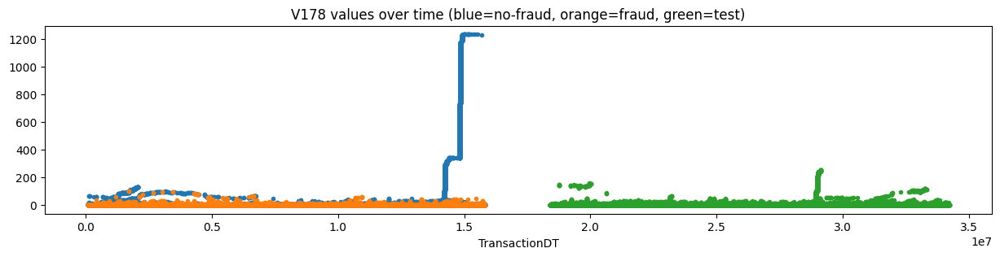

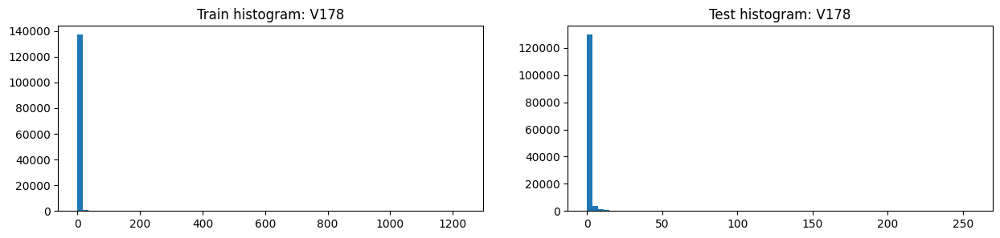

,V178,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,6.649283,2.728055,6.985901,1.083995,1.521519,1.017832
2,std,69.447364,7.235370,72.325917,8.525969,9.611565,8.347576
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000
7,max,1235.000000,102.000000,1235.000000,257.000000,158.000000,257.000000
8,unique values,1237.000000,75.000000,1237.000000,259.000000,90.000000,259.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V178,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,0.0,118836,0.049943,5935,116464.0
2,1.0,7569,0.219448,1661,6927.0
3,2.0,3987,0.221219,882,3977.0
4,3.0,2232,0.234767,524,2346.0
5,4.0,1336,0.269461,360,1519.0
6,5.0,829,0.328106,272,983.0
7,6.0,548,0.377737,207,703.0
8,7.0,430,0.400000,172,507.0
9,8.0,296,0.418919,124,392.0


,V178,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,118836,0.049943,5935,116464
2,1.0,7569,0.219448,1661,6927
3,2.0,3987,0.221219,882,3977
4,3.0,2232,0.234767,524,2346
5,4.0,1336,0.269461,360,1519
6,5.0,829,0.328106,272,983
7,6.0,548,0.377737,207,703
8,7.0,430,0.400000,172,507
9,8.0,296,0.418919,124,392


,Column,Correlation with V178
0,V178,1.000000
1,V179,0.992829
2,V213,0.992741
3,V133,0.989661
4,V102,0.989563
5,V168,0.989183
342,V62,-0.265615
343,V57,-0.272727
344,V20,-0.320757
345,V61,-0.334222


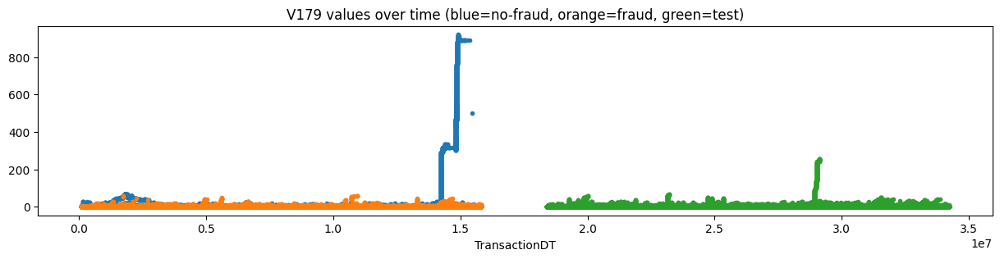

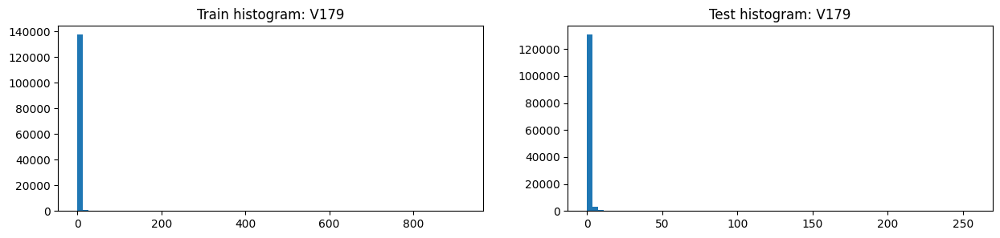

,V179,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,4.869012,2.128363,5.104283,0.822985,0.910528,0.809746
2,std,50.489426,5.128527,52.583847,6.981044,3.580067,7.359713
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000
7,max,920.000000,60.000000,920.000000,257.000000,58.000000,257.000000
8,unique values,922.000000,62.000000,922.000000,259.000000,60.000000,259.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V179,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,0.0,119688,0.050732,6072,117611.0
2,1.0,7570,0.227873,1725,6913.0
3,2.0,3933,0.229087,901,3890.0
4,3.0,2177,0.248507,541,2259.0
5,4.0,1311,0.279939,367,1448.0
6,5.0,770,0.336364,259,878.0
7,6.0,520,0.378846,197,609.0
8,7.0,389,0.424165,165,436.0
9,8.0,267,0.445693,119,334.0


,V179,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,119688,0.050732,6072,117611
2,1.0,7570,0.227873,1725,6913
3,2.0,3933,0.229087,901,3890
4,3.0,2177,0.248507,541,2259
5,4.0,1311,0.279939,367,1448
6,5.0,770,0.336364,259,878
7,6.0,520,0.378846,197,609
8,7.0,389,0.424165,165,436
9,8.0,267,0.445693,119,334


,Column,Correlation with V179
0,V179,1.000000
1,V213,0.996031
2,V168,0.995005
3,V178,0.992829
4,V134,0.988627
5,V103,0.988141
342,V62,-0.271558
343,V57,-0.278493
344,V20,-0.328730
345,V61,-0.341973


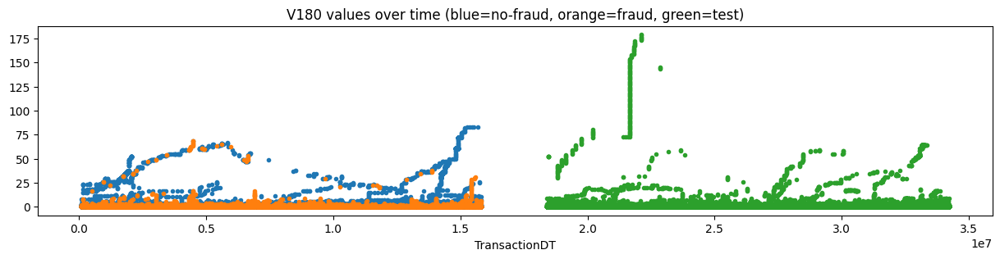

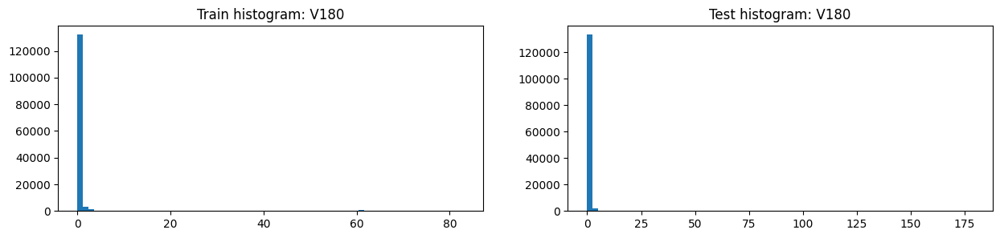

,V180,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139819.000000,11070.000000,128749.000000,136375.000000,17811.000000,118564.000000
1,mean,0.924123,0.729449,0.940862,0.465687,1.089664,0.371951
2,std,6.112630,3.797911,6.271623,4.623885,8.995338,3.517104
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,83.000000,68.000000,83.000000,179.000000,158.000000,179.000000
8,unique values,85.000000,55.000000,85.000000,181.000000,154.000000,89.000000
9,NaNs,450721.000000,9593.000000,441128.000000,370316.000000,83528.000000,286789.000000


,V180,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450721,0.021284,9593,370316
1,0.0,122945,0.069608,8558,120424
2,1.0,9318,0.147242,1372,9781
3,2.0,2888,0.185942,537,2920
4,3.0,1096,0.200730,220,1098
5,61.0,874,0.004577,4,16
6,4.0,465,0.238710,111,580
7,5.0,267,0.247191,66,268
8,34.0,242,0.020661,5,10
9,6.0,139,0.258993,36,132


,V180,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450721,0.021284,9593,370316
1,0.0,122945,0.069608,8558,120424
2,1.0,9318,0.147242,1372,9781
3,2.0,2888,0.185942,537,2920
4,3.0,1096,0.200730,220,1098
5,4.0,465,0.238710,111,580
6,5.0,267,0.247191,66,268
7,6.0,139,0.258993,36,132
8,7.0,86,0.267442,23,100
9,8.0,71,0.225352,16,47


,Column,Correlation with V180
0,V180,1.000000
1,V182,0.990448
2,V183,0.924192
3,V203,0.914924
4,V236,0.894956
5,V237,0.894217
342,V33,-0.305915
343,V57,-0.312480
344,V20,-0.366732
345,V61,-0.373874


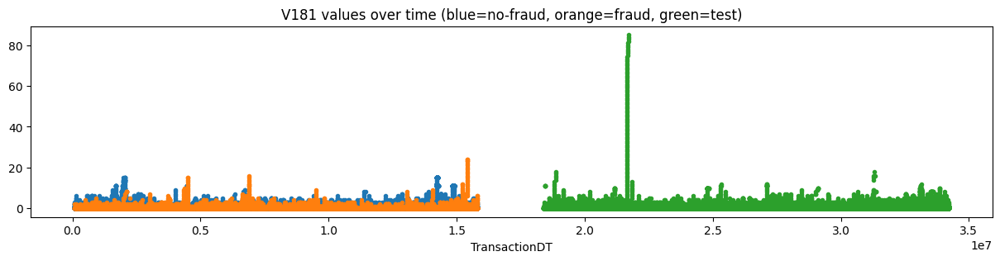

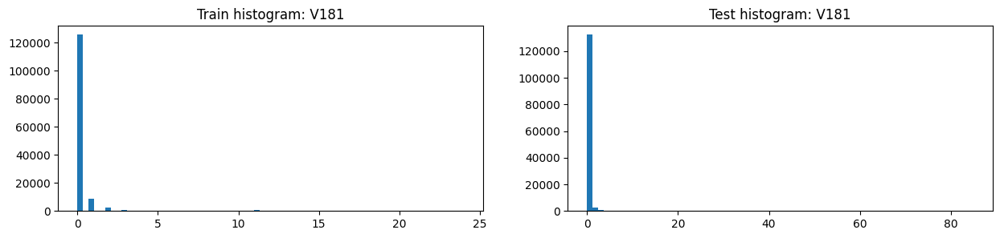

,V181,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,0.253332,0.374128,0.242962,0.183173,0.383442,0.152888
2,std,1.248974,1.241782,1.249050,1.389138,3.469564,0.627886
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,24.000000,24.000000,15.000000,85.000000,85.000000,18.000000
8,unique values,26.000000,26.000000,17.000000,87.000000,87.000000,19.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V181,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,125518,0.071249,8943,123637
2,1.0,8514,0.148931,1268,8758
3,2.0,2597,0.169041,439,2465
4,11.0,986,0.005071,5,23
5,3.0,953,0.189927,181,966
6,4.0,403,0.200993,81,354
7,15.0,179,0.022346,4,3
8,5.0,164,0.231707,38,157
9,6.0,87,0.195402,17,92


,V181,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,125518,0.071249,8943,123637
2,1.0,8514,0.148931,1268,8758
3,2.0,2597,0.169041,439,2465
4,3.0,953,0.189927,181,966
5,4.0,403,0.200993,81,354
6,5.0,164,0.231707,38,157
7,6.0,87,0.195402,17,92
8,7.0,62,0.241935,15,49
9,8.0,42,0.285714,12,58


,Column,Correlation with V181
0,V181,1.000000
1,V235,0.946890
2,V183,0.916185
3,V328,0.912131
4,V104,0.889643
5,V297,0.886993
342,V33,-0.295739
343,V57,-0.303006
344,V20,-0.348415
345,V61,-0.364457


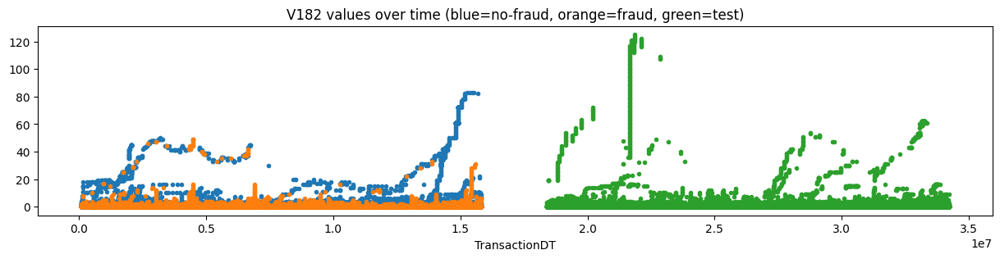

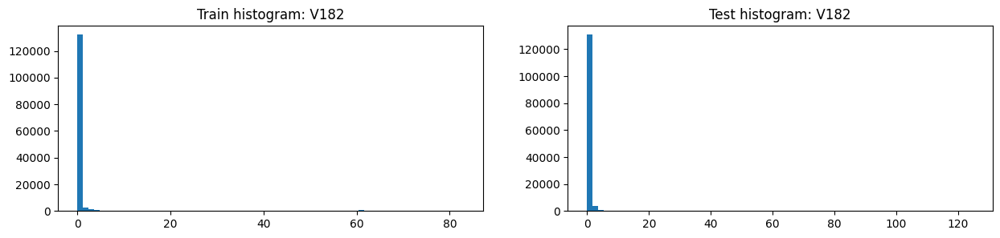

,V182,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,0.856243,0.656400,0.873398,0.407667,0.838149,0.342569
2,std,5.792934,2.961885,5.973453,3.638033,6.506766,2.966882
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,83.000000,49.000000,83.000000,125.000000,121.000000,125.000000
8,unique values,85.000000,49.000000,85.000000,127.000000,123.000000,78.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V182,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,123142,0.069570,8567,121029
2,1.0,9105,0.148600,1353,9683
3,2.0,2826,0.186837,528,2896
4,3.0,1077,0.197772,213,1083
5,61.0,863,0.000000,0,9
6,4.0,487,0.232033,113,536
7,5.0,243,0.263374,64,265
8,34.0,195,0.000000,0,7
9,6.0,129,0.263566,34,142


,V182,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,123142,0.069570,8567,121029
2,1.0,9105,0.148600,1353,9683
3,2.0,2826,0.186837,528,2896
4,3.0,1077,0.197772,213,1083
5,4.0,487,0.232033,113,536
6,5.0,243,0.263374,64,265
7,6.0,129,0.263566,34,142
8,7.0,85,0.270588,23,108
9,8.0,61,0.262295,16,57


,Column,Correlation with V182
0,V182,1.000000
1,V180,0.990448
2,V183,0.947036
3,V203,0.918220
4,V237,0.914108
5,V204,0.913928
342,V33,-0.304310
343,V57,-0.312529
344,V20,-0.366313
345,V61,-0.376543


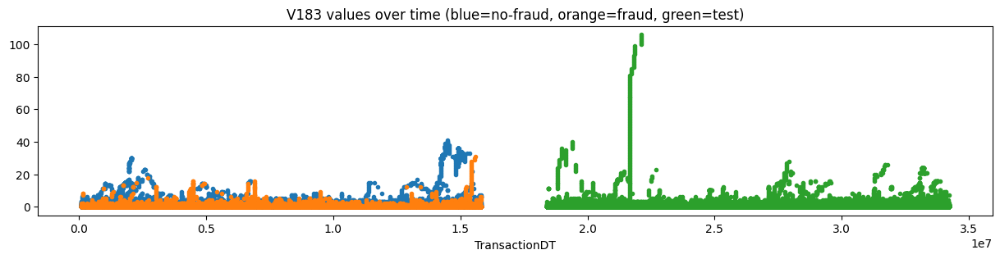

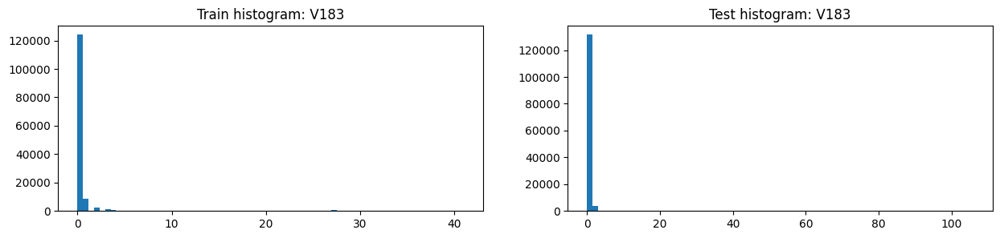

,V183,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,0.484692,0.478123,0.485256,0.265311,0.504426,0.229151
2,std,2.946982,1.603992,3.034699,2.091527,3.815817,1.680566
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,41.000000,31.000000,41.000000,106.000000,85.000000,106.000000
8,unique values,43.000000,33.000000,43.000000,108.000000,87.000000,51.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V183,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,124108,0.070028,8691,122245
2,1.0,8833,0.152610,1348,9251
3,2.0,2688,0.185640,499,2643
4,3.0,1069,0.187091,200,1033
5,27.0,658,0.001520,1,4
6,4.0,481,0.185031,89,462
7,30.0,346,0.002890,1,3
8,5.0,242,0.260331,63,218
9,6.0,137,0.175182,24,111


,V183,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,124108,0.070028,8691,122245
2,1.0,8833,0.152610,1348,9251
3,2.0,2688,0.185640,499,2643
4,3.0,1069,0.187091,200,1033
5,4.0,481,0.185031,89,462
6,5.0,242,0.260331,63,218
7,6.0,137,0.175182,24,111
8,7.0,134,0.141791,19,73
9,12.0,56,0.303571,17,46


,Column,Correlation with V183
0,V183,1.000000
1,V182,0.947036
2,V237,0.945907
3,V180,0.924192
4,V330,0.920676
5,V181,0.916185
342,V62,-0.308419
343,V57,-0.318279
344,V20,-0.370086
345,V61,-0.383887


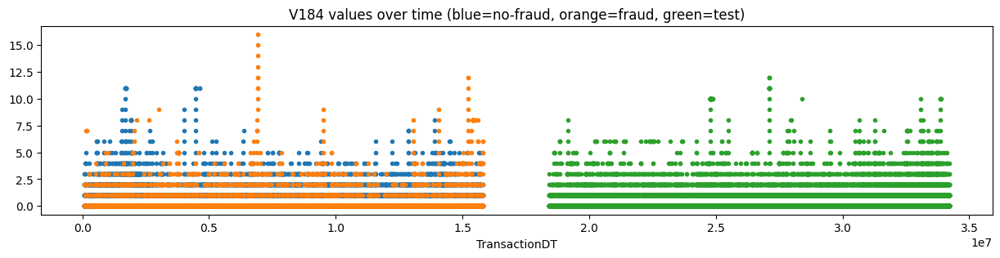

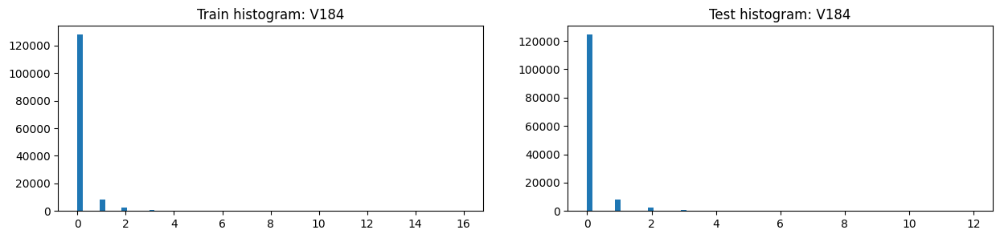

,V184,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139819.000000,11070.000000,128749.000000,136375.000000,17811.000000,118564.000000
1,mean,0.132364,0.357453,0.113011,0.133588,0.133850,0.133548
2,std,0.543699,1.007989,0.478478,0.540079,0.522965,0.542605
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,16.000000,16.000000,11.000000,12.000000,8.000000,12.000000
8,unique values,18.000000,18.000000,13.000000,14.000000,10.000000,14.000000
9,NaNs,450721.000000,9593.000000,441128.000000,370316.000000,83528.000000,286789.000000


,V184,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450721,0.021284,9593,370316.0
1,0.0,127855,0.069680,8909,124428.0
2,1.0,8175,0.160489,1312,8320.0
3,2.0,2356,0.193124,455,2282.0
4,3.0,852,0.238263,203,755.0
5,4.0,310,0.241935,75,314.0
6,5.0,118,0.338983,40,110.0
7,6.0,44,0.340909,15,77.0
8,8.0,43,0.720930,31,11.0
9,7.0,24,0.500000,12,26.0


,V184,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450721,0.021284,9593,370316
1,0.0,127855,0.069680,8909,124428
2,1.0,8175,0.160489,1312,8320
3,2.0,2356,0.193124,455,2282
4,3.0,852,0.238263,203,755
5,4.0,310,0.241935,75,314
6,5.0,118,0.338983,40,110
7,8.0,43,0.720930,31,11
8,6.0,44,0.340909,15,77
9,7.0,24,0.500000,12,26


,Column,Correlation with V184
0,V184,1.000000
1,V185,0.820196
2,V146,0.748912
3,V238,0.744011
4,V239,0.710068
5,V147,0.705138
342,D13,-0.053101
343,D3,-0.081395
344,D8,-0.104465
345,D7,-0.125043


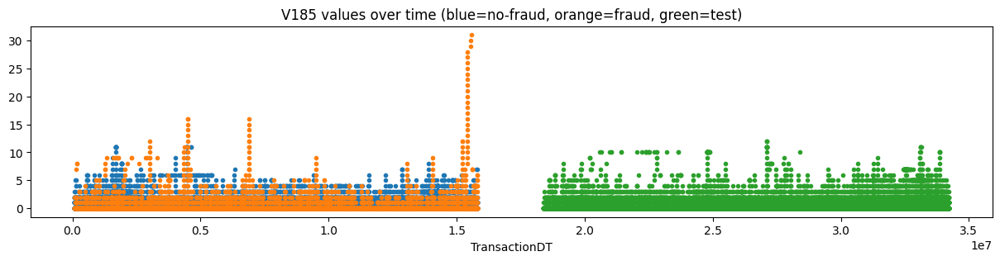

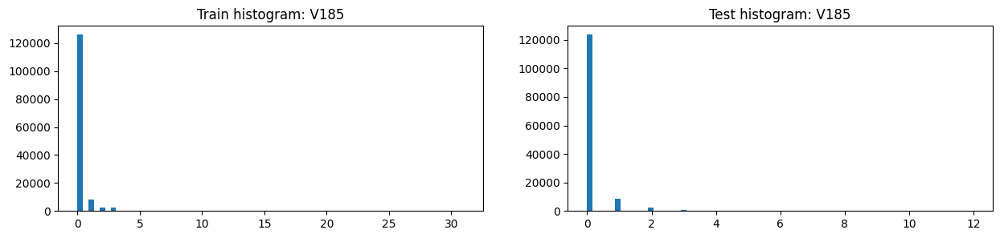

,V185,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139819.000000,11070.000000,128749.000000,136375.000000,17811.000000,118564.000000
1,mean,0.173903,0.434598,0.151489,0.155234,0.151816,0.155747
2,std,0.699733,1.473350,0.582022,0.631667,0.607990,0.635149
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,31.000000,31.000000,11.000000,12.000000,10.000000,12.000000
8,unique values,33.000000,33.000000,13.000000,14.000000,12.000000,14.000000
9,NaNs,450721.000000,9593.000000,441128.000000,370316.000000,83528.000000,286789.000000


,V185,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450721,0.021284,9593,370316.0
1,0.0,126057,0.069976,8821,123653.0
2,1.0,8316,0.156445,1301,8468.0
3,2.0,2445,0.195501,478,2426.0
4,3.0,2237,0.092088,206,845.0
5,4.0,391,0.237852,93,372.0
6,5.0,142,0.366197,52,334.0
7,6.0,80,0.225000,18,83.0
8,7.0,33,0.575758,19,79.0
9,8.0,26,0.538462,14,26.0


,V185,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450721,0.021284,9593,370316
1,0.0,126057,0.069976,8821,123653
2,1.0,8316,0.156445,1301,8468
3,2.0,2445,0.195501,478,2426
4,3.0,2237,0.092088,206,845
5,4.0,391,0.237852,93,372
6,5.0,142,0.366197,52,334
7,9.0,24,0.833333,20,12
8,7.0,33,0.575758,19,79
9,6.0,80,0.225000,18,83


,Column,Correlation with V185
0,V185,1.000000
1,V184,0.820196
2,V181,0.690330
3,V147,0.663533
4,V235,0.663158
5,V239,0.656210
342,V57,-0.226867
343,V33,-0.228887
344,V20,-0.246433
345,V61,-0.265026


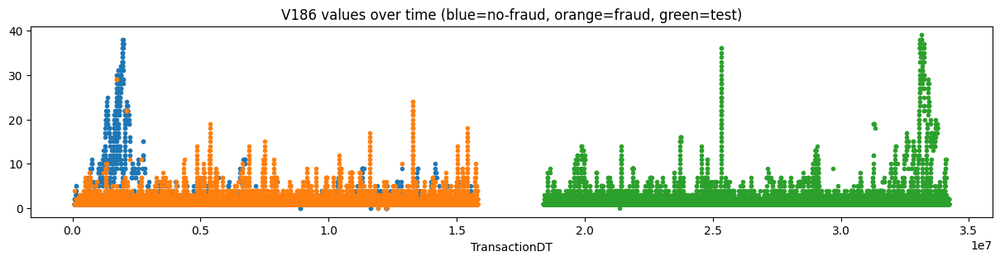

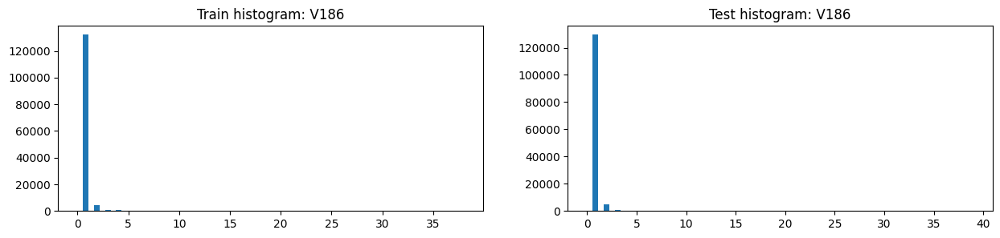

,V186,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,1.148799,1.770631,1.095418,1.136630,1.155114,1.133835
2,std,1.223529,1.879338,1.134161,1.159961,0.783241,1.206713
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,38.000000,29.000000,38.000000,39.000000,14.000000,39.000000
8,unique values,40.000000,27.000000,40.000000,41.000000,16.000000,40.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V186,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957
1,1.0,132235,0.057322,7580,129576
2,2.0,4599,0.383344,1763,4727
3,3.0,1004,0.678287,681,936
4,4.0,499,0.751503,375,419
5,5.0,288,0.701389,202,230
6,6.0,189,0.645503,122,159
7,7.0,138,0.739130,102,116
8,8.0,102,0.627451,64,63
9,9.0,100,0.390000,39,69


,V186,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,1.0,132235,0.057322,7580,129576
2,2.0,4599,0.383344,1763,4727
3,3.0,1004,0.678287,681,936
4,4.0,499,0.751503,375,419
5,5.0,288,0.701389,202,230
6,6.0,189,0.645503,122,159
7,7.0,138,0.739130,102,116
8,8.0,102,0.627451,64,63
9,9.0,100,0.390000,39,69


,Column,Correlation with V186
0,V186,1.000000
1,V190,0.929558
2,V196,0.905683
3,V191,0.892845
4,V199,0.882910
5,V176,0.844532
342,V21,-0.036145
343,V197,-0.043113
344,V194,-0.066608
345,D7,-0.070030


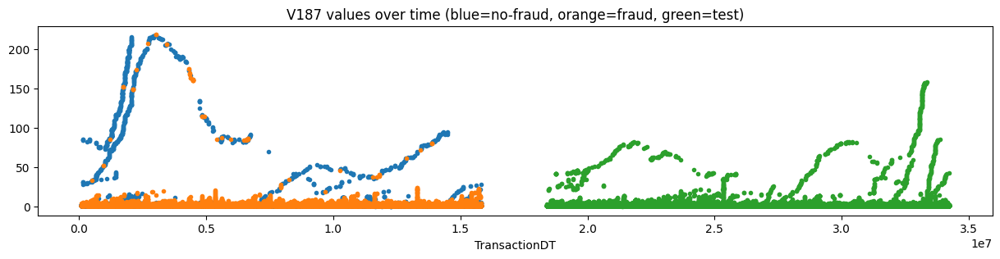

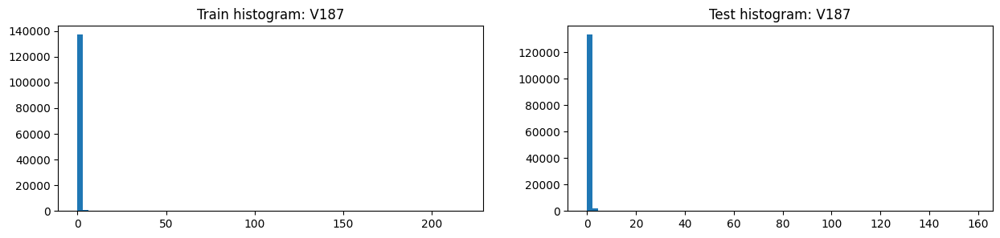

,V187,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,1.843752,2.661111,1.773586,1.451585,1.616781,1.426604
2,std,9.884390,9.536890,9.910548,5.054267,4.716077,5.103012
3,min,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,218.000000,218.000000,217.000000,158.000000,81.000000,158.000000
8,unique values,216.000000,57.000000,215.000000,157.000000,67.000000,156.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V187,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,1.0,130076,0.053184,6918,126930.0
2,2.0,5812,0.322780,1876,6272.0
3,3.0,1170,0.685470,802,1156.0
4,4.0,520,0.876923,456,550.0
5,5.0,276,0.887681,245,266.0
6,6.0,177,0.898305,159,186.0
7,7.0,169,0.964497,163,117.0
8,8.0,107,0.869159,93,78.0
9,9.0,72,0.805556,58,86.0


,V187,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,1.0,130076,0.053184,6918,126930
2,2.0,5812,0.322780,1876,6272
3,3.0,1170,0.685470,802,1156
4,4.0,520,0.876923,456,550
5,5.0,276,0.887681,245,266
6,7.0,169,0.964497,163,117
7,6.0,177,0.898305,159,186
8,8.0,107,0.869159,93,78
9,9.0,72,0.805556,58,86


,Column,Correlation with V187
0,V187,1.000000
1,V192,0.960413
2,V193,0.933544
3,V207,0.824993
4,V191,0.823915
5,V196,0.802782
342,V251,-0.108820
343,V250,-0.112653
344,V195,-0.128721
345,V197,-0.181801


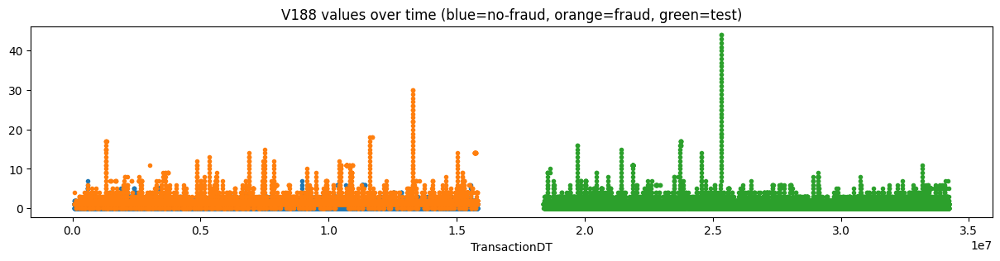

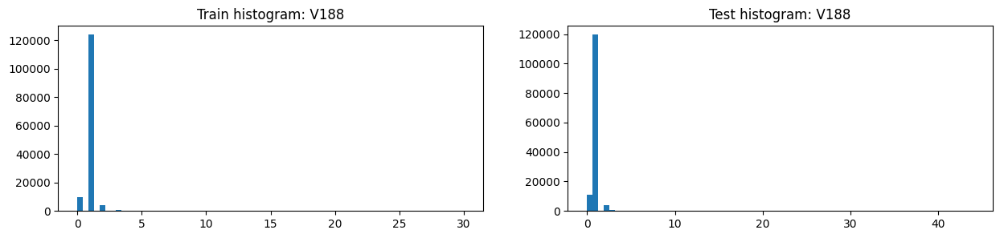

,V188,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139819.000000,11070.000000,128749.000000,136375.000000,17811.000000,118564.000000
1,mean,1.014755,1.709666,0.955005,0.994823,1.016787,0.991524
2,std,0.671207,1.976803,0.328935,0.707207,0.709919,0.706743
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,30.000000,30.000000,7.000000,44.000000,16.000000,44.000000
8,unique values,32.000000,32.000000,9.000000,46.000000,18.000000,46.000000
9,NaNs,450721.000000,9593.000000,441128.000000,370316.000000,83528.000000,286789.000000


,V188,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450721,0.021284,9593,370316
1,1.0,123940,0.057512,7128,119626
2,0.0,9693,0.059631,578,10930
3,2.0,4257,0.405685,1727,4154
4,3.0,877,0.770810,676,953
5,4.0,377,0.936340,353,290
6,5.0,194,0.902062,175,157
7,6.0,158,0.708861,112,84
8,7.0,107,0.981308,105,42
9,11.0,44,1.000000,44,29


,V188,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450721,0.021284,9593,370316
1,1.0,123940,0.057512,7128,119626
2,2.0,4257,0.405685,1727,4154
3,3.0,877,0.770810,676,953
4,0.0,9693,0.059631,578,10930
5,4.0,377,0.936340,353,290
6,5.0,194,0.902062,175,157
7,6.0,158,0.708861,112,84
8,7.0,107,0.981308,105,42
9,11.0,44,1.000000,44,29


,Column,Correlation with V188
0,V188,1.000000
1,V189,0.899481
2,V200,0.784486
3,V201,0.740297
4,V170,0.657415
5,V244,0.655513
342,D1,-0.133756
343,D6,-0.135053
344,D8,-0.172655
345,D2,-0.258807


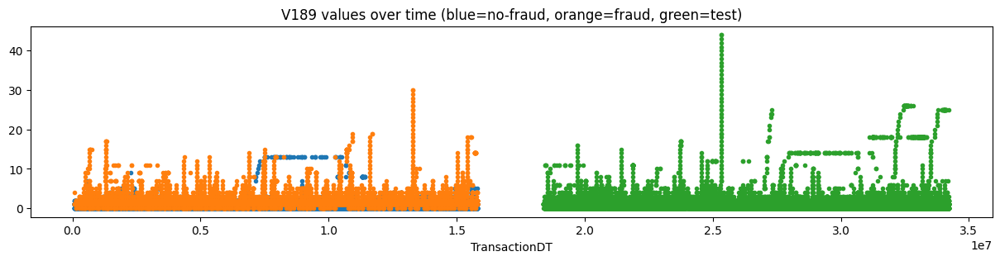

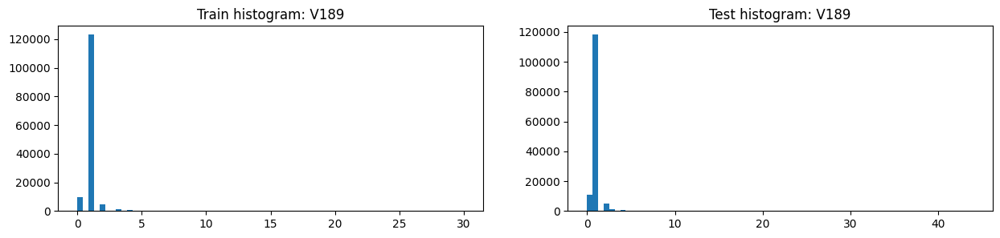

,V189,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139819.000000,11070.000000,128749.000000,136375.000000,17811.000000,118564.000000
1,mean,1.038314,1.871364,0.966687,1.068722,1.055471,1.070713
2,std,0.792528,2.237640,0.432240,1.227535,0.839414,1.275669
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,30.000000,30.000000,13.000000,44.000000,16.000000,44.000000
8,unique values,32.000000,32.000000,15.000000,46.000000,18.000000,46.000000
9,NaNs,450721.000000,9593.000000,441128.000000,370316.000000,83528.000000,286789.000000


,V189,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450721,0.021284,9593,370316
1,1.0,123163,0.055349,6817,118093
2,0.0,9579,0.058252,558,10819
3,2.0,4656,0.368986,1718,4828
4,3.0,1067,0.746017,796,1100
5,4.0,442,0.918552,406,461
6,5.0,240,0.895833,215,239
7,7.0,134,0.977612,131,71
8,6.0,121,0.975207,118,123
9,8.0,96,0.531250,51,39


,V189,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450721,0.021284,9593,370316
1,1.0,123163,0.055349,6817,118093
2,2.0,4656,0.368986,1718,4828
3,3.0,1067,0.746017,796,1100
4,0.0,9579,0.058252,558,10819
5,4.0,442,0.918552,406,461
6,5.0,240,0.895833,215,239
7,7.0,134,0.977612,131,71
8,6.0,121,0.975207,118,123
9,9.0,72,0.916667,66,29


,Column,Correlation with V189
0,V189,1.000000
1,V188,0.899481
2,V201,0.801707
3,V200,0.714006
4,V244,0.664891
5,V242,0.645411
342,D15,-0.124321
343,D6,-0.127998
344,D8,-0.161009
345,D2,-0.234049


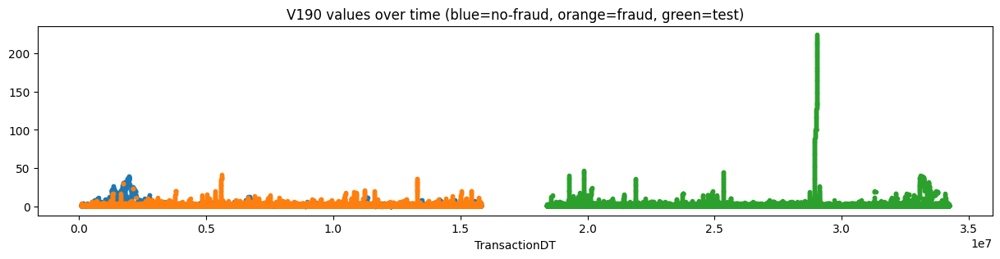

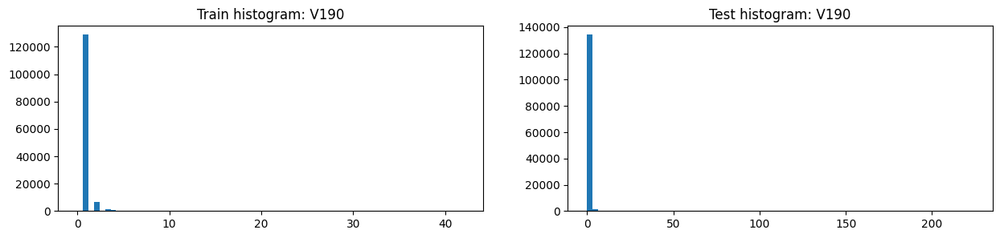

,V190,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,1.213083,2.249570,1.124106,1.412129,1.394243,1.414833
2,std,1.480318,3.070257,1.212505,5.635017,2.197505,5.985397
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,42.000000,42.000000,40.000000,224.000000,47.000000,224.000000
8,unique values,44.000000,44.000000,42.000000,226.000000,49.000000,225.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V190,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957
1,1.0,128846,0.052047,6706,125689
2,2.0,6836,0.283792,1940,6940
3,3.0,1477,0.574137,848,1640
4,4.0,674,0.697329,470,679
5,5.0,394,0.733503,289,355
6,6.0,284,0.693662,197,220
7,7.0,188,0.765957,144,162
8,8.0,128,0.632812,81,78
9,9.0,113,0.504425,57,71


,V190,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,1.0,128846,0.052047,6706,125689
2,2.0,6836,0.283792,1940,6940
3,3.0,1477,0.574137,848,1640
4,4.0,674,0.697329,470,679
5,5.0,394,0.733503,289,355
6,6.0,284,0.693662,197,220
7,7.0,188,0.765957,144,162
8,8.0,128,0.632812,81,78
9,9.0,113,0.504425,57,71


,Column,Correlation with V190
0,V190,1.000000
1,V199,0.955218
2,V186,0.929558
3,V176,0.907568
4,V246,0.886028
5,V196,0.792233
342,V152,-0.037140
343,V194,-0.038709
344,D10,-0.039337
345,D7,-0.087771


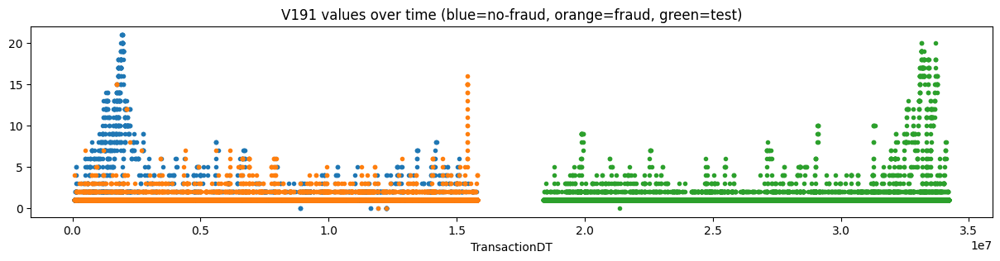

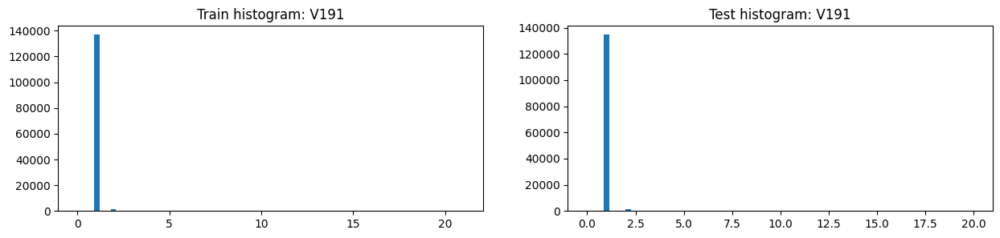

,V191,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,1.058984,1.186611,1.048028,1.044744,1.031513,1.046745
2,std,0.677527,0.768301,0.668029,0.601974,0.300905,0.635177
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,21.000000,16.000000,21.000000,20.000000,9.000000,20.000000
8,unique values,23.000000,18.000000,23.000000,22.000000,11.000000,21.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V191,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,1.0,136888,0.071117,9735,134630.0
2,2.0,1647,0.604129,995,1372.0
3,3.0,288,0.562500,162,190.0
4,4.0,152,0.375000,57,115.0
5,5.0,108,0.296296,32,68.0
6,6.0,83,0.301205,25,50.0
7,7.0,69,0.101449,7,35.0
8,8.0,60,0.050000,3,29.0
9,12.0,49,0.102041,5,28.0


,V191,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,136888,0.071117,9735,134630
1,-999.0,450909,0.021344,9624,369957
2,2.0,1647,0.604129,995,1372
3,3.0,288,0.562500,162,190
4,4.0,152,0.375000,57,115
5,5.0,108,0.296296,32,68
6,6.0,83,0.301205,25,50
7,15.0,16,0.500000,8,16
8,7.0,69,0.101449,7,35
9,12.0,49,0.102041,5,28


,Column,Correlation with V191
0,V191,1.000000
1,V196,0.970559
2,V193,0.918330
3,V186,0.892845
4,V207,0.886611
5,V172,0.862669
342,V197,-0.049011
343,V94,-0.049500
344,V63,-0.053944
345,V194,-0.062372


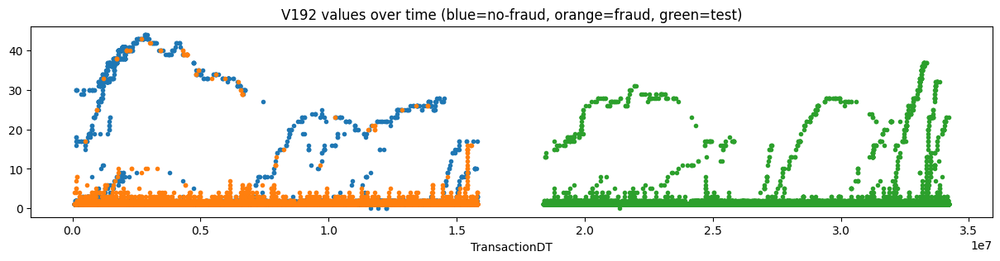

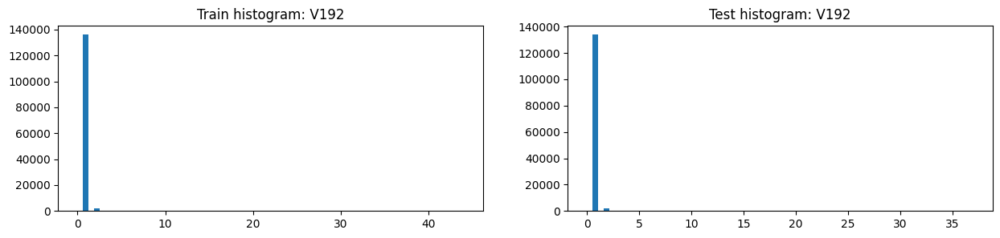

,V192,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,1.237361,1.402392,1.223194,1.133229,1.150715,1.130585
2,std,2.635961,2.511878,2.645872,1.656252,1.657120,1.656112
3,min,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,44.000000,43.000000,44.000000,37.000000,30.000000,37.000000
8,unique values,46.000000,34.000000,45.000000,39.000000,28.000000,38.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V192,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,1.0,135994,0.069040,9389,133857.0
2,2.0,2129,0.547205,1165,1858.0
3,3.0,298,0.835570,249,153.0
4,40.0,116,0.077586,9,NaN
5,38.0,102,0.029412,3,NaN
6,4.0,91,0.857143,78,56.0
7,34.0,61,0.049180,3,3.0
8,33.0,54,0.055556,3,11.0
9,41.0,49,0.000000,0,NaN


,V192,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,1.0,135994,0.069040,9389,133857.0
2,2.0,2129,0.547205,1165,1858.0
3,3.0,298,0.835570,249,153.0
4,4.0,91,0.857143,78,56.0
5,5.0,40,0.825000,33,39.0
6,6.0,37,0.675676,25,29.0
7,39.0,35,0.342857,12,NaN
8,40.0,116,0.077586,9,NaN
9,10.0,20,0.400000,8,13.0


,Column,Correlation with V192
0,V192,1.000000
1,V187,0.960413
2,V193,0.957331
3,V191,0.830132
4,V207,0.785723
5,V196,0.784329
342,V251,-0.100002
343,V250,-0.105785
344,V21,-0.114699
345,V197,-0.174349


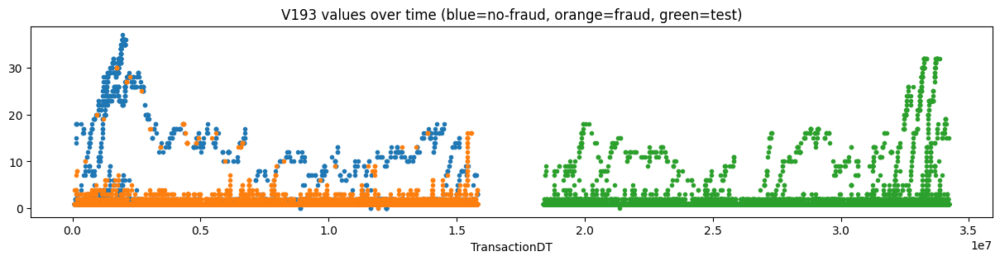

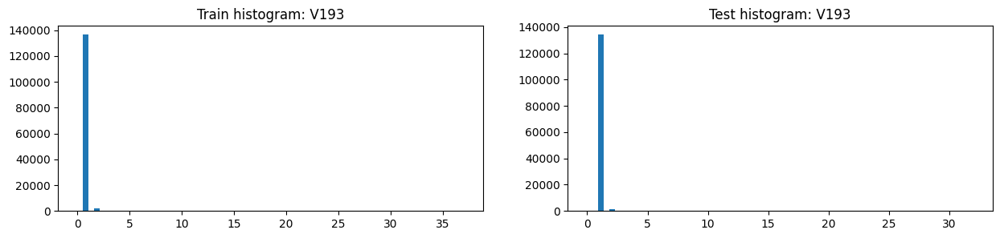

,V193,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,1.149845,1.279011,1.138757,1.092932,1.080452,1.094820
2,std,1.714792,1.393129,1.739193,1.191230,0.836552,1.236029
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,37.000000,30.000000,37.000000,32.000000,18.000000,32.000000
8,unique values,39.000000,26.000000,39.000000,34.000000,20.000000,33.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V193,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,1.0,136424,0.070068,9559,134214.0
2,2.0,1811,0.591938,1072,1549.0
3,3.0,247,0.838057,207,141.0
4,4.0,83,0.759036,63,67.0
5,14.0,60,0.266667,16,26.0
6,7.0,55,0.181818,10,32.0
7,5.0,51,0.509804,26,41.0
8,29.0,50,0.000000,0,3.0
9,12.0,48,0.020833,1,61.0


,V193,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,1.0,136424,0.070068,9559,134214
2,2.0,1811,0.591938,1072,1549
3,3.0,247,0.838057,207,141
4,4.0,83,0.759036,63,67
5,5.0,51,0.509804,26,41
6,6.0,41,0.512195,21,43
7,14.0,60,0.266667,16,26
8,7.0,55,0.181818,10,32
9,16.0,41,0.243902,10,56


,Column,Correlation with V193
0,V193,1.000000
1,V192,0.957331
2,V187,0.933544
3,V191,0.918330
4,V207,0.887617
5,V196,0.886631
342,V251,-0.077981
343,V250,-0.083803
344,V21,-0.104211
345,V197,-0.146178


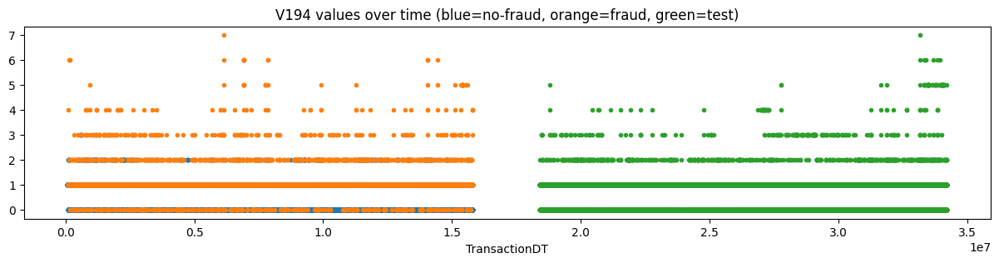

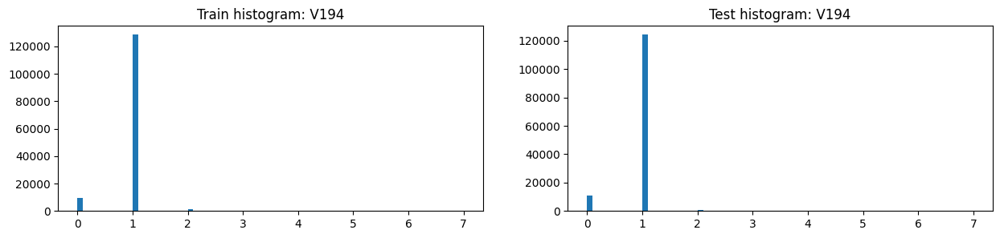

,V194,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139819.000000,11070.000000,128749.000000,136375.000000,17811.000000,118564.000000
1,mean,0.945773,1.098464,0.932644,0.932898,0.911740,0.936077
2,std,0.304158,0.575392,0.264245,0.317172,0.352361,0.311420
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,7.000000,7.000000,3.000000,7.000000,5.000000,7.000000
8,unique values,9.000000,9.000000,5.000000,9.000000,7.000000,9.000000
9,NaNs,450721.000000,9593.000000,441128.000000,370316.000000,83528.000000,286789.000000


,V194,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450721,0.021284,9593,370316
1,1.0,128509,0.072446,9310,124191
2,0.0,9693,0.059631,578,10930
3,2.0,1307,0.673298,880,928
4,3.0,201,0.960199,193,205
5,4.0,51,1.000000,51,52
6,5.0,42,1.000000,42,61
7,6.0,15,1.000000,15,7
8,7.0,1,1.000000,1,1


,V194,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450721,0.021284,9593,370316
1,1.0,128509,0.072446,9310,124191
2,2.0,1307,0.673298,880,928
3,0.0,9693,0.059631,578,10930
4,3.0,201,0.960199,193,205
5,4.0,51,1.000000,51,52
6,5.0,42,1.000000,42,61
7,6.0,15,1.000000,15,7
8,7.0,1,1.000000,1,1


,Column,Correlation with V194
0,V194,1.000000
1,V197,0.911994
2,V195,0.850014
3,V198,0.674848
4,V188,0.523359
5,V189,0.475809
342,D1,-0.295450
343,D2,-0.304838
344,D6,-0.322513
345,D15,-0.336159


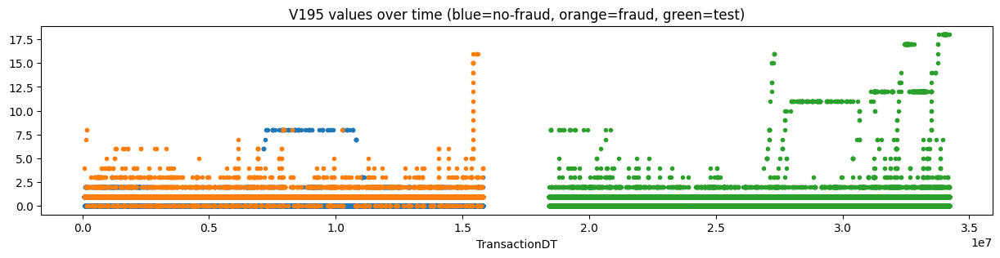

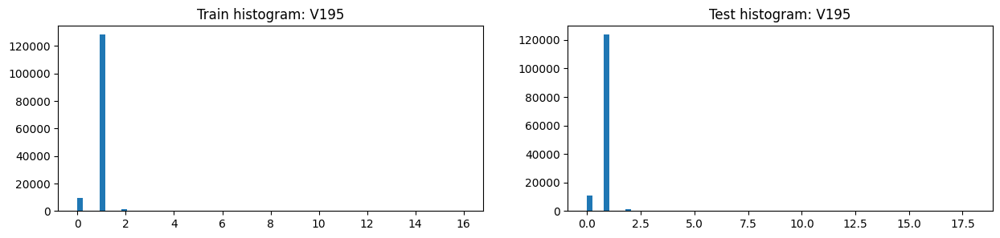

,V195,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139819.000000,11070.000000,128749.000000,136375.000000,17811.000000,118564.000000
1,mean,0.954227,1.142999,0.937996,0.969679,0.921734,0.976882
2,std,0.376420,0.810015,0.306818,0.723563,0.428157,0.757797
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,16.000000,16.000000,8.000000,18.000000,8.000000,18.000000
8,unique values,18.000000,18.000000,8.000000,20.000000,10.000000,20.000000
9,NaNs,450721.000000,9593.000000,441128.000000,370316.000000,83528.000000,286789.000000


,V195,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450721,0.021284,9593,370316
1,1.0,128253,0.071562,9178,123732
2,0.0,9579,0.058252,558,10819
3,2.0,1535,0.627362,963,1165
4,3.0,248,0.927419,230,118
5,8.0,66,0.166667,11,28
6,4.0,60,1.000000,60,46
7,6.0,31,0.903226,28,20
8,5.0,22,1.000000,22,32
9,7.0,8,0.375000,3,18


,V195,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450721,0.021284,9593,370316
1,1.0,128253,0.071562,9178,123732
2,2.0,1535,0.627362,963,1165
3,0.0,9579,0.058252,558,10819
4,3.0,248,0.927419,230,118
5,4.0,60,1.000000,60,46
6,6.0,31,0.903226,28,20
7,5.0,22,1.000000,22,32
8,8.0,66,0.166667,11,28
9,15.0,5,1.000000,5,4


,Column,Correlation with V195
0,V195,1.000000
1,V198,0.911575
2,V194,0.850014
3,V197,0.801658
4,V189,0.600088
5,V247,0.495733
342,D12,-0.281923
343,D2,-0.289119
344,D6,-0.314214
345,D15,-0.323318


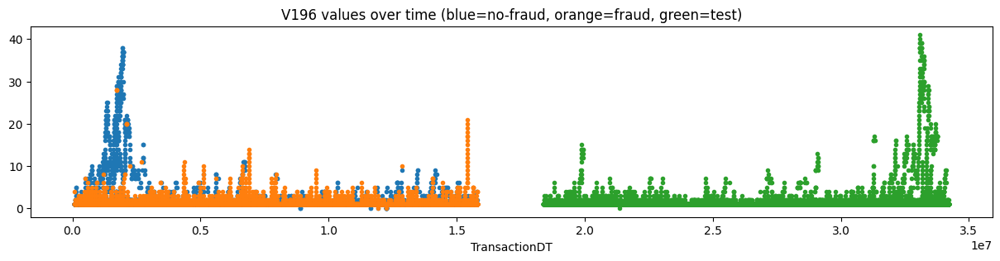

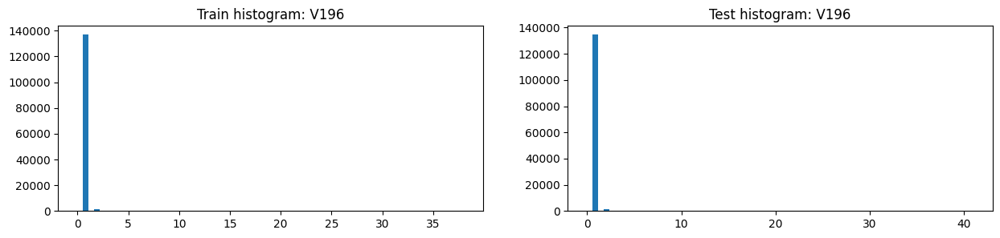

,V196,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,1.084580,1.229006,1.072182,1.062537,1.034185,1.066825
2,std,1.105834,1.096746,1.105736,0.983359,0.414184,1.042663
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,38.000000,28.000000,38.000000,41.000000,15.000000,41.000000
8,unique values,40.000000,24.000000,40.000000,43.000000,16.000000,42.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V196,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957
1,1.0,136911,0.072193,9884,134612
2,2.0,1415,0.476325,674,1287
3,3.0,335,0.656716,220,220
4,4.0,212,0.509434,108,130
5,5.0,118,0.415254,49,74
6,6.0,81,0.370370,30,47
7,8.0,60,0.200000,12,18
8,9.0,57,0.105263,6,25
9,7.0,51,0.372549,19,45


,V196,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,136911,0.072193,9884,134612
1,-999.0,450909,0.021344,9624,369957
2,2.0,1415,0.476325,674,1287
3,3.0,335,0.656716,220,220
4,4.0,212,0.509434,108,130
5,5.0,118,0.415254,49,74
6,6.0,81,0.370370,30,47
7,7.0,51,0.372549,19,45
8,8.0,60,0.200000,12,18
9,10.0,30,0.233333,7,16


,Column,Correlation with V196
0,V196,1.000000
1,V191,0.970559
2,V207,0.906215
3,V186,0.905683
4,V172,0.894849
5,V193,0.886631
342,V84,-0.054451
343,V51,-0.058498
344,V94,-0.062936
345,V21,-0.080537


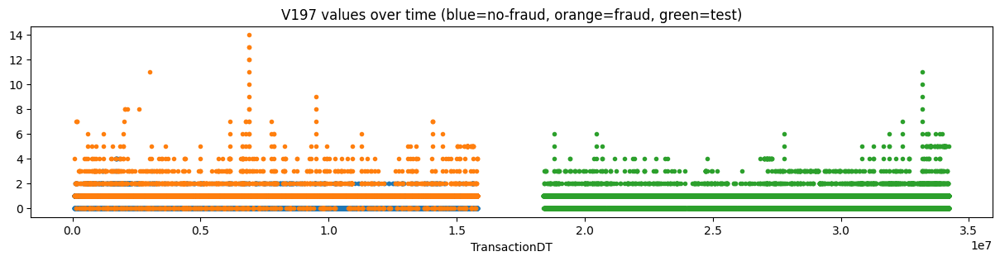

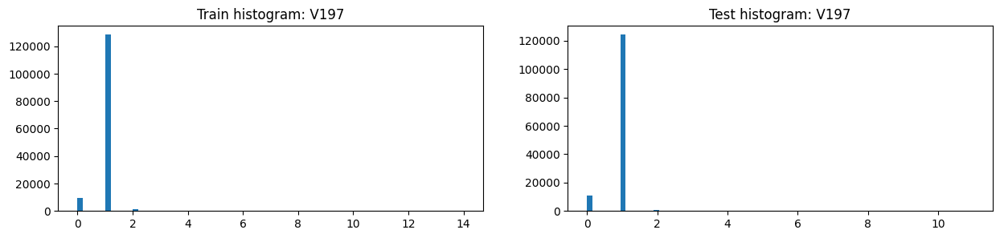

,V197,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139819.000000,11070.000000,128749.000000,136375.000000,17811.000000,118564.000000
1,mean,0.949385,1.126287,0.934174,0.934027,0.909045,0.937780
2,std,0.336871,0.750550,0.268115,0.326384,0.355328,0.321645
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,14.000000,14.000000,4.000000,11.000000,6.000000,11.000000
8,unique values,16.000000,16.000000,6.000000,13.000000,8.000000,13.000000
9,NaNs,450721.000000,9593.000000,441128.000000,370316.000000,83528.000000,286789.000000


,V197,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450721,0.021284,9593,370316.0
1,1.0,128419,0.073221,9403,124183.0
2,0.0,9693,0.059631,578,10930.0
3,2.0,1256,0.519904,653,860.0
4,3.0,235,0.965957,227,252.0
5,4.0,102,0.931373,95,65.0
6,5.0,68,1.000000,68,67.0
7,6.0,15,1.000000,15,12.0
8,7.0,14,1.000000,14,2.0
9,8.0,7,1.000000,7,1.0


,V197,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450721,0.021284,9593,370316
1,1.0,128419,0.073221,9403,124183
2,2.0,1256,0.519904,653,860
3,0.0,9693,0.059631,578,10930
4,3.0,235,0.965957,227,252
5,4.0,102,0.931373,95,65
6,5.0,68,1.000000,68,67
7,6.0,15,1.000000,15,12
8,7.0,14,1.000000,14,2
9,8.0,7,1.000000,7,1


,Column,Correlation with V197
0,V197,1.000000
1,V194,0.911994
2,V195,0.801658
3,V198,0.765630
4,V188,0.493051
5,V189,0.469940
342,D2,-0.304558
343,D12,-0.310688
344,D6,-0.334315
345,D15,-0.345741


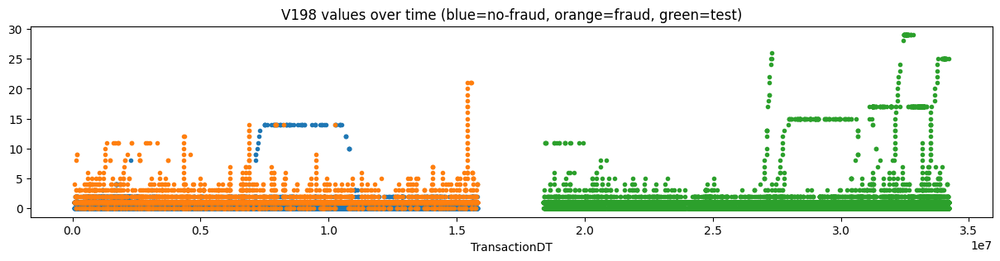

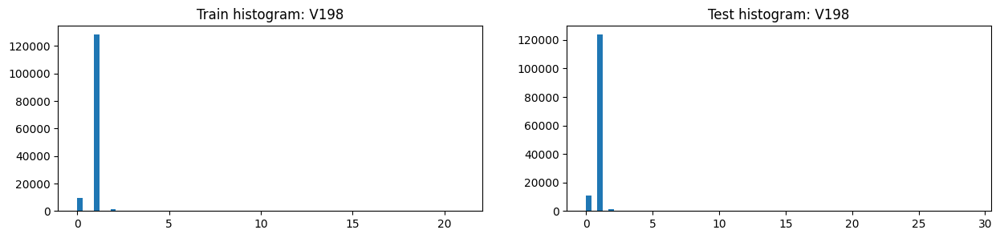

,V198,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139819.000000,11070.000000,128749.000000,136375.000000,17811.000000,118564.000000
1,mean,0.961951,1.197200,0.941724,0.988972,0.922014,0.999030
2,std,0.493065,1.135603,0.384678,1.028947,0.486810,1.086924
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,21.000000,21.000000,14.000000,29.000000,11.000000,29.000000
8,unique values,23.000000,23.000000,13.000000,30.000000,11.000000,30.000000
9,NaNs,450721.000000,9593.000000,441128.000000,370316.000000,83528.000000,286789.000000


,V198,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450721,0.021284,9593,370316
1,1.0,128276,0.072632,9317,123707
2,0.0,9579,0.058252,558,10819
3,2.0,1318,0.484825,639,1063
4,3.0,297,0.942761,280,191
5,4.0,121,0.925620,112,70
6,14.0,58,0.155172,9,8
7,5.0,50,1.000000,50,43
8,6.0,26,1.000000,26,20
9,8.0,19,0.894737,17,10


,V198,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450721,0.021284,9593,370316
1,1.0,128276,0.072632,9317,123707
2,2.0,1318,0.484825,639,1063
3,0.0,9579,0.058252,558,10819
4,3.0,297,0.942761,280,191
5,4.0,121,0.925620,112,70
6,5.0,50,1.000000,50,43
7,6.0,26,1.000000,26,20
8,8.0,19,0.894737,17,10
9,11.0,17,0.941176,16,21


,Column,Correlation with V198
0,V198,1.000000
1,V195,0.911575
2,V197,0.765630
3,V194,0.674848
4,V189,0.596779
5,V252,0.522507
342,D4,-0.273202
343,D12,-0.292729
344,D6,-0.307488
345,D15,-0.308810


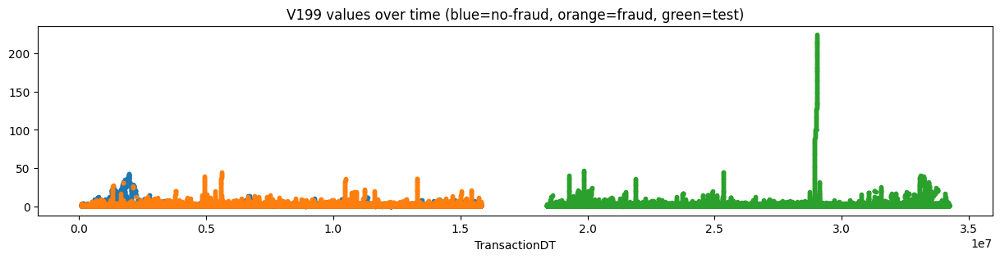

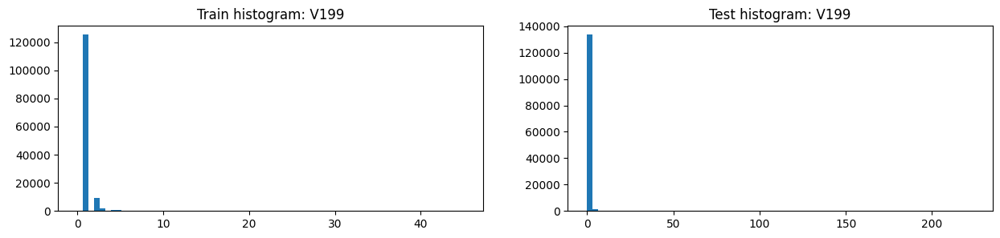

,V199,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,1.270749,2.589003,1.157584,1.466782,1.486554,1.463792
2,std,1.671863,3.723457,1.297311,5.667169,2.350579,6.011491
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,3.000000,1.000000,1.000000,1.000000,1.000000
7,max,45.000000,45.000000,43.000000,224.000000,47.000000,224.000000
8,unique values,47.000000,47.000000,45.000000,226.000000,49.000000,225.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V199,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957
1,1.0,125279,0.048635,6093,122740
2,2.0,9231,0.217636,2009,8750
3,3.0,2119,0.470977,998,2069
4,4.0,871,0.670494,584,876
5,5.0,462,0.753247,348,479
6,6.0,333,0.702703,234,323
7,7.0,239,0.761506,182,218
8,8.0,164,0.682927,112,137
9,9.0,136,0.602941,82,97


,V199,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,1.0,125279,0.048635,6093,122740
2,2.0,9231,0.217636,2009,8750
3,3.0,2119,0.470977,998,2069
4,4.0,871,0.670494,584,876
5,5.0,462,0.753247,348,479
6,6.0,333,0.702703,234,323
7,7.0,239,0.761506,182,218
8,8.0,164,0.682927,112,137
9,9.0,136,0.602941,82,97


,Column,Correlation with V199
0,V199,1.000000
1,V190,0.955218
2,V186,0.882910
3,V257,0.871518
4,V176,0.855774
5,V246,0.806468
342,V151,-0.037430
343,V150,-0.037683
344,V152,-0.040393
345,D7,-0.094766


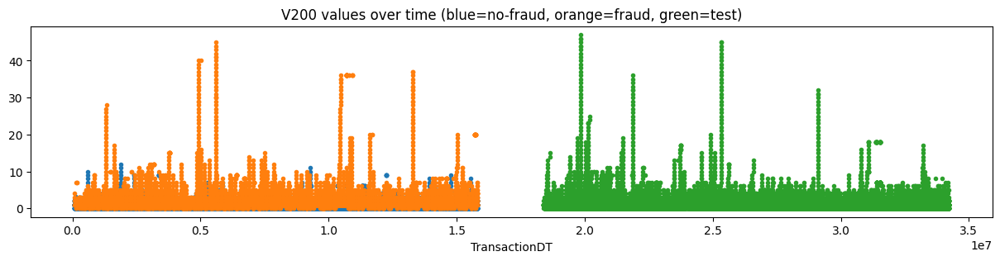

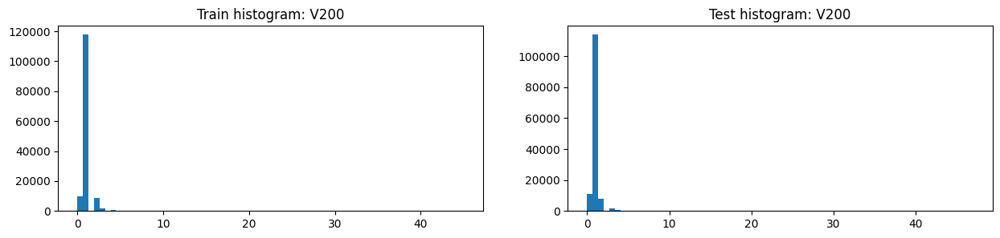

,V200,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139819.000000,11070.000000,128749.000000,136375.000000,17811.000000,118564.000000
1,mean,1.119977,2.483107,1.002773,1.100216,1.259559,1.076279
2,std,1.253853,3.944418,0.442942,1.188545,1.962665,1.020699
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,3.000000,1.000000,1.000000,1.000000,1.000000
7,max,45.000000,45.000000,12.000000,47.000000,47.000000,45.000000
8,unique values,47.000000,47.000000,14.000000,49.000000,49.000000,47.000000
9,NaNs,450721.000000,9593.000000,441128.000000,370316.000000,83528.000000,286789.000000


,V200,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450721,0.021284,9593,370316
1,1.0,117750,0.049223,5796,113885
2,0.0,9693,0.059631,578,10930
3,2.0,8523,0.225273,1920,7698
4,3.0,1723,0.568775,980,1738
5,4.0,728,0.759615,553,838
6,5.0,366,0.871585,319,402
7,6.0,293,0.764505,224,225
8,7.0,161,0.931677,150,164
9,9.0,105,0.819048,86,73


,V200,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450721,0.021284,9593,370316
1,1.0,117750,0.049223,5796,113885
2,2.0,8523,0.225273,1920,7698
3,3.0,1723,0.568775,980,1738
4,0.0,9693,0.059631,578,10930
5,4.0,728,0.759615,553,838
6,5.0,366,0.871585,319,402
7,6.0,293,0.764505,224,225
8,7.0,161,0.931677,150,164
9,8.0,104,0.932692,97,75


,Column,Correlation with V200
0,V200,1.000000
1,V201,0.941582
2,V170,0.812939
3,V188,0.784486
4,V257,0.747843
5,V189,0.714006
342,D5,-0.109209
343,V326,-0.112028
344,D8,-0.138613
345,D13,-0.200632


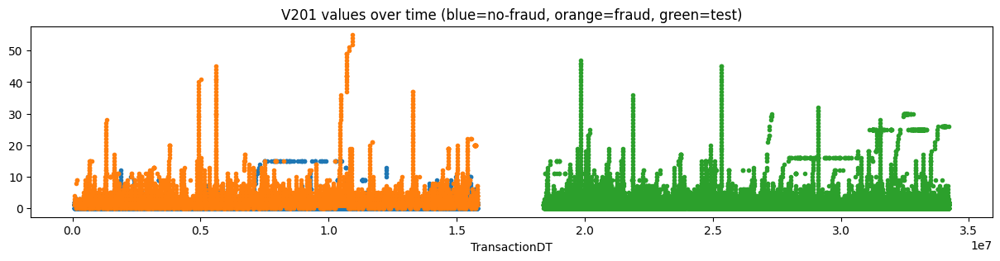

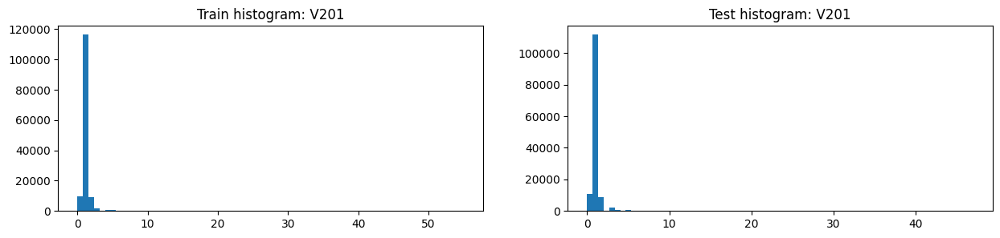

,V201,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139819.000000,11070.000000,128749.000000,136375.000000,17811.000000,118564.000000
1,mean,1.159106,2.745980,1.022664,1.209254,1.331424,1.190901
2,std,1.418618,4.352642,0.567060,1.788458,2.090708,1.737788
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,3.000000,1.000000,1.000000,1.000000,1.000000
7,max,55.000000,55.000000,15.000000,47.000000,47.000000,45.000000
8,unique values,57.000000,57.000000,17.000000,49.000000,49.000000,47.000000
9,NaNs,450721.000000,9593.000000,441128.000000,370316.000000,83528.000000,286789.000000


,V201,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450721,0.021284,9593,370316.0
1,1.0,116412,0.047066,5479,111665.0
2,0.0,9579,0.058252,558,10819.0
3,2.0,9285,0.203877,1893,8882.0
4,3.0,1922,0.519771,999,2012.0
5,4.0,860,0.734884,632,822.0
6,5.0,422,0.874408,369,421.0
7,6.0,270,0.881481,238,300.0
8,7.0,186,0.897849,167,257.0
9,9.0,178,0.662921,118,110.0


,V201,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450721,0.021284,9593,370316
1,1.0,116412,0.047066,5479,111665
2,2.0,9285,0.203877,1893,8882
3,3.0,1922,0.519771,999,2012
4,4.0,860,0.734884,632,822
5,0.0,9579,0.058252,558,10819
6,5.0,422,0.874408,369,421
7,6.0,270,0.881481,238,300
8,7.0,186,0.897849,167,257
9,8.0,134,0.925373,124,117


,Column,Correlation with V201
0,V201,1.000000
1,V200,0.941582
2,V189,0.801707
3,V170,0.769216
4,V188,0.740297
5,V257,0.732820
342,D7,-0.101232
343,D5,-0.113619
344,D8,-0.136310
345,D13,-0.190176


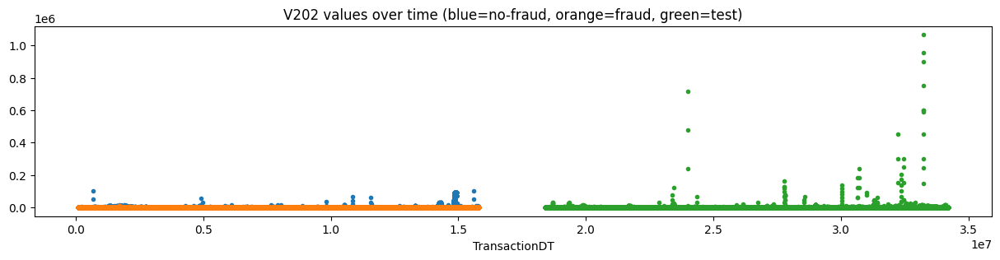

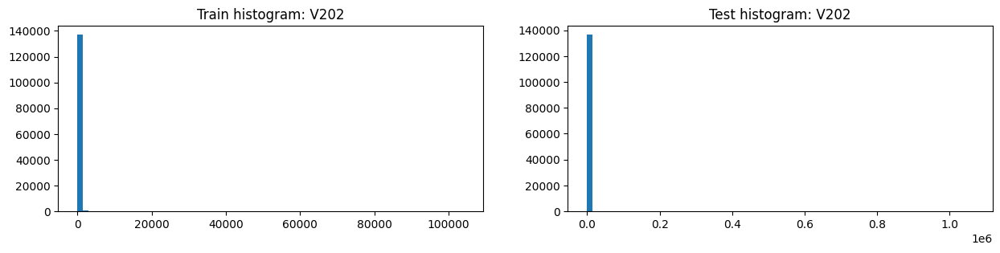

,V202,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,1.367340e+05,17961.000000,1.187730e+05
1,mean,444.147142,155.958232,468.886764,2.276923e+02,157.234658,2.383470e+02
2,std,4683.828419,403.621902,4878.506934,7.044896e+03,993.251845,7.548892e+03
3,min,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
4,25%,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
5,50%,0.000000,21.388700,0.000000,0.000000e+00,0.000000,0.000000e+00
6,75%,0.000000,150.000000,0.000000,0.000000e+00,26.436399,0.000000e+00
7,max,104060.000000,10900.000000,104060.000000,1.065496e+06,33360.000000,1.065496e+06
8,unique values,10971.000000,3239.000000,9061.000000,9.564000e+03,2512.000000,8.286000e+03
9,NaNs,450909.000000,9624.000000,441285.000000,3.699570e+05,83378.000000,2.865800e+05


,V202,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,0.0,106161,0.047786,5073,103369.0
2,100.0,2186,0.068161,149,1549.0
3,200.0,1500,0.108000,162,1310.0
4,50.0,1391,0.066139,92,861.0
5,150.0,1256,0.149682,188,867.0
6,300.0,1046,0.176864,185,838.0
7,400.0,589,0.139219,82,758.0
8,25.0,530,0.041509,22,383.0
9,250.0,477,0.100629,48,468.0


,V202,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,106161,0.047786,5073,103369
2,150.0,1256,0.149682,188,867
3,300.0,1046,0.176864,185,838
4,200.0,1500,0.108000,162,1310
5,100.0,2186,0.068161,149,1549
6,600.0,456,0.214912,98,446
7,50.0,1391,0.066139,92,861
8,400.0,589,0.139219,82,758
9,450.0,272,0.294118,80,164


,Column,Correlation with V202
0,V202,1.000000
1,V211,0.990387
2,V167,0.988960
3,V306,0.988554
4,V177,0.987352
5,V331,0.986995
342,V62,-0.249742
343,V57,-0.256829
344,V20,-0.299549
345,V61,-0.311834


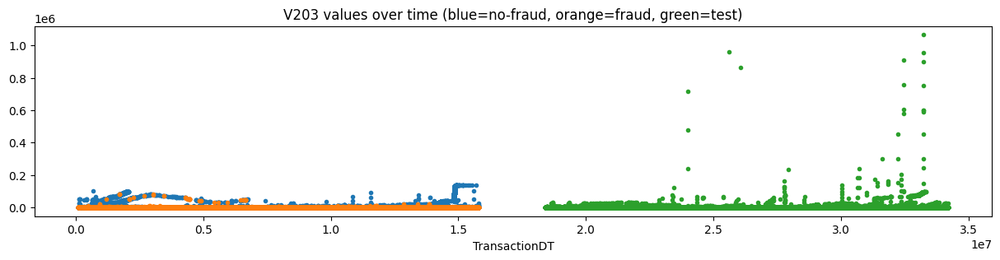

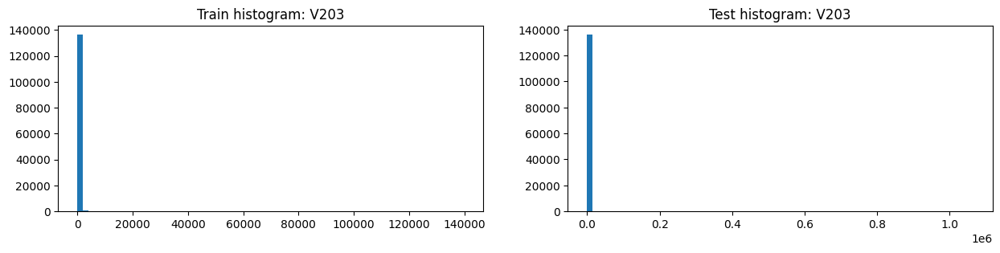

,V203,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,1.367340e+05,17961.000000,1.187730e+05
1,mean,1078.327538,458.577578,1131.530069,4.566458e+02,334.202050,4.751619e+02
2,std,9105.607991,3581.819720,9428.292395,9.358593e+03,1967.238810,1.001199e+04
3,min,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
4,25%,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
5,50%,0.000000,47.585400,0.000000,0.000000e+00,0.000000,0.000000e+00
6,75%,30.924400,237.288399,19.757299,3.135480e+01,70.333099,2.742010e+01
7,max,139777.000000,81450.000000,139777.000000,1.065496e+06,33360.000000,1.065496e+06
8,unique values,14952.000000,3960.000000,12478.000000,1.394100e+04,3449.000000,1.208100e+04
9,NaNs,450909.000000,9624.000000,441285.000000,3.699570e+05,83378.000000,2.865800e+05


,V203,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,0.0,98207,0.044559,4376,93950.0
2,100.0,2372,0.061130,145,1751.0
3,200.0,1580,0.093038,147,1420.0
4,50.0,1553,0.056665,88,1036.0
5,150.0,1341,0.130500,175,935.0
6,300.0,1104,0.165761,183,864.0
7,400.0,646,0.153251,99,751.0
8,25.0,593,0.032040,19,443.0
9,75.0,541,0.053604,29,391.0


,V203,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,98207,0.044559,4376,93950
2,300.0,1104,0.165761,183,864
3,150.0,1341,0.130500,175,935
4,200.0,1580,0.093038,147,1420
5,100.0,2372,0.061130,145,1751
6,400.0,646,0.153251,99,751
7,600.0,503,0.196819,99,468
8,50.0,1553,0.056665,88,1036
9,450.0,273,0.271062,74,171


,Column,Correlation with V203
0,V203,1.000000
1,V204,0.964349
2,V212,0.958905
3,V168,0.920584
4,V182,0.918220
5,V265,0.917215
342,V33,-0.273447
343,V57,-0.283834
344,V20,-0.326722
345,V61,-0.337549


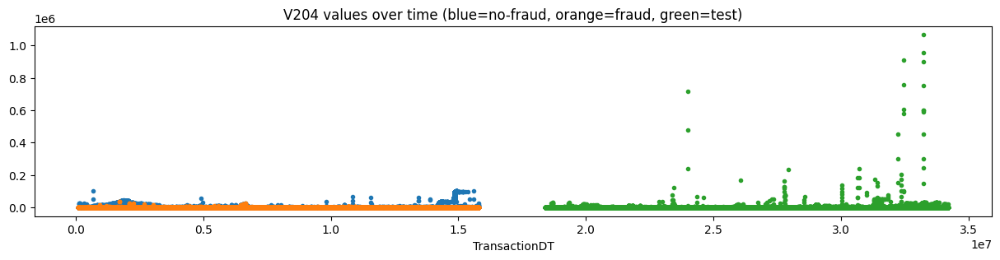

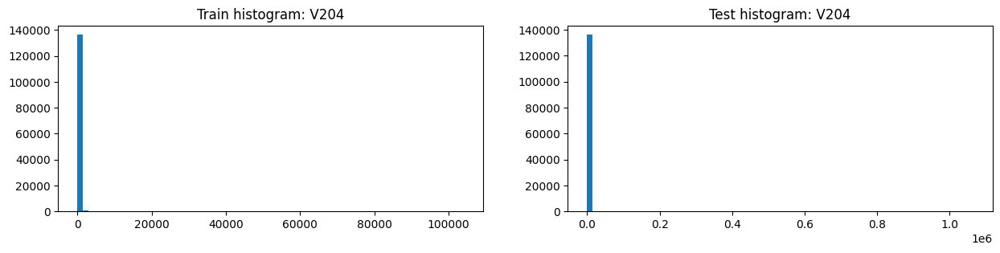

,V204,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,1.367340e+05,17961.000000,1.187730e+05
1,mean,686.956931,258.607617,723.728644,3.153237e+02,206.750770,3.317422e+02
2,std,6048.980716,1227.476243,6291.648851,8.145386e+03,1173.023387,8.727566e+03
3,min,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
4,25%,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
5,50%,0.000000,38.011600,0.000000,0.000000e+00,0.000000,0.000000e+00
6,75%,20.000000,200.000000,0.000000,1.955060e+01,50.000000,1.530910e+01
7,max,104060.000000,37850.000000,104060.000000,1.065496e+06,33360.000000,1.065496e+06
8,unique values,12859.000000,3708.000000,10581.000000,1.181900e+04,3000.000000,1.024100e+04
9,NaNs,450909.000000,9624.000000,441285.000000,3.699570e+05,83378.000000,2.865800e+05


,V204,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,0.0,101660,0.044806,4555,98083.0
2,100.0,2289,0.063783,146,1654.0
3,200.0,1541,0.099935,154,1342.0
4,50.0,1507,0.062376,94,987.0
5,150.0,1306,0.141654,185,889.0
6,300.0,1078,0.174397,188,856.0
7,400.0,626,0.154952,97,738.0
8,25.0,599,0.036728,22,454.0
9,75.0,523,0.074570,39,365.0


,V204,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,101660,0.044806,4555,98083
2,300.0,1078,0.174397,188,856
3,150.0,1306,0.141654,185,889
4,200.0,1541,0.099935,154,1342
5,100.0,2289,0.063783,146,1654
6,600.0,484,0.202479,98,452
7,400.0,626,0.154952,97,738
8,50.0,1507,0.062376,94,987
9,450.0,265,0.279245,74,164


,Column,Correlation with V204
0,V204,1.000000
1,V212,0.981081
2,V168,0.980744
3,V213,0.977560
4,V203,0.964349
5,V178,0.963685
342,V33,-0.276771
343,V57,-0.287309
344,V20,-0.333474
345,V61,-0.345627


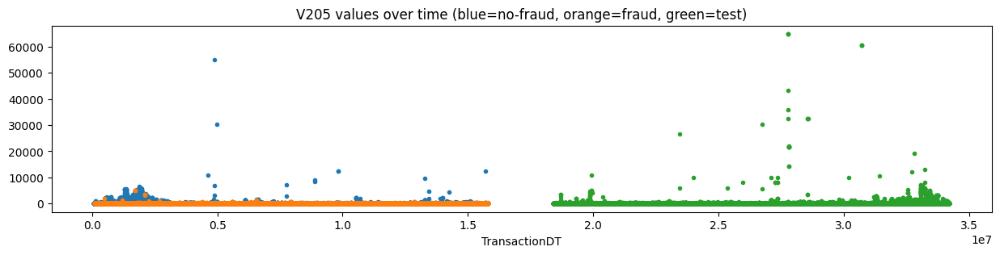

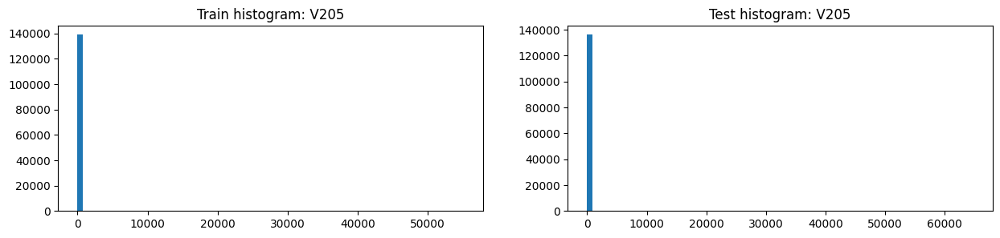

,V205,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,18.060417,9.057890,18.833240,21.513360,11.243137,23.066436
2,std,266.545451,116.047755,275.648287,552.490919,159.881073,589.510495
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,55125.000000,5050.000000,55125.000000,64800.000000,11000.000000,64800.000000
8,unique values,2241.000000,212.000000,2167.000000,1980.000000,438.000000,1817.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V205,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,0.0,128800,0.079604,10253,126250.0
2,100.0,598,0.043478,26,341.0
3,50.0,370,0.075676,28,280.0
4,150.0,218,0.178899,39,157.0
5,25.0,205,0.068293,14,182.0
6,265.0,187,0.000000,0,NaN
7,106.0,166,0.000000,0,NaN
8,20.0,163,0.012270,2,143.0
9,200.0,147,0.156463,23,183.0


,V205,Count in train,Mean target,Sum target (desc),Count in test
0,0.000000,128800,0.079604,10253,126250.0
1,-999.000000,450909,0.021344,9624,369957.0
2,150.000000,218,0.178899,39,157.0
3,50.000000,370,0.075676,28,280.0
4,100.000000,598,0.043478,26,341.0
5,200.000000,147,0.156463,23,183.0
6,44.106602,26,0.730769,19,NaN
7,86.317902,18,1.000000,18,NaN
8,8.914600,19,0.947368,18,19.0
9,40.179298,15,1.000000,15,NaN


,Column,Correlation with V205
0,V205,1.000000
1,V266,0.982005
2,V269,0.979334
3,V268,0.832261
4,V207,0.763772
5,V206,0.762625
342,V251,-0.069662
343,V250,-0.070923
344,V195,-0.089148
345,V197,-0.099473


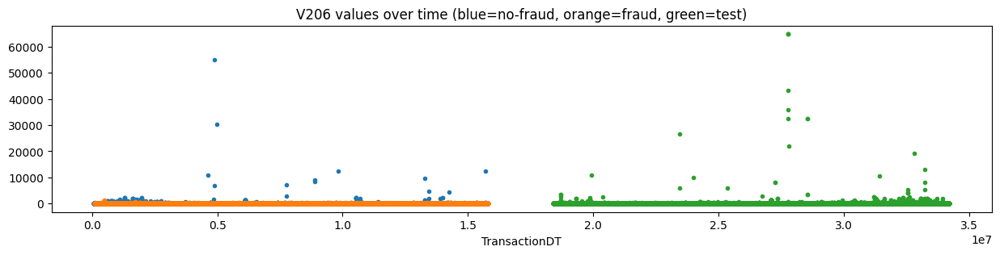

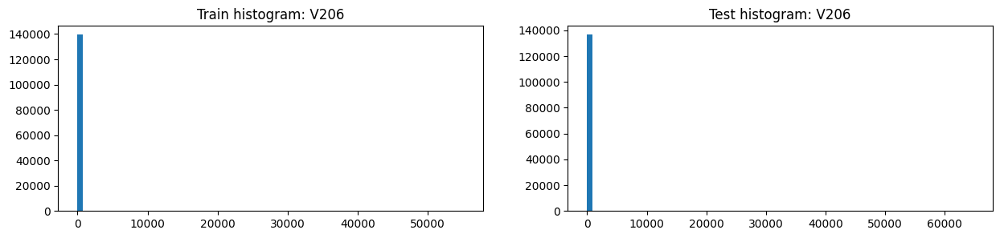

,V206,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,6.189360,2.467472,6.508866,9.213510,4.958772,9.856917
2,std,191.474014,25.255635,199.382949,399.602565,104.704310,426.812422
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,55125.000000,1350.000000,55125.000000,64800.000000,11000.000000,64800.000000
8,unique values,1781.000000,139.000000,1735.000000,1563.000000,339.000000,1422.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V206,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,0.0,132868,0.080238,10661,129946.0
2,100.0,288,0.031250,9,254.0
3,50.0,253,0.043478,11,188.0
4,150.0,171,0.111111,19,111.0
5,25.0,120,0.075000,9,103.0
6,200.0,112,0.026786,3,137.0
7,300.0,69,0.043478,3,56.0
8,250.0,69,0.014493,1,61.0
9,1000.0,67,0.000000,0,39.0


,V206,Count in train,Mean target,Sum target (desc),Count in test
0,0.000000,132868,0.080238,10661,129946.0
1,-999.000000,450909,0.021344,9624,369957.0
2,150.000000,171,0.111111,19,111.0
3,44.106602,24,0.791667,19,NaN
4,12.809000,18,0.833333,15,NaN
5,50.000000,253,0.043478,11,188.0
6,17.337400,14,0.785714,11,10.0
7,125.000000,56,0.178571,10,21.0
8,100.000000,288,0.031250,9,254.0
9,25.000000,120,0.075000,9,103.0


,Column,Correlation with V206
0,V206,1.000000
1,V311,0.973025
2,V266,0.956989
3,V129,0.956912
4,V269,0.955651
5,V309,0.946407
342,V94,-0.025797
343,D12,-0.027291
344,V51,-0.037189
345,V52,-0.037844


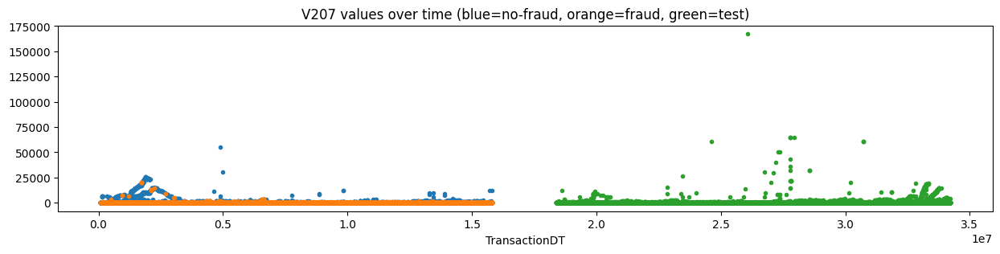

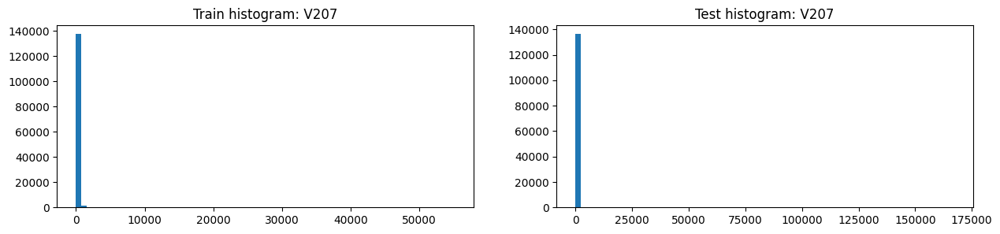

,V207,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,72.284098,33.052247,75.651962,46.936743,30.227660,49.463511
2,std,925.676660,476.216252,954.372372,907.342401,336.006781,964.700194
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,55125.000000,20075.000000,55125.000000,167200.000000,12500.000000,167200.000000
8,unique values,3247.000000,316.000000,3148.000000,2892.000000,712.000000,2644.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V207,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,0.0,123086,0.078839,9704,119700.0
2,877.0,914,0.000000,0,NaN
3,50.0,552,0.085145,47,437.0
4,100.0,483,0.055901,27,467.0
5,619.0,342,0.000000,0,NaN
6,25.0,318,0.088050,28,276.0
7,150.0,253,0.166008,42,203.0
8,20.0,235,0.021277,5,194.0
9,30.0,209,0.062201,13,163.0


,V207,Count in train,Mean target,Sum target (desc),Count in test
0,0.000000,123086,0.078839,9704,119700.0
1,-999.000000,450909,0.021344,9624,369957.0
2,50.000000,552,0.085145,47,437.0
3,25.452700,46,0.934783,43,13.0
4,150.000000,253,0.166008,42,203.0
5,300.000000,134,0.261194,35,127.0
6,25.000000,318,0.088050,28,276.0
7,100.000000,483,0.055901,27,467.0
8,200.000000,189,0.132275,25,268.0
9,40.179298,23,1.000000,23,NaN


,Column,Correlation with V207
0,V207,1.000000
1,V266,0.931359
2,V269,0.928991
3,V196,0.906215
4,V193,0.887617
5,V191,0.886611
342,V195,-0.135583
343,V33,-0.136788
344,V19,-0.137971
345,V197,-0.160503


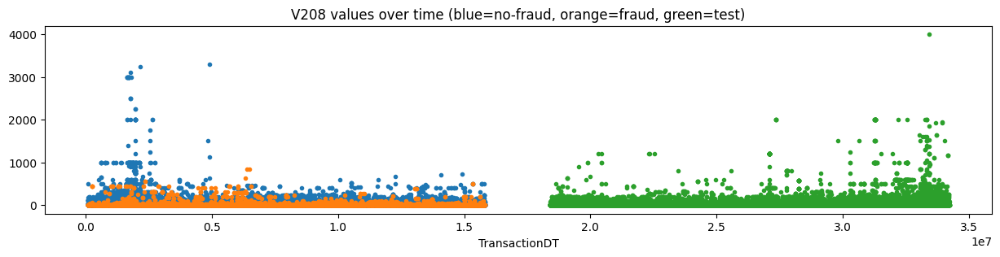

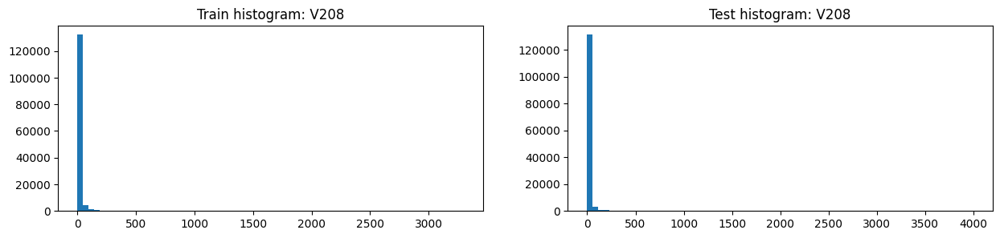

,V208,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139819.000000,11070.000000,128749.000000,136375.000000,17811.000000,118564.000000
1,mean,8.888193,10.730773,8.729766,9.031152,6.969635,9.340839
2,std,59.047125,46.177884,60.022465,59.632571,36.444726,62.369809
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,3300.000000,835.000000,3300.000000,4000.000000,1200.000000,4000.000000
8,unique values,2553.000000,248.000000,2483.000000,2100.000000,497.000000,1933.000000
9,NaNs,450721.000000,9593.000000,441128.000000,370316.000000,83528.000000,286789.000000


,V208,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450721,0.021284,9593,370316.0
1,0.0,123863,0.077279,9572,119736.0
2,75.0,1461,0.000000,0,160.0
3,50.0,716,0.064246,46,579.0
4,100.0,553,0.057866,32,604.0
5,25.0,360,0.069444,25,473.0
6,20.0,309,0.110032,34,163.0
7,150.0,262,0.152672,40,257.0
8,200.0,245,0.257143,63,243.0
9,15.0,213,0.262911,56,129.0


,V208,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0000,450721,0.021284,9593,370316
1,0.0000,123863,0.077279,9572,119736
2,200.0000,245,0.257143,63,243
3,15.0000,213,0.262911,56,129
4,25.4527,49,0.959184,47,16
5,50.0000,716,0.064246,46,579
6,150.0000,262,0.152672,40,257
7,20.0000,309,0.110032,34,163
8,450.0000,44,0.750000,33,30
9,8.9146,36,0.916667,33,18


,Column,Correlation with V208
0,V208,1.000000
1,V210,0.778370
2,V270,0.683549
3,V272,0.661664
4,V271,0.637773
5,V161,0.560010
342,V15,-0.122283
343,V33,-0.123543
344,D3,-0.124624
345,D7,-0.134256


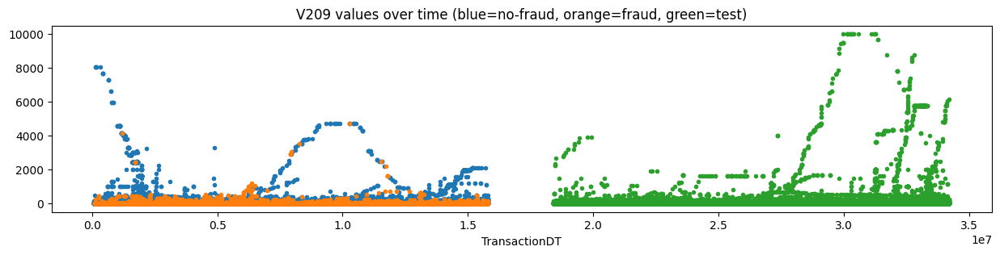

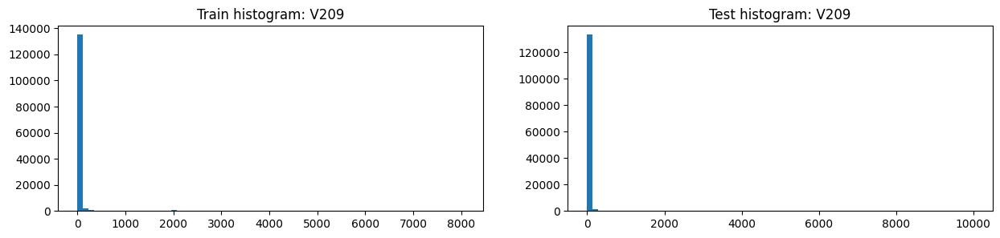

,V209,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139819.000000,11070.000000,128749.000000,136375.000000,17811.000000,118564.000000
1,mean,35.001872,18.897558,36.386541,28.002020,13.777167,30.138916
2,std,250.800822,127.469431,258.627612,305.990127,110.322738,325.318560
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,8050.000000,4725.000000,8050.000000,10000.000000,3925.000000,10000.000000
8,unique values,3452.000000,341.000000,3354.000000,3244.000000,700.000000,2984.000000
9,NaNs,450721.000000,9593.000000,441128.000000,370316.000000,83528.000000,286789.000000


,V209,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450721,0.021284,9593,370316.0
1,0.0,122714,0.077351,9492,118423.0
2,1961.0,921,0.000000,0,NaN
3,50.0,589,0.062818,37,528.0
4,100.0,501,0.049900,25,507.0
5,1084.0,339,0.000000,0,NaN
6,25.0,305,0.052459,16,269.0
7,150.0,285,0.143860,41,243.0
8,200.0,271,0.239852,65,239.0
9,75.0,166,0.018072,3,150.0


,V209,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0000,450721,0.021284,9593,370316
1,0.0000,122714,0.077351,9492,118423
2,200.0000,271,0.239852,65,239
3,25.4527,50,0.940000,47,12
4,150.0000,285,0.143860,41,243
5,50.0000,589,0.062818,37,528
6,300.0000,148,0.243243,36,117
7,450.0000,51,0.666667,34,47
8,8.9146,35,0.942857,33,19
9,100.0000,501,0.049900,25,507


,Column,Correlation with V209
0,V209,1.000000
1,V203,0.735895
2,V182,0.711225
3,V180,0.707175
4,V204,0.706299
5,V212,0.699124
342,V33,-0.313893
343,V57,-0.315107
344,V61,-0.363436
345,V20,-0.364453


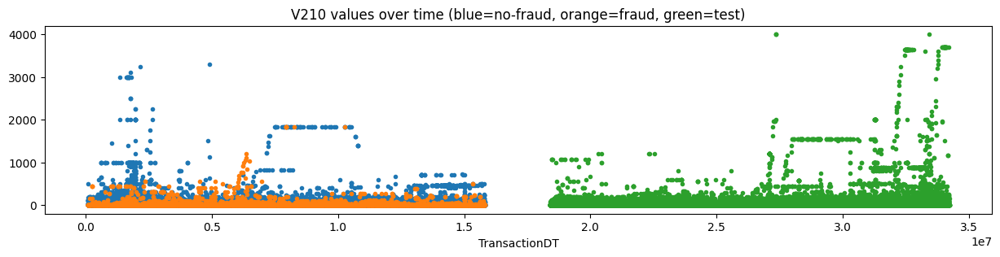

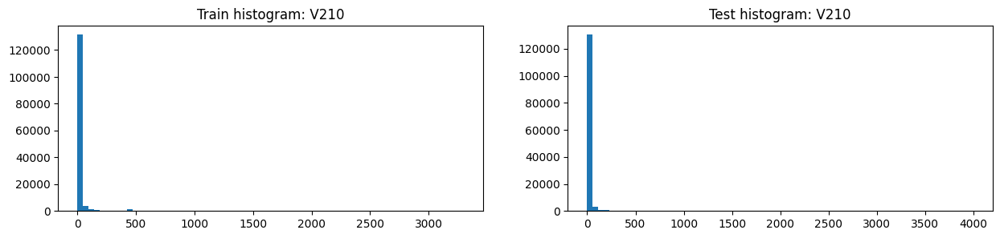

,V210,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139819.000000,11070.000000,128749.000000,136375.000000,17811.000000,118564.000000
1,mean,14.391835,14.199290,14.408390,14.891453,8.842171,15.800192
2,std,86.523724,73.466863,87.555739,121.947914,51.011022,129.259876
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,3300.000000,1825.000000,3300.000000,4000.000000,1200.000000,4000.000000
8,unique values,2837.000000,290.000000,2746.000000,2479.000000,563.000000,2282.000000
9,NaNs,450721.000000,9593.000000,441128.000000,370316.000000,83528.000000,286789.000000


,V210,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450721,0.021284,9593,370316.0
1,0.0,123575,0.077103,9528,119191.0
2,465.0,1340,0.000000,0,NaN
3,50.0,654,0.070336,46,573.0
4,100.0,560,0.085714,48,506.0
5,25.0,325,0.049231,16,349.0
6,150.0,283,0.134276,38,231.0
7,200.0,277,0.220217,61,230.0
8,20.0,179,0.089385,16,134.0
9,75.0,175,0.005714,1,173.0


,V210,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0000,450721,0.021284,9593,370316
1,0.0000,123575,0.077103,9528,119191
2,200.0000,277,0.220217,61,230
3,100.0000,560,0.085714,48,506
4,25.4527,49,0.959184,47,16
5,50.0000,654,0.070336,46,573
6,150.0000,283,0.134276,38,231
7,300.0000,120,0.300000,36,113
8,450.0000,48,0.708333,34,50
9,8.9146,35,0.942857,33,19


,Column,Correlation with V210
0,V210,1.000000
1,V208,0.778370
2,V175,0.692734
3,V209,0.663778
4,V314,0.610318
5,V327,0.506944
342,V15,-0.286831
343,V33,-0.290218
344,V20,-0.309785
345,V61,-0.320396


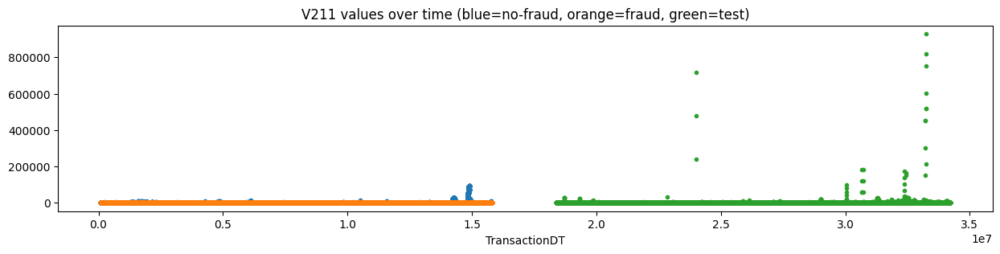

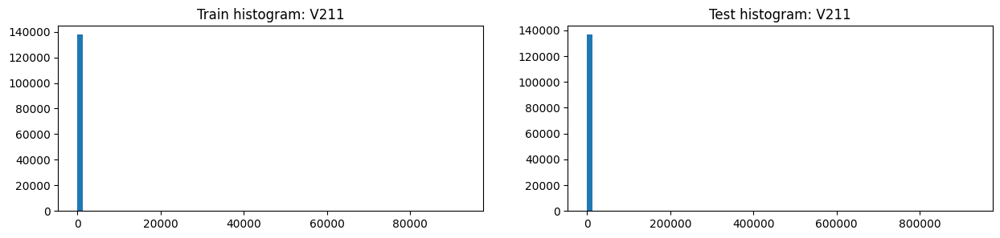

,V211,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,385.137037,97.236561,409.851898,138.294487,77.946879,147.420327
2,std,4541.837915,261.397582,4731.337313,5847.832059,678.599433,6268.831585
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,86.883999,0.000000,0.000000,0.000000,0.000000
7,max,92888.000000,5450.000000,92888.000000,928882.000000,26400.000000,928882.000000
8,unique values,7625.000000,2752.000000,5755.000000,6541.000000,1775.000000,5537.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V211,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,0.0,120997,0.053001,6413,119067.0
2,100.0,981,0.111111,109,532.0
3,200.0,681,0.174743,119,512.0
4,150.0,642,0.196262,126,373.0
5,50.0,633,0.083728,53,312.0
6,300.0,557,0.220826,123,304.0
7,75.0,244,0.122951,30,125.0
8,400.0,236,0.216102,51,256.0
9,600.0,212,0.202830,43,181.0


,V211,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,120997,0.053001,6413,119067
2,150.0,642,0.196262,126,373
3,300.0,557,0.220826,123,304
4,200.0,681,0.174743,119,512
5,100.0,981,0.111111,109,532
6,50.0,633,0.083728,53,312
7,400.0,236,0.216102,51,256
8,450.0,146,0.315068,46,67
9,600.0,212,0.202830,43,181


,Column,Correlation with V211
0,V211,1.000000
1,V177,0.998120
2,V167,0.997784
3,V316,0.993173
4,V132,0.993064
5,V101,0.991130
342,V62,-0.245534
343,V57,-0.250813
344,V20,-0.294317
345,V61,-0.306737


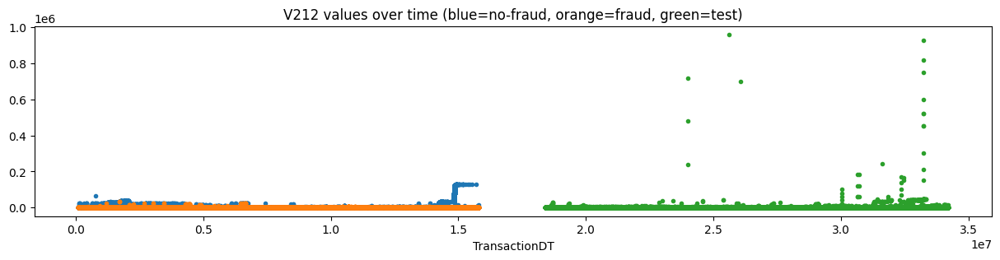

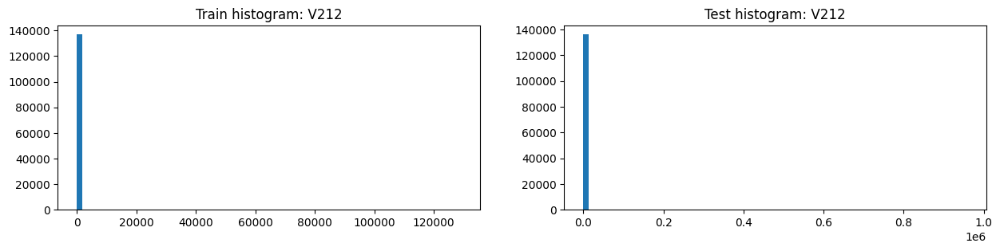

,V212,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,765.988339,225.179319,812.414172,237.507053,119.402121,255.367027
2,std,7496.120737,1385.125382,7798.955699,6889.655730,771.873713,7385.998157
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,141.404007,0.000000,0.000000,0.000000,0.000000
7,max,129006.000000,34625.000000,129006.000000,958320.000000,26400.000000,958320.000000
8,unique values,8869.000000,3245.000000,6518.000000,7977.000000,2095.000000,6745.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V212,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,0.0,118836,0.049943,5935,116464.0
2,100.0,965,0.117098,113,570.0
3,200.0,674,0.181009,122,501.0
4,150.0,658,0.205167,135,385.0
5,50.0,643,0.080871,52,363.0
6,300.0,554,0.236462,131,299.0
7,400.0,263,0.205323,54,264.0
8,75.0,231,0.082251,19,147.0
9,25.0,224,0.084821,19,110.0


,V212,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,118836,0.049943,5935,116464
2,150.0,658,0.205167,135,385
3,300.0,554,0.236462,131,299
4,200.0,674,0.181009,122,501
5,100.0,965,0.117098,113,570
6,400.0,263,0.205323,54,264
7,50.0,643,0.080871,52,363
8,450.0,147,0.333333,49,73
9,250.0,173,0.236994,41,129


,Column,Correlation with V212
0,V212,1.000000
1,V178,0.987227
2,V213,0.984943
3,V168,0.982553
4,V204,0.981081
5,V179,0.973843
342,V62,-0.265773
343,V57,-0.274236
344,V20,-0.319241
345,V61,-0.332177


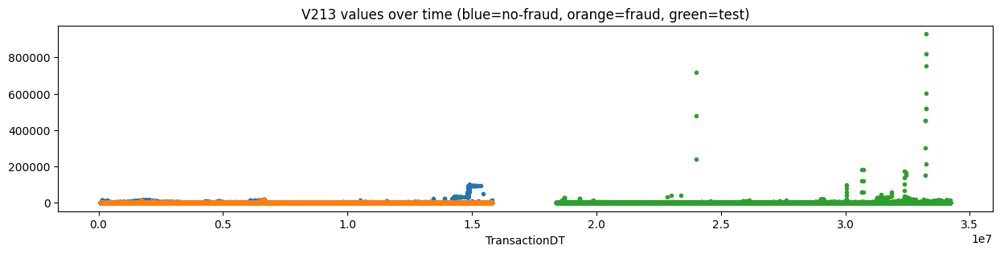

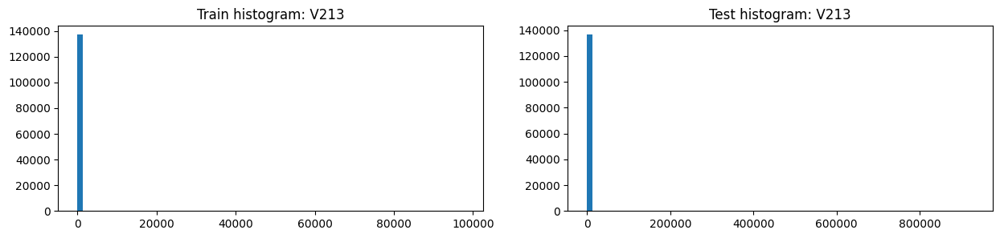

,V213,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,536.302802,151.573946,569.329910,165.117391,91.327816,176.275942
2,std,5471.664736,647.084991,5697.325996,5880.191811,697.521050,6303.245630
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,119.103798,0.000000,0.000000,0.000000,0.000000
7,max,97628.000000,16950.000000,97628.000000,928882.000000,26400.000000,928882.000000
8,unique values,8318.000000,3079.000000,6141.000000,7441.000000,1975.000000,6280.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V213,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,0.0,119688,0.050732,6072,117611.0
2,100.0,960,0.114583,110,558.0
3,200.0,684,0.185673,127,498.0
4,150.0,650,0.204615,133,386.0
5,50.0,633,0.080569,51,337.0
6,300.0,561,0.221034,124,337.0
7,400.0,265,0.207547,55,263.0
8,75.0,234,0.085470,20,130.0
9,600.0,214,0.182243,39,232.0


,V213,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,119688,0.050732,6072,117611
2,150.0,650,0.204615,133,386
3,200.0,684,0.185673,127,498
4,300.0,561,0.221034,124,337
5,100.0,960,0.114583,110,558
6,400.0,265,0.207547,55,263
7,50.0,633,0.080569,51,337
8,450.0,155,0.322581,50,81
9,250.0,176,0.244318,43,134


,Column,Correlation with V213
0,V213,1.000000
1,V179,0.996031
2,V168,0.995785
3,V178,0.992741
4,V212,0.984943
5,V134,0.983906
342,V62,-0.271962
343,V57,-0.279049
344,V20,-0.326851
345,V61,-0.340046


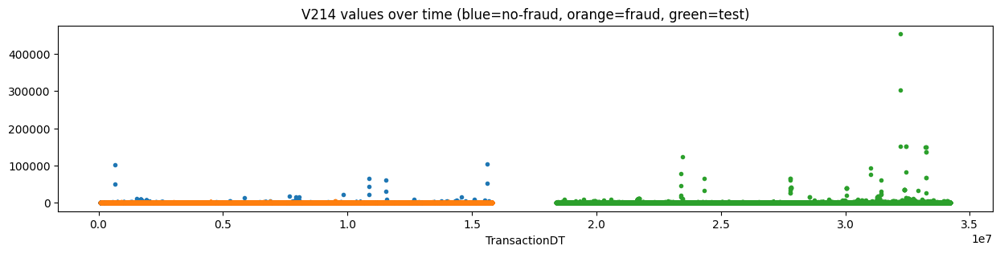

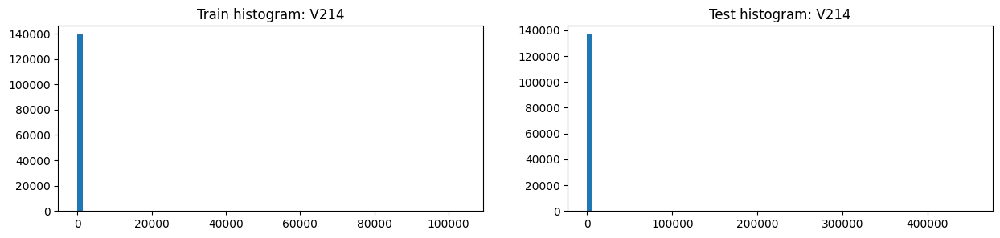

,V214,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,38.437547,47.904827,37.624827,63.859337,60.051108,64.435222
2,std,571.834283,198.676843,593.016828,2079.078198,499.382928,2222.278709
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,104060.000000,4500.000000,104060.000000,453750.000000,10950.000000,453750.000000
8,unique values,2283.000000,479.000000,2050.000000,2045.000000,508.000000,1823.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V214,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,0.0,125518,0.071249,8943,123637.0
2,100.0,1303,0.080583,105,1002.0
3,200.0,930,0.119355,111,908.0
4,1165.0,862,0.000000,0,NaN
5,150.0,689,0.171263,118,530.0
6,300.0,650,0.213846,139,561.0
7,50.0,643,0.111975,72,491.0
8,400.0,398,0.158291,63,516.0
9,250.0,346,0.078035,27,391.0


,V214,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,125518,0.071249,8943,123637
2,300.0,650,0.213846,139,561
3,150.0,689,0.171263,118,530
4,200.0,930,0.119355,111,908
5,100.0,1303,0.080583,105,1002
6,50.0,643,0.111975,72,491
7,400.0,398,0.158291,63,516
8,600.0,289,0.204152,59,287
9,450.0,173,0.306358,53,100


,Column,Correlation with V214
0,V214,1.000000
1,V276,0.990600
2,V278,0.941354
3,V216,0.905539
4,V277,0.891647
5,V319,0.885149
342,V15,-0.145990
343,V20,-0.146413
344,V33,-0.147715
345,V61,-0.156493


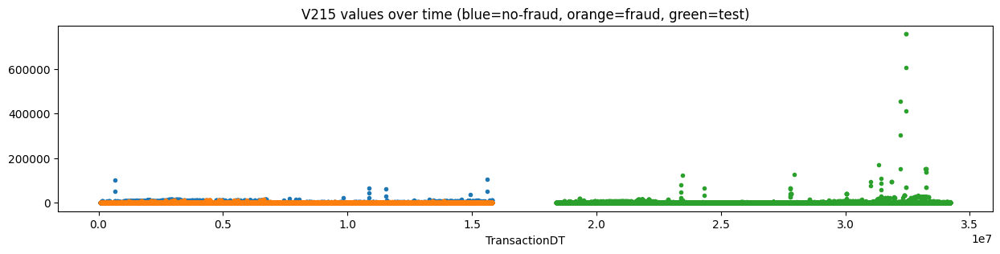

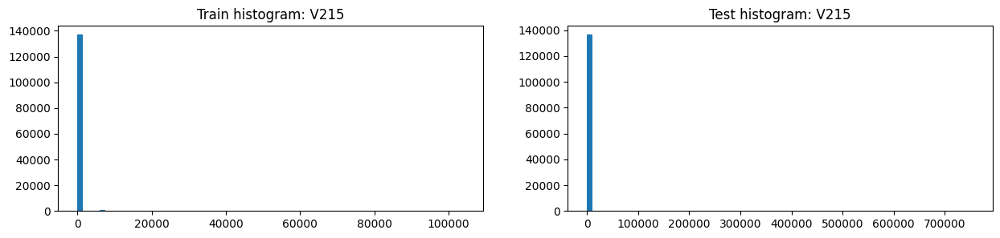

,V215,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,133.208217,116.159801,134.671741,137.666738,119.382932,140.431638
2,std,1040.453748,785.388033,1059.481445,4229.761774,866.771767,4525.784443
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,104060.000000,13725.000000,104060.000000,756250.000000,19200.000000,756250.000000
8,unique values,2748.000000,568.000000,2480.000000,2509.000000,651.000000,2164.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V215,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,0.0,123142,0.069570,8567,121029.0
2,100.0,1330,0.087970,117,1036.0
3,200.0,939,0.120341,113,885.0
4,6428.0,863,0.000000,0,NaN
5,50.0,720,0.104167,75,509.0
6,150.0,703,0.170697,120,522.0
7,300.0,647,0.217929,141,545.0
8,400.0,346,0.193642,67,510.0
9,250.0,322,0.086957,28,387.0


,V215,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,123142,0.069570,8567,121029
2,300.0,647,0.217929,141,545
3,150.0,703,0.170697,120,522
4,100.0,1330,0.087970,117,1036
5,200.0,939,0.120341,113,885
6,50.0,720,0.104167,75,509
7,600.0,286,0.241259,69,296
8,400.0,346,0.193642,67,510
9,450.0,167,0.311377,52,111


,Column,Correlation with V215
0,V215,1.000000
1,V278,0.971923
2,V277,0.950580
3,V276,0.929874
4,V216,0.867910
5,V180,0.773994
342,V33,-0.287601
343,V57,-0.293602
344,V20,-0.322778
345,V61,-0.336077


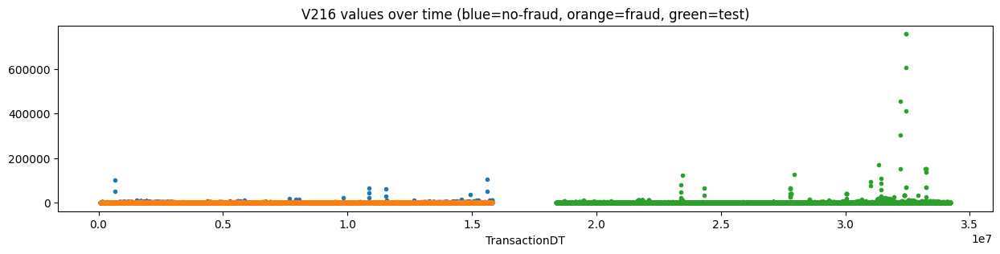

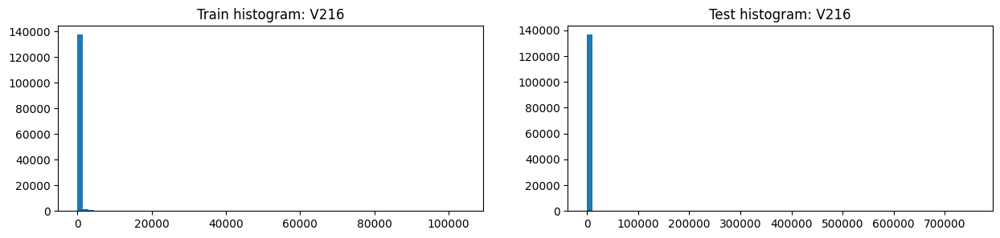

,V216,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,139631.000000,11039.000000,128592.000000,136734.000000,17961.000000,118773.000000
1,mean,71.107143,69.686454,71.229102,98.227713,72.224114,102.160010
2,std,680.267625,306.143918,703.167916,4107.166269,529.610903,4401.957276
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,104060.000000,6100.000000,104060.000000,756250.000000,10950.000000,756250.000000
8,unique values,2533.000000,530.000000,2281.000000,2252.000000,554.000000,2001.000000
9,NaNs,450909.000000,9624.000000,441285.000000,369957.000000,83378.000000,286580.000000


,V216,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,450909,0.021344,9624,369957.0
1,0.0,124108,0.070028,8691,122245.0
2,100.0,1307,0.086458,113,1012.0
3,200.0,942,0.121019,114,885.0
4,150.0,695,0.171223,119,517.0
5,50.0,679,0.113402,77,507.0
6,300.0,640,0.225000,144,575.0
7,2932.0,606,0.000000,0,NaN
8,400.0,366,0.191257,70,504.0
9,250.0,317,0.082019,26,387.0


,V216,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,450909,0.021344,9624,369957
1,0.0,124108,0.070028,8691,122245
2,300.0,640,0.225000,144,575
3,150.0,695,0.171223,119,517
4,200.0,942,0.121019,114,885
5,100.0,1307,0.086458,113,1012
6,50.0,679,0.113402,77,507
7,400.0,366,0.191257,70,504
8,600.0,279,0.207885,58,306
9,450.0,176,0.312500,55,126


,Column,Correlation with V216
0,V216,1.000000
1,V278,0.984444
2,V276,0.949140
3,V277,0.939314
4,V214,0.905539
5,V215,0.867910
342,V33,-0.243318
343,V57,-0.250351
344,V20,-0.266402
345,V61,-0.286068


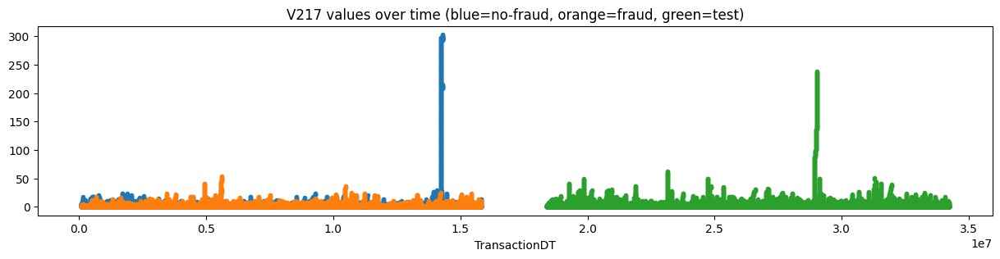

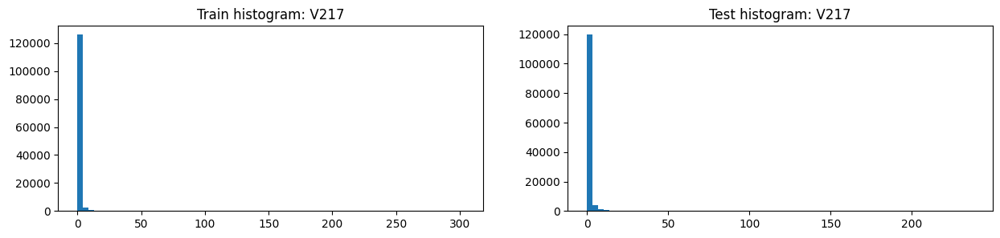

,V217,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.054619,2.556024,0.927352,0.987217,1.133670,0.965415
2,std,9.547354,4.503774,9.846424,6.486470,3.252485,6.838085
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,3.000000,0.000000,1.000000,1.000000,0.000000
7,max,303.000000,53.000000,303.000000,238.000000,49.000000,238.000000
8,unique values,305.000000,55.000000,305.000000,240.000000,51.000000,240.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V217,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,98285,0.040179,3949,94140.0
2,1.0,15372,0.132123,2031,15388.0
3,2.0,6761,0.177636,1201,6599.0
4,3.0,3552,0.219032,778,3534.0
5,4.0,2068,0.262573,543,2072.0
6,5.0,1083,0.311173,337,1171.0
7,6.0,727,0.356259,259,763.0
8,7.0,513,0.393762,202,522.0
9,8.0,371,0.431267,160,400.0


,V217,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,98285,0.040179,3949,94140
2,1.0,15372,0.132123,2031,15388
3,2.0,6761,0.177636,1201,6599
4,3.0,3552,0.219032,778,3534
5,4.0,2068,0.262573,543,2072
6,5.0,1083,0.311173,337,1171
7,6.0,727,0.356259,259,763
8,7.0,513,0.393762,202,522
9,8.0,371,0.431267,160,400


,Column,Correlation with V217
0,V217,1.000000
1,V231,0.995970
2,V233,0.989669
3,V232,0.983680
4,V219,0.983101
5,V167,0.964245
342,V57,-0.130091
343,V20,-0.170519
344,V61,-0.172675
345,V19,-0.195597


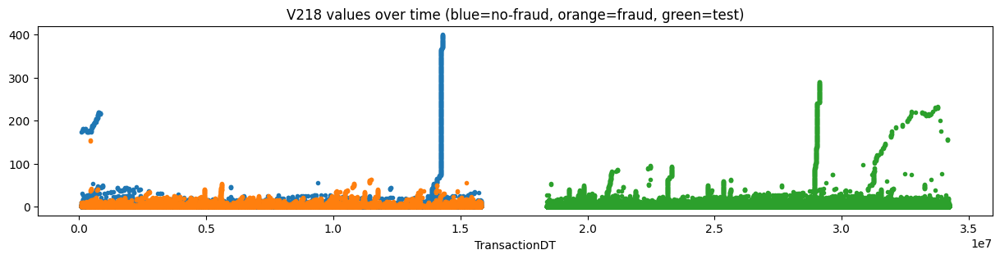

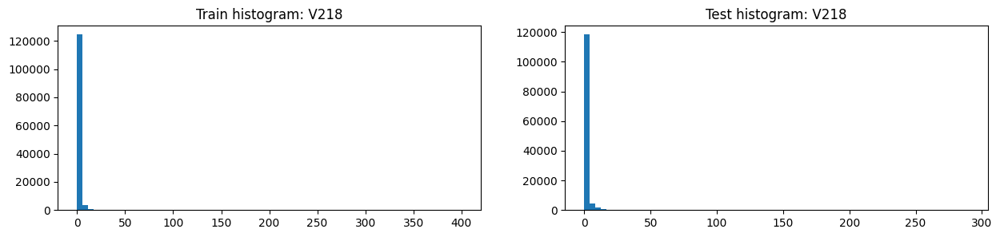

,V218,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.725784,3.999902,1.533018,1.632899,1.760124,1.613959
2,std,13.919876,6.882425,14.342145,10.095978,5.215433,10.632537
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.000000,5.000000,1.000000,1.000000,1.000000,1.000000
7,max,400.000000,154.000000,400.000000,290.000000,87.000000,290.000000
8,unique values,402.000000,68.000000,402.000000,292.000000,89.000000,292.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V218,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,90334,0.035081,3169,86000.0
2,1.0,17257,0.103494,1786,17317.0
3,2.0,7967,0.145475,1159,7874.0
4,3.0,4494,0.182466,820,4429.0
5,4.0,2779,0.224181,623,2764.0
6,5.0,1672,0.256579,429,1758.0
7,6.0,1150,0.299130,344,1219.0
8,7.0,850,0.318824,271,863.0
9,8.0,630,0.349206,220,675.0


,V218,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,90334,0.035081,3169,86000
2,1.0,17257,0.103494,1786,17317
3,2.0,7967,0.145475,1159,7874
4,3.0,4494,0.182466,820,4429
5,4.0,2779,0.224181,623,2764
6,5.0,1672,0.256579,429,1758
7,6.0,1150,0.299130,344,1219
8,7.0,850,0.318824,271,863
9,8.0,630,0.349206,220,675


,Column,Correlation with V218
0,V218,1.000000
1,V219,0.969563
2,V232,0.953062
3,V168,0.935449
4,V233,0.930716
5,V179,0.926956
342,V57,-0.153378
343,D5,-0.179525
344,V20,-0.195542
345,V61,-0.196182


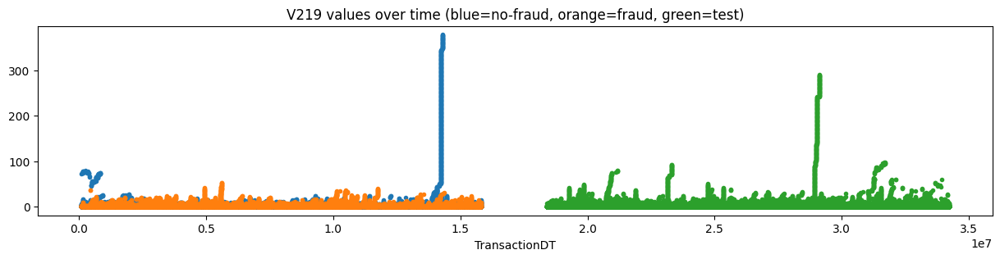

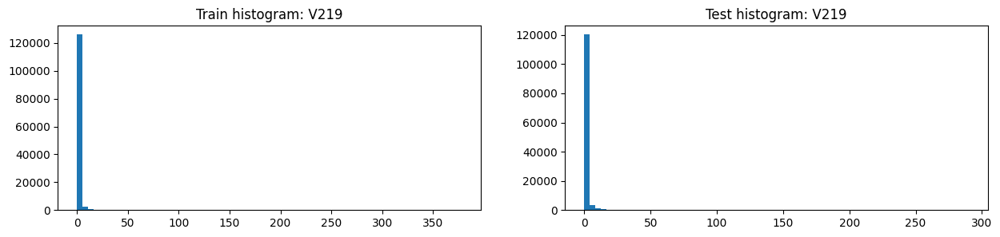

,V219,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.367132,3.271782,1.205684,1.308811,1.476219,1.283890
2,std,12.044032,5.381539,12.432478,8.763826,4.706359,9.216094
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.000000,4.000000,0.000000,1.000000,1.000000,1.000000
7,max,378.000000,53.000000,378.000000,290.000000,80.000000,290.000000
8,unique values,380.000000,55.000000,380.000000,292.000000,82.000000,292.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V219,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,94337,0.036529,3446,89956.0
2,1.0,16438,0.114856,1888,16581.0
3,2.0,7419,0.162421,1205,7273.0
4,3.0,4045,0.207417,839,3997.0
5,4.0,2435,0.252156,614,2456.0
6,5.0,1393,0.292175,407,1500.0
7,6.0,924,0.324675,300,999.0
8,7.0,633,0.375987,238,665.0
9,8.0,468,0.388889,182,520.0


,V219,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,94337,0.036529,3446,89956
2,1.0,16438,0.114856,1888,16581
3,2.0,7419,0.162421,1205,7273
4,3.0,4045,0.207417,839,3997
5,4.0,2435,0.252156,614,2456
6,5.0,1393,0.292175,407,1500
7,6.0,924,0.324675,300,999
8,7.0,633,0.375987,238,665
9,8.0,468,0.388889,182,520


,Column,Correlation with V219
0,V219,1.000000
1,V232,0.990591
2,V233,0.988440
3,V217,0.983101
4,V231,0.974698
5,V218,0.969563
342,V57,-0.142380
343,V20,-0.183511
344,V61,-0.185871
345,V19,-0.210998


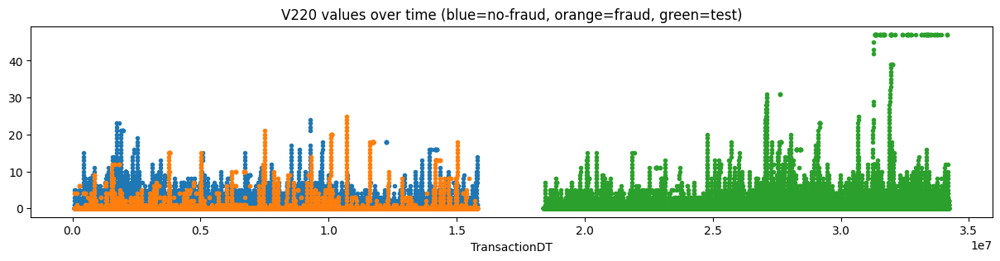

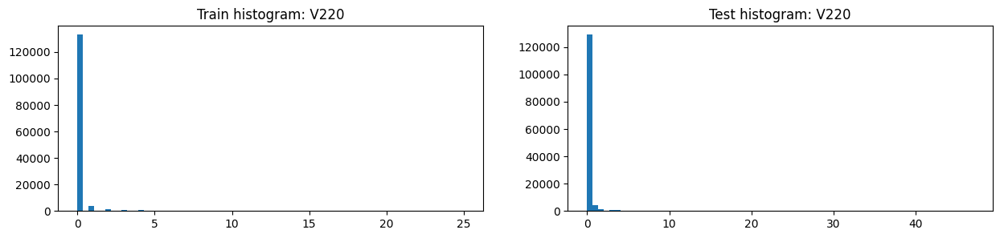

,V220,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,141416.000000,10982.000000,130434.000000,137316.000000,17734.000000,119582.000000
1,mean,0.169472,0.434165,0.147186,0.203720,0.126311,0.215200
2,std,1.002463,2.017091,0.860589,1.646167,0.732897,1.740996
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,25.000000,25.000000,24.000000,47.000000,15.000000,47.000000
8,unique values,27.000000,27.000000,26.000000,45.000000,17.000000,45.000000
9,NaNs,449124.000000,9681.000000,439443.000000,369375.000000,83605.000000,285771.000000


,V220,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,449124,0.021555,9681,369375
1,0.0,133047,0.075379,10029,129017
2,1.0,3795,0.073254,278,4111
3,2.0,1562,0.079385,124,1417
4,3.0,980,0.106122,104,812
5,4.0,615,0.149593,92,520
6,5.0,380,0.155263,59,343
7,6.0,290,0.189655,55,233
8,7.0,173,0.167630,29,156
9,8.0,124,0.241935,30,129


,V220,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,133047,0.075379,10029,129017
1,-999.0,449124,0.021555,9681,369375
2,1.0,3795,0.073254,278,4111
3,2.0,1562,0.079385,124,1417
4,3.0,980,0.106122,104,812
5,4.0,615,0.149593,92,520
6,5.0,380,0.155263,59,343
7,6.0,290,0.189655,55,233
8,8.0,124,0.241935,30,129
9,7.0,173,0.167630,29,156


,Column,Correlation with V220
0,V220,1.000000
1,V169,0.602435
2,V228,0.475678
3,V138,0.462047
4,V223,0.442897
5,V281,0.409837
342,D14,-0.082167
343,D7,-0.116589
344,D3,-0.118448
345,D5,-0.129481


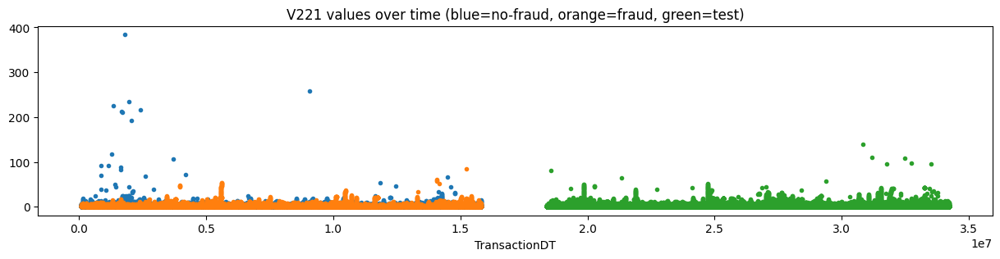

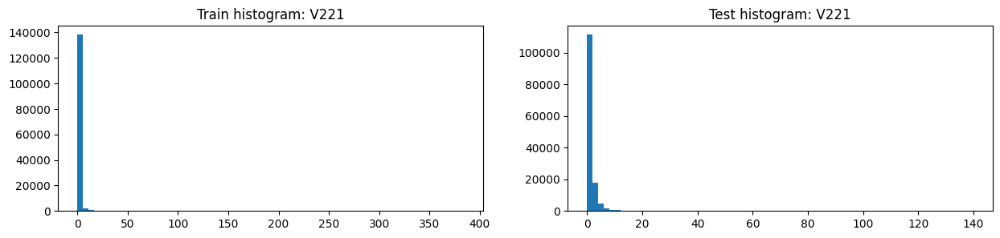

,V221,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,141416.000000,10982.000000,130434.000000,137316.000000,17734.000000,119582.000000
1,mean,1.274912,2.521399,1.169963,1.286085,1.421056,1.266068
2,std,2.728792,4.369119,2.514822,2.272496,2.603597,2.218505
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,3.000000,1.000000,1.000000,1.000000,1.000000
7,max,384.000000,84.000000,384.000000,140.000000,80.000000,140.000000
8,unique values,78.000000,60.000000,61.000000,61.000000,54.000000,59.000000
9,NaNs,449124.000000,9681.000000,439443.000000,369375.000000,83605.000000,285771.000000


,V221,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,449124,0.021555,9681,369375.0
1,1.0,82715,0.038760,3206,76462.0
2,0.0,32341,0.093998,3040,34966.0
3,2.0,12789,0.126828,1622,12283.0
4,3.0,5615,0.158860,892,5431.0
5,4.0,3064,0.202676,621,2884.0
6,5.0,1716,0.236597,406,1767.0
7,6.0,850,0.276471,235,881.0
8,7.0,566,0.289753,164,591.0
9,8.0,401,0.346633,139,397.0


,V221,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,449124,0.021555,9681,369375
1,1.0,82715,0.038760,3206,76462
2,0.0,32341,0.093998,3040,34966
3,2.0,12789,0.126828,1622,12283
4,3.0,5615,0.158860,892,5431
5,4.0,3064,0.202676,621,2884
6,5.0,1716,0.236597,406,1767
7,6.0,850,0.276471,235,881
8,7.0,566,0.289753,164,591
9,8.0,401,0.346633,139,397


,Column,Correlation with V221
0,V221,1.000000
1,V222,0.970040
2,V259,0.927828
3,V245,0.872754
4,V227,0.786910
5,V255,0.759551
342,D8,-0.111452
343,D7,-0.145855
344,D5,-0.170755
345,D14,-0.180650


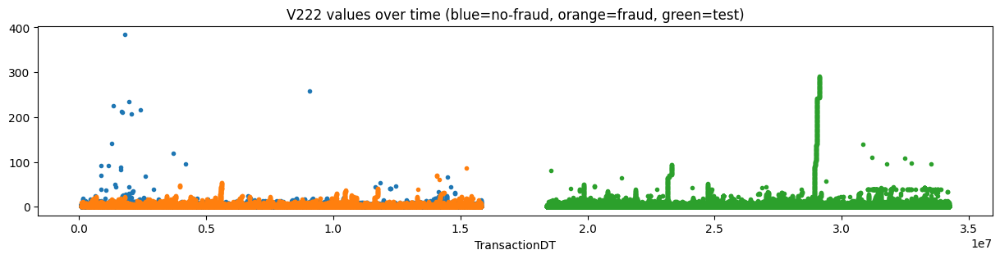

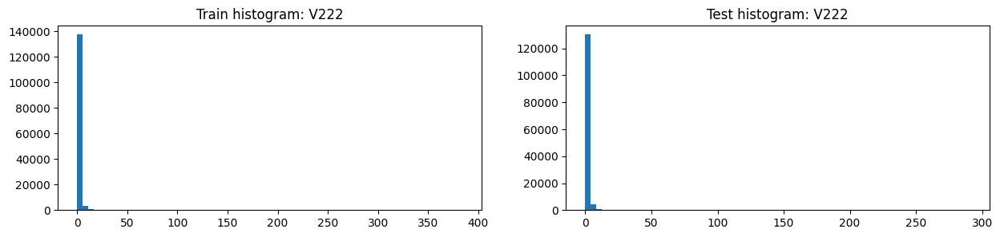

,V222,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,141416.000000,10982.000000,130434.000000,137316.000000,17734.000000,119582.000000
1,mean,1.359005,3.029776,1.218333,1.758987,1.611537,1.780853
2,std,2.913772,5.078343,2.603629,8.293763,3.214567,8.800656
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,4.000000,1.000000,1.000000,1.000000,1.000000
7,max,384.000000,86.000000,384.000000,291.000000,80.000000,291.000000
8,unique values,77.000000,61.000000,63.000000,293.000000,54.000000,293.000000
9,NaNs,449124.000000,9681.000000,439443.000000,369375.000000,83605.000000,285771.000000


,V222,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,449124,0.021555,9681,369375.0
1,1.0,80334,0.033597,2699,73617.0
2,0.0,32264,0.093882,3029,34899.0
3,2.0,13462,0.113430,1527,13040.0
4,3.0,5985,0.153885,921,5632.0
5,4.0,3313,0.198612,658,3127.0
6,5.0,1943,0.258878,503,1884.0
7,6.0,1173,0.276215,324,1197.0
8,7.0,687,0.308588,212,774.0
9,8.0,470,0.342553,161,519.0


,V222,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,449124,0.021555,9681,369375
1,0.0,32264,0.093882,3029,34899
2,1.0,80334,0.033597,2699,73617
3,2.0,13462,0.113430,1527,13040
4,3.0,5985,0.153885,921,5632
5,4.0,3313,0.198612,658,3127
6,5.0,1943,0.258878,503,1884
7,6.0,1173,0.276215,324,1197
8,7.0,687,0.308588,212,774
9,9.0,409,0.501222,205,394


,Column,Correlation with V222
0,V222,1.000000
1,V221,0.970040
2,V259,0.901667
3,V245,0.844196
4,V227,0.772915
5,V256,0.736382
342,D8,-0.113880
343,D7,-0.151208
344,D5,-0.174508
345,D14,-0.182048


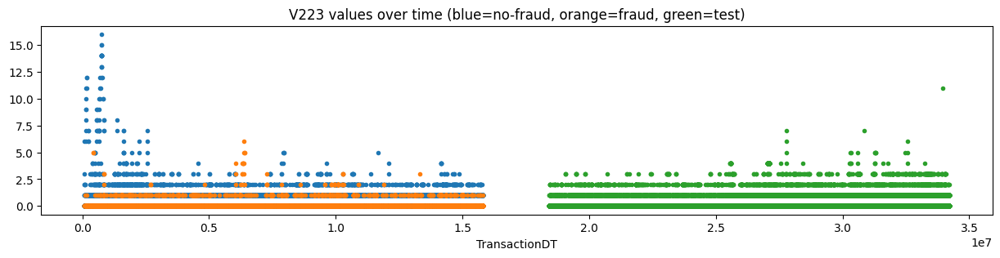

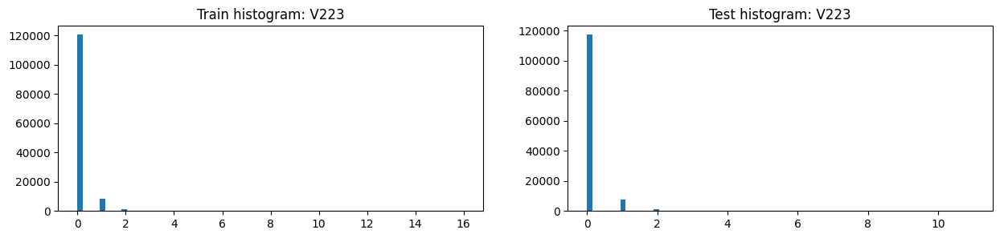

,V223,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,0.093153,0.094682,0.093024,0.095922,0.081542,0.098063
2,std,0.402232,0.348206,0.406483,0.374674,0.317555,0.382403
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,16.000000,6.000000,16.000000,11.000000,3.000000,11.000000
8,unique values,18.000000,8.000000,18.000000,10.000000,5.000000,10.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V223,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,120515,0.077492,9339,117163.0
2,1.0,8495,0.092172,783,7602.0
3,2.0,1114,0.042190,47,1459.0
4,3.0,181,0.060773,11,408.0
5,4.0,38,0.157895,6,80.0
6,5.0,20,0.250000,5,11.0
7,7.0,16,0.000000,0,2.0
8,6.0,10,0.100000,1,2.0
9,14.0,8,0.000000,0,NaN


,V223,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,120515,0.077492,9339,117163.0
2,1.0,8495,0.092172,783,7602.0
3,2.0,1114,0.042190,47,1459.0
4,3.0,181,0.060773,11,408.0
5,4.0,38,0.157895,6,80.0
6,5.0,20,0.250000,5,11.0
7,6.0,10,0.100000,1,2.0
8,9.0,5,0.000000,0,NaN
9,15.0,2,0.000000,0,NaN


,Column,Correlation with V223
0,V223,1.000000
1,V172,0.789992
2,V225,0.717265
3,V173,0.675904
4,V284,0.621895
5,V224,0.603380
342,D8,-0.099107
343,D7,-0.186522
344,D5,-0.195516
345,D3,-0.204349


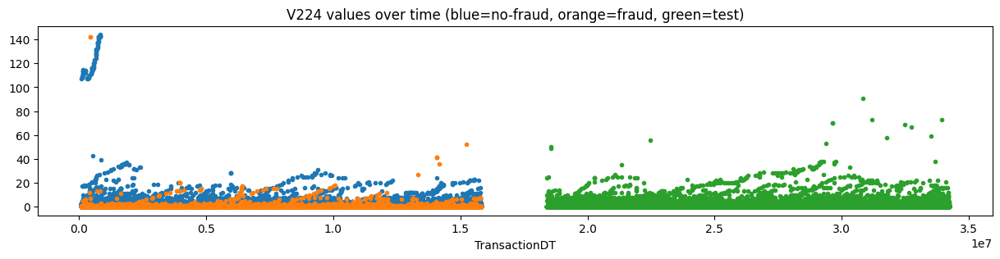

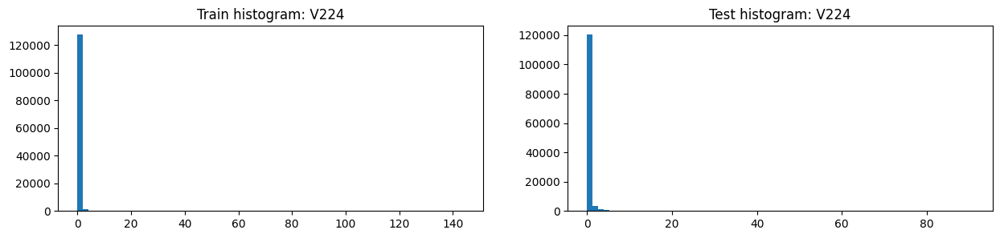

,V224,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,0.394748,0.408359,0.393594,0.307067,0.330065,0.303643
2,std,3.443310,2.533156,3.509631,1.492265,1.506038,1.490181
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,144.000000,142.000000,144.000000,91.000000,50.000000,91.000000
8,unique values,80.000000,26.000000,78.000000,51.000000,32.000000,49.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V224,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,112053,0.073073,8188,108515.0
2,1.0,12540,0.112679,1413,11803.0
3,2.0,2808,0.125712,353,3180.0
4,3.0,942,0.087049,82,1218.0
5,4.0,428,0.044393,19,560.0
6,18.0,340,0.002941,1,22.0
7,5.0,222,0.058559,13,394.0
8,6.0,194,0.118557,23,217.0
9,7.0,159,0.188679,30,143.0


,V224,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,112053,0.073073,8188,108515
2,1.0,12540,0.112679,1413,11803
3,2.0,2808,0.125712,353,3180
4,3.0,942,0.087049,82,1218
5,7.0,159,0.188679,30,143
6,6.0,194,0.118557,23,217
7,4.0,428,0.044393,19,560
8,5.0,222,0.058559,13,394
9,8.0,97,0.103093,10,118


,Column,Correlation with V224
0,V224,1.000000
1,V225,0.952899
2,V253,0.894167
3,V254,0.862917
4,V267,0.852091
5,V248,0.839747
342,V15,-0.187522
343,V33,-0.190779
344,V61,-0.198038
345,V20,-0.201311


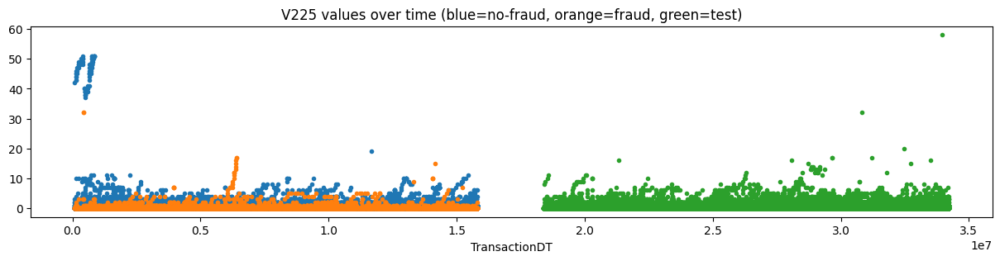

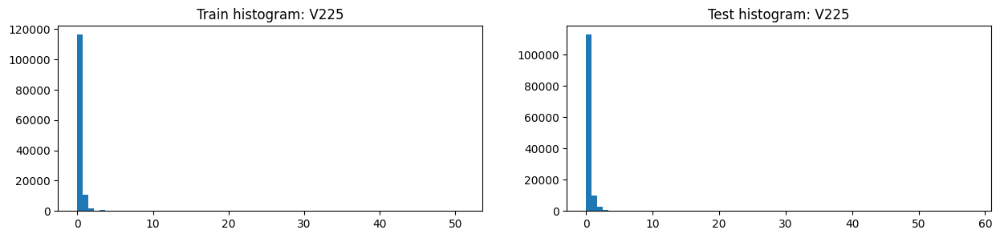

,V225,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,0.191758,0.226943,0.188776,0.164620,0.154010,0.166200
2,std,1.290820,0.900620,1.318557,0.627715,0.589882,0.633141
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,51.000000,32.000000,51.000000,58.000000,16.000000,58.000000
8,unique values,36.000000,20.000000,29.000000,22.000000,14.000000,22.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V225,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,116323,0.074448,8660,112754.0
2,1.0,10798,0.112521,1215,10107.0
3,2.0,1869,0.103799,194,2473.0
4,3.0,526,0.076046,40,768.0
5,7.0,377,0.023873,9,49.0
6,4.0,180,0.177778,32,287.0
7,5.0,99,0.191919,19,147.0
8,6.0,71,0.028169,2,68.0
9,8.0,39,0.051282,2,21.0


,V225,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,116323,0.074448,8660,112754
2,1.0,10798,0.112521,1215,10107
3,2.0,1869,0.103799,194,2473
4,3.0,526,0.076046,40,768
5,4.0,180,0.177778,32,287
6,5.0,99,0.191919,19,147
7,7.0,377,0.023873,9,49
8,10.0,33,0.121212,4,10
9,12.0,3,1.000000,3,6


,Column,Correlation with V225
0,V225,1.000000
1,V224,0.952899
2,V253,0.860549
3,V254,0.847145
4,V267,0.834890
5,V229,0.821672
342,D7,-0.146259
343,D5,-0.148920
344,V20,-0.164271
345,D3,-0.166779


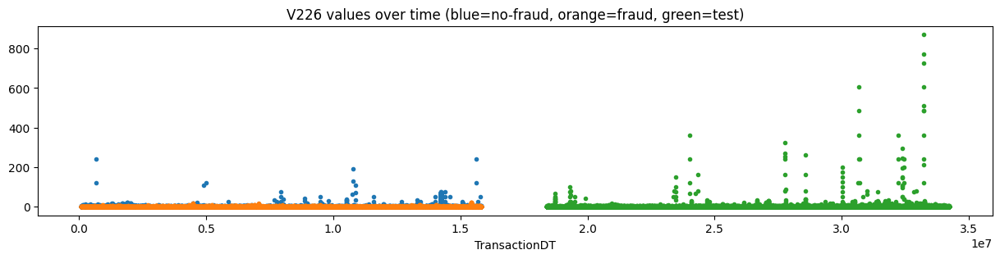

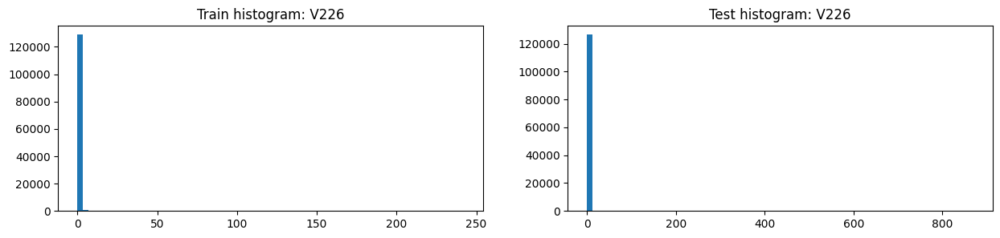

,V226,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,0.247612,0.269133,0.245788,0.267052,0.215943,0.274661
2,std,2.756449,1.212436,2.849110,6.734296,1.939026,7.179267
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,242.000000,23.000000,242.000000,870.000000,100.000000,870.000000
8,unique values,82.000000,25.000000,82.000000,83.000000,31.000000,78.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V226,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,122371,0.075320,9217,119388.0
2,1.0,4208,0.095532,402,3943.0
3,2.0,1597,0.139011,222,1484.0
4,3.0,728,0.167582,122,629.0
5,4.0,474,0.154008,73,467.0
6,5.0,215,0.227907,49,172.0
7,6.0,136,0.205882,28,111.0
8,7.0,84,0.250000,21,61.0
9,8.0,72,0.208333,15,99.0


,V226,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,122371,0.075320,9217,119388
2,1.0,4208,0.095532,402,3943
3,2.0,1597,0.139011,222,1484
4,3.0,728,0.167582,122,629
5,4.0,474,0.154008,73,467
6,5.0,215,0.227907,49,172
7,6.0,136,0.205882,28,111
8,7.0,84,0.250000,21,61
9,8.0,72,0.208333,15,99


,Column,Correlation with V226
0,V226,1.000000
1,V263,0.760715
2,V202,0.751501
3,V204,0.728577
4,V306,0.712872
5,V308,0.703410
341,V33,-0.168278
342,V51,-0.171461
343,V20,-0.192599
344,V61,-0.200231


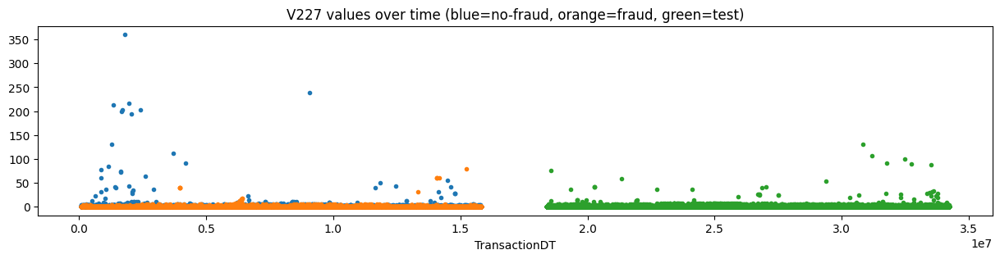

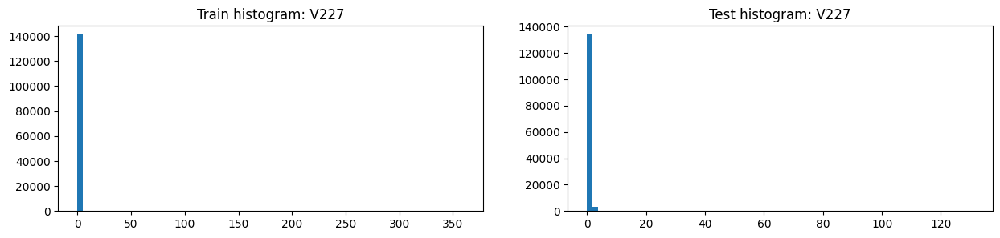

,V227,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,141416.000000,10982.000000,130434.000000,137316.000000,17734.000000,119582.00000
1,mean,0.147975,0.267984,0.137870,0.143246,0.145314,0.14294
2,std,2.049363,1.772261,2.070691,0.991485,1.086631,0.97659
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
7,max,360.000000,79.000000,360.000000,131.000000,75.000000,131.00000
8,unique values,51.000000,23.000000,46.000000,41.000000,16.000000,38.00000
9,NaNs,449124.000000,9681.000000,439443.000000,369375.000000,83605.000000,285771.00000


,V227,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,449124,0.021555,9681,369375.0
1,0.0,128436,0.072986,9374,124655.0
2,1.0,10503,0.118918,1249,9278.0
3,2.0,1659,0.101869,169,2267.0
4,3.0,432,0.219907,95,643.0
5,4.0,123,0.097561,12,219.0
6,6.0,90,0.388889,35,50.0
7,5.0,61,0.327869,20,79.0
8,7.0,13,0.307692,4,45.0
9,9.0,12,0.083333,1,7.0


,V227,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,449124,0.021555,9681,369375
1,0.0,128436,0.072986,9374,124655
2,1.0,10503,0.118918,1249,9278
3,2.0,1659,0.101869,169,2267
4,3.0,432,0.219907,95,643
5,6.0,90,0.388889,35,50
6,5.0,61,0.327869,20,79
7,4.0,123,0.097561,12,219
8,7.0,13,0.307692,4,45
9,40.0,5,0.800000,4,1


,Column,Correlation with V227
0,V227,1.000000
1,V245,0.901069
2,V259,0.826610
3,V255,0.795647
4,V221,0.786910
5,V256,0.783825
342,D14,-0.034548
343,D7,-0.113747
344,D3,-0.124294
345,D5,-0.126461


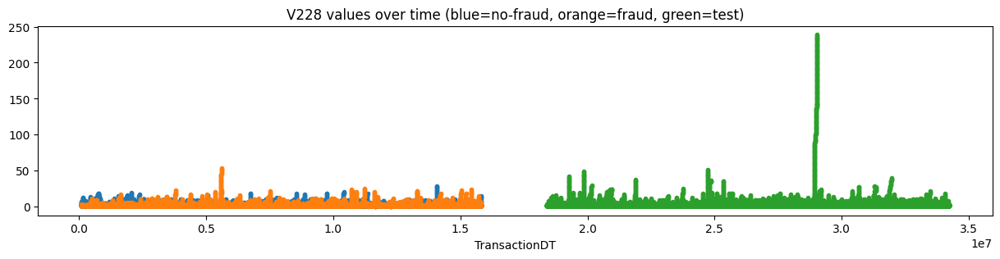

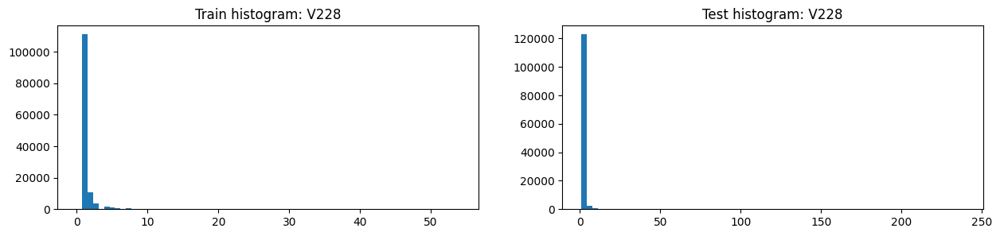

,V228,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.351928,2.653748,1.241579,1.649770,1.670787,1.646641
2,std,1.409722,3.594541,0.951216,6.244667,2.674737,6.613324
3,min,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,3.000000,1.000000,1.000000,1.000000,1.000000
7,max,54.000000,54.000000,29.000000,239.000000,49.000000,239.000000
8,unique values,56.000000,56.000000,31.000000,240.000000,50.000000,240.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V228,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,1.0,111066,0.048863,5427,106429.0
2,2.0,10750,0.176372,1896,10765.0
3,3.0,3625,0.259862,942,3754.0
4,4.0,1765,0.303683,536,1859.0
5,5.0,1027,0.332035,341,1049.0
6,6.0,625,0.356800,223,714.0
7,7.0,420,0.440476,185,442.0
8,8.0,288,0.468750,135,274.0
9,9.0,190,0.473684,90,209.0


,V228,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,111066,0.048863,5427,106429
2,2.0,10750,0.176372,1896,10765
3,3.0,3625,0.259862,942,3754
4,4.0,1765,0.303683,536,1859
5,5.0,1027,0.332035,341,1049
6,6.0,625,0.356800,223,714
7,7.0,420,0.440476,185,442
8,8.0,288,0.468750,135,274
9,9.0,190,0.473684,90,209


,Column,Correlation with V228
0,V228,1.000000
1,V176,0.886161
2,V246,0.824228
3,V230,0.792778
4,V190,0.733342
5,V257,0.728859
342,D3,-0.098696
343,D8,-0.129648
344,D7,-0.177693
345,D5,-0.191253


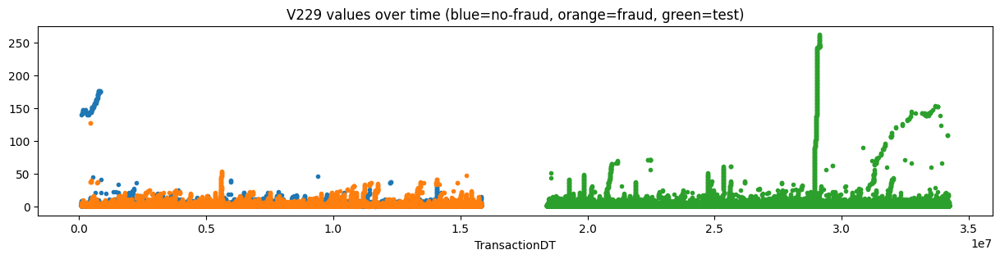

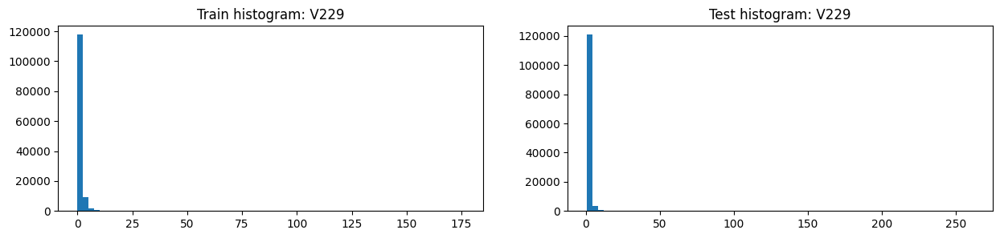

,V229,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.638710,3.672979,1.466275,2.061510,2.002192,2.070340
2,std,4.316026,5.426587,4.163011,8.781379,4.004504,9.284637
3,min,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,4.000000,1.000000,1.000000,2.000000,1.000000
7,max,176.000000,128.000000,176.000000,262.000000,70.000000,262.000000
8,unique values,92.000000,58.000000,79.000000,263.000000,71.000000,263.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V229,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,1.0,104007,0.042680,4439,99024.0
2,2.0,13775,0.136189,1876,14028.0
3,3.0,5042,0.214399,1081,5213.0
4,4.0,2521,0.259421,654,2580.0
5,5.0,1480,0.290541,430,1506.0
6,6.0,890,0.348315,310,955.0
7,7.0,635,0.395276,251,655.0
8,8.0,429,0.442890,190,408.0
9,9.0,290,0.444828,129,315.0


,V229,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,104007,0.042680,4439,99024
2,2.0,13775,0.136189,1876,14028
3,3.0,5042,0.214399,1081,5213
4,4.0,2521,0.259421,654,2580
5,5.0,1480,0.290541,430,1506
6,6.0,890,0.348315,310,955
7,7.0,635,0.395276,251,655
8,8.0,429,0.442890,190,408
9,9.0,290,0.444828,129,315


,Column,Correlation with V229
0,V229,1.000000
1,V243,0.908777
2,V253,0.901514
3,V254,0.881434
4,V248,0.879048
5,V230,0.878426
342,D8,-0.072719
343,D3,-0.105662
344,D2,-0.117357
345,D7,-0.159555


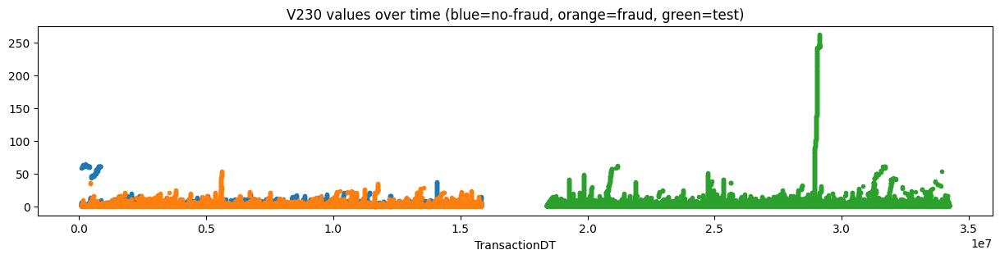

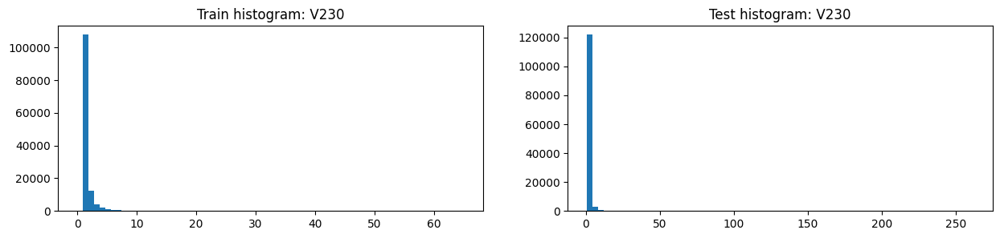

,V230,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.465476,3.155122,1.322253,1.878488,1.869435,1.879835
2,std,2.122783,4.257576,1.757632,8.129952,3.659087,8.598990
3,min,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,3.000000,1.000000,1.000000,1.000000,1.000000
7,max,65.000000,54.000000,65.000000,262.000000,63.000000,262.000000
8,unique values,67.000000,56.000000,61.000000,263.000000,64.000000,263.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V230,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,1.0,107849,0.044748,4826,102917.0
2,2.0,12241,0.157095,1923,12438.0
3,3.0,4206,0.240609,1012,4361.0
4,4.0,2078,0.290664,604,2133.0
5,5.0,1193,0.343671,410,1224.0
6,6.0,733,0.368349,270,819.0
7,7.0,493,0.436105,215,544.0
8,8.0,362,0.477901,173,348.0
9,9.0,240,0.470833,113,259.0


,V230,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,107849,0.044748,4826,102917
2,2.0,12241,0.157095,1923,12438
3,3.0,4206,0.240609,1012,4361
4,4.0,2078,0.290664,604,2133
5,5.0,1193,0.343671,410,1224
6,6.0,733,0.368349,270,819
7,7.0,493,0.436105,215,544
8,8.0,362,0.477901,173,348
9,9.0,240,0.470833,113,259


,Column,Correlation with V230
0,V230,1.000000
1,V229,0.878426
2,V258,0.857729
3,V243,0.827691
4,V228,0.792778
5,V176,0.728197
342,D3,-0.107963
343,D8,-0.114233
344,D7,-0.175495
345,D5,-0.185260


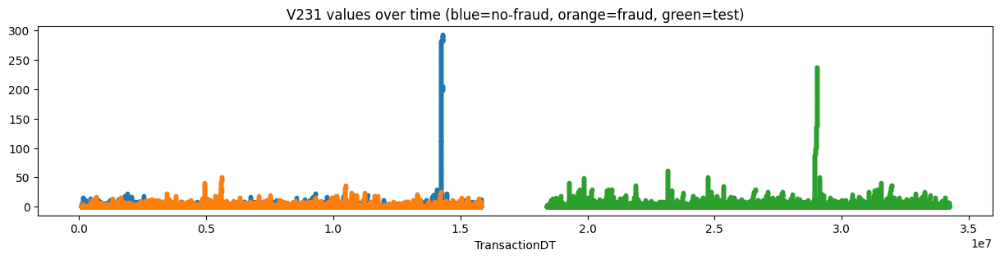

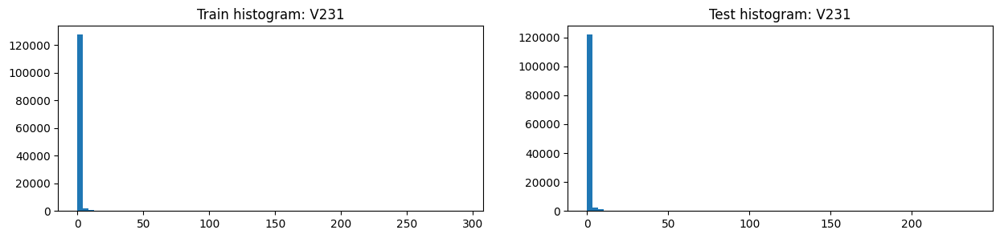

,V231,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,0.765506,2.024431,0.658793,0.719320,0.864929,0.697644
2,std,8.877119,4.267971,9.153875,6.400332,3.155708,6.751035
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000
7,max,293.000000,51.000000,293.000000,238.000000,49.000000,238.000000
8,unique values,295.000000,53.000000,295.000000,240.000000,51.000000,240.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V231,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,112885,0.047101,5317,109490.0
2,1.0,7478,0.227868,1704,6593.0
3,2.0,3785,0.235139,890,3655.0
4,3.0,2057,0.264949,545,2070.0
5,4.0,1198,0.310518,372,1252.0
6,5.0,691,0.395080,273,765.0
7,6.0,478,0.428870,205,520.0
8,7.0,358,0.458101,164,365.0
9,8.0,248,0.508065,126,275.0


,V231,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,112885,0.047101,5317,109490
2,1.0,7478,0.227868,1704,6593
3,2.0,3785,0.235139,890,3655
4,3.0,2057,0.264949,545,2070
5,4.0,1198,0.310518,372,1252
6,5.0,691,0.395080,273,765
7,6.0,478,0.428870,205,520
8,7.0,358,0.458101,164,365
9,8.0,248,0.508065,126,275


,Column,Correlation with V231
0,V231,1.000000
1,V217,0.995970
2,V233,0.991522
3,V232,0.983525
4,V219,0.974698
5,V177,0.962894
342,V57,-0.128418
343,D5,-0.166062
344,V20,-0.166647
345,V61,-0.170475


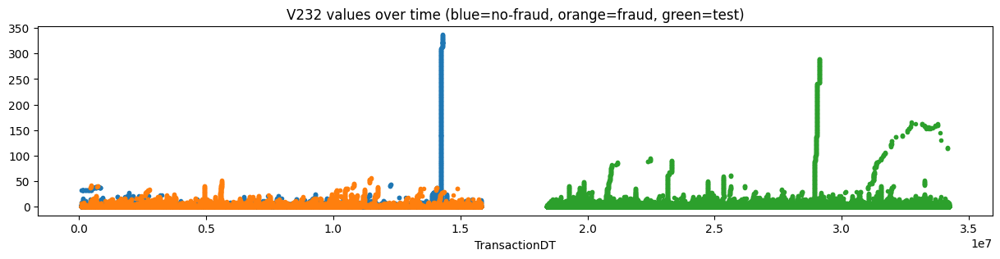

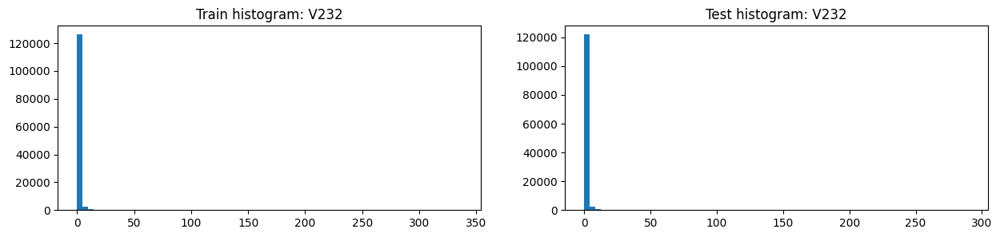

,V232,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.005597,2.967327,0.839310,1.080929,1.185433,1.065372
2,std,10.460253,5.975140,10.738334,9.335726,4.876866,9.827928
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,3.000000,0.000000,0.000000,0.000000,0.000000
7,max,337.000000,56.000000,337.000000,290.000000,87.000000,290.000000
8,unique values,339.000000,58.000000,339.000000,292.000000,89.000000,292.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V232,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,110617,0.043257,4785,107458.0
2,1.0,7593,0.209272,1589,6725.0
3,2.0,4087,0.221678,906,3903.0
4,3.0,2352,0.239796,564,2304.0
5,4.0,1479,0.290061,429,1466.0
6,5.0,896,0.348214,312,944.0
7,6.0,640,0.384375,246,661.0
8,7.0,474,0.426160,202,477.0
9,8.0,332,0.463855,154,376.0


,V232,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,110617,0.043257,4785,107458
2,1.0,7593,0.209272,1589,6725
3,2.0,4087,0.221678,906,3903
4,3.0,2352,0.239796,564,2304
5,4.0,1479,0.290061,429,1466
6,5.0,896,0.348214,312,944
7,6.0,640,0.384375,246,661
8,7.0,474,0.426160,202,477
9,8.0,332,0.463855,154,376


,Column,Correlation with V232
0,V232,1.000000
1,V233,0.994496
2,V219,0.990591
3,V217,0.983680
4,V231,0.983525
5,V179,0.955464
342,V57,-0.134316
343,D5,-0.155586
344,V20,-0.172798
345,V61,-0.178345


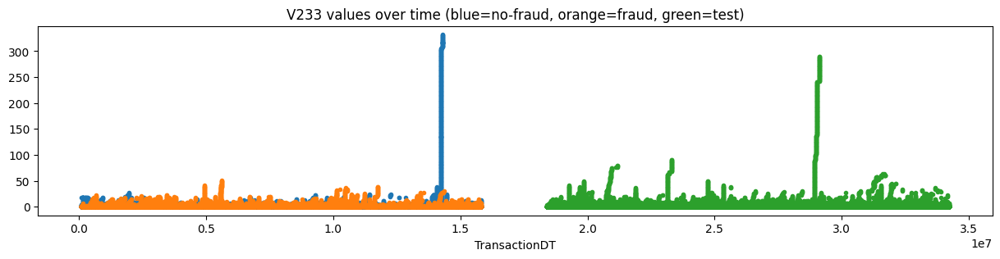

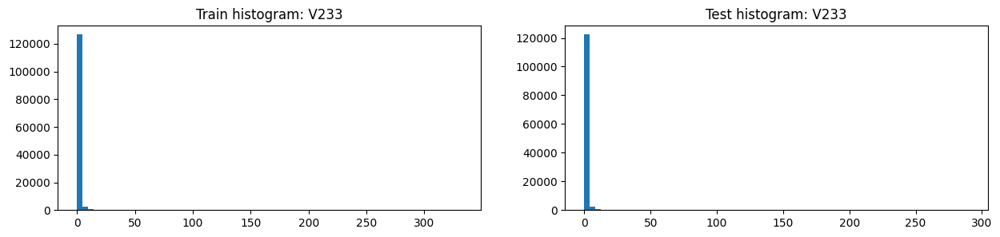

,V233,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,0.908388,2.519918,0.771786,0.944046,1.110955,0.919198
2,std,10.149884,5.047551,10.457271,8.592558,4.600746,9.037014
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,3.000000,0.000000,0.000000,0.000000,0.000000
7,max,332.000000,51.000000,332.000000,290.000000,80.000000,290.000000
8,unique values,334.000000,53.000000,334.000000,292.000000,82.000000,292.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V233,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,111756,0.044839,5011,108466.0
2,1.0,7439,0.218443,1625,6565.0
3,2.0,3940,0.228173,899,3749.0
4,3.0,2206,0.253853,560,2207.0
5,4.0,1350,0.297778,402,1382.0
6,5.0,800,0.365000,292,856.0
7,6.0,558,0.397849,222,585.0
8,7.0,451,0.427938,193,423.0
9,8.0,287,0.491289,141,328.0


,V233,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,111756,0.044839,5011,108466
2,1.0,7439,0.218443,1625,6565
3,2.0,3940,0.228173,899,3749
4,3.0,2206,0.253853,560,2207
5,4.0,1350,0.297778,402,1382
6,5.0,800,0.365000,292,856
7,6.0,558,0.397849,222,585
8,7.0,451,0.427938,193,423
9,8.0,287,0.491289,141,328


,Column,Correlation with V233
0,V233,1.000000
1,V232,0.994496
2,V231,0.991522
3,V217,0.989669
4,V219,0.988440
5,V179,0.960802
342,V57,-0.133680
343,D5,-0.162397
344,V20,-0.172346
345,V61,-0.177040


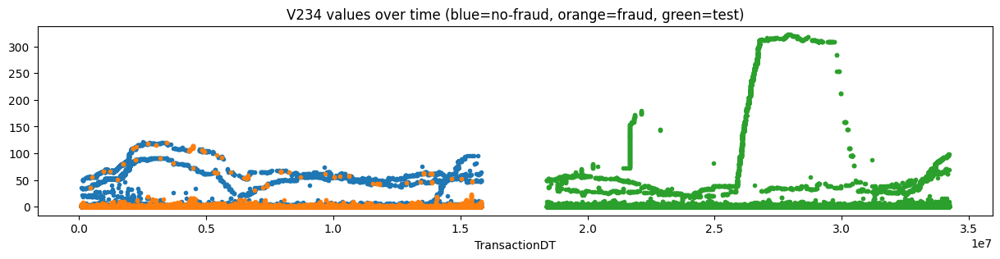

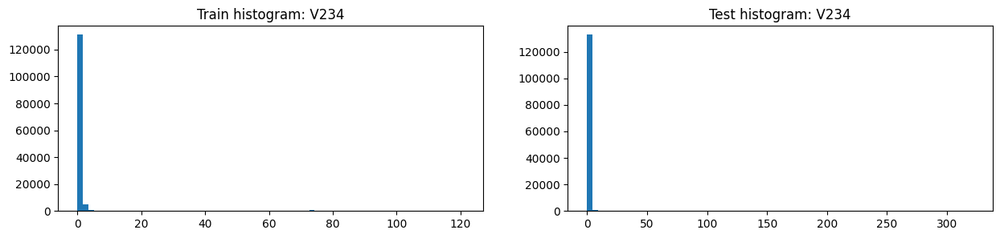

,V234,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,141416.000000,10982.000000,130434.000000,137316.000000,17734.000000,119582.000000
1,mean,2.092847,1.337461,2.156447,3.112951,1.823052,3.304243
2,std,11.323036,7.735587,11.572216,22.768146,10.782597,24.036255
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,121.000000,120.000000,121.000000,322.000000,158.000000,322.000000
8,unique values,123.000000,72.000000,122.000000,309.000000,151.000000,303.000000
9,NaNs,449124.000000,9681.000000,439443.000000,369375.000000,83605.000000,285771.000000


,V234,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,449124,0.021555,9681,369375
1,0.0,120416,0.064609,7780,115444
2,1.0,10620,0.152448,1619,11400
3,2.0,3670,0.203815,748,3937
4,3.0,1168,0.239726,280,1326
5,73.0,885,0.001130,1,28
6,4.0,612,0.254902,156,706
7,5.0,217,0.373272,81,304
8,6.0,210,0.328571,69,165
9,38.0,197,0.000000,0,77


,V234,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,449124,0.021555,9681,369375
1,0.0,120416,0.064609,7780,115444
2,1.0,10620,0.152448,1619,11400
3,2.0,3670,0.203815,748,3937
4,3.0,1168,0.239726,280,1326
5,4.0,612,0.254902,156,706
6,5.0,217,0.373272,81,304
7,6.0,210,0.328571,69,165
8,8.0,79,0.379747,30,62
9,7.0,79,0.367089,29,76


,Column,Correlation with V234
0,V234,1.000000
1,V236,0.980190
2,V237,0.922474
3,V218,0.891138
4,V180,0.843692
5,V219,0.821776
342,V33,-0.320624
343,V57,-0.325805
344,V20,-0.334160
345,V61,-0.356687


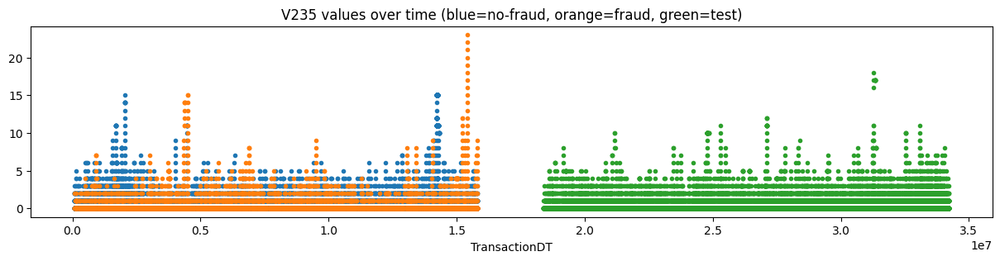

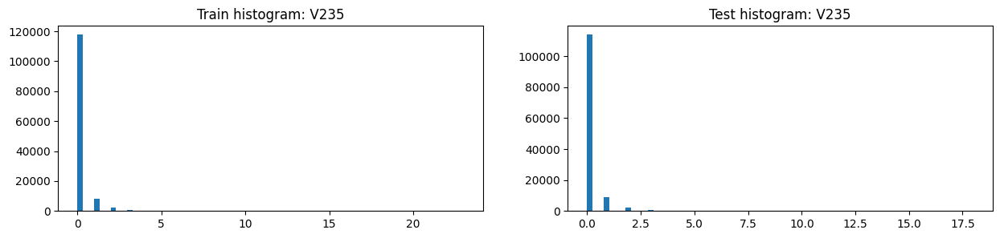

,V235,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,0.184106,0.420330,0.164083,0.156887,0.169417,0.155022
2,std,0.902639,1.237212,0.865420,0.610037,0.600278,0.611457
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,23.000000,23.000000,15.000000,18.000000,10.000000,18.000000
8,unique values,25.000000,25.000000,17.000000,17.000000,12.000000,17.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V235,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,117724,0.067854,7988,114010.0
2,1.0,8389,0.154726,1298,8769.0
3,2.0,2431,0.206499,502,2393.0
4,3.0,865,0.217341,188,884.0
5,4.0,362,0.245856,89,333.0
6,15.0,175,0.017143,3,NaN
7,5.0,128,0.296875,38,156.0
8,11.0,97,0.051546,5,13.0
9,6.0,70,0.257143,18,53.0


,V235,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,117724,0.067854,7988,114010
2,1.0,8389,0.154726,1298,8769
3,2.0,2431,0.206499,502,2393
4,3.0,865,0.217341,188,884
5,4.0,362,0.245856,89,333
6,5.0,128,0.296875,38,156
7,6.0,70,0.257143,18,53
8,7.0,36,0.472222,17,30
9,8.0,31,0.419355,13,25


,Column,Correlation with V235
0,V235,1.000000
1,V181,0.946890
2,V237,0.908747
3,V183,0.890540
4,V328,0.884511
5,V182,0.846474
342,V57,-0.155843
343,V33,-0.156660
344,V20,-0.179462
345,V61,-0.192420


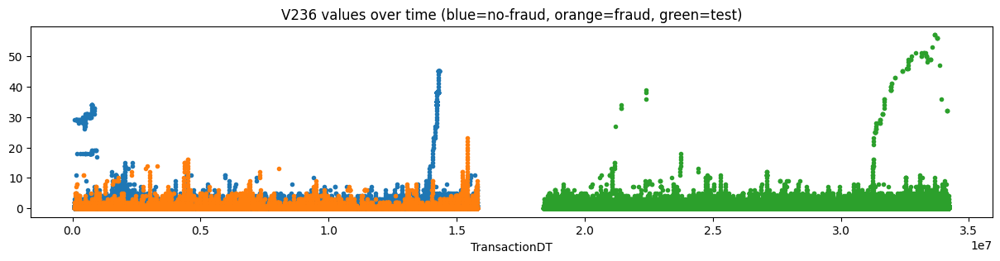

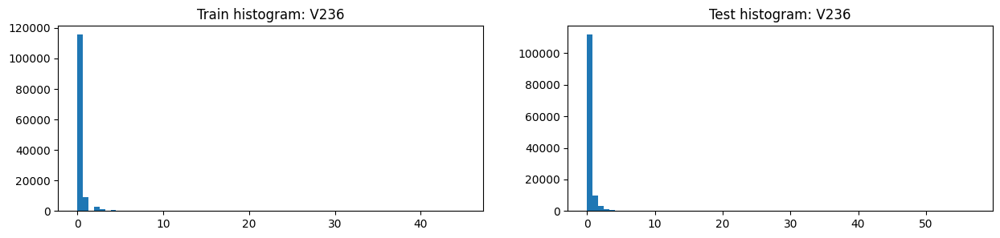

,V236,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,0.307667,0.603218,0.282614,0.226351,0.222581,0.226912
2,std,2.152332,1.502342,2.196789,1.346758,0.910738,1.400106
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,45.000000,23.000000,45.000000,57.000000,34.000000,57.000000
8,unique values,47.000000,25.000000,47.000000,49.000000,20.000000,49.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V236,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,115566,0.063842,7378,111713.0
2,1.0,9302,0.158246,1472,9820.0
3,2.0,2927,0.225487,660,2996.0
4,3.0,1111,0.257426,286,1081.0
5,4.0,468,0.311966,146,447.0
6,5.0,204,0.397059,81,246.0
7,38.0,182,0.000000,0,1.0
8,6.0,133,0.413534,55,102.0
9,7.0,81,0.345679,28,68.0


,V236,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,115566,0.063842,7378,111713
2,1.0,9302,0.158246,1472,9820
3,2.0,2927,0.225487,660,2996
4,3.0,1111,0.257426,286,1081
5,4.0,468,0.311966,146,447
6,5.0,204,0.397059,81,246
7,6.0,133,0.413534,55,102
8,7.0,81,0.345679,28,68
9,8.0,54,0.370370,20,39


,Column,Correlation with V236
0,V236,1.000000
1,V234,0.980190
2,V237,0.963245
3,V183,0.913374
4,V182,0.912737
5,V218,0.904253
342,V15,-0.176676
343,V33,-0.179173
344,V20,-0.215362
345,V61,-0.218910


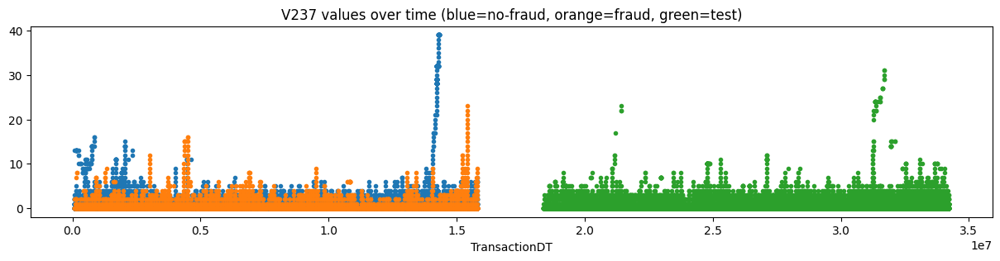

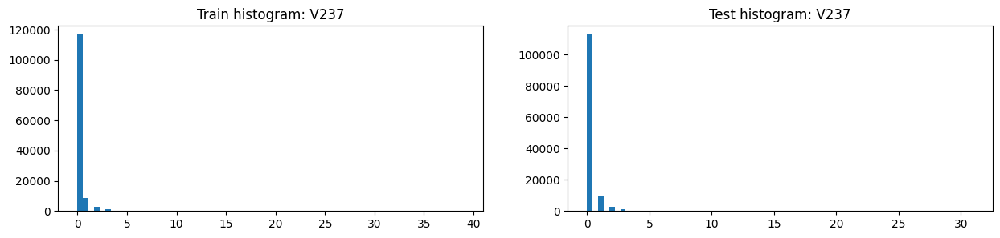

,V237,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,0.253500,0.505396,0.232148,0.183630,0.192315,0.182337
2,std,1.716634,1.360593,1.741805,0.780026,0.735421,0.786444
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,39.000000,23.000000,39.000000,31.000000,23.000000,31.000000
8,unique values,41.000000,25.000000,41.000000,28.000000,17.000000,27.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V237,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,116709,0.065813,7681,112917.0
2,1.0,8789,0.159290,1400,9201.0
3,2.0,2693,0.213888,576,2721.0
4,3.0,999,0.247247,247,976.0
5,4.0,394,0.261421,103,398.0
6,32.0,182,0.000000,0,NaN
7,5.0,167,0.365269,61,228.0
8,6.0,96,0.375000,36,75.0
9,28.0,59,0.000000,0,NaN


,V237,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,116709,0.065813,7681,112917
2,1.0,8789,0.159290,1400,9201
3,2.0,2693,0.213888,576,2721
4,3.0,999,0.247247,247,976
5,4.0,394,0.261421,103,398
6,5.0,167,0.365269,61,228
7,6.0,96,0.375000,36,75
8,7.0,43,0.511628,22,49
9,8.0,42,0.428571,18,23


,Column,Correlation with V237
0,V237,1.000000
1,V236,0.963245
2,V183,0.945907
3,V234,0.922474
4,V182,0.914108
5,V330,0.911130
342,V62,-0.167738
343,V57,-0.170939
344,V20,-0.201955
345,V61,-0.214002


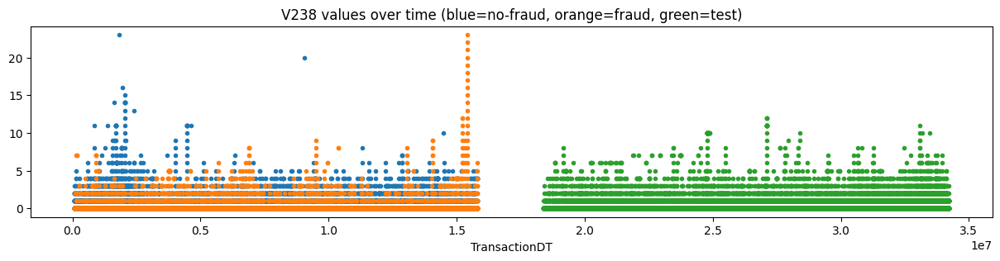

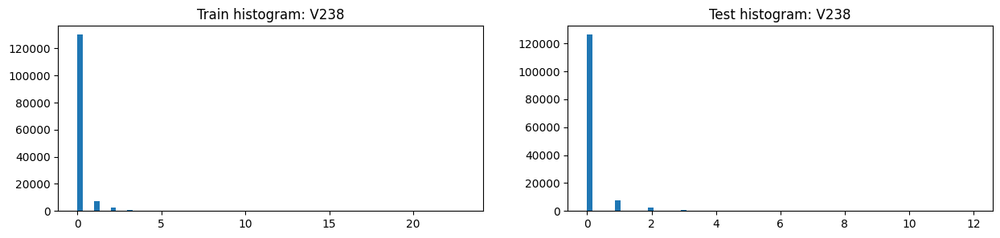

,V238,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,141416.000000,10982.000000,130434.000000,137316.000000,17734.000000,119582.000000
1,mean,0.127956,0.360681,0.108361,0.127319,0.126424,0.127452
2,std,0.574657,1.086645,0.503668,0.541831,0.531560,0.543340
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,23.000000,23.000000,23.000000,12.000000,8.000000,12.000000
8,unique values,25.000000,25.000000,20.000000,14.000000,10.000000,14.000000
9,NaNs,449124.000000,9681.000000,439443.000000,369375.000000,83605.000000,285771.000000


,V238,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,449124,0.021555,9681,369375.0
1,0.0,130158,0.068317,8892,126234.0
2,1.0,7471,0.158479,1184,7457.0
3,2.0,2368,0.219595,520,2251.0
4,3.0,796,0.257538,205,763.0
5,4.0,328,0.225610,74,293.0
6,5.0,110,0.372727,41,144.0
7,6.0,59,0.254237,15,63.0
8,7.0,30,0.500000,15,39.0
9,8.0,28,0.428571,12,19.0


,V238,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,449124,0.021555,9681,369375
1,0.0,130158,0.068317,8892,126234
2,1.0,7471,0.158479,1184,7457
3,2.0,2368,0.219595,520,2251
4,3.0,796,0.257538,205,763
5,4.0,328,0.225610,74,293
6,5.0,110,0.372727,41,144
7,6.0,59,0.254237,15,63
8,7.0,30,0.500000,15,39
9,8.0,28,0.428571,12,19


,Column,Correlation with V238
0,V238,1.000000
1,V239,0.946169
2,V184,0.744011
3,V146,0.656216
4,V185,0.634379
5,V147,0.614442
342,D3,-0.064261
343,D8,-0.072741
344,D14,-0.093980
345,D7,-0.119542


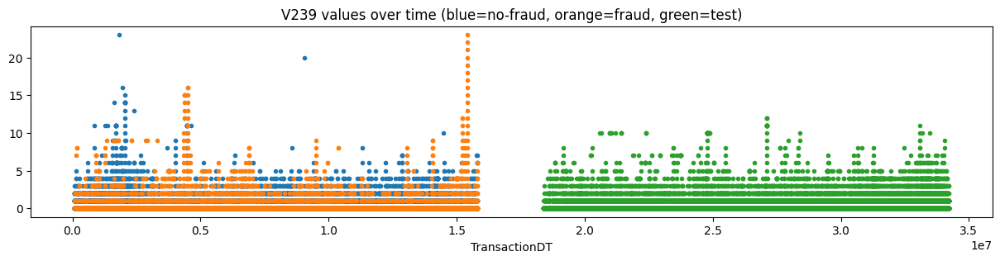

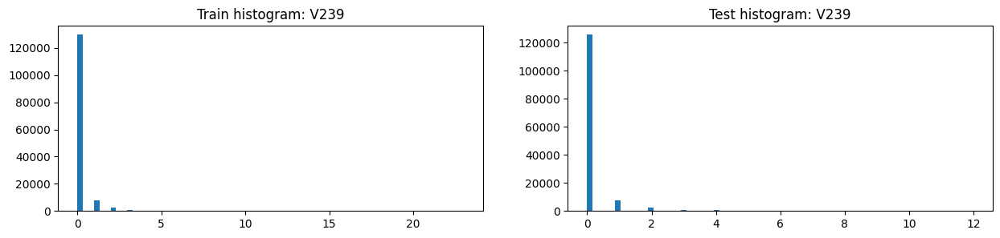

,V239,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,141416.000000,10982.000000,130434.000000,137316.000000,17734.000000,119582.000000
1,mean,0.136965,0.437261,0.111681,0.137275,0.135446,0.137546
2,std,0.616260,1.293764,0.512448,0.578917,0.591327,0.577056
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,23.000000,23.000000,23.000000,12.000000,10.000000,12.000000
8,unique values,25.000000,25.000000,20.000000,14.000000,11.000000,14.000000
9,NaNs,449124.000000,9681.000000,439443.000000,369375.000000,83605.000000,285771.000000


,V239,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,449124,0.021555,9681,369375.0
1,0.0,129713,0.066824,8668,125810.0
2,1.0,7645,0.163506,1250,7564.0
3,2.0,2483,0.233588,580,2315.0
4,3.0,863,0.265353,229,795.0
5,4.0,349,0.257880,90,461.0
6,5.0,125,0.432000,54,167.0
7,6.0,69,0.289855,20,70.0
8,7.0,34,0.529412,18,45.0
9,8.0,34,0.500000,17,21.0


,V239,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,449124,0.021555,9681,369375
1,0.0,129713,0.066824,8668,125810
2,1.0,7645,0.163506,1250,7564
3,2.0,2483,0.233588,580,2315
4,3.0,863,0.265353,229,795
5,4.0,349,0.257880,90,461
6,5.0,125,0.432000,54,167
7,9.0,29,0.724138,21,7
8,6.0,69,0.289855,20,70
9,7.0,34,0.529412,18,45


,Column,Correlation with V239
0,V239,1.000000
1,V238,0.946169
2,V184,0.710068
3,V185,0.656210
4,V147,0.632425
5,V146,0.620958
342,D3,-0.067270
343,D8,-0.070791
344,D14,-0.095744
345,D7,-0.122935


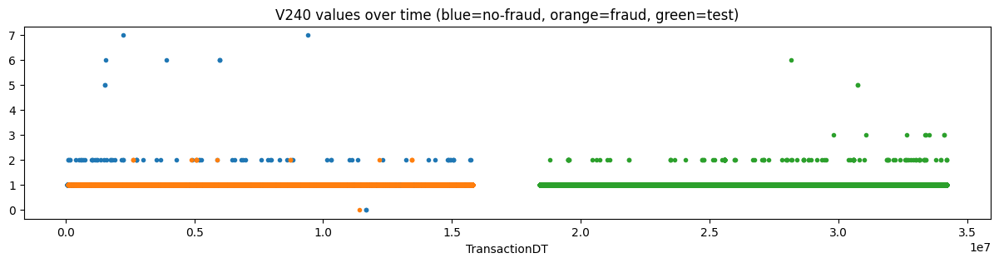

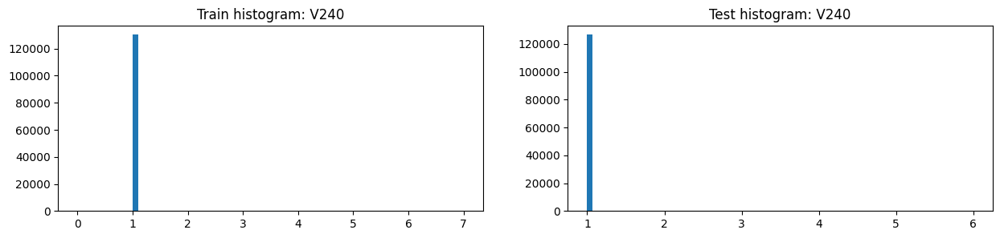

,V240,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.000997,1.001472,1.000956,1.001160,1.000853,1.001206
2,std,0.049522,0.040816,0.050191,0.040399,0.029187,0.041812
3,min,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,7.000000,2.000000,7.000000,6.000000,2.000000,6.000000
8,unique values,7.000000,4.000000,7.000000,6.000000,3.000000,6.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V240,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,1.0,130330,0.078071,10175,126599.0
2,2.0,88,0.181818,16,118.0
3,6.0,5,0.000000,0,1.0
4,0.0,3,0.333333,1,NaN
5,5.0,2,0.000000,0,2.0
6,7.0,2,0.000000,0,NaN


,V240,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,1.0,130330,0.078071,10175,126599.0
2,2.0,88,0.181818,16,118.0
3,0.0,3,0.333333,1,NaN
4,6.0,5,0.000000,0,1.0
5,5.0,2,0.000000,0,2.0
6,7.0,2,0.000000,0,NaN


,Column,Correlation with V240
0,V240,1.000000
1,V241,0.744394
2,V261,0.097821
3,V253,0.062609
4,V224,0.060865
5,V229,0.059365
342,V256,-0.021201
343,V255,-0.023468
344,addr2,-0.027187
345,V251,-0.030195


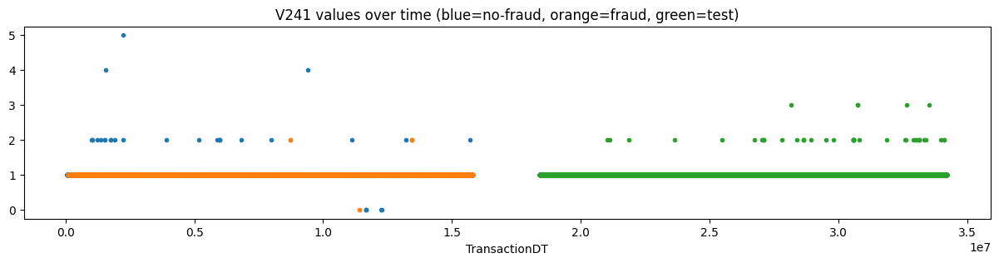

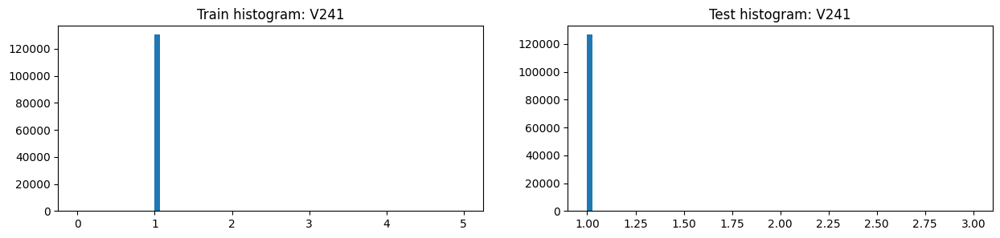

,V241,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.000238,1.000392,1.000225,1.000402,1.000122,1.000444
2,std,0.022663,0.024261,0.022523,0.021936,0.011036,0.023123
3,min,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,5.000000,2.000000,5.000000,3.000000,2.000000,3.000000
8,unique values,6.000000,4.000000,6.000000,4.000000,3.000000,4.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V241,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,1.0,130394,0.078117,10186,126682.0
2,2.0,27,0.185185,5,41.0
3,0.0,6,0.166667,1,NaN
4,4.0,2,0.000000,0,NaN
5,5.0,1,0.000000,0,NaN


,V241,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,1.0,130394,0.078117,10186,126682.0
2,2.0,27,0.185185,5,41.0
3,0.0,6,0.166667,1,NaN
4,4.0,2,0.000000,0,NaN
5,5.0,1,0.000000,0,NaN


,Column,Correlation with V241
0,V241,1.000000
1,V240,0.744394
2,V261,0.074826
3,V224,0.049494
4,V253,0.049442
5,V262,0.047916
342,V245,-0.010860
343,V256,-0.012332
344,V255,-0.014645
345,V251,-0.017124


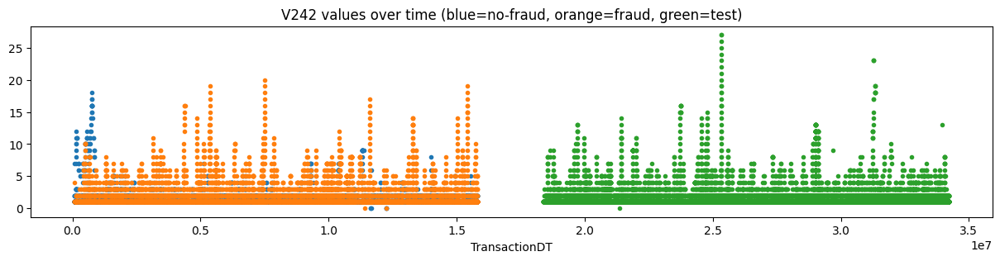

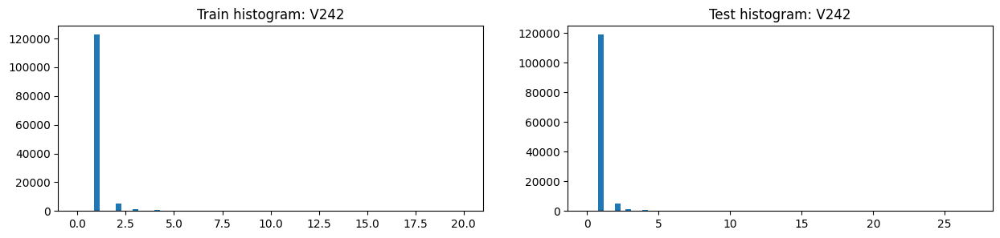

,V242,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.113463,1.931024,1.044162,1.115050,1.171914,1.106584
2,std,0.660110,1.854551,0.345990,0.694536,0.736457,0.687678
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,20.000000,20.000000,18.000000,27.000000,14.000000,27.000000
8,unique values,22.000000,22.000000,20.000000,29.000000,16.000000,28.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V242,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,122640,0.051729,6344,119011
2,2.0,5218,0.350709,1830,5274
3,3.0,1164,0.699313,814,1144
4,4.0,480,0.895833,430,480
5,5.0,281,0.886121,249,270
6,6.0,195,0.871795,170,144
7,7.0,150,0.873333,131,85
8,8.0,89,0.876404,78,69
9,9.0,60,0.666667,40,65


,V242,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,122640,0.051729,6344,119011
2,2.0,5218,0.350709,1830,5274
3,3.0,1164,0.699313,814,1144
4,4.0,480,0.895833,430,480
5,5.0,281,0.886121,249,270
6,6.0,195,0.871795,170,144
7,7.0,150,0.873333,131,85
8,8.0,89,0.876404,78,69
9,9.0,60,0.666667,40,65


,Column,Correlation with V242
0,V242,1.000000
1,V244,0.974318
2,V186,0.838799
3,V246,0.826648
4,V257,0.753764
5,V243,0.727503
342,D10,-0.046012
343,D2,-0.053901
344,D8,-0.085007
345,D7,-0.110176


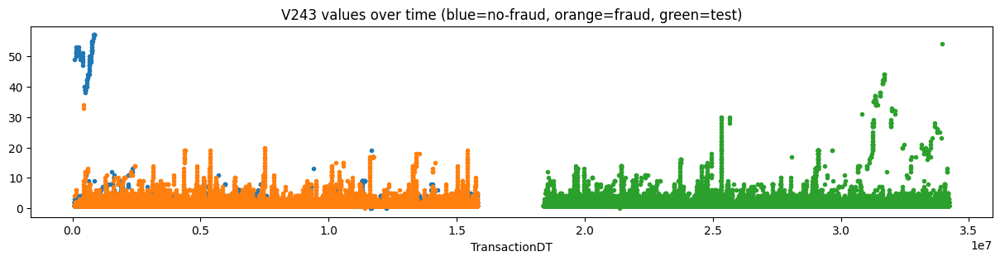

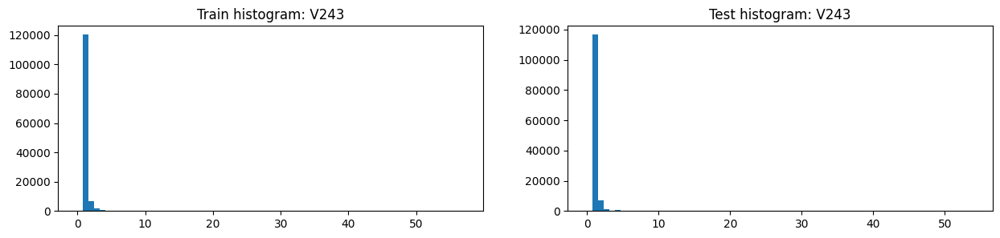

,V243,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.178387,2.188579,1.092758,1.181278,1.243408,1.172029
2,std,1.398953,2.292076,1.258508,1.190253,0.961757,1.220350
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,57.000000,34.000000,57.000000,54.000000,14.000000,54.000000
8,unique values,44.000000,24.000000,36.000000,45.000000,16.000000,44.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V243,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,1.0,120245,0.048376,5817,116549.0
2,2.0,6719,0.285757,1920,6782.0
3,3.0,1536,0.608073,934,1470.0
4,4.0,669,0.766816,513,646.0
5,5.0,351,0.846154,297,354.0
6,6.0,235,0.817021,192,227.0
7,7.0,168,0.892857,150,142.0
8,8.0,124,0.870968,108,79.0
9,9.0,80,0.737500,59,73.0


,V243,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,120245,0.048376,5817,116549
2,2.0,6719,0.285757,1920,6782
3,3.0,1536,0.608073,934,1470
4,4.0,669,0.766816,513,646
5,5.0,351,0.846154,297,354
6,6.0,235,0.817021,192,227
7,7.0,168,0.892857,150,142
8,8.0,124,0.870968,108,79
9,9.0,80,0.737500,59,73


,Column,Correlation with V243
0,V243,1.000000
1,V229,0.908777
2,V258,0.883010
3,V254,0.873915
4,V253,0.853655
5,V248,0.852932
342,D13,-0.036853
343,V21,-0.038280
344,D8,-0.057917
345,D7,-0.101693


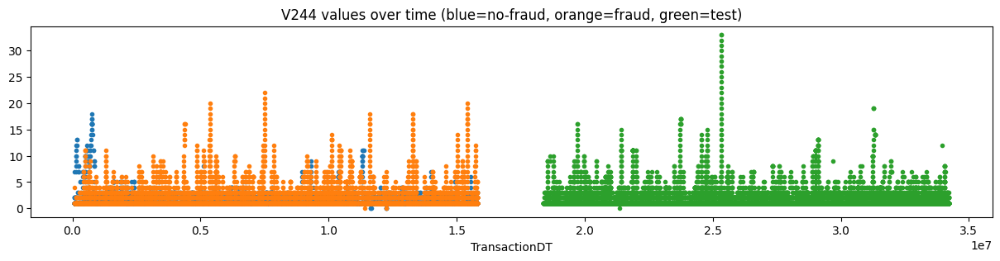

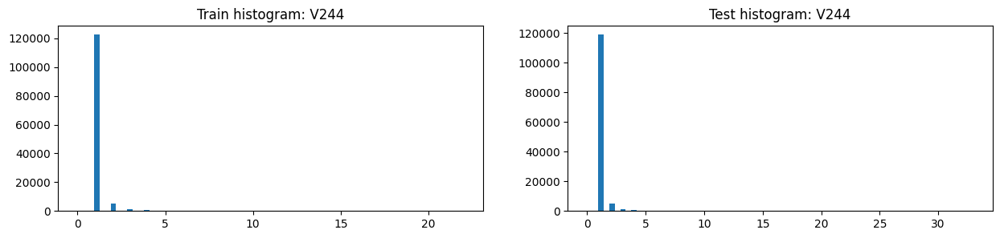

,V244,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.118562,1.992543,1.044478,1.119082,1.192254,1.108189
2,std,0.698807,1.987337,0.353183,0.719554,0.804148,0.705450
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,22.000000,22.000000,18.000000,33.000000,16.000000,33.000000
8,unique values,24.000000,24.000000,20.000000,35.000000,18.000000,34.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V244,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,122583,0.051035,6256,118930
2,2.0,5139,0.350846,1803,5161
3,3.0,1223,0.706460,864,1240
4,4.0,481,0.885655,426,525
5,5.0,305,0.878689,268,298
6,6.0,219,0.890411,195,158
7,7.0,146,0.883562,129,99
8,8.0,74,0.797297,59,60
9,9.0,66,0.833333,55,40


,V244,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,122583,0.051035,6256,118930
2,2.0,5139,0.350846,1803,5161
3,3.0,1223,0.706460,864,1240
4,4.0,481,0.885655,426,525
5,5.0,305,0.878689,268,298
6,6.0,219,0.890411,195,158
7,7.0,146,0.883562,129,99
8,8.0,74,0.797297,59,60
9,9.0,66,0.833333,55,40


,Column,Correlation with V244
0,V244,1.000000
1,V242,0.974318
2,V246,0.829339
3,V186,0.817615
4,V257,0.757727
5,V258,0.710709
342,D10,-0.049132
343,D2,-0.063220
344,D8,-0.086379
345,D7,-0.113193


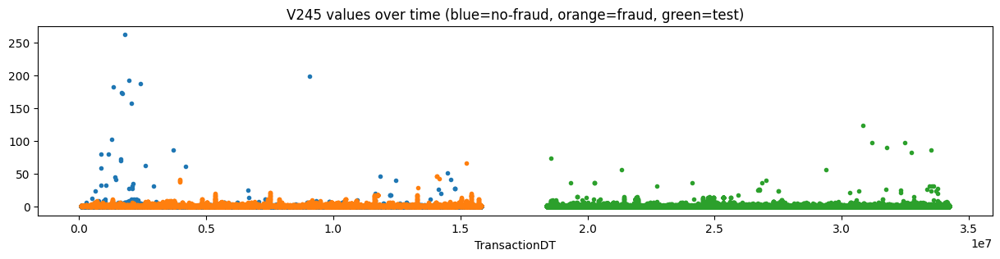

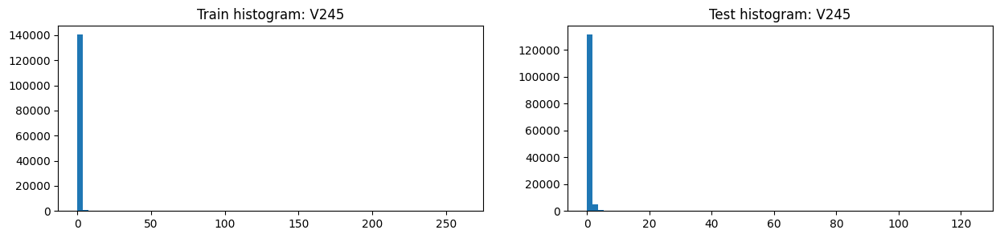

,V245,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,141416.000000,10982.000000,130434.000000,137316.000000,17734.000000,119582.000000
1,mean,0.876619,1.449736,0.828365,0.830253,0.837036,0.829247
2,std,1.821065,2.369050,1.758696,1.067050,1.185331,1.048375
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,262.000000,67.000000,262.000000,124.000000,74.000000,124.000000
8,unique values,59.000000,33.000000,47.000000,38.000000,21.000000,37.000000
9,NaNs,449124.000000,9681.000000,439443.000000,369375.000000,83605.000000,285771.000000


,V245,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,449124,0.021555,9681,369375.0
1,1.0,102995,0.048779,5024,96484.0
2,0.0,32341,0.093998,3040,34967.0
3,2.0,4036,0.334737,1351,3982.0
4,3.0,971,0.715757,695,1088.0
5,4.0,347,0.824207,286,288.0
6,5.0,203,0.837438,170,186.0
7,6.0,134,0.873134,117,76.0
8,7.0,116,0.810345,94,36.0
9,8.0,49,0.816327,40,31.0


,V245,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,449124,0.021555,9681,369375
1,1.0,102995,0.048779,5024,96484
2,0.0,32341,0.093998,3040,34967
3,2.0,4036,0.334737,1351,3982
4,3.0,971,0.715757,695,1088
5,4.0,347,0.824207,286,288
6,5.0,203,0.837438,170,186
7,6.0,134,0.873134,117,76
8,7.0,116,0.810345,94,36
9,9.0,47,0.893617,42,18


,Column,Correlation with V245
0,V245,1.000000
1,V259,0.943832
2,V227,0.901069
3,V255,0.892076
4,V256,0.875776
5,V221,0.872754
342,D6,-0.083511
343,D5,-0.089305
344,D10,-0.089735
345,D2,-0.118948


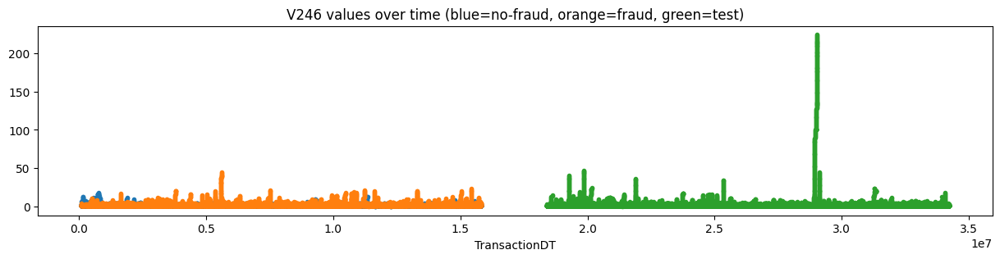

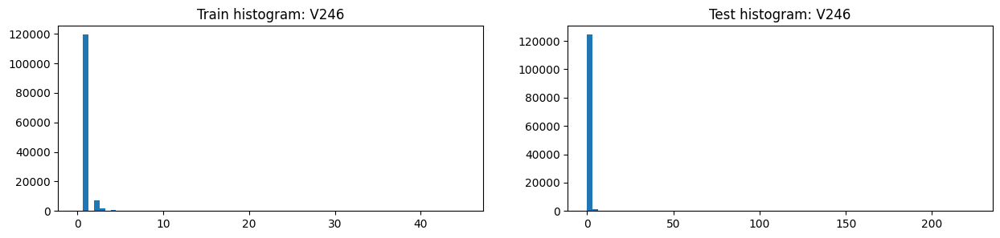

,V246,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.183723,2.494702,1.072598,1.414384,1.457585,1.407952
2,std,1.040363,3.138070,0.425933,5.773307,2.315700,6.123269
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,3.000000,1.000000,1.000000,1.000000,1.000000
7,max,45.000000,45.000000,18.000000,224.000000,47.000000,224.000000
8,unique values,47.000000,47.000000,20.000000,226.000000,49.000000,225.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V246,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,119374,0.046392,5538,115434
2,2.0,7258,0.263709,1914,7212
3,3.0,1562,0.580666,907,1693
4,4.0,691,0.777135,537,711
5,5.0,417,0.808153,337,399
6,6.0,299,0.849498,254,272
7,7.0,212,0.900943,191,149
8,8.0,123,0.804878,99,100
9,9.0,95,0.852632,81,108


,V246,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,119374,0.046392,5538,115434
2,2.0,7258,0.263709,1914,7212
3,3.0,1562,0.580666,907,1693
4,4.0,691,0.777135,537,711
5,5.0,417,0.808153,337,399
6,6.0,299,0.849498,254,272
7,7.0,212,0.900943,191,149
8,8.0,123,0.804878,99,100
9,9.0,95,0.852632,81,108


,Column,Correlation with V246
0,V246,1.000000
1,V257,0.905762
2,V190,0.886028
3,V244,0.829339
4,V242,0.826648
5,V228,0.824228
342,D10,-0.048243
343,D2,-0.071863
344,D8,-0.088642
345,D7,-0.115934


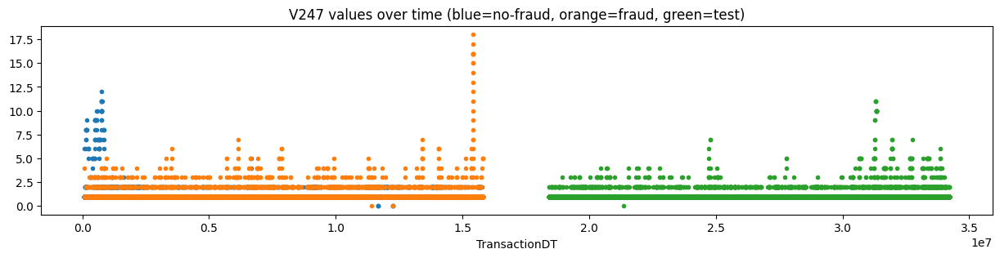

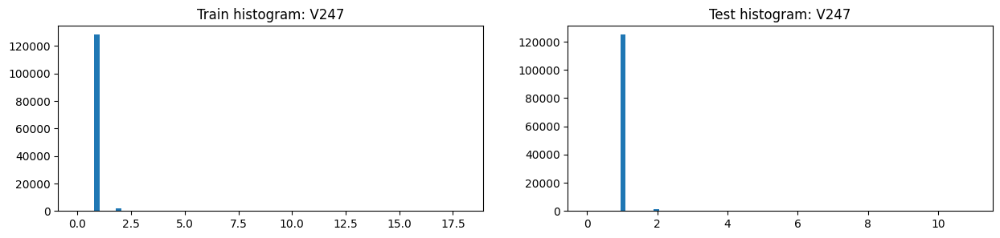

,V247,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.00000,16421.00000,110307.000000
1,mean,1.025355,1.199176,1.010621,1.01777,1.01900,1.017587
2,std,0.281604,0.740734,0.191675,0.19077,0.15294,0.195777
3,min,0.000000,0.000000,0.000000,0.00000,0.00000,1.000000
4,25%,1.000000,1.000000,1.000000,1.00000,1.00000,1.000000
5,50%,1.000000,1.000000,1.000000,1.00000,1.00000,1.000000
6,75%,1.000000,1.000000,1.000000,1.00000,1.00000,1.000000
7,max,18.000000,18.000000,12.000000,11.00000,4.00000,11.000000
8,unique values,20.000000,20.000000,14.000000,12.00000,6.00000,11.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.00000,84918.00000,295046.000000


,V247,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,1.0,128180,0.068568,8789,125002.0
2,2.0,1860,0.595699,1108,1478.0
3,3.0,186,0.935484,174,123.0
4,4.0,64,0.953125,61,56.0
5,5.0,36,0.750000,27,39.0
6,6.0,23,0.478261,11,9.0
7,7.0,20,0.200000,4,7.0
8,8.0,13,0.076923,1,NaN
9,9.0,11,0.090909,1,2.0


,V247,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,1.0,128180,0.068568,8789,125002.0
2,2.0,1860,0.595699,1108,1478.0
3,3.0,186,0.935484,174,123.0
4,4.0,64,0.953125,61,56.0
5,5.0,36,0.750000,27,39.0
6,6.0,23,0.478261,11,9.0
7,16.0,5,1.000000,5,NaN
8,7.0,20,0.200000,4,7.0
9,15.0,2,1.000000,2,NaN


,Column,Correlation with V247
0,V247,1.000000
1,V252,0.849959
2,V249,0.843090
3,V191,0.830133
4,V193,0.740302
5,V248,0.740254
342,V150,-0.025356
343,V63,-0.040092
344,V21,-0.040391
345,D5,-0.058378


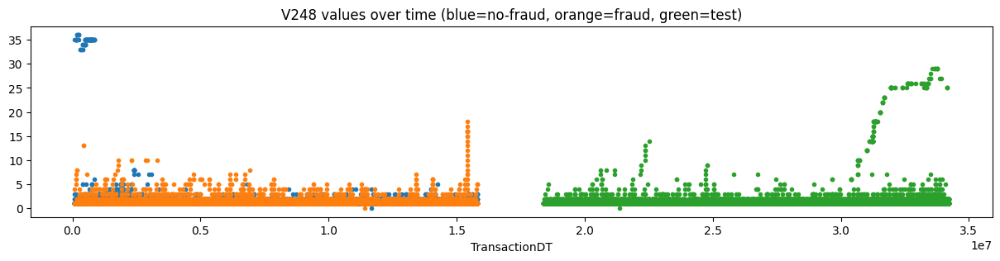

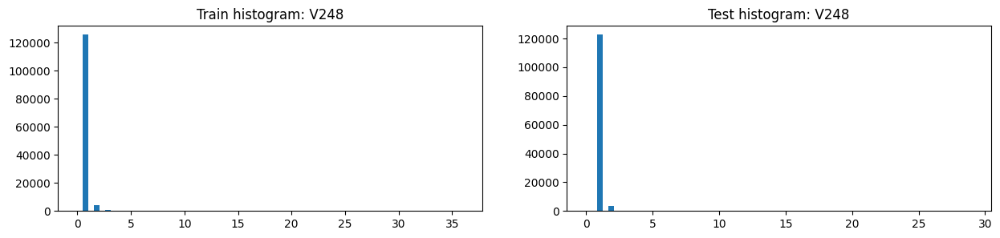

,V248,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.069493,1.309066,1.049186,1.058227,1.047561,1.059815
2,std,0.888341,0.917264,0.882866,0.710979,0.273233,0.754725
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,36.000000,18.000000,36.000000,29.000000,8.000000,29.000000
8,unique values,24.000000,20.000000,14.000000,28.000000,10.000000,27.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V248,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,1.0,125554,0.065279,8196,122660.0
2,2.0,3956,0.372599,1474,3520.0
3,3.0,499,0.533066,266,247.0
4,4.0,180,0.722222,130,81.0
5,5.0,77,0.714286,55,33.0
6,35.0,58,0.000000,0,NaN
7,6.0,32,0.968750,31,20.0
8,7.0,14,0.714286,10,12.0
9,8.0,14,0.357143,5,5.0


,V248,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,125554,0.065279,8196,122660
2,2.0,3956,0.372599,1474,3520
3,3.0,499,0.533066,266,247
4,4.0,180,0.722222,130,81
5,5.0,77,0.714286,55,33
6,6.0,32,0.968750,31,20
7,7.0,14,0.714286,10,12
8,10.0,7,1.000000,7,7
9,16.0,5,1.000000,5,3


,Column,Correlation with V248
0,V248,1.000000
1,V249,0.963351
2,V253,0.955888
3,V254,0.954492
4,V229,0.879048
5,V243,0.852932
342,V304,-0.032373
343,D7,-0.033871
344,V63,-0.039577
345,V302,-0.043152


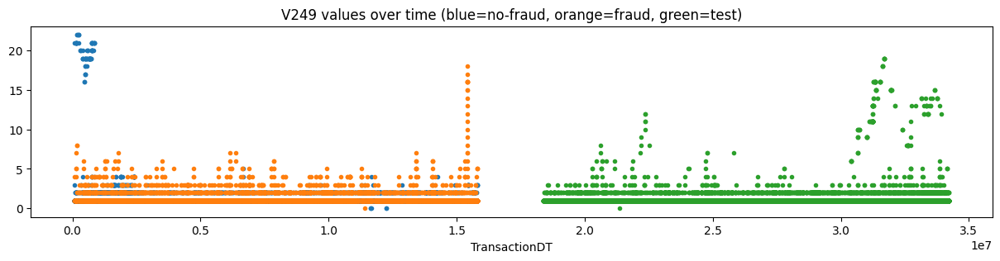

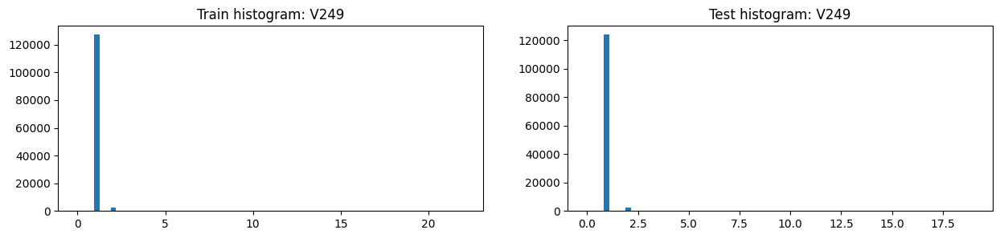

,V249,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.042851,1.249706,1.025316,1.036851,1.029353,1.037967
2,std,0.528812,0.807767,0.494074,0.447183,0.221809,0.471602
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,22.000000,18.000000,22.000000,19.000000,8.000000,19.000000
8,unique values,24.000000,20.000000,14.000000,20.000000,10.000000,19.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V249,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,1.0,127197,0.066770,8493,123994.0
2,2.0,2631,0.489548,1288,2372.0
3,3.0,314,0.745223,234,134.0
4,4.0,121,0.776860,94,38.0
5,5.0,40,0.975000,39,22.0
6,19.0,29,0.000000,0,5.0
7,21.0,21,0.000000,0,NaN
8,6.0,18,1.000000,18,13.0
9,20.0,15,0.000000,0,NaN


,V249,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,127197,0.066770,8493,123994
2,2.0,2631,0.489548,1288,2372
3,3.0,314,0.745223,234,134
4,4.0,121,0.776860,94,38
5,5.0,40,0.975000,39,22
6,6.0,18,1.000000,18,13
7,7.0,7,1.000000,7,8
8,16.0,7,0.714286,5,16
9,8.0,3,1.000000,3,11


,Column,Correlation with V249
0,V249,1.000000
1,V248,0.963351
2,V254,0.933000
3,V253,0.897530
4,V243,0.846675
5,V247,0.843090
342,D5,-0.040508
343,V302,-0.041244
344,V63,-0.042400
345,D7,-0.047029


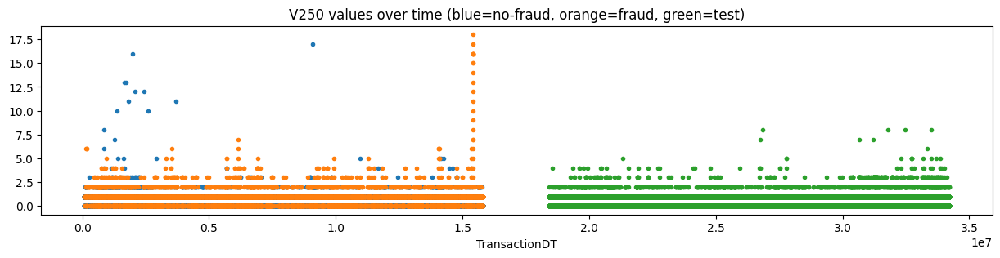

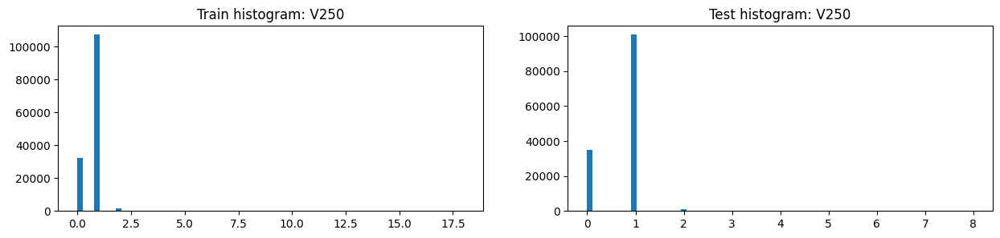

,V250,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,141416.000000,10982.000000,130434.000000,137316.000000,17734.000000,119582.000000
1,mean,0.788588,0.864688,0.782181,0.758746,0.728826,0.763183
2,std,0.488386,0.859225,0.442629,0.467194,0.500545,0.461880
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,18.000000,18.000000,17.000000,8.000000,5.000000,8.000000
8,unique values,20.000000,20.000000,16.000000,10.000000,7.000000,10.000000
9,NaNs,449124.000000,9681.000000,439443.000000,369375.000000,83605.000000,285771.000000


,V250,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,449124,0.021555,9681,369375.0
1,1.0,107386,0.064710,6949,100920.0
2,0.0,32341,0.093998,3040,34967.0
3,2.0,1365,0.538462,735,1115.0
4,3.0,196,0.806122,158,257.0
5,4.0,65,0.861538,56,37.0
6,5.0,20,0.700000,14,12.0
7,6.0,12,0.916667,11,1.0
8,16.0,6,0.833333,5,NaN
9,7.0,4,0.750000,3,3.0


,V250,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,449124,0.021555,9681,369375.0
1,1.0,107386,0.064710,6949,100920.0
2,0.0,32341,0.093998,3040,34967.0
3,2.0,1365,0.538462,735,1115.0
4,3.0,196,0.806122,158,257.0
5,4.0,65,0.861538,56,37.0
6,5.0,20,0.700000,14,12.0
7,6.0,12,0.916667,11,1.0
8,16.0,6,0.833333,5,NaN
9,7.0,4,0.750000,3,3.0


,Column,Correlation with V250
0,V250,1.000000
1,V251,0.983995
2,V255,0.695407
3,V256,0.683843
4,V245,0.485802
5,V259,0.459823
342,V330,-0.212452
343,V327,-0.227737
344,V326,-0.233704
345,V234,-0.257023


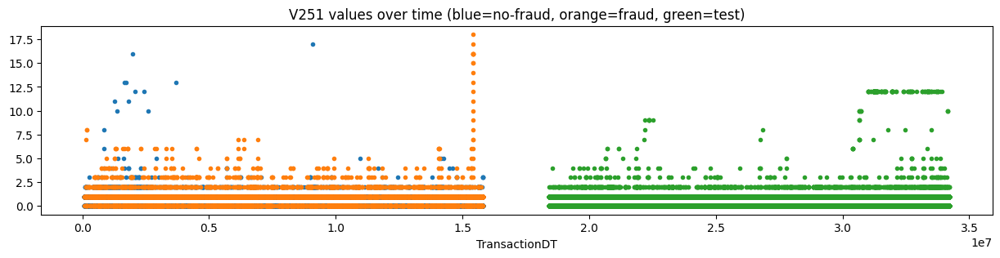

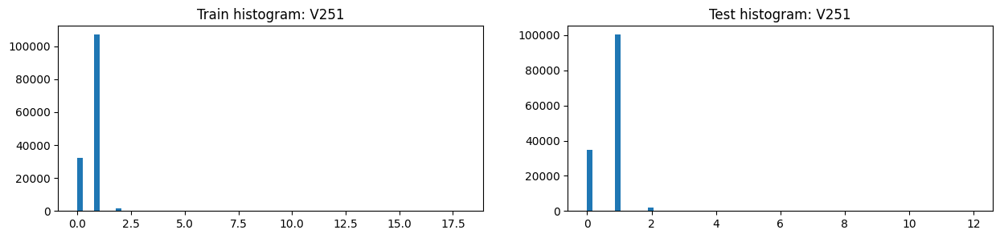

,V251,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,141416.000000,10982.000000,130434.000000,137316.000000,17734.000000,119582.000000
1,mean,0.794231,0.903661,0.785018,0.774433,0.732830,0.780602
2,std,0.501240,0.918799,0.447471,0.593961,0.512415,0.604877
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,18.000000,18.000000,17.000000,12.000000,6.000000,12.000000
8,unique values,20.000000,20.000000,15.000000,13.000000,8.000000,13.000000
9,NaNs,449124.000000,9681.000000,439443.000000,369375.000000,83605.000000,285771.000000


,V251,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,449124,0.021555,9681,369375.0
1,1.0,106932,0.062666,6701,100270.0
2,0.0,32264,0.093882,3029,34900.0
3,2.0,1806,0.512182,925,1800.0
4,3.0,240,0.775000,186,119.0
5,4.0,88,0.840909,74,41.0
6,5.0,25,0.760000,19,16.0
7,6.0,25,0.960000,24,11.0
8,7.0,6,1.000000,6,7.0
9,16.0,6,0.833333,5,NaN


,V251,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,449124,0.021555,9681,369375.0
1,1.0,106932,0.062666,6701,100270.0
2,0.0,32264,0.093882,3029,34900.0
3,2.0,1806,0.512182,925,1800.0
4,3.0,240,0.775000,186,119.0
5,4.0,88,0.840909,74,41.0
6,6.0,25,0.960000,24,11.0
7,5.0,25,0.760000,19,16.0
8,7.0,6,1.000000,6,7.0
9,16.0,6,0.833333,5,NaN


,Column,Correlation with V251
0,V251,1.000000
1,V250,0.983995
2,V256,0.693864
3,V255,0.687192
4,V245,0.479994
5,V259,0.454043
342,V329,-0.206922
343,V327,-0.220825
344,V326,-0.225503
345,V234,-0.249892


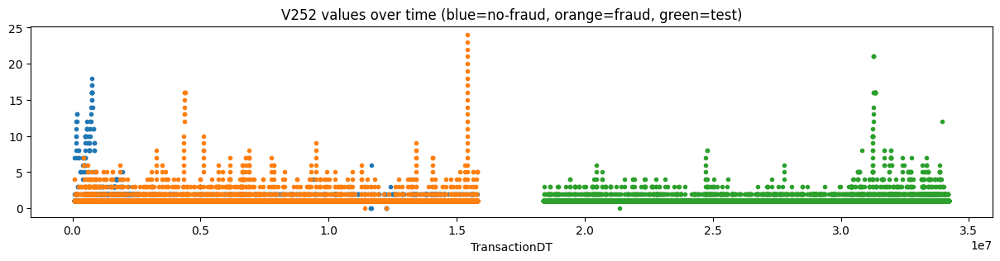

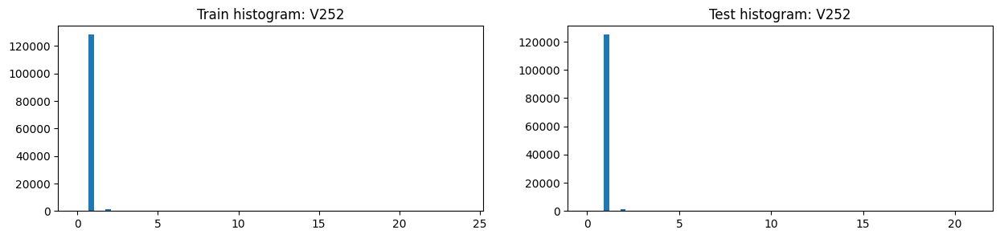

,V252,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.032048,1.237245,1.014654,1.021487,1.015285,1.022410
2,std,0.389546,1.020078,0.269335,0.271807,0.159392,0.284761
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,24.000000,24.000000,18.000000,21.000000,6.000000,21.000000
8,unique values,26.000000,26.000000,20.000000,18.000000,8.000000,17.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V252,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,1.0,128186,0.070132,8990,124943.0
2,2.0,1613,0.445133,718,1420.0
3,3.0,282,0.868794,245,187.0
4,4.0,130,0.838462,109,75.0
5,5.0,54,0.833333,45,39.0
6,6.0,31,0.838710,26,17.0
7,7.0,27,0.703704,19,12.0
8,8.0,20,0.400000,8,9.0
9,9.0,13,0.384615,5,1.0


,V252,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,128186,0.070132,8990,124943
2,2.0,1613,0.445133,718,1420
3,3.0,282,0.868794,245,187
4,4.0,130,0.838462,109,75
5,5.0,54,0.833333,45,39
6,6.0,31,0.838710,26,17
7,7.0,27,0.703704,19,12
8,8.0,20,0.400000,8,9
9,9.0,13,0.384615,5,1


,Column,Correlation with V252
0,V252,1.000000
1,V247,0.849959
2,V196,0.778117
3,V249,0.771101
4,V254,0.745987
5,V248,0.700490
342,V84,-0.031485
343,V302,-0.031605
344,card3,-0.034124
345,V94,-0.035271


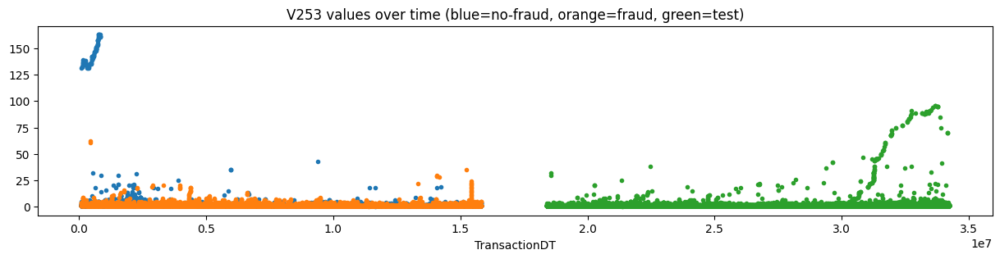

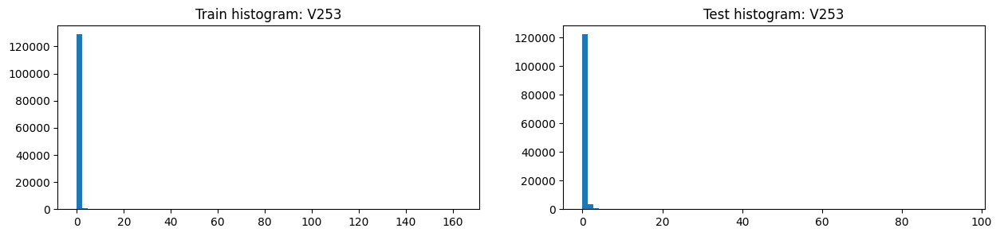

,V253,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.162164,1.406005,1.141494,1.117488,1.056026,1.126637
2,std,3.612553,1.736321,3.727705,2.099977,0.574131,2.239795
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,163.000000,62.000000,163.000000,96.000000,32.000000,96.000000
8,unique values,67.000000,32.000000,60.000000,73.000000,18.000000,72.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V253,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,1.0,125102,0.068032,8511,122066.0
2,2.0,3748,0.240662,902,3654.0
3,3.0,718,0.487465,350,480.0
4,4.0,295,0.552542,163,154.0
5,5.0,175,0.531429,93,70.0
6,6.0,89,0.573034,51,36.0
7,7.0,60,0.583333,35,21.0
8,8.0,28,0.678571,19,19.0
9,9.0,26,0.423077,11,12.0


,V253,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,125102,0.068032,8511,122066
2,2.0,3748,0.240662,902,3654
3,3.0,718,0.487465,350,480
4,4.0,295,0.552542,163,154
5,5.0,175,0.531429,93,70
6,6.0,89,0.573034,51,36
7,7.0,60,0.583333,35,21
8,8.0,28,0.678571,19,19
9,9.0,26,0.423077,11,12


,Column,Correlation with V253
0,V253,1.000000
1,V254,0.977728
2,V248,0.955888
3,V229,0.901514
4,V249,0.897530
5,V224,0.894167
342,V33,-0.032629
343,V94,-0.040683
344,V304,-0.042633
345,V302,-0.052297


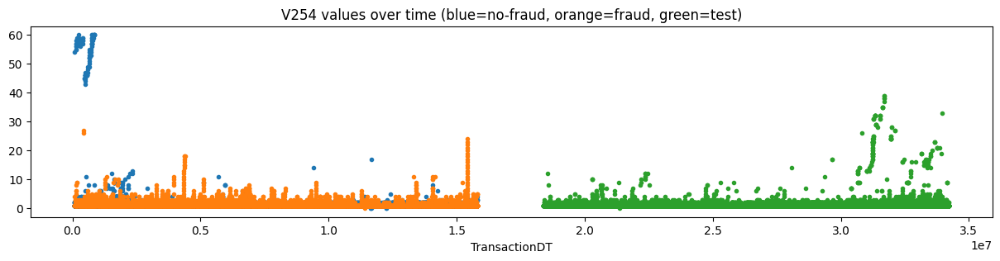

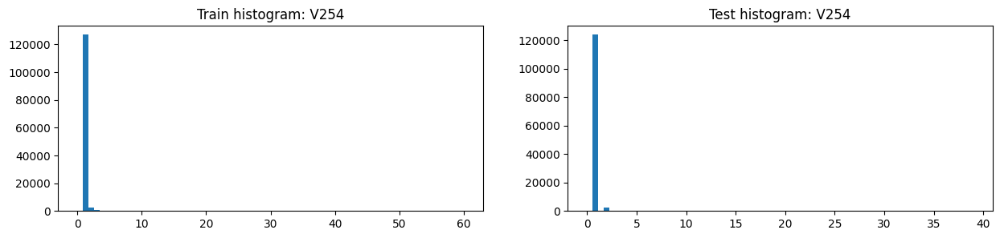

,V254,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.00000,126728.000000,16421.000000,110307.000000
1,mean,1.075113,1.307790,1.05539,1.052759,1.027708,1.056488
2,std,1.357550,1.218921,1.36684,0.771366,0.290783,0.819078
3,min,0.000000,0.000000,0.00000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.00000,1.000000,1.000000,1.000000
7,max,60.000000,27.000000,60.00000,39.000000,12.000000,39.000000
8,unique values,46.000000,28.000000,35.00000,38.000000,13.000000,37.000000
9,NaNs,460110.000000,10471.000000,449639.00000,379963.000000,84918.000000,295046.000000


,V254,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,1.0,126996,0.068939,8755,123750.0
2,2.0,2448,0.326797,800,2402.0
3,3.0,451,0.698448,315,252.0
4,4.0,210,0.676190,142,71.0
5,5.0,68,0.882353,60,37.0
6,6.0,46,0.717391,33,20.0
7,7.0,30,0.666667,20,15.0
8,9.0,24,0.541667,13,19.0
9,8.0,21,0.571429,12,9.0


,V254,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,126996,0.068939,8755,123750
2,2.0,2448,0.326797,800,2402
3,3.0,451,0.698448,315,252
4,4.0,210,0.676190,142,71
5,5.0,68,0.882353,60,37
6,6.0,46,0.717391,33,20
7,7.0,30,0.666667,20,15
8,9.0,24,0.541667,13,19
9,8.0,21,0.571429,12,9


,Column,Correlation with V254
0,V254,1.000000
1,V253,0.977728
2,V248,0.954492
3,V249,0.933000
4,V229,0.881434
5,V243,0.873915
342,V84,-0.032003
343,V94,-0.041422
344,V304,-0.042361
345,V302,-0.051695


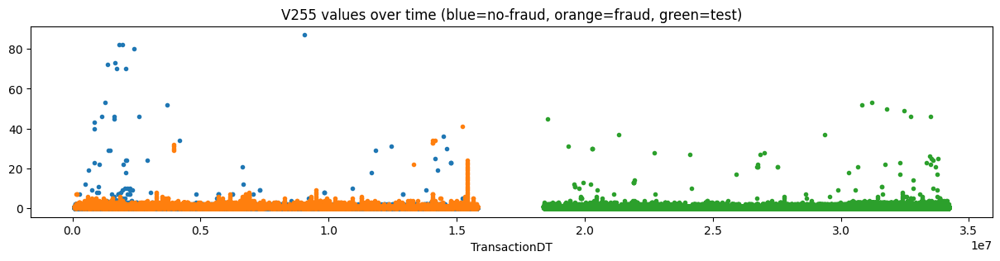

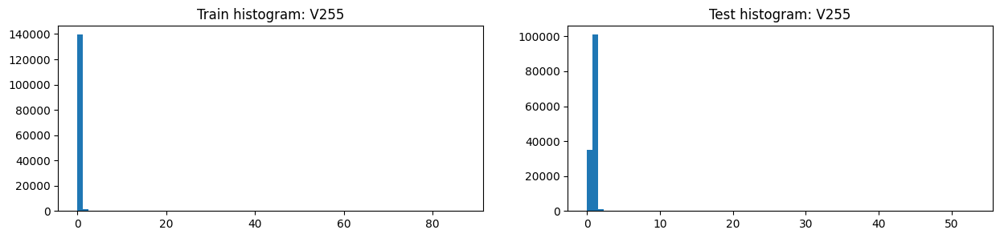

,V255,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,141416.000000,10982.000000,130434.000000,137316.000000,17734.000000,119582.000000
1,mean,0.806656,0.929885,0.796280,0.768104,0.735762,0.772901
2,std,0.939124,1.388086,0.890288,0.696111,0.817731,0.676087
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,87.000000,41.000000,87.000000,53.000000,45.000000,53.000000
8,unique values,47.000000,33.000000,38.000000,35.000000,18.000000,31.000000
9,NaNs,449124.000000,9681.000000,439443.000000,369375.000000,83605.000000,285771.000000


,V255,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,449124,0.021555,9681,369375.0
1,1.0,107128,0.064577,6918,100948.0
2,0.0,32341,0.093998,3040,34967.0
3,2.0,1369,0.428780,587,955.0
4,3.0,277,0.898917,249,311.0
5,4.0,116,0.741379,86,39.0
6,5.0,42,0.880952,37,21.0
7,7.0,34,0.470588,16,6.0
8,6.0,19,0.947368,18,10.0
9,8.0,11,0.363636,4,1.0


,V255,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,449124,0.021555,9681,369375
1,1.0,107128,0.064577,6918,100948
2,0.0,32341,0.093998,3040,34967
3,2.0,1369,0.428780,587,955
4,3.0,277,0.898917,249,311
5,4.0,116,0.741379,86,39
6,5.0,42,0.880952,37,21
7,6.0,19,0.947368,18,10
8,7.0,34,0.470588,16,6
9,8.0,11,0.363636,4,1


,Column,Correlation with V255
0,V255,1.000000
1,V256,0.984082
2,V245,0.892076
3,V259,0.821271
4,V227,0.795647
5,V221,0.759551
342,D6,-0.112258
343,D2,-0.115535
344,V234,-0.117009
345,D10,-0.128273


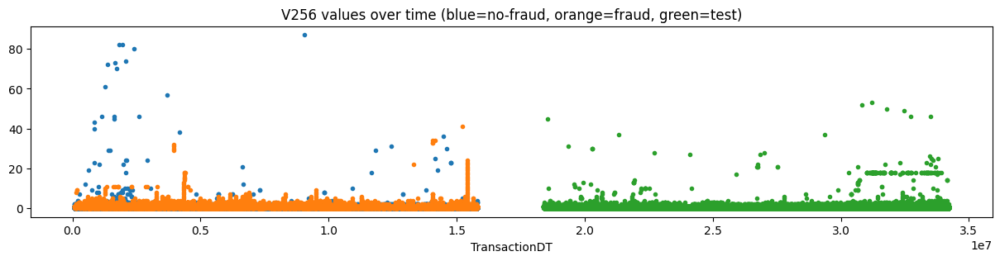

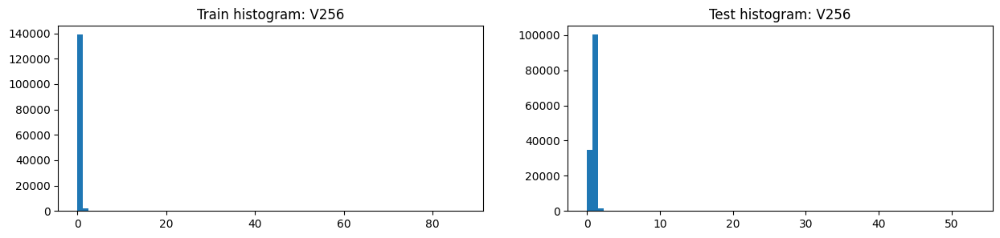

,V256,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,141416.000000,10982.000000,130434.000000,137316.000000,17734.000000,119582.000000
1,mean,0.814950,0.992260,0.800021,0.791080,0.740329,0.798607
2,std,0.969953,1.546662,0.903193,0.889047,0.831390,0.897041
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,87.000000,41.000000,87.000000,53.000000,45.000000,53.000000
8,unique values,49.000000,33.000000,39.000000,35.000000,19.000000,32.000000
9,NaNs,449124.000000,9681.000000,439443.000000,369375.000000,83605.000000,285771.000000


,V256,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,449124,0.021555,9681,369375.0
1,1.0,106671,0.063269,6749,100192.0
2,0.0,32264,0.093882,3029,34900.0
3,2.0,1764,0.370181,653,1708.0
4,3.0,317,0.854890,271,201.0
5,4.0,158,0.797468,126,51.0
6,5.0,52,0.923077,48,24.0
7,7.0,34,0.470588,16,13.0
8,6.0,31,0.806452,25,12.0
9,11.0,16,0.937500,15,4.0


,V256,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,449124,0.021555,9681,369375
1,1.0,106671,0.063269,6749,100192
2,0.0,32264,0.093882,3029,34900
3,2.0,1764,0.370181,653,1708
4,3.0,317,0.854890,271,201
5,4.0,158,0.797468,126,51
6,5.0,52,0.923077,48,24
7,6.0,31,0.806452,25,12
8,7.0,34,0.470588,16,13
9,11.0,16,0.937500,15,4


,Column,Correlation with V256
0,V256,1.000000
1,V255,0.984082
2,V245,0.875776
3,V259,0.805978
4,V227,0.783825
5,V221,0.745192
342,D6,-0.109676
343,V234,-0.111267
344,D2,-0.114128
345,D10,-0.124571


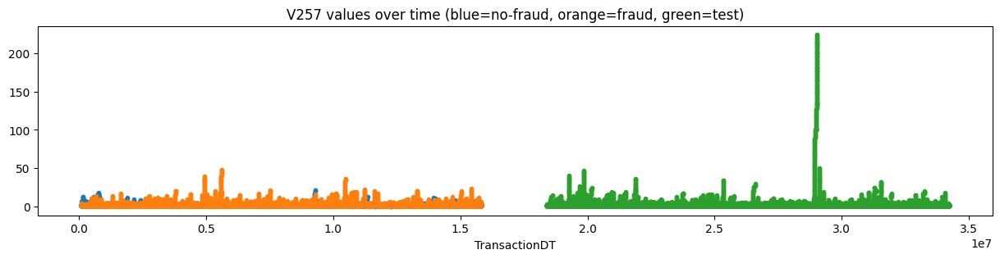

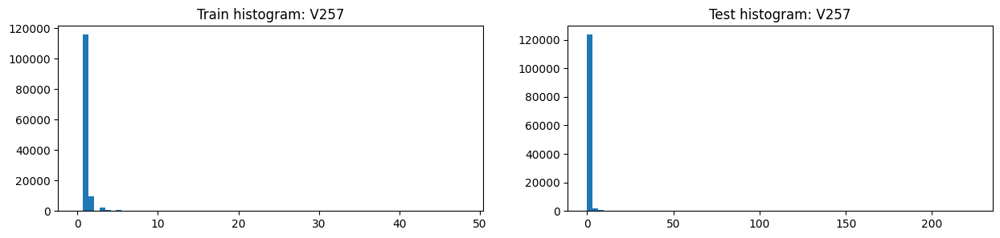

,V257,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.250993,2.961342,1.106015,1.484857,1.586870,1.469671
2,std,1.299956,3.923475,0.509331,5.829067,2.560324,6.169171
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,3.000000,1.000000,1.000000,1.000000,1.000000
7,max,48.000000,48.000000,22.000000,224.000000,47.000000,224.000000
8,unique values,50.000000,50.000000,23.000000,226.000000,49.000000,225.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V257,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,115835,0.042768,4954,112522
2,2.0,9578,0.200877,1924,8935
3,3.0,2196,0.460383,1011,2129
4,4.0,843,0.730724,616,911
5,5.0,489,0.842536,412,475
6,6.0,325,0.876923,285,338
7,7.0,239,0.866109,207,215
8,8.0,168,0.761905,128,147
9,9.0,134,0.850746,114,123


,V257,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,115835,0.042768,4954,112522
2,2.0,9578,0.200877,1924,8935
3,3.0,2196,0.460383,1011,2129
4,4.0,843,0.730724,616,911
5,5.0,489,0.842536,412,475
6,6.0,325,0.876923,285,338
7,7.0,239,0.866109,207,215
8,8.0,168,0.761905,128,147
9,9.0,134,0.850746,114,123


,Column,Correlation with V257
0,V257,1.000000
1,V246,0.905762
2,V199,0.871518
3,V190,0.780763
4,V258,0.779436
5,V44,0.766933
342,addr2,-0.052649
343,D2,-0.086468
344,D8,-0.095893
345,D7,-0.121150


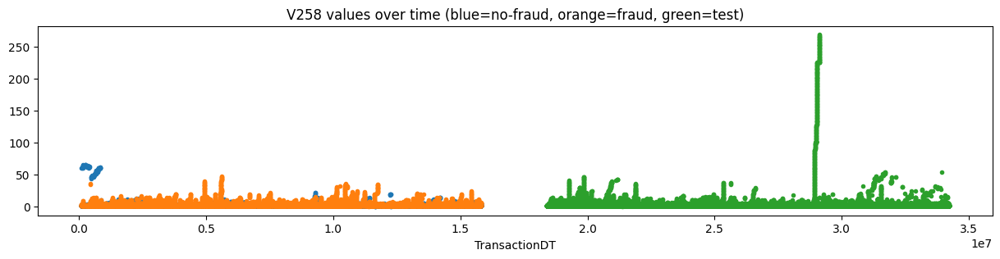

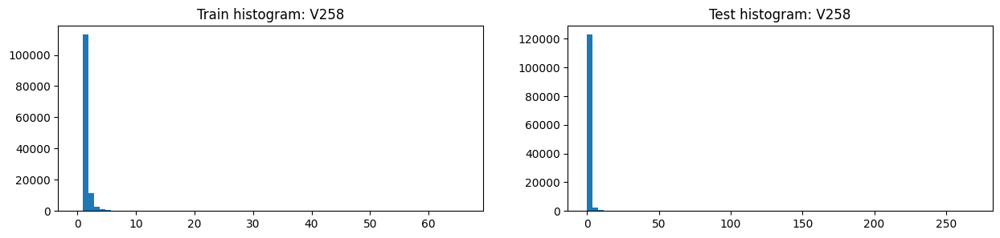

,V258,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.343510,3.400903,1.169115,1.667824,1.767127,1.653041
2,std,2.015811,4.493237,1.519058,7.692319,3.205198,8.151661
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,4.000000,1.000000,1.000000,1.000000,1.000000
7,max,66.000000,48.000000,66.000000,269.000000,47.000000,269.000000
8,unique values,68.000000,50.000000,47.000000,271.000000,49.000000,270.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V258,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,112953,0.039698,4484,109727
2,2.0,11247,0.168934,1900,10508
3,3.0,2696,0.403190,1087,2555
4,4.0,1062,0.644068,684,1081
5,5.0,569,0.782074,445,593
6,6.0,368,0.847826,312,402
7,7.0,280,0.846429,237,260
8,8.0,214,0.799065,171,188
9,9.0,147,0.891156,131,154


,V258,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,112953,0.039698,4484,109727
2,2.0,11247,0.168934,1900,10508
3,3.0,2696,0.403190,1087,2555
4,4.0,1062,0.644068,684,1081
5,5.0,569,0.782074,445,593
6,6.0,368,0.847826,312,402
7,7.0,280,0.846429,237,260
8,8.0,214,0.799065,171,188
9,9.0,147,0.891156,131,154


,Column,Correlation with V258
0,V258,1.000000
1,V243,0.883010
2,V230,0.857729
3,V229,0.833344
4,V257,0.779436
5,V246,0.740122
342,D13,-0.042898
343,D2,-0.056874
344,D8,-0.080982
345,D7,-0.120765


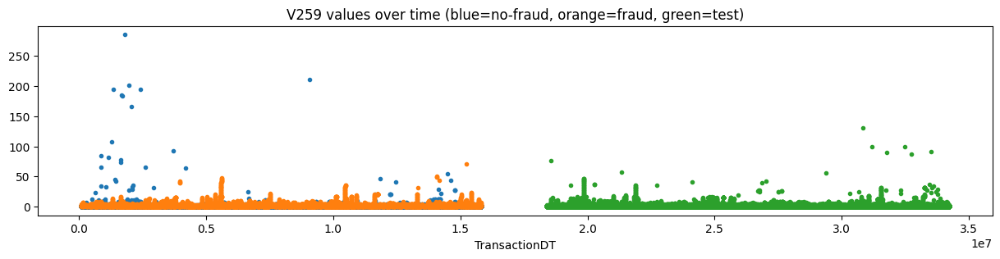

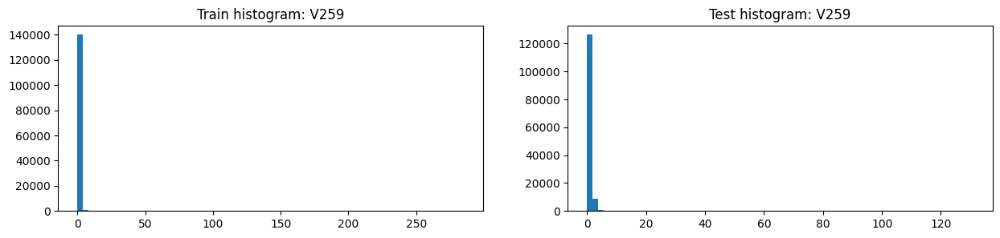

,V259,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,141416.000000,10982.000000,130434.000000,137316.000000,17734.000000,119582.000000
1,mean,0.967832,2.072300,0.874841,0.931006,1.061126,0.911709
2,std,2.113447,3.741202,1.884947,1.481376,2.141260,1.355401
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,0.000000,1.000000,0.000000,0.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,285.000000,71.000000,285.000000,131.000000,76.000000,131.000000
8,unique values,69.000000,53.000000,48.000000,58.000000,51.000000,49.000000
9,NaNs,449124.000000,9681.000000,439443.000000,369375.000000,83605.000000,285771.000000


,V259,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,449124,0.021555,9681,369375.0
1,1.0,97473,0.041119,4008,91389.0
2,0.0,32341,0.093998,3040,34967.0
3,2.0,7884,0.189371,1493,7080.0
4,3.0,1651,0.497274,821,1912.0
5,4.0,639,0.683881,437,583.0
6,5.0,412,0.834951,344,420.0
7,6.0,213,0.854460,182,196.0
8,7.0,163,0.822086,134,131.0
9,8.0,99,0.686869,68,84.0


,V259,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,449124,0.021555,9681,369375
1,1.0,97473,0.041119,4008,91389
2,0.0,32341,0.093998,3040,34967
3,2.0,7884,0.189371,1493,7080
4,3.0,1651,0.497274,821,1912
5,4.0,639,0.683881,437,583
6,5.0,412,0.834951,344,420
7,6.0,213,0.854460,182,196
8,7.0,163,0.822086,134,131
9,9.0,92,0.869565,80,124


,Column,Correlation with V259
0,V259,1.000000
1,V245,0.943832
2,V221,0.927828
3,V222,0.901667
4,V227,0.826610
5,V255,0.821271
342,D10,-0.078808
343,D7,-0.084981
344,D5,-0.102476
345,D2,-0.118886


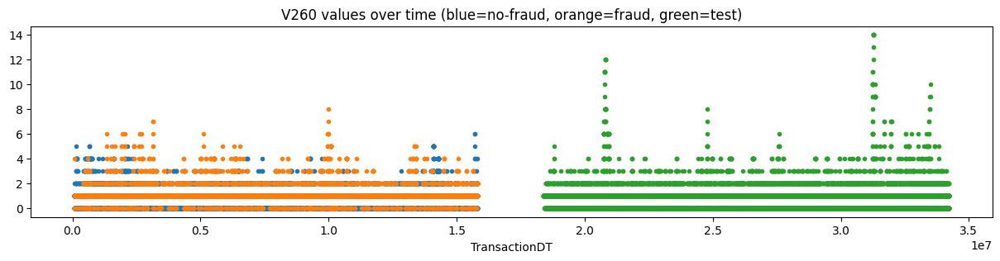

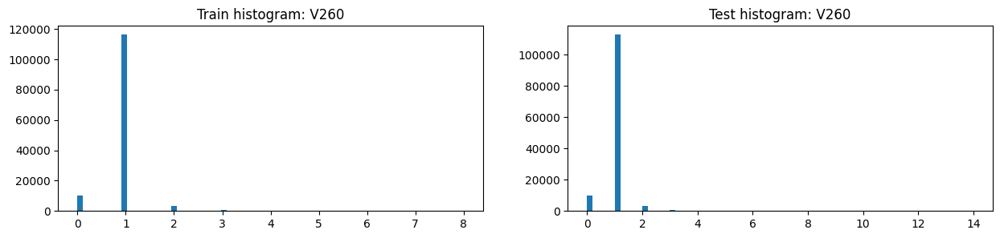

,V260,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,0.964425,1.127355,0.950615,0.965643,0.967054,0.965433
2,std,0.379828,0.683625,0.338300,0.429803,0.570978,0.404600
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,8.000000,8.000000,6.000000,14.000000,12.000000,14.000000
8,unique values,10.000000,10.000000,8.000000,16.000000,14.000000,16.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V260,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,116252,0.068833,8002,112879
2,0.0,10040,0.078088,784,9909
3,2.0,3254,0.300553,978,3175
4,3.0,607,0.426689,259,443
5,4.0,200,0.560000,112,153
6,5.0,58,0.689655,40,53
7,6.0,15,0.866667,13,44
8,7.0,3,1.000000,3,17
9,8.0,1,1.000000,1,14


,V260,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,116252,0.068833,8002,112879
2,2.0,3254,0.300553,978,3175
3,0.0,10040,0.078088,784,9909
4,3.0,607,0.426689,259,443
5,4.0,200,0.560000,112,153
6,5.0,58,0.689655,40,53
7,6.0,15,0.866667,13,44
8,7.0,3,1.000000,3,17
9,8.0,1,1.000000,1,14


,Column,Correlation with V260
0,V260,1.000000
1,V262,0.739626
2,V261,0.475751
3,V324,0.322480
4,V323,0.321245
5,V322,0.320766
342,V80,-0.080646
343,V15,-0.083309
344,V33,-0.084012
345,V18,-0.091054


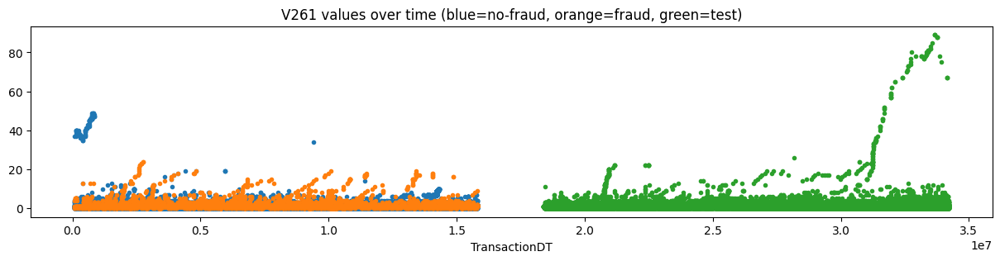

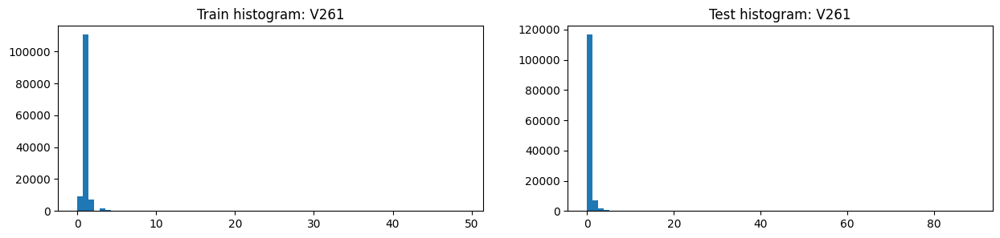

,V261,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.107161,1.583399,1.066793,1.115689,1.108398,1.116774
2,std,1.323230,1.946924,1.247890,1.937568,1.158064,2.028152
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,49.000000,24.000000,49.000000,89.000000,22.000000,89.000000
8,unique values,42.000000,26.000000,37.000000,68.000000,24.000000,68.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V261,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,1.0,110560,0.062229,6880,107365.0
2,0.0,9388,0.074244,697,9214.0
3,2.0,6984,0.199599,1394,7180.0
4,3.0,1611,0.318436,513,1486.0
5,4.0,655,0.412214,270,594.0
6,5.0,267,0.486891,130,249.0
7,7.0,224,0.183036,41,87.0
8,8.0,173,0.202312,35,52.0
9,6.0,167,0.455090,76,149.0


,V261,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,110560,0.062229,6880,107365
2,2.0,6984,0.199599,1394,7180
3,0.0,9388,0.074244,697,9214
4,3.0,1611,0.318436,513,1486
5,4.0,655,0.412214,270,594
6,5.0,267,0.486891,130,249
7,6.0,167,0.455090,76,149
8,7.0,224,0.183036,41,87
9,8.0,173,0.202312,35,52


,Column,Correlation with V261
0,V261,1.000000
1,V262,0.854025
2,V224,0.813530
3,V229,0.801337
4,V225,0.786467
5,V253,0.773576
342,V15,-0.118550
343,V33,-0.118582
344,V250,-0.119474
345,V20,-0.124353


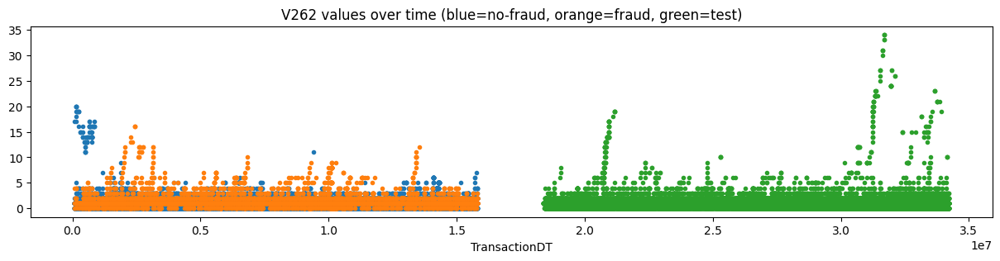

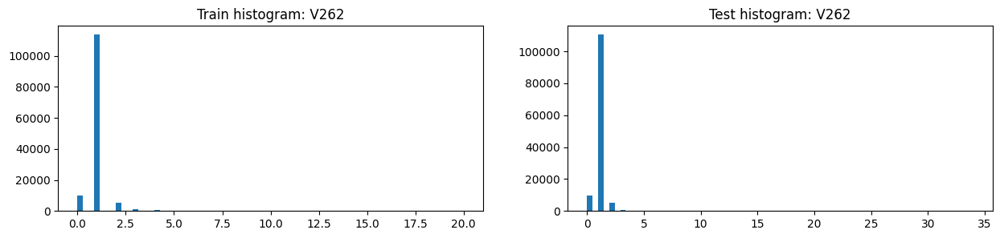

,V262,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,1.013279,1.336244,0.985903,1.020895,1.038731,1.018240
2,std,0.625455,1.185672,0.543699,0.820113,0.977872,0.793923
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,20.000000,16.000000,20.000000,34.000000,19.000000,34.000000
8,unique values,22.000000,17.000000,20.000000,33.000000,21.000000,33.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V262,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,113703,0.064387,7321,110439
2,0.0,9751,0.075172,733,9544
3,2.0,5085,0.257620,1310,5184
4,3.0,1004,0.362550,364,804
5,4.0,456,0.447368,204,315
6,5.0,170,0.582353,99,96
7,6.0,82,0.792683,65,68
8,7.0,26,0.884615,23,38
9,8.0,25,1.000000,25,12


,V262,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,1.0,113703,0.064387,7321,110439
2,2.0,5085,0.257620,1310,5184
3,0.0,9751,0.075172,733,9544
4,3.0,1004,0.362550,364,804
5,4.0,456,0.447368,204,315
6,5.0,170,0.582353,99,96
7,6.0,82,0.792683,65,68
8,8.0,25,1.000000,25,12
9,7.0,26,0.884615,23,38


,Column,Correlation with V262
0,V262,1.000000
1,V261,0.854025
2,V260,0.739626
3,V243,0.640161
4,V229,0.637100
5,V225,0.614214
342,V34,-0.072455
343,V17,-0.072724
344,V19,-0.079195
345,V15,-0.080571


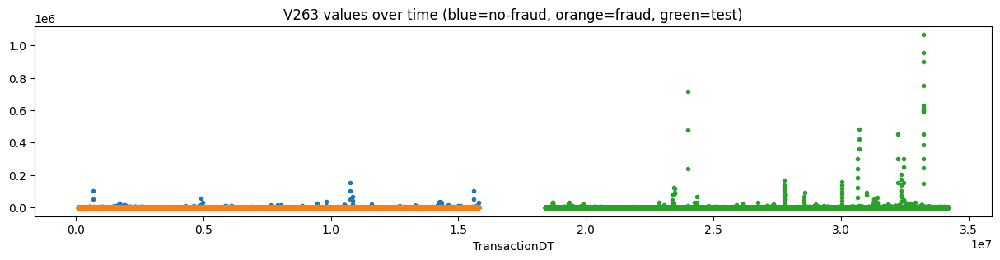

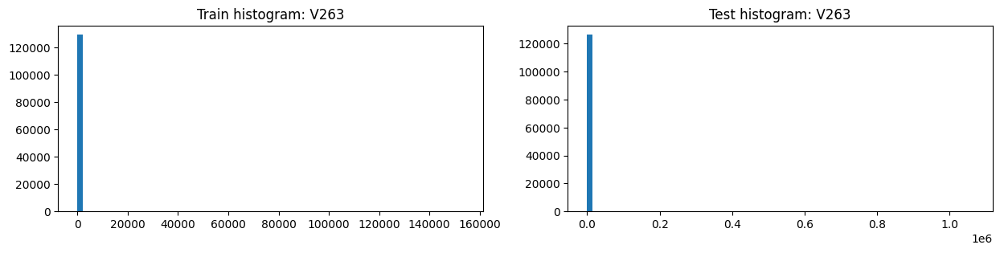

,V263,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,1.267280e+05,16421.000000,1.103070e+05
1,mean,117.390676,182.903241,111.837490,2.630722e+02,142.909451,2.809604e+02
2,std,1294.851543,381.478067,1343.887442,8.144608e+03,938.770836,8.722160e+03
3,min,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
4,25%,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
5,50%,0.000000,44.976200,0.000000,0.000000e+00,0.000000,0.000000e+00
6,75%,0.000000,200.000000,0.000000,8.607200e+00,39.593201,0.000000e+00
7,max,153600.000000,5450.000000,153600.000000,1.065496e+06,33360.000000,1.065496e+06
8,unique values,10423.000000,3606.000000,8158.000000,9.588000e+03,2601.000000,8.234000e+03
9,NaNs,460110.000000,10471.000000,449639.000000,3.799630e+05,84918.000000,2.950460e+05


,V263,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,98285,0.040179,3949,94140.0
2,100.0,2175,0.068506,149,1599.0
3,200.0,1494,0.113119,169,1316.0
4,50.0,1412,0.063031,89,894.0
5,150.0,1258,0.148649,187,857.0
6,300.0,1053,0.174739,184,827.0
7,400.0,584,0.135274,79,745.0
8,25.0,530,0.039623,21,405.0
9,75.0,481,0.062370,30,340.0


,V263,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,98285,0.040179,3949,94140
2,150.0,1258,0.148649,187,857
3,300.0,1053,0.174739,184,827
4,200.0,1494,0.113119,169,1316
5,100.0,2175,0.068506,149,1599
6,600.0,460,0.202174,93,447
7,50.0,1412,0.063031,89,894
8,400.0,584,0.135274,79,745
9,450.0,262,0.297710,78,164


,Column,Correlation with V263
0,V263,1.000000
1,V202,0.965592
2,V204,0.921738
3,V265,0.906093
4,V306,0.894083
5,V331,0.891289
342,V33,-0.152939
343,V57,-0.153533
344,V20,-0.173753
345,V61,-0.182369


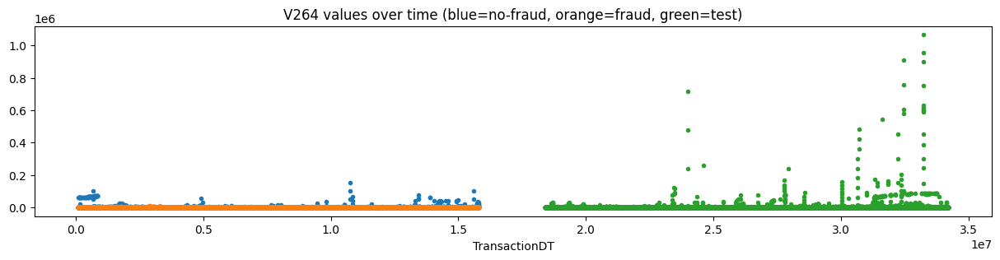

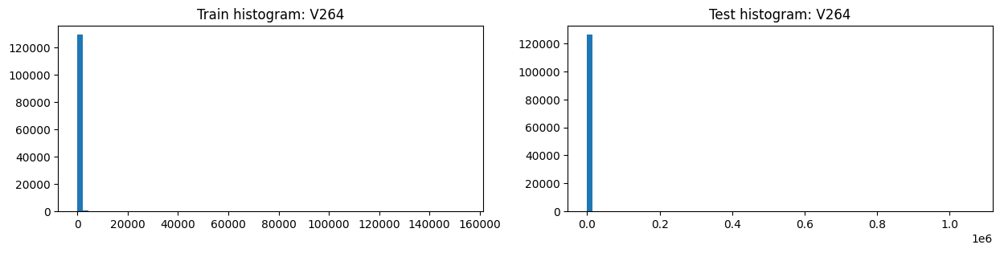

,V264,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,1.267280e+05,16421.000000,1.103070e+05
1,mean,201.657617,275.094347,195.432737,3.907419e+02,184.352515,4.214663e+02
2,std,2284.827492,553.838224,2374.122496,9.525812e+03,1066.420120,1.020161e+04
3,min,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
4,25%,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
5,50%,0.000000,78.924500,0.000000,0.000000e+00,0.000000,0.000000e+00
6,75%,33.593498,300.000000,19.817801,3.500000e+01,76.855202,2.975690e+01
7,max,153600.000000,10035.000000,153600.000000,1.065496e+06,33360.000000,1.065496e+06
8,unique values,13359.000000,4328.000000,10458.000000,1.270100e+04,3198.000000,1.095000e+04
9,NaNs,460110.000000,10471.000000,449639.000000,3.799630e+05,84918.000000,2.950460e+05


,V264,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,90334,0.035081,3169,86000.0
2,100.0,2462,0.057677,142,1860.0
3,50.0,1660,0.051205,85,1117.0
4,200.0,1613,0.094854,153,1481.0
5,150.0,1363,0.123991,169,958.0
6,300.0,1141,0.157756,180,887.0
7,25.0,698,0.028653,20,479.0
8,400.0,648,0.138889,90,784.0
9,75.0,575,0.046957,27,411.0


,V264,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,90334,0.035081,3169,86000
2,300.0,1141,0.157756,180,887
3,150.0,1363,0.123991,169,958
4,200.0,1613,0.094854,153,1481
5,100.0,2462,0.057677,142,1860
6,600.0,507,0.183432,93,472
7,400.0,648,0.138889,90,784
8,50.0,1660,0.051205,85,1117
9,450.0,285,0.263158,75,175


,Column,Correlation with V264
0,V264,1.000000
1,V274,0.886197
2,V265,0.852047
3,V203,0.840049
4,V204,0.816350
5,V267,0.776705
342,V33,-0.165091
343,V57,-0.167011
344,V20,-0.175476
345,V61,-0.189313


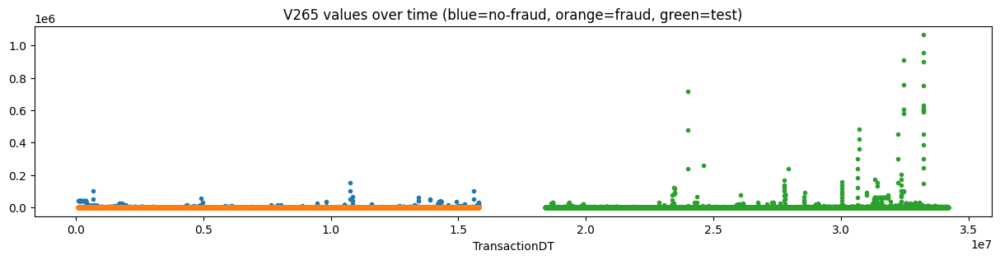

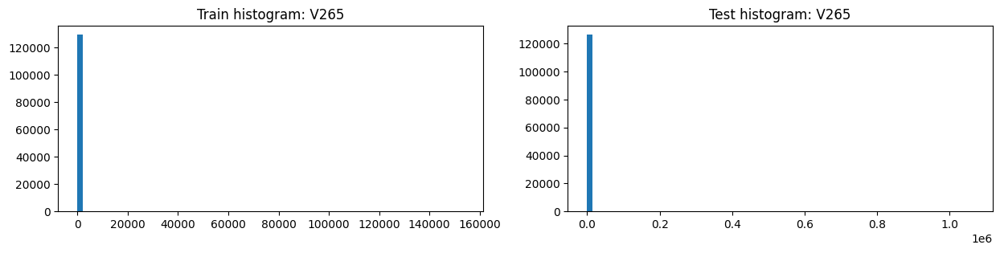

,V265,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,1.267280e+05,16421.000000,1.103070e+05
1,mean,153.520534,231.958628,146.871712,3.278710e+02,164.947629,3.521248e+02
2,std,1605.512276,459.758418,1666.639314,9.182103e+03,986.478635,9.834267e+03
3,min,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
4,25%,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
5,50%,0.000000,62.353401,0.000000,0.000000e+00,0.000000,0.000000e+00
6,75%,20.897525,256.954865,0.000000,2.213280e+01,51.889099,1.801360e+01
7,max,153600.000000,5475.000000,153600.000000,1.065496e+06,33360.000000,1.065496e+06
8,unique values,11758.000000,4029.000000,9100.000000,1.109200e+04,2888.000000,9.532000e+03
9,NaNs,460110.000000,10471.000000,449639.000000,3.799630e+05,84918.000000,2.950460e+05


,V265,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,94337,0.036529,3446,89956.0
2,100.0,2335,0.061242,143,1739.0
3,50.0,1572,0.057252,90,1042.0
4,200.0,1551,0.102515,159,1387.0
5,150.0,1316,0.135258,178,898.0
6,300.0,1108,0.175090,194,857.0
7,400.0,621,0.146538,91,756.0
8,25.0,619,0.033926,21,479.0
9,75.0,538,0.068773,37,391.0


,V265,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,94337,0.036529,3446,89956
2,300.0,1108,0.175090,194,857
3,150.0,1316,0.135258,178,898
4,200.0,1551,0.102515,159,1387
5,100.0,2335,0.061242,143,1739
6,600.0,490,0.193878,95,462
7,400.0,621,0.146538,91,756
8,50.0,1572,0.057252,90,1042
9,450.0,273,0.285714,78,168


,Column,Correlation with V265
0,V265,1.000000
1,V204,0.950778
2,V203,0.917215
3,V202,0.907536
4,V263,0.906093
5,V275,0.861035
342,V33,-0.162173
343,V57,-0.162948
344,V20,-0.181499
345,V61,-0.190389


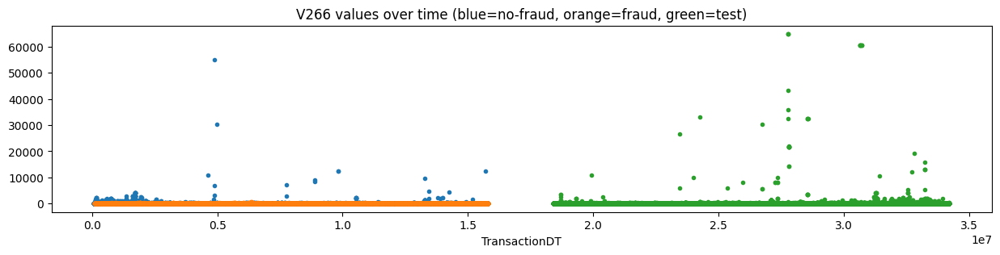

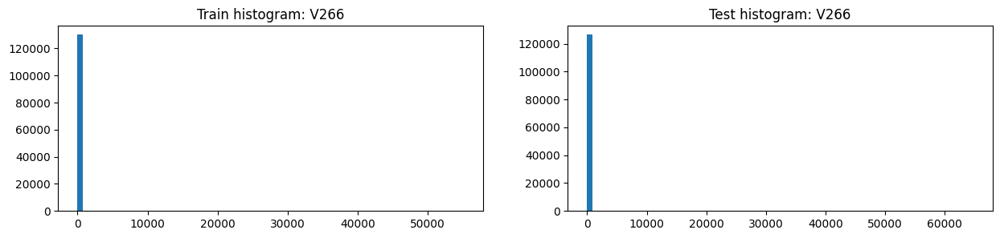

,V266,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,9.167839,5.411525,9.486243,18.501697,6.464701,20.293600
2,std,208.038863,28.666797,216.513053,665.240151,107.040350,711.824897
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,55125.000000,635.000000,55125.000000,64800.000000,11000.000000,64800.000000
8,unique values,2179.000000,225.000000,2093.000000,1916.000000,435.000000,1737.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V266,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,120515,0.077492,9339,117163.0
2,50.0,391,0.074169,29,257.0
3,100.0,343,0.061224,21,304.0
4,25.0,202,0.064356,13,193.0
5,150.0,173,0.127168,22,132.0
6,106.0,165,0.000000,0,NaN
7,181.0,146,0.000000,0,NaN
8,20.0,123,0.016260,2,133.0
9,200.0,111,0.126126,14,195.0


,V266,Count in train,Mean target,Sum target (desc),Count in test
0,-999.000000,460110,0.022758,10471,379963.0
1,0.000000,120515,0.077492,9339,117163.0
2,50.000000,391,0.074169,29,257.0
3,20.844900,28,0.928571,26,NaN
4,17.337400,29,0.862069,25,12.0
5,150.000000,173,0.127168,22,132.0
6,100.000000,343,0.061224,21,304.0
7,44.106602,23,0.826087,19,NaN
8,86.317902,18,1.000000,18,NaN
9,8.914600,20,0.900000,18,19.0


,Column,Correlation with V266
0,V266,1.000000
1,V269,0.996097
2,V205,0.982005
3,V129,0.960216
4,V206,0.956989
5,V309,0.948351
342,V94,-0.034301
343,V52,-0.035879
344,V51,-0.035941
345,D12,-0.039041


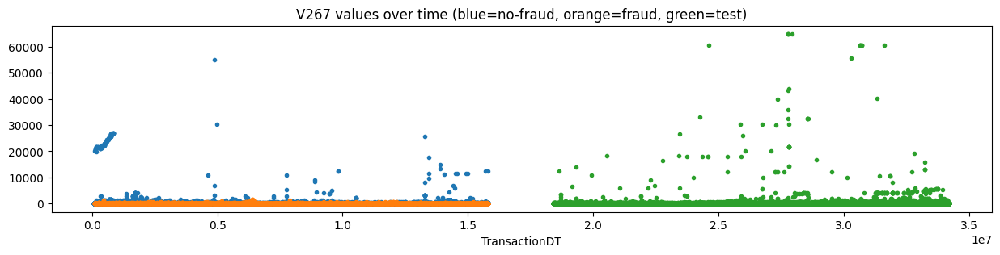

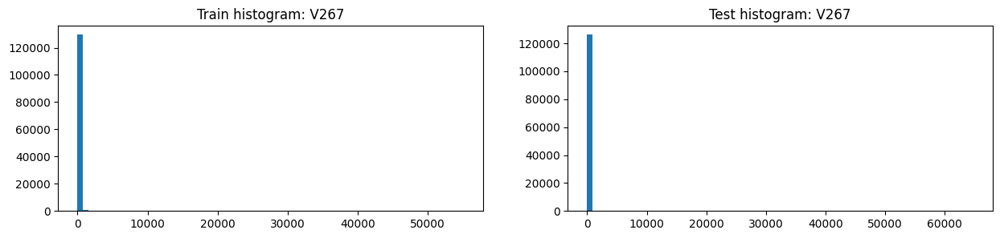

,V267,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,36.525103,20.156896,37.912557,37.740975,18.802159,40.560327
2,std,644.878586,80.393649,671.228294,828.662878,246.709039,883.054517
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,55125.000000,1495.000000,55125.000000,64800.000000,18400.000000,64800.000000
8,unique values,3617.000000,397.000000,3475.000000,3366.000000,762.000000,3066.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V267,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,112053,0.073073,8188,108515.0
2,100.0,761,0.051248,39,642.0
3,50.0,740,0.047297,35,570.0
4,25.0,397,0.047859,19,325.0
5,150.0,341,0.126100,43,293.0
6,1259.0,328,0.000000,0,NaN
7,200.0,299,0.107023,32,370.0
8,20.0,266,0.026316,7,245.0
9,75.0,259,0.131274,34,194.0


,V267,Count in train,Mean target,Sum target (desc),Count in test
0,-999.000000,460110,0.022758,10471,379963.0
1,0.000000,112053,0.073073,8188,108515.0
2,39.575100,50,1.000000,50,NaN
3,150.000000,341,0.126100,43,293.0
4,450.000000,70,0.614286,43,49.0
5,100.000000,761,0.051248,39,642.0
6,86.317902,43,0.883721,38,1.0
7,50.000000,740,0.047297,35,570.0
8,75.000000,259,0.131274,34,194.0
9,300.000000,181,0.182320,33,188.0


,Column,Correlation with V267
0,V267,1.000000
1,V253,0.893545
2,V268,0.881998
3,V254,0.862880
4,V224,0.852091
5,V248,0.843572
342,V57,-0.097401
343,V34,-0.098721
344,V19,-0.098908
345,V15,-0.103652


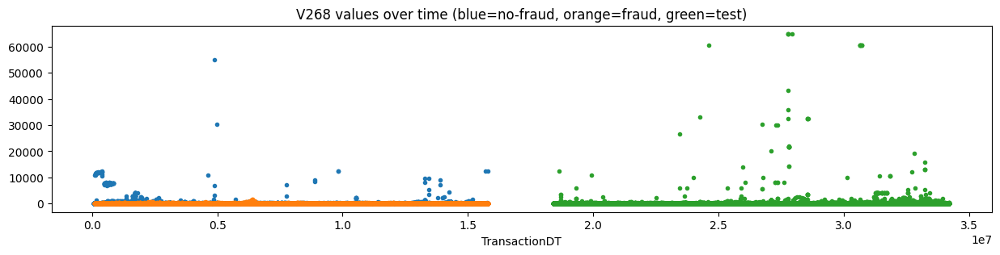

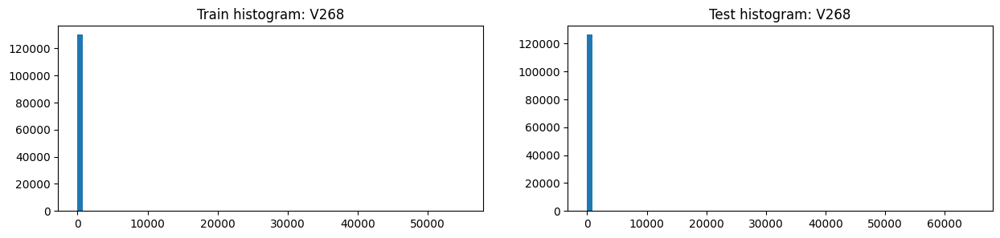

,V268,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,18.813407,13.295416,19.281140,25.521301,10.379182,27.775453
2,std,311.280181,63.343620,323.675597,731.803178,153.627926,782.117240
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,55125.000000,1495.000000,55125.000000,64800.000000,12500.000000,64800.000000
8,unique values,2757.000000,313.000000,2643.000000,2460.000000,575.000000,2240.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V268,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,116323,0.074448,8660,112754.0
2,50.0,587,0.071550,42,442.0
3,100.0,549,0.058288,32,470.0
4,25.0,339,0.076696,26,286.0
5,619.0,328,0.000000,0,NaN
6,150.0,265,0.132075,35,209.0
7,30.0,230,0.047826,11,160.0
8,20.0,218,0.022936,5,218.0
9,15.0,206,0.038835,8,148.0


,V268,Count in train,Mean target,Sum target (desc),Count in test
0,-999.000000,460110,0.022758,10471,379963.0
1,0.000000,116323,0.074448,8660,112754.0
2,50.000000,587,0.071550,42,442.0
3,86.317902,38,1.000000,38,1.0
4,150.000000,265,0.132075,35,209.0
5,100.000000,549,0.058288,32,470.0
6,300.000000,136,0.227941,31,128.0
7,25.452700,34,0.911765,31,6.0
8,20.844900,33,0.909091,30,NaN
9,39.575100,27,1.000000,27,NaN


,Column,Correlation with V268
0,V268,1.000000
1,V267,0.881998
2,V207,0.875118
3,V205,0.832261
4,V206,0.807669
5,V266,0.758496
342,V19,-0.067524
343,V16,-0.068262
344,V34,-0.070343
345,V15,-0.073943


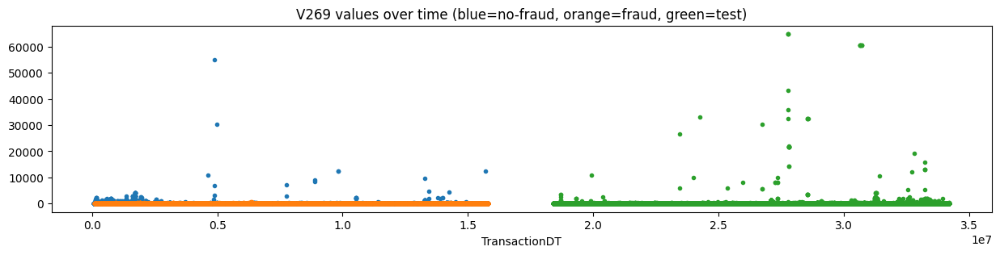

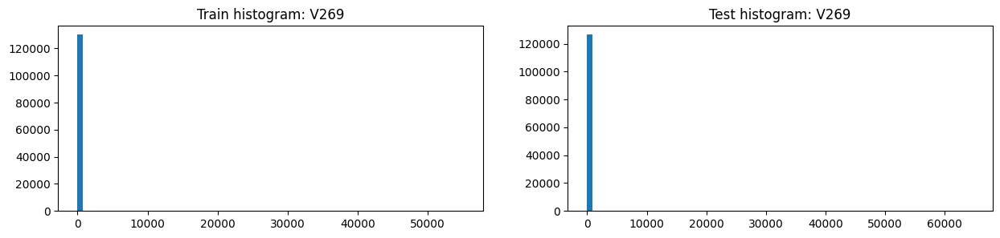

,V269,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,5.997508,1.793073,6.353898,14.804019,3.423756,16.498157
2,std,207.317539,22.423101,215.823094,664.266326,105.317735,710.819472
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,55125.000000,635.000000,55125.000000,64800.000000,11000.000000,64800.000000
8,unique values,152.000000,40.000000,138.000000,155.000000,42.000000,152.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V269,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,128257,0.078538,10073,124854.0
2,100.0,212,0.042453,9,209.0
3,106.0,165,0.000000,0,NaN
4,181.0,146,0.000000,0,NaN
5,50.0,138,0.057971,8,134.0
6,150.0,110,0.063636,7,76.0
7,25.0,90,0.033333,3,112.0
8,20.0,90,0.022222,2,124.0
9,1000.0,88,0.000000,0,47.0


,V269,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,128257,0.078538,10073,124854.0
2,15.0,72,0.138889,10,53.0
3,100.0,212,0.042453,9,209.0
4,50.0,138,0.057971,8,134.0
5,150.0,110,0.063636,7,76.0
6,200.0,80,0.075000,6,145.0
7,34.0,6,1.000000,6,NaN
8,250.0,66,0.090909,6,74.0
9,125.0,46,0.130435,6,21.0


,Column,Correlation with V269
0,V269,1.000000
1,V266,0.996097
2,V205,0.979334
3,V129,0.961926
4,V206,0.955651
5,V309,0.946494
342,V15,-0.039485
343,V33,-0.040010
344,V94,-0.042018
345,V52,-0.082112


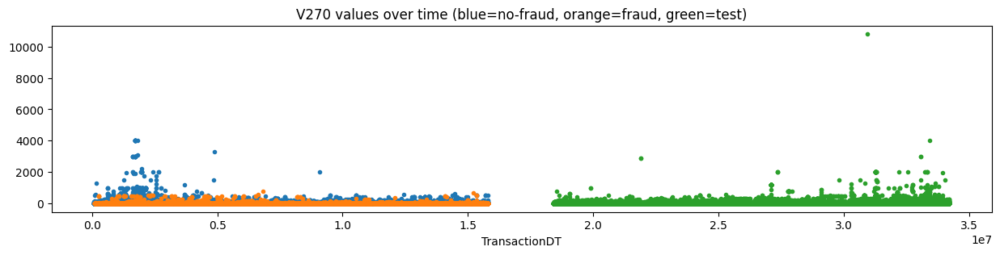

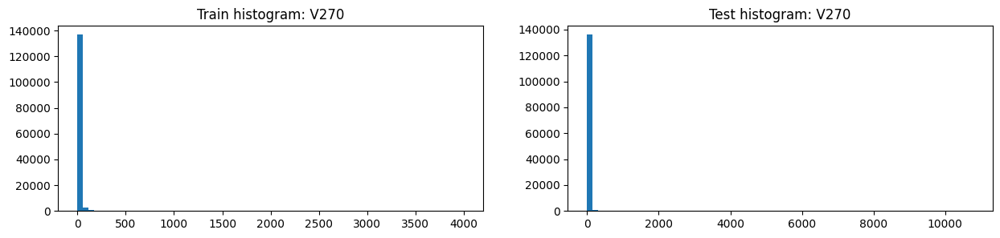

,V270,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,141416.000000,10982.000000,130434.000000,137316.000000,17734.000000,119582.000000
1,mean,7.712764,11.253346,7.414661,7.208853,5.234527,7.501645
2,std,65.507232,48.069232,66.759462,62.642960,28.918147,66.192296
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,4000.000000,800.000000,4000.000000,10791.570312,1000.000000,10791.570312
8,unique values,2341.000000,238.000000,2263.000000,1982.000000,452.000000,1799.000000
9,NaNs,449124.000000,9681.000000,439443.000000,369375.000000,83605.000000,285771.000000


,V270,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,449124,0.021555,9681,369375.0
1,0.0,128634,0.073192,9415,124829.0
2,50.0,674,0.078635,53,536.0
3,100.0,660,0.059091,39,510.0
4,25.0,351,0.039886,14,345.0
5,150.0,272,0.169118,46,213.0
6,20.0,245,0.085714,21,216.0
7,15.0,243,0.222222,54,137.0
8,200.0,223,0.130045,29,213.0
9,30.0,205,0.014634,3,183.0


,V270,Count in train,Mean target,Sum target (desc),Count in test
0,-999.000000,449124,0.021555,9681,369375
1,0.000000,128634,0.073192,9415,124829
2,15.000000,243,0.222222,54,137
3,50.000000,674,0.078635,53,536
4,19.550600,48,0.979167,47,15
5,150.000000,272,0.169118,46,213
6,450.000000,63,0.698413,44,26
7,100.000000,660,0.059091,39,510
8,86.317902,41,0.902439,37,1
9,40.000000,132,0.257576,34,134


,Column,Correlation with V270
0,V270,1.000000
1,V272,0.959014
2,V271,0.922576
3,V208,0.683549
4,V161,0.560068
5,V163,0.529343
342,D14,-0.079342
343,D3,-0.082437
344,D5,-0.092305
345,D7,-0.103896


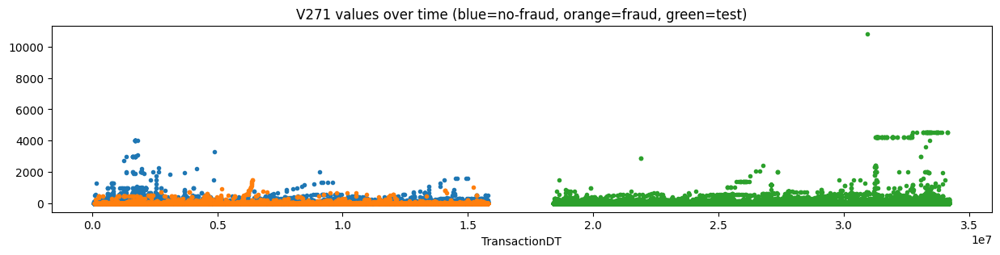

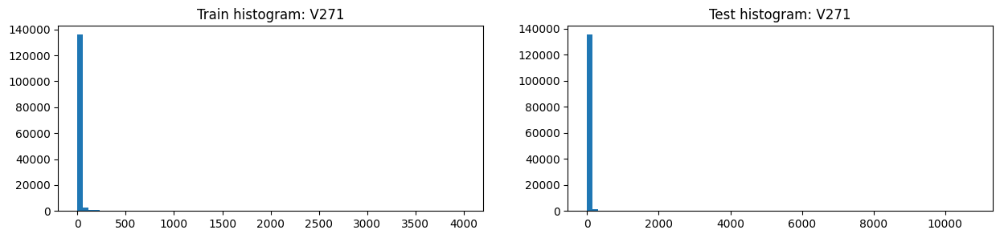

,V271,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,141416.000000,10982.000000,130434.000000,137316.000000,17734.000000,119582.000000
1,mean,9.445133,16.408079,8.858882,12.672403,7.681951,13.412486
2,std,74.147726,74.354161,74.100747,136.602559,43.256245,145.416247
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,4000.000000,1495.000000,4000.000000,10791.570312,1500.000000,10791.570312
8,unique values,2788.000000,314.000000,2673.000000,2615.000000,567.000000,2358.000000
9,NaNs,449124.000000,9681.000000,439443.000000,369375.000000,83605.000000,285771.000000


,V271,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,449124,0.021555,9681,369375.0
1,0.0,128066,0.072830,9327,124022.0
2,100.0,642,0.054517,35,507.0
3,50.0,639,0.056338,36,509.0
4,25.0,323,0.043344,14,283.0
5,150.0,273,0.157509,43,243.0
6,200.0,239,0.142259,34,216.0
7,75.0,203,0.162562,33,156.0
8,20.0,199,0.035176,7,146.0
9,30.0,173,0.034682,6,141.0


,V271,Count in train,Mean target,Sum target (desc),Count in test
0,-999.000000,449124,0.021555,9681,369375.0
1,0.000000,128066,0.072830,9327,124022.0
2,450.000000,69,0.666667,46,40.0
3,150.000000,273,0.157509,43,243.0
4,52.134998,47,0.914894,43,NaN
5,86.317902,41,0.902439,37,1.0
6,50.000000,639,0.056338,36,509.0
7,100.000000,642,0.054517,35,507.0
8,200.000000,239,0.142259,34,216.0
9,75.000000,203,0.162562,33,156.0


,Column,Correlation with V271
0,V271,1.000000
1,V272,0.970620
2,V270,0.922576
3,V208,0.637773
4,V163,0.554561
5,V162,0.541850
342,D3,-0.080852
343,D7,-0.085611
344,D5,-0.094221
345,D2,-0.101738


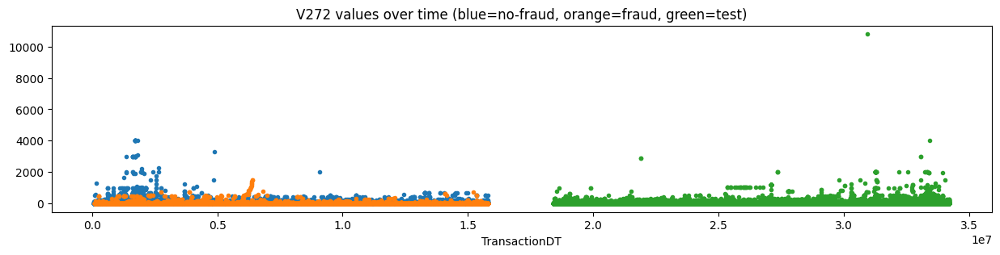

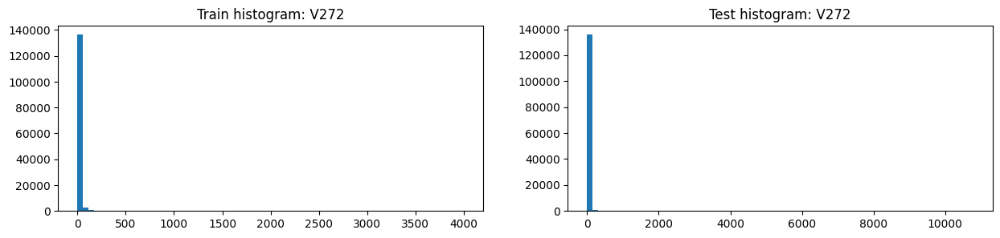

,V272,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,141416.000000,10982.000000,130434.000000,137316.000000,17734.000000,119582.000000
1,mean,8.464571,14.563545,7.951063,8.060808,6.194418,8.337594
2,std,69.723735,68.029692,69.840441,66.397778,34.011104,69.930990
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,4000.000000,1495.000000,4000.000000,10791.570312,1000.000000,10791.570312
8,unique values,2508.000000,279.000000,2403.000000,2189.000000,492.000000,1984.000000
9,NaNs,449124.000000,9681.000000,439443.000000,369375.000000,83605.000000,285771.000000


,V272,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,449124,0.021555,9681,369375.0
1,0.0,128436,0.072986,9374,124655.0
2,100.0,711,0.080169,57,500.0
3,50.0,653,0.053599,35,530.0
4,25.0,344,0.040698,14,283.0
5,150.0,265,0.173585,46,222.0
6,200.0,240,0.137500,33,203.0
7,20.0,195,0.035897,7,141.0
8,30.0,193,0.036269,7,179.0
9,75.0,192,0.166667,32,154.0


,V272,Count in train,Mean target,Sum target (desc),Count in test
0,-999.000000,449124,0.021555,9681,369375.0
1,0.000000,128436,0.072986,9374,124655.0
2,100.000000,711,0.080169,57,500.0
3,150.000000,265,0.173585,46,222.0
4,450.000000,67,0.671642,45,30.0
5,52.134998,47,0.914894,43,NaN
6,86.317902,41,0.902439,37,1.0
7,50.000000,653,0.053599,35,530.0
8,200.000000,240,0.137500,33,203.0
9,75.000000,192,0.166667,32,154.0


,Column,Correlation with V272
0,V272,1.000000
1,V271,0.970620
2,V270,0.959014
3,V208,0.661664
4,V163,0.577329
5,V162,0.543913
342,D3,-0.084639
343,D7,-0.085700
344,V94,-0.088421
345,D5,-0.094127


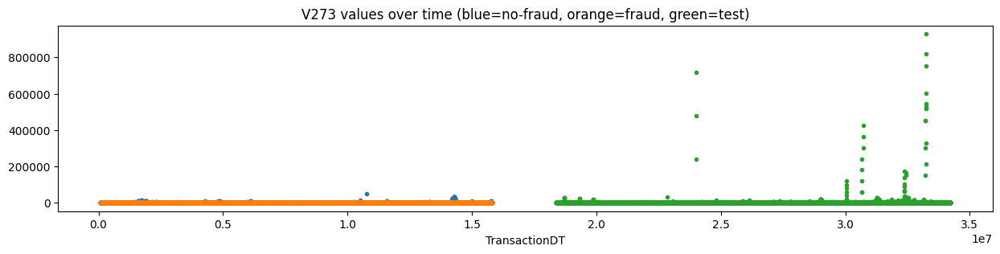

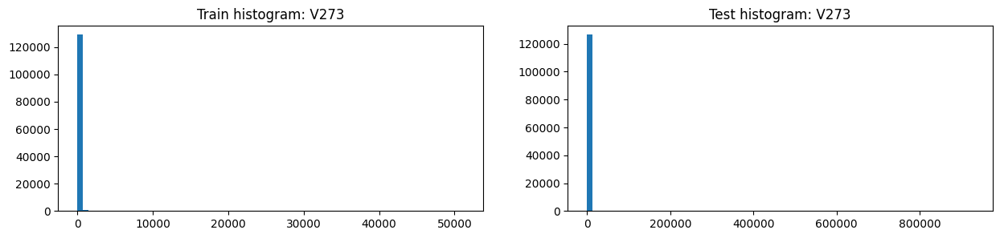

,V273,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,73.825549,124.177259,69.557475,169.879957,96.154644,180.855175
2,std,935.187927,302.272394,969.914136,6772.033884,773.580908,7252.418263
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,121.081802,0.000000,0.000000,0.000000,0.000000
7,max,51200.000000,5450.000000,51200.000000,928882.000000,26400.000000,928882.000000
8,unique values,7178.000000,3085.000000,4991.000000,6777.000000,1937.000000,5646.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V273,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,112885,0.047101,5317,109490.0
2,100.0,976,0.115779,113,529.0
3,200.0,650,0.176923,115,486.0
4,150.0,642,0.196262,126,359.0
5,50.0,637,0.080063,51,331.0
6,300.0,523,0.217973,114,305.0
7,75.0,234,0.115385,27,127.0
8,400.0,229,0.218341,50,255.0
9,25.0,210,0.071429,15,118.0


,V273,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,112885,0.047101,5317,109490
2,150.0,642,0.196262,126,359
3,200.0,650,0.176923,115,486
4,300.0,523,0.217973,114,305
5,100.0,976,0.115779,113,529
6,50.0,637,0.080063,51,331
7,400.0,229,0.218341,50,255
8,450.0,128,0.320312,41,74
9,600.0,197,0.187817,37,182


,Column,Correlation with V273
0,V273,1.000000
1,V211,0.960453
2,V231,0.952443
3,V217,0.950550
4,V275,0.949556
5,V233,0.944524
342,V33,-0.136896
343,V57,-0.143711
344,V20,-0.169868
345,V61,-0.178266


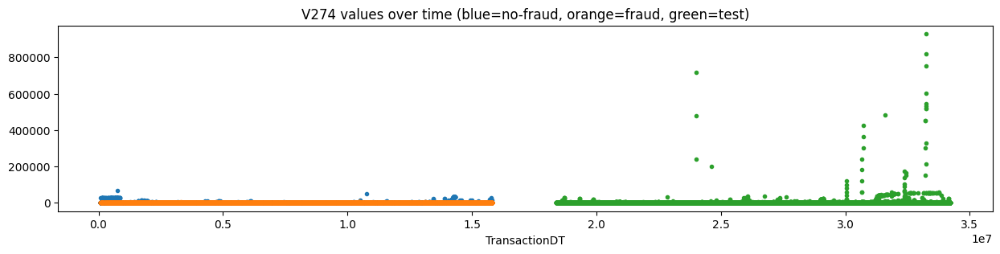

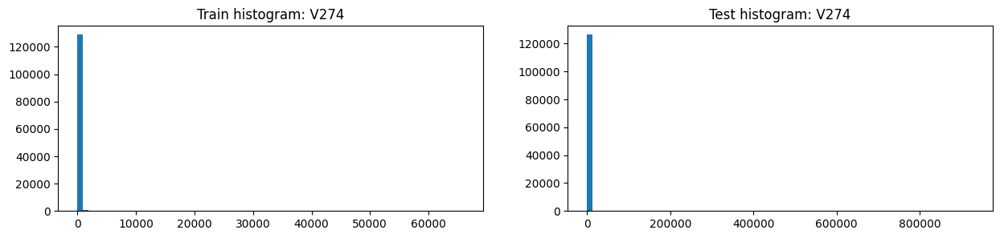

,V274,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,107.151636,174.240926,101.464798,231.561159,115.254711,248.875275
2,std,1258.734139,373.562643,1306.320800,7072.082110,810.369728,7573.625079
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,20.558701,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,179.749496,0.000000,0.000000,0.000000,0.000000
7,max,66000.000000,5450.000000,66000.000000,928882.000000,26400.000000,928882.000000
8,unique values,8316.000000,3527.000000,5674.000000,7955.000000,2182.000000,6620.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V274,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,110617,0.043257,4785,107458.0
2,100.0,974,0.120123,117,570.0
3,200.0,698,0.174785,122,505.0
4,150.0,684,0.190058,130,370.0
5,50.0,653,0.079632,52,374.0
6,300.0,567,0.231041,131,318.0
7,400.0,259,0.196911,51,264.0
8,75.0,239,0.104603,25,143.0
9,600.0,235,0.195745,46,189.0


,V274,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,110617,0.043257,4785,107458
2,300.0,567,0.231041,131,318
3,150.0,684,0.190058,130,370
4,200.0,698,0.174785,122,505
5,100.0,974,0.120123,117,570
6,50.0,653,0.079632,52,374
7,400.0,259,0.196911,51,264
8,450.0,152,0.322368,49,77
9,600.0,235,0.195745,46,189


,Column,Correlation with V274
0,V274,1.000000
1,V212,0.913147
2,V218,0.911002
3,V213,0.894562
4,V275,0.890307
5,V264,0.886197
342,V33,-0.146745
343,V57,-0.151744
344,V20,-0.172916
345,V61,-0.182610


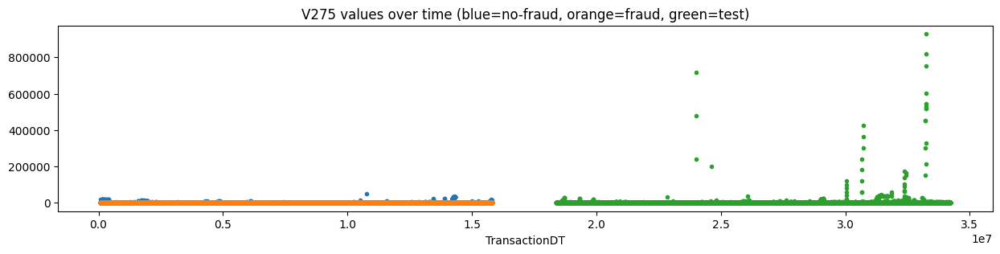

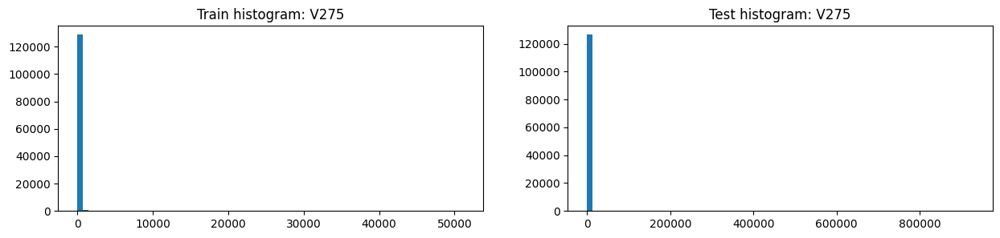

,V275,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,88.899939,151.988036,83.552263,197.489221,111.011756,210.362806
2,std,1072.883139,339.219874,1112.893253,6835.809781,803.958639,7320.323442
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,10.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,153.360271,0.000000,0.000000,0.000000,0.000000
7,max,51200.000000,5450.000000,51200.000000,928882.000000,26400.000000,928882.000000
8,unique values,7777.000000,3352.000000,5284.000000,7495.000000,2079.000000,6236.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V275,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,111756,0.044839,5011,108466.0
2,100.0,964,0.116183,112,549.0
3,200.0,684,0.175439,120,502.0
4,150.0,663,0.197587,131,363.0
5,50.0,639,0.078247,50,357.0
6,300.0,554,0.222022,123,317.0
7,400.0,252,0.198413,50,259.0
8,75.0,238,0.105042,25,126.0
9,600.0,225,0.182222,41,190.0


,V275,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,111756,0.044839,5011,108466
2,150.0,663,0.197587,131,363
3,300.0,554,0.222022,123,317
4,200.0,684,0.175439,120,502
5,100.0,964,0.116183,112,549
6,50.0,639,0.078247,50,357
7,400.0,252,0.198413,50,259
8,450.0,146,0.335616,49,78
9,350.0,71,0.605634,43,47


,Column,Correlation with V275
0,V275,1.000000
1,V213,0.955417
2,V273,0.949556
3,V211,0.938480
4,V212,0.932893
5,V219,0.924827
342,V33,-0.142629
343,V57,-0.148321
344,V20,-0.174566
345,V61,-0.181554


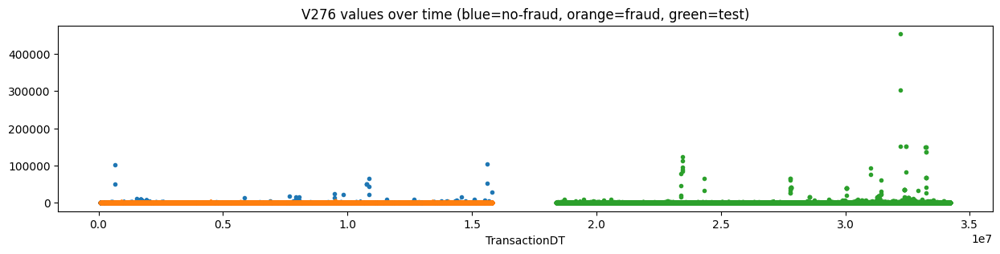

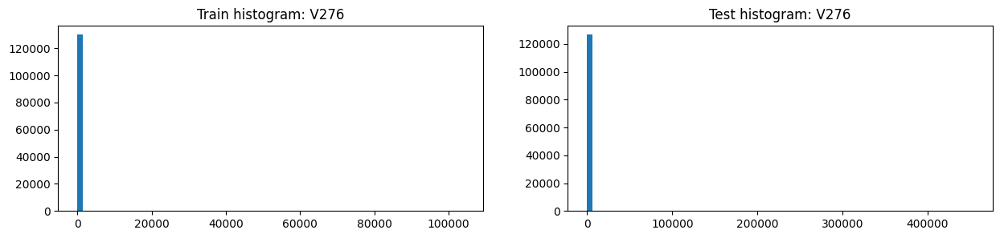

,V276,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,31.797277,52.268202,30.062054,69.708952,32.881038,75.191389
2,std,615.659714,207.245465,638.347369,2250.666029,241.201938,2410.538157
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,104060.000000,4500.000000,104060.000000,453750.000000,10000.000000,453750.000000
8,unique values,2264.000000,506.000000,2014.000000,1963.000000,425.000000,1804.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V276,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,117724,0.067854,7988,114010.0
2,100.0,1265,0.086166,109,1040.0
3,200.0,919,0.130577,120,852.0
4,150.0,681,0.176211,120,538.0
5,50.0,650,0.106154,69,511.0
6,300.0,620,0.224194,139,532.0
7,400.0,323,0.160991,52,503.0
8,250.0,301,0.079734,24,371.0
9,600.0,272,0.224265,61,277.0


,V276,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,117724,0.067854,7988,114010
2,300.0,620,0.224194,139,532
3,200.0,919,0.130577,120,852
4,150.0,681,0.176211,120,538
5,100.0,1265,0.086166,109,1040
6,50.0,650,0.106154,69,511
7,600.0,272,0.224265,61,277
8,450.0,155,0.380645,59,90
9,400.0,323,0.160991,52,503


,Column,Correlation with V276
0,V276,1.000000
1,V214,0.990600
2,V278,0.949781
3,V216,0.949140
4,V215,0.929874
5,V319,0.882619
342,V51,-0.084263
343,V16,-0.085359
344,V34,-0.088040
345,V15,-0.092417


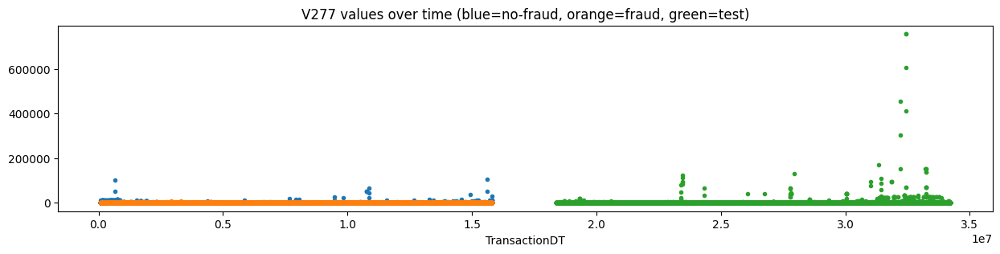

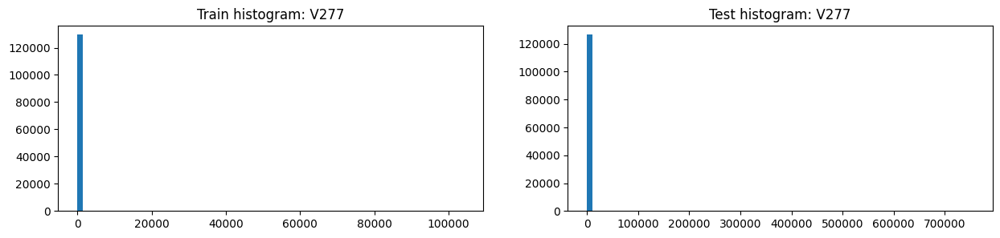

,V277,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,51.956645,78.958558,49.667822,115.530497,42.505812,126.401416
2,std,732.145368,307.370447,757.231698,4376.075400,400.039240,4687.869829
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,17.106775,0.000000,0.000000,0.000000,0.000000
7,max,104060.000000,6390.000000,104060.000000,756250.000000,19200.000000,756250.000000
8,unique values,2541.000000,593.000000,2256.000000,2229.000000,497.000000,2047.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V277,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,115566,0.063842,7378,111713.0
2,100.0,1339,0.091860,123,1097.0
3,200.0,969,0.121775,118,891.0
4,50.0,729,0.098765,72,563.0
5,150.0,710,0.176056,125,556.0
6,300.0,646,0.207430,134,576.0
7,400.0,360,0.180556,65,524.0
8,250.0,306,0.078431,24,388.0
9,600.0,298,0.244966,73,294.0


,V277,Count in train,Mean target,Sum target (desc),Count in test
0,-999.000000,460110,0.022758,10471,379963.0
1,0.000000,115566,0.063842,7378,111713.0
2,300.000000,646,0.207430,134,576.0
3,150.000000,710,0.176056,125,556.0
4,100.000000,1339,0.091860,123,1097.0
5,200.000000,969,0.121775,118,891.0
6,600.000000,298,0.244966,73,294.0
7,50.000000,729,0.098765,72,563.0
8,400.000000,360,0.180556,65,524.0
9,176.426407,52,0.980769,51,NaN


,Column,Correlation with V277
0,V277,1.000000
1,V215,0.950580
2,V278,0.948989
3,V216,0.939314
4,V214,0.891647
5,V276,0.865981
342,V34,-0.138295
343,V15,-0.145126
344,V61,-0.145681
345,V33,-0.147019


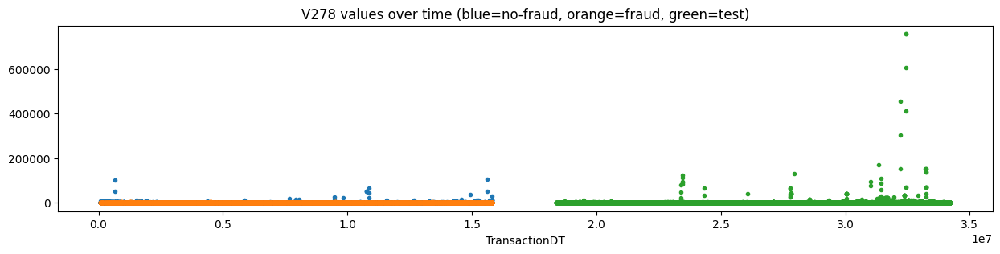

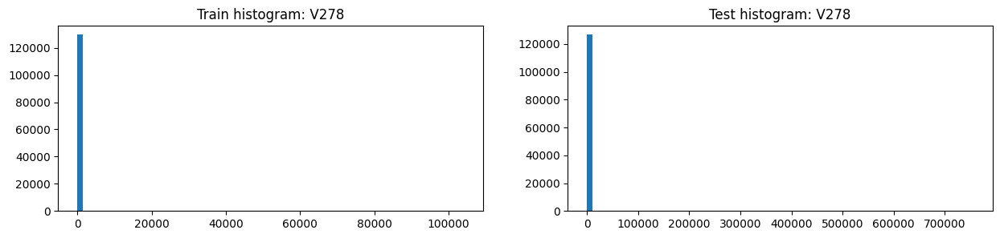

,V278,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,130430.000000,10192.000000,120238.000000,126728.000000,16421.000000,110307.000000
1,mean,42.328228,65.108035,40.397293,99.519602,35.995625,108.976184
2,std,660.611820,247.687530,684.217058,4313.107711,254.757050,4621.895439
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,104060.000000,4500.000000,104060.000000,756250.000000,10000.000000,756250.000000
8,unique values,2399.000000,552.000000,2126.000000,2081.000000,456.000000,1919.000000
9,NaNs,460110.000000,10471.000000,449639.000000,379963.000000,84918.000000,295046.000000


,V278,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,460110,0.022758,10471,379963.0
1,0.0,116709,0.065813,7681,112917.0
2,100.0,1295,0.088803,115,1060.0
3,200.0,949,0.124341,118,882.0
4,150.0,694,0.175793,122,552.0
5,50.0,687,0.107715,74,548.0
6,300.0,644,0.228261,147,560.0
7,400.0,342,0.175439,60,502.0
8,250.0,303,0.079208,24,382.0
9,600.0,286,0.227273,65,284.0


,V278,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,460110,0.022758,10471,379963
1,0.0,116709,0.065813,7681,112917
2,300.0,644,0.228261,147,560
3,150.0,694,0.175793,122,552
4,200.0,949,0.124341,118,882
5,100.0,1295,0.088803,115,1060
6,50.0,687,0.107715,74,548
7,600.0,286,0.227273,65,284
8,400.0,342,0.175439,60,502
9,450.0,159,0.345912,55,88


,Column,Correlation with V278
0,V278,1.000000
1,V216,0.984444
2,V215,0.971923
3,V276,0.949781
4,V277,0.948989
5,V214,0.941354
342,V57,-0.127721
343,V15,-0.130578
344,V33,-0.132274
345,V61,-0.137160


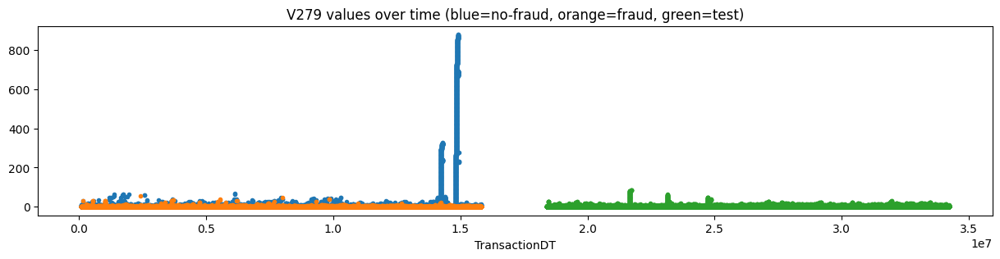

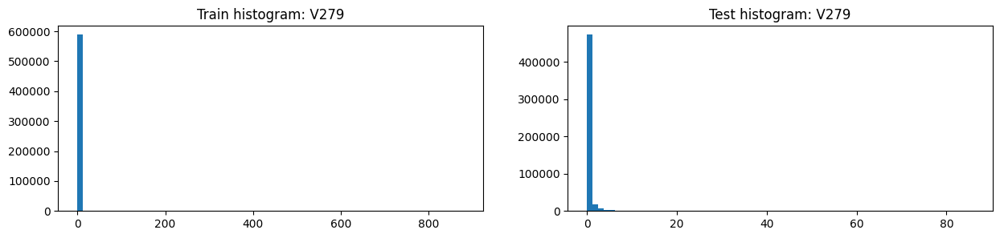

,V279,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,1.123061,0.708920,1.138076,0.338571,0.362319,0.332634
2,std,21.021950,1.894142,21.396452,1.320341,1.771958,1.180679
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,880.000000,55.000000,880.000000,86.000000,86.000000,62.000000
8,unique values,882.000000,39.000000,882.000000,88.000000,88.000000,63.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V279,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,492169,0.028626,14089,418709.0
1,1.0,60474,0.059149,3577,54339.0
2,2.0,18826,0.072825,1371,17106.0
3,3.0,8016,0.085454,685,7260.0
4,4.0,4030,0.089826,362,3691.0
5,5.0,2103,0.095102,200,1927.0
6,6.0,1235,0.095547,118,1129.0
7,7.0,736,0.110054,81,723.0
8,8.0,449,0.106904,48,458.0
9,9.0,295,0.108475,32,320.0


,V279,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,492169,0.028626,14089,418709
1,1.0,60474,0.059149,3577,54339
2,2.0,18826,0.072825,1371,17106
3,3.0,8016,0.085454,685,7260
4,4.0,4030,0.089826,362,3691
5,5.0,2103,0.095102,200,1927
6,6.0,1235,0.095547,118,1129
7,7.0,736,0.110054,81,723
8,8.0,449,0.106904,48,458
9,9.0,295,0.108475,32,320


,Column,Correlation with V279
0,V279,1.000000
1,V322,0.999624
2,V293,0.999568
3,V95,0.998710
4,V101,0.998454
5,V132,0.994182
375,V155,-0.132419
376,D5,-0.136135
377,V148,-0.136824
378,V154,-0.144055


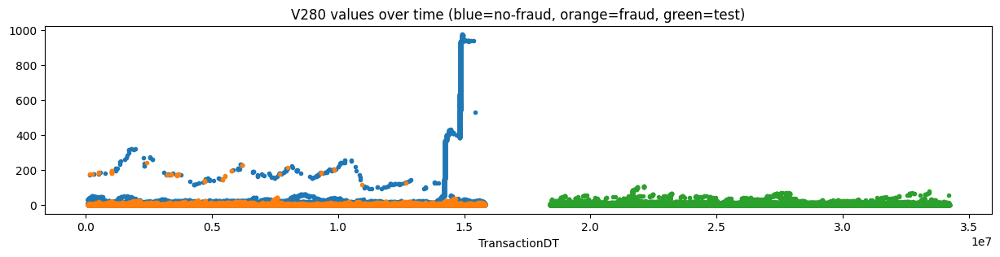

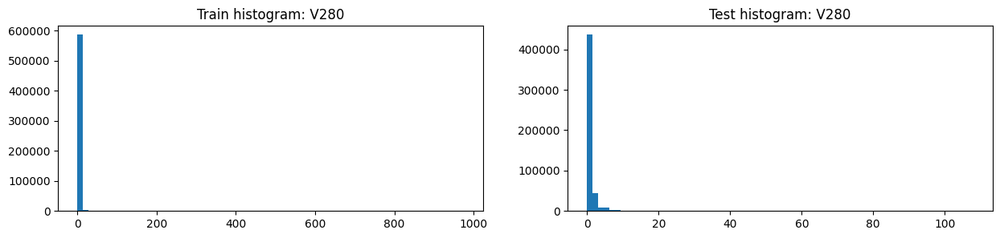

,V280,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,1.967082,1.852669,1.971230,0.744304,0.799943,0.730393
2,std,27.851780,8.797109,28.302649,2.376751,2.596933,2.318234
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,975.000000,243.000000,975.000000,108.000000,89.000000,108.000000
8,unique values,976.000000,82.000000,976.000000,110.000000,91.000000,92.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V280,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,422464,0.027337,11549,356312.0
1,1.0,90882,0.040778,3706,80039.0
2,2.0,32870,0.052997,1742,30342.0
3,3.0,15309,0.067477,1033,14444.0
4,4.0,8340,0.078297,653,7916.0
5,5.0,5173,0.085057,440,5000.0
6,6.0,3411,0.092935,317,3303.0
7,7.0,2324,0.098537,229,2206.0
8,8.0,1618,0.110630,179,1557.0
9,9.0,1219,0.118950,145,1131.0


,V280,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,422464,0.027337,11549,356312
1,1.0,90882,0.040778,3706,80039
2,2.0,32870,0.052997,1742,30342
3,3.0,15309,0.067477,1033,14444
4,4.0,8340,0.078297,653,7916
5,5.0,5173,0.085057,440,5000
6,6.0,3411,0.092935,317,3303
7,7.0,2324,0.098537,229,2206
8,8.0,1618,0.110630,179,1557
9,9.0,1219,0.118950,145,1131


,Column,Correlation with V280
0,V280,1.000000
1,V324,0.999464
2,V295,0.998623
3,V323,0.992798
4,V333,0.990866
5,V318,0.990648
375,V155,-0.150482
376,V148,-0.155491
377,V10,-0.156717
378,V154,-0.163695


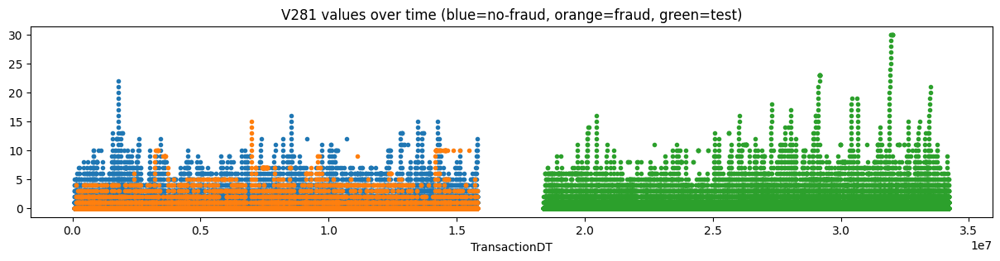

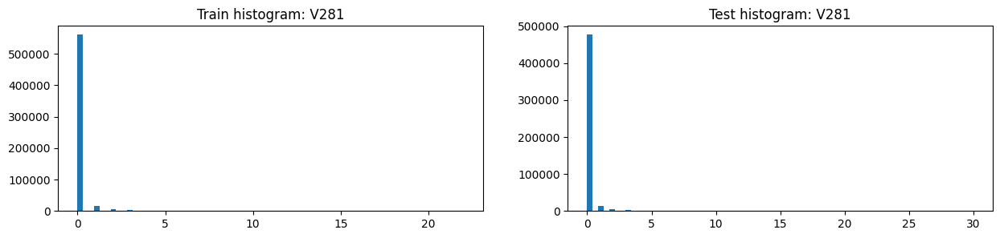

,V281,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,589271.000000,20617.000000,568654.000000,500660.000000,100922.000000,399739.000000
1,mean,0.087783,0.283358,0.080692,0.092492,0.081271,0.095325
2,std,0.512748,0.996906,0.484742,0.587742,0.486736,0.610574
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,22.000000,15.000000,22.000000,30.000000,16.000000,30.000000
8,unique values,24.000000,17.000000,24.000000,32.000000,18.000000,32.000000
9,NaNs,1269.000000,46.000000,1223.000000,6031.000000,417.000000,5614.000000


,V281,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,561201,0.032149,18042,476893
1,1.0,16896,0.072917,1232,14399
2,2.0,5694,0.101862,580,4430
3,3.0,2484,0.106683,265,2092
4,4.0,1469,0.187883,276,1227
5,-999.0,1269,0.036249,46,6031
6,5.0,604,0.132450,80,566
7,6.0,351,0.076923,27,371
8,7.0,225,0.222222,50,187
9,8.0,102,0.039216,4,149


,V281,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,561201,0.032149,18042,476893
1,1.0,16896,0.072917,1232,14399
2,2.0,5694,0.101862,580,4430
3,4.0,1469,0.187883,276,1227
4,3.0,2484,0.106683,265,2092
5,5.0,604,0.132450,80,566
6,7.0,225,0.222222,50,187
7,-999.0,1269,0.036249,46,6031
8,10.0,86,0.441860,38,65
9,6.0,351,0.076923,27,371


,Column,Correlation with V281
0,V281,1.000000
1,V282,0.636122
2,V55,0.528348
3,V169,0.510292
4,V138,0.504366
5,V283,0.481994
375,D15,-0.094841
376,D1,-0.096495
377,D3,-0.096940
378,D7,-0.124897


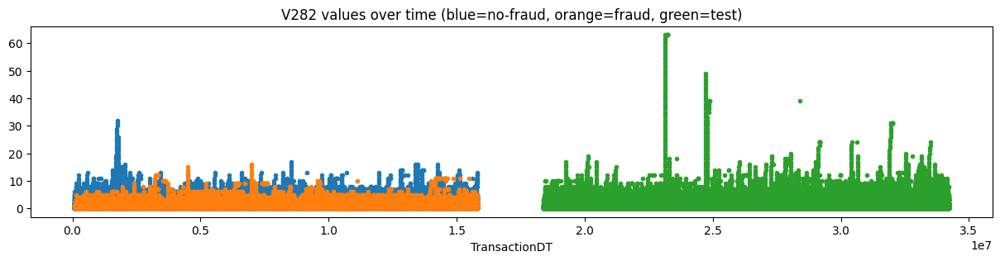

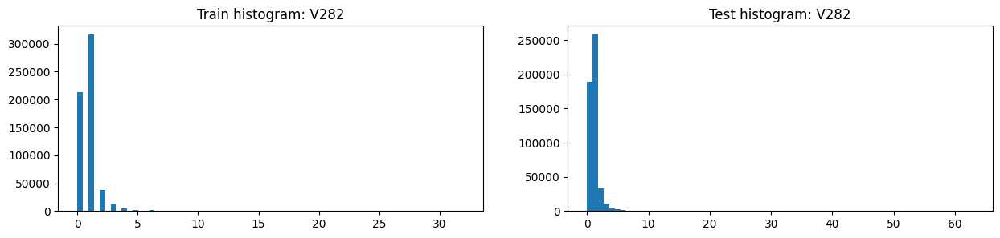

,V282,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,589271.000000,20617.000000,568654.000000,500660.000000,100922.000000,399739.000000
1,mean,0.817171,1.321288,0.798894,0.825470,0.769456,0.839610
2,std,0.921880,1.329711,0.898346,1.154029,0.956744,1.198302
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,32.000000,16.000000,32.000000,63.000000,19.000000,63.000000
8,unique values,34.000000,18.000000,34.000000,65.000000,21.000000,65.000000
9,NaNs,1269.000000,46.000000,1223.000000,6031.000000,417.000000,5614.000000


,V282,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,316455,0.037983,12020,258242
1,0.0,212812,0.016714,3557,189170
2,2.0,37537,0.074220,2786,32735
3,3.0,12243,0.088132,1079,10738
4,4.0,4976,0.097468,485,4369
5,5.0,2525,0.125545,317,2378
6,-999.0,1269,0.036249,46,6031
7,6.0,1130,0.141593,160,1068
8,7.0,652,0.090491,59,604
9,8.0,312,0.073718,23,377


,V282,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,316455,0.037983,12020,258242
1,0.0,212812,0.016714,3557,189170
2,2.0,37537,0.074220,2786,32735
3,3.0,12243,0.088132,1079,10738
4,4.0,4976,0.097468,485,4369
5,5.0,2525,0.125545,317,2378
6,6.0,1130,0.141593,160,1068
7,9.0,242,0.247934,60,264
8,7.0,652,0.090491,59,604
9,-999.0,1269,0.036249,46,6031


,Column,Correlation with V282
0,V282,1.000000
1,V283,0.710173
2,V281,0.636122
3,V139,0.628419
4,V140,0.610257
5,V55,0.487665
375,D4,-0.344152
376,D11,-0.366522
377,D15,-0.384283
378,D2,-0.453760


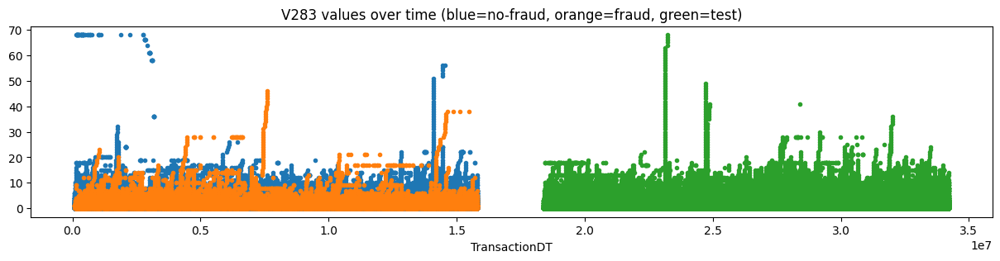

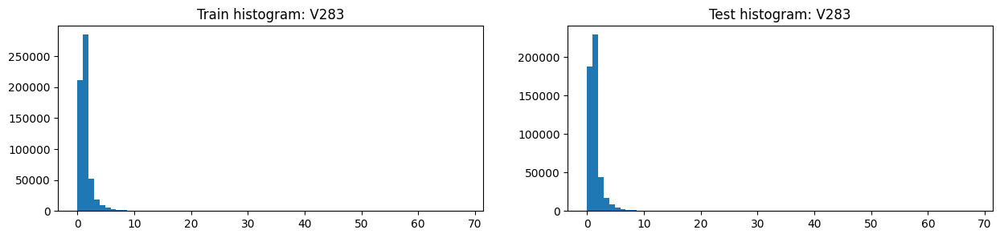

,V283,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,589271.000000,20617.000000,568654.000000,500660.000000,100922.000000,399739.000000
1,mean,0.991114,1.913955,0.957656,1.007614,0.947762,1.022722
2,std,1.558731,2.932971,1.474404,1.560327,1.417323,1.594050
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.000000,1.000000,1.000000,1.000000,1.000000
7,max,68.000000,46.000000,68.000000,68.000000,19.000000,68.000000
8,unique values,63.000000,48.000000,63.000000,70.000000,21.000000,70.000000
9,NaNs,1269.000000,46.000000,1223.000000,6031.000000,417.000000,5614.000000


,V283,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,284599,0.035601,10132,229390
1,0.0,211499,0.016648,3521,188164
2,2.0,51773,0.057907,2998,44471
3,3.0,18984,0.072061,1368,17017
4,4.0,8912,0.090664,808,8297
5,5.0,4955,0.112614,558,4503
6,6.0,2847,0.106077,302,2767
7,7.0,1720,0.104651,180,1707
8,-999.0,1269,0.036249,46,6031
9,8.0,1118,0.132379,148,1058


,V283,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,284599,0.035601,10132,229390
1,0.0,211499,0.016648,3521,188164
2,2.0,51773,0.057907,2998,44471
3,3.0,18984,0.072061,1368,17017
4,4.0,8912,0.090664,808,8297
5,5.0,4955,0.112614,558,4503
6,6.0,2847,0.106077,302,2767
7,7.0,1720,0.104651,180,1707
8,8.0,1118,0.132379,148,1058
9,9.0,661,0.164902,109,761


,Column,Correlation with V283
0,V283,1.000000
1,V282,0.710173
2,V140,0.610185
3,V139,0.596926
4,V289,0.554250
5,V281,0.481994
375,D4,-0.235371
376,D15,-0.263264
377,D11,-0.266716
378,D1,-0.355794


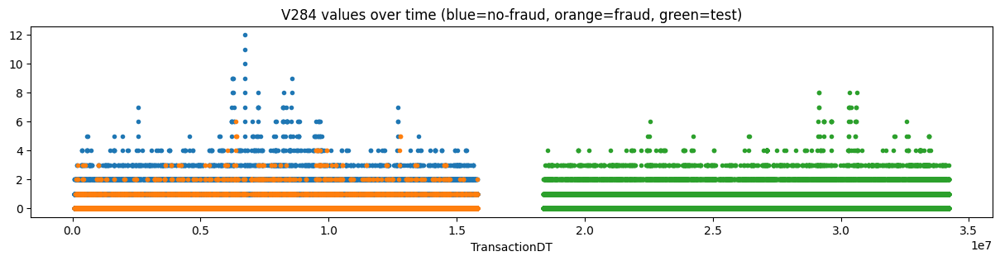

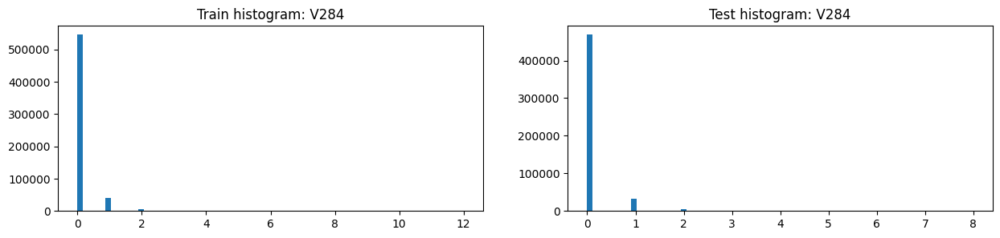

,V284,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,0.088543,0.151300,0.086267,0.087103,0.083870,0.087911
2,std,0.338424,0.435648,0.334147,0.332353,0.318415,0.335742
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,12.000000,6.000000,12.000000,8.000000,4.000000,8.000000
8,unique values,14.000000,8.000000,14.000000,10.000000,6.000000,9.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V284,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,545552,0.033047,18029,468718.0
1,1.0,39347,0.057082,2246,33057.0
2,2.0,4481,0.067396,302,3926.0
3,3.0,846,0.079196,67,818.0
4,4.0,190,0.057895,11,119.0
5,5.0,49,0.102041,5,21.0
6,6.0,34,0.029412,1,17.0
7,7.0,15,0.000000,0,8.0
8,-999.0,12,0.166667,2,3.0
9,8.0,6,0.000000,0,4.0


,V284,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,545552,0.033047,18029,468718
1,1.0,39347,0.057082,2246,33057
2,2.0,4481,0.067396,302,3926
3,3.0,846,0.079196,67,818
4,4.0,190,0.057895,11,119
5,5.0,49,0.102041,5,21
6,-999.0,12,0.166667,2,3
7,6.0,34,0.029412,1,17
8,7.0,15,0.000000,0,8
9,8.0,6,0.000000,0,4


,Column,Correlation with V284
0,V284,1.000000
1,V325,0.920235
2,V98,0.792611
3,V223,0.621895
4,V286,0.566142
5,V327,0.541879
375,D8,-0.110103
376,D5,-0.141546
377,D3,-0.158400
378,D2,-0.166045


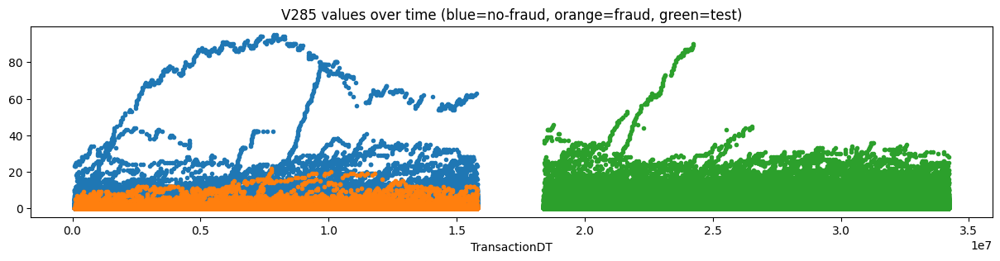

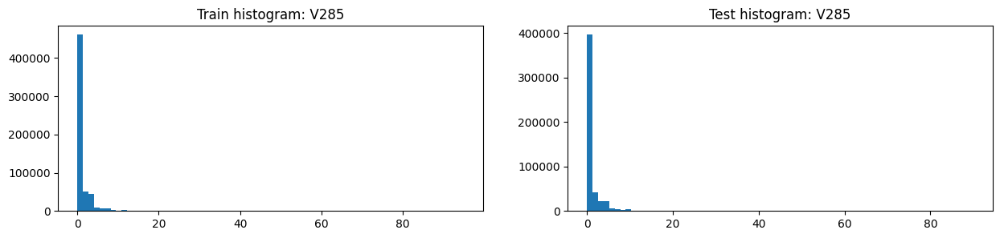

,V285,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,1.167660,1.010309,1.173365,1.150909,1.224175,1.132598
2,std,3.282454,2.203654,3.314839,2.724523,2.742624,2.719672
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,95.000000,22.000000,95.000000,90.000000,53.000000,90.000000
8,unique values,97.000000,24.000000,97.000000,92.000000,55.000000,91.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V285,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,354815,0.038147,13535,303975.0
1,1.0,106275,0.029461,3131,92384.0
2,2.0,50008,0.028016,1401,42284.0
3,3.0,26969,0.026957,727,22334.0
4,4.0,17739,0.029145,517,14754.0
5,5.0,9923,0.033256,330,8034.0
6,6.0,6596,0.044421,293,5654.0
7,7.0,4390,0.035991,158,3761.0
8,8.0,3130,0.036422,114,2741.0
9,9.0,2329,0.044654,104,2105.0


,V285,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,354815,0.038147,13535,303975
1,1.0,106275,0.029461,3131,92384
2,2.0,50008,0.028016,1401,42284
3,3.0,26969,0.026957,727,22334
4,4.0,17739,0.029145,517,14754
5,5.0,9923,0.033256,330,8034
6,6.0,6596,0.044421,293,5654
7,7.0,4390,0.035991,158,3761
8,8.0,3130,0.036422,114,2741
9,9.0,2329,0.044654,104,2105


,Column,Correlation with V285
0,V285,1.000000
1,V326,0.959617
2,V327,0.903144
3,V99,0.858606
4,V287,0.830789
5,V329,0.781126
375,V149,-0.220170
376,V155,-0.227600
377,V148,-0.235145
378,V154,-0.246717


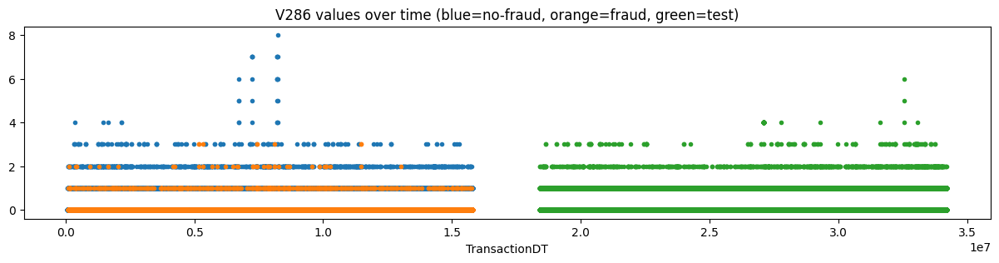

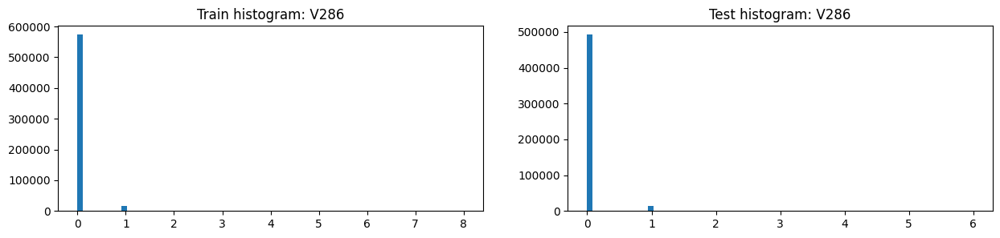

,V286,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,0.031492,0.035913,0.031332,0.030628,0.026220,0.031730
2,std,0.190939,0.202758,0.190495,0.189638,0.174094,0.193312
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,8.000000,3.000000,8.000000,6.000000,3.000000,6.000000
8,unique values,10.000000,5.000000,10.000000,8.000000,5.000000,7.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V286,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,573290,0.034848,19978,492506.0
1,1.0,16122,0.039201,632,13058.0
2,2.0,949,0.045311,43,946.0
3,3.0,136,0.058824,8,146.0
4,-999.0,12,0.166667,2,3.0
5,4.0,11,0.000000,0,30.0
6,7.0,8,0.000000,0,NaN
7,6.0,6,0.000000,0,1.0
8,5.0,5,0.000000,0,1.0
9,8.0,1,0.000000,0,NaN


,V286,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,573290,0.034848,19978,492506.0
1,1.0,16122,0.039201,632,13058.0
2,2.0,949,0.045311,43,946.0
3,3.0,136,0.058824,8,146.0
4,-999.0,12,0.166667,2,3.0
5,4.0,11,0.000000,0,30.0
6,7.0,8,0.000000,0,NaN
7,6.0,6,0.000000,0,1.0
8,5.0,5,0.000000,0,1.0
9,8.0,1,0.000000,0,NaN


,Column,Correlation with V286
0,V286,1.000000
1,V173,0.755792
2,V284,0.566142
3,V223,0.542893
4,V325,0.531711
5,V174,0.430125
375,D8,-0.087193
376,D5,-0.092105
377,D3,-0.097749
378,D2,-0.116178


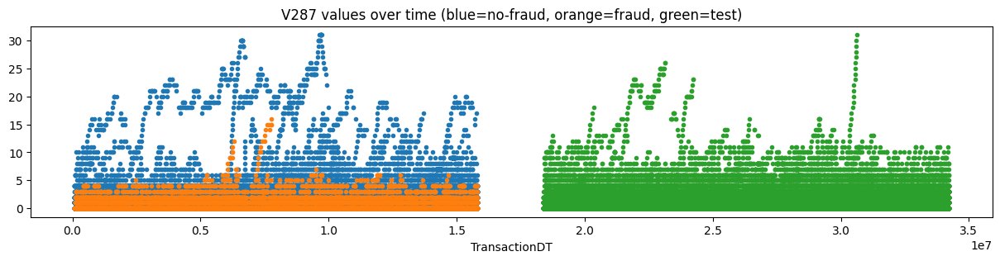

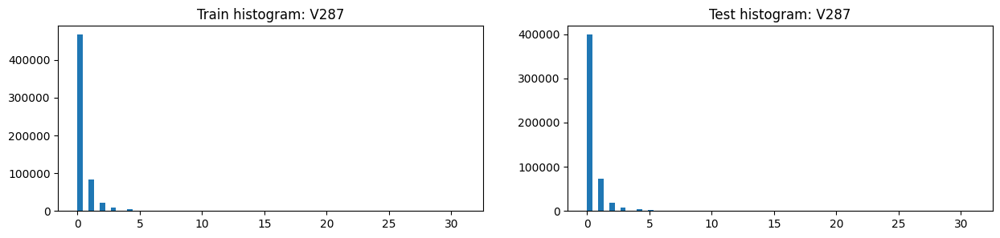

,V287,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,0.358579,0.474275,0.354384,0.353792,0.364431,0.351131
2,std,1.078995,0.999167,1.081547,0.940210,0.927710,0.943290
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,31.000000,16.000000,31.000000,31.000000,21.000000,31.000000
8,unique values,33.000000,18.000000,33.000000,33.000000,23.000000,32.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V287,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,466863,0.032099,14986,398789
1,1.0,83560,0.040366,3373,72136
2,2.0,22186,0.056477,1253,19518
3,3.0,8784,0.066940,588,7850
4,4.0,4863,0.070944,345,4666
5,9.0,1056,0.004735,5,200
6,5.0,989,0.058645,58,1503
7,7.0,683,0.008785,6,441
8,6.0,463,0.060475,28,838
9,8.0,218,0.009174,2,298


,V287,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,466863,0.032099,14986,398789
1,1.0,83560,0.040366,3373,72136
2,2.0,22186,0.056477,1253,19518
3,3.0,8784,0.066940,588,7850
4,4.0,4863,0.070944,345,4666
5,5.0,989,0.058645,58,1503
6,6.0,463,0.060475,28,838
7,7.0,683,0.008785,6,441
8,9.0,1056,0.004735,5,200
9,10.0,128,0.031250,4,149


,Column,Correlation with V287
0,V287,1.000000
1,V327,0.968657
2,V326,0.921988
3,V100,0.863856
4,V285,0.830789
5,V329,0.812145
375,V149,-0.202440
376,V155,-0.209249
377,V148,-0.216305
378,V154,-0.226713


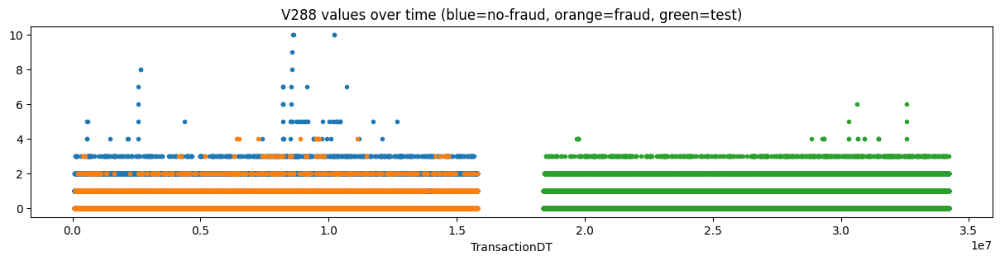

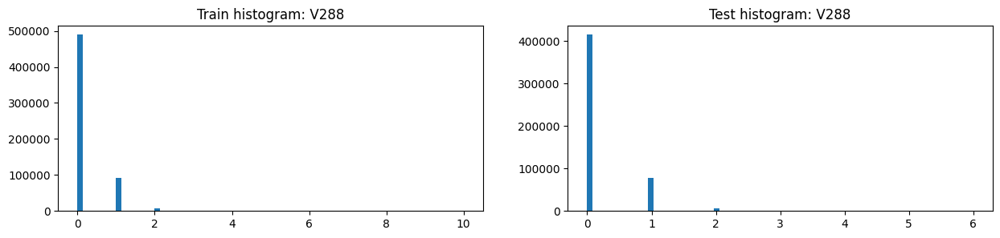

,V288,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,589271.000000,20617.000000,568654.000000,500660.000000,100922.000000,399739.000000
1,mean,0.184350,0.264296,0.181451,0.187273,0.185946,0.187607
2,std,0.430989,0.526318,0.426852,0.435739,0.435680,0.435753
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,10.000000,4.000000,10.000000,6.000000,4.000000,6.000000
8,unique values,12.000000,6.000000,12.000000,8.000000,6.000000,8.000000
9,NaNs,1269.000000,46.000000,1223.000000,6031.000000,417.000000,5614.000000


,V288,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,489641,0.032507,15917,415370.0
1,1.0,91654,0.044079,4040,77740.0
2,2.0,7133,0.081873,584,6661.0
3,-999.0,1269,0.036249,46,6031.0
4,3.0,761,0.082786,63,864.0
5,4.0,33,0.393939,13,21.0
6,5.0,29,0.000000,0,2.0
7,7.0,7,0.000000,0,NaN
8,6.0,5,0.000000,0,2.0
9,10.0,4,0.000000,0,NaN


,V288,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,489641,0.032507,15917,415370.0
1,1.0,91654,0.044079,4040,77740.0
2,2.0,7133,0.081873,584,6661.0
3,3.0,761,0.082786,63,864.0
4,-999.0,1269,0.036249,46,6031.0
5,4.0,33,0.393939,13,21.0
6,5.0,29,0.000000,0,2.0
7,7.0,7,0.000000,0,NaN
8,6.0,5,0.000000,0,2.0
9,10.0,4,0.000000,0,NaN


,Column,Correlation with V288
0,V288,1.000000
1,V289,0.888344
2,V174,0.574345
3,V313,0.513608
4,V315,0.511356
5,V327,0.504471
375,D5,-0.191218
376,D3,-0.204459
377,D1,-0.214799
378,D7,-0.235739


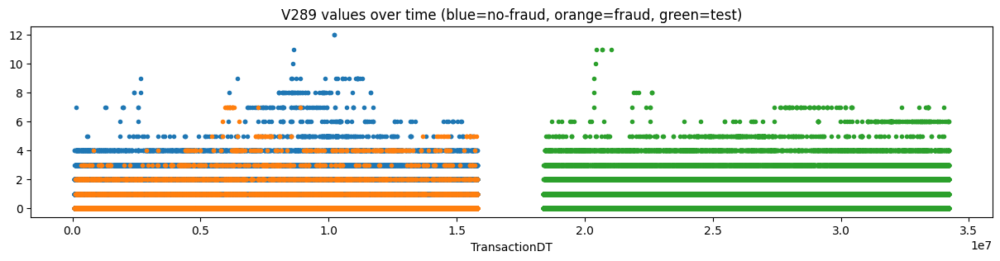

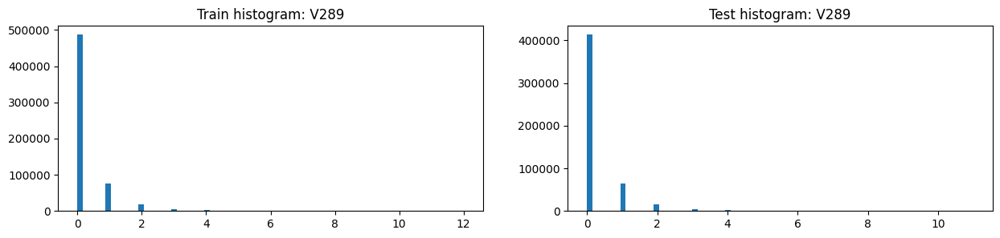

,V289,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,589271.000000,20617.000000,568654.000000,500660.000000,100922.000000,399739.000000
1,mean,0.235975,0.370131,0.231111,0.240742,0.240413,0.240825
2,std,0.599231,0.804965,0.589855,0.614691,0.615797,0.614411
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,12.000000,7.000000,12.000000,11.000000,11.000000,8.000000
8,unique values,14.000000,9.000000,14.000000,13.000000,13.000000,10.000000
9,NaNs,1269.000000,46.000000,1223.000000,6031.000000,417.000000,5614.000000


,V289,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,487073,0.032394,15778,413471.0
1,1.0,75947,0.039857,3027,64498.0
2,2.0,18920,0.063108,1194,15543.0
3,3.0,5076,0.069149,351,4501.0
4,4.0,1736,0.117512,204,2112.0
5,-999.0,1269,0.036249,46,6031.0
6,5.0,288,0.159722,46,320.0
7,7.0,82,0.182927,15,64.0
8,6.0,73,0.027397,2,138.0
9,8.0,51,0.000000,0,7.0


,V289,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,487073,0.032394,15778,413471
1,1.0,75947,0.039857,3027,64498
2,2.0,18920,0.063108,1194,15543
3,3.0,5076,0.069149,351,4501
4,4.0,1736,0.117512,204,2112
5,-999.0,1269,0.036249,46,6031
6,5.0,288,0.159722,46,320
7,7.0,82,0.182927,15,64
8,6.0,73,0.027397,2,138
9,8.0,51,0.000000,0,7


,Column,Correlation with V289
0,V289,1.000000
1,V288,0.888344
2,V315,0.560717
3,V283,0.554250
4,V314,0.533570
5,V174,0.516377
375,D5,-0.181000
376,D3,-0.191498
377,D1,-0.195403
378,D7,-0.213132


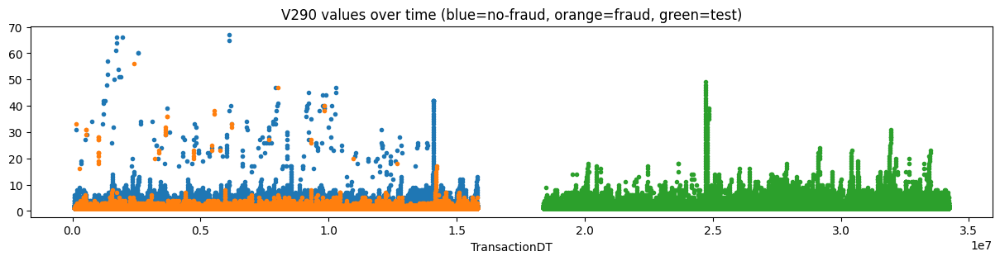

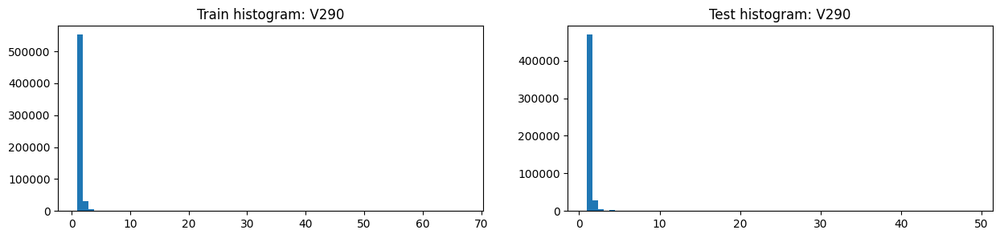

,V290,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,1.103011,1.265137,1.097133,1.119967,1.103418,1.124104
2,std,0.768897,1.433346,0.732916,0.674471,0.488160,0.713426
3,min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,67.000000,56.000000,67.000000,49.000000,18.000000,49.000000
8,unique values,59.000000,39.000000,58.000000,50.000000,19.000000,49.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V290,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,551866,0.031821,17561,469059.0
1,2.0,30249,0.076465,2313,27891.0
2,3.0,4936,0.099068,489,5353.0
3,4.0,1672,0.090311,151,2004.0
4,5.0,681,0.083700,57,887.0
5,6.0,361,0.049861,18,493.0
6,7.0,206,0.063107,13,269.0
7,8.0,130,0.038462,5,180.0
8,9.0,64,0.015625,1,113.0
9,10.0,38,0.026316,1,97.0


,V290,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,551866,0.031821,17561,469059
1,2.0,30249,0.076465,2313,27891
2,3.0,4936,0.099068,489,5353
3,4.0,1672,0.090311,151,2004
4,5.0,681,0.083700,57,887
5,6.0,361,0.049861,18,493
6,7.0,206,0.063107,13,269
7,22.0,16,0.312500,5,7
8,8.0,130,0.038462,5,180
9,27.0,12,0.333333,4,3


,Column,Correlation with V290
0,V290,1.000000
1,V292,0.817300
2,V291,0.740426
3,V56,0.663716
4,V55,0.611955
5,V228,0.407726
375,D8,-0.095167
376,V69,-0.095672
377,D7,-0.103757
378,D3,-0.110288


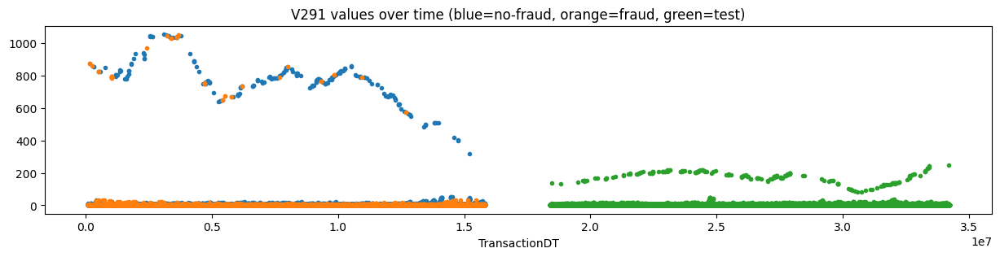

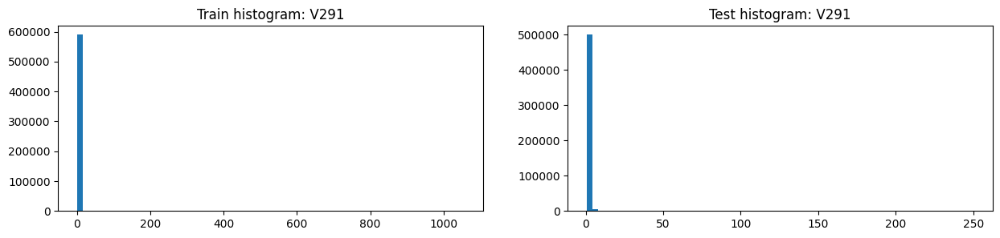

,V291,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.00000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,1.659811,3.40453,1.596555,1.405097,1.357494,1.416997
2,std,16.252538,38.56033,14.822321,3.652957,2.570961,3.876454
3,min,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000
4,25%,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.00000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,2.00000,1.000000,1.000000,1.000000,1.000000
7,max,1055.000000,1052.00000,1055.000000,250.000000,198.000000,250.000000
8,unique values,220.000000,71.00000,203.000000,146.000000,39.000000,138.000000
9,NaNs,12.000000,2.00000,10.000000,3.000000,3.000000,0.000000


,V291,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,462929,0.030469,14105,402827.0
1,2.0,92440,0.043077,3982,71871.0
2,3.0,21378,0.058518,1251,18206.0
3,4.0,7251,0.079299,575,6517.0
4,5.0,2884,0.093273,269,2957.0
5,6.0,1301,0.090699,118,1468.0
6,7.0,739,0.123139,91,902.0
7,8.0,412,0.101942,42,524.0
8,9.0,258,0.158915,41,342.0
9,10.0,145,0.179310,26,230.0


,V291,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,462929,0.030469,14105,402827
1,2.0,92440,0.043077,3982,71871
2,3.0,21378,0.058518,1251,18206
3,4.0,7251,0.079299,575,6517
4,5.0,2884,0.093273,269,2957
5,6.0,1301,0.090699,118,1468
6,7.0,739,0.123139,91,902
7,8.0,412,0.101942,42,524
8,9.0,258,0.158915,41,342
9,10.0,145,0.179310,26,230


,Column,Correlation with V291
0,V291,1.000000
1,V292,0.965462
2,V290,0.740426
3,V56,0.657934
4,V294,0.415304
5,V55,0.414929
375,V23,-0.083794
376,V154,-0.089333
377,V153,-0.092128
378,D2,-0.155741


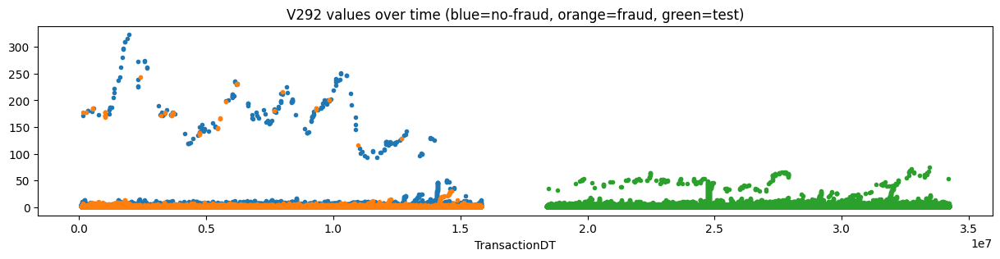

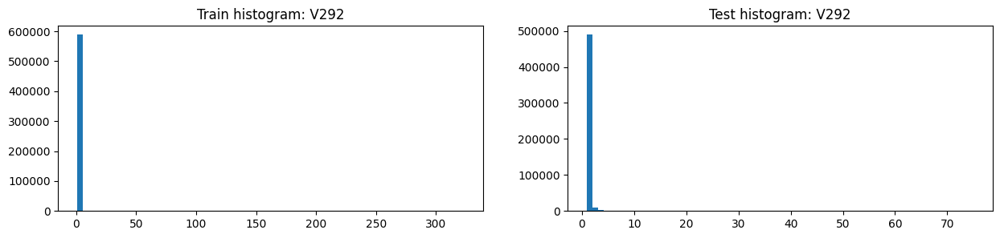

,V292,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,1.239916,1.770824,1.220667,1.211531,1.185206,1.218111
2,std,3.775050,8.173748,3.512115,1.229239,0.894880,1.299369
3,min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
4,25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
5,50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
6,75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
7,max,323.000000,244.000000,323.000000,75.000000,53.000000,75.000000
8,unique values,174.000000,62.000000,168.000000,71.000000,35.000000,70.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V292,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,522151,0.030127,15731,445283.0
1,2.0,52574,0.062883,3306,44308.0
2,3.0,9605,0.090578,870,9588.0
3,4.0,3145,0.123052,387,3499.0
4,5.0,1221,0.126126,154,1528.0
5,6.0,596,0.093960,56,788.0
6,7.0,346,0.101156,35,478.0
7,8.0,206,0.077670,16,289.0
8,9.0,145,0.124138,18,184.0
9,10.0,83,0.072289,6,132.0


,V292,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,522151,0.030127,15731,445283
1,2.0,52574,0.062883,3306,44308
2,3.0,9605,0.090578,870,9588
3,4.0,3145,0.123052,387,3499
4,5.0,1221,0.126126,154,1528
5,6.0,596,0.093960,56,788
6,7.0,346,0.101156,35,478
7,9.0,145,0.124138,18,184
8,8.0,206,0.077670,16,289
9,10.0,83,0.072289,6,132


,Column,Correlation with V292
0,V292,1.000000
1,V291,0.965462
2,V290,0.817300
3,V56,0.737437
4,V55,0.530908
5,V294,0.399304
375,V70,-0.101636
376,V10,-0.108297
377,V69,-0.112916
378,D3,-0.144654


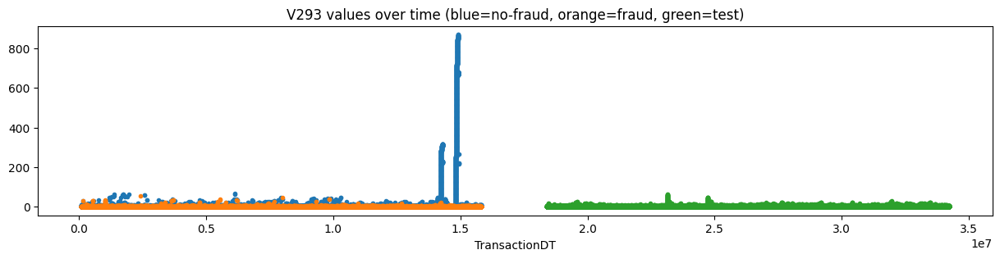

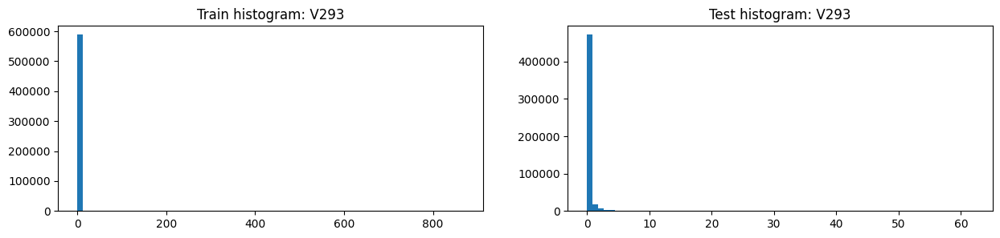

,V293,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,0.942599,0.455931,0.960243,0.156935,0.153766,0.157727
2,std,20.588816,1.713467,20.955974,0.925267,0.743585,0.965356
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,869.000000,55.000000,869.000000,62.000000,25.000000,62.000000
8,unique values,871.000000,39.000000,871.000000,64.000000,27.000000,63.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V293,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,546442,0.030129,16464,471485.0
1,1.0,24280,0.098353,2388,18679.0
2,2.0,8882,0.096487,857,7707.0
3,3.0,4188,0.095033,398,3620.0
4,4.0,2103,0.097480,205,1919.0
5,5.0,1182,0.096447,114,1065.0
6,6.0,695,0.099281,69,636.0
7,7.0,423,0.108747,46,433.0
8,8.0,255,0.094118,24,284.0
9,9.0,173,0.098266,17,200.0


,V293,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,546442,0.030129,16464,471485
1,1.0,24280,0.098353,2388,18679
2,2.0,8882,0.096487,857,7707
3,3.0,4188,0.095033,398,3620
4,4.0,2103,0.097480,205,1919
5,5.0,1182,0.096447,114,1065
6,6.0,695,0.099281,69,636
7,7.0,423,0.108747,46,433
8,8.0,255,0.094118,24,284
9,9.0,173,0.098266,17,200


,Column,Correlation with V293
0,V293,1.000000
1,V279,0.999568
2,V322,0.999403
3,V101,0.998919
4,V95,0.998475
5,V132,0.994567
375,V149,-0.126851
376,V155,-0.130924
377,V148,-0.135292
378,V154,-0.142470


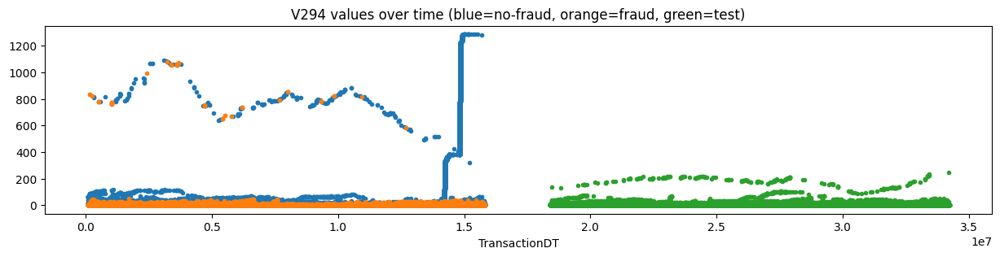

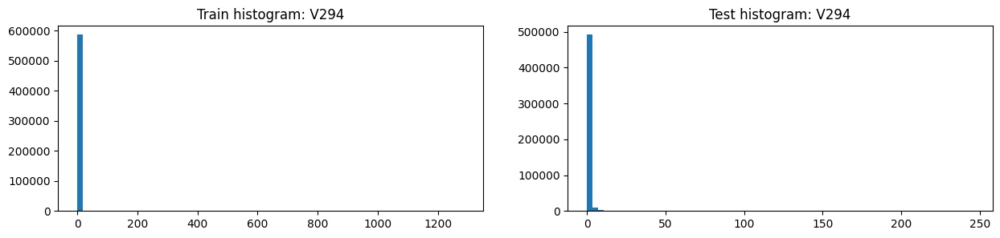

,V294,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,2.313863,3.194134,2.281948,0.456154,0.462856,0.454478
2,std,39.526468,38.656394,39.557319,4.287307,3.324066,4.495980
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,1286.000000,1078.000000,1286.000000,246.000000,201.000000,246.000000
8,unique values,1287.000000,89.000000,1287.000000,191.000000,94.000000,182.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V294,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,519413,0.027015,14032,452784.0
1,1.0,29582,0.088736,2625,22555.0
2,2.0,13719,0.086158,1182,10892.0
3,3.0,7490,0.089052,667,5957.0
4,4.0,4576,0.088287,404,3690.0
5,5.0,2817,0.096557,272,2395.0
6,6.0,2014,0.091857,185,1649.0
7,7.0,1519,0.105332,160,1193.0
8,8.0,1102,0.108893,120,940.0
9,9.0,837,0.115890,97,723.0


,V294,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,519413,0.027015,14032,452784
1,1.0,29582,0.088736,2625,22555
2,2.0,13719,0.086158,1182,10892
3,3.0,7490,0.089052,667,5957
4,4.0,4576,0.088287,404,3690
5,5.0,2817,0.096557,272,2395
6,6.0,2014,0.091857,185,1649
7,7.0,1519,0.105332,160,1193
8,8.0,1102,0.108893,120,940
9,9.0,837,0.115890,97,723


,Column,Correlation with V294
0,V294,1.000000
1,V323,0.998592
2,V332,0.994633
3,V324,0.989226
4,V333,0.983708
5,V317,0.983119
375,V149,-0.138251
376,V155,-0.142694
377,V148,-0.147437
378,V154,-0.155243


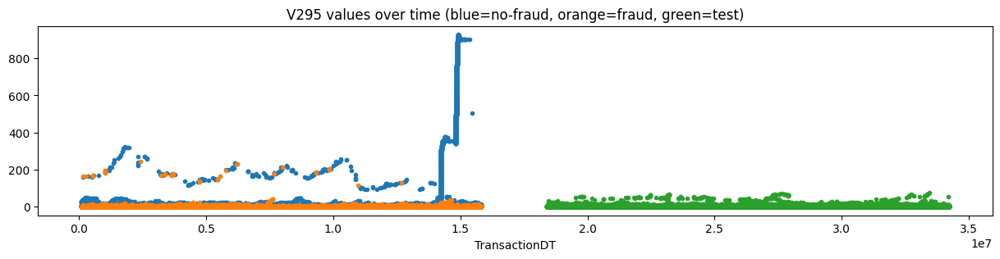

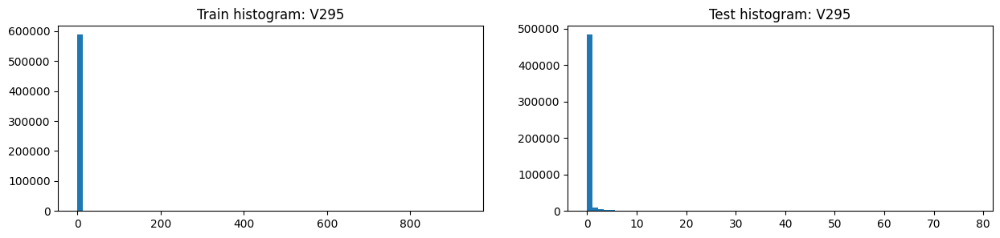

,V295,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,1.433424,1.204153,1.441736,0.258579,0.263579,0.257329
2,std,25.962948,8.524928,26.379483,1.624787,1.372440,1.681965
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,928.000000,243.000000,928.000000,78.000000,56.000000,78.000000
8,unique values,929.000000,84.000000,929.000000,73.000000,50.000000,72.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V295,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,535074,0.028159,15067,463263.0
1,1.0,25973,0.097986,2545,19919.0
2,2.0,11104,0.096001,1066,9178.0
3,3.0,5694,0.100457,572,4785.0
4,4.0,3182,0.105908,337,2804.0
5,5.0,2004,0.112275,225,1781.0
6,6.0,1365,0.126007,172,1179.0
7,7.0,959,0.125130,120,812.0
8,8.0,702,0.136752,96,606.0
9,9.0,539,0.163265,88,440.0


,V295,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,535074,0.028159,15067,463263
1,1.0,25973,0.097986,2545,19919
2,2.0,11104,0.096001,1066,9178
3,3.0,5694,0.100457,572,4785
4,4.0,3182,0.105908,337,2804
5,5.0,2004,0.112275,225,1781
6,6.0,1365,0.126007,172,1179
7,7.0,959,0.125130,120,812
8,8.0,702,0.136752,96,606
9,9.0,539,0.163265,88,440


,Column,Correlation with V295
0,V295,1.000000
1,V324,0.998827
2,V280,0.998623
3,V323,0.993571
4,V318,0.991884
5,V333,0.990713
375,V149,-0.142526
376,V155,-0.147110
377,V148,-0.152002
378,V154,-0.160061


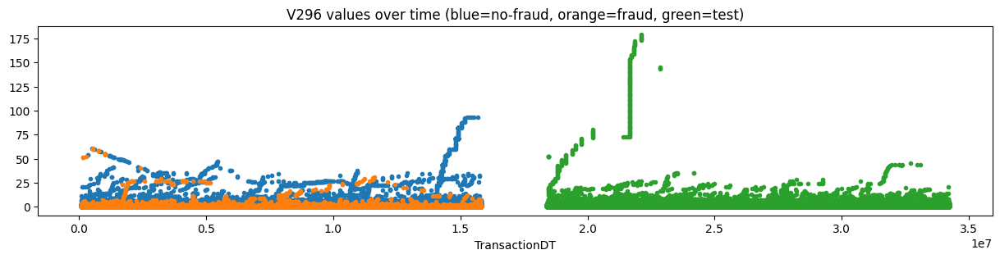

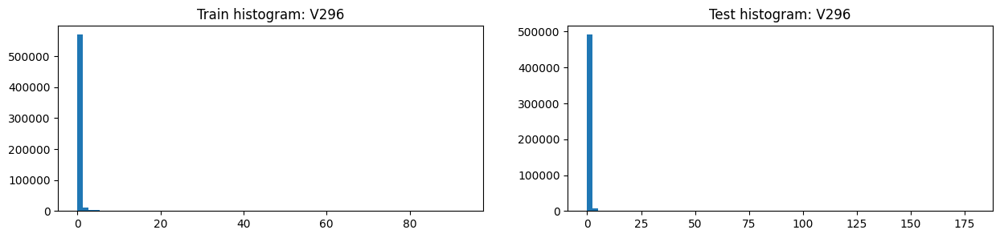

,V296,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,589271.000000,20617.000000,568654.000000,500660.000000,100922.000000,399739.000000
1,mean,0.328917,0.400252,0.326330,0.242122,0.358623,0.212709
2,std,3.264745,2.481276,3.289619,2.259073,3.892761,1.600554
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,93.000000,61.000000,93.000000,179.000000,158.000000,179.000000
8,unique values,95.000000,40.000000,95.000000,181.000000,160.000000,71.000000
9,NaNs,1269.000000,46.000000,1223.000000,6031.000000,417.000000,5614.000000


,V296,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,536687,0.033737,18106,446958
1,1.0,32376,0.042902,1389,33325
2,2.0,10099,0.042083,425,11061
3,3.0,3586,0.075293,270,4007
4,4.0,1620,0.063580,103,1806
5,-999.0,1269,0.036249,46,6031
6,5.0,893,0.097424,87,1040
7,71.0,871,0.000000,0,1
8,6.0,609,0.041051,25,512
9,7.0,336,0.047619,16,445


,V296,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,536687,0.033737,18106,446958
1,1.0,32376,0.042902,1389,33325
2,2.0,10099,0.042083,425,11061
3,3.0,3586,0.075293,270,4007
4,4.0,1620,0.063580,103,1806
5,5.0,893,0.097424,87,1040
6,-999.0,1269,0.036249,46,6031
7,27.0,103,0.300971,31,11
8,6.0,609,0.041051,25,512
9,8.0,239,0.092050,22,308


,Column,Correlation with V296
0,V296,1.000000
1,V298,0.991666
2,V329,0.991243
3,V105,0.959819
4,V330,0.956443
5,V324,0.949447
375,V149,-0.161570
376,V155,-0.167090
377,V148,-0.172742
378,V154,-0.181656


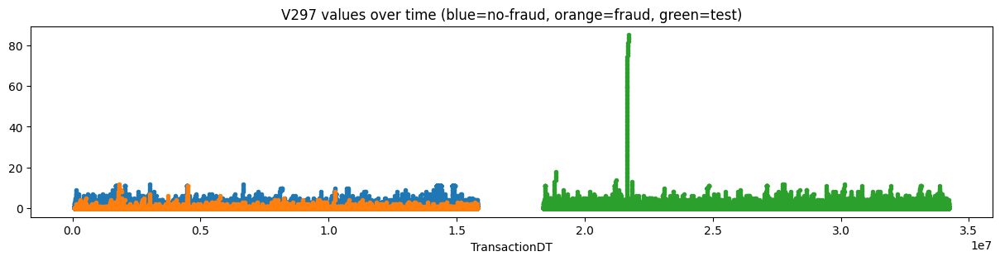

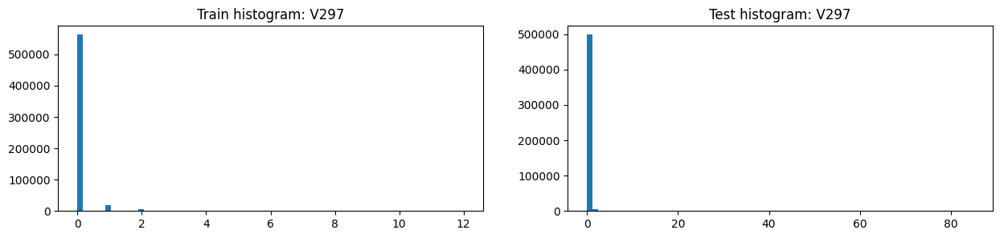

,V297,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,0.089034,0.097382,0.088731,0.090622,0.121753,0.082839
2,std,0.628352,0.504005,0.632400,0.775113,1.512742,0.422627
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,12.000000,12.000000,12.000000,85.000000,85.000000,13.000000
8,unique values,14.000000,14.000000,14.000000,87.000000,87.000000,14.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V297,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,562740,0.034430,19375,478167
1,1.0,19398,0.047170,915,20504
2,2.0,4605,0.049077,226,5068
3,3.0,1435,0.055052,79,1626
4,11.0,1299,0.003849,5,40
5,4.0,519,0.048170,25,597
6,5.0,240,0.045833,11,276
7,6.0,123,0.056911,7,128
8,7.0,74,0.054054,4,75
9,8.0,41,0.097561,4,51


,V297,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,562740,0.034430,19375,478167
1,1.0,19398,0.047170,915,20504
2,2.0,4605,0.049077,226,5068
3,3.0,1435,0.055052,79,1626
4,4.0,519,0.048170,25,597
5,5.0,240,0.045833,11,276
6,6.0,123,0.056911,7,128
7,9.0,31,0.193548,6,23
8,11.0,1299,0.003849,5,40
9,7.0,74,0.054054,4,75


,Column,Correlation with V297
0,V297,1.000000
1,V328,0.967934
2,V330,0.938134
3,V104,0.917608
4,V329,0.897362
5,V299,0.894365
375,V250,-0.138185
376,V155,-0.142777
377,V148,-0.147098
378,V154,-0.153695


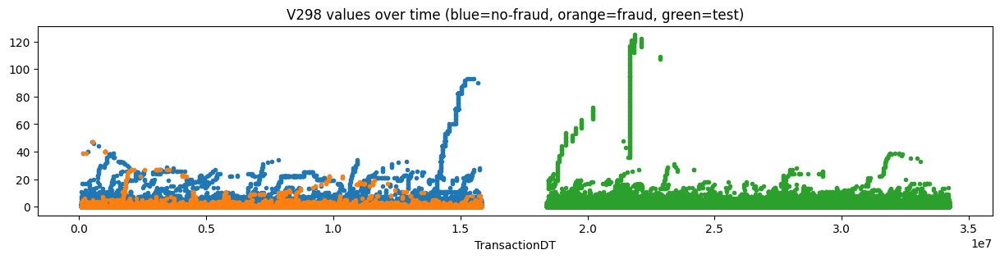

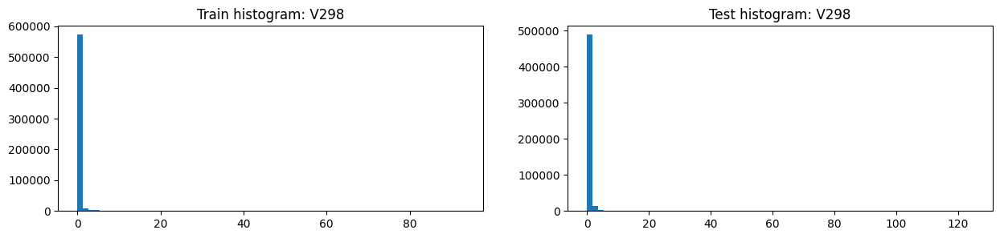

,V298,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,0.298829,0.320410,0.298047,0.201655,0.284223,0.181013
2,std,3.175062,1.848509,3.212883,1.680034,2.842414,1.227283
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,93.000000,47.000000,93.000000,125.000000,121.000000,125.000000
8,unique values,95.000000,32.000000,95.000000,127.000000,123.000000,57.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V298,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,542892,0.033657,18272,458214
1,1.0,29739,0.045899,1365,30854
2,2.0,9068,0.047861,434,9644
3,3.0,3101,0.073202,227,3566
4,4.0,1410,0.065957,93,1509
5,71.0,871,0.000000,0,2
6,5.0,821,0.097442,80,880
7,6.0,462,0.043290,20,422
8,7.0,302,0.046358,14,344
9,33.0,290,0.000000,0,3


,V298,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,542892,0.033657,18272,458214
1,1.0,29739,0.045899,1365,30854
2,2.0,9068,0.047861,434,9644
3,3.0,3101,0.073202,227,3566
4,4.0,1410,0.065957,93,1509
5,5.0,821,0.097442,80,880
6,8.0,192,0.135417,26,238
7,6.0,462,0.043290,20,422
8,9.0,124,0.137097,17,164
9,7.0,302,0.046358,14,344


,Column,Correlation with V298
0,V298,1.000000
1,V329,0.995524
2,V296,0.991666
3,V105,0.978285
4,V330,0.961629
5,V324,0.956529
375,V149,-0.158824
376,V155,-0.164268
377,V148,-0.169815
378,V154,-0.178575


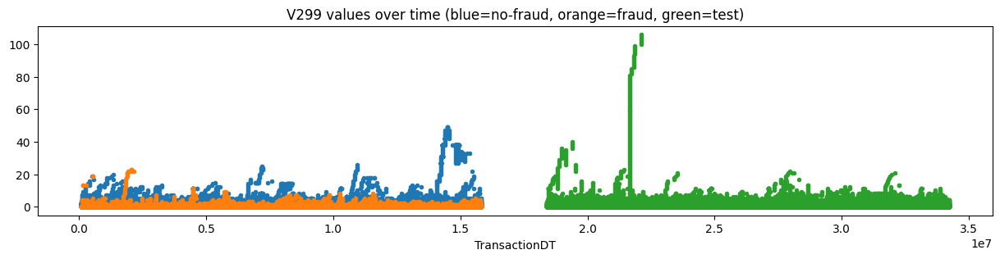

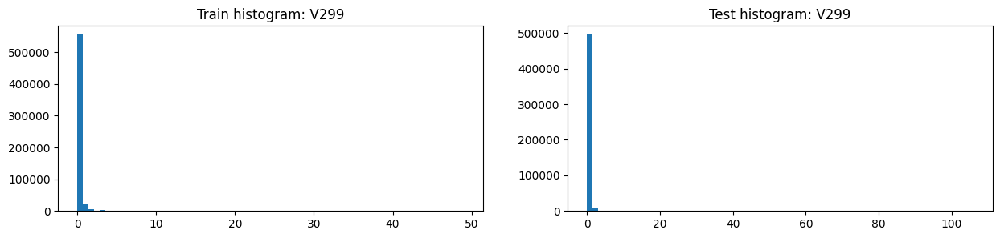

,V299,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,0.171655,0.168869,0.171756,0.127406,0.168331,0.117174
2,std,1.724218,0.881503,1.747153,1.090215,1.680789,0.882574
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,49.000000,23.000000,49.000000,106.000000,85.000000,106.000000
8,unique values,51.000000,25.000000,51.000000,108.000000,87.000000,44.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V299,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,555629,0.033904,18838,471406
1,1.0,23124,0.051072,1181,23844
2,2.0,6255,0.050679,317,6646
3,3.0,2066,0.075024,155,2316
4,4.0,858,0.078089,67,1020
5,38.0,505,0.000000,0,2
6,34.0,420,0.000000,0,3
7,5.0,398,0.077889,31,507
8,27.0,286,0.000000,0,3
9,6.0,208,0.091346,19,245


,V299,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,555629,0.033904,18838,471406
1,1.0,23124,0.051072,1181,23844
2,2.0,6255,0.050679,317,6646
3,3.0,2066,0.075024,155,2316
4,4.0,858,0.078089,67,1020
5,5.0,398,0.077889,31,507
6,6.0,208,0.091346,19,245
7,7.0,128,0.109375,14,181
8,8.0,98,0.061224,6,106
9,22.0,8,0.500000,4,6


,Column,Correlation with V299
0,V299,1.000000
1,V330,0.992977
2,V106,0.977030
3,V329,0.974647
4,V298,0.955615
5,V105,0.950781
375,V149,-0.156015
376,V155,-0.161794
377,V148,-0.167245
378,V154,-0.175717


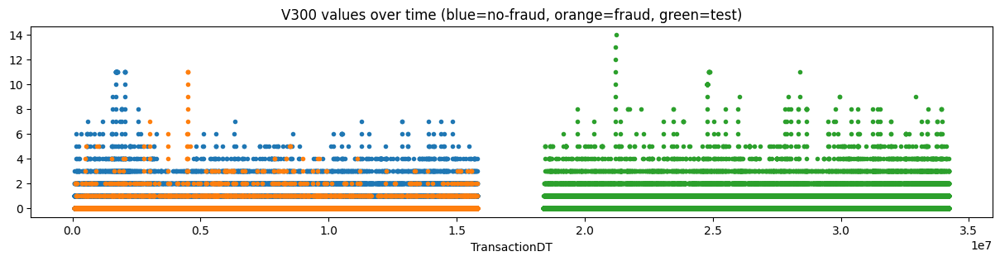

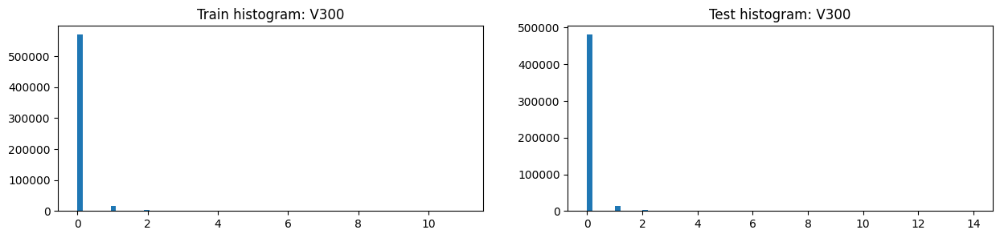

,V300,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,589271.000000,20617.000000,568654.000000,500660.000000,100922.000000,399739.000000
1,mean,0.045507,0.084008,0.044111,0.056685,0.050812,0.058168
2,std,0.289573,0.420798,0.283579,0.336923,0.318466,0.341409
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,11.000000,11.000000,11.000000,14.000000,14.000000,11.000000
8,unique values,13.000000,13.000000,13.000000,16.000000,16.000000,13.000000
9,NaNs,1269.000000,46.000000,1223.000000,6031.000000,417.000000,5614.000000


,V300,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,569522,0.034108,19425,480736
1,1.0,15133,0.057755,874,14679
2,2.0,3183,0.062834,200,3505
3,-999.0,1269,0.036249,46,6031
4,3.0,938,0.081023,76,1059
5,4.0,285,0.063158,18,342
6,5.0,103,0.116505,12,179
7,6.0,44,0.090909,4,47
8,11.0,29,0.103448,3,9
9,7.0,17,0.117647,2,35


,V300,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,569522,0.034108,19425,480736
1,1.0,15133,0.057755,874,14679
2,2.0,3183,0.062834,200,3505
3,3.0,938,0.081023,76,1059
4,-999.0,1269,0.036249,46,6031
5,4.0,285,0.063158,18,342
6,5.0,103,0.116505,12,179
7,6.0,44,0.090909,4,47
8,11.0,29,0.103448,3,9
9,7.0,17,0.117647,2,35


,Column,Correlation with V300
0,V300,1.000000
1,V301,0.928109
2,V146,0.601917
3,V147,0.594288
4,V184,0.559163
5,V238,0.510045
375,D5,-0.073430
376,D3,-0.077645
377,D1,-0.089465
378,D7,-0.092679


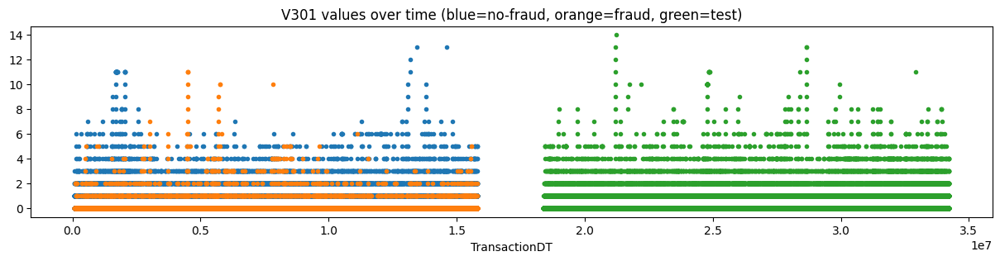

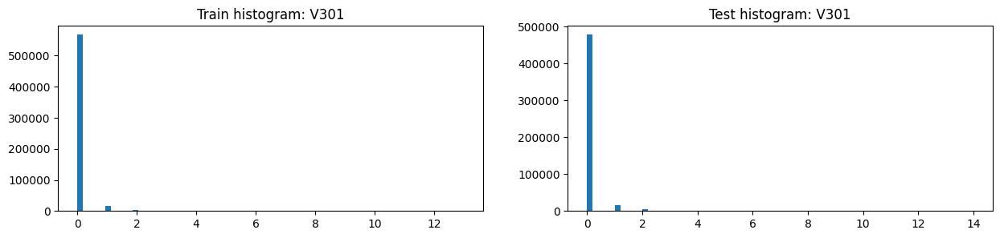

,V301,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,589271.000000,20617.000000,568654.000000,500660.000000,100922.000000,399739.000000
1,mean,0.052002,0.105641,0.050057,0.065931,0.059472,0.067562
2,std,0.318310,0.494239,0.309888,0.370363,0.346818,0.376057
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,13.000000,11.000000,13.000000,14.000000,14.000000,13.000000
8,unique values,15.000000,13.000000,15.000000,16.000000,16.000000,15.000000
9,NaNs,1269.000000,46.000000,1223.000000,6031.000000,417.000000,5614.000000


,V301,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,567409,0.033801,19179,478263
1,1.0,16292,0.064019,1043,15934
2,2.0,3778,0.061673,233,4209
3,-999.0,1269,0.036249,46,6031
4,3.0,1141,0.073620,84,1313
5,4.0,324,0.117284,38,518
6,5.0,155,0.122581,19,218
7,6.0,91,0.076923,7,86
8,11.0,30,0.100000,3,11
9,7.0,20,0.150000,3,40


,V301,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,567409,0.033801,19179,478263
1,1.0,16292,0.064019,1043,15934
2,2.0,3778,0.061673,233,4209
3,3.0,1141,0.073620,84,1313
4,-999.0,1269,0.036249,46,6031
5,4.0,324,0.117284,38,518
6,5.0,155,0.122581,19,218
7,6.0,91,0.076923,7,86
8,10.0,8,0.500000,4,29
9,11.0,30,0.100000,3,11


,Column,Correlation with V301
0,V301,1.000000
1,V300,0.928109
2,V146,0.596855
3,V147,0.593181
4,V184,0.548098
5,V238,0.498684
375,D5,-0.076571
376,D3,-0.079982
377,D7,-0.091517
378,D1,-0.091773


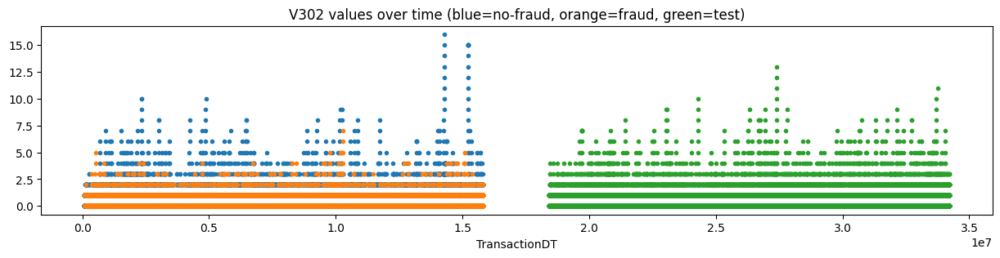

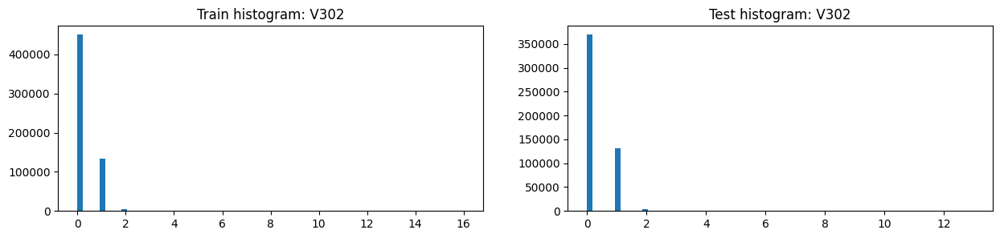

,V302,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,0.251761,0.588113,0.239566,0.286762,0.192271,0.310384
2,std,0.481889,0.604951,0.472353,0.502396,0.443210,0.513423
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
7,max,16.000000,7.000000,16.000000,13.000000,8.000000,13.000000
8,unique values,18.000000,9.000000,18.000000,15.000000,10.000000,14.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V302,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,450191,0.021164,9528,369321.0
1,1.0,134072,0.076899,10310,131660.0
2,2.0,5155,0.131329,677,4457.0
3,3.0,683,0.159590,109,769.0
4,4.0,219,0.127854,28,241.0
5,5.0,97,0.072165,7,115.0
6,6.0,47,0.021277,1,60.0
7,7.0,23,0.043478,1,31.0
8,8.0,14,0.000000,0,18.0
9,-999.0,12,0.166667,2,3.0


,V302,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,134072,0.076899,10310,131660
1,0.0,450191,0.021164,9528,369321
2,2.0,5155,0.131329,677,4457
3,3.0,683,0.159590,109,769
4,4.0,219,0.127854,28,241
5,5.0,97,0.072165,7,115
6,-999.0,12,0.166667,2,3
7,7.0,23,0.043478,1,31
8,6.0,47,0.021277,1,60
9,8.0,14,0.000000,0,18


,Column,Correlation with V302
0,V302,1.000000
1,V304,0.962786
2,V59,0.925841
3,V60,0.914733
4,V21,0.890931
5,V80,0.884808
362,V53,-0.393258
363,V13,-0.398045
364,V35,-0.403448
365,V54,-0.403914


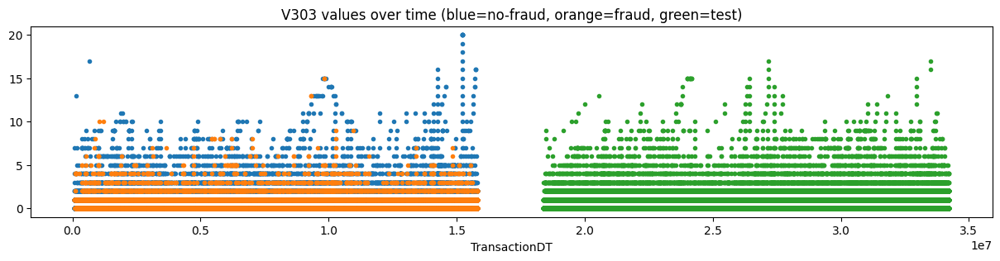

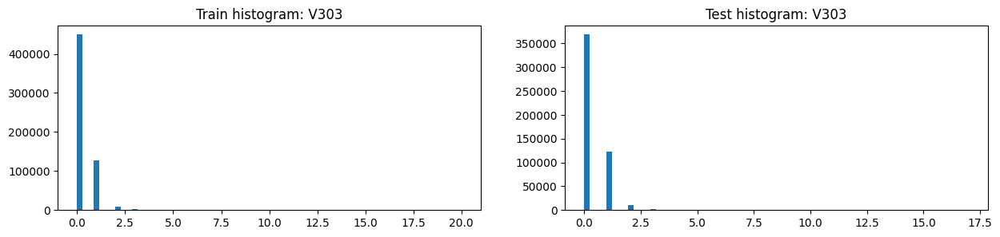

,V303,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,0.283140,0.690189,0.268382,0.321849,0.222192,0.346762
2,std,0.623608,0.846492,0.608920,0.639583,0.572844,0.652834
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
7,max,20.000000,15.000000,20.000000,17.000000,13.000000,17.000000
8,unique values,22.000000,14.000000,22.000000,19.000000,15.000000,18.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V303,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,449499,0.020990,9435,368773.0
1,1.0,126757,0.073195,9278,122648.0
2,2.0,9113,0.149347,1361,10537.0
3,3.0,2332,0.138937,324,2607.0
4,5.0,1375,0.046545,64,455.0
5,4.0,834,0.179856,150,970.0
6,6.0,216,0.101852,22,251.0
7,7.0,123,0.081301,10,171.0
8,8.0,86,0.104651,9,102.0
9,9.0,68,0.029412,2,77.0


,V303,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,449499,0.020990,9435,368773
1,1.0,126757,0.073195,9278,122648
2,2.0,9113,0.149347,1361,10537
3,3.0,2332,0.138937,324,2607
4,4.0,834,0.179856,150,970
5,5.0,1375,0.046545,64,455
6,6.0,216,0.101852,22,251
7,7.0,123,0.081301,10,171
8,8.0,86,0.104651,9,102
9,9.0,68,0.029412,2,77


,Column,Correlation with V303
0,V303,1.000000
1,V304,0.937836
2,V302,0.878828
3,V60,0.844695
4,V59,0.807207
5,V81,0.785296
375,V76,-0.341369
376,V53,-0.345545
377,V54,-0.354908
378,V35,-0.356561


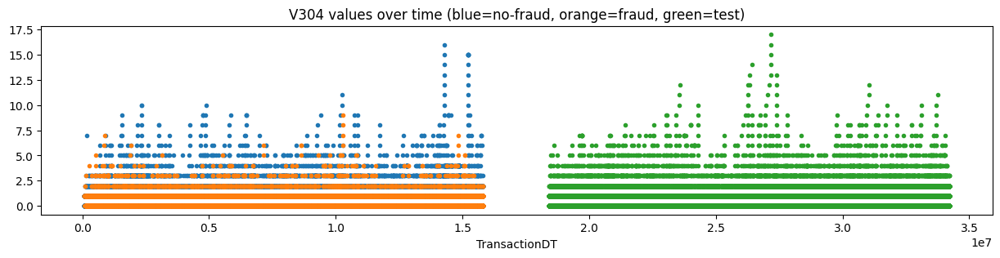

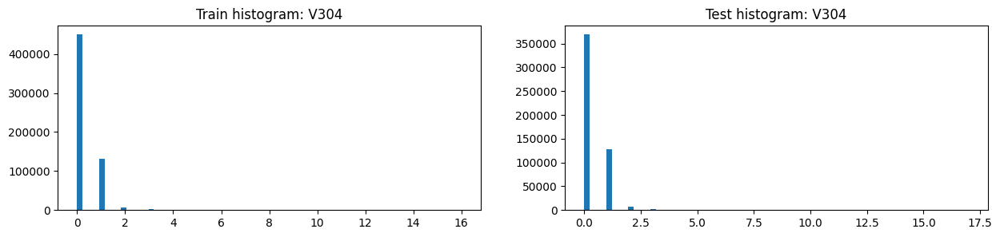

,V304,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,0.264208,0.629011,0.250981,0.301547,0.205583,0.325536
2,std,0.528238,0.686876,0.516766,0.555264,0.495821,0.566621
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
7,max,16.000000,9.000000,16.000000,17.000000,8.000000,17.000000
8,unique values,18.000000,11.000000,18.000000,19.000000,10.000000,18.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V304,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,449830,0.021070,9478,369035
1,1.0,130542,0.075079,9801,127251
2,2.0,7212,0.150998,1089,7846
3,3.0,1601,0.127420,204,1521
4,4.0,962,0.062370,60,528
5,5.0,189,0.089947,17,236
6,6.0,84,0.083333,7,119
7,7.0,40,0.075000,3,69
8,9.0,24,0.041667,1,18
9,8.0,21,0.047619,1,35


,V304,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,130542,0.075079,9801,127251
1,0.0,449830,0.021070,9478,369035
2,2.0,7212,0.150998,1089,7846
3,3.0,1601,0.127420,204,1521
4,4.0,962,0.062370,60,528
5,5.0,189,0.089947,17,236
6,6.0,84,0.083333,7,119
7,7.0,40,0.075000,3,69
8,-999.0,12,0.166667,2,3
9,8.0,21,0.047619,1,35


,Column,Correlation with V304
0,V304,1.000000
1,V302,0.962786
2,V303,0.937836
3,V60,0.906584
4,V59,0.879559
5,V81,0.865869
375,V13,-0.377731
376,V76,-0.377997
377,V54,-0.384475
378,V35,-0.389780


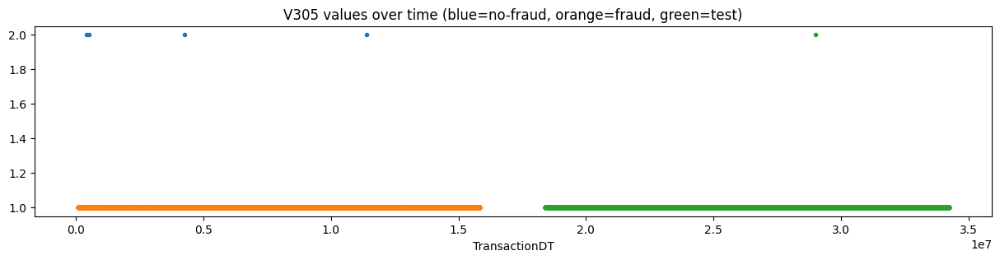

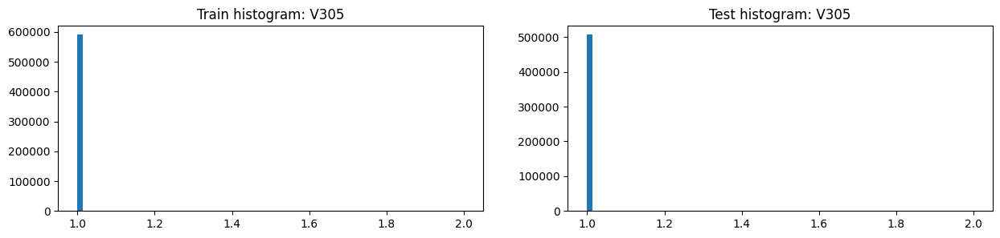

,V305,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.0000,569867.000000,506688.000000,101336.0,405353.000000
1,mean,1.000007,1.0000,1.000007,1.000002,1.0,1.000002
2,std,0.002603,0.0000,0.002649,0.001405,0.0,0.001571
3,min,1.000000,1.0000,1.000000,1.000000,1.0,1.000000
4,25%,1.000000,1.0000,1.000000,1.000000,1.0,1.000000
5,50%,1.000000,1.0000,1.000000,1.000000,1.0,1.000000
6,75%,1.000000,1.0000,1.000000,1.000000,1.0,1.000000
7,max,2.000000,1.0000,2.000000,2.000000,1.0,2.000000
8,unique values,3.000000,2.0000,3.000000,3.000000,2.0,2.000000
9,NaNs,12.000000,2.0000,10.000000,3.000000,3.0,0.000000


,V305,Count in train (desc),Mean target,Sum target,Count in test
0,1.0,590524,0.034988,20661,506687
1,-999.0,12,0.166667,2,3
2,2.0,4,0.000000,0,1


,V305,Count in train,Mean target,Sum target (desc),Count in test
0,1.0,590524,0.034988,20661,506687
1,-999.0,12,0.166667,2,3
2,2.0,4,0.000000,0,1


,Column,Correlation with V305
0,V305,1.000000
1,V310,0.002470
2,TransactionAmt,0.002380
3,V35,0.002365
4,V75,0.002167
5,V36,0.002083
206,V282,-0.002310
207,V67,-0.005654
208,V66,-0.006209
209,V26,-0.006502


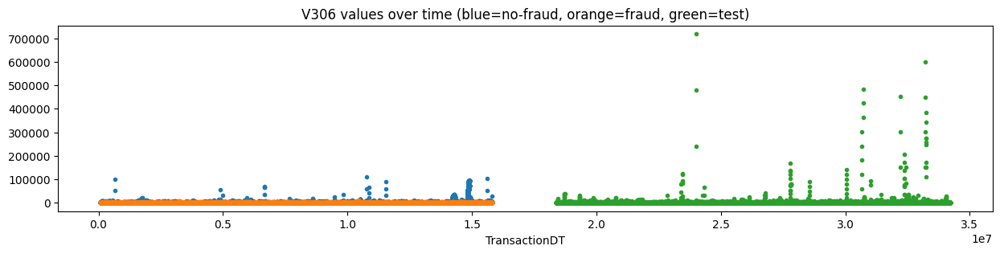

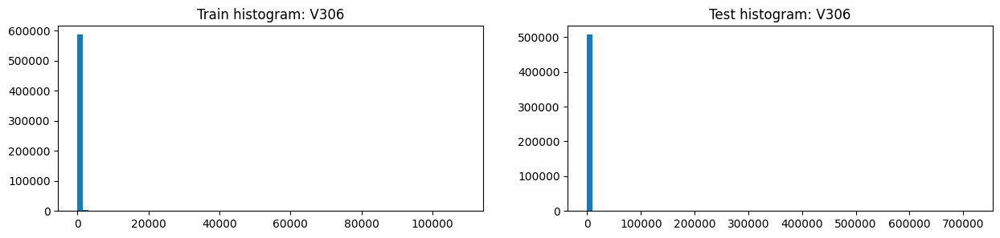

,V306,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,139.748713,116.765349,140.581994,83.783107,67.174093,87.935061
2,std,2348.849634,402.869710,2389.815422,2706.035763,552.762877,3012.766523
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,54.225399,0.000000,0.000000,0.000000,0.000000
7,max,108800.000000,11848.000000,108800.000000,718740.000000,39840.000000,718740.000000
8,unique values,16211.000000,2419.000000,15414.000000,13261.000000,4189.000000,11413.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V306,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,492169,0.028626,14089,418709.0
1,117.000000,3838,0.042470,163,3424.0
2,59.000000,3768,0.035563,134,3474.0
3,100.000000,2194,0.053783,118,1531.0
4,49.000000,1996,0.054108,108,1852.0
5,226.000000,1664,0.058293,97,1559.0
6,107.949997,1595,0.030721,49,1364.0
7,57.950001,1568,0.006378,10,1299.0
8,50.000000,1467,0.047716,70,922.0
9,200.000000,1370,0.073723,101,1283.0


,V306,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,492169,0.028626,14089,418709
1,117.0,3838,0.042470,163,3424
2,59.0,3768,0.035563,134,3474
3,100.0,2194,0.053783,118,1531
4,49.0,1996,0.054108,108,1852
5,150.0,1143,0.091864,105,765
6,200.0,1370,0.073723,101,1283
7,226.0,1664,0.058293,97,1559
8,300.0,912,0.098684,90,769
9,50.0,1467,0.047716,70,922


,Column,Correlation with V306
0,V306,1.000000
1,V331,0.993540
2,V126,0.991851
3,V202,0.988554
4,V316,0.987767
5,V322,0.986307
375,V149,-0.125816
376,V155,-0.129762
377,V148,-0.134315
378,V154,-0.141764


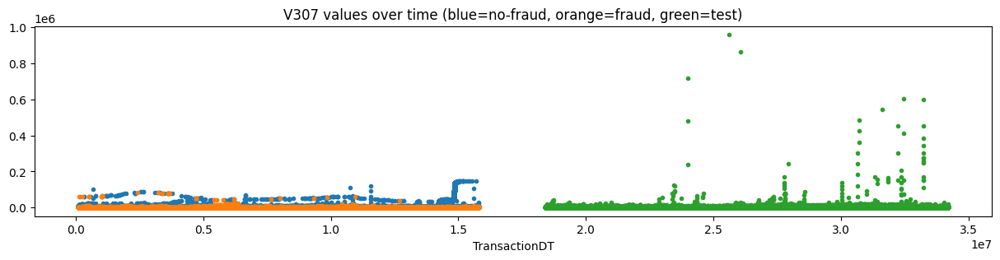

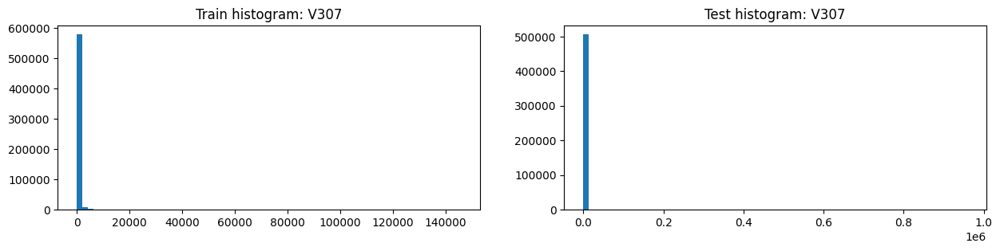

,V307,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,408.682375,545.881593,403.708103,259.371829,242.870752,263.496612
2,std,4391.992977,3097.849804,4431.742064,3643.584651,861.480557,4050.792690
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,12.809000,0.000000,0.000000,15.000000,0.000000
6,75%,151.380680,273.850006,150.000000,156.000000,177.000000,150.000000
7,max,145765.000000,83258.367188,145765.000000,958320.000000,39840.000000,958320.000000
8,unique values,37368.000000,5121.000000,35731.000000,29593.000000,10859.000000,25696.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V307,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,316650,0.032023,10140,267260.0
1,107.949997,6360,0.007862,50,5410.0
2,57.950001,5672,0.004231,24,4930.0
3,59.000000,5418,0.014766,80,5037.0
4,117.000000,5247,0.023442,123,4901.0
5,100.000000,3307,0.037194,123,1954.0
6,49.000000,2687,0.026796,72,2358.0
7,50.000000,2291,0.031864,73,1248.0
8,226.000000,2280,0.032456,74,2144.0
9,47.950001,2248,0.003559,8,1926.0


,V307,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,316650,0.032023,10140,267260
1,117.0,5247,0.023442,123,4901
2,100.0,3307,0.037194,123,1954
3,150.0,1586,0.073770,117,991
4,300.0,1183,0.089603,106,886
5,200.0,2005,0.052868,106,1608
6,59.0,5418,0.014766,80,5037
7,226.0,2280,0.032456,74,2144
8,50.0,2291,0.031864,73,1248
9,49.0,2687,0.026796,72,2358


,Column,Correlation with V307
0,V307,1.000000
1,V332,0.996515
2,V323,0.993701
3,V317,0.991723
4,V333,0.988320
5,V324,0.984823
375,V149,-0.139444
376,V155,-0.143919
377,V148,-0.148809
378,V154,-0.156873


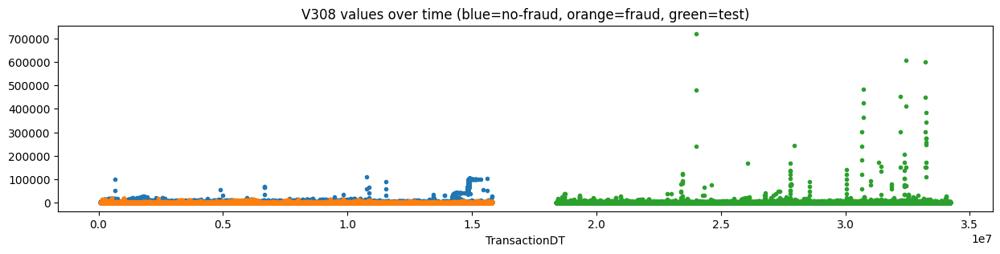

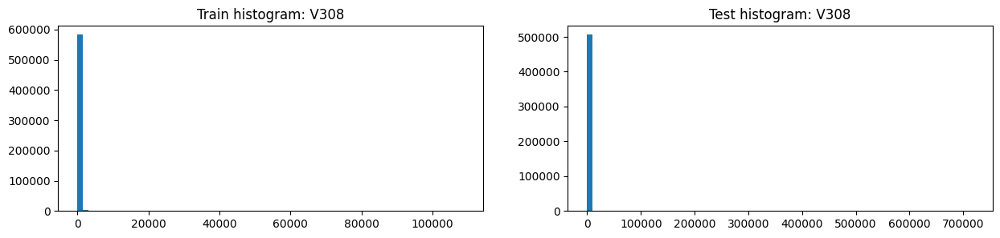

,V308,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,230.413180,282.044788,228.541233,136.949416,119.572212,141.293283
2,std,3021.924247,1032.666247,3069.911131,2976.740478,647.127217,3312.307298
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,35.970001,156.774002,34.000000,41.314602,52.950001,39.000000
7,max,108800.000000,18123.957031,108800.000000,718740.000000,39840.000000,718740.000000
8,unique values,23065.000000,3839.000000,21832.000000,18942.000000,6380.000000,16363.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V308,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,422464,0.027337,11549,356312.0
1,59.000000,5724,0.019392,111,5389.0
2,117.000000,5723,0.026035,149,5217.0
3,57.950001,3809,0.006563,25,3062.0
4,107.949997,3232,0.017327,56,2664.0
5,49.000000,2812,0.028450,80,2680.0
6,100.000000,2555,0.047750,122,1745.0
7,226.000000,2376,0.037458,89,2320.0
8,39.000000,1993,0.023081,46,1759.0
9,50.000000,1864,0.041309,77,1162.0


,V308,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,422464,0.027337,11549,356312
1,117.0,5723,0.026035,149,5217
2,100.0,2555,0.047750,122,1745
3,150.0,1324,0.091390,121,876
4,59.0,5724,0.019392,111,5389
5,200.0,1589,0.066709,106,1430
6,300.0,1026,0.099415,102,825
7,226.0,2376,0.037458,89,2320
8,49.0,2812,0.028450,80,2680
9,50.0,1864,0.041309,77,1162


,Column,Correlation with V308
0,V308,1.000000
1,V333,0.995064
2,V318,0.990722
3,V324,0.990242
4,V332,0.989445
5,V128,0.988756
375,V149,-0.141604
376,V155,-0.146144
377,V148,-0.151161
378,V154,-0.159447


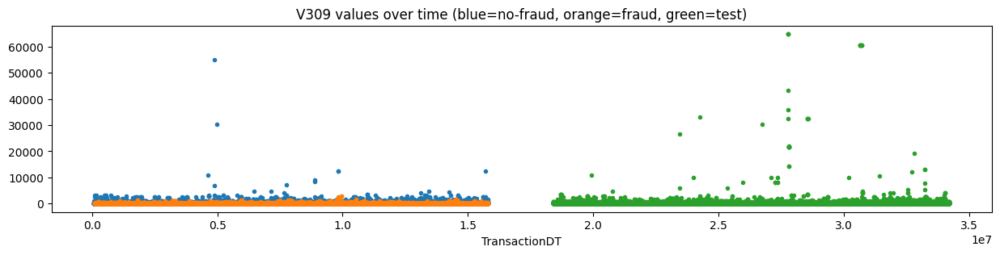

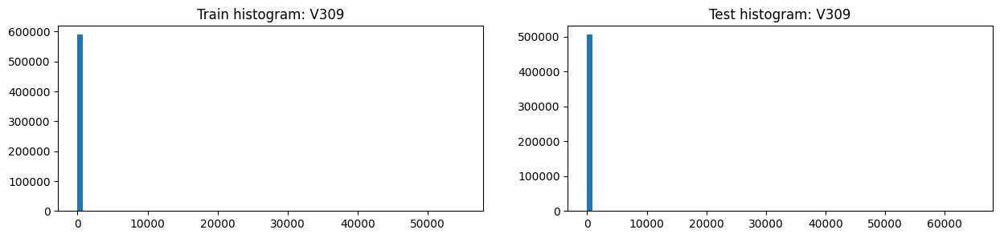

,V309,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,10.995986,23.363125,10.547606,12.838856,10.592444,13.400415
2,std,116.254277,104.910410,116.620286,337.427648,82.167110,375.008726
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,55125.000000,2793.000000,55125.000000,64800.000000,11000.000000,64800.000000
8,unique values,4237.000000,572.000000,4082.000000,3205.000000,1070.000000,2862.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V309,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,545552,0.033047,18029,468718.0
1,59.000000,3160,0.042405,134,2675.0
2,117.000000,2903,0.065794,191,2571.0
3,49.000000,1625,0.054769,89,1502.0
4,39.000000,1187,0.045493,54,920.0
5,226.000000,1133,0.088261,100,1023.0
6,29.000000,1016,0.058071,59,756.0
7,107.949997,957,0.050157,48,776.0
8,57.950001,954,0.011530,11,753.0
9,77.000000,866,0.078522,68,753.0


,V309,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,545552,0.033047,18029,468718
1,117.0,2903,0.065794,191,2571
2,59.0,3160,0.042405,134,2675
3,226.0,1133,0.088261,100,1023
4,49.0,1625,0.054769,89,1502
5,77.0,866,0.078522,68,753
6,335.0,566,0.116608,66,495
7,29.0,1016,0.058071,59,756
8,39.0,1187,0.045493,54,920
9,171.0,783,0.062580,49,709


,Column,Correlation with V309
0,V309,1.000000
1,V334,0.953625
2,V266,0.948351
3,V269,0.946494
4,V206,0.946407
5,V129,0.920793
375,V11,-0.039368
376,V10,-0.043092
377,D3,-0.056067
378,D2,-0.058572


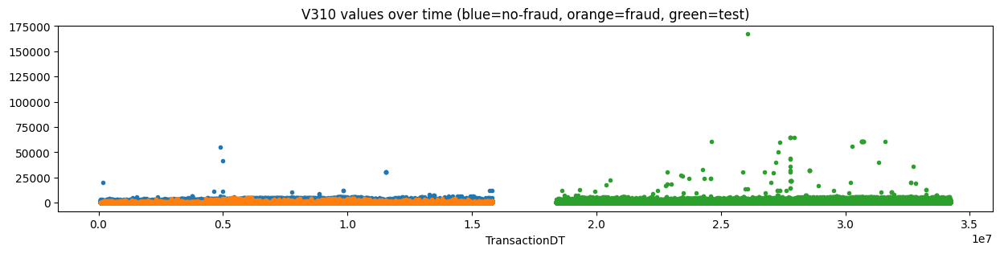

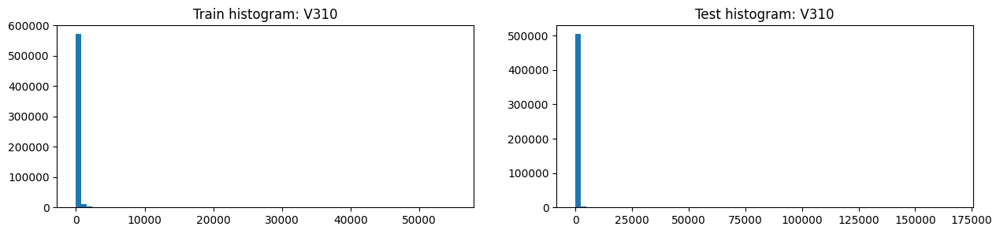

,V310,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,118.195658,138.719226,117.451559,127.198552,129.273296,126.679810
2,std,352.983093,402.308240,351.042468,606.911563,365.256465,653.506621
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,107.949997,97.000000,107.949997,106.000000,115.900002,99.900002
7,max,55125.000000,5216.000000,55125.000000,167200.000000,22400.000000,167200.000000
8,unique values,19137.000000,1747.000000,18850.000000,15385.000000,6243.000000,13753.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V310,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,354815,0.038147,13535,303975.0
1,107.949997,6520,0.008589,56,5534.0
2,59.000000,6245,0.020176,126,5612.0
3,117.000000,5804,0.041178,239,5654.0
4,57.950001,5757,0.005385,31,5073.0
5,49.000000,3083,0.037301,115,2738.0
6,226.000000,2453,0.053812,132,2365.0
7,47.950001,2293,0.003489,8,1948.0
8,39.000000,2008,0.021912,44,1740.0
9,35.950001,1992,0.005020,10,1826.0


,V310,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,354815,0.038147,13535,303975
1,117.0,5804,0.041178,239,5654
2,226.0,2453,0.053812,132,2365
3,59.0,6245,0.020176,126,5612
4,49.0,3083,0.037301,115,2738
5,171.0,1508,0.052387,79,1383
6,445.0,451,0.155211,70,463
7,335.0,1102,0.060799,67,1096
8,98.0,729,0.085048,62,662
9,77.0,1389,0.042477,59,1212


,Column,Correlation with V310
0,V310,1.000000
1,V130,0.841170
2,V335,0.826378
3,V266,0.800428
4,V269,0.799620
5,V336,0.759210
375,V154,-0.133808
376,V153,-0.136785
377,V50,-0.143396
378,D5,-0.166969


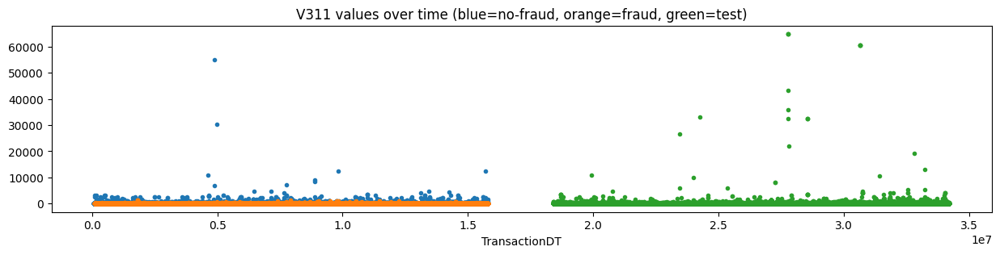

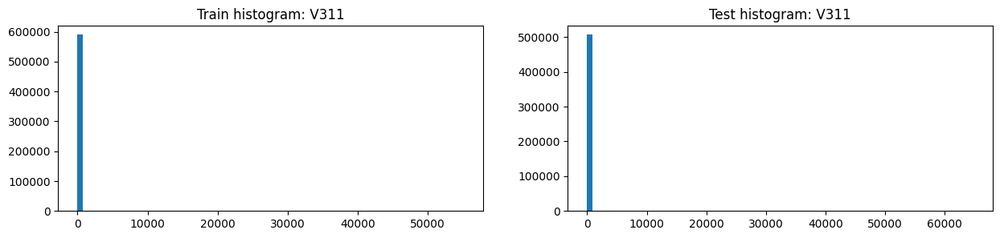

,V311,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,4.202175,4.901211,4.176831,5.153783,3.407071,5.590439
2,std,102.374938,42.340216,103.901884,278.305451,60.175142,309.694436
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,55125.000000,1448.500000,55125.000000,64800.000000,11000.000000,64800.000000
8,unique values,3099.000000,308.000000,3006.000000,2313.000000,677.000000,2063.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V311,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,573290,0.034848,19978,492506.0
1,59.000000,823,0.018226,15,661.0
2,117.000000,805,0.024845,20,611.0
3,107.949997,611,0.040917,25,432.0
4,57.950001,585,0.017094,10,487.0
5,49.000000,394,0.035533,14,301.0
6,39.000000,297,0.037037,11,184.0
7,29.000000,286,0.080420,23,198.0
8,100.000000,283,0.038869,11,223.0
9,226.000000,271,0.066421,18,227.0


,V311,Count in train,Mean target,Sum target (desc),Count in test
0,0.000000,573290,0.034848,19978,492506
1,107.949997,611,0.040917,25,432
2,29.000000,286,0.080420,23,198
3,117.000000,805,0.024845,20,611
4,226.000000,271,0.066421,18,227
5,150.000000,135,0.125926,17,86
6,59.000000,823,0.018226,15,661
7,311.950012,90,0.155556,14,60
8,49.000000,394,0.035533,14,301
9,100.000000,283,0.038869,11,223


,Column,Correlation with V311
0,V311,1.000000
1,V206,0.973025
2,V266,0.927814
3,V269,0.926861
4,V334,0.923437
5,V309,0.882926
375,D4,-0.011191
376,D12,-0.022356
377,D3,-0.023314
378,D2,-0.026891


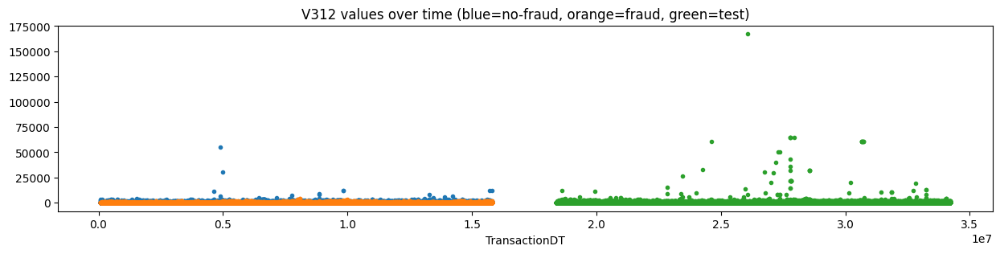

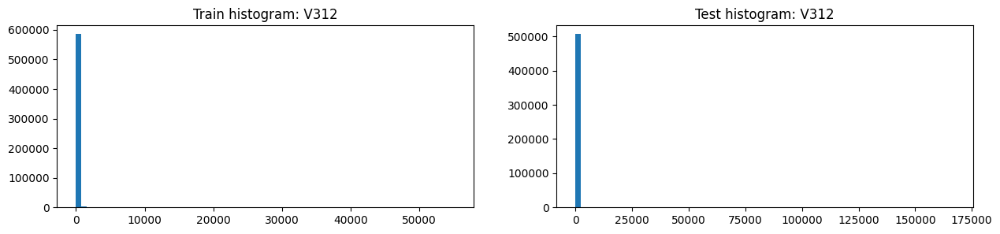

,V312,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,39.173910,73.144119,37.942292,42.733066,41.554030,43.027713
2,std,172.128339,221.490399,169.942491,467.654628,162.602639,516.492310
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,30.950001,0.000000,0.000000,0.000000,0.000000
7,max,55125.000000,3981.000000,55125.000000,167200.000000,12500.000000,167200.000000
8,unique values,8069.000000,1103.000000,7849.000000,6439.000000,2519.000000,5776.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V312,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,466863,0.032099,14986,398789.0
1,59.000000,6301,0.026662,168,5629.0
2,117.000000,6102,0.045067,275,5608.0
3,57.950001,3472,0.008065,28,2744.0
4,49.000000,3085,0.046677,144,2876.0
5,107.949997,2827,0.020870,59,2284.0
6,226.000000,2406,0.051953,125,2424.0
7,39.000000,2233,0.027318,61,1805.0
8,29.000000,1820,0.024725,45,1525.0
9,171.000000,1591,0.062225,99,1477.0


,V312,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,466863,0.032099,14986,398789
1,117.0,6102,0.045067,275,5608
2,59.0,6301,0.026662,168,5629
3,49.0,3085,0.046677,144,2876
4,226.0,2406,0.051953,125,2424
5,171.0,1591,0.062225,99,1477
6,97.0,1015,0.075862,77,1000
7,335.0,1136,0.065141,74,1121
8,445.0,462,0.155844,72,488
9,77.0,1522,0.045992,70,1438


,Column,Correlation with V312
0,V312,1.000000
1,V336,0.938161
2,V266,0.906615
3,V269,0.904972
4,V131,0.870205
5,V334,0.863292
375,V50,-0.089909
376,V11,-0.116256
377,V10,-0.129309
378,D3,-0.133703


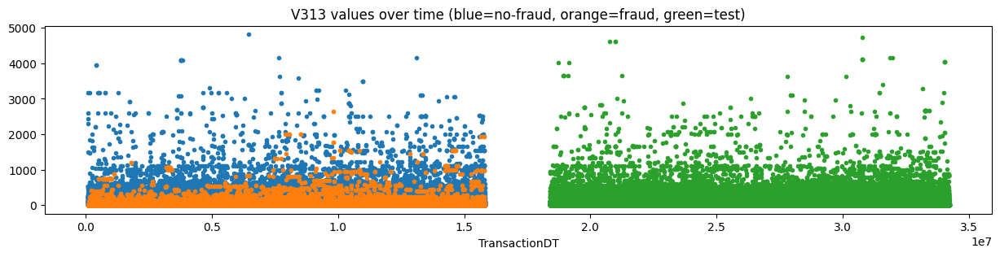

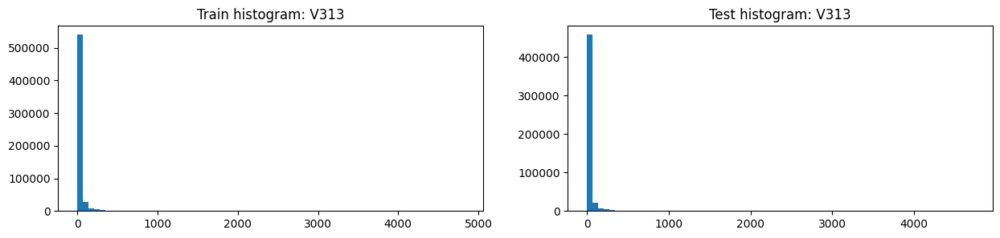

,V313,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,589271.000000,20617.000000,568654.000000,500660.000000,100922.000000,399739.000000
1,mean,21.351473,42.250735,20.593754,21.238136,22.302349,20.969402
2,std,95.902970,139.558705,93.852655,94.662615,102.446235,92.592182
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,4817.470215,2652.000000,4817.470215,4727.959961,4624.439941,4727.959961
8,unique values,5530.000000,641.000000,5366.000000,4113.000000,1449.000000,3642.000000
9,NaNs,1269.000000,46.000000,1223.000000,6031.000000,417.000000,5614.000000


,V313,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,489641,0.032507,15917,415370.0
1,59.000000,6654,0.030508,203,5568.0
2,117.000000,5319,0.058658,312,5195.0
3,57.950001,3608,0.009978,36,2931.0
4,107.949997,3472,0.016705,58,2783.0
5,49.000000,3096,0.062984,195,2769.0
6,226.000000,2368,0.086571,205,2070.0
7,39.000000,2331,0.059631,139,1723.0
8,100.000000,2186,0.027905,61,659.0
9,29.000000,1666,0.032413,54,1435.0


,V313,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,489641,0.032507,15917,415370
1,117.0,5319,0.058658,312,5195
2,226.0,2368,0.086571,205,2070
3,59.0,6654,0.030508,203,5568
4,49.0,3096,0.062984,195,2769
5,39.0,2331,0.059631,139,1723
6,87.0,550,0.214545,118,388
7,171.0,1423,0.075896,108,1296
8,335.0,852,0.092723,79,935
9,445.0,420,0.180952,76,388


,Column,Correlation with V313
0,V313,1.000000
1,V315,0.918433
2,V314,0.749145
3,V288,0.513608
4,V208,0.505646
5,V289,0.449700
375,D5,-0.097326
376,D3,-0.100523
377,D1,-0.112717
378,D7,-0.151184


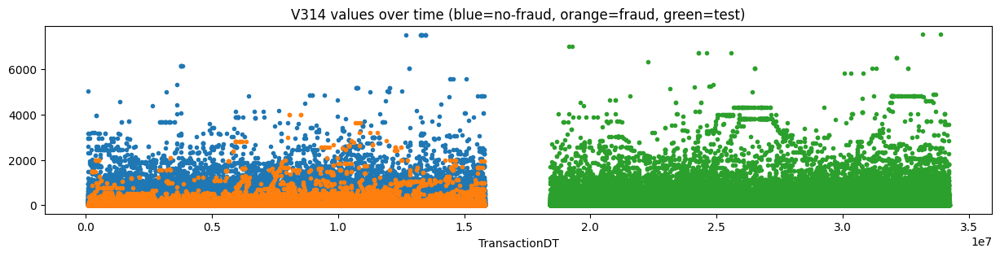

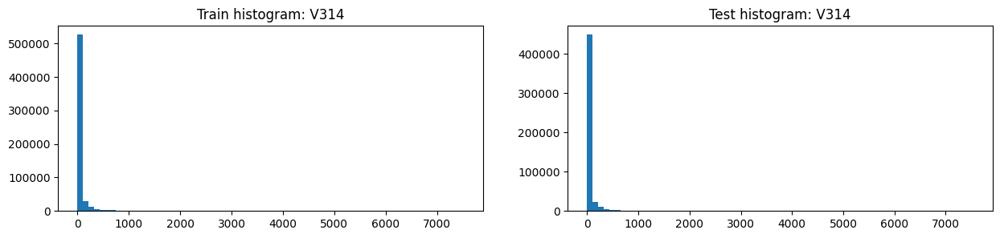

,V314,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,589271.000000,20617.000000,568654.000000,500660.000000,100922.000000,399739.000000
1,mean,43.319174,78.456388,42.045247,43.269524,43.257986,43.272328
2,std,173.619028,258.446060,169.612774,195.591901,177.564475,199.886368
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,7519.870117,3981.000000,7519.870117,7539.750000,7015.899902,7539.750000
8,unique values,11378.000000,1109.000000,11123.000000,9052.000000,3269.000000,8028.000000
9,NaNs,1269.000000,46.000000,1223.000000,6031.000000,417.000000,5614.000000


,V314,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,473273,0.032702,15477,402663.0
1,59.000000,4262,0.026044,111,3631.0
2,117.000000,3839,0.058088,223,3602.0
3,107.949997,2671,0.019468,52,2143.0
4,57.950001,2567,0.006623,17,2226.0
5,49.000000,2161,0.044424,96,1895.0
6,226.000000,1574,0.062897,99,1523.0
7,39.000000,1420,0.026056,37,1150.0
8,740.000000,1412,0.002125,3,23.0
9,-999.000000,1269,0.036249,46,6031.0


,V314,Count in train,Mean target,Sum target (desc),Count in test
0,0.000000,473273,0.032702,15477,402663
1,117.000000,3839,0.058088,223,3602
2,59.000000,4262,0.026044,111,3631
3,226.000000,1574,0.062897,99,1523
4,49.000000,2161,0.044424,96,1895
5,171.000000,969,0.068111,66,919
6,445.000000,276,0.228261,63,311
7,335.000000,626,0.092652,58,730
8,107.949997,2671,0.019468,52,2143
9,78.000000,326,0.156442,51,274


,Column,Correlation with V314
0,V314,1.000000
1,V315,0.839912
2,V330,0.783155
3,V329,0.767362
4,V327,0.758571
5,V313,0.749145
375,V250,-0.137618
376,V148,-0.138597
377,V154,-0.147040
378,V153,-0.150813


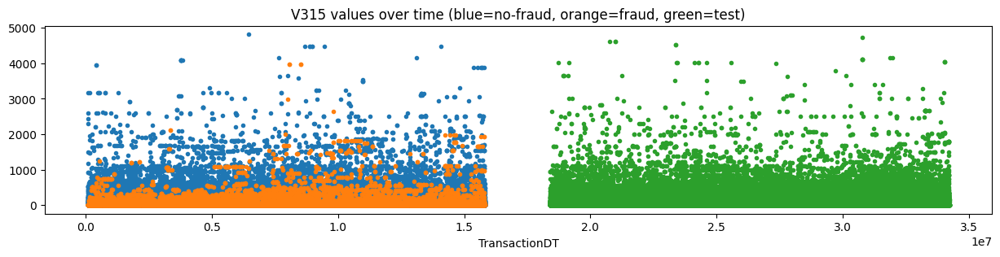

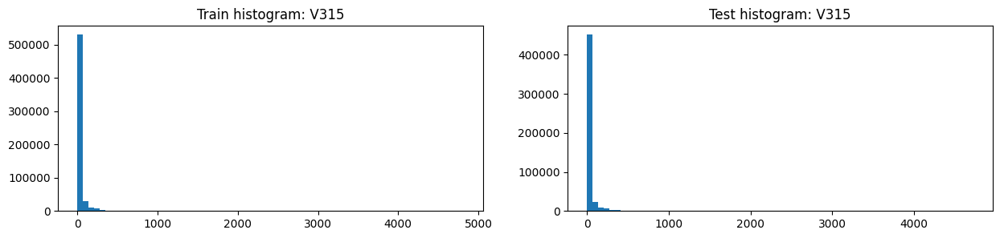

,V315,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,589271.000000,20617.000000,568654.000000,500660.000000,100922.000000,399739.000000
1,mean,26.806977,56.447212,25.732347,26.730428,27.597875,26.511357
2,std,116.853222,187.113982,113.346437,115.676311,119.085237,114.798635
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,4817.470215,3981.000000,4817.470215,4727.959961,4624.439941,4727.959961
8,unique values,6974.000000,791.000000,6777.000000,5377.000000,1894.000000,4782.000000
9,NaNs,1269.000000,46.000000,1223.000000,6031.000000,417.000000,5614.000000


,V315,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,487073,0.032394,15778,413471.0
1,59.000000,5114,0.022878,117,4278.0
2,117.000000,4360,0.052752,230,4022.0
3,107.949997,3048,0.015748,48,2391.0
4,57.950001,3012,0.009960,30,2547.0
5,49.000000,2474,0.055780,138,2188.0
6,100.000000,2154,0.012071,26,662.0
7,226.000000,1766,0.070781,125,1645.0
8,39.000000,1655,0.022356,37,1387.0
9,29.000000,1297,0.026214,34,1153.0


,V315,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,487073,0.032394,15778,413471
1,117.0,4360,0.052752,230,4022
2,49.0,2474,0.055780,138,2188
3,226.0,1766,0.070781,125,1645
4,59.0,5114,0.022878,117,4278
5,171.0,1153,0.080659,93,1074
6,445.0,291,0.219931,64,333
7,78.0,397,0.153652,61,223
8,335.0,643,0.083981,54,758
9,77.0,1035,0.050242,52,946


,Column,Correlation with V315
0,V315,1.000000
1,V313,0.918433
2,V314,0.839912
3,V289,0.560717
4,V208,0.527195
5,V288,0.511356
375,D5,-0.103221
376,D3,-0.106669
377,D1,-0.114994
378,D7,-0.153037


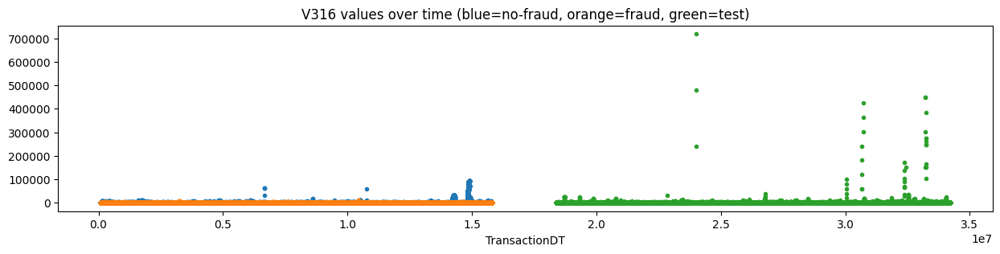

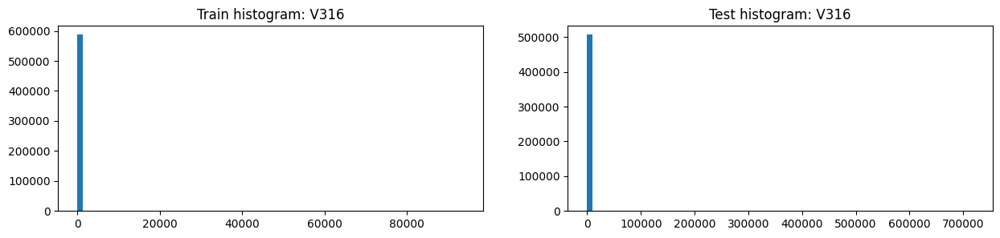

,V316,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,109.818544,74.526581,111.098084,42.077887,28.979343,45.352346
2,std,2270.033202,336.081637,2309.921526,2249.338097,379.278283,2507.658140
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,93736.000000,11848.000000,93736.000000,718740.000000,26400.000000,718740.000000
8,unique values,9815.000000,1675.000000,9156.000000,7561.000000,2307.000000,6547.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V316,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,546442,0.030129,16464,471485.0
1,117.0,1727,0.068327,118,1263.0
2,59.0,1504,0.060505,91,1109.0
3,100.0,949,0.062171,59,530.0
4,49.0,878,0.086560,76,595.0
5,226.0,804,0.067164,54,594.0
6,50.0,678,0.061947,42,322.0
7,171.0,575,0.080000,46,378.0
8,150.0,563,0.133215,75,345.0
9,200.0,561,0.110517,62,477.0


,V316,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,546442,0.030129,16464,471485
1,117.0,1727,0.068327,118,1263
2,59.0,1504,0.060505,91,1109
3,49.0,878,0.086560,76,595
4,150.0,563,0.133215,75,345
5,200.0,561,0.110517,62,477
6,100.0,949,0.062171,59,530
7,300.0,451,0.126386,57,296
8,226.0,804,0.067164,54,594
9,171.0,575,0.080000,46,378


,Column,Correlation with V316
0,V316,1.000000
1,V322,0.997477
2,V132,0.997222
3,V293,0.993841
4,V279,0.993526
5,V211,0.993173
375,V149,-0.125140
376,V155,-0.129053
377,V148,-0.133493
378,V154,-0.140916


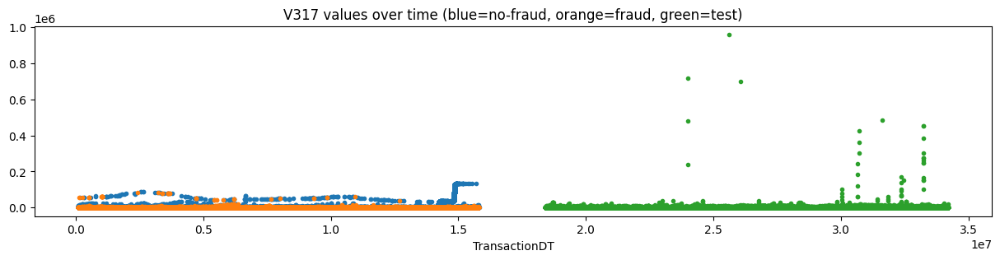

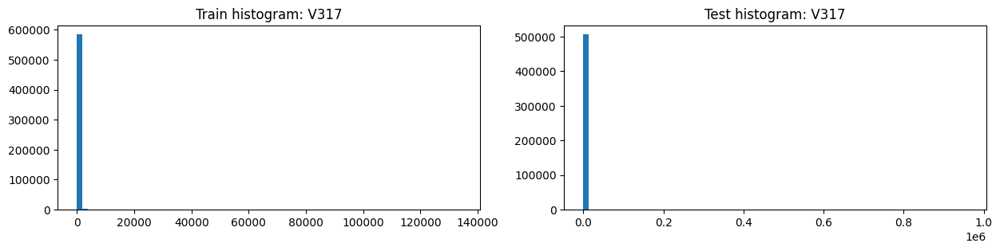

,V317,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,247.606741,352.323304,243.810156,83.808337,64.203518,88.709227
2,std,3980.042828,2912.608406,4013.364529,2919.418027,506.202211,3254.152821
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,65.004501,0.000000,0.000000,0.000000,0.000000
7,max,134021.000000,82130.953125,134021.000000,958320.000000,26400.000000,958320.000000
8,unique values,15185.000000,3030.000000,13820.000000,11280.000000,3703.000000,9620.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V317,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,519413,0.027015,14032,452784.0
1,117.0,2224,0.051259,114,1512.0
2,59.0,1827,0.035577,65,1359.0
3,226.0,1045,0.046890,49,760.0
4,100.0,1039,0.065448,68,589.0
5,49.0,963,0.066459,64,685.0
6,50.0,742,0.066038,49,369.0
7,171.0,720,0.069444,50,454.0
8,234.0,676,0.069527,47,522.0
9,77.0,663,0.063348,42,465.0


,V317,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,519413,0.027015,14032,452784
1,117.0,2224,0.051259,114,1512
2,150.0,608,0.136513,83,415
3,100.0,1039,0.065448,68,589
4,200.0,641,0.102964,66,529
5,300.0,498,0.132530,66,328
6,59.0,1827,0.035577,65,1359
7,49.0,963,0.066459,64,685
8,335.0,559,0.096601,54,391
9,171.0,720,0.069444,50,454


,Column,Correlation with V317
0,V317,1.000000
1,V323,0.997066
2,V332,0.995765
3,V307,0.991723
4,V324,0.986235
5,V333,0.983980
375,V149,-0.136038
376,V155,-0.140396
377,V148,-0.145118
378,V154,-0.153031


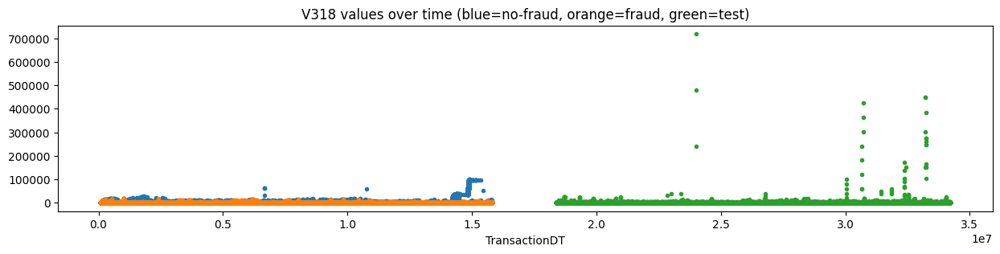

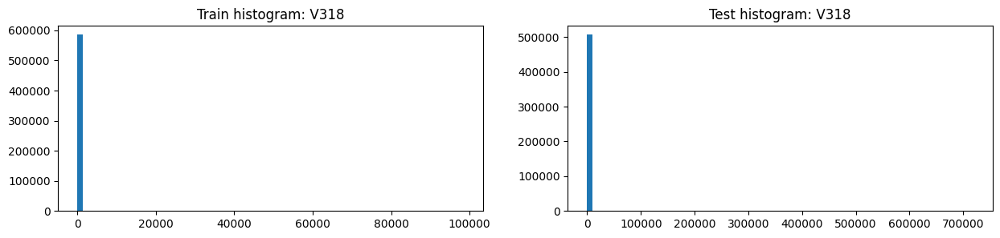

,V318,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,162.153398,176.781527,161.623043,56.090776,43.122257,59.332695
2,std,2793.343636,894.133506,2838.427857,2263.811948,432.303319,2521.754357
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,28.397400,0.000000,0.000000,0.000000,0.000000
7,max,98476.000000,18123.957031,98476.000000,718740.000000,26400.000000,718740.000000
8,unique values,12310.000000,2434.000000,11293.000000,9490.000000,3005.000000,8174.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V318,Count in train (desc),Mean target,Sum target,Count in test
0,0.0,535074,0.028159,15067,463263.0
1,117.0,1937,0.059886,116,1315.0
2,59.0,1586,0.052333,83,1183.0
3,100.0,991,0.065590,65,561.0
4,226.0,873,0.057274,50,636.0
5,49.0,872,0.060780,53,585.0
6,50.0,698,0.071633,50,345.0
7,171.0,626,0.073482,46,389.0
8,200.0,603,0.111111,67,503.0
9,150.0,595,0.137815,82,396.0


,V318,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,535074,0.028159,15067,463263
1,117.0,1937,0.059886,116,1315
2,59.0,1586,0.052333,83,1183
3,150.0,595,0.137815,82,396
4,200.0,603,0.111111,67,503
5,100.0,991,0.065590,65,561
6,300.0,488,0.122951,60,326
7,49.0,872,0.060780,53,585
8,226.0,873,0.057274,50,636
9,50.0,698,0.071633,50,345


,Column,Correlation with V318
0,V318,1.000000
1,V324,0.996689
2,V323,0.993914
3,V333,0.993121
4,V134,0.992172
5,V295,0.991884
375,V149,-0.139821
376,V155,-0.144294
377,V148,-0.149172
378,V154,-0.157394


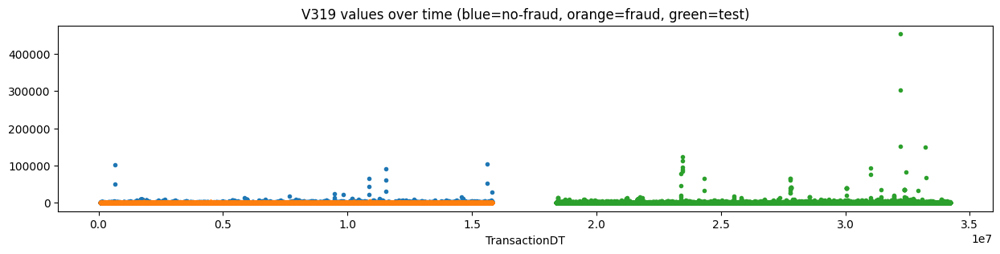

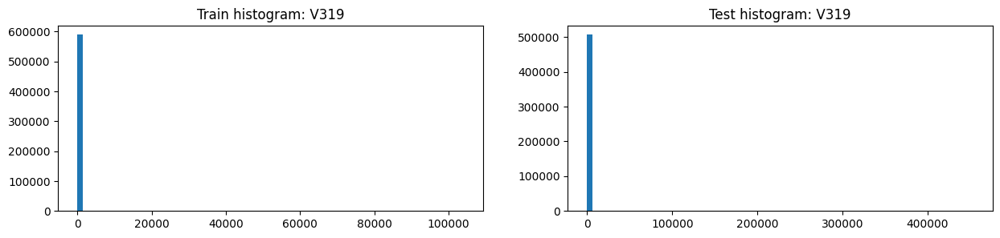

,V319,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,18.372476,18.478514,18.368631,27.620156,26.444595,27.913972
2,std,332.304848,123.652990,337.454879,999.900445,291.969644,1108.346677
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,104060.000000,4528.899902,104060.000000,453750.000000,14597.879883,453750.000000
8,unique values,4800.000000,420.000000,4677.000000,4904.000000,1596.000000,4155.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V319,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,562740,0.034430,19375,478167.0
1,100.000000,1040,0.041346,43,878.0
2,1165.000000,870,0.000000,0,NaN
3,117.000000,778,0.044987,35,816.0
4,200.000000,747,0.061580,46,743.0
5,59.000000,633,0.044234,28,808.0
6,150.000000,547,0.093236,51,429.0
7,107.949997,516,0.007752,4,562.0
8,57.950001,512,0.000000,0,566.0
9,50.000000,502,0.049801,25,434.0


,V319,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,562740,0.034430,19375,478167
1,150.0,547,0.093236,51,429
2,200.0,747,0.061580,46,743
3,300.0,470,0.091489,43,446
4,100.0,1040,0.041346,43,878
5,117.0,778,0.044987,35,816
6,59.0,633,0.044234,28,808
7,226.0,447,0.062640,28,524
8,50.0,502,0.049801,25,434
9,49.0,385,0.057143,22,434


,Column,Correlation with V319
0,V319,1.000000
1,V321,0.921923
2,V214,0.885149
3,V276,0.882619
4,V278,0.837691
5,V216,0.790939
375,V251,-0.036460
376,D3,-0.037332
377,V250,-0.037886
378,V153,-0.038037


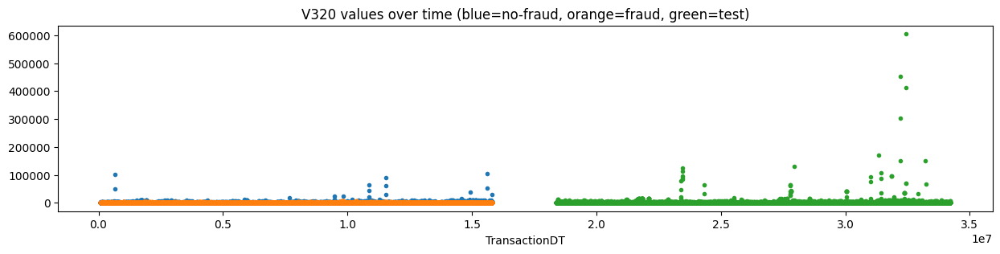

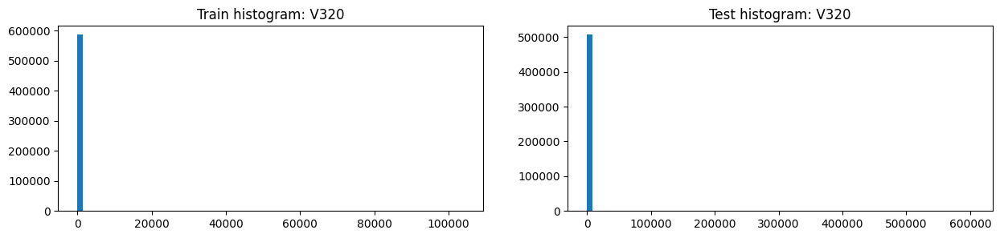

,V320,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,42.073133,54.409545,41.625866,46.835629,47.961275,46.554109
2,std,473.499307,307.351165,478.434705,1514.927745,411.917958,1681.166966
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,104060.000000,5794.500000,104060.000000,605000.000000,14597.879883,605000.000000
8,unique values,6440.000000,654.000000,6213.000000,6480.000000,2221.000000,5379.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V320,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,542892,0.033657,18272,458214.0
1,117.000000,1298,0.040062,52,1440.0
2,59.000000,1256,0.043790,55,1570.0
3,100.000000,1172,0.052048,61,962.0
4,57.950001,978,0.000000,0,1128.0
5,107.949997,922,0.014100,13,1026.0
6,7226.000000,871,0.000000,0,NaN
7,200.000000,796,0.061558,49,816.0
8,226.000000,788,0.038071,30,783.0
9,49.000000,690,0.049275,34,724.0


,V320,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,542892,0.033657,18272,458214
1,100.0,1172,0.052048,61,962
2,150.0,609,0.100164,61,450
3,59.0,1256,0.043790,55,1570
4,300.0,514,0.103113,53,463
5,117.0,1298,0.040062,52,1440
6,200.0,796,0.061558,49,816
7,171.0,514,0.085603,44,517
8,50.0,645,0.054264,35,510
9,49.0,690,0.049275,34,724


,Column,Correlation with V320
0,V320,1.000000
1,V321,0.937500
2,V278,0.861695
3,V136,0.854772
4,V276,0.844871
5,V338,0.817420
375,V250,-0.114260
376,V155,-0.116156
377,V148,-0.120372
378,V154,-0.126503


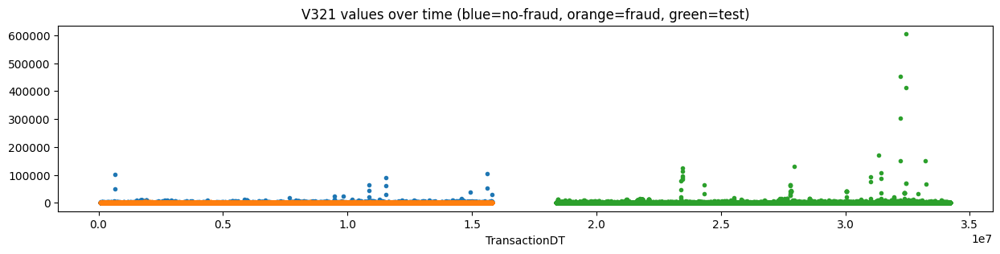

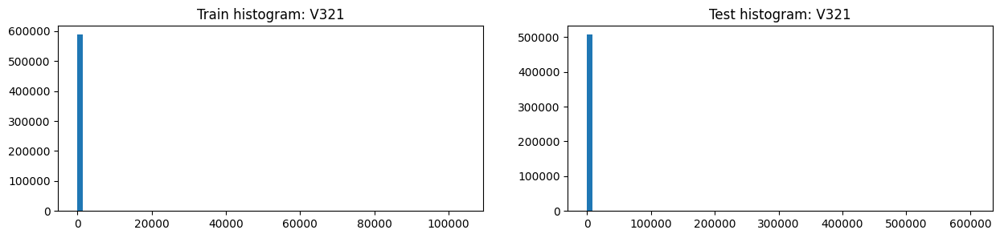

,V321,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,590528.000000,20661.000000,569867.000000,506688.000000,101336.000000,405353.000000
1,mean,28.326584,31.691673,28.204580,36.772511,33.627887,37.558559
2,std,382.053171,177.831364,387.440031,1486.814768,314.357109,1654.856151
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,104060.000000,4528.899902,104060.000000,605000.000000,14597.879883,605000.000000
8,unique values,5561.000000,551.000000,5386.000000,5616.000000,1851.000000,4732.000000
9,NaNs,12.000000,2.000000,10.000000,3.000000,3.000000,0.000000


,V321,Count in train (desc),Mean target,Sum target,Count in test
0,0.000000,555629,0.033904,18838,471406.0
1,100.000000,1104,0.040761,45,919.0
2,117.000000,981,0.063201,62,1085.0
3,59.000000,881,0.047673,42,1038.0
4,200.000000,769,0.059818,46,782.0
5,57.950001,622,0.001608,1,685.0
6,107.949997,613,0.008157,5,653.0
7,150.000000,585,0.102564,60,442.0
8,226.000000,571,0.049037,28,616.0
9,50.000000,571,0.063047,36,461.0


,V321,Count in train,Mean target,Sum target (desc),Count in test
0,0.0,555629,0.033904,18838,471406
1,117.0,981,0.063201,62,1085
2,150.0,585,0.102564,60,442
3,300.0,494,0.097166,48,464
4,200.0,769,0.059818,46,782
5,100.0,1104,0.040761,45,919
6,59.0,881,0.047673,42,1038
7,50.0,571,0.063047,36,461
8,171.0,373,0.085791,32,353
9,226.0,571,0.049037,28,616


,Column,Correlation with V321
0,V321,1.000000
1,V320,0.937500
2,V319,0.921923
3,V278,0.865826
4,V216,0.854264
5,V276,0.853500
375,V155,-0.084040
376,V250,-0.084837
377,V148,-0.087289
378,V154,-0.091622


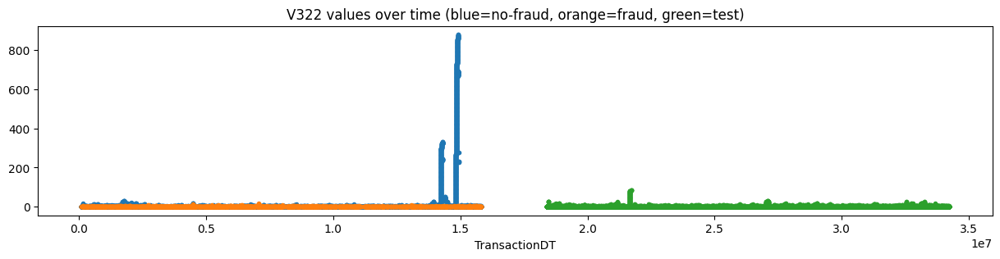

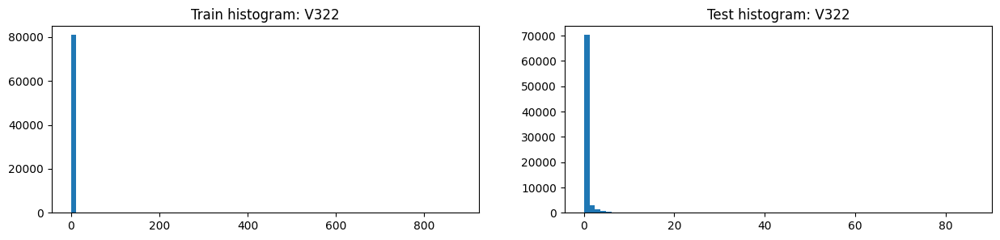

,V322,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,82351.000000,3686.000000,78665.000000,76431.000000,8971.000000,67460.000000
1,mean,6.220289,0.645415,6.481510,0.436681,0.971687,0.365535
2,std,56.022561,1.371503,57.306006,2.129226,5.176320,1.237153
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
7,max,880.000000,16.000000,880.000000,86.000000,86.000000,32.000000
8,unique values,882.000000,18.000000,882.000000,88.000000,88.000000,34.000000
9,NaNs,508189.000000,16977.000000,491212.000000,430260.000000,92368.000000,337893.000000


,V322,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508189,0.033407,16977,430260.0
1,0.0,65970,0.038290,2526,62414.0
2,1.0,8562,0.072997,625,7848.0
3,2.0,3226,0.077185,249,2945.0
4,3.0,1502,0.086551,130,1348.0
5,4.0,777,0.096525,75,712.0
6,5.0,350,0.082857,29,338.0
7,6.0,196,0.091837,18,198.0
8,7.0,123,0.089431,11,132.0
9,8.0,80,0.112500,9,97.0


,V322,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,65970,0.038290,2526,62414
2,1.0,8562,0.072997,625,7848
3,2.0,3226,0.077185,249,2945
4,3.0,1502,0.086551,130,1348
5,4.0,777,0.096525,75,712
6,5.0,350,0.082857,29,338
7,6.0,196,0.091837,18,198
8,7.0,123,0.089431,11,132
9,8.0,80,0.112500,9,97


,Column,Correlation with V322
0,V322,1.000000
1,V95,0.999949
2,V101,0.999698
3,V279,0.999624
4,V293,0.999403
5,V132,0.997984
327,D5,-0.292862
328,V20,-0.347962
329,V19,-0.350959
330,V62,-0.388325


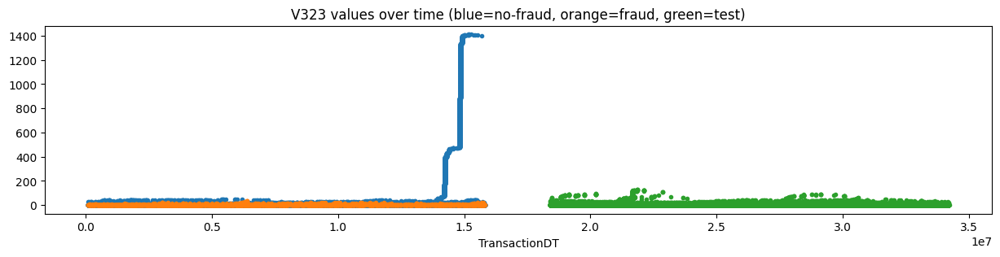

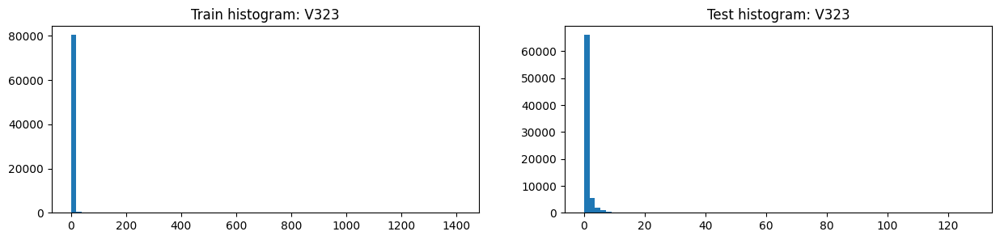

,V323,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,82351.000000,3686.000000,78665.000000,76431.000000,8971.000000,67460.000000
1,mean,13.103775,1.600380,13.642789,1.216182,2.853862,0.998399
2,std,106.739813,3.709768,109.179292,5.925144,11.531003,4.657444
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000
7,max,1411.000000,34.000000,1411.000000,128.000000,124.000000,128.000000
8,unique values,1412.000000,36.000000,1412.000000,130.000000,126.000000,109.000000
9,NaNs,508189.000000,16977.000000,491212.000000,430260.000000,92368.000000,337893.000000


,V323,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508189,0.033407,16977,430260.0
1,0.0,60806,0.036526,2221,57454.0
2,1.0,9407,0.063463,597,8580.0
3,2.0,3857,0.067928,262,3510.0
4,3.0,2027,0.075974,154,1830.0
5,4.0,1235,0.085020,105,1111.0
6,5.0,747,0.073628,55,719.0
7,6.0,488,0.081967,40,492.0
8,7.0,347,0.080692,28,375.0
9,8.0,262,0.106870,28,306.0


,V323,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,60806,0.036526,2221,57454
2,1.0,9407,0.063463,597,8580
3,2.0,3857,0.067928,262,3510
4,3.0,2027,0.075974,154,1830
5,4.0,1235,0.085020,105,1111
6,5.0,747,0.073628,55,719
7,6.0,488,0.081967,40,492
8,7.0,347,0.080692,28,375
9,8.0,262,0.106870,28,306


,Column,Correlation with V323
0,V323,1.000000
1,V96,0.999948
2,V102,0.998828
3,V294,0.998592
4,V133,0.997651
5,V317,0.997066
327,D5,-0.342054
328,V20,-0.389590
329,V19,-0.392964
330,V62,-0.434517


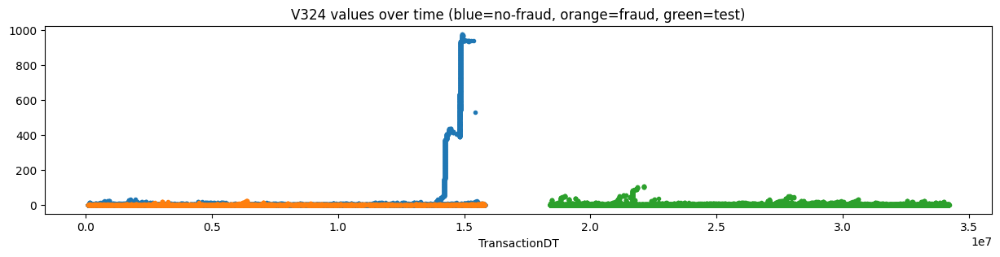

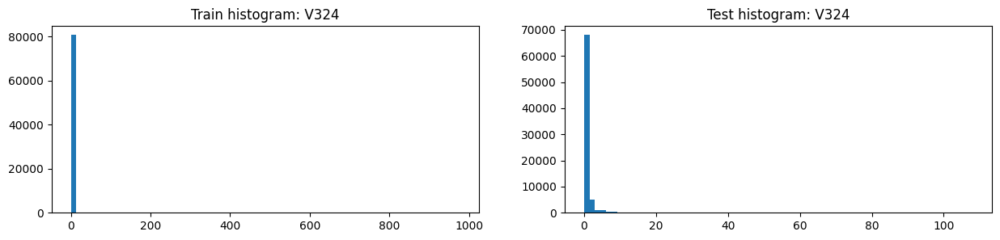

,V324,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,82351.000000,3686.000000,78665.000000,76431.000000,8971.000000,67460.000000
1,mean,9.184612,1.019262,9.567215,0.693514,1.563371,0.577839
2,std,73.627893,2.257605,75.309861,3.343788,6.624241,2.592107
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000
7,max,976.000000,24.000000,976.000000,108.000000,88.000000,108.000000
8,unique values,977.000000,26.000000,977.000000,110.000000,90.000000,74.000000
9,NaNs,508189.000000,16977.000000,491212.000000,430260.000000,92368.000000,337893.000000


,V324,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508189,0.033407,16977,430260.0
1,0.0,62945,0.036508,2298,59518.0
2,1.0,9152,0.068400,626,8494.0
3,2.0,3782,0.075621,286,3411.0
4,3.0,1931,0.089073,172,1712.0
5,4.0,1133,0.105914,120,958.0
6,5.0,631,0.093502,59,615.0
7,6.0,405,0.079012,32,391.0
8,7.0,252,0.087302,22,245.0
9,8.0,175,0.091429,16,188.0


,V324,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,62945,0.036508,2298,59518
2,1.0,9152,0.068400,626,8494
3,2.0,3782,0.075621,286,3411
4,3.0,1931,0.089073,172,1712
5,4.0,1133,0.105914,120,958
6,5.0,631,0.093502,59,615
7,6.0,405,0.079012,32,391
8,7.0,252,0.087302,22,245
9,8.0,175,0.091429,16,188


,Column,Correlation with V324
0,V324,1.000000
1,V97,0.999947
2,V280,0.999464
3,V103,0.999258
4,V295,0.998827
5,V134,0.997303
327,D5,-0.317305
328,V20,-0.398257
329,V19,-0.401711
330,V62,-0.446535


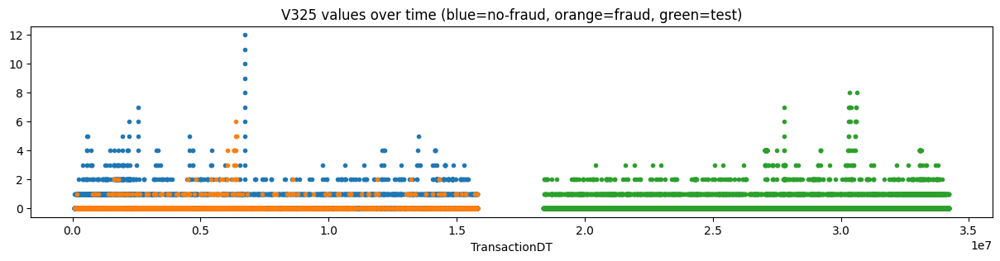

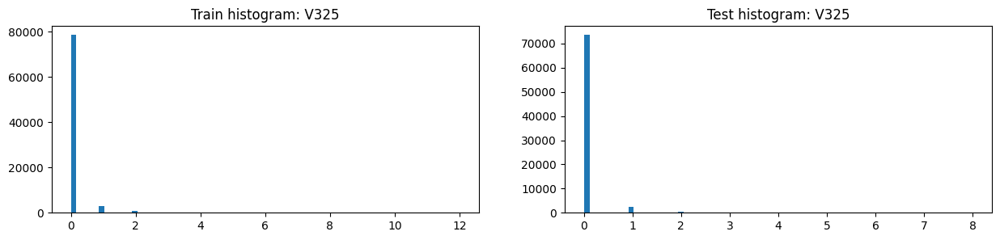

,V325,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,82351.000000,3686.000000,78665.000000,76431.000000,8971.000000,67460.000000
1,mean,0.058494,0.069452,0.057980,0.047926,0.056181,0.046828
2,std,0.304415,0.354930,0.301833,0.282497,0.256397,0.285772
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,12.000000,6.000000,12.000000,8.000000,3.000000,8.000000
8,unique values,14.000000,8.000000,14.000000,10.000000,5.000000,10.000000
9,NaNs,508189.000000,16977.000000,491212.000000,430260.000000,92368.000000,337893.000000


,V325,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508189,0.033407,16977,430260.0
1,0.0,78588,0.044447,3493,73546.0
2,1.0,2948,0.053935,159,2409.0
3,2.0,686,0.029155,20,315.0
4,3.0,74,0.054054,4,66.0
5,4.0,33,0.181818,6,75.0
6,5.0,11,0.272727,3,5.0
7,6.0,4,0.250000,1,6.0
8,7.0,2,0.000000,0,7.0
9,8.0,1,0.000000,0,2.0


,V325,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,78588,0.044447,3493,73546
2,1.0,2948,0.053935,159,2409
3,2.0,686,0.029155,20,315
4,4.0,33,0.181818,6,75
5,3.0,74,0.054054,4,66
6,5.0,11,0.272727,3,5
7,6.0,4,0.250000,1,6
8,7.0,2,0.000000,0,7
9,8.0,1,0.000000,0,2


,Column,Correlation with V325
0,V325,1.000000
1,V98,0.945764
2,V284,0.920235
3,V327,0.554233
4,V286,0.531711
5,V100,0.531202
327,D7,-0.220577
328,V20,-0.236393
329,V19,-0.239622
330,V62,-0.252685


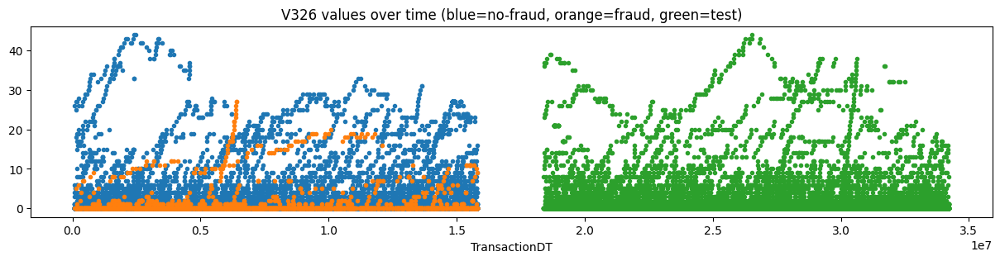

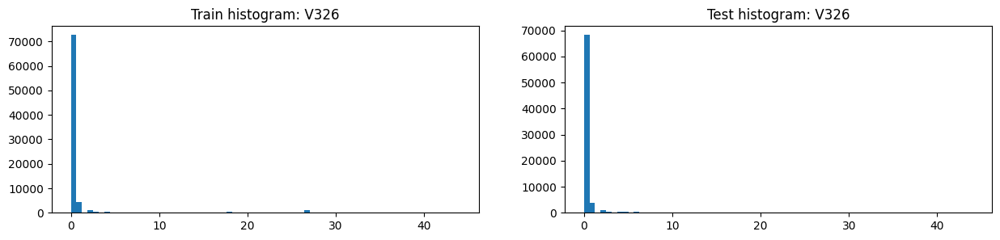

,V326,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,82351.000000,3686.000000,78665.000000,76431.000000,8971.000000,67460.000000
1,mean,0.851040,0.726262,0.856887,0.482658,0.865790,0.431708
2,std,3.950295,2.788170,3.996386,2.555532,3.369686,2.422245
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,44.000000,27.000000,44.000000,44.000000,39.000000,44.000000
8,unique values,46.000000,29.000000,46.000000,46.000000,37.000000,46.000000
9,NaNs,508189.000000,16977.000000,491212.000000,430260.000000,92368.000000,337893.000000


,V326,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,72668,0.043307,3147,68210
2,1.0,4231,0.050106,212,3887
3,2.0,1097,0.089335,98,1169
4,27.0,954,0.002096,2,24
5,3.0,524,0.045802,24,538
6,18.0,381,0.026247,10,56
7,4.0,377,0.053050,20,460
8,5.0,249,0.072289,18,328
9,6.0,209,0.043062,9,262


,V326,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,72668,0.043307,3147,68210
2,1.0,4231,0.050106,212,3887
3,2.0,1097,0.089335,98,1169
4,7.0,205,0.146341,30,202
5,3.0,524,0.045802,24,538
6,4.0,377,0.053050,20,460
7,11.0,108,0.185185,20,76
8,5.0,249,0.072289,18,328
9,8.0,153,0.117647,18,211


,Column,Correlation with V326
0,V326,1.000000
1,V99,0.988773
2,V285,0.959617
3,V327,0.937717
4,V100,0.932769
5,V287,0.921988
327,V82,-0.458109
328,V20,-0.543650
329,V19,-0.548849
330,V62,-0.561287


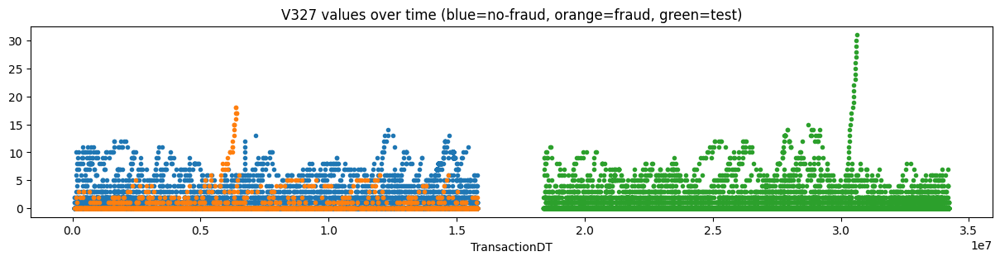

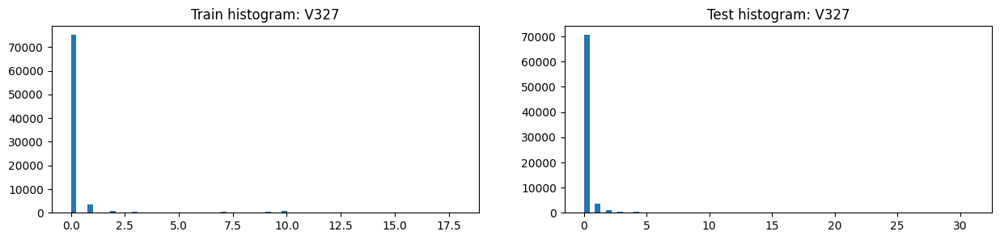

,V327,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,82351.000000,3686.000000,78665.000000,76431.000000,8971.000000,67460.000000
1,mean,0.296633,0.290016,0.296943,0.163271,0.261509,0.150208
2,std,1.364356,1.257701,1.369157,0.850853,0.958242,0.834670
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,18.000000,18.000000,14.000000,31.000000,11.000000,31.000000
8,unique values,20.000000,20.000000,16.000000,33.000000,13.000000,33.000000
9,NaNs,508189.000000,16977.000000,491212.000000,430260.000000,92368.000000,337893.000000


,V327,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,75098,0.043410,3260,70596
2,1.0,3630,0.059780,217,3487
3,2.0,945,0.099471,94,1022
4,10.0,692,0.005780,4,30
5,3.0,423,0.078014,33,445
6,7.0,419,0.007160,3,85
7,9.0,331,0.003021,1,37
8,4.0,264,0.113636,30,286
9,5.0,199,0.100503,20,184


,V327,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,75098,0.043410,3260,70596
2,1.0,3630,0.059780,217,3487
3,2.0,945,0.099471,94,1022
4,3.0,423,0.078014,33,445
5,4.0,264,0.113636,30,286
6,5.0,199,0.100503,20,184
7,6.0,143,0.048951,7,130
8,10.0,692,0.005780,4,30
9,17.0,3,1.000000,3,1


,Column,Correlation with V327
0,V327,1.000000
1,V100,0.987016
2,V287,0.968657
3,V326,0.937717
4,V99,0.930862
5,V285,0.903144
327,V82,-0.381177
328,V20,-0.512131
329,V19,-0.517675
330,V62,-0.539304


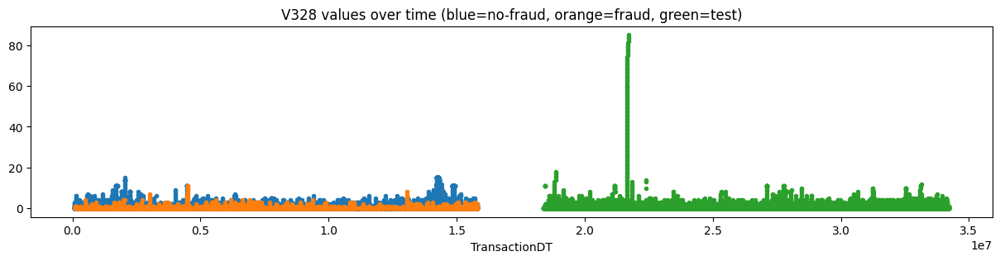

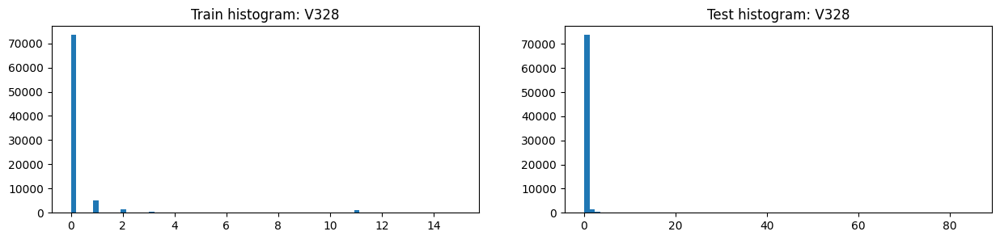

,V328,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,82351.000000,3686.000000,78665.000000,76431.000000,8971.000000,67460.000000
1,mean,0.336790,0.256104,0.340571,0.220486,0.666035,0.161236
2,std,1.580144,0.786631,1.607652,1.789616,4.918845,0.617676
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,15.000000,11.000000,15.000000,85.000000,85.000000,14.000000
8,unique values,17.000000,13.000000,17.000000,87.000000,87.000000,16.000000
9,NaNs,508189.000000,16977.000000,491212.000000,430260.000000,92368.000000,337893.000000


,V328,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,73464,0.042592,3129,68348
2,1.0,4947,0.068931,341,5321
3,2.0,1574,0.082592,130,1599
4,11.0,1005,0.001990,2,30
5,3.0,587,0.093697,55,586
6,4.0,221,0.063348,14,223
7,15.0,215,0.000000,0,2
8,5.0,100,0.040000,4,94
9,12.0,72,0.000000,0,4


,V328,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,73464,0.042592,3129,68348
2,1.0,4947,0.068931,341,5321
3,2.0,1574,0.082592,130,1599
4,3.0,587,0.093697,55,586
5,4.0,221,0.063348,14,223
6,6.0,55,0.072727,4,49
7,5.0,100,0.040000,4,94
8,7.0,31,0.096774,3,33
9,11.0,1005,0.001990,2,30


,Column,Correlation with V328
0,V328,1.000000
1,V104,0.987711
2,V297,0.967934
3,V330,0.931738
4,V106,0.924278
5,V299,0.915267
327,D3,-0.279979
328,V20,-0.413837
329,V19,-0.416899
330,V62,-0.480924


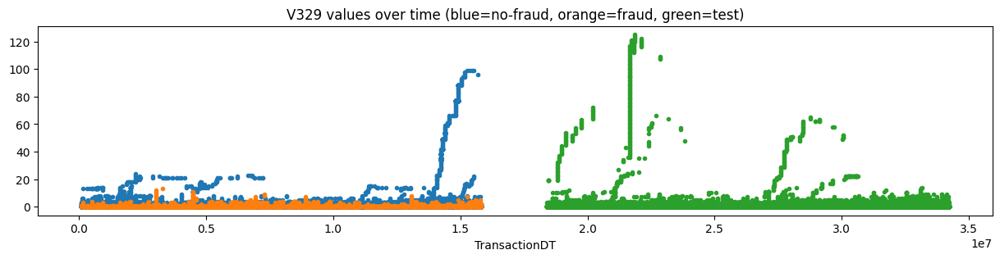

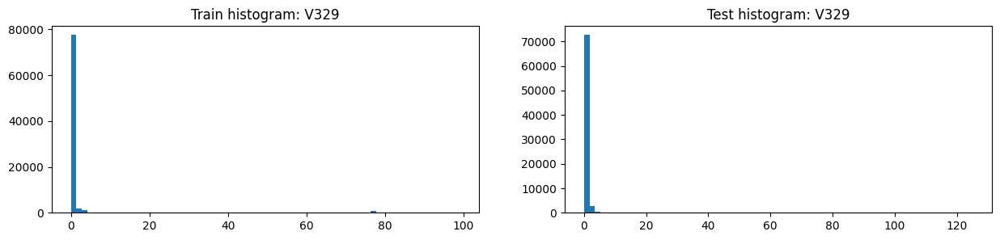

,V329,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,82351.000000,3686.000000,78665.000000,76431.000000,8971.000000,67460.000000
1,mean,1.312844,0.377103,1.356690,0.460572,1.463493,0.327201
2,std,8.769083,1.063497,8.966832,4.228813,9.145929,2.997800
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,99.000000,13.000000,99.000000,125.000000,121.000000,125.000000
8,unique values,101.000000,15.000000,101.000000,127.000000,123.000000,85.000000
9,NaNs,508189.000000,16977.000000,491212.000000,430260.000000,92368.000000,337893.000000


,V329,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,72114,0.041490,2992,66984
2,1.0,5428,0.069823,379,5696
3,2.0,1796,0.081292,146,1851
4,77.0,871,0.000000,0,1
5,3.0,725,0.114483,83,734
6,4.0,297,0.154882,46,287
7,38.0,172,0.000000,0,3
8,5.0,157,0.082803,13,221
9,6.0,105,0.066667,7,76


,V329,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,72114,0.041490,2992,66984
2,1.0,5428,0.069823,379,5696
3,2.0,1796,0.081292,146,1851
4,3.0,725,0.114483,83,734
5,4.0,297,0.154882,46,287
6,5.0,157,0.082803,13,221
7,6.0,105,0.066667,7,76
8,7.0,60,0.100000,6,80
9,8.0,57,0.070175,4,31


,Column,Correlation with V329
0,V329,1.000000
1,V105,0.999101
2,V298,0.995524
3,V296,0.991243
4,V299,0.974647
5,V330,0.969601
327,card5,-0.282868
328,V20,-0.427671
329,V19,-0.431263
330,V62,-0.480941


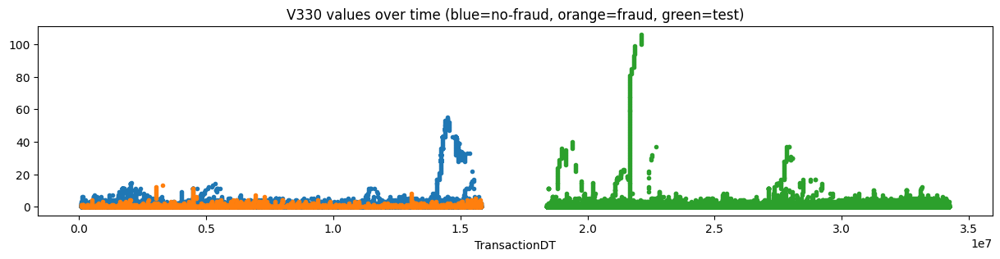

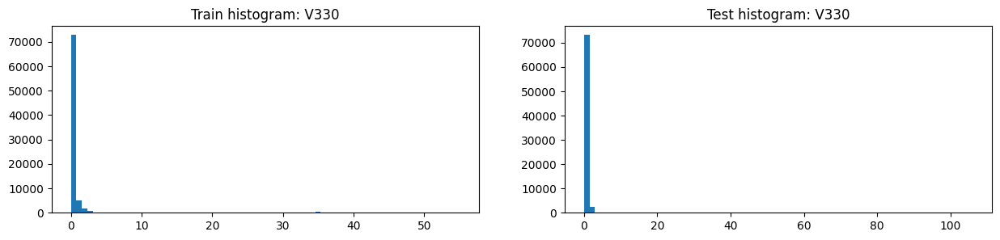

,V330,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,82351.000000,3686.000000,78665.000000,76431.000000,8971.000000,67460.000000
1,mean,0.775874,0.313619,0.797534,0.309900,0.876714,0.234524
2,std,4.727971,0.960475,4.831921,2.632181,5.403554,1.979604
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,55.000000,13.000000,55.000000,106.000000,85.000000,106.000000
8,unique values,57.000000,15.000000,57.000000,108.000000,87.000000,60.000000
9,NaNs,508189.000000,16977.000000,491212.000000,430260.000000,92368.000000,337893.000000


,V330,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,72799,0.042185,3071,67667
2,1.0,5199,0.068282,355,5511
3,2.0,1739,0.079931,139,1730
4,3.0,648,0.104938,68,651
5,35.0,419,0.000000,0,4
6,4.0,242,0.086777,21,253
7,39.0,224,0.000000,0,2
8,32.0,176,0.000000,0,5
9,42.0,151,0.000000,0,1


,V330,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,72799,0.042185,3071,67667
2,1.0,5199,0.068282,355,5511
3,2.0,1739,0.079931,139,1730
4,3.0,648,0.104938,68,651
5,4.0,242,0.086777,21,253
6,5.0,128,0.070312,9,153
7,6.0,56,0.125000,7,53
8,7.0,29,0.137931,4,46
9,11.0,54,0.055556,3,32


,Column,Correlation with V330
0,V330,1.000000
1,V106,0.998002
2,V299,0.992977
3,V329,0.969601
4,V105,0.968189
5,V298,0.961629
327,card5,-0.289202
328,V20,-0.435053
329,V19,-0.438646
330,V62,-0.494861


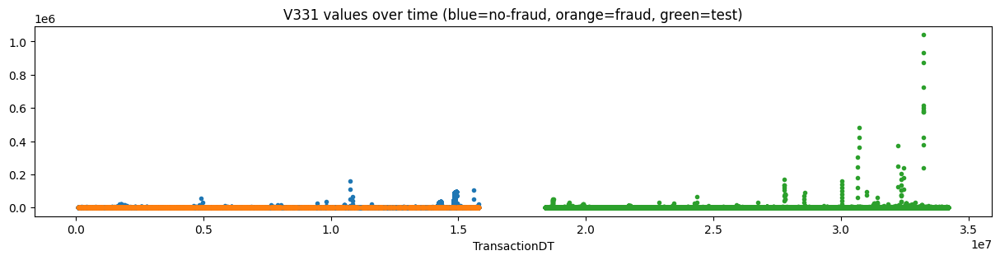

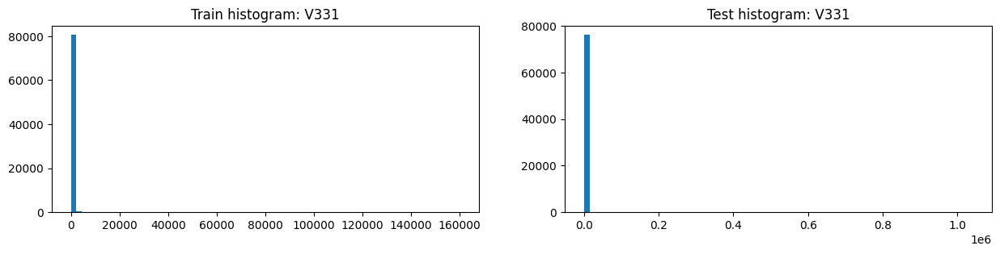

,V331,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,82351.000000,3686.000000,78665.000000,7.643100e+04,8971.000000,6.746000e+04
1,mean,721.741883,90.384699,751.325339,3.151286e+02,238.482488,3.253212e+02
2,std,6217.223583,227.643019,6359.489982,9.494045e+03,1796.757719,1.008432e+04
3,min,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
4,25%,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
5,50%,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
6,75%,0.000000,75.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
7,max,160000.000000,2600.000000,160000.000000,1.040658e+06,50640.000000,1.040658e+06
8,unique values,1759.000000,115.000000,1743.000000,6.060000e+02,292.000000,4.700000e+02
9,NaNs,508189.000000,16977.000000,491212.000000,4.302600e+05,92368.000000,3.378930e+05


,V331,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508189,0.033407,16977,430260.0
1,0.0,65970,0.038290,2526,62414.0
2,100.0,2158,0.054680,118,1728.0
3,200.0,1462,0.072503,106,1383.0
4,50.0,1375,0.045091,62,990.0
5,150.0,1222,0.097381,119,915.0
6,300.0,1022,0.107632,110,884.0
7,25.0,554,0.036101,20,457.0
8,400.0,543,0.077348,42,688.0
9,250.0,496,0.072581,36,512.0


,V331,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,65970,0.038290,2526,62414
2,150.0,1222,0.097381,119,915
3,100.0,2158,0.054680,118,1728
4,300.0,1022,0.107632,110,884
5,200.0,1462,0.072503,106,1383
6,50.0,1375,0.045091,62,990
7,400.0,543,0.077348,42,688
8,600.0,413,0.099274,41,445
9,250.0,496,0.072581,36,512


,Column,Correlation with V331
0,V331,1.000000
1,V126,0.995099
2,V306,0.993540
3,V132,0.990389
4,V316,0.990086
5,V211,0.987237
327,card5,-0.237271
328,V20,-0.343313
329,V19,-0.346339
330,V62,-0.386107


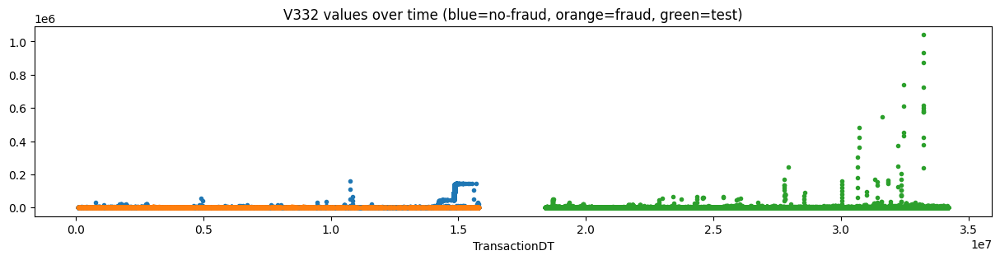

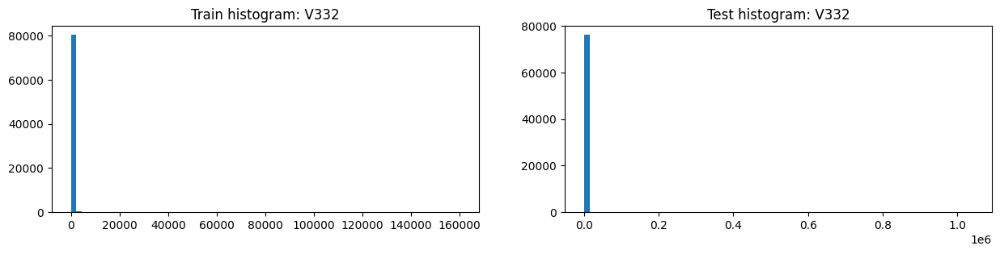

,V332,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,82351.000000,3686.000000,78665.000000,7.643100e+04,8971.000000,6.746000e+04
1,mean,1375.783644,164.859468,1432.523827,4.404643e+02,361.773472,4.509288e+02
2,std,11169.275702,436.287131,11424.424611,1.064843e+04,2004.031078,1.131075e+04
3,min,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
4,25%,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
5,50%,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
6,75%,25.000000,150.000000,20.000000,0.000000e+00,100.000000,0.000000e+00
7,max,160000.000000,4700.000000,160000.000000,1.040658e+06,50640.000000,1.040658e+06
8,unique values,2454.000000,230.000000,2400.000000,1.452000e+03,572.000000,1.190000e+03
9,NaNs,508189.000000,16977.000000,491212.000000,4.302600e+05,92368.000000,3.378930e+05


,V332,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508189,0.033407,16977,430260.0
1,0.0,60806,0.036526,2221,57454.0
2,100.0,2546,0.043598,111,2068.0
3,50.0,1653,0.036903,61,1251.0
4,200.0,1642,0.065773,108,1566.0
5,150.0,1418,0.084626,120,1072.0
6,300.0,1136,0.103873,118,952.0
7,25.0,662,0.025680,17,526.0
8,250.0,626,0.076677,48,579.0
9,75.0,625,0.060800,38,476.0


,V332,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,60806,0.036526,2221,57454
2,150.0,1418,0.084626,120,1072
3,300.0,1136,0.103873,118,952
4,100.0,2546,0.043598,111,2068
5,200.0,1642,0.065773,108,1566
6,50.0,1653,0.036903,61,1251
7,400.0,621,0.080515,50,724
8,250.0,626,0.076677,48,579
9,450.0,290,0.158621,46,204


,Column,Correlation with V332
0,V332,1.000000
1,V127,0.996655
2,V307,0.996515
3,V133,0.996004
4,V317,0.995765
5,V323,0.994990
327,card5,-0.259082
328,V20,-0.379609
329,V19,-0.382951
330,V62,-0.426230


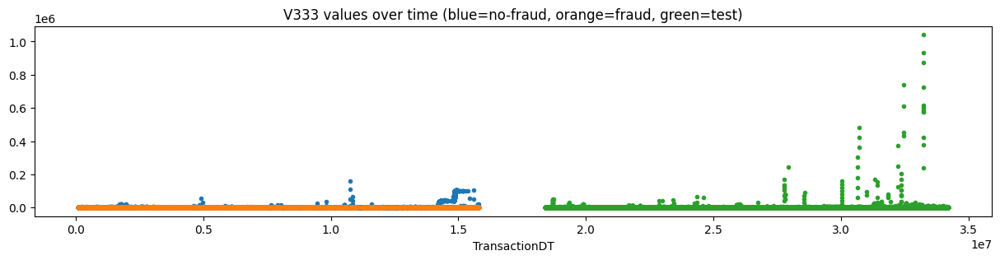

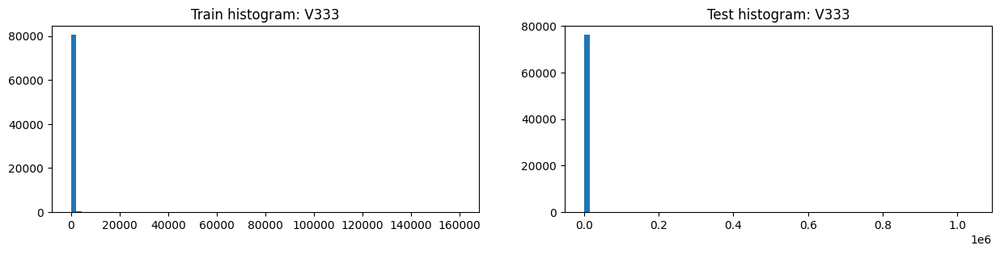

,V333,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,82351.000000,3686.000000,78665.000000,7.643100e+04,8971.000000,6.746000e+04
1,mean,1014.622782,127.633749,1056.184360,3.811021e+02,273.609676,3.953967e+02
2,std,7955.735482,339.856944,8137.291377,1.039556e+04,1819.657546,1.104522e+04
3,min,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
4,25%,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
5,50%,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00
6,75%,0.000000,100.000000,0.000000,0.000000e+00,50.000000,0.000000e+00
7,max,160000.000000,4285.000000,160000.000000,1.040658e+06,50640.000000,1.040658e+06
8,unique values,1972.000000,170.000000,1929.000000,9.560000e+02,431.000000,7.740000e+02
9,NaNs,508189.000000,16977.000000,491212.000000,4.302600e+05,92368.000000,3.378930e+05


,V333,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508189,0.033407,16977,430260.0
1,0.0,62945,0.036508,2298,59518.0
2,100.0,2378,0.048360,115,1914.0
3,200.0,1576,0.071066,112,1458.0
4,50.0,1560,0.042308,66,1180.0
5,150.0,1327,0.091937,122,998.0
6,300.0,1087,0.109476,119,928.0
7,25.0,651,0.039939,26,544.0
8,400.0,602,0.078073,47,699.0
9,75.0,578,0.079585,46,440.0


,V333,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,62945,0.036508,2298,59518
2,150.0,1327,0.091937,122,998
3,300.0,1087,0.109476,119,928
4,100.0,2378,0.048360,115,1914
5,200.0,1576,0.071066,112,1458
6,50.0,1560,0.042308,66,1180
7,400.0,602,0.078073,47,699
8,75.0,578,0.079585,46,440
9,600.0,456,0.098684,45,472


,Column,Correlation with V333
0,V333,1.000000
1,V128,0.996275
2,V308,0.995064
3,V134,0.993521
4,V318,0.993121
5,V332,0.992738
327,card5,-0.265948
328,V20,-0.389853
329,V19,-0.393301
330,V62,-0.439628


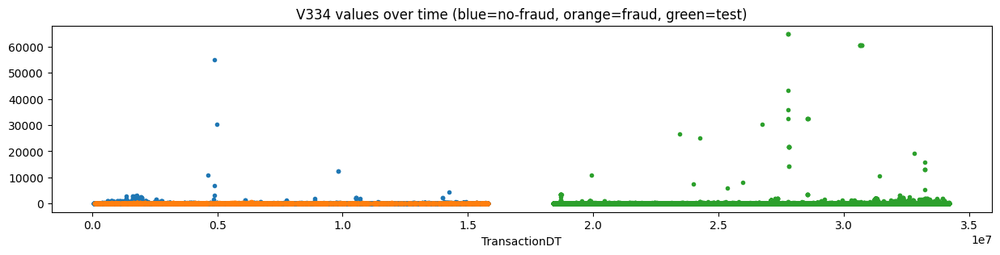

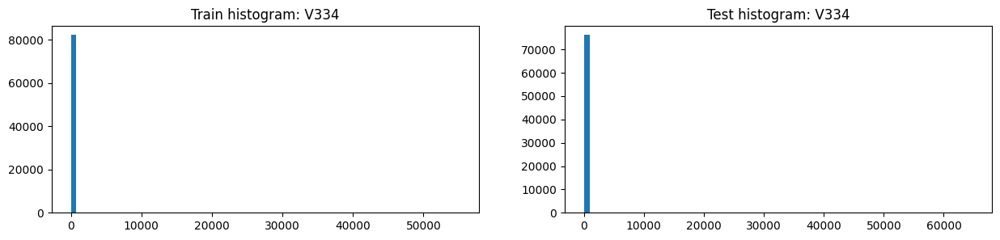

,V334,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,82351.000000,3686.000000,78665.000000,76431.000000,8971.000000,67460.000000
1,mean,9.807015,9.299240,9.830808,24.708030,11.464608,26.469174
2,std,243.861391,51.502023,249.260209,842.913287,172.895557,894.978986
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,55125.000000,635.000000,55125.000000,64800.000000,11000.000000,64800.000000
8,unique values,144.000000,49.000000,131.000000,164.000000,46.000000,161.000000
9,NaNs,508189.000000,16977.000000,491212.000000,430260.000000,92368.000000,337893.000000


,V334,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508189,0.033407,16977,430260.0
1,0.0,78588,0.044447,3493,73546.0
2,100.0,590,0.038983,23,315.0
3,50.0,385,0.023377,9,287.0
4,25.0,228,0.057018,13,235.0
5,265.0,193,0.000000,0,NaN
6,150.0,180,0.155556,28,136.0
7,20.0,178,0.011236,2,165.0
8,106.0,169,0.000000,0,NaN
9,181.0,146,0.000000,0,NaN


,V334,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,78588,0.044447,3493,73546
2,150.0,180,0.155556,28,136
3,100.0,590,0.038983,23,315
4,200.0,115,0.130435,15,178
5,25.0,228,0.057018,13,235
6,300.0,83,0.132530,11,80
7,15.0,118,0.093220,11,99
8,50.0,385,0.023377,9,287
9,450.0,18,0.333333,6,10


,Column,Correlation with V334
0,V334,1.000000
1,V309,0.953625
2,V129,0.949515
3,V266,0.926682
4,V269,0.926063
5,V311,0.923437
327,D3,-0.030160
328,V62,-0.033430
329,V61,-0.033850
330,D2,-0.041238


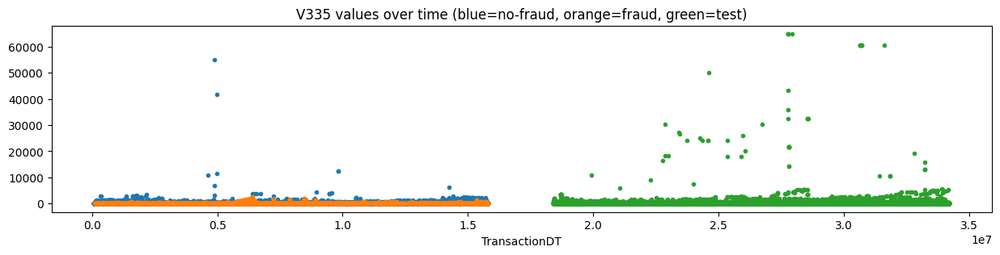

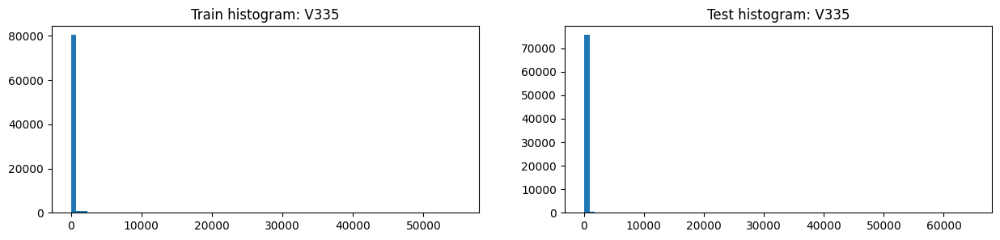

,V335,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,82351.00000,3686.000000,78665.000000,76431.000000,8971.000000,67460.00000
1,mean,59.16455,49.394466,59.622346,58.339468,49.826376,59.47156
2,std,387.62948,201.848261,394.187771,990.361078,248.558722,1050.24867
3,min,0.00000,0.000000,0.000000,0.000000,0.000000,0.00000
4,25%,0.00000,0.000000,0.000000,0.000000,0.000000,0.00000
5,50%,0.00000,0.000000,0.000000,0.000000,0.000000,0.00000
6,75%,0.00000,0.000000,0.000000,0.000000,0.000000,0.00000
7,max,55125.00000,2430.000000,55125.000000,64800.000000,11000.000000,64800.00000
8,unique values,673.00000,120.000000,655.000000,781.000000,260.000000,704.00000
9,NaNs,508189.00000,16977.000000,491212.000000,430260.000000,92368.000000,337893.00000


,V335,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508189,0.033407,16977,430260.0
1,0.0,72668,0.043307,3147,68210.0
2,2301.0,925,0.000000,0,1.0
3,100.0,835,0.033533,28,735.0
4,50.0,809,0.033375,27,645.0
5,150.0,426,0.086854,37,357.0
6,25.0,398,0.040201,16,341.0
7,1259.0,326,0.000000,0,NaN
8,200.0,315,0.085714,27,407.0
9,75.0,254,0.043307,11,234.0


,V335,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,72668,0.043307,3147,68210
2,300.0,193,0.212435,41,196
3,150.0,426,0.086854,37,357
4,100.0,835,0.033533,28,735
5,200.0,315,0.085714,27,407
6,50.0,809,0.033375,27,645
7,450.0,47,0.404255,19,36
8,25.0,398,0.040201,16,341
9,40.0,190,0.073684,14,176


,Column,Correlation with V335
0,V335,1.000000
1,V336,0.914130
2,V312,0.853157
3,V131,0.848055
4,V310,0.826378
5,V266,0.814854
327,D3,-0.215899
328,V20,-0.339095
329,V19,-0.343894
330,V62,-0.356339


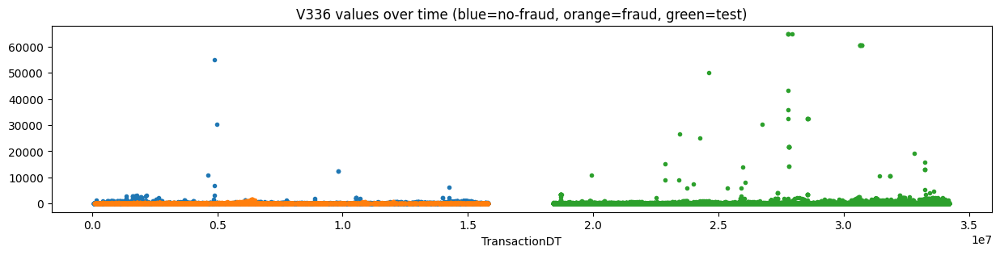

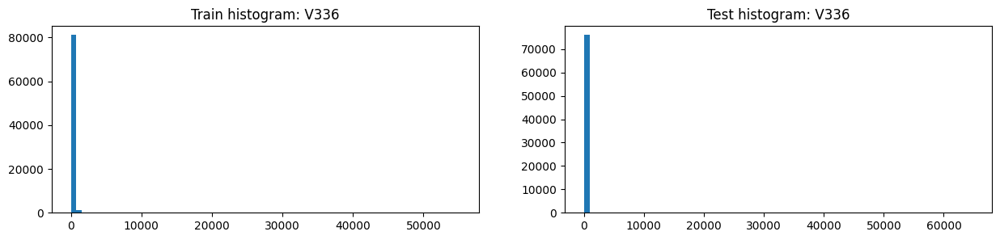

,V336,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,82351.000000,3686.000000,78665.000000,76431.000000,8971.000000,67460.000000
1,mean,28.530903,25.483993,28.673672,35.485643,21.291160,37.373261
2,std,274.576920,117.938993,279.773375,904.093921,179.121153,960.098348
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,55125.000000,1605.000000,55125.000000,64800.000000,11000.000000,64800.000000
8,unique values,357.000000,81.000000,333.000000,370.000000,118.000000,353.000000
9,NaNs,508189.000000,16977.000000,491212.000000,430260.000000,92368.000000,337893.000000


,V336,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508189,0.033407,16977,430260.0
1,0.0,75098,0.043410,3260,70596.0
2,50.0,645,0.046512,30,526.0
3,1052.0,645,0.000000,0,NaN
4,100.0,604,0.046358,28,550.0
5,25.0,381,0.062992,24,335.0
6,619.0,325,0.000000,0,NaN
7,150.0,284,0.119718,34,261.0
8,942.0,280,0.000000,0,NaN
9,30.0,258,0.054264,14,197.0


,V336,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,75098,0.043410,3260,70596
2,300.0,156,0.243590,38,148
3,150.0,284,0.119718,34,261
4,50.0,645,0.046512,30,526
5,100.0,604,0.046358,28,550
6,200.0,221,0.113122,25,283
7,25.0,381,0.062992,24,335
8,45.0,65,0.261538,17,56
9,30.0,258,0.054264,14,197


,Column,Correlation with V336
0,V336,1.000000
1,V312,0.938161
2,V131,0.923727
3,V335,0.914130
4,V334,0.906312
5,V266,0.900629
327,D5,-0.170498
328,V20,-0.198672
329,V19,-0.202209
330,V62,-0.214931


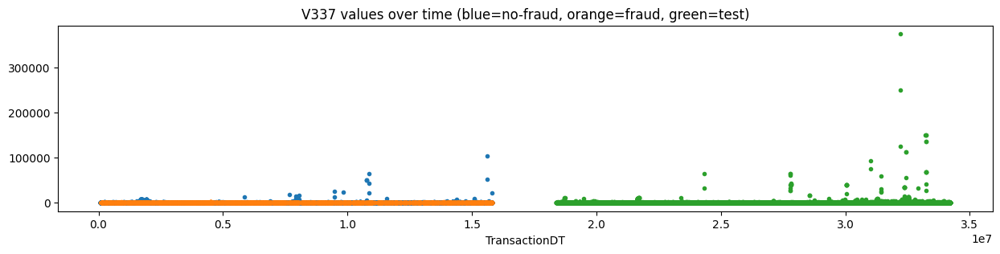

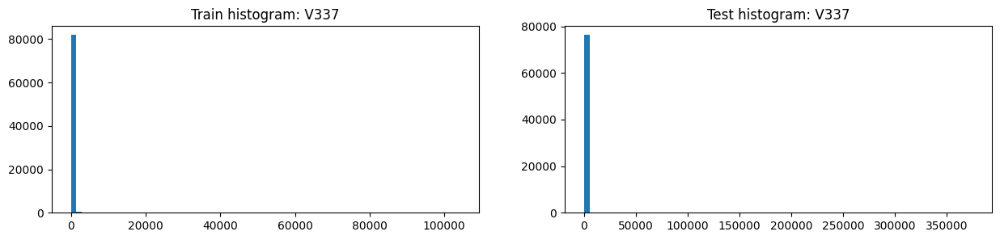

,V337,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,82351.000000,3686.000000,78665.000000,76431.000000,8971.000000,67460.000000
1,mean,55.352422,37.742268,56.177580,99.058760,107.998595,97.869918
2,std,668.486833,142.505208,683.262438,2436.074522,710.104693,2580.036475
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,104060.000000,2200.000000,104060.000000,375000.000000,12000.000000,375000.000000
8,unique values,255.000000,63.000000,249.000000,329.000000,178.000000,242.000000
9,NaNs,508189.000000,16977.000000,491212.000000,430260.000000,92368.000000,337893.000000


,V337,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508189,0.033407,16977,430260.0
1,0.0,73464,0.042592,3129,68348.0
2,100.0,1243,0.045052,56,1108.0
3,1165.0,870,0.000000,0,NaN
4,200.0,861,0.058072,50,906.0
5,150.0,661,0.089259,59,564.0
6,50.0,619,0.063005,39,549.0
7,300.0,582,0.121993,71,549.0
8,250.0,311,0.048232,15,401.0
9,400.0,280,0.050000,14,473.0


,V337,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,73464,0.042592,3129,68348
2,300.0,582,0.121993,71,549
3,150.0,661,0.089259,59,564
4,100.0,1243,0.045052,56,1108
5,200.0,861,0.058072,50,906
6,50.0,619,0.063005,39,549
7,450.0,134,0.194030,26,92
8,75.0,242,0.090909,22,193
9,600.0,223,0.094170,21,248


,Column,Correlation with V337
0,V337,1.000000
1,V339,0.907378
2,V276,0.832701
3,V278,0.795136
4,V214,0.749529
5,V338,0.742652
327,V19,-0.151791
328,V62,-0.197066
329,V61,-0.198533
330,D7,-0.205371


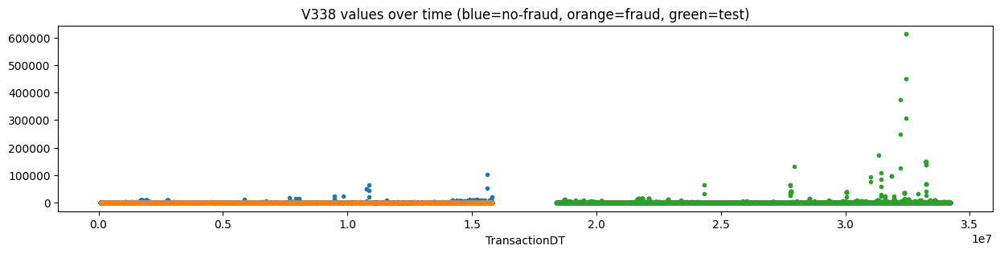

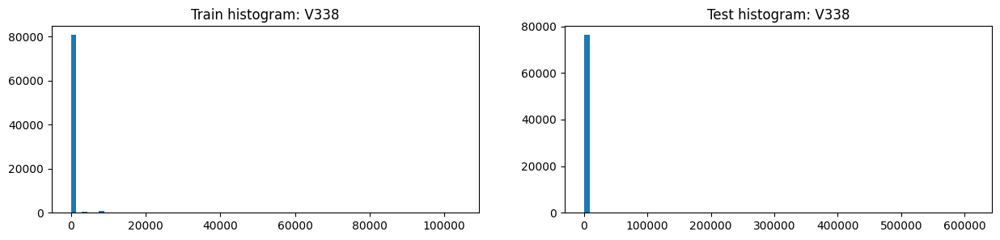

,V338,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,82351.000000,3686.000000,78665.000000,76431.000000,8971.000000,67460.000000
1,mean,151.160542,53.242268,155.748691,155.578153,173.271475,153.225250
2,std,1095.034387,190.250383,1119.429005,4544.303974,1037.100115,4822.225087
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,104060.000000,2400.000000,104060.000000,612500.000000,14306.000000,612500.000000
8,unique values,381.000000,79.000000,368.000000,571.000000,270.000000,389.000000
9,NaNs,508189.000000,16977.000000,491212.000000,430260.000000,92368.000000,337893.000000


,V338,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508189,0.033407,16977,430260.0
1,0.0,72114,0.041490,2992,66984.0
2,100.0,1370,0.057664,79,1177.0
3,200.0,929,0.055974,52,966.0
4,7709.0,871,0.000000,0,NaN
5,50.0,729,0.058985,43,589.0
6,150.0,717,0.089261,64,592.0
7,300.0,626,0.118211,74,591.0
8,25.0,332,0.099398,33,241.0
9,250.0,321,0.046729,15,420.0


,V338,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,72114,0.041490,2992,66984
2,100.0,1370,0.057664,79,1177
3,300.0,626,0.118211,74,591
4,150.0,717,0.089261,64,592
5,200.0,929,0.055974,52,966
6,50.0,729,0.058985,43,589
7,25.0,332,0.099398,33,241
8,75.0,265,0.124528,33,218
9,450.0,152,0.210526,32,102


,Column,Correlation with V338
0,V338,1.000000
1,V339,0.940009
2,V136,0.854639
3,V333,0.823754
4,V320,0.817420
5,V308,0.808496
327,D3,-0.254541
328,V20,-0.382547
329,V19,-0.385448
330,V62,-0.442944


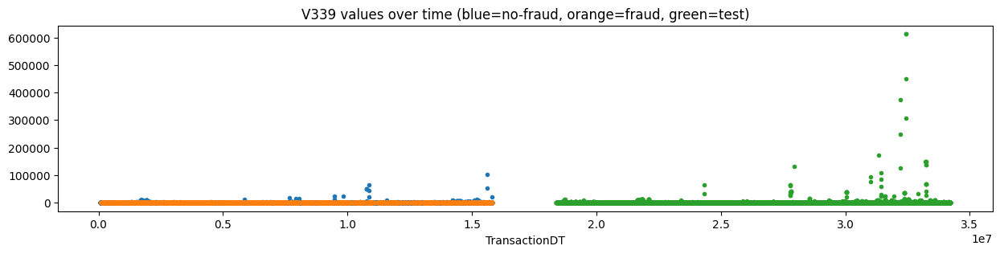

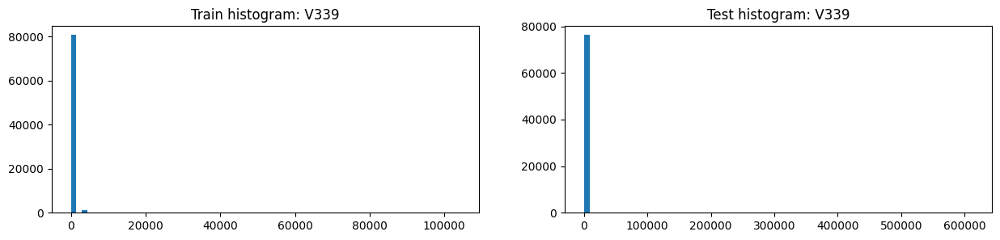

,V339,Train,Train fraud,Train Not fraud,Test,Test public,Test private
0,count,82351.000000,3686.000000,78665.000000,76431.000000,8971.000000,67460.000000
1,mean,100.700882,45.496473,103.287590,139.814706,121.494081,142.251029
2,std,814.946722,175.966280,832.861349,4493.728267,727.182798,4775.841711
3,min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,max,104060.000000,2400.000000,104060.000000,612500.000000,12000.000000,612500.000000
8,unique values,335.000000,73.000000,323.000000,448.000000,222.000000,334.000000
9,NaNs,508189.000000,16977.000000,491212.000000,430260.000000,92368.000000,337893.000000


,V339,Count in train (desc),Mean target,Sum target,Count in test
0,-999.0,508189,0.033407,16977,430260.0
1,0.0,72799,0.042185,3071,67667.0
2,100.0,1319,0.045489,60,1143.0
3,200.0,896,0.053571,48,935.0
4,150.0,702,0.084046,59,582.0
5,50.0,663,0.069382,46,572.0
6,300.0,605,0.122314,74,575.0
7,3657.0,416,0.000000,0,NaN
8,250.0,322,0.052795,17,406.0
9,25.0,294,0.074830,22,218.0


,V339,Count in train,Mean target,Sum target (desc),Count in test
0,-999.0,508189,0.033407,16977,430260
1,0.0,72799,0.042185,3071,67667
2,300.0,605,0.122314,74,575
3,100.0,1319,0.045489,60,1143
4,150.0,702,0.084046,59,582
5,200.0,896,0.053571,48,935
6,50.0,663,0.069382,46,572
7,450.0,140,0.207143,29,98
8,75.0,258,0.108527,28,211
9,600.0,238,0.100840,24,253


,Column,Correlation with V339
0,V339,1.000000
1,V338,0.940009
2,V337,0.907378
3,V276,0.810222
4,V278,0.807834
5,V136,0.765556
327,D13,-0.254903
328,V20,-0.340134
329,V19,-0.342548
330,V62,-0.404628


In [6]:
# EDA for the rest columns
for col in list(tr_tr.columns.values[:COLS_TO_SHOW]):
    proc(col) # Run EDA